## Import Necessary Libraries

In [1]:
import matplotlib.pyplot as plt 
from datetime import datetime
import pandas as pd
import numpy as np
import pygad
import numpy
import glob
import wntr
import os

In [2]:
plt.rcParams['figure.figsize'] = (12,8)

In [3]:
import warnings
import shutil
warnings.filterwarnings('ignore')

In [4]:
# wipe all solutions in the directory

# try:
#     shutil.rmtree('each-node-optimization-results-csvs/')
#     shutil.rmtree('each-node-optimization-plots/')
#     shutil.rmtree('merged_results/')
# except FileNotFoundError:
#     print('files not existing')

# recreate deleted folders
# os.makedirs('each-node-optimization-results-csvs-new')
# os.makedirs('each-node-optimization-plots-new')
# os.makedirs('merged_results-new')


# Uncomment and run the above code if you want to re-optimze this project otherwise, go ahead.
# Recommendation: Uncomment and run the code if you want re-optimize.

## Read Inp File

In [5]:
class Config:
    num_generations =100 #Number of generations.
    num_parents_mating = 1 # Number of solutions to be selected as parents in the mating pool.
    sol_per_pop = 20 # Number of solutions in the population.
    num_genes = 1 #len(function_inputs) --> this can be an array
    init_range_low = 0
    init_range_high = 1
    parent_selection_type = "sss" # Type of parent selection.
    keep_parents = -1 # Number of parents to keep in the next population. -1 means keep all parents and 0 means keep nothing.
    crossover_type = "single_point" # Type of the crossover operator. 
    mutation_type = "random" # Type of the mutation operator.
    mutation_num_genes=1 # Type of the mutation operator.
    last_fitness = 0
    
    inp_file_path = r"../data/Real_Synthetic_Net.inp" 
    function_inputs = None
    desired_output = None

In [6]:
class WaterLeakModel(Config):
    
    def __init__(self, node:str):
        ''' 
            node: node/junction ID in the network
        '''
        
        # Check if node is junction_name 
        wn = wntr.network.WaterNetworkModel(self.inp_file_path)
        assert wn.junction_name_list.count(node) == 1, "Node not found in the network"
        self.node_index = wn.junction_name_list.index(node)
        
        self.node = node
        
        #Setup all neccessary folders we need to work with, i.e. create them if they don't exist
        if not os.path.exists('each-node-optimization-results-csvs-new/solutions_for_'+self.node):
            os.mkdir('each-node-optimization-results-csvs-new/solutions_for_'+self.node)
            
        if not os.path.exists('each-node-optimization-plots-new/plots_for_'+self.node):
            os.mkdir('each-node-optimization-plots-new/plots_for_'+self.node)


        if not os.path.exists('merged_results-new/results_for_'+self.node):
            os.mkdir('merged_results-new/results_for_'+self.node)
            
        self.temp_dir = 'each-node-optimization-results-csvs-new/solutions_for_'+self.node
        self.plots_dir = 'each-node-optimization-plots-new/plots_for_'+self.node
        self.merged_result = 'merged_results-new/results_for_'+self.node

    def simulate(self, wn, plot_graph=True):
        """
        If plot_graph is set to true, a graph of the network is plotted after simulation
        """
        # Plot pressure after add leak to node
            
        sim = wntr.sim.WNTRSimulator(wn)
        results = sim.run_sim()
        pressure = results.node['pressure']
        pressure_at_N6 = pressure.loc[:,wn.junction_name_list[self.node_index]]
        if plot_graph:
            wntr.graphics.plot_network(wn, node_attribute=pressure.any(), node_size=150, title='Pressure at 0 hours')
        
        return results
    
    def change_discharge_coefficient(self, wn, emitter_value):
        """
        This function changes the emitter coefficient for selected node in the network, and create a 
        structured representation of our data, a csv.
        
        parameters
        ----------
        wn: wntr network object
        emitter_value: the emitter coefficient value
        """
        
        if emitter_value>1:
            emitter_value=emitter_value%1
            
        # Change emitter coefficient
        node = wn.get_node(str(self.node))
        node.add_leak(wn, area=0.00015, start_time=0, end_time=1, discharge_coeff=emitter_value)
        return self.simulate(wn, plot_graph=False)
    
    def export_results(self, solutions:list, name:str, export_type='by_solution', path=None):
        """
        Concatenates all solutions generated and exports as a single csv file
        
        parameters
        ----------
        solution: a list of all paths to the solutions csv files
        path: path where concatenated solution will be exported to
        name: name to be assigned to exported file
        """
        if not path: path=self.merged_result
        
        if not os.path.exists(path):
            os.mkdir(path)
        
        temp = pd.DataFrame()
        for i in solutions:
            if export_type == 'by_solution':
                extracted_node = i.split('/')[1].split('_')[2]
            else:
                extracted_node = i.split('/')[1].split('_')[1]
                
            data = pd.read_csv(i)
            data['NODE'] = extracted_node
            if i == 0:
                temp = data
            else:
                temp = pd.concat([temp, data])
        name+=".csv"
        try:
            temp.to_csv(os.path.join(path,name),index=False)
            print(f'File Exported Successfully to path: {os.path.join(path, name)}')
        except Exception as e:
            print(e)
            
    def run(self, leak_area=0.00015, start_time=0, end_time=1, discharge_coeff=.5, function_inputs=0.5, plot_graph=True):
        """
        Adds a leak to node passed to WaterLeakModel() object and simulates
        
        parameters
        ----------
        leak_area: area of the leak
        start_time: time in seconds to start the leak
        end_time: time in seconds to end the leak
        discharge_coeff: Leak discharge coefficient; Takes on values between 0 and 1.
        function_inputs = inputs for optimization, can be array of numbers
        plot_graph: If plot_graph is set to true, a graph of the network is plotted after simulation
        """
        
        # Add leak and simulate
        wn = wntr.network.WaterNetworkModel(self.inp_file_path)
        node = wn.get_node(self.node)
        node.add_leak(wn, area=leak_area, start_time=start_time, end_time=end_time, discharge_coeff=.5)
        self.simulate(wn, plot_graph=plot_graph)

        self.function_inputs = function_inputs
        self.desired_output = node.head - node.elevation
            

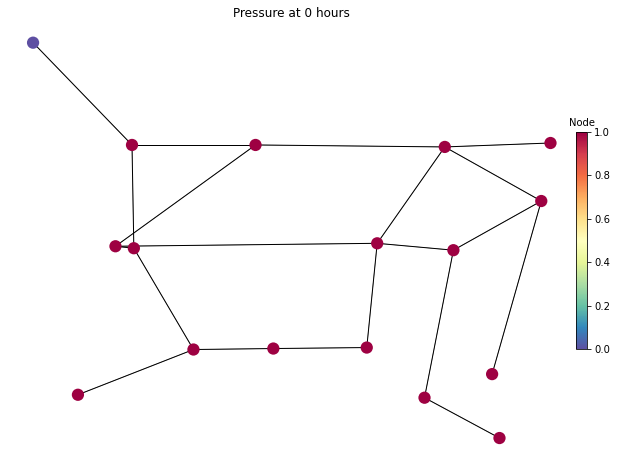

In [7]:
# Instantiate the pygad optimization class
water_model = WaterLeakModel(node='N6')
water_model.run()

In [8]:
# wipe all solutions in the directory
all_solutions = glob.glob(f'{water_model.temp_dir}/FITNESS_SOLUTION_*')
all_generations = glob.glob(f'{water_model.temp_dir}/GENERATION_*')
# for i in all_solutions:
#     os.remove(i)
# for j in all_generations:
#     os.remove(j)


# Uncomment and run the above code if you want to re-optimze this project otherwise, go ahead.
# Recommendation: Uncomment and run the code if you want re-optimize.

In [9]:
def fitness_function(solution, solution_idx):
    global current_node
    
    wn = wntr.network.WaterNetworkModel(water_model.inp_file_path)
    print(solution)
    results = water_model.change_discharge_coefficient(wn, emitter_value=abs(solution[0]*water_model.function_inputs)) #change emitter coefficient

    pressure = results.node['pressure']
    pressure_output = pressure.loc[:,water_model.node]

    demands=results.node['demand']
    demand_output = demands.loc[:,water_model.node]
    
    fitness = 1.0 / (np.abs(pressure_output - water_model.desired_output) + 0.000001)

    # Structure and export the output of the fitness
    data = pd.DataFrame(columns=['EMITTER_COEFFICIENT_SOLUTION','PRESSURE_OUTPUT','OUTPUT_DEMAND','FITNESS'])
    
    emitter_coeff=abs(solution[0]) 
    if emitter_coeff>1:
        emitter_coeff=emitter_coeff%1

    data = data.append({'EMITTER_COEFFICIENT_SOLUTION':abs(emitter_coeff),'PRESSURE_OUTPUT':list(pressure_output)[0],'FITNESS':list(fitness)[0],'OUTPUT_DEMAND':(list(demand_output) [0]*1000)},ignore_index=True)
    data.to_csv(f"{water_model.temp_dir}/FITNESS_SOLUTION_{current_node}_{str(abs(solution[0]))}.csv",index=False) 

    print('=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========')
    print ('======|', abs(round(solution[0],3)),'|===========|',list(round(pressure_output,3))[0],'|==================|',list(round(fitness, 3))[0],'|==========')
    print('================================='*2)

    return list(fitness)[0]

In [10]:
#################### Create a Callback Function ########################
last_fitness = 0
def callback_generation(ga_instance): # This function prints algorithm progress
    global last_fitness
    print("Generation = {generation}".format(generation=ga_instance.generations_completed)) 
    print("Fitness = {fitness}".format(fitness=ga_instance.best_solution()[1]))
    print("Change = {change}".format(change=ga_instance.best_solution()[1] - last_fitness)) 

    data =pd.DataFrame(columns=['GENERATION','FITNESS'])
    data =data.append({'GENERATION':ga_instance.generations_completed,'FITNESS': ga_instance.best_solution ()[1]},ignore_index=True)
    data.to_csv(f"{water_model.temp_dir}/GENERATION_{current_node}_{str(ga_instance.generations_completed)}.csv",index=False) 
    last_fitness = ga_instance.best_solution()[1]

In [11]:
wn = wntr.network.WaterNetworkModel(water_model.inp_file_path)
model_nodes = wn.junction_name_list

In [12]:
model_nodes

['N1',
 'N5',
 'N10',
 'N7',
 'N2',
 'N6',
 'N3',
 'N8',
 'N13',
 'N9',
 'N14',
 'N4',
 'N11',
 'N12',
 'N15',
 'N16']

[0.27]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 9.366 |==================| 237.961 |==========
[0.652]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.652 |===========| 9.36 |==================| 98.231 |==========
[0.927]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.927 |===========| 9.356 |==================| 69.025 |==========
[0.937]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.937 |===========| 9.356 |==================| 68.29 |==========
[0.547]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.547 |===========| 9.362 |==================| 117.115 |==========
[0.098]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 9.369 |==================| 653.318 |==========
[0.341]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 9.37 |==================| 1170.86 |==========
[0.83]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 9.358 |==================| 77.112 |==========
[0.818]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.818 |===========| 9.358 |==================| 78.255 |==========
[-0.903]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.903 |===========| 9.356 |==================| 70.836 |==========
[-0.091]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 9.369 |==================| 708.655 |==========
[-0.516]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 9.363 |==================| 124.204 |==========
[-0.752]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


[0.818]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.818 |===========| 9.358 |==================| 78.255 |==========
[-0.903]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.903 |===========| 9.356 |==================| 70.836 |==========
[-0.091]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 9.369 |==================| 708.655 |==========
[-0.516]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 9.363 |==================| 124.204 |==========
[-0.752]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 9.359 |==================| 85.135 |==========
[-0.683]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.683 |===========| 9.36 |==================| 93.782 |==========
[-0.53]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 9.363 |==================| 131.965 |==========
[-0.67]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 9.36 |==================| 95.63 |==========
[0.89]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.89 |===========| 9.357 |==================| 71.939 |==========
[-0.851]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 9.357 |==================| 75.206 |==========
[0.191]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 9.368 |==================| 335.274 |==========
[-0.074]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 9.369 |==================| 872.478 |==========
[0.665]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 9.366 |==================| 223.427 |==========
[-0.486]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 9.363 |==================| 131.965 |==========
[-0.67]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 9.36 |==================| 95.63 |==========
[0.89]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.89 |===========| 9.357 |==================| 71.939 |==========
[-0.851]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 9.357 |==================| 75.206 |==========
[0.191]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 9.368 |==================| 335.274 |==========
[-0.074]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 9.367 |==================| 279.936 |==========
[-0.287]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 9.366 |==================| 223.427 |==========
[-0.486]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 9.363 |==================| 131.965 |==========
[-0.67]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 9.36 |==================| 95.63 |==========
[0.89]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.89 |===========| 9.357 |==================| 71.939 |==========
[-0.851]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 9.357 |==================| 75.206 |==========
[0.191]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 9.365 |==================| 173.72 |==========
[-0.374]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 9.365 |==================| 171.742 |==========
[0.117]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 9.369 |==================| 549.11 |==========
[-0.918]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.918 |===========| 9.356 |==================| 69.748 |==========
[0.933]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.933 |===========| 9.356 |==================| 68.603 |==========
[0.57]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.57 |===========| 9.362 |==================| 112.512 |==========
[-0.282]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 9.367 |==================| 263.254 |==========
Change = 0.0
[0.369]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 9.365 |==================| 173.72 |==========
[-0.374]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 9.365 |==================| 171.742 |==========
[0.117]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 9.369 |==================| 549.11 |==========
[-0.918]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.918 |===========| 9.356 |==================| 69.748 |==========
[0.933]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.933 |===========| 9.356 |==================| 68.603 |==========
[0.57]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS

[-0.111]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 9.369 |==================| 576.655 |==========
[0.125]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 9.369 |==================| 512.679 |==========
[0.513]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.513 |===========| 9.363 |==================| 125.055 |==========
[-0.058]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 9.37 |==================| 1101.813 |==========
[-0.835]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.835 |===========| 9.358 |==================| 76.705 |==========
[-0.329]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 9.365 |==================| 195.124 |==========
[-0.092]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

[0.513]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.513 |===========| 9.363 |==================| 125.055 |==========
[-0.058]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 9.37 |==================| 1101.813 |==========
[-0.835]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.835 |===========| 9.358 |==================| 76.705 |==========
[-0.329]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 9.365 |==================| 195.124 |==========
[-0.092]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 9.369 |==================| 700.913 |==========
[0.522]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.522 |===========| 9.362 |==================| 122.758 |==========
[0.806]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 9.37 |==================| 1101.813 |==========
[-0.835]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.835 |===========| 9.358 |==================| 76.705 |==========
[-0.329]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 9.365 |==================| 195.124 |==========
[-0.092]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 9.369 |==================| 700.913 |==========
[0.522]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.522 |===========| 9.362 |==================| 122.758 |==========
[0.806]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.806 |===========| 9.358 |==================| 79.394 |==========
[0.051]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 9.355 |==================| 65.767 |==========
[0.286]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 9.366 |==================| 224.665 |==========
[-0.331]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 9.365 |==================| 194.135 |==========
[0.757]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.757 |===========| 9.359 |==================| 84.631 |==========
[0.275]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 9.366 |==================| 233.212 |==========
[0.265]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 9.366 |==================| 241.837 |==========
[0.68]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 9.366 |==================| 224.665 |==========
[-0.331]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 9.365 |==================| 194.135 |==========
[0.757]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.757 |===========| 9.359 |==================| 84.631 |==========
[0.275]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 9.366 |==================| 233.212 |==========
[0.265]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 9.366 |==================| 241.837 |==========
[0.68]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.68 |===========| 9.36 |==================| 94.18 |==========
[0.984]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 9.366 |==================| 211.557 |==========
[0.436]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 9.364 |==================| 146.974 |==========
[0.435]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 9.364 |==================| 147.581 |==========
[0.841]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 9.357 |==================| 76.147 |==========
[-0.902]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 9.357 |==================| 70.99 |==========
[-0.423]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 9.364 |==================| 151.54 |==========
[-0.614]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 9.365 |==================| 181.711 |==========
[-0.303]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 9.366 |==================| 211.557 |==========
[0.436]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 9.364 |==================| 146.974 |==========
[0.435]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 9.364 |==================| 147.581 |==========
[0.841]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 9.357 |==================| 76.147 |==========
[-0.902]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 9.357 |==================| 70.99 |==========
[-0.423]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 9.366 |==================| 211.557 |==========
[0.436]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 9.364 |==================| 146.974 |==========
[0.435]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 9.364 |==================| 147.581 |==========
[0.841]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 9.357 |==================| 76.147 |==========
[-0.902]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 9.357 |==================| 70.99 |==========
[-0.423]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 9.364 |==================| 151.54 |==========
[-0.614]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

[0.312]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 9.366 |==================| 205.91 |==========
[-0.34]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 9.365 |==================| 188.738 |==========
[0.364]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 9.365 |==================| 176.079 |==========
[0.666]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 9.36 |==================| 96.168 |==========
[-0.277]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 9.366 |==================| 231.85 |==========
[-0.048]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 9.37 |==================| 1331.799 |==========
[0.654]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.582 |===========| 9.362 |==================| 110.099 |==========
[0.312]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 9.366 |==================| 205.91 |==========
[-0.34]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 9.365 |==================| 188.738 |==========
[0.364]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 9.365 |==================| 176.079 |==========
[0.666]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 9.36 |==================| 96.168 |==========
[-0.277]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 9.366 |==================| 231.85 |==========
[-0.048]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.623 |===========| 9.361 |==================| 102.863 |==========
[-0.531]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.531 |===========| 9.362 |==================| 120.804 |==========
[0.666]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 9.36 |==================| 96.222 |==========
[0.379]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 9.365 |==================| 169.431 |==========
[-0.6]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.6 |===========| 9.361 |==================| 106.798 |==========
[0.003]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 9.371 |==================| 19478.943 |==========
[0.761]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


[-0.531]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.531 |===========| 9.362 |==================| 120.804 |==========
[0.666]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 9.36 |==================| 96.222 |==========
[0.379]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 9.365 |==================| 169.431 |==========
[-0.6]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.6 |===========| 9.361 |==================| 106.798 |==========
[0.003]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 9.371 |==================| 19478.943 |==========
[0.761]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.761 |===========| 9.359 |==================| 84.189 |==========
[0.798]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.531 |===========| 9.362 |==================| 120.804 |==========
[0.666]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 9.36 |==================| 96.222 |==========
[0.379]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 9.365 |==================| 169.431 |==========
[-0.6]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.6 |===========| 9.361 |==================| 106.798 |==========
[0.003]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 9.371 |==================| 19478.943 |==========
[0.761]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.761 |===========| 9.359 |==================| 84.189 |==========
[0.798]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 9.37 |==================| 1476.379 |==========
[0.29]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 9.366 |==================| 221.082 |==========
[-0.571]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.571 |===========| 9.362 |==================| 112.166 |==========
[0.819]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.819 |===========| 9.358 |==================| 78.141 |==========
[-0.383]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 9.365 |==================| 167.483 |==========
[-0.437]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 9.364 |==================| 146.719 |==========
[-0.59]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.571 |===========| 9.362 |==================| 112.166 |==========
[0.819]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.819 |===========| 9.358 |==================| 78.141 |==========
[-0.383]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 9.365 |==================| 167.483 |==========
[-0.437]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 9.364 |==================| 146.719 |==========
[-0.59]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.59 |===========| 9.361 |==================| 108.678 |==========
[0.336]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 9.365 |==================| 191.071 |==========
[0.363]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.933 |===========| 9.356 |==================| 68.567 |==========
[0.344]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 9.365 |==================| 186.425 |==========
[0.905]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 9.356 |==================| 70.75 |==========
[-0.247]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 9.367 |==================| 259.414 |==========
[0.764]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.764 |===========| 9.359 |==================| 83.782 |==========
[0.961]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 9.356 |==================| 66.596 |==========
[-0.791]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 9.365 |==================| 186.425 |==========
[0.905]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 9.356 |==================| 70.75 |==========
[-0.247]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 9.367 |==================| 259.414 |==========
[0.764]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.764 |===========| 9.359 |==================| 83.782 |==========
[0.961]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 9.356 |==================| 66.596 |==========
[-0.791]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.791 |===========| 9.358 |==================| 80.934 |==========
[0.407]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 9.367 |==================| 259.414 |==========
[0.764]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.764 |===========| 9.359 |==================| 83.782 |==========
[0.961]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 9.356 |==================| 66.596 |==========
[-0.791]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.791 |===========| 9.358 |==================| 80.934 |==========
[0.407]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 9.364 |==================| 157.602 |==========
[-0.011]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 9.37 |==================| 5604.867 |==========
[0.784]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

[0.392]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 9.364 |==================| 163.542 |==========
[0.668]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 9.36 |==================| 95.907 |==========
[0.106]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 9.369 |==================| 603.058 |==========
[-0.427]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 9.364 |==================| 150.135 |==========
[-0.508]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.508 |===========| 9.363 |==================| 126.135 |==========
[0.755]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.755 |===========| 9.359 |==================| 84.798 |==========
Fitness = 268584.50339393876
[-0.011]
=====|SOLUTION|===========|OUTPUT

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 9.364 |==================| 163.542 |==========
[0.668]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 9.36 |==================| 95.907 |==========
[0.106]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 9.369 |==================| 603.058 |==========
[-0.427]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 9.364 |==================| 150.135 |==========
[-0.508]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.508 |===========| 9.363 |==================| 126.135 |==========
[0.755]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.755 |===========| 9.359 |==================| 84.798 |==========
[-0.011]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 9.369 |==================| 855.048 |==========
[-0.071]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 9.37 |==================| 907.497 |==========
[0.131]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 9.369 |==================| 489.442 |==========
[0.902]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 9.357 |==================| 70.984 |==========
[0.182]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 9.368 |==================| 351.859 |==========
[0.974]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.974 |===========| 9.355 |==================| 65.684 |==========
[-0.446]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 9.369 |==================| 489.442 |==========
[0.902]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 9.357 |==================| 70.984 |==========
[0.182]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 9.368 |==================| 351.859 |==========
[0.974]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.974 |===========| 9.355 |==================| 65.684 |==========
[-0.446]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 9.364 |==================| 143.875 |==========
Change = 0.0
[0.312]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 9.366 |==================| 205.691 |==========
[-0.752]
=====|SOLUTION|===========|OUTPUT|==================|FITN

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 9.369 |==================| 489.442 |==========
[0.902]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 9.357 |==================| 70.984 |==========
[0.182]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 9.368 |==================| 351.859 |==========
[0.974]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.974 |===========| 9.355 |==================| 65.684 |==========
[-0.446]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 9.364 |==================| 143.875 |==========
[0.071]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 9.37 |==================| 905.14 |==========
[0.523]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.669 |===========| 9.36 |==================| 95.785 |==========
[0.075]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 9.369 |==================| 851.641 |==========
[-0.31]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 9.366 |==================| 206.906 |==========
[-0.566]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.566 |===========| 9.362 |==================| 113.183 |==========
Fitness = 268584.50339393876
[0.071]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 9.37 |==================| 905.14 |==========
[0.523]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.523 |===========| 9.362 |==================| 122.507 |==========
[0.557]
=====|SOLUTION|===========|OUTPUT|===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 9.369 |==================| 851.641 |==========
[-0.31]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 9.366 |==================| 206.906 |==========
[-0.566]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.566 |===========| 9.362 |==================| 113.183 |==========
[0.071]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 9.37 |==================| 905.14 |==========
[0.523]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.523 |===========| 9.362 |==================| 122.507 |==========
[0.557]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.557 |===========| 9.362 |==================| 115.002 |==========
[0.905]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.796 |===========| 9.358 |==================| 80.435 |==========
[-0.909]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.909 |===========| 9.356 |==================| 70.413 |==========
Generation = 14
[0.691]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.691 |===========| 9.36 |==================| 92.694 |==========
[-0.952]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.952 |===========| 9.356 |==================| 67.237 |==========
[0.059]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 9.37 |==================| 1081.794 |==========
[0.054]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 9.37 |==================| 1194.243 |==========
[-0.7]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 9.37 |==================| 2197.903 |==========
[0.796]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.796 |===========| 9.358 |==================| 80.435 |==========
[-0.909]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.909 |===========| 9.356 |==================| 70.413 |==========
Change = 0.0
[0.691]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.691 |===========| 9.36 |==================| 92.694 |==========
[-0.952]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.952 |===========| 9.356 |==================| 67.237 |==========
[0.059]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 9.37 |==================| 1081.794 |==========
[0.054]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 9.367 |==================| 311.7 |==========
[-0.029]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 9.37 |==================| 2197.903 |==========
[0.796]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.796 |===========| 9.358 |==================| 80.435 |==========
[-0.909]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.909 |===========| 9.356 |==================| 70.413 |==========
[-0.951]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.951 |===========| 9.356 |==================| 67.259 |==========
[-0.294]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 9.366 |==================| 218.107 |==========
[0.175]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.955 |===========| 9.356 |==================| 66.975 |==========
[0.685]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.685 |===========| 9.36 |==================| 93.582 |==========
[-0.58]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.58 |===========| 9.362 |==================| 110.542 |==========
[0.139]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 9.368 |==================| 460.523 |==========
Fitness = 268584.50339393876
[-0.951]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.951 |===========| 9.356 |==================| 67.259 |==========
[-0.294]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 9.366 |==================| 218.107 |==========
[0.175]
=====|SOLUTION|===========|OUTPUT|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.685 |===========| 9.36 |==================| 93.582 |==========
[-0.58]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.58 |===========| 9.362 |==================| 110.542 |==========
[0.139]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 9.368 |==================| 460.523 |==========
[-0.951]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.951 |===========| 9.356 |==================| 67.259 |==========
[-0.294]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 9.366 |==================| 218.107 |==========
[0.175]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 9.368 |==================| 366.036 |==========
[0.764]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 9.359 |==================| 86.965 |==========
[0.181]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 9.368 |==================| 353.785 |==========
Generation = 16
[-0.12]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.12 |===========| 9.369 |==================| 536.287 |==========
[0.73]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.73 |===========| 9.359 |==================| 87.769 |==========
[-0.745]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.745 |===========| 9.359 |==================| 86.025 |==========
[-0.2]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 9.368 |==================| 321.486 |==========
[-0.612]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 9.36 |==================| 96.139 |==========
[-0.737]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 9.359 |==================| 86.965 |==========
[0.181]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 9.368 |==================| 353.785 |==========
Change = 0.0
[-0.12]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.12 |===========| 9.369 |==================| 536.287 |==========
[0.73]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.73 |===========| 9.359 |==================| 87.769 |==========
[-0.745]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.745 |===========| 9.359 |==================| 86.025 |==========
[-0.2]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 9.359 |==================| 86.965 |==========
[0.181]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 9.368 |==================| 353.785 |==========
[0.994]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.994 |===========| 9.355 |==================| 64.378 |==========
[0.337]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========| 9.365 |==================| 190.655 |==========
[0.434]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 9.364 |==================| 147.63 |==========
[-0.361]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 9.365 |==================| 177.548 |==========
[0.434]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.994 |===========| 9.355 |==================| 64.378 |==========
[0.337]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========| 9.365 |==================| 190.655 |==========
[0.434]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 9.364 |==================| 147.63 |==========
[-0.361]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 9.365 |==================| 177.548 |==========
[0.434]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 9.364 |==================| 147.823 |==========
[-0.741]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.741 |===========| 9.359 |==================| 86.487 |==========
[0.607]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========| 9.365 |==================| 190.655 |==========
[0.434]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 9.364 |==================| 147.63 |==========
[-0.361]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 9.365 |==================| 177.548 |==========
[0.434]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 9.364 |==================| 147.823 |==========
[-0.741]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.741 |===========| 9.359 |==================| 86.487 |==========
[0.607]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.607 |===========| 9.361 |==================| 105.619 |==========
[0.273]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 9.364 |==================| 147.833 |==========
[-0.925]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.925 |===========| 9.356 |==================| 69.153 |==========
[0.243]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.243 |===========| 9.367 |==================| 264.162 |==========
[-0.403]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.403 |===========| 9.364 |==================| 159.008 |==========
[-0.294]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 9.366 |==================| 218.267 |==========
[-0.304]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.304 |===========| 9.366 |==================| 211.181 |==========
[-0.195]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.925 |===========| 9.356 |==================| 69.153 |==========
[0.243]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.243 |===========| 9.367 |==================| 264.162 |==========
[-0.403]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.403 |===========| 9.364 |==================| 159.008 |==========
[-0.294]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 9.366 |==================| 218.267 |==========
[-0.304]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.304 |===========| 9.366 |==================| 211.181 |==========
[-0.195]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 9.368 |==================| 329.253 |==========
[-0.681]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.689 |===========| 9.36 |==================| 92.98 |==========
[-0.215]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 9.367 |==================| 299.266 |==========
[0.946]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.946 |===========| 9.356 |==================| 67.604 |==========
[0.765]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 9.359 |==================| 83.758 |==========
[-0.137]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.137 |===========| 9.368 |==================| 469.789 |==========
[-0.763]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.763 |===========| 9.359 |==================| 83.938 |==========
[0.732]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.689 |===========| 9.36 |==================| 92.98 |==========
[-0.215]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 9.367 |==================| 299.266 |==========
[0.946]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.946 |===========| 9.356 |==================| 67.604 |==========
[0.765]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 9.359 |==================| 83.758 |==========
[-0.137]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.137 |===========| 9.368 |==================| 469.789 |==========
[-0.763]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.763 |===========| 9.359 |==================| 83.938 |==========
[0.732]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.689 |===========| 9.36 |==================| 92.98 |==========
[-0.215]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 9.367 |==================| 299.266 |==========
[0.946]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.946 |===========| 9.356 |==================| 67.604 |==========
[0.765]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 9.359 |==================| 83.758 |==========
[-0.137]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.137 |===========| 9.368 |==================| 469.789 |==========
[-0.763]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.763 |===========| 9.359 |==================| 83.938 |==========
[0.732]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.812 |===========| 9.358 |==================| 78.876 |==========
[-0.69]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 9.36 |==================| 92.86 |==========
[-0.597]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.597 |===========| 9.361 |==================| 107.312 |==========
[-0.706]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.706 |===========| 9.36 |==================| 90.775 |==========
[0.471]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 9.363 |==================| 136.128 |==========
[-0.13]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 9.369 |==================| 494.344 |==========
[0.525]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.597 |===========| 9.361 |==================| 107.312 |==========
[-0.706]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.706 |===========| 9.36 |==================| 90.775 |==========
[0.471]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 9.363 |==================| 136.128 |==========
[-0.13]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 9.369 |==================| 494.344 |==========
[0.525]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.525 |===========| 9.362 |==================| 122.038 |==========
[-0.904]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.904 |===========| 9.356 |==================| 70.767 |==========
[-0.62]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


[0.539]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.539 |===========| 9.362 |==================| 119.002 |==========
[0.076]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 9.369 |==================| 849.821 |==========
[0.998]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.998 |===========| 9.355 |==================| 64.13 |==========
[0.988]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.988 |===========| 9.355 |==================| 64.765 |==========
[-0.956]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.956 |===========| 9.356 |==================| 66.954 |==========
[-0.876]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.876 |===========| 9.357 |==================| 73.07 |==========
[-0.022]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.998 |===========| 9.355 |==================| 64.13 |==========
[0.988]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.988 |===========| 9.355 |==================| 64.765 |==========
[-0.956]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.956 |===========| 9.356 |==================| 66.954 |==========
[-0.876]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.876 |===========| 9.357 |==================| 73.07 |==========
[-0.022]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 9.37 |==================| 2977.573 |==========
[0.527]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.527 |===========| 9.362 |==================| 121.598 |==========
[0.657]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.998 |===========| 9.355 |==================| 64.13 |==========
[0.988]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.988 |===========| 9.355 |==================| 64.765 |==========
[-0.956]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.956 |===========| 9.356 |==================| 66.954 |==========
[-0.876]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.876 |===========| 9.357 |==================| 73.07 |==========
[-0.022]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 9.37 |==================| 2977.573 |==========
[0.527]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.527 |===========| 9.362 |==================| 121.598 |==========
[0.657]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.903 |===========| 9.357 |==================| 70.861 |==========
[0.191]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 9.368 |==================| 335.741 |==========
[-0.744]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.744 |===========| 9.359 |==================| 86.082 |==========
[-0.926]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.926 |===========| 9.356 |==================| 69.105 |==========
[-0.696]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 9.36 |==================| 92.025 |==========
[0.918]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.918 |===========| 9.356 |==================| 69.737 |==========
[-0.993]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.991 |===========| 9.355 |==================| 64.575 |==========
[-0.903]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.903 |===========| 9.357 |==================| 70.861 |==========
[0.191]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 9.368 |==================| 335.741 |==========
[-0.744]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.744 |===========| 9.359 |==================| 86.082 |==========
[-0.926]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.926 |===========| 9.356 |==================| 69.105 |==========
[-0.696]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 9.36 |==================| 92.025 |==========
[0.918]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 9.363 |==================| 124.434 |==========
[0.658]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.658 |===========| 9.36 |==================| 97.448 |==========
[-0.811]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.811 |===========| 9.358 |==================| 78.923 |==========
[0.001]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 9.371 |==================| 93285.645 |==========
[-0.873]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 9.357 |==================| 73.298 |==========
[0.951]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.951 |===========| 9.356 |==================| 67.307 |==========
[-0.678]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.658 |===========| 9.36 |==================| 97.448 |==========
[-0.811]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.811 |===========| 9.358 |==================| 78.923 |==========
[0.001]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 9.371 |==================| 93285.645 |==========
[-0.873]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 9.357 |==================| 73.298 |==========
[0.951]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.951 |===========| 9.356 |==================| 67.307 |==========
[-0.678]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.678 |===========| 9.36 |==================| 94.514 |==========
[0.538]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.658 |===========| 9.36 |==================| 97.448 |==========
[-0.811]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.811 |===========| 9.358 |==================| 78.923 |==========
[0.001]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 9.371 |==================| 93285.645 |==========
[-0.873]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 9.357 |==================| 73.298 |==========
[0.951]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.951 |===========| 9.356 |==================| 67.307 |==========
[-0.678]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.678 |===========| 9.36 |==================| 94.514 |==========
[0.538]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 9.365 |==================| 189.761 |==========
[0.499]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 9.363 |==================| 128.384 |==========
[0.179]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 9.368 |==================| 358.525 |==========
[-0.345]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 9.365 |==================| 185.809 |==========
[0.753]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.753 |===========| 9.359 |==================| 85.11 |==========
[-0.974]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.974 |===========| 9.355 |==================| 65.681 |==========
[-0.683]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

[0.338]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 9.365 |==================| 189.761 |==========
[0.499]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 9.363 |==================| 128.384 |==========
[0.179]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 9.368 |==================| 358.525 |==========
[-0.345]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 9.365 |==================| 185.809 |==========
[0.753]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.753 |===========| 9.359 |==================| 85.11 |==========
[-0.974]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.974 |===========| 9.355 |==================| 65.681 |==========
[-0.683]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=

[0.05]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 9.37 |==================| 1279.606 |==========
[-0.074]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 9.369 |==================| 867.266 |==========
[0.704]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.704 |===========| 9.36 |==================| 91.02 |==========
[0.603]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.603 |===========| 9.361 |==================| 106.341 |==========
[-0.88]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.88 |===========| 9.357 |==================| 72.707 |==========
[-0.841]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 9.357 |==================| 76.138 |==========
[0.243]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 9.37 |==================| 1279.606 |==========
[-0.074]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 9.369 |==================| 867.266 |==========
[0.704]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.704 |===========| 9.36 |==================| 91.02 |==========
[0.603]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.603 |===========| 9.361 |==================| 106.341 |==========
[-0.88]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.88 |===========| 9.357 |==================| 72.707 |==========
[-0.841]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 9.357 |==================| 76.138 |==========
[0.243]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

[0.05]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 9.37 |==================| 1279.606 |==========
[-0.074]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 9.369 |==================| 867.266 |==========
[0.704]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.704 |===========| 9.36 |==================| 91.02 |==========
[0.603]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.603 |===========| 9.361 |==================| 106.341 |==========
[-0.88]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.88 |===========| 9.357 |==================| 72.707 |==========
[-0.841]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 9.357 |==================| 76.138 |==========
[0.243]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

[0.006]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.006 |===========| 9.371 |==================| 10117.926 |==========
[0.137]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.137 |===========| 9.368 |==================| 470.114 |==========
[-0.955]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.955 |===========| 9.356 |==================| 67.019 |==========
[-0.303]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 9.366 |==================| 211.613 |==========
[-0.743]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 9.359 |==================| 86.239 |==========
[0.803]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.803 |===========| 9.358 |==================| 79.711 |==========
[-0.208]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.955 |===========| 9.356 |==================| 67.019 |==========
[-0.303]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 9.366 |==================| 211.613 |==========
[-0.743]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 9.359 |==================| 86.239 |==========
[0.803]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.803 |===========| 9.358 |==================| 79.711 |==========
[-0.208]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 9.367 |==================| 309.209 |==========
[0.305]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 9.366 |==================| 210.317 |==========
[0.494]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.936 |===========| 9.356 |==================| 68.377 |==========
[-0.015]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 9.37 |==================| 4231.202 |==========
[0.023]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 9.37 |==================| 2768.55 |==========
[-0.203]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 9.367 |==================| 316.175 |==========
[0.768]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 9.359 |==================| 83.346 |==========
[-0.091]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 9.369 |==================| 706.01 |==========
[-0.323]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

[-0.131]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 9.369 |==================| 489.659 |==========
[-0.936]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.936 |===========| 9.356 |==================| 68.377 |==========
[-0.015]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 9.37 |==================| 4231.202 |==========
[0.023]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 9.37 |==================| 2768.55 |==========
[-0.203]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 9.367 |==================| 316.175 |==========
[0.768]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 9.359 |==================| 83.346 |==========
[-0.091]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 9.369 |==================| 489.659 |==========
[-0.936]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.936 |===========| 9.356 |==================| 68.377 |==========
[-0.015]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 9.37 |==================| 4231.202 |==========
[0.023]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 9.37 |==================| 2768.55 |==========
[-0.203]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 9.367 |==================| 316.175 |==========
[0.768]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 9.359 |==================| 83.346 |==========
[-0.091]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.943 |===========| 9.356 |==================| 67.887 |==========
[0.104]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 9.369 |==================| 619.626 |==========
[0.224]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.224 |===========| 9.367 |==================| 286.303 |==========
[-0.887]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.887 |===========| 9.357 |==================| 72.135 |==========
[-0.715]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.715 |===========| 9.359 |==================| 89.533 |==========
[-0.414]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 9.364 |==================| 154.855 |==========
[0.542]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 9.369 |==================| 619.626 |==========
[0.224]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.224 |===========| 9.367 |==================| 286.303 |==========
[-0.887]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.887 |===========| 9.357 |==================| 72.135 |==========
[-0.715]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.715 |===========| 9.359 |==================| 89.533 |==========
[-0.414]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 9.364 |==================| 154.855 |==========
[0.542]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.542 |===========| 9.362 |==================| 118.284 |==========
[-0.856]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.953 |===========| 9.356 |==================| 67.112 |==========
[0.047]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 9.37 |==================| 1372.647 |==========
[0.17]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 9.368 |==================| 378.696 |==========
[0.093]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 9.369 |==================| 691.43 |==========
[-0.622]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.622 |===========| 9.361 |==================| 103.085 |==========
[-0.27]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 9.366 |==================| 237.876 |==========
[0.823]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.953 |===========| 9.356 |==================| 67.112 |==========
[0.047]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 9.37 |==================| 1372.647 |==========
[0.17]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 9.368 |==================| 378.696 |==========
[0.093]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 9.369 |==================| 691.43 |==========
[-0.622]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.622 |===========| 9.361 |==================| 103.085 |==========
[-0.27]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 9.366 |==================| 237.876 |==========
[0.823]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 9.366 |==================| 206.509 |==========
[-0.953]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.953 |===========| 9.356 |==================| 67.112 |==========
[0.047]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 9.37 |==================| 1372.647 |==========
[0.17]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 9.368 |==================| 378.696 |==========
[0.093]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 9.369 |==================| 691.43 |==========
[-0.622]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.622 |===========| 9.361 |==================| 103.085 |==========
[-0.27]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.552 |===========| 9.362 |==================| 116.042 |==========
[0.138]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 9.368 |==================| 466.252 |==========
[0.487]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 9.363 |==================| 131.789 |==========
[-0.273]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 9.366 |==================| 235.061 |==========
[-0.595]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.595 |===========| 9.361 |==================| 107.691 |==========
[0.365]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 9.365 |==================| 175.606 |==========
[-0.129]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.896 |===========| 9.357 |==================| 71.396 |==========
[0.552]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.552 |===========| 9.362 |==================| 116.042 |==========
[0.138]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 9.368 |==================| 466.252 |==========
[0.487]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 9.363 |==================| 131.789 |==========
[-0.273]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 9.366 |==================| 235.061 |==========
[-0.595]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.595 |===========| 9.361 |==================| 107.691 |==========
[0.365]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.632 |===========| 9.361 |==================| 101.395 |==========
[-0.365]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 9.365 |==================| 175.546 |==========
[-0.834]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.834 |===========| 9.358 |==================| 76.76 |==========
[0.113]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 9.369 |==================| 566.503 |==========
[0.268]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 9.366 |==================| 239.622 |==========
[-0.663]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.663 |===========| 9.36 |==================| 96.652 |==========
[-0.282]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.632 |===========| 9.361 |==================| 101.395 |==========
[-0.365]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 9.365 |==================| 175.546 |==========
[-0.834]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.834 |===========| 9.358 |==================| 76.76 |==========
[0.113]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 9.369 |==================| 566.503 |==========
[0.268]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 9.366 |==================| 239.622 |==========
[-0.663]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.663 |===========| 9.36 |==================| 96.652 |==========
[-0.282]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 9.365 |==================| 175.546 |==========
[-0.834]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.834 |===========| 9.358 |==================| 76.76 |==========
[0.113]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 9.369 |==================| 566.503 |==========
[0.268]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 9.366 |==================| 239.622 |==========
[-0.663]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.663 |===========| 9.36 |==================| 96.652 |==========
[-0.282]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 9.366 |==================| 227.535 |==========
[-0.197]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 9.367 |==================| 254.171 |==========
[-0.96]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.96 |===========| 9.356 |==================| 66.66 |==========
[-0.043]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 9.37 |==================| 1475.86 |==========
[0.588]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.588 |===========| 9.361 |==================| 108.935 |==========
[-0.315]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.315 |===========| 9.366 |==================| 203.558 |==========
[0.332]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 9.365 |==================| 193.516 |==========
[0.992]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 9.367 |==================| 254.171 |==========
[-0.96]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.96 |===========| 9.356 |==================| 66.66 |==========
[-0.043]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 9.37 |==================| 1475.86 |==========
[0.588]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.588 |===========| 9.361 |==================| 108.935 |==========
[-0.315]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.315 |===========| 9.366 |==================| 203.558 |==========
[0.332]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 9.365 |==================| 193.516 |==========
[0.992]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 9.356 |==================| 67.354 |==========
[-0.455]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 9.364 |==================| 140.889 |==========
[-0.96]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.96 |===========| 9.356 |==================| 66.678 |==========
[-0.75]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 9.359 |==================| 85.434 |==========
[0.652]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.652 |===========| 9.36 |==================| 98.253 |==========
[0.237]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 9.367 |==================| 270.854 |==========
[0.121]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

[0.95]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 9.356 |==================| 67.354 |==========
[-0.455]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 9.364 |==================| 140.889 |==========
[-0.96]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.96 |===========| 9.356 |==================| 66.678 |==========
[-0.75]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 9.359 |==================| 85.434 |==========
[0.652]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.652 |===========| 9.36 |==================| 98.253 |==========
[0.237]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 9.367 |==================| 270.854 |==========
[0.121]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

[0.079]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 9.369 |==================| 814.832 |==========
[0.95]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 9.356 |==================| 67.354 |==========
[-0.455]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 9.364 |==================| 140.889 |==========
[-0.96]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.96 |===========| 9.356 |==================| 66.678 |==========
[-0.75]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 9.359 |==================| 85.434 |==========
[0.652]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.652 |===========| 9.36 |==================| 98.253 |==========
[0.237]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.508 |===========| 9.363 |==================| 126.307 |==========
[0.918]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.918 |===========| 9.356 |==================| 69.7 |==========
[-0.833]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.833 |===========| 9.358 |==================| 76.857 |==========
[0.388]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.388 |===========| 9.365 |==================| 165.137 |==========
[-0.773]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.773 |===========| 9.359 |==================| 82.847 |==========
[0.595]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.595 |===========| 9.361 |==================| 107.764 |==========
[0.25]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.508 |===========| 9.363 |==================| 126.307 |==========
[0.918]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.918 |===========| 9.356 |==================| 69.7 |==========
[-0.833]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.833 |===========| 9.358 |==================| 76.857 |==========
[0.388]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.388 |===========| 9.365 |==================| 165.137 |==========
[-0.773]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.773 |===========| 9.359 |==================| 82.847 |==========
[0.595]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.595 |===========| 9.361 |==================| 107.764 |==========
[0.25]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.505 |===========| 9.363 |==================| 126.934 |==========
[0.742]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.742 |===========| 9.359 |==================| 86.293 |==========
[0.163]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 9.368 |==================| 394.949 |==========
[-0.575]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 9.362 |==================| 111.386 |==========
[-0.053]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.053 |===========| 9.37 |==================| 1217.424 |==========
[-0.708]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.708 |===========| 9.36 |==================| 90.486 |==========
[0.998]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

[0.742]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.742 |===========| 9.359 |==================| 86.293 |==========
[0.163]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 9.368 |==================| 394.949 |==========
[-0.575]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 9.362 |==================| 111.386 |==========
[-0.053]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.053 |===========| 9.37 |==================| 1217.424 |==========
[-0.708]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.708 |===========| 9.36 |==================| 90.486 |==========
[0.998]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.998 |===========| 9.355 |==================| 64.073 |==========
[-0.936]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 9.362 |==================| 111.386 |==========
[-0.053]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.053 |===========| 9.37 |==================| 1217.424 |==========
[-0.708]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.708 |===========| 9.36 |==================| 90.486 |==========
[0.998]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.998 |===========| 9.355 |==================| 64.073 |==========
[-0.936]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.936 |===========| 9.356 |==================| 68.337 |==========
[-0.408]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 9.364 |==================| 157.032 |==========
[-0.413]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 9.37 |==================| 1582.863 |==========
[-0.554]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.554 |===========| 9.362 |==================| 115.638 |==========
[0.621]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.621 |===========| 9.361 |==================| 103.122 |==========
[-0.602]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.602 |===========| 9.361 |==================| 106.518 |==========
[0.347]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 9.365 |==================| 185.14 |==========
[-0.385]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 9.365 |==================| 166.741 |==========
[0.475]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.932 |===========| 9.356 |==================| 68.651 |==========
[0.041]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 9.37 |==================| 1582.863 |==========
[-0.554]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.554 |===========| 9.362 |==================| 115.638 |==========
[0.621]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.621 |===========| 9.361 |==================| 103.122 |==========
[-0.602]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.602 |===========| 9.361 |==================| 106.518 |==========
[0.347]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 9.365 |==================| 185.14 |==========
[-0.385]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

[0.142]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.142 |===========| 9.368 |==================| 453.097 |==========
[0.552]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.552 |===========| 9.362 |==================| 116.22 |==========
[-0.794]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.794 |===========| 9.358 |==================| 80.681 |==========
[-0.127]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 9.369 |==================| 505.997 |==========
[0.782]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 9.358 |==================| 81.884 |==========
[-0.594]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.594 |===========| 9.361 |==================| 107.932 |==========
Generation = 37
[-0.872]
=====|SOLUTION|===========|OUTPUT|===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.552 |===========| 9.362 |==================| 116.22 |==========
[-0.794]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.794 |===========| 9.358 |==================| 80.681 |==========
[-0.127]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 9.369 |==================| 505.997 |==========
[0.782]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 9.358 |==================| 81.884 |==========
[-0.594]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.594 |===========| 9.361 |==================| 107.932 |==========
Change = 0.0
[-0.872]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 9.357 |==================| 73.374 |==========
[0.812]
=====|SOLUTION|===========|OUTPUT|==================|FITN

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.794 |===========| 9.358 |==================| 80.681 |==========
[-0.127]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 9.369 |==================| 505.997 |==========
[0.782]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 9.358 |==================| 81.884 |==========
[-0.594]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.594 |===========| 9.361 |==================| 107.932 |==========
[0.636]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.636 |===========| 9.361 |==================| 100.698 |==========
[-0.951]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.951 |===========| 9.356 |==================| 67.267 |==========
[0.991]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.757 |===========| 9.359 |==================| 84.552 |==========
[0.302]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 9.366 |==================| 212.684 |==========
[-0.019]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.019 |===========| 9.37 |==================| 3349.354 |==========
[0.587]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.587 |===========| 9.361 |==================| 109.132 |==========
[0.436]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 9.364 |==================| 147.243 |==========
Fitness = 268584.50339393876
[0.636]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.636 |===========| 9.361 |==================| 100.698 |==========
[-0.951]
=====|SOLUTION|===========|OUTPUT|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.757 |===========| 9.359 |==================| 84.552 |==========
[0.302]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 9.366 |==================| 212.684 |==========
[-0.019]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.019 |===========| 9.37 |==================| 3349.354 |==========
[0.587]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.587 |===========| 9.361 |==================| 109.132 |==========
[0.436]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 9.364 |==================| 147.243 |==========
[0.636]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.636 |===========| 9.361 |==================| 100.698 |==========
[-0.951]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 9.363 |==================| 138.918 |==========
[0.811]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.811 |===========| 9.358 |==================| 78.965 |==========
[-0.466]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 9.363 |==================| 137.566 |==========
Generation = 39
[-0.962]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.962 |===========| 9.356 |==================| 66.542 |==========
[0.249]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 9.367 |==================| 257.776 |==========
[-0.973]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 9.355 |==================| 65.78 |==========
[0.756]
=====|SOLUTION|===========|OUTPUT|==================|FI

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 9.363 |==================| 138.918 |==========
[0.811]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.811 |===========| 9.358 |==================| 78.965 |==========
[-0.466]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 9.363 |==================| 137.566 |==========
Change = 0.0
[-0.962]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.962 |===========| 9.356 |==================| 66.542 |==========
[0.249]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 9.367 |==================| 257.776 |==========
[-0.973]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 9.355 |==================| 65.78 |==========
[0.756]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.562 |===========| 9.362 |==================| 114.107 |==========
[-0.462]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 9.363 |==================| 138.918 |==========
[0.811]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.811 |===========| 9.358 |==================| 78.965 |==========
[-0.466]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 9.363 |==================| 137.566 |==========
[-0.037]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.037 |===========| 9.37 |==================| 1734.451 |==========
[-0.916]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.916 |===========| 9.356 |==================| 69.837 |==========
[0.682]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 9.364 |==================| 152.194 |==========
[-0.799]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.799 |===========| 9.358 |==================| 80.129 |==========
[0.083]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 9.369 |==================| 776.417 |==========
Fitness = 268584.50339393876
[-0.037]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.037 |===========| 9.37 |==================| 1734.451 |==========
[-0.916]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.916 |===========| 9.356 |==================| 69.837 |==========
[0.682]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.682 |===========| 9.36 |==================| 93.963 |==========
[-0.952]
=====|SOLUTION|===========|OUTPUT|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 9.369 |==================| 776.417 |==========
[-0.037]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.037 |===========| 9.37 |==================| 1734.451 |==========
[-0.916]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.916 |===========| 9.356 |==================| 69.837 |==========
[0.682]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.682 |===========| 9.36 |==================| 93.963 |==========
[-0.952]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.952 |===========| 9.356 |==================| 67.232 |==========
[-0.452]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 9.364 |==================| 141.964 |==========
[-0.455]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.963 |===========| 9.356 |==================| 66.449 |==========
Generation = 41
[-0.953]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.953 |===========| 9.356 |==================| 67.12 |==========
[0.943]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.943 |===========| 9.356 |==================| 67.833 |==========
[-0.974]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.974 |===========| 9.355 |==================| 65.673 |==========
[-0.18]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 9.368 |==================| 357.412 |==========
[-0.353]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 9.365 |==================| 181.826 |==========
[0.489]
=====|SOLUTION|===========|OUTPUT|==================|FITN

[0.943]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.943 |===========| 9.356 |==================| 67.833 |==========
[-0.974]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.974 |===========| 9.355 |==================| 65.673 |==========
[-0.18]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 9.368 |==================| 357.412 |==========
[-0.353]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 9.365 |==================| 181.826 |==========
[0.489]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 9.363 |==================| 131.137 |==========
[0.843]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.843 |===========| 9.357 |==================| 75.909 |==========
[-0.542]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 9.365 |==================| 193.336 |==========
[-0.949]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.949 |===========| 9.356 |==================| 67.415 |==========
[0.681]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 9.36 |==================| 94.107 |==========
[0.333]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 9.365 |==================| 192.932 |==========
[-0.917]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 9.356 |==================| 69.801 |==========
[-0.969]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.969 |===========| 9.355 |==================| 66.019 |==========
[0.967]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.949 |===========| 9.356 |==================| 67.415 |==========
[0.681]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 9.36 |==================| 94.107 |==========
[0.333]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 9.365 |==================| 192.932 |==========
[-0.917]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 9.356 |==================| 69.801 |==========
[-0.969]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.969 |===========| 9.355 |==================| 66.019 |==========
[0.967]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.967 |===========| 9.356 |==================| 66.172 |==========
[0.348]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 9.365 |==================| 193.336 |==========
[-0.949]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.949 |===========| 9.356 |==================| 67.415 |==========
[0.681]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 9.36 |==================| 94.107 |==========
[0.333]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 9.365 |==================| 192.932 |==========
[-0.917]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 9.356 |==================| 69.801 |==========
[-0.969]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.969 |===========| 9.355 |==================| 66.019 |==========
[0.967]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 9.356 |==================| 68.72 |==========
[0.837]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.837 |===========| 9.358 |==================| 76.522 |==========
[0.296]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 9.366 |==================| 216.914 |==========
[-0.84]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.84 |===========| 9.357 |==================| 76.182 |==========
[-0.966]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.966 |===========| 9.356 |==================| 66.248 |==========
[0.84]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.84 |===========| 9.357 |==================| 76.205 |==========
[0.855]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.837 |===========| 9.358 |==================| 76.522 |==========
[0.296]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 9.366 |==================| 216.914 |==========
[-0.84]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.84 |===========| 9.357 |==================| 76.182 |==========
[-0.966]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.966 |===========| 9.356 |==================| 66.248 |==========
[0.84]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.84 |===========| 9.357 |==================| 76.205 |==========
[0.855]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.855 |===========| 9.357 |==================| 74.865 |==========
[-0.446]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 9.366 |==================| 207.57 |==========
[-0.749]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.749 |===========| 9.359 |==================| 85.525 |==========
[0.352]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 9.365 |==================| 182.37 |==========
[-0.023]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 9.37 |==================| 2844.21 |==========
[0.93]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.93 |===========| 9.356 |==================| 68.805 |==========
[0.318]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 9.366 |==================| 202.117 |==========
[0.735]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 9.365 |==================| 172.531 |==========
[0.309]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 9.366 |==================| 207.57 |==========
[-0.749]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.749 |===========| 9.359 |==================| 85.525 |==========
[0.352]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 9.365 |==================| 182.37 |==========
[-0.023]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 9.37 |==================| 2844.21 |==========
[0.93]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.93 |===========| 9.356 |==================| 68.805 |==========
[0.318]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 9.366 |==================| 207.57 |==========
[-0.749]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.749 |===========| 9.359 |==================| 85.525 |==========
[0.352]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 9.365 |==================| 182.37 |==========
[-0.023]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 9.37 |==================| 2844.21 |==========
[0.93]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.93 |===========| 9.356 |==================| 68.805 |==========
[0.318]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 9.366 |==================| 202.117 |==========
[0.735]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

[0.167]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 9.368 |==================| 384.24 |==========
[-0.028]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 9.37 |==================| 2300.837 |==========
[0.676]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.676 |===========| 9.36 |==================| 94.819 |==========
[0.021]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 9.37 |==================| 2982.621 |==========
[0.218]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.218 |===========| 9.367 |==================| 294.096 |==========
[0.147]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 9.368 |==================| 437.315 |==========
[0.673]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 9.368 |==================| 384.24 |==========
[-0.028]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 9.37 |==================| 2300.837 |==========
[0.676]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.676 |===========| 9.36 |==================| 94.819 |==========
[0.021]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 9.37 |==================| 2982.621 |==========
[0.218]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.218 |===========| 9.367 |==================| 294.096 |==========
[0.147]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 9.368 |==================| 437.315 |==========
[0.673]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


[0.204]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 9.367 |==================| 314.133 |==========
[-0.599]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.599 |===========| 9.361 |==================| 107.022 |==========
[-0.75]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 9.359 |==================| 85.412 |==========
[-0.884]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 9.357 |==================| 72.405 |==========
[0.59]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.59 |===========| 9.361 |==================| 108.59 |==========
[-0.41]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 9.364 |==================| 156.419 |==========
[-0.219]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

[0.204]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 9.367 |==================| 314.133 |==========
[-0.599]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.599 |===========| 9.361 |==================| 107.022 |==========
[-0.75]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 9.359 |==================| 85.412 |==========
[-0.884]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 9.357 |==================| 72.405 |==========
[0.59]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.59 |===========| 9.361 |==================| 108.59 |==========
[-0.41]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 9.364 |==================| 156.419 |==========
[-0.219]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.599 |===========| 9.361 |==================| 107.022 |==========
[-0.75]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 9.359 |==================| 85.412 |==========
[-0.884]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 9.357 |==================| 72.405 |==========
[0.59]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.59 |===========| 9.361 |==================| 108.59 |==========
[-0.41]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 9.364 |==================| 156.419 |==========
[-0.219]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 9.367 |==================| 293.505 |==========
[-0.128]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

[-0.612]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.612 |===========| 9.361 |==================| 104.74 |==========
[0.251]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 9.367 |==================| 255.952 |==========
[0.379]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 9.365 |==================| 169.09 |==========
[-0.806]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.806 |===========| 9.358 |==================| 79.45 |==========
[0.439]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 9.364 |==================| 146.176 |==========
[0.268]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 9.366 |==================| 239.228 |==========
[-0.296]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

[0.251]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 9.367 |==================| 255.952 |==========
[0.379]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 9.365 |==================| 169.09 |==========
[-0.806]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.806 |===========| 9.358 |==================| 79.45 |==========
[0.439]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 9.364 |==================| 146.176 |==========
[0.268]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 9.366 |==================| 239.228 |==========
[-0.296]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 9.366 |==================| 217.001 |==========
[-0.594]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 9.37 |==================| 1312.227 |==========
[0.708]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.708 |===========| 9.36 |==================| 90.489 |==========
[0.654]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.654 |===========| 9.36 |==================| 97.975 |==========
[0.609]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.609 |===========| 9.361 |==================| 105.152 |==========
[0.069]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 9.37 |==================| 926.227 |==========
[0.938]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 9.356 |==================| 68.183 |==========
[-0.504]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.708 |===========| 9.36 |==================| 90.489 |==========
[0.654]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.654 |===========| 9.36 |==================| 97.975 |==========
[0.609]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.609 |===========| 9.361 |==================| 105.152 |==========
[0.069]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 9.37 |==================| 926.227 |==========
[0.938]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 9.356 |==================| 68.183 |==========
[-0.504]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 9.363 |==================| 127.096 |==========
[0.97]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.654 |===========| 9.36 |==================| 97.975 |==========
[0.609]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.609 |===========| 9.361 |==================| 105.152 |==========
[0.069]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 9.37 |==================| 926.227 |==========
[0.938]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 9.356 |==================| 68.183 |==========
[-0.504]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 9.363 |==================| 127.096 |==========
[0.97]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.97 |===========| 9.355 |==================| 65.926 |==========
[0.147]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.784 |===========| 9.358 |==================| 81.717 |==========
[0.828]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.828 |===========| 9.358 |==================| 77.36 |==========
[-0.134]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.134 |===========| 9.369 |==================| 480.2 |==========
[0.543]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.543 |===========| 9.362 |==================| 117.994 |==========
[-0.986]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.986 |===========| 9.355 |==================| 64.916 |==========
[0.76]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.76 |===========| 9.359 |==================| 84.238 |==========
[-0.977]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.784 |===========| 9.358 |==================| 81.717 |==========
[0.828]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.828 |===========| 9.358 |==================| 77.36 |==========
[-0.134]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.134 |===========| 9.369 |==================| 480.2 |==========
[0.543]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.543 |===========| 9.362 |==================| 117.994 |==========
[-0.986]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.986 |===========| 9.355 |==================| 64.916 |==========
[0.76]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.76 |===========| 9.359 |==================| 84.238 |==========
[-0.977]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 9.369 |==================| 548.432 |==========
[0.802]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.802 |===========| 9.358 |==================| 79.851 |==========
[-0.812]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.812 |===========| 9.358 |==================| 78.86 |==========
[0.17]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 9.368 |==================| 378.288 |==========
[0.975]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.975 |===========| 9.355 |==================| 65.644 |==========
[0.737]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 9.359 |==================| 86.924 |==========
[-0.063]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.802 |===========| 9.358 |==================| 79.851 |==========
[-0.812]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.812 |===========| 9.358 |==================| 78.86 |==========
[0.17]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 9.368 |==================| 378.288 |==========
[0.975]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.975 |===========| 9.355 |==================| 65.644 |==========
[0.737]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 9.359 |==================| 86.924 |==========
[-0.063]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 9.37 |==================| 1015.581 |==========
[-0.33]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

======| 0.117 |===========| 9.369 |==================| 548.432 |==========
[0.802]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.802 |===========| 9.358 |==================| 79.851 |==========
[-0.812]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.812 |===========| 9.358 |==================| 78.86 |==========
[0.17]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 9.368 |==================| 378.288 |==========
[0.975]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.975 |===========| 9.355 |==================| 65.644 |==========
[0.737]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 9.359 |==================| 86.924 |==========
[-0.063]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 9.37 |==================| 1015.581 |==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 9.37 |==================| 1364.525 |==========
[0.461]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 9.363 |==================| 139.148 |==========
[-0.07]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 9.37 |==================| 911.44 |==========
[-0.782]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 9.358 |==================| 81.897 |==========
[-0.011]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 9.37 |==================| 5962.09 |==========
[0.172]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 9.368 |==================| 374.037 |==========
[-0.71]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 9.37 |==================| 1364.525 |==========
[0.461]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 9.363 |==================| 139.148 |==========
[-0.07]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 9.37 |==================| 911.44 |==========
[-0.782]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 9.358 |==================| 81.897 |==========
[-0.011]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 9.37 |==================| 5962.09 |==========
[0.172]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 9.368 |==================| 374.037 |==========
[-0.71]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.948 |===========| 9.356 |==================| 67.502 |==========
[0.347]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 9.365 |==================| 185.17 |==========
[0.521]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.521 |===========| 9.362 |==================| 123.176 |==========
[-0.]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.0 |===========| 9.371 |==================| 119934.524 |==========
[0.122]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.122 |===========| 9.369 |==================| 525.407 |==========
[-0.884]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 9.357 |==================| 72.413 |==========
[0.171]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 9.365 |==================| 185.17 |==========
[0.521]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.521 |===========| 9.362 |==================| 123.176 |==========
[-0.]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.0 |===========| 9.371 |==================| 119934.524 |==========
[0.122]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.122 |===========| 9.369 |==================| 525.407 |==========
[-0.884]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 9.357 |==================| 72.413 |==========
[0.171]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 9.368 |==================| 374.673 |==========
[0.88]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 9.365 |==================| 185.17 |==========
[0.521]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.521 |===========| 9.362 |==================| 123.176 |==========
[-0.]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.0 |===========| 9.371 |==================| 119934.524 |==========
[0.122]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.122 |===========| 9.369 |==================| 525.407 |==========
[-0.884]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 9.357 |==================| 72.413 |==========
[0.171]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 9.368 |==================| 374.673 |==========
[0.88]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 9.368 |==================| 337.398 |==========
[0.327]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 9.366 |==================| 196.192 |==========
[0.921]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.921 |===========| 9.356 |==================| 69.494 |==========
[-0.865]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 9.357 |==================| 74.005 |==========
[0.614]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.614 |===========| 9.361 |==================| 104.39 |==========
[0.683]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.683 |===========| 9.36 |==================| 93.803 |==========
[-0.63]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 9.368 |==================| 337.398 |==========
[0.327]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 9.366 |==================| 196.192 |==========
[0.921]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.921 |===========| 9.356 |==================| 69.494 |==========
[-0.865]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 9.357 |==================| 74.005 |==========
[0.614]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.614 |===========| 9.361 |==================| 104.39 |==========
[0.683]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.683 |===========| 9.36 |==================| 93.803 |==========
[-0.63]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.896 |===========| 9.357 |==================| 71.446 |==========
[-0.141]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 9.368 |==================| 456.157 |==========
[-0.165]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 9.368 |==================| 389.736 |==========
[-0.92]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.92 |===========| 9.356 |==================| 69.594 |==========
[-0.67]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 9.36 |==================| 95.564 |==========
[-0.725]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 9.359 |==================| 88.322 |==========
[-0.92]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 9.364 |==================| 152.476 |==========
[-0.896]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.896 |===========| 9.357 |==================| 71.446 |==========
[-0.141]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 9.368 |==================| 456.157 |==========
[-0.165]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 9.368 |==================| 389.736 |==========
[-0.92]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.92 |===========| 9.356 |==================| 69.594 |==========
[-0.67]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 9.36 |==================| 95.564 |==========
[-0.725]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.896 |===========| 9.357 |==================| 71.446 |==========
[-0.141]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 9.368 |==================| 456.157 |==========
[-0.165]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 9.368 |==================| 389.736 |==========
[-0.92]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.92 |===========| 9.356 |==================| 69.594 |==========
[-0.67]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 9.36 |==================| 95.564 |==========
[-0.725]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 9.359 |==================| 88.322 |==========
[-0.92]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |===========| 9.368 |==================| 401.48 |==========
[-0.576]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.576 |===========| 9.362 |==================| 111.282 |==========
[-0.752]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 9.359 |==================| 85.113 |==========
[0.625]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.625 |===========| 9.361 |==================| 102.542 |==========
[-0.693]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.693 |===========| 9.36 |==================| 92.4 |==========
[-0.828]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.828 |===========| 9.358 |==================| 77.287 |==========
[-0.364]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |===========| 9.368 |==================| 401.48 |==========
[-0.576]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.576 |===========| 9.362 |==================| 111.282 |==========
[-0.752]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 9.359 |==================| 85.113 |==========
[0.625]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.625 |===========| 9.361 |==================| 102.542 |==========
[-0.693]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.693 |===========| 9.36 |==================| 92.4 |==========
[-0.828]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.828 |===========| 9.358 |==================| 77.287 |==========
[-0.364]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.673 |===========| 9.36 |==================| 95.209 |==========
[0.113]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 9.369 |==================| 569.651 |==========
[-0.356]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.356 |===========| 9.365 |==================| 180.25 |==========
[0.638]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 9.361 |==================| 100.485 |==========
[-0.85]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.85 |===========| 9.357 |==================| 75.355 |==========
Generation = 56
[0.728]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.728 |===========| 9.359 |==================| 87.971 |==========
[-0.107]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.673 |===========| 9.36 |==================| 95.209 |==========
[0.113]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 9.369 |==================| 569.651 |==========
[-0.356]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.356 |===========| 9.365 |==================| 180.25 |==========
[0.638]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 9.361 |==================| 100.485 |==========
[-0.85]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.85 |===========| 9.357 |==================| 75.355 |==========
Change = 0.0
[0.728]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.728 |===========| 9.359 |==================| 87.971 |==========
[-0.107]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.673 |===========| 9.36 |==================| 95.209 |==========
[0.113]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 9.369 |==================| 569.651 |==========
[-0.356]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.356 |===========| 9.365 |==================| 180.25 |==========
[0.638]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 9.361 |==================| 100.485 |==========
[-0.85]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.85 |===========| 9.357 |==================| 75.355 |==========
[-0.946]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.946 |===========| 9.356 |==================| 67.607 |==========
[0.636]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

[-0.922]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.922 |===========| 9.356 |==================| 69.377 |==========
[0.537]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.537 |===========| 9.362 |==================| 119.463 |==========
[0.795]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.795 |===========| 9.358 |==================| 80.586 |==========
[0.33]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 9.365 |==================| 194.458 |==========
[0.673]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.673 |===========| 9.36 |==================| 95.236 |==========
Fitness = 268584.50339393876
[-0.946]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.946 |===========| 9.356 |==================| 67.607 |==========
[0.636]
=====|SOLUTION|===========|OUTPUT|====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.916 |===========| 9.356 |==================| 69.858 |==========
[-0.922]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.922 |===========| 9.356 |==================| 69.377 |==========
[0.537]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.537 |===========| 9.362 |==================| 119.463 |==========
[0.795]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.795 |===========| 9.358 |==================| 80.586 |==========
[0.33]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 9.365 |==================| 194.458 |==========
[0.673]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.673 |===========| 9.36 |==================| 95.236 |==========
[-0.946]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.891 |===========| 9.357 |==================| 71.862 |==========
[-0.177]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 9.368 |==================| 361.963 |==========
[0.759]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.759 |===========| 9.359 |==================| 84.34 |==========
[-0.399]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 9.364 |==================| 160.732 |==========
[0.438]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 9.364 |==================| 146.503 |==========
Generation = 58
[-0.248]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 9.367 |==================| 258.785 |==========
[-0.97]
=====|SOLUTION|===========|OUTPUT|==================|F

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.759 |===========| 9.359 |==================| 84.34 |==========
[-0.399]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 9.364 |==================| 160.732 |==========
[0.438]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 9.364 |==================| 146.503 |==========
Change = 0.0
[-0.248]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 9.367 |==================| 258.785 |==========
[-0.97]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.97 |===========| 9.355 |==================| 65.951 |==========
[0.117]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 9.369 |==================| 550.172 |==========
[-0.753]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.759 |===========| 9.359 |==================| 84.34 |==========
[-0.399]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 9.364 |==================| 160.732 |==========
[0.438]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 9.364 |==================| 146.503 |==========
[-0.73]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.73 |===========| 9.359 |==================| 87.691 |==========
[-0.654]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.654 |===========| 9.36 |==================| 98.038 |==========
[-0.702]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.702 |===========| 9.36 |==================| 91.272 |==========
[-0.372]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 9.37 |==================| 1064.592 |==========
[-0.106]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 9.369 |==================| 605.409 |==========
[-0.887]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.887 |===========| 9.357 |==================| 72.177 |==========
Fitness = 268584.50339393876
[-0.73]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.73 |===========| 9.359 |==================| 87.691 |==========
[-0.654]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.654 |===========| 9.36 |==================| 98.038 |==========
[-0.702]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.702 |===========| 9.36 |==================| 91.272 |==========
[-0.372]
=====|SOLUTION|===========|OUTPUT|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.887 |===========| 9.357 |==================| 72.177 |==========
[-0.73]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.73 |===========| 9.359 |==================| 87.691 |==========
[-0.654]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.654 |===========| 9.36 |==================| 98.038 |==========
[-0.702]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.702 |===========| 9.36 |==================| 91.272 |==========
[-0.372]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 9.365 |==================| 172.561 |==========
[-0.598]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.598 |===========| 9.361 |==================| 107.212 |==========
[0.557]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 9.367 |==================| 268.456 |==========
[0.633]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.633 |===========| 9.361 |==================| 101.296 |==========
Generation = 60
[-0.532]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.532 |===========| 9.362 |==================| 120.589 |==========
[-0.55]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.55 |===========| 9.362 |==================| 116.624 |==========
[0.019]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.019 |===========| 9.37 |==================| 3365.293 |==========
[-0.258]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 9.367 |==================| 248.459 |==========
[0.681]
=====|SOLUTION|===========|OUTPUT|==================|

[-0.239]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 9.367 |==================| 268.456 |==========
[0.633]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.633 |===========| 9.361 |==================| 101.296 |==========
Change = 0.0
[-0.532]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.532 |===========| 9.362 |==================| 120.589 |==========
[-0.55]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.55 |===========| 9.362 |==================| 116.624 |==========
[0.019]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.019 |===========| 9.37 |==================| 3365.293 |==========
[-0.258]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 9.367 |==================| 248.459 |==========
[0.681]
=====|SOLUTION|===========|OUTPUT|=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.771 |===========| 9.359 |==================| 83.027 |==========
[-0.239]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 9.367 |==================| 268.456 |==========
[0.633]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.633 |===========| 9.361 |==================| 101.296 |==========
[0.197]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 9.368 |==================| 326.416 |==========
[0.574]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.574 |===========| 9.362 |==================| 111.666 |==========
[0.22]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 9.367 |==================| 291.635 |==========
[-0.431]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.814 |===========| 9.358 |==================| 78.667 |==========
[0.571]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.571 |===========| 9.362 |==================| 112.252 |==========
[0.902]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 9.357 |==================| 70.918 |==========
Fitness = 268584.50339393876
[0.197]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 9.368 |==================| 326.416 |==========
[0.574]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.574 |===========| 9.362 |==================| 111.666 |==========
[0.22]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 9.367 |==================| 291.635 |==========
[-0.431]
=====|SOLUTION|===========|OUTPUT|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.535 |===========| 9.362 |==================| 119.863 |==========
[0.814]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.814 |===========| 9.358 |==================| 78.667 |==========
[0.571]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.571 |===========| 9.362 |==================| 112.252 |==========
[0.902]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 9.357 |==================| 70.918 |==========
[0.197]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 9.368 |==================| 326.416 |==========
[0.574]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.574 |===========| 9.362 |==================| 111.666 |==========
[0.22]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.801 |===========| 9.358 |==================| 79.944 |==========
[-0.381]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 9.365 |==================| 168.563 |==========
Generation = 62
[-0.848]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.848 |===========| 9.357 |==================| 75.519 |==========
[-0.749]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.749 |===========| 9.359 |==================| 85.508 |==========
[0.014]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 9.37 |==================| 4471.024 |==========
[-0.525]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.525 |===========| 9.362 |==================| 122.172 |==========
[0.476]
=====|SOLUTION|===========|OUTPUT|==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 9.37 |==================| 1566.932 |==========
[-0.801]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.801 |===========| 9.358 |==================| 79.944 |==========
[-0.381]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 9.365 |==================| 168.563 |==========
Change = 0.0
[-0.848]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.848 |===========| 9.357 |==================| 75.519 |==========
[-0.749]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.749 |===========| 9.359 |==================| 85.508 |==========
[0.014]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 9.37 |==================| 4471.024 |==========
[-0.525]
=====|SOLUTION|===========|OUTPUT|==================|FI

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 9.37 |==================| 1566.932 |==========
[-0.801]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.801 |===========| 9.358 |==================| 79.944 |==========
[-0.381]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 9.365 |==================| 168.563 |==========
[0.183]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 9.368 |==================| 350.044 |==========
[0.202]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 9.367 |==================| 318.112 |==========
[0.717]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.717 |===========| 9.359 |==================| 89.385 |==========
[0.225]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.813 |===========| 9.358 |==================| 78.744 |==========
Fitness = 268584.50339393876
[0.183]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 9.368 |==================| 350.044 |==========
[0.202]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 9.367 |==================| 318.112 |==========
[0.717]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.717 |===========| 9.359 |==================| 89.385 |==========
[0.225]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 9.367 |==================| 284.926 |==========
[0.768]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 9.359 |==================| 83.414 |==========
[0.538]
=====|SOLUTION|===========|OUTPUT|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 9.368 |==================| 350.044 |==========
[0.202]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 9.367 |==================| 318.112 |==========
[0.717]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.717 |===========| 9.359 |==================| 89.385 |==========
[0.225]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 9.367 |==================| 284.926 |==========
[0.768]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 9.359 |==================| 83.414 |==========
[0.538]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.538 |===========| 9.362 |==================| 119.122 |==========
[0.157]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 9.37 |==================| 1124.107 |==========
Generation = 64
[-0.221]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 9.367 |==================| 290.265 |==========
[-0.457]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 9.363 |==================| 140.298 |==========
[0.83]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 9.358 |==================| 77.118 |==========
[0.659]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.659 |===========| 9.36 |==================| 97.277 |==========
[0.194]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 9.368 |==================| 331.689 |==========
[-0.58]
=====|SOLUTION|===========|OUTPUT|==================|FITN

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 9.365 |==================| 194.427 |==========
[0.057]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 9.37 |==================| 1124.107 |==========
Change = 0.0
[-0.221]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 9.367 |==================| 290.265 |==========
[-0.457]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 9.363 |==================| 140.298 |==========
[0.83]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 9.358 |==================| 77.118 |==========
[0.659]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.659 |===========| 9.36 |==================| 97.277 |==========
[0.194]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.198 |===========| 9.368 |==================| 323.789 |==========
[0.33]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 9.365 |==================| 194.427 |==========
[0.057]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 9.37 |==================| 1124.107 |==========
[0.029]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 9.37 |==================| 2249.068 |==========
[-0.725]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 9.359 |==================| 88.301 |==========
[0.33]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 9.365 |==================| 194.744 |==========
[-0.904]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 9.37 |==================| 3778.76 |==========
Fitness = 268584.50339393876
[0.029]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 9.37 |==================| 2249.068 |==========
[-0.725]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 9.359 |==================| 88.301 |==========
[0.33]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 9.365 |==================| 194.744 |==========
[-0.904]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.904 |===========| 9.356 |==================| 70.759 |==========
[-0.565]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 9.362 |==================| 113.514 |==========
[-0.399]
=====|SOLUTION|===========|OUTPUT|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 9.37 |==================| 3778.76 |==========
[0.029]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 9.37 |==================| 2249.068 |==========
[-0.725]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 9.359 |==================| 88.301 |==========
[0.33]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 9.365 |==================| 194.744 |==========
[-0.904]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.904 |===========| 9.356 |==================| 70.759 |==========
[-0.565]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 9.362 |==================| 113.514 |==========
[-0.399]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.832 |===========| 9.358 |==================| 76.959 |==========
Generation = 66
[-0.498]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.498 |===========| 9.363 |==================| 128.766 |==========
[0.418]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 9.364 |==================| 153.614 |==========
[-0.694]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.694 |===========| 9.36 |==================| 92.258 |==========
[0.178]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 9.368 |==================| 360.244 |==========
[-0.395]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 9.364 |==================| 162.244 |==========
[-0.499]
=====|SOLUTION|===========|OUTPUT|==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 9.364 |==================| 153.614 |==========
[-0.694]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.694 |===========| 9.36 |==================| 92.258 |==========
[0.178]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 9.368 |==================| 360.244 |==========
[-0.395]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 9.364 |==================| 162.244 |==========
[-0.499]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 9.363 |==================| 128.392 |==========
[-0.438]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 9.364 |==================| 146.492 |==========
[0.961]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 9.366 |==================| 201.699 |==========
[0.401]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 9.364 |==================| 159.847 |==========
[-0.867]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.867 |===========| 9.357 |==================| 73.816 |==========
[0.494]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 9.363 |==================| 129.715 |==========
[-0.547]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.547 |===========| 9.362 |==================| 117.218 |==========
[-0.241]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 9.367 |==================| 266.537 |==========
[-0.02]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

[-0.867]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.867 |===========| 9.357 |==================| 73.816 |==========
[0.494]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 9.363 |==================| 129.715 |==========
[-0.547]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.547 |===========| 9.362 |==================| 117.218 |==========
[-0.241]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 9.367 |==================| 266.537 |==========
[-0.02]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 9.37 |==================| 3141.116 |==========
[0.934]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.934 |===========| 9.356 |==================| 68.521 |==========
[0.704]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 9.364 |==================| 159.847 |==========
[-0.867]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.867 |===========| 9.357 |==================| 73.816 |==========
[0.494]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 9.363 |==================| 129.715 |==========
[-0.547]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.547 |===========| 9.362 |==================| 117.218 |==========
[-0.241]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 9.367 |==================| 266.537 |==========
[-0.02]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 9.37 |==================| 3141.116 |==========
[0.934]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 9.368 |==================| 407.877 |==========
[-0.858]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.858 |===========| 9.357 |==================| 74.602 |==========
[-0.194]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 9.368 |==================| 331.755 |==========
[0.584]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.584 |===========| 9.362 |==================| 109.756 |==========
[-0.957]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.957 |===========| 9.356 |==================| 66.847 |==========
[-0.957]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.957 |===========| 9.356 |==================| 66.887 |==========
[-0.339]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 9.368 |==================| 407.877 |==========
[-0.858]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.858 |===========| 9.357 |==================| 74.602 |==========
[-0.194]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 9.368 |==================| 331.755 |==========
[0.584]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.584 |===========| 9.362 |==================| 109.756 |==========
[-0.957]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.957 |===========| 9.356 |==================| 66.847 |==========
[-0.957]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.957 |===========| 9.356 |==================| 66.887 |==========
[-0.339]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.546 |===========| 9.362 |==================| 117.515 |==========
[-0.321]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 9.366 |==================| 200.163 |==========
[0.496]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 9.363 |==================| 129.283 |==========
[-0.113]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 9.369 |==================| 569.729 |==========
[-0.996]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.996 |===========| 9.355 |==================| 64.234 |==========
[0.62]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.62 |===========| 9.361 |==================| 103.318 |==========
[0.633]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.546 |===========| 9.362 |==================| 117.515 |==========
[-0.321]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 9.366 |==================| 200.163 |==========
[0.496]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 9.363 |==================| 129.283 |==========
[-0.113]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 9.369 |==================| 569.729 |==========
[-0.996]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.996 |===========| 9.355 |==================| 64.234 |==========
[0.62]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.62 |===========| 9.361 |==================| 103.318 |==========
[0.633]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 9.366 |==================| 200.163 |==========
[0.496]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 9.363 |==================| 129.283 |==========
[-0.113]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 9.369 |==================| 569.729 |==========
[-0.996]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.996 |===========| 9.355 |==================| 64.234 |==========
[0.62]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.62 |===========| 9.361 |==================| 103.318 |==========
[0.633]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.633 |===========| 9.361 |==================| 101.278 |==========
[-0.201]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 9.368 |==================| 398.169 |==========
[0.014]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 9.37 |==================| 4487.983 |==========
[0.896]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.896 |===========| 9.357 |==================| 71.427 |==========
[-0.345]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 9.365 |==================| 185.803 |==========
[0.22]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 9.367 |==================| 291.915 |==========
[-0.862]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.862 |===========| 9.357 |==================| 74.296 |==========
[0.884]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 9.37 |==================| 4487.983 |==========
[0.896]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.896 |===========| 9.357 |==================| 71.427 |==========
[-0.345]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 9.365 |==================| 185.803 |==========
[0.22]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 9.367 |==================| 291.915 |==========
[-0.862]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.862 |===========| 9.357 |==================| 74.296 |==========
[0.884]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 9.357 |==================| 72.376 |==========
[-0.052]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 9.37 |==================| 1336.163 |==========
[-0.958]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.958 |===========| 9.356 |==================| 66.81 |==========
[0.459]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 9.363 |==================| 139.632 |==========
[-0.073]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 9.369 |==================| 878.581 |==========
[0.224]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.224 |===========| 9.367 |==================| 286.445 |==========
[0.36]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 9.365 |==================| 178.297 |==========
[0.196]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.958 |===========| 9.356 |==================| 66.81 |==========
[0.459]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 9.363 |==================| 139.632 |==========
[-0.073]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 9.369 |==================| 878.581 |==========
[0.224]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.224 |===========| 9.367 |==================| 286.445 |==========
[0.36]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 9.365 |==================| 178.297 |==========
[0.196]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 9.368 |==================| 327.143 |==========
[0.805]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.958 |===========| 9.356 |==================| 66.81 |==========
[0.459]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 9.363 |==================| 139.632 |==========
[-0.073]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 9.369 |==================| 878.581 |==========
[0.224]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.224 |===========| 9.367 |==================| 286.445 |==========
[0.36]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 9.365 |==================| 178.297 |==========
[0.196]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 9.368 |==================| 327.143 |==========
[0.805]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 9.357 |==================| 75.08 |==========
[-0.098]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 9.369 |==================| 653.869 |==========
[-0.062]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 9.37 |==================| 1037.778 |==========
[0.377]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 9.365 |==================| 170.375 |==========
[0.637]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.637 |===========| 9.361 |==================| 100.571 |==========
[-0.696]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 9.36 |==================| 92.097 |==========
[0.707]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.122 |===========| 9.369 |==================| 524.287 |==========
[-0.853]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 9.357 |==================| 75.08 |==========
[-0.098]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 9.369 |==================| 653.869 |==========
[-0.062]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 9.37 |==================| 1037.778 |==========
[0.377]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 9.365 |==================| 170.375 |==========
[0.637]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.637 |===========| 9.361 |==================| 100.571 |==========
[-0.696]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 9.366 |==================| 219.926 |==========
[-0.883]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 9.357 |==================| 72.454 |==========
[0.041]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 9.37 |==================| 1566.794 |==========
[0.627]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.627 |===========| 9.361 |==================| 102.284 |==========
[0.772]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.772 |===========| 9.359 |==================| 82.983 |==========
[0.463]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 9.363 |==================| 138.538 |==========
[-0.501]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 9.357 |==================| 72.454 |==========
[0.041]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 9.37 |==================| 1566.794 |==========
[0.627]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.627 |===========| 9.361 |==================| 102.284 |==========
[0.772]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.772 |===========| 9.359 |==================| 82.983 |==========
[0.463]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 9.363 |==================| 138.538 |==========
[-0.501]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.501 |===========| 9.363 |==================| 127.95 |==========
[0.011]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


[0.041]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 9.37 |==================| 1566.794 |==========
[0.627]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.627 |===========| 9.361 |==================| 102.284 |==========
[0.772]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.772 |===========| 9.359 |==================| 82.983 |==========
[0.463]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 9.363 |==================| 138.538 |==========
[-0.501]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.501 |===========| 9.363 |==================| 127.95 |==========
[0.011]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 9.37 |==================| 5868.594 |==========
[0.701]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 9.369 |==================| 530.414 |==========
[-0.76]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.76 |===========| 9.359 |==================| 84.249 |==========
[0.86]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.86 |===========| 9.357 |==================| 74.417 |==========
[0.928]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.928 |===========| 9.356 |==================| 68.992 |==========
[-0.268]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 9.366 |==================| 239.317 |==========
[-0.916]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.916 |===========| 9.356 |==================| 69.841 |==========
[-0.345]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.76 |===========| 9.359 |==================| 84.249 |==========
[0.86]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.86 |===========| 9.357 |==================| 74.417 |==========
[0.928]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.928 |===========| 9.356 |==================| 68.992 |==========
[-0.268]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 9.366 |==================| 239.317 |==========
[-0.916]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.916 |===========| 9.356 |==================| 69.841 |==========
[-0.345]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 9.365 |==================| 185.785 |==========
[0.307]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.744 |===========| 9.359 |==================| 86.083 |==========
[0.325]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 9.366 |==================| 197.496 |==========
[0.526]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.526 |===========| 9.362 |==================| 121.939 |==========
[0.478]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 9.363 |==================| 134.21 |==========
[0.89]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.89 |===========| 9.357 |==================| 71.945 |==========
[-0.623]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.623 |===========| 9.361 |==================| 102.801 |==========
[0.832]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.744 |===========| 9.359 |==================| 86.083 |==========
[0.325]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 9.366 |==================| 197.496 |==========
[0.526]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.526 |===========| 9.362 |==================| 121.939 |==========
[0.478]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 9.363 |==================| 134.21 |==========
[0.89]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.89 |===========| 9.357 |==================| 71.945 |==========
[-0.623]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.623 |===========| 9.361 |==================| 102.801 |==========
[0.832]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 9.366 |==================| 197.496 |==========
[0.526]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.526 |===========| 9.362 |==================| 121.939 |==========
[0.478]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 9.363 |==================| 134.21 |==========
[0.89]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.89 |===========| 9.357 |==================| 71.945 |==========
[-0.623]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.623 |===========| 9.361 |==================| 102.801 |==========
[0.832]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.832 |===========| 9.358 |==================| 76.904 |==========
[-0.537]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

[0.46]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 9.363 |==================| 139.555 |==========
[-0.841]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 9.357 |==================| 76.164 |==========
[0.502]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 9.363 |==================| 127.727 |==========
[0.453]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 9.364 |==================| 141.639 |==========
[0.366]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 9.365 |==================| 175.389 |==========
[0.838]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 9.358 |==================| 76.361 |==========
[-0.508]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 9.363 |==================| 139.555 |==========
[-0.841]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 9.357 |==================| 76.164 |==========
[0.502]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 9.363 |==================| 127.727 |==========
[0.453]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 9.364 |==================| 141.639 |==========
[0.366]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 9.365 |==================| 175.389 |==========
[0.838]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 9.358 |==================| 76.361 |==========
[-0.508]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 9.37 |==================| 1076.971 |==========
[-0.871]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.871 |===========| 9.357 |==================| 73.481 |==========
[0.678]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.678 |===========| 9.36 |==================| 94.524 |==========
[0.807]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.807 |===========| 9.358 |==================| 79.305 |==========
[-0.698]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.698 |===========| 9.36 |==================| 91.828 |==========
[-0.23]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 9.367 |==================| 279.546 |==========
Generation = 77
[0.491]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS

[0.678]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.678 |===========| 9.36 |==================| 94.524 |==========
[0.807]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.807 |===========| 9.358 |==================| 79.305 |==========
[-0.698]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.698 |===========| 9.36 |==================| 91.828 |==========
[-0.23]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 9.367 |==================| 279.546 |==========
Change = 0.0
[0.491]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 9.363 |==================| 130.465 |==========
[0.962]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.962 |===========| 9.356 |==================| 66.516 |==========
[0.696]
=====|SOLUTION|===========|OUTPUT|==================|FI

[-0.871]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.871 |===========| 9.357 |==================| 73.481 |==========
[0.678]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.678 |===========| 9.36 |==================| 94.524 |==========
[0.807]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.807 |===========| 9.358 |==================| 79.305 |==========
[-0.698]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.698 |===========| 9.36 |==================| 91.828 |==========
[-0.23]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 9.367 |==================| 279.546 |==========
[0.927]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.927 |===========| 9.356 |==================| 69.007 |==========
[-0.679]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.103 |===========| 9.369 |==================| 623.13 |==========
[-0.774]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.774 |===========| 9.359 |==================| 82.719 |==========
[-0.715]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.715 |===========| 9.359 |==================| 89.62 |==========
[0.795]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.795 |===========| 9.358 |==================| 80.574 |==========
Fitness = 268584.50339393876
[0.927]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.927 |===========| 9.356 |==================| 69.007 |==========
[-0.679]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.679 |===========| 9.36 |==================| 94.293 |==========
[-0.722]
=====|SOLUTION|===========|OUTPUT|===========

[-0.553]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.553 |===========| 9.362 |==================| 115.961 |==========
[-0.103]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.103 |===========| 9.369 |==================| 623.13 |==========
[-0.774]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.774 |===========| 9.359 |==================| 82.719 |==========
[-0.715]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.715 |===========| 9.359 |==================| 89.62 |==========
[0.795]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.795 |===========| 9.358 |==================| 80.574 |==========
[0.927]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.927 |===========| 9.356 |==================| 69.007 |==========
[-0.679]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |===========| 9.368 |==================| 402.419 |==========
[0.002]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 9.371 |==================| 29915.543 |==========
[-0.762]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.762 |===========| 9.359 |==================| 84.095 |==========
[0.059]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 9.37 |==================| 1084.589 |==========
[-0.023]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 9.37 |==================| 2784.647 |==========
[0.475]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 9.363 |==================| 135.014 |==========
Generation = 79
[-0.837]
=====|SOLUTION|===========|OUTPUT|=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 9.368 |==================| 357.508 |==========
[0.16]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |===========| 9.368 |==================| 402.419 |==========
[0.002]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 9.371 |==================| 29915.543 |==========
[-0.762]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.762 |===========| 9.359 |==================| 84.095 |==========
[0.059]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 9.37 |==================| 1084.589 |==========
[-0.023]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 9.37 |==================| 2784.647 |==========
[0.475]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |===========| 9.368 |==================| 402.419 |==========
[0.002]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 9.371 |==================| 29915.543 |==========
[-0.762]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.762 |===========| 9.359 |==================| 84.095 |==========
[0.059]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 9.37 |==================| 1084.589 |==========
[-0.023]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 9.37 |==================| 2784.647 |==========
[0.475]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 9.363 |==================| 135.014 |==========
[-0.388]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.757 |===========| 9.359 |==================| 84.559 |==========
[0.668]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 9.36 |==================| 95.956 |==========
[-0.543]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.543 |===========| 9.362 |==================| 118.111 |==========
[0.143]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 9.368 |==================| 447.988 |==========
[-0.123]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.123 |===========| 9.369 |==================| 521.415 |==========
Fitness = 268584.50339393876
[-0.388]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.388 |===========| 9.365 |==================| 165.236 |==========
[-0.783]
=====|SOLUTION|===========|OUTPUT|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.688 |===========| 9.36 |==================| 93.106 |==========
[0.757]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.757 |===========| 9.359 |==================| 84.559 |==========
[0.668]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 9.36 |==================| 95.956 |==========
[-0.543]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.543 |===========| 9.362 |==================| 118.111 |==========
[0.143]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 9.368 |==================| 447.988 |==========
[-0.123]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.123 |===========| 9.369 |==================| 521.415 |==========
[-0.388]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.174 |===========| 9.368 |==================| 369.205 |==========
[-0.876]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.876 |===========| 9.357 |==================| 73.088 |==========
[-0.709]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.709 |===========| 9.36 |==================| 90.395 |==========
[0.95]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 9.356 |==================| 67.373 |==========
[-0.735]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.735 |===========| 9.359 |==================| 87.129 |==========
[-0.913]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.913 |===========| 9.356 |==================| 70.099 |==========
Generation = 81
[0.336]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.876 |===========| 9.357 |==================| 73.088 |==========
[-0.709]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.709 |===========| 9.36 |==================| 90.395 |==========
[0.95]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 9.356 |==================| 67.373 |==========
[-0.735]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.735 |===========| 9.359 |==================| 87.129 |==========
[-0.913]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.913 |===========| 9.356 |==================| 70.099 |==========
Change = 0.0
[0.336]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 9.365 |==================| 190.712 |==========
[-0.063]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.709 |===========| 9.36 |==================| 90.395 |==========
[0.95]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 9.356 |==================| 67.373 |==========
[-0.735]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.735 |===========| 9.359 |==================| 87.129 |==========
[-0.913]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.913 |===========| 9.356 |==================| 70.099 |==========
[0.815]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.815 |===========| 9.358 |==================| 78.524 |==========
[0.82]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.82 |===========| 9.358 |==================| 78.033 |==========
[0.925]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.588 |===========| 9.361 |==================| 108.972 |==========
[0.567]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.567 |===========| 9.362 |==================| 113.071 |==========
[0.995]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.995 |===========| 9.355 |==================| 64.314 |==========
[0.35]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 9.365 |==================| 183.152 |==========
Fitness = 268584.50339393876
[0.815]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.815 |===========| 9.358 |==================| 78.524 |==========
[0.82]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.82 |===========| 9.358 |==================| 78.033 |==========
[0.925]
=====|SOLUTION|===========|OUTPUT|==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.664 |===========| 9.36 |==================| 96.429 |==========
[0.588]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.588 |===========| 9.361 |==================| 108.972 |==========
[0.567]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.567 |===========| 9.362 |==================| 113.071 |==========
[0.995]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.995 |===========| 9.355 |==================| 64.314 |==========
[0.35]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 9.365 |==================| 183.152 |==========
[0.815]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.815 |===========| 9.358 |==================| 78.524 |==========
[0.82]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 9.369 |==================| 550.966 |==========
[0.855]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.855 |===========| 9.357 |==================| 74.854 |==========
[0.854]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.854 |===========| 9.357 |==================| 74.924 |==========
[-0.508]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.508 |===========| 9.363 |==================| 126.132 |==========
Generation = 83
[-0.567]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.567 |===========| 9.362 |==================| 113.136 |==========
[0.296]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 9.366 |==================| 216.773 |==========
[-0.654]
=====|SOLUTION|===========|OUTPUT|==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 9.369 |==================| 550.966 |==========
[0.855]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.855 |===========| 9.357 |==================| 74.854 |==========
[0.854]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.854 |===========| 9.357 |==================| 74.924 |==========
[-0.508]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.508 |===========| 9.363 |==================| 126.132 |==========
Change = 0.0
[-0.567]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.567 |===========| 9.362 |==================| 113.136 |==========
[0.296]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 9.366 |==================| 216.773 |==========
[-0.654]
=====|SOLUTION|===========|OUTPUT|==================|FIT

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 9.369 |==================| 550.966 |==========
[0.855]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.855 |===========| 9.357 |==================| 74.854 |==========
[0.854]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.854 |===========| 9.357 |==================| 74.924 |==========
[-0.508]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.508 |===========| 9.363 |==================| 126.132 |==========
[0.475]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 9.363 |==================| 135.14 |==========
[0.854]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.854 |===========| 9.357 |==================| 74.955 |==========
[0.576]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

[-0.123]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.123 |===========| 9.369 |==================| 520.734 |==========
[0.139]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 9.368 |==================| 463.109 |==========
Fitness = 268584.50339393876
[0.475]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 9.363 |==================| 135.14 |==========
[0.854]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.854 |===========| 9.357 |==================| 74.955 |==========
[0.576]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.576 |===========| 9.362 |==================| 111.366 |==========
[-0.344]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 9.365 |==================| 186.492 |==========
[-0.887]
=====|SOLUTION|===========|OUTPU

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 9.368 |==================| 463.109 |==========
[0.475]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 9.363 |==================| 135.14 |==========
[0.854]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.854 |===========| 9.357 |==================| 74.955 |==========
[0.576]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.576 |===========| 9.362 |==================| 111.366 |==========
[-0.344]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 9.365 |==================| 186.492 |==========
[-0.887]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.887 |===========| 9.357 |==================| 72.177 |==========
[-0.758]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.757 |===========| 9.359 |==================| 84.6 |==========
[-0.409]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 9.364 |==================| 156.716 |==========
[-0.426]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 9.364 |==================| 150.565 |==========
[-0.041]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 9.37 |==================| 1582.401 |==========
[-0.603]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.603 |===========| 9.361 |==================| 106.22 |==========
[0.733]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.733 |===========| 9.359 |==================| 87.343 |==========
[-0.773]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.757 |===========| 9.359 |==================| 84.6 |==========
[-0.409]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 9.364 |==================| 156.716 |==========
[-0.426]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 9.364 |==================| 150.565 |==========
[-0.041]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 9.37 |==================| 1582.401 |==========
[-0.603]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.603 |===========| 9.361 |==================| 106.22 |==========
[0.733]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.733 |===========| 9.359 |==================| 87.343 |==========
[-0.773]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.822 |===========| 9.358 |==================| 77.866 |==========
[-0.275]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 9.366 |==================| 233.305 |==========
[-0.145]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 9.368 |==================| 442.636 |==========
[0.411]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 9.364 |==================| 155.945 |==========
[-0.641]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.641 |===========| 9.361 |==================| 99.949 |==========
[0.667]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.667 |===========| 9.36 |==================| 96.051 |==========
[0.917]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.285 |===========| 9.366 |==================| 225.59 |==========
[0.822]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.822 |===========| 9.358 |==================| 77.866 |==========
[-0.275]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 9.366 |==================| 233.305 |==========
[-0.145]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 9.368 |==================| 442.636 |==========
[0.411]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 9.364 |==================| 155.945 |==========
[-0.641]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.641 |===========| 9.361 |==================| 99.949 |==========
[0.667]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.822 |===========| 9.358 |==================| 77.866 |==========
[-0.275]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 9.366 |==================| 233.305 |==========
[-0.145]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 9.368 |==================| 442.636 |==========
[0.411]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 9.364 |==================| 155.945 |==========
[-0.641]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.641 |===========| 9.361 |==================| 99.949 |==========
[0.667]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.667 |===========| 9.36 |==================| 96.051 |==========
[0.917]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 9.358 |==================| 77.032 |==========
[-0.165]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 9.368 |==================| 389.563 |==========
[0.811]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.811 |===========| 9.358 |==================| 78.993 |==========
[-0.047]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 9.37 |==================| 1379.253 |==========
[0.33]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 9.365 |==================| 194.475 |==========
[0.555]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.555 |===========| 9.362 |==================| 115.467 |==========
[0.502]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 9.358 |==================| 77.032 |==========
[-0.165]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 9.368 |==================| 389.563 |==========
[0.811]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.811 |===========| 9.358 |==================| 78.993 |==========
[-0.047]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 9.37 |==================| 1379.253 |==========
[0.33]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 9.365 |==================| 194.475 |==========
[0.555]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.555 |===========| 9.362 |==================| 115.467 |==========
[0.502]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 9.36 |==================| 95.613 |==========
[-0.845]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.845 |===========| 9.357 |==================| 75.734 |==========
[0.243]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.243 |===========| 9.367 |==================| 263.87 |==========
[0.729]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.729 |===========| 9.359 |==================| 87.871 |==========
[-0.746]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.746 |===========| 9.359 |==================| 85.823 |==========
[0.473]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 9.363 |==================| 135.719 |==========
[-0.591]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.984 |===========| 9.355 |==================| 65.048 |==========
[0.67]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 9.36 |==================| 95.613 |==========
[-0.845]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.845 |===========| 9.357 |==================| 75.734 |==========
[0.243]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.243 |===========| 9.367 |==================| 263.87 |==========
[0.729]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.729 |===========| 9.359 |==================| 87.871 |==========
[-0.746]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.746 |===========| 9.359 |==================| 85.823 |==========
[0.473]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.984 |===========| 9.355 |==================| 65.048 |==========
[0.67]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 9.36 |==================| 95.613 |==========
[-0.845]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.845 |===========| 9.357 |==================| 75.734 |==========
[0.243]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.243 |===========| 9.367 |==================| 263.87 |==========
[0.729]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.729 |===========| 9.359 |==================| 87.871 |==========
[-0.746]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.746 |===========| 9.359 |==================| 85.823 |==========
[0.473]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 9.364 |==================| 159.607 |==========
[-0.256]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 9.367 |==================| 250.252 |==========
[-0.432]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 9.364 |==================| 148.454 |==========
[-0.089]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 9.369 |==================| 723.439 |==========
[-0.681]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 9.36 |==================| 94.135 |==========
[0.674]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.674 |===========| 9.36 |==================| 95.075 |==========
[-0.444]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 9.367 |==================| 250.252 |==========
[-0.432]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 9.364 |==================| 148.454 |==========
[-0.089]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 9.369 |==================| 723.439 |==========
[-0.681]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 9.36 |==================| 94.135 |==========
[0.674]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.674 |===========| 9.36 |==================| 95.075 |==========
[-0.444]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 9.364 |==================| 144.491 |==========
[0.785]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 9.371 |==================| 9030.196 |==========
[-0.118]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 9.369 |==================| 544.487 |==========
[-0.915]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.915 |===========| 9.356 |==================| 69.964 |==========
[0.887]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.887 |===========| 9.357 |==================| 72.164 |==========
[-0.282]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 9.366 |==================| 227.679 |==========
[0.159]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 9.368 |==================| 403.756 |==========
[0.676]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 9.371 |==================| 9030.196 |==========
[-0.118]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 9.369 |==================| 544.487 |==========
[-0.915]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.915 |===========| 9.356 |==================| 69.964 |==========
[0.887]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.887 |===========| 9.357 |==================| 72.164 |==========
[-0.282]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 9.366 |==================| 227.679 |==========
[0.159]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 9.368 |==================| 403.756 |==========
[0.676]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 9.363 |==================| 134.793 |==========
[-0.007]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 9.371 |==================| 9030.196 |==========
[-0.118]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 9.369 |==================| 544.487 |==========
[-0.915]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.915 |===========| 9.356 |==================| 69.964 |==========
[0.887]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.887 |===========| 9.357 |==================| 72.164 |==========
[-0.282]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 9.366 |==================| 227.679 |==========
[0.159]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 9.358 |==================| 81.845 |==========
[-0.04]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 9.37 |==================| 1619.153 |==========
[-0.83]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 9.358 |==================| 77.09 |==========
[0.328]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 9.365 |==================| 195.381 |==========
[0.507]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.507 |===========| 9.363 |==================| 126.546 |==========
[-0.313]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 9.366 |==================| 205.106 |==========
[-0.779]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 9.358 |==================| 81.845 |==========
[-0.04]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 9.37 |==================| 1619.153 |==========
[-0.83]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 9.358 |==================| 77.09 |==========
[0.328]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 9.365 |==================| 195.381 |==========
[0.507]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.507 |===========| 9.363 |==================| 126.546 |==========
[-0.313]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 9.366 |==================| 205.106 |==========
[-0.779]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 9.368 |==================| 345.215 |==========
[-0.894]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.894 |===========| 9.357 |==================| 71.583 |==========
[0.542]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.542 |===========| 9.362 |==================| 118.25 |==========
[-0.644]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 9.361 |==================| 99.531 |==========
[-0.158]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 9.368 |==================| 406.131 |==========
[0.768]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 9.359 |==================| 83.381 |==========
[-0.012]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 9.368 |==================| 345.215 |==========
[-0.894]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.894 |===========| 9.357 |==================| 71.583 |==========
[0.542]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.542 |===========| 9.362 |==================| 118.25 |==========
[-0.644]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 9.361 |==================| 99.531 |==========
[-0.158]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 9.368 |==================| 406.131 |==========
[0.768]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 9.359 |==================| 83.381 |==========
[-0.012]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.542 |===========| 9.362 |==================| 118.25 |==========
[-0.644]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 9.361 |==================| 99.531 |==========
[-0.158]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 9.368 |==================| 406.131 |==========
[0.768]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 9.359 |==================| 83.381 |==========
[-0.012]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 9.37 |==================| 5278.732 |==========
[0.88]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.88 |===========| 9.357 |==================| 72.711 |==========
[0.291]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 9.36 |==================| 94.103 |==========
[0.765]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 9.359 |==================| 83.729 |==========
[-0.759]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.759 |===========| 9.359 |==================| 84.353 |==========
[0.976]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.976 |===========| 9.355 |==================| 65.576 |==========
[-0.951]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.951 |===========| 9.356 |==================| 67.263 |==========
[-0.723]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.723 |===========| 9.359 |==================| 88.612 |==========
[-0.464]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 9.36 |==================| 94.103 |==========
[0.765]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 9.359 |==================| 83.729 |==========
[-0.759]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.759 |===========| 9.359 |==================| 84.353 |==========
[0.976]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.976 |===========| 9.355 |==================| 65.576 |==========
[-0.951]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.951 |===========| 9.356 |==================| 67.263 |==========
[-0.723]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.723 |===========| 9.359 |==================| 88.612 |==========
[-0.464]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 9.365 |==================| 178.013 |==========
[0.429]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 9.364 |==================| 149.538 |==========
[0.708]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.708 |===========| 9.36 |==================| 90.523 |==========
[-0.247]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 9.367 |==================| 259.984 |==========
[-0.936]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.936 |===========| 9.356 |==================| 68.33 |==========
[-0.787]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.787 |===========| 9.358 |==================| 81.401 |==========
[0.405]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 9.364 |==================| 149.538 |==========
[0.708]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.708 |===========| 9.36 |==================| 90.523 |==========
[-0.247]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 9.367 |==================| 259.984 |==========
[-0.936]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.936 |===========| 9.356 |==================| 68.33 |==========
[-0.787]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.787 |===========| 9.358 |==================| 81.401 |==========
[0.405]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 9.364 |==================| 158.248 |==========
[0.351]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 9.365 |==================| 178.013 |==========
[0.429]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 9.364 |==================| 149.538 |==========
[0.708]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.708 |===========| 9.36 |==================| 90.523 |==========
[-0.247]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 9.367 |==================| 259.984 |==========
[-0.936]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.936 |===========| 9.356 |==================| 68.33 |==========
[-0.787]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.787 |===========| 9.358 |==================| 81.401 |==========
[0.405]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.391 |===========| 9.365 |==================| 164.09 |==========
[0.215]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 9.367 |==================| 298.941 |==========
[0.563]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.563 |===========| 9.362 |==================| 113.878 |==========
[-0.138]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 9.368 |==================| 465.923 |==========
[0.386]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 9.365 |==================| 166.131 |==========
[-0.748]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.748 |===========| 9.359 |==================| 85.633 |==========
[-0.804]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.391 |===========| 9.365 |==================| 164.09 |==========
[0.215]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 9.367 |==================| 298.941 |==========
[0.563]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.563 |===========| 9.362 |==================| 113.878 |==========
[-0.138]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 9.368 |==================| 465.923 |==========
[0.386]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 9.365 |==================| 166.131 |==========
[-0.748]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.748 |===========| 9.359 |==================| 85.633 |==========
[-0.804]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.705 |===========| 9.36 |==================| 90.856 |==========
[0.846]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.846 |===========| 9.357 |==================| 75.635 |==========
[-0.891]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.891 |===========| 9.357 |==================| 71.848 |==========
[-0.1]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 9.369 |==================| 644.432 |==========
[0.825]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.825 |===========| 9.358 |==================| 77.634 |==========
[-0.917]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 9.356 |==================| 69.793 |==========
[-0.443]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.846 |===========| 9.357 |==================| 75.635 |==========
[-0.891]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.891 |===========| 9.357 |==================| 71.848 |==========
[-0.1]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 9.369 |==================| 644.432 |==========
[0.825]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.825 |===========| 9.358 |==================| 77.634 |==========
[-0.917]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 9.356 |==================| 69.793 |==========
[-0.443]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 9.364 |==================| 144.623 |==========
[-0.096]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.846 |===========| 9.357 |==================| 75.635 |==========
[-0.891]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.891 |===========| 9.357 |==================| 71.848 |==========
[-0.1]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 9.369 |==================| 644.432 |==========
[0.825]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.825 |===========| 9.358 |==================| 77.634 |==========
[-0.917]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 9.356 |==================| 69.793 |==========
[-0.443]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 9.364 |==================| 144.623 |==========
[-0.096]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 9.369 |==================| 539.88 |==========
[0.352]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 9.365 |==================| 182.035 |==========
[0.368]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 9.365 |==================| 174.447 |==========
[-0.537]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.537 |===========| 9.362 |==================| 119.32 |==========
[-0.335]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 9.365 |==================| 191.366 |==========
[-0.722]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 9.359 |==================| 88.7 |==========
[0.799]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 9.365 |==================| 182.035 |==========
[0.368]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 9.365 |==================| 174.447 |==========
[-0.537]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.537 |===========| 9.362 |==================| 119.32 |==========
[-0.335]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 9.365 |==================| 191.366 |==========
[-0.722]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 9.359 |==================| 88.7 |==========
[0.799]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.799 |===========| 9.358 |==================| 80.108 |==========
[-0.333]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.606 |===========| 9.361 |==================| 105.795 |==========
[0.523]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.523 |===========| 9.362 |==================| 122.599 |==========
[0.293]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 9.366 |==================| 218.679 |==========
[0.237]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 9.367 |==================| 270.495 |==========
[-0.01]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 9.37 |==================| 6102.575 |==========
[-0.385]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 9.365 |==================| 166.648 |==========
[-0.049]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.607 |===========| 9.361 |==================| 105.571 |==========
[-0.606]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.606 |===========| 9.361 |==================| 105.795 |==========
[0.523]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.523 |===========| 9.362 |==================| 122.599 |==========
[0.293]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 9.366 |==================| 218.679 |==========
[0.237]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 9.367 |==================| 270.495 |==========
[-0.01]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 9.37 |==================| 6102.575 |==========
[-0.385]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 9.365 |==================| 164.602 |==========
[0.607]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.607 |===========| 9.361 |==================| 105.571 |==========
[-0.606]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.606 |===========| 9.361 |==================| 105.795 |==========
[0.523]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.523 |===========| 9.362 |==================| 122.599 |==========
[0.293]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 9.366 |==================| 218.679 |==========
[0.237]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 9.367 |==================| 270.495 |==========
[-0.01]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 9.364 |==================| 146.848 |==========
[0.138]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 9.368 |==================| 466.349 |==========
[0.127]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 9.369 |==================| 504.684 |==========
[-0.462]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 9.363 |==================| 138.721 |==========
[-0.354]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 9.365 |==================| 181.161 |==========
[0.171]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 9.368 |==================| 375.413 |==========
[-0.348]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

[-0.083]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 9.369 |==================| 772.756 |==========
[0.437]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 9.364 |==================| 146.848 |==========
[0.138]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 9.368 |==================| 466.349 |==========
[0.127]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 9.369 |==================| 504.684 |==========
[-0.462]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 9.363 |==================| 138.721 |==========
[-0.354]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 9.365 |==================| 181.161 |==========
[0.171]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 9.364 |==================| 145.341 |==========
[0.882]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 9.357 |==================| 72.554 |==========
[0.438]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 9.364 |==================| 146.325 |==========
[-0.873]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 9.357 |==================| 73.324 |==========
[0.426]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 9.364 |==================| 150.43 |==========
[0.101]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.101 |===========| 9.369 |==================| 637.306 |==========
[-0.097]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 9.364 |==================| 149.838 |==========
[0.441]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 9.364 |==================| 145.341 |==========
[0.882]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 9.357 |==================| 72.554 |==========
[0.438]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 9.364 |==================| 146.325 |==========
[-0.873]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 9.357 |==================| 73.324 |==========
[0.426]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 9.364 |==================| 150.43 |==========
[0.101]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 9.364 |==================| 149.838 |==========
[0.441]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 9.364 |==================| 145.341 |==========
[0.882]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 9.357 |==================| 72.554 |==========
[0.438]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 9.364 |==================| 146.325 |==========
[-0.873]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 9.357 |==================| 73.324 |==========
[0.426]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 9.364 |==================| 150.43 |==========
[0.101]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


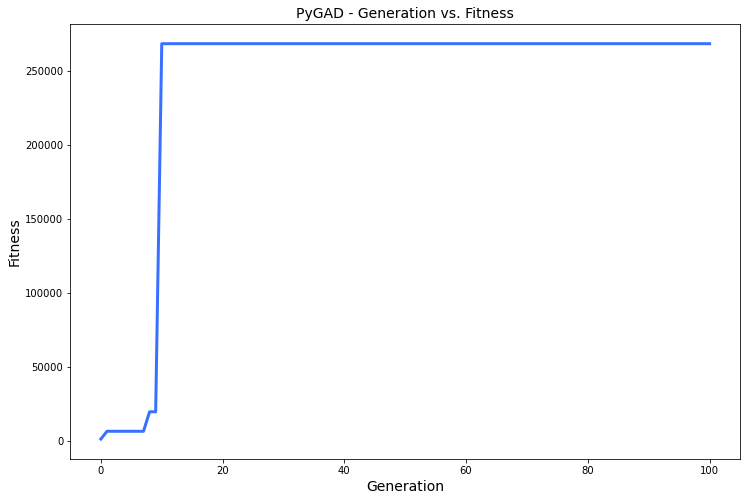

[-0.742]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.742 |===========| 9.359 |==================| 86.376 |==========
[-0.321]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 9.366 |==================| 199.7 |==========
[-0.51]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 9.363 |==================| 125.695 |==========
[-0.025]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.025 |===========| 9.37 |==================| 2529.546 |==========
[-0.622]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.622 |===========| 9.361 |==================| 103.1 |==========
[-0.428]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 9.364 |==================| 149.838 |==========
[0.441]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 24.02 |==================| 249.137 |==========
[0.841]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 23.981 |==================| 23.194 |==========
[0.565]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 23.995 |==================| 34.625 |==========
[-0.567]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.567 |===========| 23.995 |==================| 34.474 |==========
[-0.708]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.708 |===========| 23.987 |==================| 27.582 |==========
[-0.812]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.812 |===========| 23.982 |==================| 24.02 |==========
[0.202]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 24.014 |==================| 105.117 |==========
[-0.247]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 24.011 |==================| 79.624 |==========
Fitness = 469.4366024167242
[0.841]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 23.981 |==================| 23.194 |==========
[0.565]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 23.995 |==================| 34.625 |==========
[-0.567]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.567 |===========| 23.995 |==================| 34.474 |==========
[-0.708]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.708 |===========| 23.987 |==================| 27.582 |==========
[-0.812]
=====|SOLUTION|===========|OUTPUT|===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 24.011 |==================| 79.624 |==========
[0.841]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 23.981 |==================| 23.194 |==========
[0.565]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 23.995 |==================| 34.625 |==========
[-0.567]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.567 |===========| 23.995 |==================| 34.474 |==========
[-0.708]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.708 |===========| 23.987 |==================| 27.582 |==========
[-0.812]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.812 |===========| 23.982 |==================| 24.02 |==========
[0.202]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 24.009 |==================| 67.961 |==========
Generation = 2
[-0.013]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 24.023 |==================| 1465.628 |==========
[0.828]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.828 |===========| 23.981 |==================| 23.549 |==========
[-0.169]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.169 |===========| 24.015 |==================| 115.905 |==========
[0.077]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 24.02 |==================| 254.013 |==========
[-0.382]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 24.004 |==================| 51.265 |==========
[-0.483]
=====|SOLUTION|===========|OUTPUT|==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 24.023 |==================| 1465.628 |==========
[0.828]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.828 |===========| 23.981 |==================| 23.549 |==========
[-0.169]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.169 |===========| 24.015 |==================| 115.905 |==========
[0.077]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 24.02 |==================| 254.013 |==========
[-0.382]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 24.004 |==================| 51.265 |==========
[-0.483]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 23.999 |==================| 40.564 |==========
[0.764]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 24.005 |==================| 53.482 |==========
[-0.289]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 24.009 |==================| 67.978 |==========
[-0.175]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 24.015 |==================| 112.061 |==========
[-0.946]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.946 |===========| 23.975 |==================| 20.587 |==========
[0.799]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.799 |===========| 23.983 |==================| 24.43 |==========
[-0.537]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.537 |===========| 23.996 |==================| 36.433 |==========
[0.567]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 24.009 |==================| 67.978 |==========
[-0.175]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 24.015 |==================| 112.061 |==========
[-0.946]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.946 |===========| 23.975 |==================| 20.587 |==========
[0.799]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.799 |===========| 23.983 |==================| 24.43 |==========
[-0.537]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.537 |===========| 23.996 |==================| 36.433 |==========
[0.567]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.567 |===========| 23.995 |==================| 34.511 |==========
[0.172]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 24.009 |==================| 67.978 |==========
[-0.175]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 24.015 |==================| 112.061 |==========
[-0.946]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.946 |===========| 23.975 |==================| 20.587 |==========
[0.799]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.799 |===========| 23.983 |==================| 24.43 |==========
[-0.537]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.537 |===========| 23.996 |==================| 36.433 |==========
[0.567]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.567 |===========| 23.995 |==================| 34.511 |==========
[0.172]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 24.004 |==================| 50.616 |==========
[0.859]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.859 |===========| 23.98 |==================| 22.696 |==========
[0.705]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.705 |===========| 23.988 |==================| 27.69 |==========
[-0.004]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 24.023 |==================| 4863.35 |==========
[0.076]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 24.02 |==================| 259.109 |==========
[-0.728]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.728 |===========| 23.986 |==================| 26.841 |==========
[0.084]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 24.001 |==================| 44.855 |==========
[0.387]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 24.004 |==================| 50.616 |==========
[0.859]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.859 |===========| 23.98 |==================| 22.696 |==========
[0.705]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.705 |===========| 23.988 |==================| 27.69 |==========
[-0.004]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 24.023 |==================| 4863.35 |==========
[0.076]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 24.02 |==================| 259.109 |==========
[-0.728]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 24.023 |==================| 2205.224 |==========
[-0.939]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.939 |===========| 23.975 |==================| 20.755 |==========
[-0.709]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.709 |===========| 23.987 |==================| 27.559 |==========
[-0.394]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 24.004 |==================| 49.788 |==========
[0.502]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 23.998 |==================| 38.969 |==========
[-0.451]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 24.001 |==================| 43.424 |==========
[-0.077]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.939 |===========| 23.975 |==================| 20.755 |==========
[-0.709]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.709 |===========| 23.987 |==================| 27.559 |==========
[-0.394]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 24.004 |==================| 49.788 |==========
[0.502]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 23.998 |==================| 38.969 |==========
[-0.451]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 24.001 |==================| 43.424 |==========
[-0.077]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 24.02 |==================| 255.143 |==========
[-0.399]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 24.023 |==================| 2205.224 |==========
[-0.939]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.939 |===========| 23.975 |==================| 20.755 |==========
[-0.709]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.709 |===========| 23.987 |==================| 27.559 |==========
[-0.394]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 24.004 |==================| 49.788 |==========
[0.502]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 23.998 |==================| 38.969 |==========
[-0.451]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 24.001 |==================| 43.424 |==========
[-0.077]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 23.999 |==================| 39.9 |==========
[0.817]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.817 |===========| 23.982 |==================| 23.888 |==========
[0.932]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.932 |===========| 23.976 |==================| 20.919 |==========
[-0.328]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 24.007 |==================| 59.732 |==========
[-0.742]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.742 |===========| 23.986 |==================| 26.305 |==========
[-0.911]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.911 |===========| 23.977 |==================| 21.395 |==========
[0.205]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 23.999 |==================| 39.9 |==========
[0.817]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.817 |===========| 23.982 |==================| 23.888 |==========
[0.932]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.932 |===========| 23.976 |==================| 20.919 |==========
[-0.328]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 24.007 |==================| 59.732 |==========
[-0.742]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.742 |===========| 23.986 |==================| 26.305 |==========
[-0.911]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.911 |===========| 23.977 |==================| 21.395 |==========
[0.205]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 24.009 |==================| 67.654 |==========
[-0.544]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.544 |===========| 23.996 |==================| 35.946 |==========
[0.332]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 24.007 |==================| 59.152 |==========
[0.68]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.68 |===========| 23.989 |==================| 28.719 |==========
[0.453]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 24.0 |==================| 43.19 |==========
[0.851]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 23.98 |==================| 22.929 |==========
[0.082]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.544 |===========| 23.996 |==================| 35.946 |==========
[0.332]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 24.007 |==================| 59.152 |==========
[0.68]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.68 |===========| 23.989 |==================| 28.719 |==========
[0.453]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 24.0 |==================| 43.19 |==========
[0.851]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 23.98 |==================| 22.929 |==========
[0.082]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.082 |===========| 24.019 |==================| 240.509 |==========
[-0.93]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 24.009 |==================| 67.654 |==========
[-0.544]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.544 |===========| 23.996 |==================| 35.946 |==========
[0.332]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 24.007 |==================| 59.152 |==========
[0.68]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.68 |===========| 23.989 |==================| 28.719 |==========
[0.453]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 24.0 |==================| 43.19 |==========
[0.851]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 23.98 |==================| 22.929 |==========
[0.082]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 24.001 |==================| 45.111 |==========
[0.519]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.519 |===========| 23.997 |==================| 37.727 |==========
[-0.635]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.635 |===========| 23.991 |==================| 30.799 |==========
[-0.843]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.843 |===========| 23.98 |==================| 23.127 |==========
[-0.623]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.623 |===========| 23.992 |==================| 31.378 |==========
[0.834]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.834 |===========| 23.981 |==================| 23.379 |==========
[-0.534]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

[-0.635]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.635 |===========| 23.991 |==================| 30.799 |==========
[-0.843]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.843 |===========| 23.98 |==================| 23.127 |==========
[-0.623]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.623 |===========| 23.992 |==================| 31.378 |==========
[0.834]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.834 |===========| 23.981 |==================| 23.379 |==========
[-0.534]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.534 |===========| 23.996 |==================| 36.632 |==========
[0.545]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.545 |===========| 23.996 |==================| 35.917 |==========
[-0.84]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

[0.805]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.805 |===========| 23.982 |==================| 24.245 |==========
[0.93]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.93 |===========| 23.976 |==================| 20.956 |==========
[0.622]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.622 |===========| 23.992 |==================| 31.45 |==========
[-0.968]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.968 |===========| 23.974 |==================| 20.114 |==========
[0.172]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 24.015 |==================| 113.933 |==========
[-0.268]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 24.01 |==================| 73.184 |==========
[-0.926]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.548 |===========| 23.996 |==================| 35.731 |==========
[0.805]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.805 |===========| 23.982 |==================| 24.245 |==========
[0.93]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.93 |===========| 23.976 |==================| 20.956 |==========
[0.622]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.622 |===========| 23.992 |==================| 31.45 |==========
[-0.968]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.968 |===========| 23.974 |==================| 20.114 |==========
[0.172]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 24.015 |==================| 113.933 |==========
[-0.268]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

[0.851]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 23.98 |==================| 22.929 |==========
[-0.548]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.548 |===========| 23.996 |==================| 35.731 |==========
[0.805]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.805 |===========| 23.982 |==================| 24.245 |==========
[0.93]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.93 |===========| 23.976 |==================| 20.956 |==========
[0.622]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.622 |===========| 23.992 |==================| 31.45 |==========
[-0.968]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.968 |===========| 23.974 |==================| 20.114 |==========
[0.172]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.932 |===========| 23.976 |==================| 20.919 |==========
[-0.649]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.649 |===========| 23.99 |==================| 30.096 |==========
[-0.433]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 24.002 |==================| 45.25 |==========
[0.002]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 24.024 |==================| 10659.992 |==========
[-0.024]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 24.022 |==================| 829.608 |==========
[0.283]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 24.009 |==================| 69.373 |==========
[0.576]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.932 |===========| 23.976 |==================| 20.919 |==========
[-0.649]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.649 |===========| 23.99 |==================| 30.096 |==========
[-0.433]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 24.002 |==================| 45.25 |==========
[0.002]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 24.024 |==================| 10659.992 |==========
[-0.024]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 24.022 |==================| 829.608 |==========
[0.283]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 24.009 |==================| 69.373 |==========
[0.576]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 24.012 |==================| 87.874 |==========
[-0.859]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.859 |===========| 23.98 |==================| 22.701 |==========
[-0.634]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.634 |===========| 23.991 |==================| 30.816 |==========
[-0.416]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 24.002 |==================| 47.113 |==========
[0.479]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 23.999 |==================| 40.91 |==========
[0.601]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 23.993 |==================| 32.537 |==========
[0.694]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 24.012 |==================| 87.874 |==========
[-0.859]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.859 |===========| 23.98 |==================| 22.701 |==========
[-0.634]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.634 |===========| 23.991 |==================| 30.816 |==========
[-0.416]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 24.002 |==================| 47.113 |==========
[0.479]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 23.999 |==================| 40.91 |==========
[0.601]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 23.993 |==================| 32.537 |==========
[0.694]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.859 |===========| 23.98 |==================| 22.701 |==========
[-0.634]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.634 |===========| 23.991 |==================| 30.816 |==========
[-0.416]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 24.002 |==================| 47.113 |==========
[0.479]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 23.999 |==================| 40.91 |==========
[0.601]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 23.993 |==================| 32.537 |==========
[0.694]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.694 |===========| 23.988 |==================| 28.168 |==========
[0.749]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.524 |===========| 23.997 |==================| 37.381 |==========
[0.986]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.986 |===========| 23.973 |==================| 19.762 |==========
[0.689]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.689 |===========| 23.988 |==================| 28.366 |==========
[-0.36]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 24.005 |==================| 54.422 |==========
[0.845]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.845 |===========| 23.98 |==================| 23.089 |==========
[0.229]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 24.012 |==================| 85.632 |==========
[0.866]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.986 |===========| 23.973 |==================| 19.762 |==========
[0.689]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.689 |===========| 23.988 |==================| 28.366 |==========
[-0.36]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 24.005 |==================| 54.422 |==========
[0.845]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.845 |===========| 23.98 |==================| 23.089 |==========
[0.229]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 24.012 |==================| 85.632 |==========
[0.866]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.866 |===========| 23.979 |==================| 22.528 |==========
[0.363]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.985 |===========| 23.973 |==================| 19.767 |==========
[-0.123]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.123 |===========| 24.017 |==================| 159.856 |==========
[-0.67]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 23.989 |==================| 29.147 |==========
[0.442]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |===========| 24.001 |==================| 44.285 |==========
[0.007]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 24.023 |==================| 2809.71 |==========
[0.859]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.859 |===========| 23.98 |==================| 22.703 |==========
[0.846]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.123 |===========| 24.017 |==================| 159.856 |==========
[-0.67]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 23.989 |==================| 29.147 |==========
[0.442]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |===========| 24.001 |==================| 44.285 |==========
[0.007]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 24.023 |==================| 2809.71 |==========
[0.859]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.859 |===========| 23.98 |==================| 22.703 |==========
[0.846]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.846 |===========| 23.98 |==================| 23.059 |==========
[-0.921]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

[-0.67]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 23.989 |==================| 29.147 |==========
[0.442]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |===========| 24.001 |==================| 44.285 |==========
[0.007]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 24.023 |==================| 2809.71 |==========
[0.859]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.859 |===========| 23.98 |==================| 22.703 |==========
[0.846]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.846 |===========| 23.98 |==================| 23.059 |==========
[-0.921]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.921 |===========| 23.976 |==================| 21.168 |==========
[-0.792]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 23.999 |==================| 40.444 |==========
[0.26]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 24.01 |==================| 75.414 |==========
[0.981]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.981 |===========| 23.973 |==================| 19.847 |==========
[0.258]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 24.011 |==================| 76.158 |==========
[-0.31]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 24.008 |==================| 63.235 |==========
Fitness = 95718.57745318253
[-0.792]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.792 |===========| 23.983 |==================| 24.639 |==========
[0.014]
=====|SOLUTION|===========|OUTPUT|===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.981 |===========| 23.973 |==================| 19.847 |==========
[0.258]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 24.011 |==================| 76.158 |==========
[-0.31]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 24.008 |==================| 63.235 |==========
[-0.792]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.792 |===========| 23.983 |==================| 24.639 |==========
[0.014]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 24.023 |==================| 1375.538 |==========
[-0.605]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.605 |===========| 23.993 |==================| 32.314 |==========
[0.28]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 23.979 |==================| 22.328 |==========
Generation = 15
[-0.516]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 23.997 |==================| 37.896 |==========
[0.472]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 24.0 |==================| 41.47 |==========
[0.197]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 24.014 |==================| 99.731 |==========
[0.456]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 24.0 |==================| 42.932 |==========
[0.948]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.948 |===========| 23.975 |==================| 20.549 |==========
[0.943]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 23.979 |==================| 22.328 |==========
Change = 0.0
[-0.516]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 23.997 |==================| 37.896 |==========
[0.472]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 24.0 |==================| 41.47 |==========
[0.197]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 24.014 |==================| 99.731 |==========
[0.456]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 24.0 |==================| 42.932 |==========
[0.948]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.948 |===========| 23.975 |==================| 20.549 |==========
[0.943]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.939 |===========| 23.975 |==================| 20.747 |==========
[0.873]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 23.979 |==================| 22.328 |==========
[-0.866]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.866 |===========| 23.979 |==================| 22.526 |==========
[-0.647]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.647 |===========| 23.991 |==================| 30.191 |==========
[0.884]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 23.978 |==================| 22.046 |==========
[0.943]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.943 |===========| 23.975 |==================| 20.671 |==========
[0.398]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.628 |===========| 23.992 |==================| 31.136 |==========
Fitness = 95718.57745318253
[-0.866]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.866 |===========| 23.979 |==================| 22.526 |==========
[-0.647]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.647 |===========| 23.991 |==================| 30.191 |==========
[0.884]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 23.978 |==================| 22.046 |==========
[0.943]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.943 |===========| 23.975 |==================| 20.671 |==========
[0.398]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 24.003 |==================| 49.191 |==========
[-0.307]
=====|SOLUTION|===========|OUTPUT|=====

[-0.647]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.647 |===========| 23.991 |==================| 30.191 |==========
[0.884]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 23.978 |==================| 22.046 |==========
[0.943]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.943 |===========| 23.975 |==================| 20.671 |==========
[0.398]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 24.003 |==================| 49.191 |==========
[-0.307]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.307 |===========| 24.008 |==================| 63.959 |==========
[0.834]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.834 |===========| 23.981 |==================| 23.381 |==========
[0.079]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 24.017 |==================| 155.615 |==========
[-0.349]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 24.006 |==================| 56.26 |==========
[-0.781]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.781 |===========| 23.984 |==================| 24.997 |==========
[0.369]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 24.005 |==================| 53.149 |==========
[-0.854]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.854 |===========| 23.98 |==================| 22.829 |==========
[0.398]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 24.003 |==================| 49.197 |==========
[0.869]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 24.017 |==================| 155.615 |==========
[-0.349]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 24.006 |==================| 56.26 |==========
[-0.781]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.781 |===========| 23.984 |==================| 24.997 |==========
[0.369]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 24.005 |==================| 53.149 |==========
[-0.854]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.854 |===========| 23.98 |==================| 22.829 |==========
[0.398]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 24.003 |==================| 49.197 |==========
[0.869]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.828 |===========| 23.981 |==================| 23.566 |==========
[-0.433]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 24.002 |==================| 45.227 |==========
[0.545]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.545 |===========| 23.996 |==================| 35.882 |==========
[-0.283]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 24.009 |==================| 69.271 |==========
[0.299]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 24.008 |==================| 65.621 |==========
[-0.178]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 24.015 |==================| 110.507 |==========
[-0.7]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 24.002 |==================| 45.227 |==========
[0.545]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.545 |===========| 23.996 |==================| 35.882 |==========
[-0.283]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 24.009 |==================| 69.271 |==========
[0.299]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 24.008 |==================| 65.621 |==========
[-0.178]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 24.015 |==================| 110.507 |==========
[-0.7]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.7 |===========| 23.988 |==================| 27.911 |==========
[-0.267]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 24.002 |==================| 45.227 |==========
[0.545]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.545 |===========| 23.996 |==================| 35.882 |==========
[-0.283]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 24.009 |==================| 69.271 |==========
[0.299]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 24.008 |==================| 65.621 |==========
[-0.178]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 24.015 |==================| 110.507 |==========
[-0.7]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.7 |===========| 23.988 |==================| 27.911 |==========
[-0.267]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

[-0.974]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.974 |===========| 23.974 |==================| 19.995 |==========
[-0.571]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.571 |===========| 23.994 |==================| 34.236 |==========
[-0.575]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 23.994 |==================| 33.993 |==========
[0.707]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.707 |===========| 23.987 |==================| 27.625 |==========
[0.842]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.842 |===========| 23.98 |==================| 23.157 |==========
[0.187]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 24.014 |==================| 105.215 |==========
[-0.358]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.571 |===========| 23.994 |==================| 34.236 |==========
[-0.575]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 23.994 |==================| 33.993 |==========
[0.707]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.707 |===========| 23.987 |==================| 27.625 |==========
[0.842]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.842 |===========| 23.98 |==================| 23.157 |==========
[0.187]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 24.014 |==================| 105.215 |==========
[-0.358]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 24.005 |==================| 54.755 |==========
[0.488]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 24.004 |==================| 52.189 |==========
[-0.752]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 23.985 |==================| 25.974 |==========
[-0.263]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 24.01 |==================| 74.699 |==========
[0.564]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.564 |===========| 23.995 |==================| 34.678 |==========
[-0.286]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 24.009 |==================| 68.572 |==========
[-0.747]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.747 |===========| 23.985 |==================| 26.127 |==========
[0.444]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

[-0.752]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 23.985 |==================| 25.974 |==========
[-0.263]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 24.01 |==================| 74.699 |==========
[0.564]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.564 |===========| 23.995 |==================| 34.678 |==========
[-0.286]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 24.009 |==================| 68.572 |==========
[-0.747]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.747 |===========| 23.985 |==================| 26.127 |==========
[0.444]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 24.001 |==================| 44.129 |==========
[0.095]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 23.985 |==================| 25.974 |==========
[-0.263]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 24.01 |==================| 74.699 |==========
[0.564]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.564 |===========| 23.995 |==================| 34.678 |==========
[-0.286]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 24.009 |==================| 68.572 |==========
[-0.747]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.747 |===========| 23.985 |==================| 26.127 |==========
[0.444]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 24.001 |==================| 44.129 |==========
[0.095]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.65 |===========| 23.99 |==================| 30.07 |==========
[-0.305]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 24.008 |==================| 64.322 |==========
[-0.099]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 24.019 |==================| 199.123 |==========
[-0.565]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 23.995 |==================| 34.603 |==========
[0.62]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.62 |===========| 23.992 |==================| 31.512 |==========
[-0.875]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.875 |===========| 23.979 |==================| 22.275 |==========
[0.436]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.65 |===========| 23.99 |==================| 30.07 |==========
[-0.305]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 24.008 |==================| 64.322 |==========
[-0.099]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 24.019 |==================| 199.123 |==========
[-0.565]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 23.995 |==================| 34.603 |==========
[0.62]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.62 |===========| 23.992 |==================| 31.512 |==========
[-0.875]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.875 |===========| 23.979 |==================| 22.275 |==========
[0.436]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.788 |===========| 23.983 |==================| 24.778 |==========
[0.637]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.637 |===========| 23.991 |==================| 30.681 |==========
[-0.639]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 23.991 |==================| 30.602 |==========
[0.759]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.759 |===========| 23.985 |==================| 25.733 |==========
[-0.207]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 24.013 |==================| 94.884 |==========
[-0.747]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.747 |===========| 23.985 |==================| 26.143 |==========
[0.393]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 24.015 |==================| 115.387 |==========
[0.788]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.788 |===========| 23.983 |==================| 24.778 |==========
[0.637]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.637 |===========| 23.991 |==================| 30.681 |==========
[-0.639]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 23.991 |==================| 30.602 |==========
[0.759]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.759 |===========| 23.985 |==================| 25.733 |==========
[-0.207]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 24.013 |==================| 94.884 |==========
[-0.747]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 24.007 |==================| 58.339 |==========
[0.17]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 24.015 |==================| 115.387 |==========
[0.788]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.788 |===========| 23.983 |==================| 24.778 |==========
[0.637]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.637 |===========| 23.991 |==================| 30.681 |==========
[-0.639]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 23.991 |==================| 30.602 |==========
[0.759]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.759 |===========| 23.985 |==================| 25.733 |==========
[-0.207]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.97 |===========| 23.974 |==================| 20.072 |==========
[-0.935]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.935 |===========| 23.976 |==================| 20.836 |==========
[-0.328]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 24.007 |==================| 59.809 |==========
[-0.851]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 23.98 |==================| 22.919 |==========
[0.399]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 24.003 |==================| 49.081 |==========
[0.466]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 24.0 |==================| 42.062 |==========
[-0.598]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.97 |===========| 23.974 |==================| 20.072 |==========
[-0.935]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.935 |===========| 23.976 |==================| 20.836 |==========
[-0.328]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 24.007 |==================| 59.809 |==========
[-0.851]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 23.98 |==================| 22.919 |==========
[0.399]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 24.003 |==================| 49.081 |==========
[0.466]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 24.0 |==================| 42.062 |==========
[-0.598]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.498 |===========| 23.998 |==================| 39.283 |==========
[0.183]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 24.014 |==================| 107.145 |==========
[-0.589]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 23.994 |==================| 33.184 |==========
[-0.982]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.982 |===========| 23.973 |==================| 19.833 |==========
[0.747]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.747 |===========| 23.985 |==================| 26.123 |==========
[0.305]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 24.008 |==================| 64.294 |==========
[0.921]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 24.014 |==================| 107.145 |==========
[-0.589]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 23.994 |==================| 33.184 |==========
[-0.982]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.982 |===========| 23.973 |==================| 19.833 |==========
[0.747]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.747 |===========| 23.985 |==================| 26.123 |==========
[0.305]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 24.008 |==================| 64.294 |==========
[0.921]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.921 |===========| 23.976 |==================| 21.155 |==========
[-0.221]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 23.994 |==================| 33.184 |==========
[-0.982]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.982 |===========| 23.973 |==================| 19.833 |==========
[0.747]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.747 |===========| 23.985 |==================| 26.123 |==========
[0.305]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 24.008 |==================| 64.294 |==========
[0.921]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.921 |===========| 23.976 |==================| 21.155 |==========
[-0.221]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 24.012 |==================| 88.716 |==========
[-0.029]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 24.006 |==================| 56.267 |==========
[0.945]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.945 |===========| 23.975 |==================| 20.625 |==========
[-0.657]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.657 |===========| 23.99 |==================| 29.742 |==========
[0.466]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 24.0 |==================| 42.05 |==========
[0.115]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 24.018 |==================| 170.348 |==========
[-0.39]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 24.004 |==================| 50.29 |==========
[0.647]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 24.006 |==================| 55.392 |==========
[-0.348]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 24.006 |==================| 56.267 |==========
[0.945]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.945 |===========| 23.975 |==================| 20.625 |==========
[-0.657]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.657 |===========| 23.99 |==================| 29.742 |==========
[0.466]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 24.0 |==================| 42.05 |==========
[0.115]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 24.018 |==================| 170.348 |==========
[-0.39]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.209 |===========| 24.013 |==================| 94.052 |==========
[-0.899]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.899 |===========| 23.978 |==================| 21.696 |==========
[-0.668]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 23.989 |==================| 29.252 |==========
[0.982]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.982 |===========| 23.973 |==================| 19.834 |==========
[0.272]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 24.01 |==================| 72.051 |==========
[0.873]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 23.979 |==================| 22.338 |==========
[0.606]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.209 |===========| 24.013 |==================| 94.052 |==========
[-0.899]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.899 |===========| 23.978 |==================| 21.696 |==========
[-0.668]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 23.989 |==================| 29.252 |==========
[0.982]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.982 |===========| 23.973 |==================| 19.834 |==========
[0.272]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 24.01 |==================| 72.051 |==========
[0.873]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 23.979 |==================| 22.338 |==========
[0.606]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

[-0.496]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 23.998 |==================| 39.499 |==========
[-0.209]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.209 |===========| 24.013 |==================| 94.052 |==========
[-0.899]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.899 |===========| 23.978 |==================| 21.696 |==========
[-0.668]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 23.989 |==================| 29.252 |==========
[0.982]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.982 |===========| 23.973 |==================| 19.834 |==========
[0.272]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 24.01 |==================| 72.051 |==========
[0.873]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.85 |===========| 23.98 |==================| 22.958 |==========
[-0.324]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 24.007 |==================| 60.452 |==========
[0.769]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.769 |===========| 23.984 |==================| 25.375 |==========
[-0.912]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.912 |===========| 23.977 |==================| 21.369 |==========
[0.191]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 24.014 |==================| 102.593 |==========
[0.44]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 24.001 |==================| 44.539 |==========
[0.574]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.712 |===========| 23.987 |==================| 27.452 |==========
[-0.85]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.85 |===========| 23.98 |==================| 22.958 |==========
[-0.324]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 24.007 |==================| 60.452 |==========
[0.769]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.769 |===========| 23.984 |==================| 25.375 |==========
[-0.912]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.912 |===========| 23.977 |==================| 21.369 |==========
[0.191]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 24.014 |==================| 102.593 |==========
[0.44]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 24.007 |==================| 60.566 |==========
[0.989]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.989 |===========| 23.973 |==================| 19.695 |==========
[0.812]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.812 |===========| 23.982 |==================| 24.036 |==========
[0.512]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.512 |===========| 23.997 |==================| 38.24 |==========
[0.901]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.901 |===========| 23.977 |==================| 21.64 |==========
[0.839]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.839 |===========| 23.981 |==================| 23.243 |==========
[-0.399]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.812 |===========| 23.982 |==================| 24.036 |==========
[0.512]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.512 |===========| 23.997 |==================| 38.24 |==========
[0.901]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.901 |===========| 23.977 |==================| 21.64 |==========
[0.839]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.839 |===========| 23.981 |==================| 23.243 |==========
[-0.399]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 24.003 |==================| 49.169 |==========
[-0.507]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.507 |===========| 23.998 |==================| 38.639 |==========
[-0.87]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.901 |===========| 23.977 |==================| 21.64 |==========
[0.839]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.839 |===========| 23.981 |==================| 23.243 |==========
[-0.399]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 24.003 |==================| 49.169 |==========
[-0.507]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.507 |===========| 23.998 |==================| 38.639 |==========
[-0.87]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.87 |===========| 23.979 |==================| 22.42 |==========
[0.548]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.548 |===========| 23.996 |==================| 35.692 |==========
[0.106]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.898 |===========| 23.978 |==================| 21.715 |==========
[0.423]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 24.002 |==================| 46.329 |==========
[-0.149]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 24.016 |==================| 131.66 |==========
[0.229]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 24.012 |==================| 85.784 |==========
[0.699]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.699 |===========| 23.988 |==================| 27.937 |==========
[-0.545]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.545 |===========| 23.996 |==================| 35.934 |==========
[-0.27]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.898 |===========| 23.978 |==================| 21.715 |==========
[0.423]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 24.002 |==================| 46.329 |==========
[-0.149]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 24.016 |==================| 131.66 |==========
[0.229]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 24.012 |==================| 85.784 |==========
[0.699]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.699 |===========| 23.988 |==================| 27.937 |==========
[-0.545]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.545 |===========| 23.996 |==================| 35.934 |==========
[-0.27]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 24.013 |==================| 94.724 |==========
[-0.727]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 23.986 |==================| 26.863 |==========
[-0.564]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.564 |===========| 23.995 |==================| 34.693 |==========
[-0.21]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 24.013 |==================| 93.297 |==========
[-0.073]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 24.02 |==================| 269.533 |==========
[-0.293]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 24.009 |==================| 67.041 |==========
[0.317]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.677 |===========| 23.989 |==================| 28.869 |==========
[0.207]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 24.013 |==================| 94.724 |==========
[-0.727]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 23.986 |==================| 26.863 |==========
[-0.564]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.564 |===========| 23.995 |==================| 34.693 |==========
[-0.21]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 24.013 |==================| 93.297 |==========
[-0.073]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 24.02 |==================| 269.533 |==========
[-0.293]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 24.013 |==================| 94.724 |==========
[-0.727]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 23.986 |==================| 26.863 |==========
[-0.564]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.564 |===========| 23.995 |==================| 34.693 |==========
[-0.21]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 24.013 |==================| 93.297 |==========
[-0.073]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 24.02 |==================| 269.533 |==========
[-0.293]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 24.009 |==================| 67.041 |==========
[0.317]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.891 |===========| 23.978 |==================| 21.874 |==========
[-0.261]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 24.01 |==================| 75.216 |==========
[-0.41]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 24.003 |==================| 47.736 |==========
[-0.927]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.927 |===========| 23.976 |==================| 21.021 |==========
[-0.367]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 24.005 |==================| 53.383 |==========
[-0.768]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 23.984 |==================| 25.416 |==========
[0.537]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

[0.57]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.57 |===========| 23.995 |==================| 34.33 |==========
[0.891]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.891 |===========| 23.978 |==================| 21.874 |==========
[-0.261]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 24.01 |==================| 75.216 |==========
[-0.41]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 24.003 |==================| 47.736 |==========
[-0.927]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.927 |===========| 23.976 |==================| 21.021 |==========
[-0.367]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 24.005 |==================| 53.383 |==========
[-0.768]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 24.004 |==================| 52.062 |==========
[-0.247]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 24.011 |==================| 79.596 |==========
[0.882]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 23.978 |==================| 22.105 |==========
[-0.495]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 23.998 |==================| 39.575 |==========
[0.125]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 24.017 |==================| 157.787 |==========
[-0.361]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 24.005 |==================| 54.371 |==========
[0.979]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 23.978 |==================| 22.105 |==========
[-0.495]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 23.998 |==================| 39.575 |==========
[0.125]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 24.017 |==================| 157.787 |==========
[-0.361]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 24.005 |==================| 54.371 |==========
[0.979]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.979 |===========| 23.973 |==================| 19.891 |==========
[0.5]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.5 |===========| 23.998 |==================| 39.174 |==========
[0.672]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 23.978 |==================| 22.105 |==========
[-0.495]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 23.998 |==================| 39.575 |==========
[0.125]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 24.017 |==================| 157.787 |==========
[-0.361]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 24.005 |==================| 54.371 |==========
[0.979]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.979 |===========| 23.973 |==================| 19.891 |==========
[0.5]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.5 |===========| 23.998 |==================| 39.174 |==========
[0.672]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 24.02 |==================| 254.167 |==========
[-0.527]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.527 |===========| 23.997 |==================| 37.111 |==========
[0.531]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.531 |===========| 23.997 |==================| 36.855 |==========
[0.874]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.874 |===========| 23.979 |==================| 22.303 |==========
[0.838]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 23.981 |==================| 23.284 |==========
[0.888]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.888 |===========| 23.978 |==================| 21.955 |==========
Fitness = 95718.57745318253
[-0.296]
=====|SOLUTION|===========|OUTPUT|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.527 |===========| 23.997 |==================| 37.111 |==========
[0.531]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.531 |===========| 23.997 |==================| 36.855 |==========
[0.874]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.874 |===========| 23.979 |==================| 22.303 |==========
[0.838]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 23.981 |==================| 23.284 |==========
[0.888]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.888 |===========| 23.978 |==================| 21.955 |==========
[-0.296]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 24.009 |==================| 66.363 |==========
[-0.58]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.761 |===========| 23.985 |==================| 25.64 |==========
[-0.409]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 24.003 |==================| 47.93 |==========
[-0.347]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 24.006 |==================| 56.579 |==========
[0.802]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.802 |===========| 23.983 |==================| 24.336 |==========
Generation = 34
[0.869]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.869 |===========| 23.979 |==================| 22.443 |==========
[-0.213]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 24.013 |==================| 92.269 |==========
[0.006]
=====|SOLUTION|===========|OUTPUT|==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.761 |===========| 23.985 |==================| 25.64 |==========
[-0.409]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 24.003 |==================| 47.93 |==========
[-0.347]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 24.006 |==================| 56.579 |==========
[0.802]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.802 |===========| 23.983 |==================| 24.336 |==========
Change = 0.0
[0.869]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.869 |===========| 23.979 |==================| 22.443 |==========
[-0.213]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 24.013 |==================| 92.269 |==========
[0.006]
=====|SOLUTION|===========|OUTPUT|==================|FIT

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 24.003 |==================| 47.93 |==========
[-0.347]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 24.006 |==================| 56.579 |==========
[0.802]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.802 |===========| 23.983 |==================| 24.336 |==========
[0.018]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 24.023 |==================| 1105.613 |==========
[-0.917]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 23.977 |==================| 21.264 |==========
[0.395]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 24.004 |==================| 49.676 |==========
[0.054]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.868 |===========| 23.979 |==================| 22.478 |==========
[0.517]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.517 |===========| 23.997 |==================| 37.871 |==========
[0.188]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 24.014 |==================| 104.423 |==========
[-0.279]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 24.009 |==================| 70.307 |==========
Fitness = 95718.57745318253
[0.018]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 24.023 |==================| 1105.613 |==========
[-0.917]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 23.977 |==================| 21.264 |==========
[0.395]
=====|SOLUTION|===========|OUTPUT|===

[-0.668]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 23.989 |==================| 29.235 |==========
[-0.868]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.868 |===========| 23.979 |==================| 22.478 |==========
[0.517]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.517 |===========| 23.997 |==================| 37.871 |==========
[0.188]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 24.014 |==================| 104.423 |==========
[-0.279]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 24.009 |==================| 70.307 |==========
[0.018]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 24.023 |==================| 1105.613 |==========
[-0.917]
=====|SOLUTION|===========|OUTPUT|==================|FI

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 24.015 |==================| 120.034 |==========
[-0.77]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.77 |===========| 23.984 |==================| 25.364 |==========
[0.658]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.658 |===========| 23.99 |==================| 29.688 |==========
[-0.757]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.757 |===========| 23.985 |==================| 25.775 |==========
[-0.282]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 24.009 |==================| 69.53 |==========
Generation = 36
[0.364]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 24.005 |==================| 53.872 |==========
[0.508]
=====|SOLUTION|===========|OUTPUT|==================|F

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.77 |===========| 23.984 |==================| 25.364 |==========
[0.658]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.658 |===========| 23.99 |==================| 29.688 |==========
[-0.757]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.757 |===========| 23.985 |==================| 25.775 |==========
[-0.282]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 24.009 |==================| 69.53 |==========
Change = 0.0
[0.364]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 24.005 |==================| 53.872 |==========
[0.508]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.508 |===========| 23.998 |==================| 38.521 |==========
[0.764]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.757 |===========| 23.985 |==================| 25.775 |==========
[-0.282]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 24.009 |==================| 69.53 |==========
[0.208]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 24.013 |==================| 94.384 |==========
[0.205]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 24.013 |==================| 95.59 |==========
[-0.897]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 23.978 |==================| 21.736 |==========
[0.377]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 24.004 |==================| 51.956 |==========
[0.541]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

[-0.953]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.953 |===========| 23.975 |==================| 20.453 |==========
Fitness = 95718.57745318253
[0.208]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 24.013 |==================| 94.384 |==========
[0.205]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 24.013 |==================| 95.59 |==========
[-0.897]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 23.978 |==================| 21.736 |==========
[0.377]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 24.004 |==================| 51.956 |==========
[0.541]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.541 |===========| 23.996 |==================| 36.187 |==========
[0.567]
=====|SOLUTION|===========|OUTPUT

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 24.009 |==================| 68.024 |==========
[-0.953]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.953 |===========| 23.975 |==================| 20.453 |==========
[0.208]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 24.013 |==================| 94.384 |==========
[0.205]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 24.013 |==================| 95.59 |==========
[-0.897]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 23.978 |==================| 21.736 |==========
[0.377]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 24.004 |==================| 51.956 |==========
[0.541]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.729 |===========| 23.986 |==================| 26.785 |==========
[0.759]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.759 |===========| 23.985 |==================| 25.719 |==========
[-0.192]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 24.014 |==================| 102.429 |==========
Generation = 38
[0.321]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 24.007 |==================| 61.151 |==========
[-0.677]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.677 |===========| 23.989 |==================| 28.88 |==========
[-0.808]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.808 |===========| 23.982 |==================| 24.135 |==========
[0.082]
=====|SOLUTION|===========|OUTPUT|=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 24.007 |==================| 60.565 |==========
[0.729]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.729 |===========| 23.986 |==================| 26.785 |==========
[0.759]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.759 |===========| 23.985 |==================| 25.719 |==========
[-0.192]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 24.014 |==================| 102.429 |==========
Change = 0.0
[0.321]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 24.007 |==================| 61.151 |==========
[-0.677]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.677 |===========| 23.989 |==================| 28.88 |==========
[-0.808]
=====|SOLUTION|===========|OUTPUT|==================|F

[-0.324]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 24.007 |==================| 60.565 |==========
[0.729]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.729 |===========| 23.986 |==================| 26.785 |==========
[0.759]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.759 |===========| 23.985 |==================| 25.719 |==========
[-0.192]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 24.014 |==================| 102.429 |==========
[-0.947]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.947 |===========| 23.975 |==================| 20.578 |==========
[-0.611]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.611 |===========| 23.992 |==================| 32.014 |==========
[0.889]
=====|SOLUTION|===========|OUTPUT|==================|FITN

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.996 |===========| 23.973 |==================| 19.561 |==========
[-0.78]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.78 |===========| 23.984 |==================| 25.015 |==========
[-0.038]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 24.022 |==================| 518.989 |==========
[-0.437]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 24.001 |==================| 44.794 |==========
Fitness = 95718.57745318253
[-0.947]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.947 |===========| 23.975 |==================| 20.578 |==========
[-0.611]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.611 |===========| 23.992 |==================| 32.014 |==========
[0.889]
=====|SOLUTION|===========|OUTPUT|====

[-0.038]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 24.022 |==================| 518.989 |==========
[-0.437]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 24.001 |==================| 44.794 |==========
[-0.947]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.947 |===========| 23.975 |==================| 20.578 |==========
[-0.611]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.611 |===========| 23.992 |==================| 32.014 |==========
[0.889]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.889 |===========| 23.978 |==================| 21.937 |==========
[0.805]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.805 |===========| 23.982 |==================| 24.242 |==========
[-0.538]
=====|SOLUTION|===========|OUTPUT|==================|FIT

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 23.989 |==================| 29.275 |==========
[-0.4]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 24.003 |==================| 48.988 |==========
Generation = 40
[-0.08]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 24.02 |==================| 246.518 |==========
[-0.575]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 23.994 |==================| 34.032 |==========
[0.26]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 24.01 |==================| 75.534 |==========
[-0.313]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 24.008 |==================| 62.72 |==========
[-0.052]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 23.989 |==================| 29.275 |==========
[-0.4]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 24.003 |==================| 48.988 |==========
Change = 0.0
[-0.08]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 24.02 |==================| 246.518 |==========
[-0.575]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 23.994 |==================| 34.032 |==========
[0.26]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 24.01 |==================| 75.534 |==========
[-0.313]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 24.008 |==================| 62.72 |==========
[-0.052]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 23.998 |==================| 39.462 |==========
[-0.668]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 23.989 |==================| 29.275 |==========
[-0.4]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 24.003 |==================| 48.988 |==========
[0.038]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 24.022 |==================| 518.621 |==========
[-0.162]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 24.015 |==================| 121.193 |==========
[-0.672]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.672 |===========| 23.989 |==================| 29.072 |==========
[-0.91]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 24.001 |==================| 43.261 |==========
[-0.96]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.96 |===========| 23.974 |==================| 20.301 |==========
[0.253]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 24.011 |==================| 77.536 |==========
[0.429]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 24.002 |==================| 45.673 |==========
Fitness = 95718.57745318253
[0.038]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 24.022 |==================| 518.621 |==========
[-0.162]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 24.015 |==================| 121.193 |==========
[-0.672]
=====|SOLUTION|===========|OUTPUT|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 24.024 |==================| 35267.437 |==========
[-0.453]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 24.001 |==================| 43.261 |==========
[-0.96]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.96 |===========| 23.974 |==================| 20.301 |==========
[0.253]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 24.011 |==================| 77.536 |==========
[0.429]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 24.002 |==================| 45.673 |==========
[0.038]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 24.022 |==================| 518.621 |==========
[-0.162]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 23.999 |==================| 40.549 |==========
[-0.317]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 24.007 |==================| 61.845 |==========
[0.139]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 24.017 |==================| 141.058 |==========
[0.896]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.896 |===========| 23.978 |==================| 21.758 |==========
Generation = 42
[0.939]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.939 |===========| 23.975 |==================| 20.741 |==========
[-0.705]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.705 |===========| 23.988 |==================| 27.693 |==========
[-0.989]
=====|SOLUTION|===========|OUTPUT|================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 24.023 |==================| 1745.508 |==========
[0.483]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 23.999 |==================| 40.549 |==========
[-0.317]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 24.007 |==================| 61.845 |==========
[0.139]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 24.017 |==================| 141.058 |==========
[0.896]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.896 |===========| 23.978 |==================| 21.758 |==========
Change = 0.0
[0.939]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.939 |===========| 23.975 |==================| 20.741 |==========
[-0.705]
=====|SOLUTION|===========|OUTPUT|==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 24.023 |==================| 1745.508 |==========
[0.483]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 23.999 |==================| 40.549 |==========
[-0.317]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 24.007 |==================| 61.845 |==========
[0.139]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 24.017 |==================| 141.058 |==========
[0.896]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.896 |===========| 23.978 |==================| 21.758 |==========
[0.851]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 23.98 |==================| 22.929 |==========
[0.711]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 23.994 |==================| 33.186 |==========
[0.127]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 24.017 |==================| 154.715 |==========
[0.308]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.308 |===========| 24.008 |==================| 63.733 |==========
[-0.41]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 24.003 |==================| 47.825 |==========
Fitness = 95718.57745318253
[0.851]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 23.98 |==================| 22.929 |==========
[0.711]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.711 |===========| 23.987 |==================| 27.486 |==========
[0.907]
=====|SOLUTION|===========|OUTPUT|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 24.017 |==================| 154.715 |==========
[0.308]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.308 |===========| 24.008 |==================| 63.733 |==========
[-0.41]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 24.003 |==================| 47.825 |==========
[0.851]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 23.98 |==================| 22.929 |==========
[0.711]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.711 |===========| 23.987 |==================| 27.486 |==========
[0.907]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.907 |===========| 23.977 |==================| 21.502 |==========
[-0.883]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 23.974 |==================| 20.267 |==========
Generation = 44
[0.851]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 23.98 |==================| 22.924 |==========
[0.91]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.91 |===========| 23.977 |==================| 21.423 |==========
[0.074]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 24.02 |==================| 266.155 |==========
[0.158]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 24.016 |==================| 124.621 |==========
[-0.522]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.522 |===========| 23.997 |==================| 37.521 |==========
[0.631]
=====|SOLUTION|===========|OUTPUT|==================|FI

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 23.974 |==================| 20.267 |==========
Change = 0.0
[0.851]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 23.98 |==================| 22.924 |==========
[0.91]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.91 |===========| 23.977 |==================| 21.423 |==========
[0.074]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 24.02 |==================| 266.155 |==========
[0.158]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 24.016 |==================| 124.621 |==========
[-0.522]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.522 |===========| 23.997 |==================| 37.521 |==========
[0.631]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 24.011 |==================| 80.132 |==========
[-0.961]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 23.974 |==================| 20.267 |==========
[0.507]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.507 |===========| 23.998 |==================| 38.588 |==========
[-0.624]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.624 |===========| 23.992 |==================| 31.32 |==========
[-0.299]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 24.008 |==================| 65.694 |==========
[0.249]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 24.011 |==================| 78.88 |==========
[0.778]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.751 |===========| 23.985 |==================| 25.989 |==========
Fitness = 95718.57745318253
[0.507]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.507 |===========| 23.998 |==================| 38.588 |==========
[-0.624]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.624 |===========| 23.992 |==================| 31.32 |==========
[-0.299]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 24.008 |==================| 65.694 |==========
[0.249]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 24.011 |==================| 78.88 |==========
[0.778]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.778 |===========| 23.984 |==================| 25.093 |==========
[0.333]
=====|SOLUTION|===========|OUTPUT|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 24.018 |==================| 182.533 |==========
[0.751]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.751 |===========| 23.985 |==================| 25.989 |==========
[0.507]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.507 |===========| 23.998 |==================| 38.588 |==========
[-0.624]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.624 |===========| 23.992 |==================| 31.32 |==========
[-0.299]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 24.008 |==================| 65.694 |==========
[0.249]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 24.011 |==================| 78.88 |==========
[0.778]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

[0.44]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 24.001 |==================| 44.51 |==========
Generation = 46
[-0.408]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 24.003 |==================| 48.029 |==========
[0.947]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.947 |===========| 23.975 |==================| 20.565 |==========
[-0.59]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.59 |===========| 23.993 |==================| 33.149 |==========
[-0.402]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 24.003 |==================| 48.713 |==========
[0.297]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 24.008 |==================| 65.95 |==========
[-0.897]
=====|SOLUTION|===========|OUTPUT|==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 24.001 |==================| 44.51 |==========
Change = 0.0
[-0.408]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 24.003 |==================| 48.029 |==========
[0.947]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.947 |===========| 23.975 |==================| 20.565 |==========
[-0.59]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.59 |===========| 23.993 |==================| 33.149 |==========
[-0.402]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 24.003 |==================| 48.713 |==========
[0.297]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 24.008 |==================| 65.95 |==========
[-0.897]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 23.995 |==================| 35.501 |==========
[-0.688]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.688 |===========| 23.988 |==================| 28.406 |==========
[-0.491]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 23.999 |==================| 39.866 |==========
[0.591]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 23.993 |==================| 33.097 |==========
[-0.524]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.524 |===========| 23.997 |==================| 37.371 |==========
[-0.917]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 23.977 |==================| 21.257 |==========
[0.483]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.688 |===========| 23.988 |==================| 28.406 |==========
[-0.491]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 23.999 |==================| 39.866 |==========
[0.591]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 23.993 |==================| 33.097 |==========
[-0.524]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.524 |===========| 23.997 |==================| 37.371 |==========
[-0.917]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 23.977 |==================| 21.257 |==========
[0.483]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 23.999 |==================| 40.495 |==========
[0.195]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 23.999 |==================| 39.866 |==========
[0.591]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 23.993 |==================| 33.097 |==========
[-0.524]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.524 |===========| 23.997 |==================| 37.371 |==========
[-0.917]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 23.977 |==================| 21.257 |==========
[0.483]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 23.999 |==================| 40.495 |==========
[0.195]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 24.014 |==================| 100.768 |==========
[0.107]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.734 |===========| 23.986 |==================| 26.621 |==========
[-0.252]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 24.011 |==================| 77.897 |==========
[0.408]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 24.003 |==================| 48.042 |==========
[-0.591]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 23.993 |==================| 33.091 |==========
[-0.241]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 24.011 |==================| 81.588 |==========
[0.812]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.812 |===========| 23.982 |==================| 24.036 |==========
[0.468]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

[-0.665]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.665 |===========| 23.99 |==================| 29.376 |==========
[-0.734]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.734 |===========| 23.986 |==================| 26.621 |==========
[-0.252]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 24.011 |==================| 77.897 |==========
[0.408]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 24.003 |==================| 48.042 |==========
[-0.591]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 23.993 |==================| 33.091 |==========
[-0.241]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 24.011 |==================| 81.588 |==========
[0.812]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

[0.466]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 24.0 |==================| 41.997 |==========
[0.667]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.667 |===========| 23.99 |==================| 29.301 |==========
[0.461]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 24.0 |==================| 42.504 |==========
[-0.107]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 24.018 |==================| 183.771 |==========
[-0.402]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 24.003 |==================| 48.737 |==========
[0.913]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.913 |===========| 23.977 |==================| 21.355 |==========
[0.924]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 24.0 |==================| 41.997 |==========
[0.667]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.667 |===========| 23.99 |==================| 29.301 |==========
[0.461]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 24.0 |==================| 42.504 |==========
[-0.107]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 24.018 |==================| 183.771 |==========
[-0.402]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 24.003 |==================| 48.737 |==========
[0.913]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.913 |===========| 23.977 |==================| 21.355 |==========
[0.924]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 24.0 |==================| 42.504 |==========
[-0.107]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 24.018 |==================| 183.771 |==========
[-0.402]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 24.003 |==================| 48.737 |==========
[0.913]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.913 |===========| 23.977 |==================| 21.355 |==========
[0.924]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.924 |===========| 23.976 |==================| 21.096 |==========
[-0.363]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 24.005 |==================| 54.03 |==========
[0.818]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 24.004 |==================| 51.411 |==========
[-0.732]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.732 |===========| 23.986 |==================| 26.695 |==========
[-0.585]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.585 |===========| 23.994 |==================| 33.448 |==========
[0.199]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 24.014 |==================| 98.577 |==========
[0.172]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 24.015 |==================| 114.376 |==========
[-0.04]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 24.022 |==================| 493.984 |==========
[0.329]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

[-0.381]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 24.004 |==================| 51.411 |==========
[-0.732]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.732 |===========| 23.986 |==================| 26.695 |==========
[-0.585]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.585 |===========| 23.994 |==================| 33.448 |==========
[0.199]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 24.014 |==================| 98.577 |==========
[0.172]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 24.015 |==================| 114.376 |==========
[-0.04]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 24.022 |==================| 493.984 |==========
[0.329]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 24.019 |==================| 195.744 |==========
[-0.578]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.578 |===========| 23.994 |==================| 33.847 |==========
[-0.058]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 24.021 |==================| 341.221 |==========
[0.688]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.688 |===========| 23.988 |==================| 28.382 |==========
[-0.489]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 23.999 |==================| 40.024 |==========
[-0.078]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.078 |===========| 24.02 |==================| 252.362 |==========
[-0.279]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 24.002 |==================| 46.699 |==========
[0.1]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 24.019 |==================| 195.744 |==========
[-0.578]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.578 |===========| 23.994 |==================| 33.847 |==========
[-0.058]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 24.021 |==================| 341.221 |==========
[0.688]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.688 |===========| 23.988 |==================| 28.382 |==========
[-0.489]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 23.999 |==================| 40.024 |==========
[-0.078]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 24.002 |==================| 46.699 |==========
[0.1]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 24.019 |==================| 195.744 |==========
[-0.578]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.578 |===========| 23.994 |==================| 33.847 |==========
[-0.058]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 24.021 |==================| 341.221 |==========
[0.688]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.688 |===========| 23.988 |==================| 28.382 |==========
[-0.489]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 23.999 |==================| 40.024 |==========
[-0.078]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 23.991 |==================| 30.627 |==========
[-0.046]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 24.021 |==================| 427.057 |==========
[-0.262]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.262 |===========| 24.01 |==================| 74.932 |==========
[-0.846]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.846 |===========| 23.98 |==================| 23.067 |==========
[0.13]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 24.017 |==================| 151.035 |==========
[-0.49]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 23.999 |==================| 39.994 |==========
[0.89]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

[-0.638]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 23.991 |==================| 30.627 |==========
[-0.046]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 24.021 |==================| 427.057 |==========
[-0.262]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.262 |===========| 24.01 |==================| 74.932 |==========
[-0.846]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.846 |===========| 23.98 |==================| 23.067 |==========
[0.13]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 24.017 |==================| 151.035 |==========
[-0.49]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 23.999 |==================| 39.994 |==========
[0.89]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 23.985 |==================| 25.763 |==========
[0.05]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 24.021 |==================| 395.754 |==========
[-0.818]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.818 |===========| 23.982 |==================| 23.854 |==========
[-0.69]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 23.988 |==================| 28.298 |==========
[0.681]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 23.989 |==================| 28.704 |==========
[0.318]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 24.007 |==================| 61.768 |==========
[0.25]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


[-0.818]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.818 |===========| 23.982 |==================| 23.854 |==========
[-0.69]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 23.988 |==================| 28.298 |==========
[0.681]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 23.989 |==================| 28.704 |==========
[0.318]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 24.007 |==================| 61.768 |==========
[0.25]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 24.011 |==================| 78.533 |==========
[0.778]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.778 |===========| 23.984 |==================| 25.075 |==========
[-0.553]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 24.021 |==================| 395.754 |==========
[-0.818]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.818 |===========| 23.982 |==================| 23.854 |==========
[-0.69]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 23.988 |==================| 28.298 |==========
[0.681]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 23.989 |==================| 28.704 |==========
[0.318]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 24.007 |==================| 61.768 |==========
[0.25]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 24.011 |==================| 78.533 |==========
[0.778]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.99 |===========| 23.973 |==================| 19.675 |==========
[-0.275]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 24.01 |==================| 71.461 |==========
[-0.925]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.925 |===========| 23.976 |==================| 21.071 |==========
[-0.113]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 24.018 |==================| 174.112 |==========
[0.607]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.607 |===========| 23.993 |==================| 32.202 |==========
[-0.17]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 24.015 |==================| 115.519 |==========
[-0.955]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.99 |===========| 23.973 |==================| 19.675 |==========
[-0.275]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 24.01 |==================| 71.461 |==========
[-0.925]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.925 |===========| 23.976 |==================| 21.071 |==========
[-0.113]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 24.018 |==================| 174.112 |==========
[0.607]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.607 |===========| 23.993 |==================| 32.202 |==========
[-0.17]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 24.015 |==================| 115.519 |==========
[-0.955]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.99 |===========| 23.973 |==================| 19.675 |==========
[0.497]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 23.998 |==================| 39.387 |==========
[0.778]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.778 |===========| 23.984 |==================| 25.098 |==========
[-0.054]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 24.021 |==================| 361.818 |==========
[-0.42]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 24.002 |==================| 46.663 |==========
[-0.108]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 24.018 |==================| 182.584 |==========
[0.317]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

[-0.99]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.99 |===========| 23.973 |==================| 19.675 |==========
[0.497]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 23.998 |==================| 39.387 |==========
[0.778]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.778 |===========| 23.984 |==================| 25.098 |==========
[-0.054]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 24.021 |==================| 361.818 |==========
[-0.42]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 24.002 |==================| 46.663 |==========
[-0.108]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 24.018 |==================| 182.584 |==========
[0.317]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 24.012 |==================| 86.397 |==========
[-0.99]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.99 |===========| 23.973 |==================| 19.675 |==========
[0.497]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 23.998 |==================| 39.387 |==========
[0.778]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.778 |===========| 23.984 |==================| 25.098 |==========
[-0.054]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 24.021 |==================| 361.818 |==========
[-0.42]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 24.002 |==================| 46.663 |==========
[-0.108]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 24.021 |==================| 339.367 |==========
[-0.661]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.661 |===========| 23.99 |==================| 29.588 |==========
[0.004]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 24.023 |==================| 4680.557 |==========
[0.213]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 24.013 |==================| 92.207 |==========
[-0.082]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.082 |===========| 24.019 |==================| 240.322 |==========
[-0.255]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 24.011 |==================| 76.941 |==========
[0.73]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.596 |===========| 23.993 |==================| 32.805 |==========
[-0.058]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 24.021 |==================| 339.367 |==========
[-0.661]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.661 |===========| 23.99 |==================| 29.588 |==========
[0.004]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 24.023 |==================| 4680.557 |==========
[0.213]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 24.013 |==================| 92.207 |==========
[-0.082]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.082 |===========| 24.019 |==================| 240.322 |==========
[-0.255]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.614 |===========| 23.992 |==================| 31.832 |==========
[-0.215]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 24.013 |==================| 91.234 |==========
[0.923]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.923 |===========| 23.976 |==================| 21.124 |==========
[-0.684]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.684 |===========| 23.989 |==================| 28.581 |==========
[-0.628]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.628 |===========| 23.992 |==================| 31.153 |==========
[0.799]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.799 |===========| 23.983 |==================| 24.434 |==========
[0.84]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.786 |===========| 23.983 |==================| 24.837 |==========
[-0.614]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.614 |===========| 23.992 |==================| 31.832 |==========
[-0.215]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 24.013 |==================| 91.234 |==========
[0.923]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.923 |===========| 23.976 |==================| 21.124 |==========
[-0.684]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.684 |===========| 23.989 |==================| 28.581 |==========
[-0.628]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.628 |===========| 23.992 |==================| 31.153 |==========
[0.799]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.864 |===========| 23.979 |==================| 22.581 |==========
[-0.786]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.786 |===========| 23.983 |==================| 24.837 |==========
[-0.614]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.614 |===========| 23.992 |==================| 31.832 |==========
[-0.215]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 24.013 |==================| 91.234 |==========
[0.923]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.923 |===========| 23.976 |==================| 21.124 |==========
[-0.684]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.684 |===========| 23.989 |==================| 28.581 |==========
[-0.628]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.697 |===========| 23.988 |==================| 28.026 |==========
[-0.012]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 24.023 |==================| 1636.227 |==========
[-0.335]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 24.007 |==================| 58.501 |==========
[0.952]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.952 |===========| 23.975 |==================| 20.469 |==========
[0.932]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.932 |===========| 23.976 |==================| 20.908 |==========
[0.55]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.55 |===========| 23.996 |==================| 35.554 |==========
[-0.903]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.823 |===========| 23.981 |==================| 23.696 |==========
[0.697]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.697 |===========| 23.988 |==================| 28.026 |==========
[-0.012]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 24.023 |==================| 1636.227 |==========
[-0.335]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 24.007 |==================| 58.501 |==========
[0.952]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.952 |===========| 23.975 |==================| 20.469 |==========
[0.932]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.932 |===========| 23.976 |==================| 20.908 |==========
[0.55]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 24.015 |==================| 112.074 |==========
[0.002]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 24.024 |==================| 10177.556 |==========
[0.961]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 23.974 |==================| 20.282 |==========
[-0.262]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.262 |===========| 24.01 |==================| 74.889 |==========
[0.919]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.919 |===========| 23.976 |==================| 21.201 |==========
[-0.218]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.218 |===========| 24.013 |==================| 89.913 |==========
[-0.729]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 24.017 |==================| 150.501 |==========
[-0.175]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 24.015 |==================| 112.074 |==========
[0.002]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 24.024 |==================| 10177.556 |==========
[0.961]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 23.974 |==================| 20.282 |==========
[-0.262]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.262 |===========| 24.01 |==================| 74.889 |==========
[0.919]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.919 |===========| 23.976 |==================| 21.201 |==========
[-0.218]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 24.017 |==================| 150.501 |==========
[-0.175]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 24.015 |==================| 112.074 |==========
[0.002]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 24.024 |==================| 10177.556 |==========
[0.961]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 23.974 |==================| 20.282 |==========
[-0.262]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.262 |===========| 24.01 |==================| 74.889 |==========
[0.919]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.919 |===========| 23.976 |==================| 21.201 |==========
[-0.218]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 24.011 |==================| 79.01 |==========
[0.044]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 24.021 |==================| 446.136 |==========
[0.039]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 24.022 |==================| 499.785 |==========
[0.287]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 24.009 |==================| 68.402 |==========
[-0.503]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.503 |===========| 23.998 |==================| 38.897 |==========
[-0.354]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 24.006 |==================| 55.326 |==========
[-0.252]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 24.021 |==================| 446.136 |==========
[0.039]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 24.022 |==================| 499.785 |==========
[0.287]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 24.009 |==================| 68.402 |==========
[-0.503]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.503 |===========| 23.998 |==================| 38.897 |==========
[-0.354]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 24.006 |==================| 55.326 |==========
[-0.252]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 24.011 |==================| 77.959 |==========
[0.27]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.921 |===========| 23.976 |==================| 21.172 |==========
[-0.303]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 24.008 |==================| 64.792 |==========
[-0.354]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 24.006 |==================| 55.37 |==========
[0.055]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 24.021 |==================| 356.503 |==========
[-0.967]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.967 |===========| 23.974 |==================| 20.142 |==========
[-0.316]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 24.008 |==================| 62.009 |==========
[-0.187]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.921 |===========| 23.976 |==================| 21.172 |==========
[-0.303]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 24.008 |==================| 64.792 |==========
[-0.354]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 24.006 |==================| 55.37 |==========
[0.055]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 24.021 |==================| 356.503 |==========
[-0.967]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.967 |===========| 23.974 |==================| 20.142 |==========
[-0.316]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 24.008 |==================| 62.009 |==========
[-0.187]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|====

[0.89]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.89 |===========| 23.978 |==================| 21.902 |==========
[-0.921]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.921 |===========| 23.976 |==================| 21.172 |==========
[-0.303]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 24.008 |==================| 64.792 |==========
[-0.354]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 24.006 |==================| 55.37 |==========
[0.055]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 24.021 |==================| 356.503 |==========
[-0.967]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.967 |===========| 23.974 |==================| 20.142 |==========
[-0.316]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.019 |===========| 24.023 |==================| 1042.406 |==========
[-0.482]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 23.999 |==================| 40.62 |==========
[0.248]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 24.011 |==================| 79.124 |==========
[-0.426]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 24.002 |==================| 46.03 |==========
[-0.509]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.509 |===========| 23.998 |==================| 38.465 |==========
[0.04]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 24.022 |==================| 495.376 |==========
[-0.854]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 24.021 |==================| 404.429 |==========
[-0.019]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.019 |===========| 24.023 |==================| 1042.406 |==========
[-0.482]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 23.999 |==================| 40.62 |==========
[0.248]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 24.011 |==================| 79.124 |==========
[-0.426]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 24.002 |==================| 46.03 |==========
[-0.509]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.509 |===========| 23.998 |==================| 38.465 |==========
[0.04]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |===========| 24.001 |==================| 44.284 |==========
[0.119]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 24.018 |==================| 165.395 |==========
[0.824]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.824 |===========| 23.981 |==================| 23.682 |==========
[-0.07]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 24.02 |==================| 279.652 |==========
[1.]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.0 |===========| 23.972 |==================| 19.47 |==========
[-0.748]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.748 |===========| 23.985 |==================| 26.104 |==========
[-0.446]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |===========| 24.001 |==================| 44.284 |==========
[0.119]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 24.018 |==================| 165.395 |==========
[0.824]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.824 |===========| 23.981 |==================| 23.682 |==========
[-0.07]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 24.02 |==================| 279.652 |==========
[1.]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.0 |===========| 23.972 |==================| 19.47 |==========
[-0.748]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.748 |===========| 23.985 |==================| 26.104 |==========
[-0.446]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 24.018 |==================| 165.395 |==========
[0.824]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.824 |===========| 23.981 |==================| 23.682 |==========
[-0.07]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 24.02 |==================| 279.652 |==========
[1.]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.0 |===========| 23.972 |==================| 19.47 |==========
[-0.748]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.748 |===========| 23.985 |==================| 26.104 |==========
[-0.446]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 24.001 |==================| 43.9 |==========
[0.737]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.959 |===========| 23.974 |==================| 20.317 |==========
[0.666]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 23.99 |==================| 29.346 |==========
[0.845]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.845 |===========| 23.98 |==================| 23.083 |==========
[-0.075]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 24.02 |==================| 261.77 |==========
[-0.948]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.948 |===========| 23.975 |==================| 20.555 |==========
[0.408]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 24.003 |==================| 47.986 |==========
[-0.522]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

[0.845]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.845 |===========| 23.98 |==================| 23.083 |==========
[-0.075]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 24.02 |==================| 261.77 |==========
[-0.948]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.948 |===========| 23.975 |==================| 20.555 |==========
[0.408]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 24.003 |==================| 47.986 |==========
[-0.522]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.522 |===========| 23.997 |==================| 37.525 |==========
[0.261]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 24.01 |==================| 75.242 |==========
[-0.475]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.64 |===========| 23.991 |==================| 30.553 |==========
[-0.628]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.628 |===========| 23.992 |==================| 31.148 |==========
[0.659]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.659 |===========| 23.99 |==================| 29.675 |==========
[0.01]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 24.023 |==================| 1958.478 |==========
[0.61]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.61 |===========| 23.992 |==================| 32.051 |==========
[0.783]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.783 |===========| 23.984 |==================| 24.928 |==========
[-0.115]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.64 |===========| 23.991 |==================| 30.553 |==========
[-0.628]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.628 |===========| 23.992 |==================| 31.148 |==========
[0.659]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.659 |===========| 23.99 |==================| 29.675 |==========
[0.01]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 24.023 |==================| 1958.478 |==========
[0.61]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.61 |===========| 23.992 |==================| 32.051 |==========
[0.783]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.783 |===========| 23.984 |==================| 24.928 |==========
[-0.115]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.64 |===========| 23.991 |==================| 30.553 |==========
[-0.628]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.628 |===========| 23.992 |==================| 31.148 |==========
[0.659]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.659 |===========| 23.99 |==================| 29.675 |==========
[0.01]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 24.023 |==================| 1958.478 |==========
[0.61]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.61 |===========| 23.992 |==================| 32.051 |==========
[0.783]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.783 |===========| 23.984 |==================| 24.928 |==========
[-0.115]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 24.01 |==================| 70.996 |==========
[-0.658]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.658 |===========| 23.99 |==================| 29.7 |==========
[0.364]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 24.005 |==================| 53.839 |==========
[0.201]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 24.013 |==================| 97.478 |==========
[0.884]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 23.978 |==================| 22.061 |==========
[0.716]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.716 |===========| 23.987 |==================| 27.273 |==========
[-0.181]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 24.005 |==================| 53.839 |==========
[0.201]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 24.013 |==================| 97.478 |==========
[0.884]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 23.978 |==================| 22.061 |==========
[0.716]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.716 |===========| 23.987 |==================| 27.273 |==========
[-0.181]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 24.014 |==================| 108.784 |==========
[0.159]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 24.016 |==================| 123.204 |==========
[-0.999]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 24.022 |==================| 846.523 |==========
[-0.649]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.649 |===========| 23.99 |==================| 30.105 |==========
[0.926]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.926 |===========| 23.976 |==================| 21.039 |==========
[-0.952]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.952 |===========| 23.975 |==================| 20.475 |==========
[-0.348]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 24.006 |==================| 56.265 |==========
[0.199]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 24.014 |==================| 98.748 |==========
[-0.981]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.926 |===========| 23.976 |==================| 21.039 |==========
[-0.952]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.952 |===========| 23.975 |==================| 20.475 |==========
[-0.348]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 24.006 |==================| 56.265 |==========
[0.199]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 24.014 |==================| 98.748 |==========
[-0.981]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.981 |===========| 23.973 |==================| 19.851 |==========
[0.207]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 24.013 |==================| 94.966 |==========
[0.272]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.926 |===========| 23.976 |==================| 21.039 |==========
[-0.952]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.952 |===========| 23.975 |==================| 20.475 |==========
[-0.348]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 24.006 |==================| 56.265 |==========
[0.199]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 24.014 |==================| 98.748 |==========
[-0.981]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.981 |===========| 23.973 |==================| 19.851 |==========
[0.207]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 24.013 |==================| 94.966 |==========
[0.272]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 24.021 |==================| 383.592 |==========
[-0.293]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 24.009 |==================| 66.994 |==========
[-0.776]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.776 |===========| 23.984 |==================| 25.141 |==========
[0.434]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 24.002 |==================| 45.167 |==========
[-0.446]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 24.001 |==================| 43.901 |==========
[-0.652]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.652 |===========| 23.99 |==================| 29.998 |==========
[0.691]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 24.01 |==================| 75.703 |==========
[-0.051]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 24.021 |==================| 383.592 |==========
[-0.293]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 24.009 |==================| 66.994 |==========
[-0.776]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.776 |===========| 23.984 |==================| 25.141 |==========
[0.434]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 24.002 |==================| 45.167 |==========
[-0.446]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 24.001 |==================| 43.901 |==========
[-0.652]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 24.023 |==================| 1241.295 |==========
[-0.531]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.531 |===========| 23.996 |==================| 36.828 |==========
[-0.892]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.892 |===========| 23.978 |==================| 21.853 |==========
[-0.767]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 23.984 |==================| 25.455 |==========
[0.777]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.777 |===========| 23.984 |==================| 25.136 |==========
[0.185]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 24.014 |==================| 106.355 |==========
[0.811]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|===

[-0.849]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.849 |===========| 23.98 |==================| 22.978 |==========
[-0.016]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 24.023 |==================| 1241.295 |==========
[-0.531]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.531 |===========| 23.996 |==================| 36.828 |==========
[-0.892]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.892 |===========| 23.978 |==================| 21.853 |==========
[-0.767]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 23.984 |==================| 25.455 |==========
[0.777]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.777 |===========| 23.984 |==================| 25.136 |==========
[0.185]
=====|SOLUTION|===========|OUTPUT|==================|FIT

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.531 |===========| 23.996 |==================| 36.828 |==========
[-0.892]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.892 |===========| 23.978 |==================| 21.853 |==========
[-0.767]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 23.984 |==================| 25.455 |==========
[0.777]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.777 |===========| 23.984 |==================| 25.136 |==========
[0.185]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 24.014 |==================| 106.355 |==========
[0.811]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.811 |===========| 23.982 |==================| 24.051 |==========
[0.967]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 24.007 |==================| 61.087 |==========
[0.001]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 24.024 |==================| 14724.799 |==========
[0.668]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 23.989 |==================| 29.271 |==========
[0.542]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.542 |===========| 23.996 |==================| 36.1 |==========
[-0.951]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.951 |===========| 23.975 |==================| 20.481 |==========
[0.246]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 24.011 |==================| 79.777 |==========
[0.284]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 24.024 |==================| 14724.799 |==========
[0.668]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 23.989 |==================| 29.271 |==========
[0.542]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.542 |===========| 23.996 |==================| 36.1 |==========
[-0.951]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.951 |===========| 23.975 |==================| 20.481 |==========
[0.246]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 24.011 |==================| 79.777 |==========
[0.284]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.284 |===========| 24.009 |==================| 69.047 |==========
[0.991]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 24.003 |==================| 47.622 |==========
[0.512]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.512 |===========| 23.997 |==================| 38.236 |==========
[-0.729]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.729 |===========| 23.986 |==================| 26.78 |==========
[-0.312]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 24.008 |==================| 62.89 |==========
[0.817]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.817 |===========| 23.982 |==================| 23.882 |==========
[0.013]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 24.023 |==================| 1545.809 |==========
[-0.009]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.512 |===========| 23.997 |==================| 38.236 |==========
[-0.729]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.729 |===========| 23.986 |==================| 26.78 |==========
[-0.312]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 24.008 |==================| 62.89 |==========
[0.817]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.817 |===========| 23.982 |==================| 23.882 |==========
[0.013]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 24.023 |==================| 1545.809 |==========
[-0.009]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 24.023 |==================| 2222.682 |==========
[0.08]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 24.008 |==================| 62.89 |==========
[0.817]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.817 |===========| 23.982 |==================| 23.882 |==========
[0.013]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 24.023 |==================| 1545.809 |==========
[-0.009]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 24.023 |==================| 2222.682 |==========
[0.08]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 24.02 |==================| 246.975 |==========
[-0.302]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 24.008 |==================| 64.962 |==========
[-0.37]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 24.01 |==================| 75.215 |==========
[0.361]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 24.005 |==================| 54.242 |==========
[-0.586]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.586 |===========| 23.994 |==================| 33.4 |==========
Fitness = 95718.57745318253
[-0.302]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 24.008 |==================| 64.962 |==========
[-0.37]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 24.005 |==================| 53.052 |==========
[-0.991]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.991 |===========| 23.973 |==================| 19.661 |==========
[0.154]
=====|SOLUTION|===========|OUTPUT|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 24.013 |==================| 95.838 |==========
[-0.261]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 24.01 |==================| 75.215 |==========
[0.361]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 24.005 |==================| 54.242 |==========
[-0.586]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.586 |===========| 23.994 |==================| 33.4 |==========
[-0.302]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 24.008 |==================| 64.962 |==========
[-0.37]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 24.005 |==================| 53.052 |==========
[-0.991]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.712 |===========| 23.987 |==================| 27.421 |==========
[0.48]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 23.999 |==================| 40.781 |==========
[0.934]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.934 |===========| 23.976 |==================| 20.857 |==========
[0.904]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.904 |===========| 23.977 |==================| 21.556 |==========
Generation = 73
[-0.242]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 24.011 |==================| 80.985 |==========
[0.672]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.672 |===========| 23.989 |==================| 29.072 |==========
[-0.389]
=====|SOLUTION|===========|OUTPUT|==================|F

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 23.999 |==================| 40.781 |==========
[0.934]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.934 |===========| 23.976 |==================| 20.857 |==========
[0.904]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.904 |===========| 23.977 |==================| 21.556 |==========
Change = 0.0
[-0.242]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 24.011 |==================| 80.985 |==========
[0.672]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.672 |===========| 23.989 |==================| 29.072 |==========
[-0.389]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 24.004 |==================| 50.44 |==========
[0.298]
=====|SOLUTION|===========|OUTPUT|==================|FITN

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.712 |===========| 23.987 |==================| 27.421 |==========
[0.48]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 23.999 |==================| 40.781 |==========
[0.934]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.934 |===========| 23.976 |==================| 20.857 |==========
[0.904]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.904 |===========| 23.977 |==================| 21.556 |==========
[-0.226]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 24.012 |==================| 86.762 |==========
[-0.366]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 24.005 |==================| 53.547 |==========
[0.537]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 24.017 |==================| 145.242 |==========
[0.391]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.391 |===========| 24.004 |==================| 50.143 |==========
Fitness = 95718.57745318253
[-0.226]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 24.012 |==================| 86.762 |==========
[-0.366]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 24.005 |==================| 53.547 |==========
[0.537]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.537 |===========| 23.996 |==================| 36.457 |==========
[0.634]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.634 |===========| 23.991 |==================| 30.815 |==========
[0.766]
=====|SOLUTION|===========|OUTPUT|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.391 |===========| 24.004 |==================| 50.143 |==========
[-0.226]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 24.012 |==================| 86.762 |==========
[-0.366]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 24.005 |==================| 53.547 |==========
[0.537]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.537 |===========| 23.996 |==================| 36.457 |==========
[0.634]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.634 |===========| 23.991 |==================| 30.815 |==========
[0.766]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.766 |===========| 23.984 |==================| 25.485 |==========
[0.807]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.916 |===========| 23.977 |==================| 21.272 |==========
[0.399]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 24.003 |==================| 49.053 |==========
[0.803]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.803 |===========| 23.983 |==================| 24.304 |==========
[0.22]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 24.012 |==================| 89.268 |==========
[-0.972]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.972 |===========| 23.974 |==================| 20.042 |==========
[-0.16]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |===========| 24.015 |==================| 122.407 |==========
[-0.949]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 24.003 |==================| 49.053 |==========
[0.803]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.803 |===========| 23.983 |==================| 24.304 |==========
[0.22]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 24.012 |==================| 89.268 |==========
[-0.972]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.972 |===========| 23.974 |==================| 20.042 |==========
[-0.16]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |===========| 24.015 |==================| 122.407 |==========
[-0.949]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.949 |===========| 23.975 |==================| 20.542 |==========
[0.292]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.654 |===========| 23.99 |==================| 29.874 |==========
[0.591]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 23.993 |==================| 33.068 |==========
[0.883]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 23.978 |==================| 22.088 |==========
[-0.886]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.886 |===========| 23.978 |==================| 22.014 |==========
[0.203]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 24.013 |==================| 96.824 |==========
[-0.903]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.903 |===========| 23.977 |==================| 21.584 |==========
[0.354]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 24.01 |==================| 74.363 |==========
[0.654]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.654 |===========| 23.99 |==================| 29.874 |==========
[0.591]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 23.993 |==================| 33.068 |==========
[0.883]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 23.978 |==================| 22.088 |==========
[-0.886]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.886 |===========| 23.978 |==================| 22.014 |==========
[0.203]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 24.013 |==================| 96.824 |==========
[-0.903]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.388 |===========| 24.004 |==================| 50.494 |==========
[0.264]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 24.01 |==================| 74.363 |==========
[0.654]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.654 |===========| 23.99 |==================| 29.874 |==========
[0.591]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 23.993 |==================| 33.068 |==========
[0.883]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 23.978 |==================| 22.088 |==========
[-0.886]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.886 |===========| 23.978 |==================| 22.014 |==========
[0.203]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 24.023 |==================| 1253.435 |==========
[0.099]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 24.019 |==================| 199.183 |==========
[0.763]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.763 |===========| 23.985 |==================| 25.601 |==========
[-0.456]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 24.0 |==================| 42.973 |==========
[0.56]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.56 |===========| 23.995 |==================| 34.918 |==========
[-0.101]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.101 |===========| 24.019 |==================| 194.975 |==========
[-0.813]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 24.018 |==================| 165.307 |==========
[-0.016]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 24.023 |==================| 1253.435 |==========
[0.099]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 24.019 |==================| 199.183 |==========
[0.763]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.763 |===========| 23.985 |==================| 25.601 |==========
[-0.456]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 24.0 |==================| 42.973 |==========
[0.56]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.56 |===========| 23.995 |==================| 34.918 |==========
[-0.101]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 23.974 |==================| 20.268 |==========
[0.168]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.168 |===========| 24.015 |==================| 116.872 |==========
[0.955]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.955 |===========| 23.975 |==================| 20.394 |==========
[-0.557]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.557 |===========| 23.995 |==================| 35.099 |==========
[0.079]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 24.02 |==================| 249.092 |==========
[0.415]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 24.002 |==================| 47.173 |==========
[0.65]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.314 |===========| 24.008 |==================| 62.528 |==========
[0.961]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 23.974 |==================| 20.268 |==========
[0.168]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.168 |===========| 24.015 |==================| 116.872 |==========
[0.955]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.955 |===========| 23.975 |==================| 20.394 |==========
[-0.557]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.557 |===========| 23.995 |==================| 35.099 |==========
[0.079]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 24.02 |==================| 249.092 |==========
[0.415]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.314 |===========| 24.008 |==================| 62.528 |==========
[0.961]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 23.974 |==================| 20.268 |==========
[0.168]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.168 |===========| 24.015 |==================| 116.872 |==========
[0.955]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.955 |===========| 23.975 |==================| 20.394 |==========
[-0.557]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.557 |===========| 23.995 |==================| 35.099 |==========
[0.079]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 24.02 |==================| 249.092 |==========
[0.415]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.96 |===========| 23.974 |==================| 20.291 |==========
[-0.41]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 24.003 |==================| 47.833 |==========
[0.917]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 23.977 |==================| 21.249 |==========
[-0.494]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 23.998 |==================| 39.608 |==========
[0.721]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.721 |===========| 23.987 |==================| 27.096 |==========
[0.539]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.539 |===========| 23.996 |==================| 36.281 |==========
[0.476]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.96 |===========| 23.974 |==================| 20.291 |==========
[-0.41]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 24.003 |==================| 47.833 |==========
[0.917]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 23.977 |==================| 21.249 |==========
[-0.494]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 23.998 |==================| 39.608 |==========
[0.721]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.721 |===========| 23.987 |==================| 27.096 |==========
[0.539]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.539 |===========| 23.996 |==================| 36.281 |==========
[0.476]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

[-0.854]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.854 |===========| 23.98 |==================| 22.842 |==========
[-0.523]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.523 |===========| 23.997 |==================| 37.394 |==========
[0.918]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.918 |===========| 23.977 |==================| 21.23 |==========
[-0.879]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.879 |===========| 23.979 |==================| 22.193 |==========
[0.015]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 24.023 |==================| 1304.713 |==========
[0.223]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 24.012 |==================| 88.234 |==========
[-0.307]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.918 |===========| 23.977 |==================| 21.23 |==========
[-0.879]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.879 |===========| 23.979 |==================| 22.193 |==========
[0.015]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 24.023 |==================| 1304.713 |==========
[0.223]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 24.012 |==================| 88.234 |==========
[-0.307]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.307 |===========| 24.008 |==================| 63.949 |==========
[0.502]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 23.998 |==================| 38.979 |==========
[-0.998]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 24.023 |==================| 1304.713 |==========
[0.223]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 24.012 |==================| 88.234 |==========
[-0.307]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.307 |===========| 24.008 |==================| 63.949 |==========
[0.502]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 23.998 |==================| 38.979 |==========
[-0.998]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.998 |===========| 23.972 |==================| 19.508 |==========
[0.865]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 23.979 |==================| 22.556 |==========
[-0.297]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.772 |===========| 23.984 |==================| 25.27 |==========
[-0.949]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.949 |===========| 23.975 |==================| 20.524 |==========
[-0.007]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 24.023 |==================| 2975.886 |==========
[0.092]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 24.019 |==================| 214.492 |==========
[0.839]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.839 |===========| 23.981 |==================| 23.257 |==========
[0.452]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 24.001 |==================| 43.36 |==========
[-0.762]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.949 |===========| 23.975 |==================| 20.524 |==========
[-0.007]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 24.023 |==================| 2975.886 |==========
[0.092]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 24.019 |==================| 214.492 |==========
[0.839]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.839 |===========| 23.981 |==================| 23.257 |==========
[0.452]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 24.001 |==================| 43.36 |==========
[-0.762]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.762 |===========| 23.985 |==================| 25.613 |==========
[-0.909]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 23.984 |==================| 25.515 |==========
[0.596]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.596 |===========| 23.993 |==================| 32.814 |==========
[-0.393]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 24.004 |==================| 49.859 |==========
[0.907]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.907 |===========| 23.977 |==================| 21.483 |==========
[-0.154]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 24.016 |==================| 127.631 |==========
[0.606]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.606 |===========| 23.993 |==================| 32.273 |==========
[-0.698]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.596 |===========| 23.993 |==================| 32.814 |==========
[-0.393]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 24.004 |==================| 49.859 |==========
[0.907]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.907 |===========| 23.977 |==================| 21.483 |==========
[-0.154]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 24.016 |==================| 127.631 |==========
[0.606]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.606 |===========| 23.993 |==================| 32.273 |==========
[-0.698]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.698 |===========| 23.988 |==================| 27.971 |==========
[0.873]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 23.984 |==================| 25.515 |==========
[0.596]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.596 |===========| 23.993 |==================| 32.814 |==========
[-0.393]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 24.004 |==================| 49.859 |==========
[0.907]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.907 |===========| 23.977 |==================| 21.483 |==========
[-0.154]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 24.016 |==================| 127.631 |==========
[0.606]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.606 |===========| 23.993 |==================| 32.273 |==========
[-0.698]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.844 |===========| 23.98 |==================| 23.111 |==========
[0.675]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.675 |===========| 23.989 |==================| 28.952 |==========
[0.938]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 23.975 |==================| 20.77 |==========
[0.824]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.824 |===========| 23.981 |==================| 23.662 |==========
[0.71]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.71 |===========| 23.987 |==================| 27.519 |==========
[-0.065]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 24.02 |==================| 303.404 |==========
[-0.6]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 23.975 |==================| 20.77 |==========
[0.824]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.824 |===========| 23.981 |==================| 23.662 |==========
[0.71]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.71 |===========| 23.987 |==================| 27.519 |==========
[-0.065]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 24.02 |==================| 303.404 |==========
[-0.6]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.6 |===========| 23.993 |==================| 32.594 |==========
[-0.435]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 24.001 |==================| 45.046 |==========
[-0.463]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.921 |===========| 23.976 |==================| 21.159 |==========
[-0.042]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.042 |===========| 24.022 |==================| 470.373 |==========
[0.593]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.593 |===========| 23.993 |==================| 32.987 |==========
[0.2]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 24.013 |==================| 98.307 |==========
[0.128]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 24.017 |==================| 153.122 |==========
[-0.854]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.854 |===========| 23.98 |==================| 22.839 |==========
[-0.721]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.569 |===========| 23.995 |==================| 34.357 |==========
[0.921]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.921 |===========| 23.976 |==================| 21.159 |==========
[-0.042]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.042 |===========| 24.022 |==================| 470.373 |==========
[0.593]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.593 |===========| 23.993 |==================| 32.987 |==========
[0.2]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 24.013 |==================| 98.307 |==========
[0.128]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 24.017 |==================| 153.122 |==========
[-0.854]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.569 |===========| 23.995 |==================| 34.357 |==========
[0.921]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.921 |===========| 23.976 |==================| 21.159 |==========
[-0.042]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.042 |===========| 24.022 |==================| 470.373 |==========
[0.593]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.593 |===========| 23.993 |==================| 32.987 |==========
[0.2]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 24.013 |==================| 98.307 |==========
[0.128]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 24.017 |==================| 153.122 |==========
[-0.854]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 24.012 |==================| 85.438 |==========
[-0.458]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 24.0 |==================| 42.735 |==========
[0.693]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.693 |===========| 23.988 |==================| 28.174 |==========
[-0.479]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 23.999 |==================| 40.909 |==========
[0.321]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 24.007 |==================| 61.135 |==========
[0.459]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 24.0 |==================| 42.628 |==========
[-0.917]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 24.0 |==================| 42.735 |==========
[0.693]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.693 |===========| 23.988 |==================| 28.174 |==========
[-0.479]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 23.999 |==================| 40.909 |==========
[0.321]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 24.007 |==================| 61.135 |==========
[0.459]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 24.0 |==================| 42.628 |==========
[-0.917]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 23.977 |==================| 21.264 |==========
[0.653]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.578 |===========| 23.994 |==================| 33.83 |==========
[-0.804]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.804 |===========| 23.982 |==================| 24.277 |==========
[0.171]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 24.015 |==================| 115.089 |==========
[0.105]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 24.018 |==================| 187.719 |==========
[-0.861]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.861 |===========| 23.98 |==================| 22.654 |==========
[0.862]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.862 |===========| 23.979 |==================| 22.637 |==========
[-0.676]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

[-0.578]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.578 |===========| 23.994 |==================| 33.83 |==========
[-0.804]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.804 |===========| 23.982 |==================| 24.277 |==========
[0.171]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 24.015 |==================| 115.089 |==========
[0.105]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 24.018 |==================| 187.719 |==========
[-0.861]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.861 |===========| 23.98 |==================| 22.654 |==========
[0.862]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.862 |===========| 23.979 |==================| 22.637 |==========
[-0.676]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.774 |===========| 23.984 |==================| 25.214 |==========
[-0.578]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.578 |===========| 23.994 |==================| 33.83 |==========
[-0.804]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.804 |===========| 23.982 |==================| 24.277 |==========
[0.171]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 24.015 |==================| 115.089 |==========
[0.105]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 24.018 |==================| 187.719 |==========
[-0.861]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.861 |===========| 23.98 |==================| 22.654 |==========
[0.862]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.633 |===========| 23.991 |==================| 30.889 |==========
[0.101]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.101 |===========| 24.019 |==================| 195.011 |==========
[-0.583]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.583 |===========| 23.994 |==================| 33.527 |==========
[0.283]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 24.009 |==================| 69.315 |==========
[0.186]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 24.014 |==================| 105.502 |==========
[-0.518]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.518 |===========| 23.997 |==================| 37.768 |==========
[0.829]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.583 |===========| 23.994 |==================| 33.527 |==========
[0.283]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 24.009 |==================| 69.315 |==========
[0.186]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 24.014 |==================| 105.502 |==========
[-0.518]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.518 |===========| 23.997 |==================| 37.768 |==========
[0.829]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.829 |===========| 23.981 |==================| 23.529 |==========
[0.961]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 23.974 |==================| 20.268 |==========
[0.749]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.682 |===========| 23.989 |==================| 28.668 |==========
[0.857]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.857 |===========| 23.98 |==================| 22.744 |==========
[0.601]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 23.993 |==================| 32.526 |==========
[0.355]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.355 |===========| 24.006 |==================| 55.181 |==========
[-0.084]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 24.019 |==================| 233.224 |==========
[0.254]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 24.011 |==================| 77.343 |==========
[-0.984]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.082 |===========| 24.019 |==================| 238.581 |==========
[-0.682]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.682 |===========| 23.989 |==================| 28.668 |==========
[0.857]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.857 |===========| 23.98 |==================| 22.744 |==========
[0.601]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 23.993 |==================| 32.526 |==========
[0.355]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.355 |===========| 24.006 |==================| 55.181 |==========
[-0.084]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 24.019 |==================| 233.224 |==========
[0.254]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.857 |===========| 23.98 |==================| 22.744 |==========
[0.601]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 23.993 |==================| 32.526 |==========
[0.355]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.355 |===========| 24.006 |==================| 55.181 |==========
[-0.084]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 24.019 |==================| 233.224 |==========
[0.254]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 24.011 |==================| 77.343 |==========
[-0.984]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.984 |===========| 23.973 |==================| 19.784 |==========
[0.233]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 23.989 |==================| 29.176 |==========
[0.951]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.951 |===========| 23.975 |==================| 20.481 |==========
[0.488]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 23.999 |==================| 40.123 |==========
[-0.671]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.671 |===========| 23.989 |==================| 29.129 |==========
[0.332]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 24.007 |==================| 59.029 |==========
[0.418]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 24.002 |==================| 46.833 |==========
[-0.755]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 23.999 |==================| 40.578 |==========
[-0.67]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 23.989 |==================| 29.176 |==========
[0.951]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.951 |===========| 23.975 |==================| 20.481 |==========
[0.488]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 23.999 |==================| 40.123 |==========
[-0.671]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.671 |===========| 23.989 |==================| 29.129 |==========
[0.332]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 24.007 |==================| 59.029 |==========
[0.418]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.787 |===========| 23.983 |==================| 24.791 |==========
[0.739]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.739 |===========| 23.986 |==================| 26.436 |==========
[0.607]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.607 |===========| 23.993 |==================| 32.227 |==========
[0.509]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.509 |===========| 23.998 |==================| 38.448 |==========
[0.149]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 24.016 |==================| 132.082 |==========
[0.707]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.707 |===========| 23.987 |==================| 27.613 |==========
[-0.071]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.739 |===========| 23.986 |==================| 26.436 |==========
[0.607]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.607 |===========| 23.993 |==================| 32.227 |==========
[0.509]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.509 |===========| 23.998 |==================| 38.448 |==========
[0.149]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 24.016 |==================| 132.082 |==========
[0.707]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.707 |===========| 23.987 |==================| 27.613 |==========
[-0.071]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 24.02 |==================| 275.06 |==========
[0.823]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.509 |===========| 23.998 |==================| 38.448 |==========
[0.149]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 24.016 |==================| 132.082 |==========
[0.707]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.707 |===========| 23.987 |==================| 27.613 |==========
[-0.071]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 24.02 |==================| 275.06 |==========
[0.823]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.823 |===========| 23.981 |==================| 23.708 |==========
[0.309]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 24.008 |==================| 63.383 |==========
[-0.509]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 24.001 |==================| 44.473 |==========
[0.463]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 24.0 |==================| 42.311 |==========
[-0.35]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 24.006 |==================| 55.962 |==========
[-0.765]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 23.984 |==================| 25.504 |==========
[-0.821]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.821 |===========| 23.982 |==================| 23.761 |==========
[0.655]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.655 |===========| 23.99 |==================| 29.825 |==========
[0.596]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 24.001 |==================| 44.473 |==========
[0.463]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 24.0 |==================| 42.311 |==========
[-0.35]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 24.006 |==================| 55.962 |==========
[-0.765]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 23.984 |==================| 25.504 |==========
[-0.821]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.821 |===========| 23.982 |==================| 23.761 |==========
[0.655]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.655 |===========| 23.99 |==================| 29.825 |==========
[0.596]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 23.998 |==================| 38.835 |==========
[0.815]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.815 |===========| 23.982 |==================| 23.953 |==========
[-0.692]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.692 |===========| 23.988 |==================| 28.222 |==========
[0.291]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 24.009 |==================| 67.498 |==========
[0.683]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.683 |===========| 23.989 |==================| 28.593 |==========
[0.527]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.527 |===========| 23.997 |==================| 37.149 |==========
[0.585]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.815 |===========| 23.982 |==================| 23.953 |==========
[-0.692]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.692 |===========| 23.988 |==================| 28.222 |==========
[0.291]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 24.009 |==================| 67.498 |==========
[0.683]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.683 |===========| 23.989 |==================| 28.593 |==========
[0.527]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.527 |===========| 23.997 |==================| 37.149 |==========
[0.585]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.585 |===========| 23.994 |==================| 33.413 |==========
[0.708]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

[-0.692]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.692 |===========| 23.988 |==================| 28.222 |==========
[0.291]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 24.009 |==================| 67.498 |==========
[0.683]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.683 |===========| 23.989 |==================| 28.593 |==========
[0.527]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.527 |===========| 23.997 |==================| 37.149 |==========
[0.585]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.585 |===========| 23.994 |==================| 33.413 |==========
[0.708]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.708 |===========| 23.987 |==================| 27.589 |==========
[-0.186]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 23.994 |==================| 34.029 |==========
[-0.195]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 24.014 |==================| 100.643 |==========
[0.049]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 24.021 |==================| 397.75 |==========
[0.408]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 24.003 |==================| 48.069 |==========
[0.587]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.587 |===========| 23.994 |==================| 33.312 |==========
[0.035]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 24.022 |==================| 566.408 |==========
[-0.19]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 23.994 |==================| 34.029 |==========
[-0.195]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 24.014 |==================| 100.643 |==========
[0.049]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 24.021 |==================| 397.75 |==========
[0.408]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 24.003 |==================| 48.069 |==========
[0.587]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.587 |===========| 23.994 |==================| 33.312 |==========
[0.035]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 24.022 |==================| 566.408 |==========
[-0.19]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 24.015 |==================| 109.621 |==========
[0.931]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 23.976 |==================| 20.926 |==========
[0.341]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 24.006 |==================| 57.457 |==========
[-0.886]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.886 |===========| 23.978 |==================| 22.011 |==========
[0.324]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 24.007 |==================| 60.596 |==========
[0.392]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 24.004 |==================| 49.976 |==========
[0.429]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.61 |===========| 23.992 |==================| 32.048 |==========
[-0.179]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 24.015 |==================| 109.621 |==========
[0.931]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 23.976 |==================| 20.926 |==========
[0.341]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 24.006 |==================| 57.457 |==========
[-0.886]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.886 |===========| 23.978 |==================| 22.011 |==========
[0.324]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 24.007 |==================| 60.596 |==========
[0.392]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.61 |===========| 23.992 |==================| 32.048 |==========
[-0.179]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 24.015 |==================| 109.621 |==========
[0.931]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 23.976 |==================| 20.926 |==========
[0.341]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 24.006 |==================| 57.457 |==========
[-0.886]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.886 |===========| 23.978 |==================| 22.011 |==========
[0.324]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 24.007 |==================| 60.596 |==========
[0.392]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.82 |===========| 23.982 |==================| 23.793 |==========
[-0.157]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 24.016 |==================| 125.063 |==========
[-0.027]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 24.022 |==================| 721.434 |==========
[-0.559]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.559 |===========| 23.995 |==================| 34.994 |==========
[-0.377]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 24.004 |==================| 52.006 |==========
[0.828]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.828 |===========| 23.981 |==================| 23.557 |==========
[-0.079]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 24.016 |==================| 125.063 |==========
[-0.027]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 24.022 |==================| 721.434 |==========
[-0.559]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.559 |===========| 23.995 |==================| 34.994 |==========
[-0.377]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 24.004 |==================| 52.006 |==========
[0.828]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.828 |===========| 23.981 |==================| 23.557 |==========
[-0.079]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 24.02 |==================| 248.893 |==========
[0.982]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.708 |===========| 23.987 |==================| 27.581 |==========
[-0.778]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.778 |===========| 23.984 |==================| 25.101 |==========
[0.14]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 24.017 |==================| 140.213 |==========
[0.964]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 23.974 |==================| 20.205 |==========
[0.418]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 24.002 |==================| 46.837 |==========
[-0.732]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.732 |===========| 23.986 |==================| 26.673 |==========
Generation = 96
[-0.271]
=====|SOLUTION|===========|OUTPUT|==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 23.997 |==================| 37.991 |==========
[-0.708]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.708 |===========| 23.987 |==================| 27.581 |==========
[-0.778]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.778 |===========| 23.984 |==================| 25.101 |==========
[0.14]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 24.017 |==================| 140.213 |==========
[0.964]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 23.974 |==================| 20.205 |==========
[0.418]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 24.002 |==================| 46.837 |==========
[-0.732]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 24.015 |==================| 120.046 |==========
[0.515]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 23.997 |==================| 37.991 |==========
[-0.708]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.708 |===========| 23.987 |==================| 27.581 |==========
[-0.778]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.778 |===========| 23.984 |==================| 25.101 |==========
[0.14]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 24.017 |==================| 140.213 |==========
[0.964]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 23.974 |==================| 20.205 |==========
[0.418]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

[-0.966]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.966 |===========| 23.974 |==================| 20.171 |==========
[-0.788]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.788 |===========| 23.983 |==================| 24.757 |==========
[0.893]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.893 |===========| 23.978 |==================| 21.841 |==========
[-0.427]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 24.002 |==================| 45.842 |==========
[0.869]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.869 |===========| 23.979 |==================| 22.44 |==========
[0.58]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.58 |===========| 23.994 |==================| 33.731 |==========
[0.784]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.788 |===========| 23.983 |==================| 24.757 |==========
[0.893]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.893 |===========| 23.978 |==================| 21.841 |==========
[-0.427]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 24.002 |==================| 45.842 |==========
[0.869]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.869 |===========| 23.979 |==================| 22.44 |==========
[0.58]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.58 |===========| 23.994 |==================| 33.731 |==========
[0.784]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.784 |===========| 23.983 |==================| 24.901 |==========
[0.743]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.698 |===========| 23.988 |==================| 27.992 |==========
[0.926]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.926 |===========| 23.976 |==================| 21.036 |==========
[0.467]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 24.0 |==================| 41.922 |==========
[-0.027]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 24.022 |==================| 739.643 |==========
[0.412]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 24.003 |==================| 47.502 |==========
[0.121]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 24.018 |==================| 162.748 |==========
[0.132]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.926 |===========| 23.976 |==================| 21.036 |==========
[0.467]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 24.0 |==================| 41.922 |==========
[-0.027]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 24.022 |==================| 739.643 |==========
[0.412]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 24.003 |==================| 47.502 |==========
[0.121]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 24.018 |==================| 162.748 |==========
[0.132]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 24.017 |==================| 149.13 |==========
Change = 0.0
[-0.087]
=====|SOLUTION|===========|OUTPUT|==================|FI

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.926 |===========| 23.976 |==================| 21.036 |==========
[0.467]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 24.0 |==================| 41.922 |==========
[-0.027]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 24.022 |==================| 739.643 |==========
[0.412]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 24.003 |==================| 47.502 |==========
[0.121]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 24.018 |==================| 162.748 |==========
[0.132]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 24.017 |==================| 149.13 |==========
[-0.08]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.898 |===========| 23.978 |==================| 21.698 |==========
[-0.31]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 24.008 |==================| 63.316 |==========
[-0.21]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 24.013 |==================| 93.563 |==========
[-0.8]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.8 |===========| 23.983 |==================| 24.396 |==========
Fitness = 95718.57745318253
[-0.08]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 24.02 |==================| 247.187 |==========
[-0.703]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.703 |===========| 23.988 |==================| 27.772 |==========
[0.111]
=====|SOLUTION|===========|OUTPUT|=============

[-0.898]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.898 |===========| 23.978 |==================| 21.698 |==========
[-0.31]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 24.008 |==================| 63.316 |==========
[-0.21]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 24.013 |==================| 93.563 |==========
[-0.8]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.8 |===========| 23.983 |==================| 24.396 |==========
[-0.08]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 24.02 |==================| 247.187 |==========
[-0.703]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.703 |===========| 23.988 |==================| 27.772 |==========
[0.111]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 24.015 |==================| 111.914 |==========
[-0.645]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.645 |===========| 23.991 |==================| 30.287 |==========
[0.456]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 24.0 |==================| 42.918 |==========
[0.11]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 24.018 |==================| 179.019 |==========
[0.07]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 24.02 |==================| 280.464 |==========
Generation = 100
[0.585]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.585 |===========| 23.994 |==================| 33.445 |==========
[0.207]
=====|SOLUTION|===========|OUTPUT|==================|FIT

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 24.015 |==================| 111.914 |==========
[-0.645]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.645 |===========| 23.991 |==================| 30.287 |==========
[0.456]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 24.0 |==================| 42.918 |==========
[0.11]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 24.018 |==================| 179.019 |==========
[0.07]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 24.02 |==================| 280.464 |==========
Change = 0.0
[0.585]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.585 |===========| 23.994 |==================| 33.445 |==========
[0.207]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 24.015 |==================| 111.914 |==========
[-0.645]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.645 |===========| 23.991 |==================| 30.287 |==========
[0.456]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 24.0 |==================| 42.918 |==========
[0.11]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 24.018 |==================| 179.019 |==========
[0.07]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 24.02 |==================| 280.464 |==========


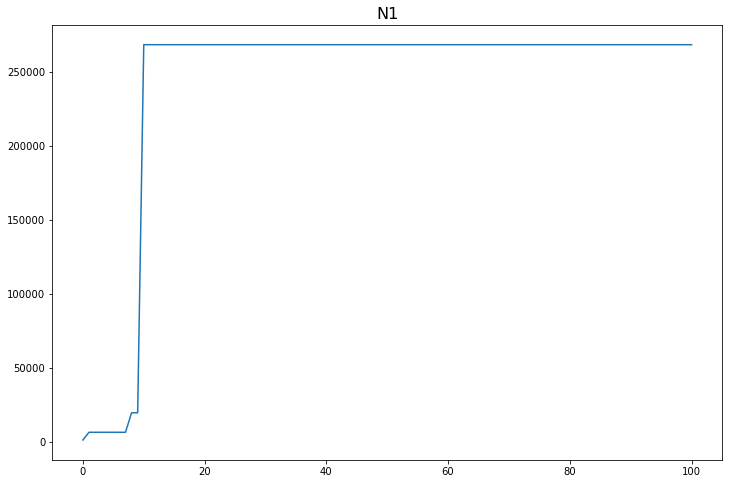

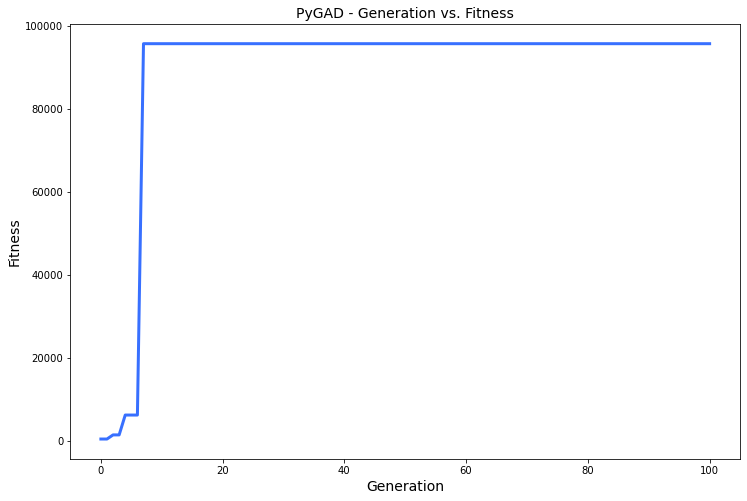

[0.585]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.585 |===========| 23.994 |==================| 33.445 |==========
[0.207]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 24.013 |==================| 94.872 |==========
[0.65]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.65 |===========| 23.99 |==================| 30.087 |==========
[-0.007]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 24.023 |==================| 2843.041 |==========
[0.674]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.674 |===========| 23.989 |==================| 29.009 |==========
[0.776]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.776 |===========| 23.984 |==================| 25.162 |==========
[0.122]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.577 |===========| 28.906 |==================| 15.553 |==========
[0.591]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 28.904 |==================| 15.161 |==========
[0.437]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 28.922 |==================| 20.827 |==========
[0.01]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 28.969 |==================| 980.913 |==========
[0.629]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 28.9 |==================| 14.188 |==========
[0.219]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 28.947 |==================| 42.471 |==========
[-0.253]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 28.938 |==================| 30.902 |==========
[0.9]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.9 |===========| 28.867 |==================| 9.675 |==========
Fitness = 1486.3712532822915
[0.437]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 28.922 |==================| 20.827 |==========
[0.01]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 28.969 |==================| 980.913 |==========
[0.629]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 28.9 |==================| 14.188 |==========
[0.219]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 28.947 |==================| 42.471 |==========
[-0.253]
=====|SOLUTION|===========|OUTPUT|==============

[-0.298]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 28.938 |==================| 30.902 |==========
[0.9]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.9 |===========| 28.867 |==================| 9.675 |==========
[0.437]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 28.922 |==================| 20.827 |==========
[0.01]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 28.969 |==================| 980.913 |==========
[0.629]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 28.9 |==================| 14.188 |==========
[0.219]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 28.947 |==================| 42.471 |==========
[-0.253]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 28.931 |==================| 25.364 |==========
[-0.033]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 28.967 |==================| 290.876 |==========
Generation = 2
[0.015]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 28.969 |==================| 649.198 |==========
[0.661]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.661 |===========| 28.896 |==================| 13.471 |==========
[0.518]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.518 |===========| 28.913 |==================| 17.423 |==========
[-0.754]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.754 |===========| 28.885 |==================| 11.705 |==========
[-0.525]
=====|SOLUTION|===========|OUTPUT|================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 28.931 |==================| 25.364 |==========
[-0.033]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 28.967 |==================| 290.876 |==========
Change = 0.0
[0.015]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 28.969 |==================| 649.198 |==========
[0.661]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.661 |===========| 28.896 |==================| 13.471 |==========
[0.518]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.518 |===========| 28.913 |==================| 17.423 |==========
[-0.754]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.754 |===========| 28.885 |==================| 11.705 |==========
[-0.525]
=====|SOLUTION|===========|OUTPUT|==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 28.931 |==================| 25.364 |==========
[-0.033]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 28.967 |==================| 290.876 |==========
[0.863]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 28.871 |==================| 10.117 |==========
[-0.684]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.684 |===========| 28.893 |==================| 12.988 |==========
[-0.934]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.934 |===========| 28.863 |==================| 9.294 |==========
[-0.271]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.271 |===========| 28.941 |==================| 34.163 |==========
[-0.402]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.53 |===========| 28.911 |==================| 17.01 |==========
Fitness = 1486.3712532822915
[0.863]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 28.871 |==================| 10.117 |==========
[-0.684]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.684 |===========| 28.893 |==================| 12.988 |==========
[-0.934]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.934 |===========| 28.863 |==================| 9.294 |==========
[-0.271]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.271 |===========| 28.941 |==================| 34.163 |==========
[-0.402]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 28.926 |==================| 22.676 |==========
[0.104]
=====|SOLUTION|===========|OUTPUT|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.84 |===========| 28.874 |==================| 10.417 |==========
[-0.53]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.53 |===========| 28.911 |==================| 17.01 |==========
[0.863]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 28.871 |==================| 10.117 |==========
[-0.684]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.684 |===========| 28.893 |==================| 12.988 |==========
[-0.934]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.934 |===========| 28.863 |==================| 9.294 |==========
[-0.271]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.271 |===========| 28.941 |==================| 34.163 |==========
[-0.402]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 28.952 |==================| 56.108 |==========
[0.357]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 28.931 |==================| 25.671 |==========
Generation = 4
[0.349]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 28.932 |==================| 26.328 |==========
[-0.421]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 28.924 |==================| 21.641 |==========
[-0.604]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.604 |===========| 28.903 |==================| 14.811 |==========
[-0.5]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.5 |===========| 28.915 |==================| 18.069 |==========
[-0.506]
=====|SOLUTION|===========|OUTPUT|==================|FI

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 28.931 |==================| 25.671 |==========
Change = 0.0
[0.349]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 28.932 |==================| 26.328 |==========
[-0.421]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 28.924 |==================| 21.641 |==========
[-0.604]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.604 |===========| 28.903 |==================| 14.811 |==========
[-0.5]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.5 |===========| 28.915 |==================| 18.069 |==========
[-0.506]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.506 |===========| 28.914 |==================| 17.848 |==========
[-0.721]
=====|SOLUTION|===========|OUTPUT|==================|FIT

[0.66]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.66 |===========| 28.896 |==================| 13.486 |==========
[-0.682]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.682 |===========| 28.893 |==================| 13.028 |==========
[0.116]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 28.958 |==================| 81.252 |==========
[0.905]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 28.866 |==================| 9.62 |==========
[0.899]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.899 |===========| 28.867 |==================| 9.684 |==========
[0.211]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 28.947 |==================| 44.039 |==========
[-0.082]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 28.958 |==================| 81.252 |==========
[0.905]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 28.866 |==================| 9.62 |==========
[0.899]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.899 |===========| 28.867 |==================| 9.684 |==========
[0.211]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 28.947 |==================| 44.039 |==========
[-0.082]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.082 |===========| 28.961 |==================| 115.541 |==========
[0.449]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 28.921 |==================| 20.255 |==========
[0.298]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 28.958 |==================| 81.252 |==========
[0.905]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 28.866 |==================| 9.62 |==========
[0.899]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.899 |===========| 28.867 |==================| 9.684 |==========
[0.211]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 28.947 |==================| 44.039 |==========
[-0.082]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.082 |===========| 28.961 |==================| 115.541 |==========
[0.449]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 28.921 |==================| 20.255 |==========
[0.298]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.711 |===========| 28.89 |==================| 12.466 |==========
[0.179]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 28.951 |==================| 52.022 |==========
[0.879]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.879 |===========| 28.869 |==================| 9.928 |==========
[-0.967]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.967 |===========| 28.858 |==================| 8.95 |==========
[0.507]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.507 |===========| 28.914 |==================| 17.821 |==========
[-0.61]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.61 |===========| 28.902 |==================| 14.671 |==========
[-0.253]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.879 |===========| 28.869 |==================| 9.928 |==========
[-0.967]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.967 |===========| 28.858 |==================| 8.95 |==========
[0.507]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.507 |===========| 28.914 |==================| 17.821 |==========
[-0.61]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.61 |===========| 28.902 |==================| 14.671 |==========
[-0.253]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 28.943 |==================| 36.566 |==========
[0.609]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.609 |===========| 28.902 |==================| 14.696 |==========
[0.463]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 28.943 |==================| 36.52 |==========
[-0.405]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 28.926 |==================| 22.514 |==========
[0.278]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 28.94 |==================| 33.239 |==========
[-0.36]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 28.931 |==================| 25.464 |==========
[-0.751]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.751 |===========| 28.885 |==================| 11.758 |==========
[0.372]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 28.929 |==================| 24.605 |==========
[-0.544]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 28.926 |==================| 22.514 |==========
[0.278]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 28.94 |==================| 33.239 |==========
[-0.36]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 28.931 |==================| 25.464 |==========
[-0.751]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.751 |===========| 28.885 |==================| 11.758 |==========
[0.372]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 28.929 |==================| 24.605 |==========
[-0.544]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.544 |===========| 28.91 |==================| 16.543 |==========
[0.942]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 28.926 |==================| 22.514 |==========
[0.278]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 28.94 |==================| 33.239 |==========
[-0.36]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 28.931 |==================| 25.464 |==========
[-0.751]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.751 |===========| 28.885 |==================| 11.758 |==========
[0.372]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 28.929 |==================| 24.605 |==========
[-0.544]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.544 |===========| 28.91 |==================| 16.543 |==========
[0.942]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 28.939 |==================| 31.696 |==========
[-0.711]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.711 |===========| 28.89 |==================| 12.454 |==========
[-0.275]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 28.94 |==================| 33.578 |==========
[0.072]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.072 |===========| 28.962 |==================| 130.386 |==========
[0.142]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.142 |===========| 28.955 |==================| 66.19 |==========
[-0.906]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.906 |===========| 28.866 |==================| 9.599 |==========
[-0.862]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.306 |===========| 28.937 |==================| 30.161 |==========
[-0.291]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 28.939 |==================| 31.696 |==========
[-0.711]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.711 |===========| 28.89 |==================| 12.454 |==========
[-0.275]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 28.94 |==================| 33.578 |==========
[0.072]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.072 |===========| 28.962 |==================| 130.386 |==========
[0.142]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.142 |===========| 28.955 |==================| 66.19 |==========
[-0.906]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.923 |===========| 28.864 |==================| 9.407 |==========
[-0.2]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 28.949 |==================| 46.481 |==========
[-0.195]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 28.949 |==================| 47.724 |==========
[0.987]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.987 |===========| 28.856 |==================| 8.749 |==========
[0.824]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.824 |===========| 28.876 |==================| 10.645 |==========
[0.384]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 28.928 |==================| 23.813 |==========
[0.925]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.923 |===========| 28.864 |==================| 9.407 |==========
[-0.2]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 28.949 |==================| 46.481 |==========
[-0.195]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 28.949 |==================| 47.724 |==========
[0.987]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.987 |===========| 28.856 |==================| 8.749 |==========
[0.824]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.824 |===========| 28.876 |==================| 10.645 |==========
[0.384]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 28.928 |==================| 23.813 |==========
[0.925]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.682 |===========| 28.893 |==================| 13.018 |==========
[0.923]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.923 |===========| 28.864 |==================| 9.407 |==========
[-0.2]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 28.949 |==================| 46.481 |==========
[-0.195]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 28.949 |==================| 47.724 |==========
[0.987]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.987 |===========| 28.856 |==================| 8.749 |==========
[0.824]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.824 |===========| 28.876 |==================| 10.645 |==========
[0.384]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 28.87 |==================| 9.997 |==========
[-0.641]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.641 |===========| 28.898 |==================| 13.925 |==========
[0.885]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.885 |===========| 28.869 |==================| 9.857 |==========
[-0.274]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 28.94 |==================| 33.723 |==========
[0.667]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.667 |===========| 28.895 |==================| 13.337 |==========
[0.548]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.548 |===========| 28.909 |==================| 16.42 |==========
[0.744]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.641 |===========| 28.898 |==================| 13.925 |==========
[0.885]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.885 |===========| 28.869 |==================| 9.857 |==========
[-0.274]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 28.94 |==================| 33.723 |==========
[0.667]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.667 |===========| 28.895 |==================| 13.337 |==========
[0.548]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.548 |===========| 28.909 |==================| 16.42 |==========
[0.744]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.744 |===========| 28.886 |==================| 11.869 |==========
[0.611]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 28.915 |==================| 18.024 |==========
[0.773]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.773 |===========| 28.882 |==================| 11.402 |==========
[0.282]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 28.94 |==================| 32.73 |==========
[0.851]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 28.873 |==================| 10.279 |==========
[0.47]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 28.918 |==================| 19.286 |==========
[0.144]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 28.955 |==================| 64.915 |==========
[-0.036]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 28.94 |==================| 32.73 |==========
[0.851]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 28.873 |==================| 10.279 |==========
[0.47]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 28.918 |==================| 19.286 |==========
[0.144]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 28.955 |==================| 64.915 |==========
[-0.036]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 28.966 |==================| 264.514 |==========
[-0.791]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.791 |===========| 28.88 |==================| 11.119 |==========
[-0.011]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 28.873 |==================| 10.279 |==========
[0.47]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 28.918 |==================| 19.286 |==========
[0.144]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 28.955 |==================| 64.915 |==========
[-0.036]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 28.966 |==================| 264.514 |==========
[-0.791]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.791 |===========| 28.88 |==================| 11.119 |==========
[-0.011]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 28.969 |==================| 885.75 |==========
[-0.851]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 28.919 |==================| 19.633 |==========
[-0.822]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.822 |===========| 28.876 |==================| 10.674 |==========
[0.633]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.633 |===========| 28.899 |==================| 14.112 |==========
[-0.168]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.168 |===========| 28.952 |==================| 55.567 |==========
[-0.022]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 28.968 |==================| 436.091 |==========
[-0.103]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.103 |===========| 28.959 |==================| 91.057 |==========
[-0.119]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.822 |===========| 28.876 |==================| 10.674 |==========
[0.633]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.633 |===========| 28.899 |==================| 14.112 |==========
[-0.168]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.168 |===========| 28.952 |==================| 55.567 |==========
[-0.022]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 28.968 |==================| 436.091 |==========
[-0.103]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.103 |===========| 28.959 |==================| 91.057 |==========
[-0.119]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 28.957 |==================| 78.939 |==========
[0.769]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|====

[-0.339]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 28.933 |==================| 27.062 |==========
[0.805]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.805 |===========| 28.878 |==================| 10.916 |==========
[-0.36]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 28.931 |==================| 25.465 |==========
[-0.584]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.584 |===========| 28.905 |==================| 15.354 |==========
[0.69]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 28.892 |==================| 12.859 |==========
[0.431]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 28.923 |==================| 21.115 |==========
[0.944]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

[0.805]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.805 |===========| 28.878 |==================| 10.916 |==========
[-0.36]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 28.931 |==================| 25.465 |==========
[-0.584]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.584 |===========| 28.905 |==================| 15.354 |==========
[0.69]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 28.892 |==================| 12.859 |==========
[0.431]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 28.923 |==================| 21.115 |==========
[0.944]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.944 |===========| 28.861 |==================| 9.187 |==========
[-0.193]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 28.931 |==================| 25.465 |==========
[-0.584]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.584 |===========| 28.905 |==================| 15.354 |==========
[0.69]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 28.892 |==================| 12.859 |==========
[0.431]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 28.923 |==================| 21.115 |==========
[0.944]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.944 |===========| 28.861 |==================| 9.187 |==========
[-0.193]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 28.949 |==================| 48.301 |==========
[0.241]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 28.86 |==================| 9.119 |==========
[0.048]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 28.965 |==================| 195.403 |==========
[0.267]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 28.941 |==================| 34.709 |==========
[-0.439]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 28.922 |==================| 20.738 |==========
[-0.83]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 28.875 |==================| 10.563 |==========
[-0.062]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 28.964 |==================| 152.792 |==========
[-0.51]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 28.965 |==================| 195.403 |==========
[0.267]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 28.941 |==================| 34.709 |==========
[-0.439]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 28.922 |==================| 20.738 |==========
[-0.83]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 28.875 |==================| 10.563 |==========
[-0.062]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 28.964 |==================| 152.792 |==========
[-0.51]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 28.914 |==================| 17.696 |==========
[0.142]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

======| 0.417 |===========| 28.924 |==================| 21.842 |==========
[0.008]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 28.969 |==================| 1202.473 |==========
[0.056]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 28.964 |==================| 168.433 |==========
[-0.868]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.868 |===========| 28.871 |==================| 10.055 |==========
[0.721]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.721 |===========| 28.889 |==================| 12.28 |==========
[-0.962]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.962 |===========| 28.859 |==================| 9.001 |==========
[-0.401]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 28.926 |==================| 22.786 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 28.924 |==================| 21.842 |==========
[0.008]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 28.969 |==================| 1202.473 |==========
[0.056]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 28.964 |==================| 168.433 |==========
[-0.868]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.868 |===========| 28.871 |==================| 10.055 |==========
[0.721]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.721 |===========| 28.889 |==================| 12.28 |==========
[-0.962]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.962 |===========| 28.859 |==================| 9.001 |==========
[-0.401]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 28.924 |==================| 21.842 |==========
[0.008]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 28.969 |==================| 1202.473 |==========
[0.056]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 28.964 |==================| 168.433 |==========
[-0.868]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.868 |===========| 28.871 |==================| 10.055 |==========
[0.721]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.721 |===========| 28.889 |==================| 12.28 |==========
[-0.962]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.962 |===========| 28.859 |==================| 9.001 |==========
[-0.401]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 28.939 |==================| 31.679 |==========
[-0.276]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 28.94 |==================| 33.497 |==========
[-0.633]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.633 |===========| 28.899 |==================| 14.106 |==========
[-0.664]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.664 |===========| 28.896 |==================| 13.406 |==========
[0.093]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 28.96 |==================| 101.327 |==========
[0.537]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.537 |===========| 28.91 |==================| 16.763 |==========
[-0.8]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 28.939 |==================| 31.679 |==========
[-0.276]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 28.94 |==================| 33.497 |==========
[-0.633]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.633 |===========| 28.899 |==================| 14.106 |==========
[-0.664]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.664 |===========| 28.896 |==================| 13.406 |==========
[0.093]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 28.96 |==================| 101.327 |==========
[0.537]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.537 |===========| 28.91 |==================| 16.763 |==========
[-0.8]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.756 |===========| 28.884 |==================| 11.676 |==========
[-0.706]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.706 |===========| 28.891 |==================| 12.564 |==========
[-0.679]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.679 |===========| 28.894 |==================| 13.096 |==========
[0.69]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 28.892 |==================| 12.87 |==========
[-0.857]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.857 |===========| 28.872 |==================| 10.205 |==========
[0.378]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 28.929 |==================| 24.205 |==========
[-0.927]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 28.918 |==================| 19.339 |==========
[0.756]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.756 |===========| 28.884 |==================| 11.676 |==========
[-0.706]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.706 |===========| 28.891 |==================| 12.564 |==========
[-0.679]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.679 |===========| 28.894 |==================| 13.096 |==========
[0.69]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 28.892 |==================| 12.87 |==========
[-0.857]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.857 |===========| 28.872 |==================| 10.205 |==========
[0.378]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.81 |===========| 28.878 |==================| 10.833 |==========
[-0.469]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 28.918 |==================| 19.339 |==========
[0.756]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.756 |===========| 28.884 |==================| 11.676 |==========
[-0.706]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.706 |===========| 28.891 |==================| 12.564 |==========
[-0.679]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.679 |===========| 28.894 |==================| 13.096 |==========
[0.69]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 28.892 |==================| 12.87 |==========
[-0.857]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 28.919 |==================| 19.397 |==========
[-0.554]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.554 |===========| 28.908 |==================| 16.231 |==========
[-0.962]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.962 |===========| 28.859 |==================| 8.997 |==========
[-0.157]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 28.953 |==================| 59.592 |==========
[-0.226]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 28.946 |==================| 41.102 |==========
[-0.633]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.633 |===========| 28.899 |==================| 14.11 |==========
[0.374]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.927 |===========| 28.863 |==================| 9.365 |==========
[0.468]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 28.919 |==================| 19.397 |==========
[-0.554]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.554 |===========| 28.908 |==================| 16.231 |==========
[-0.962]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.962 |===========| 28.859 |==================| 8.997 |==========
[-0.157]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 28.953 |==================| 59.592 |==========
[-0.226]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 28.946 |==================| 41.102 |==========
[-0.633]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

[0.175]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 28.951 |==================| 53.291 |==========
[-0.093]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 28.96 |==================| 101.707 |==========
[-0.52]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.52 |===========| 28.912 |==================| 17.344 |==========
[-0.961]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 28.859 |==================| 9.014 |==========
[-0.282]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 28.94 |==================| 32.733 |==========
[-0.367]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 28.93 |==================| 24.951 |==========
[-0.043]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 28.87 |==================| 9.999 |==========
[0.175]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 28.951 |==================| 53.291 |==========
[-0.093]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 28.96 |==================| 101.707 |==========
[-0.52]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.52 |===========| 28.912 |==================| 17.344 |==========
[-0.961]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 28.859 |==================| 9.014 |==========
[-0.282]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 28.94 |==================| 32.733 |==========
[-0.367]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.477 |===========| 28.917 |==================| 18.992 |==========
[0.873]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 28.87 |==================| 9.999 |==========
[0.175]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 28.951 |==================| 53.291 |==========
[-0.093]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 28.96 |==================| 101.707 |==========
[-0.52]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.52 |===========| 28.912 |==================| 17.344 |==========
[-0.961]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 28.859 |==================| 9.014 |==========
[-0.282]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 28.945 |==================| 40.237 |==========
[-0.483]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 28.917 |==================| 18.744 |==========
[-0.551]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 28.909 |==================| 16.32 |==========
[0.594]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.594 |===========| 28.904 |==================| 15.074 |==========
[-0.313]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 28.936 |==================| 29.371 |==========
[0.458]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 28.92 |==================| 19.819 |==========
[-0.229]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.026 |===========| 28.967 |==================| 360.876 |==========
[-0.231]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 28.945 |==================| 40.237 |==========
[-0.483]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 28.917 |==================| 18.744 |==========
[-0.551]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 28.909 |==================| 16.32 |==========
[0.594]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.594 |===========| 28.904 |==================| 15.074 |==========
[-0.313]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 28.936 |==================| 29.371 |==========
[0.458]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 28.967 |==================| 301.288 |==========
[-0.086]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.086 |===========| 28.961 |==================| 109.062 |==========
[0.259]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 28.942 |==================| 35.748 |==========
[-0.881]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.881 |===========| 28.869 |==================| 9.902 |==========
[0.68]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.68 |===========| 28.894 |==================| 13.062 |==========
[0.192]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 28.95 |==================| 48.633 |==========
[-0.817]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.209 |===========| 28.948 |==================| 44.474 |==========
[0.031]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 28.967 |==================| 301.288 |==========
[-0.086]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.086 |===========| 28.961 |==================| 109.062 |==========
[0.259]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 28.942 |==================| 35.748 |==========
[-0.881]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.881 |===========| 28.869 |==================| 9.902 |==========
[0.68]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.68 |===========| 28.894 |==================| 13.062 |==========
[0.192]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.209 |===========| 28.948 |==================| 44.474 |==========
[0.031]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 28.967 |==================| 301.288 |==========
[-0.086]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.086 |===========| 28.961 |==================| 109.062 |==========
[0.259]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 28.942 |==================| 35.748 |==========
[-0.881]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.881 |===========| 28.869 |==================| 9.902 |==========
[0.68]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.68 |===========| 28.894 |==================| 13.062 |==========
[0.192]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 28.921 |==================| 20.41 |==========
[-0.819]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.819 |===========| 28.877 |==================| 10.708 |==========
[0.466]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 28.919 |==================| 19.47 |==========
[0.793]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.793 |===========| 28.88 |==================| 11.094 |==========
[0.156]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 28.953 |==================| 60.047 |==========
[-0.744]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.744 |===========| 28.886 |==================| 11.868 |==========
[-0.347]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

[-0.819]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.819 |===========| 28.877 |==================| 10.708 |==========
[0.466]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 28.919 |==================| 19.47 |==========
[0.793]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.793 |===========| 28.88 |==================| 11.094 |==========
[0.156]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 28.953 |==================| 60.047 |==========
[-0.744]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.744 |===========| 28.886 |==================| 11.868 |==========
[-0.347]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 28.932 |==================| 26.447 |==========
[-0.749]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 28.933 |==================| 26.797 |==========
[0.217]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 28.947 |==================| 42.767 |==========
[-0.669]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.669 |===========| 28.895 |==================| 13.3 |==========
[-0.003]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 28.97 |==================| 3509.835 |==========
[-0.83]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 28.875 |==================| 10.56 |==========
[0.425]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 28.923 |==================| 21.438 |==========
[0.605]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 28.933 |==================| 26.797 |==========
[0.217]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 28.947 |==================| 42.767 |==========
[-0.669]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.669 |===========| 28.895 |==================| 13.3 |==========
[-0.003]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 28.97 |==================| 3509.835 |==========
[-0.83]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 28.875 |==================| 10.56 |==========
[0.425]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 28.923 |==================| 21.438 |==========
[0.605]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.669 |===========| 28.895 |==================| 13.3 |==========
[-0.003]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 28.97 |==================| 3509.835 |==========
[-0.83]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 28.875 |==================| 10.56 |==========
[0.425]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 28.923 |==================| 21.438 |==========
[0.605]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.605 |===========| 28.903 |==================| 14.805 |==========
[-0.228]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.228 |===========| 28.946 |==================| 40.683 |==========
[-0.967]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.665 |===========| 28.895 |==================| 13.386 |==========
[-0.829]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.829 |===========| 28.876 |==================| 10.571 |==========
[0.977]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.977 |===========| 28.857 |==================| 8.852 |==========
[0.584]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.584 |===========| 28.905 |==================| 15.362 |==========
[0.2]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 28.949 |==================| 46.497 |==========
[0.071]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 28.963 |==================| 132.129 |==========
[-0.843]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.829 |===========| 28.876 |==================| 10.571 |==========
[0.977]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.977 |===========| 28.857 |==================| 8.852 |==========
[0.584]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.584 |===========| 28.905 |==================| 15.362 |==========
[0.2]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 28.949 |==================| 46.497 |==========
[0.071]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 28.963 |==================| 132.129 |==========
[-0.843]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.843 |===========| 28.874 |==================| 10.386 |==========
[-0.967]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 28.963 |==================| 149.877 |==========
[0.532]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.532 |===========| 28.911 |==================| 16.946 |==========
[0.917]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 28.865 |==================| 9.477 |==========
[-0.367]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 28.93 |==================| 24.938 |==========
[-0.825]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.825 |===========| 28.876 |==================| 10.626 |==========
[0.191]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 28.95 |==================| 48.774 |==========
Generation = 25
[-0.309]
=====|SOLUTION|===========|OUTPUT|==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.308 |===========| 28.937 |==================| 29.877 |==========
[0.063]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 28.963 |==================| 149.877 |==========
[0.532]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.532 |===========| 28.911 |==================| 16.946 |==========
[0.917]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 28.865 |==================| 9.477 |==========
[-0.367]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 28.93 |==================| 24.938 |==========
[-0.825]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.825 |===========| 28.876 |==================| 10.626 |==========
[0.191]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 28.963 |==================| 149.877 |==========
[0.532]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.532 |===========| 28.911 |==================| 16.946 |==========
[0.917]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 28.865 |==================| 9.477 |==========
[-0.367]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 28.93 |==================| 24.938 |==========
[-0.825]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.825 |===========| 28.876 |==================| 10.626 |==========
[0.191]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 28.95 |==================| 48.774 |==========
[-0.318]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 28.923 |==================| 21.394 |==========
[0.055]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 28.964 |==================| 171.414 |==========
[-0.419]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.419 |===========| 28.924 |==================| 21.762 |==========
[0.758]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 28.884 |==================| 11.632 |==========
Fitness = 3509.8351524458153
[-0.318]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 28.936 |==================| 28.981 |==========
[0.987]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.987 |===========| 28.856 |==================| 8.752 |==========
[-0.77]
=====|SOLUTION|===========|OUTPUT|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 28.964 |==================| 171.414 |==========
[-0.419]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.419 |===========| 28.924 |==================| 21.762 |==========
[0.758]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 28.884 |==================| 11.632 |==========
[-0.318]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 28.936 |==================| 28.981 |==========
[0.987]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.987 |===========| 28.856 |==================| 8.752 |==========
[-0.77]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.77 |===========| 28.883 |==================| 11.446 |==========
[-0.574]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.84 |===========| 28.874 |==================| 10.416 |==========
[0.789]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.789 |===========| 28.88 |==================| 11.146 |==========
Generation = 27
[-0.257]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 28.942 |==================| 36.045 |==========
[-0.721]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.721 |===========| 28.889 |==================| 12.284 |==========
[-0.007]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 28.969 |==================| 1358.201 |==========
[-0.017]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 28.968 |==================| 561.469 |==========
[0.366]
=====|SOLUTION|===========|OUTPUT|===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.789 |===========| 28.88 |==================| 11.146 |==========
Change = 0.0
[-0.257]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 28.942 |==================| 36.045 |==========
[-0.721]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.721 |===========| 28.889 |==================| 12.284 |==========
[-0.007]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 28.969 |==================| 1358.201 |==========
[-0.017]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 28.968 |==================| 561.469 |==========
[0.366]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 28.93 |==================| 25.049 |==========
[-0.741]
=====|SOLUTION|===========|OUTPUT|=================

[0.789]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.789 |===========| 28.88 |==================| 11.146 |==========
[0.585]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.585 |===========| 28.905 |==================| 15.337 |==========
[-0.962]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.962 |===========| 28.859 |==================| 9.004 |==========
[-0.07]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 28.963 |==================| 134.351 |==========
[0.102]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 28.959 |==================| 91.98 |==========
[0.279]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 28.94 |==================| 33.092 |==========
[-0.106]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.567 |===========| 28.907 |==================| 15.852 |==========
[0.196]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 28.949 |==================| 47.449 |==========
Fitness = 3509.8351524458153
[0.585]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.585 |===========| 28.905 |==================| 15.337 |==========
[-0.962]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.962 |===========| 28.859 |==================| 9.004 |==========
[-0.07]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 28.963 |==================| 134.351 |==========
[0.102]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 28.959 |==================| 91.98 |==========
[0.279]
=====|SOLUTION|===========|OUTPUT|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.585 |===========| 28.905 |==================| 15.337 |==========
[-0.962]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.962 |===========| 28.859 |==================| 9.004 |==========
[-0.07]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 28.963 |==================| 134.351 |==========
[0.102]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 28.959 |==================| 91.98 |==========
[0.279]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 28.94 |==================| 33.092 |==========
[-0.106]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 28.959 |==================| 88.778 |==========
[0.109]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.535 |===========| 28.911 |==================| 16.839 |==========
Generation = 29
[0.624]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.624 |===========| 28.9 |==================| 14.308 |==========
[-0.413]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 28.925 |==================| 22.099 |==========
[-0.86]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.86 |===========| 28.872 |==================| 10.161 |==========
[-0.927]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.927 |===========| 28.863 |==================| 9.366 |==========
[0.109]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 28.959 |==================| 86.462 |==========
[-0.269]
=====|SOLUTION|===========|OUTPUT|==================|FI

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.535 |===========| 28.911 |==================| 16.839 |==========
Change = 0.0
[0.624]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.624 |===========| 28.9 |==================| 14.308 |==========
[-0.413]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 28.925 |==================| 22.099 |==========
[-0.86]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.86 |===========| 28.872 |==================| 10.161 |==========
[-0.927]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.927 |===========| 28.863 |==================| 9.366 |==========
[0.109]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 28.959 |==================| 86.462 |==========
[-0.269]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

[0.535]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.535 |===========| 28.911 |==================| 16.839 |==========
[-0.334]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 28.934 |==================| 27.535 |==========
[-0.374]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 28.929 |==================| 24.445 |==========
[0.152]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 28.954 |==================| 61.689 |==========
[0.043]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 28.966 |==================| 220.637 |==========
[-0.129]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.129 |===========| 28.956 |==================| 72.781 |==========
[-0.477]
=====|SOLUTION|===========|OUTPUT|==================|FITN

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 28.926 |==================| 22.69 |==========
Fitness = 3509.8351524458153
[-0.334]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 28.934 |==================| 27.535 |==========
[-0.374]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 28.929 |==================| 24.445 |==========
[0.152]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 28.954 |==================| 61.689 |==========
[0.043]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 28.966 |==================| 220.637 |==========
[-0.129]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.129 |===========| 28.956 |==================| 72.781 |==========
[-0.477]
=====|SOLUTION|===========|OUTPUT|===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 28.926 |==================| 22.69 |==========
[-0.334]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 28.934 |==================| 27.535 |==========
[-0.374]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 28.929 |==================| 24.445 |==========
[0.152]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 28.954 |==================| 61.689 |==========
[0.043]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 28.966 |==================| 220.637 |==========
[-0.129]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.129 |===========| 28.956 |==================| 72.781 |==========
[-0.477]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.632 |===========| 28.899 |==================| 14.123 |==========
Generation = 31
[0.218]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.218 |===========| 28.947 |==================| 42.594 |==========
[0.966]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.966 |===========| 28.858 |==================| 8.955 |==========
[-0.622]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.622 |===========| 28.9 |==================| 14.366 |==========
[0.171]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 28.952 |==================| 54.646 |==========
[0.382]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 28.928 |==================| 23.946 |==========
[-0.788]
=====|SOLUTION|===========|OUTPUT|==================|FI

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.632 |===========| 28.899 |==================| 14.123 |==========
Change = 0.0
[0.218]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.218 |===========| 28.947 |==================| 42.594 |==========
[0.966]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.966 |===========| 28.858 |==================| 8.955 |==========
[-0.622]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.622 |===========| 28.9 |==================| 14.366 |==========
[0.171]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 28.952 |==================| 54.646 |==========
[0.382]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 28.928 |==================| 23.946 |==========
[-0.788]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.671 |===========| 28.895 |==================| 13.25 |==========
[-0.632]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.632 |===========| 28.899 |==================| 14.123 |==========
[-0.104]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 28.959 |==================| 90.412 |==========
[-0.142]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.142 |===========| 28.955 |==================| 66.089 |==========
[0.821]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.821 |===========| 28.877 |==================| 10.685 |==========
[-0.528]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 28.912 |==================| 17.088 |==========
[-0.296]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 28.959 |==================| 90.412 |==========
[-0.142]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.142 |===========| 28.955 |==================| 66.089 |==========
[0.821]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.821 |===========| 28.877 |==================| 10.685 |==========
[-0.528]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 28.912 |==================| 17.088 |==========
[-0.296]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 28.938 |==================| 31.171 |==========
[-0.164]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 28.953 |==================| 57.135 |==========
[0.523]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 28.959 |==================| 90.412 |==========
[-0.142]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.142 |===========| 28.955 |==================| 66.089 |==========
[0.821]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.821 |===========| 28.877 |==================| 10.685 |==========
[-0.528]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 28.912 |==================| 17.088 |==========
[-0.296]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 28.938 |==================| 31.171 |==========
[-0.164]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 28.953 |==================| 57.135 |==========
[0.523]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.709 |===========| 28.89 |==================| 12.505 |==========
[-0.904]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.904 |===========| 28.866 |==================| 9.631 |==========
[-0.297]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 28.938 |==================| 31.094 |==========
[0.397]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.397 |===========| 28.927 |==================| 23.029 |==========
[-0.881]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.881 |===========| 28.869 |==================| 9.899 |==========
[-0.74]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.74 |===========| 28.886 |==================| 11.939 |==========
[-0.261]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.573 |===========| 28.906 |==================| 15.658 |==========
[-0.709]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.709 |===========| 28.89 |==================| 12.505 |==========
[-0.904]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.904 |===========| 28.866 |==================| 9.631 |==========
[-0.297]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 28.938 |==================| 31.094 |==========
[0.397]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.397 |===========| 28.927 |==================| 23.029 |==========
[-0.881]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.881 |===========| 28.869 |==================| 9.899 |==========
[-0.74]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 28.923 |==================| 21.432 |==========
[-0.711]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.711 |===========| 28.89 |==================| 12.463 |==========
[-0.865]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 28.871 |==================| 10.102 |==========
[-0.22]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 28.946 |==================| 42.164 |==========
[0.819]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.819 |===========| 28.877 |==================| 10.717 |==========
[-0.599]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.599 |===========| 28.903 |==================| 14.949 |==========
[-0.621]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 28.923 |==================| 21.432 |==========
[-0.711]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.711 |===========| 28.89 |==================| 12.463 |==========
[-0.865]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 28.871 |==================| 10.102 |==========
[-0.22]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 28.946 |==================| 42.164 |==========
[0.819]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.819 |===========| 28.877 |==================| 10.717 |==========
[-0.599]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.599 |===========| 28.903 |==================| 14.949 |==========
[-0.621]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 28.923 |==================| 21.432 |==========
[-0.711]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.711 |===========| 28.89 |==================| 12.463 |==========
[-0.865]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 28.871 |==================| 10.102 |==========
[-0.22]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 28.946 |==================| 42.164 |==========
[0.819]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.819 |===========| 28.877 |==================| 10.717 |==========
[-0.599]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.599 |===========| 28.903 |==================| 14.949 |==========
[-0.621]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 28.969 |==================| 669.706 |==========
[-0.452]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 28.92 |==================| 20.075 |==========
[0.001]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 28.97 |==================| 6670.9 |==========
[0.045]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 28.965 |==================| 210.394 |==========
[0.735]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.735 |===========| 28.887 |==================| 12.033 |==========
[0.307]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.307 |===========| 28.937 |==================| 29.989 |==========
[0.457]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 28.942 |==================| 35.228 |==========
[0.014]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 28.969 |==================| 669.706 |==========
[-0.452]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 28.92 |==================| 20.075 |==========
[0.001]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 28.97 |==================| 6670.9 |==========
[0.045]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 28.965 |==================| 210.394 |==========
[0.735]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.735 |===========| 28.887 |==================| 12.033 |==========
[0.307]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 28.964 |==================| 163.199 |==========
[-0.856]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.856 |===========| 28.872 |==================| 10.214 |==========
[0.399]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 28.926 |==================| 22.878 |==========
[0.164]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 28.953 |==================| 57.088 |==========
[0.848]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.848 |===========| 28.873 |==================| 10.32 |==========
[0.873]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 28.87 |==================| 9.995 |==========
[-0.138]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.503 |===========| 28.914 |==================| 17.96 |==========
[0.058]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 28.964 |==================| 163.199 |==========
[-0.856]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.856 |===========| 28.872 |==================| 10.214 |==========
[0.399]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 28.926 |==================| 22.878 |==========
[0.164]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 28.953 |==================| 57.088 |==========
[0.848]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.848 |===========| 28.873 |==================| 10.32 |==========
[0.873]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.503 |===========| 28.914 |==================| 17.96 |==========
[0.058]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 28.964 |==================| 163.199 |==========
[-0.856]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.856 |===========| 28.872 |==================| 10.214 |==========
[0.399]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 28.926 |==================| 22.878 |==========
[0.164]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 28.953 |==================| 57.088 |==========
[0.848]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.848 |===========| 28.873 |==================| 10.32 |==========
[0.873]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.691 |===========| 28.892 |==================| 12.851 |==========
[0.914]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.914 |===========| 28.865 |==================| 9.51 |==========
[0.006]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.006 |===========| 28.969 |==================| 1661.455 |==========
[-0.474]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 28.918 |==================| 19.119 |==========
[-0.941]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.941 |===========| 28.862 |==================| 9.216 |==========
[-0.524]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.524 |===========| 28.912 |==================| 17.212 |==========
[-0.714]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.914 |===========| 28.865 |==================| 9.51 |==========
[0.006]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.006 |===========| 28.969 |==================| 1661.455 |==========
[-0.474]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 28.918 |==================| 19.119 |==========
[-0.941]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.941 |===========| 28.862 |==================| 9.216 |==========
[-0.524]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.524 |===========| 28.912 |==================| 17.212 |==========
[-0.714]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.714 |===========| 28.89 |==================| 12.414 |==========
[-0.552]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.685 |===========| 28.893 |==================| 12.974 |==========
[-0.758]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 28.884 |==================| 11.645 |==========
[0.598]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.598 |===========| 28.903 |==================| 14.98 |==========
[0.287]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 28.939 |==================| 32.137 |==========
[-0.041]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 28.966 |==================| 230.669 |==========
[-0.928]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.928 |===========| 28.863 |==================| 9.357 |==========
[-0.399]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.685 |===========| 28.893 |==================| 12.974 |==========
[-0.758]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 28.884 |==================| 11.645 |==========
[0.598]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.598 |===========| 28.903 |==================| 14.98 |==========
[0.287]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 28.939 |==================| 32.137 |==========
[-0.041]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 28.966 |==================| 230.669 |==========
[-0.928]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.928 |===========| 28.863 |==================| 9.357 |==========
[-0.399]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 28.884 |==================| 11.645 |==========
[0.598]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.598 |===========| 28.903 |==================| 14.98 |==========
[0.287]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 28.939 |==================| 32.137 |==========
[-0.041]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 28.966 |==================| 230.669 |==========
[-0.928]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.928 |===========| 28.863 |==================| 9.357 |==========
[-0.399]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 28.926 |==================| 22.91 |==========
[-0.323]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 28.964 |==================| 152.635 |==========
[-0.562]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.562 |===========| 28.908 |==================| 16.004 |==========
[0.45]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 28.921 |==================| 20.167 |==========
[0.803]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.803 |===========| 28.879 |==================| 10.933 |==========
[-0.264]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 28.942 |==================| 35.002 |==========
[0.256]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 28.942 |==================| 36.111 |==========
[-0.59]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 28.956 |==================| 73.253 |==========
[-0.062]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 28.964 |==================| 152.635 |==========
[-0.562]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.562 |===========| 28.908 |==================| 16.004 |==========
[0.45]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 28.921 |==================| 20.167 |==========
[0.803]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.803 |===========| 28.879 |==================| 10.933 |==========
[-0.264]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 28.942 |==================| 35.002 |==========
[0.256]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.742 |===========| 28.886 |==================| 11.914 |==========
[0.369]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 28.93 |==================| 24.787 |==========
[0.305]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 28.937 |==================| 30.228 |==========
[-0.382]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 28.928 |==================| 23.929 |==========
[0.822]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.822 |===========| 28.876 |==================| 10.664 |==========
[0.068]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 28.963 |==================| 138.577 |==========
[-0.812]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 28.93 |==================| 24.787 |==========
[0.305]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 28.937 |==================| 30.228 |==========
[-0.382]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 28.928 |==================| 23.929 |==========
[0.822]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.822 |===========| 28.876 |==================| 10.664 |==========
[0.068]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 28.963 |==================| 138.577 |==========
[-0.812]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.812 |===========| 28.878 |==================| 10.806 |==========
[0.322]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 28.937 |==================| 30.228 |==========
[-0.382]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 28.928 |==================| 23.929 |==========
[0.822]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.822 |===========| 28.876 |==================| 10.664 |==========
[0.068]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 28.963 |==================| 138.577 |==========
[-0.812]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.812 |===========| 28.878 |==================| 10.806 |==========
[0.322]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 28.935 |==================| 28.544 |==========
[-0.234]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 28.942 |==================| 36.101 |==========
[-0.555]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.555 |===========| 28.908 |==================| 16.216 |==========
[-0.529]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.529 |===========| 28.911 |==================| 17.054 |==========
[0.277]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 28.94 |==================| 33.333 |==========
[0.408]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 28.925 |==================| 22.381 |==========
[0.074]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 28.962 |==================| 126.871 |==========
[0.779]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 28.94 |==================| 33.267 |==========
[-0.256]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 28.942 |==================| 36.101 |==========
[-0.555]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.555 |===========| 28.908 |==================| 16.216 |==========
[-0.529]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.529 |===========| 28.911 |==================| 17.054 |==========
[0.277]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 28.94 |==================| 33.333 |==========
[0.408]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 28.925 |==================| 22.381 |==========
[0.074]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 28.898 |==================| 13.842 |==========
[-0.832]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.832 |===========| 28.875 |==================| 10.528 |==========
[-0.964]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 28.859 |==================| 8.976 |==========
[0.464]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 28.919 |==================| 19.537 |==========
[-0.503]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.503 |===========| 28.914 |==================| 17.967 |==========
[0.756]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.756 |===========| 28.884 |==================| 11.666 |==========
[0.323]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 28.898 |==================| 13.842 |==========
[-0.832]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.832 |===========| 28.875 |==================| 10.528 |==========
[-0.964]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 28.859 |==================| 8.976 |==========
[0.464]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 28.919 |==================| 19.537 |==========
[-0.503]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.503 |===========| 28.914 |==================| 17.967 |==========
[0.756]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.756 |===========| 28.884 |==================| 11.666 |==========
[0.323]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

[0.644]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 28.898 |==================| 13.842 |==========
[-0.832]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.832 |===========| 28.875 |==================| 10.528 |==========
[-0.964]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 28.859 |==================| 8.976 |==========
[0.464]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 28.919 |==================| 19.537 |==========
[-0.503]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.503 |===========| 28.914 |==================| 17.967 |==========
[0.756]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.756 |===========| 28.884 |==================| 11.666 |==========
[0.323]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.992 |===========| 28.855 |==================| 8.705 |==========
[0.616]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.616 |===========| 28.901 |==================| 14.514 |==========
[-0.057]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 28.964 |==================| 165.64 |==========
[0.367]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 28.93 |==================| 24.959 |==========
[-0.379]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 28.929 |==================| 24.147 |==========
[-0.46]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 28.919 |==================| 19.725 |==========
[-0.898]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.616 |===========| 28.901 |==================| 14.514 |==========
[-0.057]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 28.964 |==================| 165.64 |==========
[0.367]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 28.93 |==================| 24.959 |==========
[-0.379]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 28.929 |==================| 24.147 |==========
[-0.46]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 28.919 |==================| 19.725 |==========
[-0.898]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.898 |===========| 28.867 |==================| 9.693 |==========
[-0.033]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.774 |===========| 28.882 |==================| 11.373 |==========
[-0.338]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 28.933 |==================| 27.202 |==========
[0.68]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.68 |===========| 28.894 |==================| 13.072 |==========
[-0.383]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 28.928 |==================| 23.906 |==========
[-0.099]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 28.96 |==================| 95.424 |==========
[-0.376]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 28.929 |==================| 24.328 |==========
[0.936]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.774 |===========| 28.882 |==================| 11.373 |==========
[-0.338]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 28.933 |==================| 27.202 |==========
[0.68]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.68 |===========| 28.894 |==================| 13.072 |==========
[-0.383]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 28.928 |==================| 23.906 |==========
[-0.099]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 28.96 |==================| 95.424 |==========
[-0.376]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 28.929 |==================| 24.328 |==========
[0.936]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.053 |===========| 28.964 |==================| 177.213 |==========
[0.774]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.774 |===========| 28.882 |==================| 11.373 |==========
[-0.338]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 28.933 |==================| 27.202 |==========
[0.68]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.68 |===========| 28.894 |==================| 13.072 |==========
[-0.383]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 28.928 |==================| 23.906 |==========
[-0.099]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 28.96 |==================| 95.424 |==========
[-0.376]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

[0.32]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 28.935 |==================| 28.713 |==========
[0.223]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 28.946 |==================| 41.632 |==========
[-0.547]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.547 |===========| 28.909 |==================| 16.449 |==========
[-0.414]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 28.925 |==================| 21.997 |==========
[0.163]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 28.953 |==================| 57.175 |==========
[0.891]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.891 |===========| 28.868 |==================| 9.784 |==========
[0.917]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.99 |===========| 28.855 |==================| 8.721 |==========
[0.32]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 28.935 |==================| 28.713 |==========
[0.223]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 28.946 |==================| 41.632 |==========
[-0.547]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.547 |===========| 28.909 |==================| 16.449 |==========
[-0.414]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 28.925 |==================| 21.997 |==========
[0.163]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 28.953 |==================| 57.175 |==========
[0.891]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.81 |===========| 28.878 |==================| 10.842 |==========
[-0.319]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 28.935 |==================| 28.894 |==========
[-0.637]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.637 |===========| 28.899 |==================| 14.003 |==========
[0.192]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 28.949 |==================| 48.462 |==========
[0.298]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 28.938 |==================| 30.951 |==========
[0.415]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 28.925 |==================| 21.973 |==========
[-0.14]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

[-0.637]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.637 |===========| 28.899 |==================| 14.003 |==========
[0.192]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 28.949 |==================| 48.462 |==========
[0.298]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 28.938 |==================| 30.951 |==========
[0.415]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 28.925 |==================| 21.973 |==========
[-0.14]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 28.955 |==================| 66.748 |==========
[-0.474]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 28.918 |==================| 19.103 |==========
[-0.883]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 28.935 |==================| 28.894 |==========
[-0.637]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.637 |===========| 28.899 |==================| 14.003 |==========
[0.192]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 28.949 |==================| 48.462 |==========
[0.298]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 28.938 |==================| 30.951 |==========
[0.415]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 28.925 |==================| 21.973 |==========
[-0.14]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 28.955 |==================| 66.748 |==========
[-0.474]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.659 |===========| 28.896 |==================| 13.508 |==========
[0.038]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 28.966 |==================| 248.256 |==========
[-0.049]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 28.965 |==================| 192.954 |==========
[0.816]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.816 |===========| 28.877 |==================| 10.746 |==========
[-0.415]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 28.925 |==================| 21.953 |==========
[0.691]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.691 |===========| 28.892 |==================| 12.851 |==========
[0.421]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.659 |===========| 28.896 |==================| 13.508 |==========
[0.038]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 28.966 |==================| 248.256 |==========
[-0.049]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 28.965 |==================| 192.954 |==========
[0.816]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.816 |===========| 28.877 |==================| 10.746 |==========
[-0.415]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 28.925 |==================| 21.953 |==========
[0.691]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.691 |===========| 28.892 |==================| 12.851 |==========
[0.421]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 28.906 |==================| 15.492 |==========
[-0.883]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 28.869 |==================| 9.872 |==========
[-0.456]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 28.92 |==================| 19.912 |==========
[0.94]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.94 |===========| 28.862 |==================| 9.232 |==========
[0.87]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.87 |===========| 28.87 |==================| 10.034 |==========
[0.073]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 28.962 |==================| 129.421 |==========
[-0.338]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.823 |===========| 28.876 |==================| 10.658 |==========
[0.579]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 28.906 |==================| 15.492 |==========
[-0.883]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 28.869 |==================| 9.872 |==========
[-0.456]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 28.92 |==================| 19.912 |==========
[0.94]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.94 |===========| 28.862 |==================| 9.232 |==========
[0.87]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.87 |===========| 28.87 |==================| 10.034 |==========
[0.073]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 28.906 |==================| 15.492 |==========
[-0.883]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 28.869 |==================| 9.872 |==========
[-0.456]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 28.92 |==================| 19.912 |==========
[0.94]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.94 |===========| 28.862 |==================| 9.232 |==========
[0.87]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.87 |===========| 28.87 |==================| 10.034 |==========
[0.073]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 28.962 |==================| 129.421 |==========
[-0.338]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.658 |===========| 28.896 |==================| 13.539 |==========
[-0.621]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.621 |===========| 28.901 |==================| 14.4 |==========
[-0.969]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.969 |===========| 28.858 |==================| 8.925 |==========
[-0.157]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 28.953 |==================| 59.751 |==========
[0.574]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.574 |===========| 28.906 |==================| 15.644 |==========
[0.745]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.745 |===========| 28.886 |==================| 11.852 |==========
[0.118]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

[-0.969]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.969 |===========| 28.858 |==================| 8.925 |==========
[-0.157]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 28.953 |==================| 59.751 |==========
[0.574]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.574 |===========| 28.906 |==================| 15.644 |==========
[0.745]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.745 |===========| 28.886 |==================| 11.852 |==========
[0.118]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 28.958 |==================| 79.637 |==========
[0.802]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.802 |===========| 28.879 |==================| 10.955 |==========
[0.41]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.597 |===========| 28.903 |==================| 14.999 |==========
[-0.5]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.5 |===========| 28.915 |==================| 18.071 |==========
[-0.598]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.598 |===========| 28.903 |==================| 14.986 |==========
[0.269]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 28.941 |==================| 34.358 |==========
[0.937]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.937 |===========| 28.862 |==================| 9.264 |==========
[-0.107]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 28.959 |==================| 87.705 |==========
[0.254]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.5 |===========| 28.915 |==================| 18.071 |==========
[-0.598]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.598 |===========| 28.903 |==================| 14.986 |==========
[0.269]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 28.941 |==================| 34.358 |==========
[0.937]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.937 |===========| 28.862 |==================| 9.264 |==========
[-0.107]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 28.959 |==================| 87.705 |==========
[0.254]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 28.943 |==================| 36.494 |==========
[0.408]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.598 |===========| 28.903 |==================| 14.986 |==========
[0.269]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 28.941 |==================| 34.358 |==========
[0.937]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.937 |===========| 28.862 |==================| 9.264 |==========
[-0.107]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 28.959 |==================| 87.705 |==========
[0.254]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 28.943 |==================| 36.494 |==========
[0.408]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 28.925 |==================| 22.343 |==========
[-0.594]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 28.934 |==================| 27.564 |==========
[0.612]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.612 |===========| 28.902 |==================| 14.621 |==========
[0.697]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.697 |===========| 28.892 |==================| 12.733 |==========
[-0.76]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.76 |===========| 28.884 |==================| 11.607 |==========
[-0.26]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 28.942 |==================| 35.58 |==========
[-0.559]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.559 |===========| 28.908 |==================| 16.089 |==========
[0.811]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 28.934 |==================| 27.564 |==========
[0.612]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.612 |===========| 28.902 |==================| 14.621 |==========
[0.697]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.697 |===========| 28.892 |==================| 12.733 |==========
[-0.76]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.76 |===========| 28.884 |==================| 11.607 |==========
[-0.26]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 28.942 |==================| 35.58 |==========
[-0.559]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.559 |===========| 28.908 |==================| 16.089 |==========
[0.811]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.577 |===========| 28.906 |==================| 15.563 |==========
[0.653]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.653 |===========| 28.897 |==================| 13.643 |==========
[0.744]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.744 |===========| 28.886 |==================| 11.869 |==========
[0.806]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.806 |===========| 28.878 |==================| 10.891 |==========
[0.093]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 28.96 |==================| 101.256 |==========
[0.859]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.859 |===========| 28.872 |==================| 10.169 |==========
[-0.779]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.577 |===========| 28.906 |==================| 15.563 |==========
[0.653]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.653 |===========| 28.897 |==================| 13.643 |==========
[0.744]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.744 |===========| 28.886 |==================| 11.869 |==========
[0.806]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.806 |===========| 28.878 |==================| 10.891 |==========
[0.093]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 28.96 |==================| 101.256 |==========
[0.859]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.859 |===========| 28.872 |==================| 10.169 |==========
[-0.779]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 28.968 |==================| 389.682 |==========
[-0.577]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.577 |===========| 28.906 |==================| 15.563 |==========
[0.653]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.653 |===========| 28.897 |==================| 13.643 |==========
[0.744]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.744 |===========| 28.886 |==================| 11.869 |==========
[0.806]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.806 |===========| 28.878 |==================| 10.891 |==========
[0.093]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 28.96 |==================| 101.256 |==========
[0.859]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 28.953 |==================| 58.192 |==========
[0.407]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 28.925 |==================| 22.387 |==========
[-0.979]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.979 |===========| 28.857 |==================| 8.832 |==========
[-0.541]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.541 |===========| 28.91 |==================| 16.66 |==========
[0.192]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 28.95 |==================| 48.58 |==========
[-0.565]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 28.907 |==================| 15.891 |==========
[-0.816]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 28.953 |==================| 58.192 |==========
[0.407]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 28.925 |==================| 22.387 |==========
[-0.979]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.979 |===========| 28.857 |==================| 8.832 |==========
[-0.541]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.541 |===========| 28.91 |==================| 16.66 |==========
[0.192]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 28.95 |==================| 48.58 |==========
[-0.565]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 28.907 |==================| 15.891 |==========
[-0.816]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

[-0.348]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 28.932 |==================| 26.356 |==========
[-0.027]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 28.967 |==================| 350.751 |==========
[0.083]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 28.961 |==================| 113.351 |==========
[0.082]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.082 |===========| 28.961 |==================| 114.757 |==========
[0.043]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 28.966 |==================| 221.335 |==========
[0.969]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.969 |===========| 28.858 |==================| 8.925 |==========
[-0.142]
=====|SOLUTION|===========|OUTPUT|==================|FIT

[0.083]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 28.961 |==================| 113.351 |==========
[0.082]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.082 |===========| 28.961 |==================| 114.757 |==========
[0.043]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 28.966 |==================| 221.335 |==========
[0.969]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.969 |===========| 28.858 |==================| 8.925 |==========
[-0.142]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.142 |===========| 28.955 |==================| 66.103 |==========
[0.916]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.916 |===========| 28.865 |==================| 9.492 |==========
[-0.404]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 28.966 |==================| 221.335 |==========
[0.969]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.969 |===========| 28.858 |==================| 8.925 |==========
[-0.142]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.142 |===========| 28.955 |==================| 66.103 |==========
[0.916]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.916 |===========| 28.865 |==================| 9.492 |==========
[-0.404]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.404 |===========| 28.926 |==================| 22.558 |==========
[0.104]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 28.959 |==================| 90.034 |==========
[0.937]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.954 |===========| 28.86 |==================| 9.083 |==========
[-0.152]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 28.954 |==================| 61.613 |==========
[0.674]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.674 |===========| 28.894 |==================| 13.191 |==========
[0.679]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.679 |===========| 28.894 |==================| 13.097 |==========
[0.75]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 28.885 |==================| 11.774 |==========
Fitness = 31650.22371823351
[0.937]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.937 |===========| 28.862 |==================| 9.263 |==========
[-0.747]
=====|SOLUTION|===========|OUTPUT|===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.674 |===========| 28.894 |==================| 13.191 |==========
[0.679]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.679 |===========| 28.894 |==================| 13.097 |==========
[0.75]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 28.885 |==================| 11.774 |==========
[0.937]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.937 |===========| 28.862 |==================| 9.263 |==========
[-0.747]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.747 |===========| 28.885 |==================| 11.819 |==========
[-0.713]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.713 |===========| 28.89 |==================| 12.427 |==========
[0.898]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 28.916 |==================| 18.32 |==========
[-0.442]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |===========| 28.921 |==================| 20.551 |==========
[0.82]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.82 |===========| 28.877 |==================| 10.693 |==========
Generation = 56
[-0.483]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 28.917 |==================| 18.761 |==========
[0.319]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 28.935 |==================| 28.892 |==========
[0.727]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 28.888 |==================| 12.176 |==========
[-0.524]
=====|SOLUTION|===========|OUTPUT|==================|F

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |===========| 28.921 |==================| 20.551 |==========
[0.82]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.82 |===========| 28.877 |==================| 10.693 |==========
Change = 0.0
[-0.483]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 28.917 |==================| 18.761 |==========
[0.319]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 28.935 |==================| 28.892 |==========
[0.727]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 28.888 |==================| 12.176 |==========
[-0.524]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.524 |===========| 28.912 |==================| 17.208 |==========
[-0.762]
=====|SOLUTION|===========|OUTPUT|==================|FIT

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 28.916 |==================| 18.32 |==========
[-0.442]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |===========| 28.921 |==================| 20.551 |==========
[0.82]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.82 |===========| 28.877 |==================| 10.693 |==========
[-0.509]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.509 |===========| 28.914 |==================| 17.763 |==========
[-0.64]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.64 |===========| 28.898 |==================| 13.938 |==========
[-0.592]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.592 |===========| 28.904 |==================| 15.129 |==========
[-0.077]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.174 |===========| 28.951 |==================| 53.709 |==========
[-0.666]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 28.895 |==================| 13.366 |==========
Fitness = 31650.22371823351
[-0.509]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.509 |===========| 28.914 |==================| 17.763 |==========
[-0.64]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.64 |===========| 28.898 |==================| 13.938 |==========
[-0.592]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.592 |===========| 28.904 |==================| 15.129 |==========
[-0.077]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 28.962 |==================| 122.599 |==========
[-0.62]
=====|SOLUTION|===========|OUTPUT|====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 28.95 |==================| 49.854 |==========
[-0.174]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.174 |===========| 28.951 |==================| 53.709 |==========
[-0.666]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 28.895 |==================| 13.366 |==========
[-0.509]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.509 |===========| 28.914 |==================| 17.763 |==========
[-0.64]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.64 |===========| 28.898 |==================| 13.938 |==========
[-0.592]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.592 |===========| 28.904 |==================| 15.129 |==========
[-0.077]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 28.924 |==================| 21.53 |==========
[0.18]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 28.951 |==================| 51.932 |==========
Generation = 58
[-0.02]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 28.968 |==================| 478.235 |==========
[-0.743]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 28.886 |==================| 11.882 |==========
[0.386]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 28.928 |==================| 23.702 |==========
[0.576]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.576 |===========| 28.906 |==================| 15.59 |==========
[-0.151]
=====|SOLUTION|===========|OUTPUT|==================|FIT

[-0.02]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 28.968 |==================| 478.235 |==========
[-0.743]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 28.886 |==================| 11.882 |==========
[0.386]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 28.928 |==================| 23.702 |==========
[0.576]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.576 |===========| 28.906 |==================| 15.59 |==========
[-0.151]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 28.954 |==================| 62.108 |==========
[-0.341]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 28.933 |==================| 26.904 |==========
[-0.041]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 28.951 |==================| 51.932 |==========
[-0.589]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 28.904 |==================| 15.227 |==========
[-0.664]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.664 |===========| 28.895 |==================| 13.394 |==========
[0.618]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.618 |===========| 28.901 |==================| 14.466 |==========
[-0.57]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.57 |===========| 28.907 |==================| 15.764 |==========
[0.522]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.522 |===========| 28.912 |==================| 17.292 |==========
[0.184]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 28.92 |==================| 19.924 |==========
Fitness = 31650.22371823351
[-0.589]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 28.904 |==================| 15.227 |==========
[-0.664]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.664 |===========| 28.895 |==================| 13.394 |==========
[0.618]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.618 |===========| 28.901 |==================| 14.466 |==========
[-0.57]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.57 |===========| 28.907 |==================| 15.764 |==========
[0.522]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.522 |===========| 28.912 |==================| 17.292 |==========
[0.184]
=====|SOLUTION|===========|OUTPUT|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.952 |===========| 28.86 |==================| 9.106 |==========
[-0.456]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 28.92 |==================| 19.924 |==========
[-0.589]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 28.904 |==================| 15.227 |==========
[-0.664]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.664 |===========| 28.895 |==================| 13.394 |==========
[0.618]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.618 |===========| 28.901 |==================| 14.466 |==========
[-0.57]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.57 |===========| 28.907 |==================| 15.764 |==========
[0.522]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 28.924 |==================| 21.525 |==========
[-0.375]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.375 |===========| 28.929 |==================| 24.422 |==========
[0.282]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 28.94 |==================| 32.709 |==========
[-0.02]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 28.968 |==================| 465.964 |==========
[-0.223]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 28.946 |==================| 41.593 |==========
[-0.772]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.772 |===========| 28.882 |==================| 11.405 |==========
[-0.779]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 28.94 |==================| 32.709 |==========
[-0.02]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 28.968 |==================| 465.964 |==========
[-0.223]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 28.946 |==================| 41.593 |==========
[-0.772]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.772 |===========| 28.882 |==================| 11.405 |==========
[-0.779]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.779 |===========| 28.882 |==================| 11.309 |==========
[0.039]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 28.966 |==================| 243.843 |==========
[0.986]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.807 |===========| 28.878 |==================| 10.885 |==========
[0.039]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 28.966 |==================| 243.953 |==========
[0.619]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.619 |===========| 28.901 |==================| 14.437 |==========
[0.802]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.802 |===========| 28.879 |==================| 10.952 |==========
[-0.498]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.498 |===========| 28.915 |==================| 18.138 |==========
[0.316]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 28.936 |==================| 29.132 |==========
[0.751]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.593 |===========| 28.904 |==================| 15.101 |==========
[-0.807]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.807 |===========| 28.878 |==================| 10.885 |==========
[0.039]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 28.966 |==================| 243.953 |==========
[0.619]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.619 |===========| 28.901 |==================| 14.437 |==========
[0.802]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.802 |===========| 28.879 |==================| 10.952 |==========
[-0.498]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.498 |===========| 28.915 |==================| 18.138 |==========
[0.316]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 28.933 |==================| 26.638 |==========
[0.593]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.593 |===========| 28.904 |==================| 15.101 |==========
[-0.807]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.807 |===========| 28.878 |==================| 10.885 |==========
[0.039]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 28.966 |==================| 243.953 |==========
[0.619]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.619 |===========| 28.901 |==================| 14.437 |==========
[0.802]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.802 |===========| 28.879 |==================| 10.952 |==========
[-0.498]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.706 |===========| 28.89 |==================| 12.555 |==========
Generation = 62
[0.095]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 28.96 |==================| 99.108 |==========
[-0.509]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.509 |===========| 28.914 |==================| 17.753 |==========
[-0.385]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 28.928 |==================| 23.716 |==========
[0.595]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.595 |===========| 28.904 |==================| 15.064 |==========
[-0.249]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 28.943 |==================| 37.248 |==========
[0.767]
=====|SOLUTION|===========|OUTPUT|==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.706 |===========| 28.89 |==================| 12.555 |==========
Change = 0.0
[0.095]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 28.96 |==================| 99.108 |==========
[-0.509]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.509 |===========| 28.914 |==================| 17.753 |==========
[-0.385]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 28.928 |==================| 23.716 |==========
[0.595]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.595 |===========| 28.904 |==================| 15.064 |==========
[-0.249]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 28.943 |==================| 37.248 |==========
[0.767]
=====|SOLUTION|===========|OUTPUT|==================|FIT

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 28.942 |==================| 35.567 |==========
[0.706]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.706 |===========| 28.89 |==================| 12.555 |==========
[-0.077]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 28.962 |==================| 122.687 |==========
[-0.173]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 28.952 |==================| 54.023 |==========
[0.145]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 28.955 |==================| 64.46 |==========
[-0.773]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.773 |===========| 28.882 |==================| 11.389 |==========
[-0.042]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 28.952 |==================| 54.285 |==========
[0.672]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.672 |===========| 28.895 |==================| 13.243 |==========
Fitness = 31650.22371823351
[-0.077]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 28.962 |==================| 122.687 |==========
[-0.173]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 28.952 |==================| 54.023 |==========
[0.145]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 28.955 |==================| 64.46 |==========
[-0.773]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.773 |===========| 28.882 |==================| 11.389 |==========
[-0.042]
=====|SOLUTION|===========|OUTPUT|====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 28.943 |==================| 36.588 |==========
[-0.172]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 28.952 |==================| 54.285 |==========
[0.672]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.672 |===========| 28.895 |==================| 13.243 |==========
[-0.077]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 28.962 |==================| 122.687 |==========
[-0.173]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 28.952 |==================| 54.023 |==========
[0.145]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 28.955 |==================| 64.46 |==========
[-0.773]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 28.919 |==================| 19.421 |==========
[-0.328]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 28.934 |==================| 28.032 |==========
[0.211]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 28.947 |==================| 44.085 |==========
Generation = 64
[-0.932]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.932 |===========| 28.863 |==================| 9.317 |==========
[-0.401]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 28.926 |==================| 22.734 |==========
[-0.688]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.688 |===========| 28.893 |==================| 12.906 |==========
[0.135]
=====|SOLUTION|===========|OUTPUT|=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 28.919 |==================| 19.421 |==========
[-0.328]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 28.934 |==================| 28.032 |==========
[0.211]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 28.947 |==================| 44.085 |==========
Change = 0.0
[-0.932]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.932 |===========| 28.863 |==================| 9.317 |==========
[-0.401]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 28.926 |==================| 22.734 |==========
[-0.688]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.688 |===========| 28.893 |==================| 12.906 |==========
[0.135]
=====|SOLUTION|===========|OUTPUT|==================|F

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 28.919 |==================| 19.421 |==========
[-0.328]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 28.934 |==================| 28.032 |==========
[0.211]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 28.947 |==================| 44.085 |==========
[0.536]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 28.911 |==================| 16.81 |==========
[-0.405]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 28.926 |==================| 22.509 |==========
[-0.02]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 28.968 |==================| 464.213 |==========
[-0.091]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.719 |===========| 28.889 |==================| 12.321 |==========
[-0.773]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.773 |===========| 28.882 |==================| 11.391 |==========
[-0.646]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.646 |===========| 28.898 |==================| 13.809 |==========
Fitness = 31650.22371823351
[0.536]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 28.911 |==================| 16.81 |==========
[-0.405]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 28.926 |==================| 22.509 |==========
[-0.02]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 28.968 |==================| 464.213 |==========
[-0.091]
=====|SOLUTION|===========|OUTPUT|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.773 |===========| 28.882 |==================| 11.391 |==========
[-0.646]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.646 |===========| 28.898 |==================| 13.809 |==========
[0.536]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 28.911 |==================| 16.81 |==========
[-0.405]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 28.926 |==================| 22.509 |==========
[-0.02]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 28.968 |==================| 464.213 |==========
[-0.091]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 28.96 |==================| 102.921 |==========
[0.632]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

[0.542]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.542 |===========| 28.91 |==================| 16.622 |==========
[-0.152]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 28.954 |==================| 61.769 |==========
Generation = 66
[-0.326]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 28.935 |==================| 28.164 |==========
[0.282]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 28.94 |==================| 32.783 |==========
[0.788]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.788 |===========| 28.88 |==================| 11.157 |==========
[-0.949]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.949 |===========| 28.861 |==================| 9.134 |==========
[-0.32]
=====|SOLUTION|===========|OUTPUT|=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.836 |===========| 28.875 |==================| 10.472 |==========
[0.542]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.542 |===========| 28.91 |==================| 16.622 |==========
[-0.152]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 28.954 |==================| 61.769 |==========
Change = 0.0
[-0.326]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 28.935 |==================| 28.164 |==========
[0.282]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 28.94 |==================| 32.783 |==========
[0.788]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.788 |===========| 28.88 |==================| 11.157 |==========
[-0.949]
=====|SOLUTION|===========|OUTPUT|==================|FITN

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.816 |===========| 28.877 |==================| 10.75 |==========
[-0.836]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.836 |===========| 28.875 |==================| 10.472 |==========
[0.542]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.542 |===========| 28.91 |==================| 16.622 |==========
[-0.152]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 28.954 |==================| 61.769 |==========
[0.66]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.66 |===========| 28.896 |==================| 13.5 |==========
[-0.287]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 28.939 |==================| 32.132 |==========
[-0.233]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 28.934 |==================| 27.928 |==========
[0.005]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 28.97 |==================| 1905.781 |==========
[0.404]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.404 |===========| 28.926 |==================| 22.606 |==========
Fitness = 31650.22371823351
[0.66]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.66 |===========| 28.896 |==================| 13.5 |==========
[-0.287]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 28.939 |==================| 32.132 |==========
[-0.233]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 28.945 |==================| 39.849 |==========
[0.222]
=====|SOLUTION|===========|OUTPUT|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 28.934 |==================| 27.928 |==========
[0.005]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 28.97 |==================| 1905.781 |==========
[0.404]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.404 |===========| 28.926 |==================| 22.606 |==========
[0.66]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.66 |===========| 28.896 |==================| 13.5 |==========
[-0.287]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 28.939 |==================| 32.132 |==========
[-0.233]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 28.945 |==================| 39.849 |==========
[0.222]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 28.952 |==================| 56.081 |==========
[-0.502]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 28.915 |==================| 18.018 |==========
Generation = 68
[0.385]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 28.928 |==================| 23.734 |==========
[0.399]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 28.926 |==================| 22.897 |==========
[0.332]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 28.934 |==================| 27.711 |==========
[-0.315]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.315 |===========| 28.936 |==================| 29.178 |==========
[-0.273]
=====|SOLUTION|===========|OUTPUT|=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.719 |===========| 28.889 |==================| 12.308 |==========
[0.167]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 28.952 |==================| 56.081 |==========
[-0.502]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 28.915 |==================| 18.018 |==========
Change = 0.0
[0.385]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 28.928 |==================| 23.734 |==========
[0.399]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 28.926 |==================| 22.897 |==========
[0.332]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 28.934 |==================| 27.711 |==========
[-0.315]
=====|SOLUTION|===========|OUTPUT|==================|FI

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.719 |===========| 28.889 |==================| 12.308 |==========
[0.167]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 28.952 |==================| 56.081 |==========
[-0.502]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 28.915 |==================| 18.018 |==========
[-0.865]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 28.871 |==================| 10.092 |==========
[-0.89]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.89 |===========| 28.868 |==================| 9.79 |==========
[0.198]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.198 |===========| 28.949 |==================| 46.938 |==========
[-0.354]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 28.933 |==================| 27.107 |==========
[-0.306]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.306 |===========| 28.937 |==================| 30.082 |==========
[0.477]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.477 |===========| 28.917 |==================| 19.01 |==========
[-0.409]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 28.925 |==================| 22.273 |==========
Fitness = 31650.22371823351
[-0.865]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 28.871 |==================| 10.092 |==========
[-0.89]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.89 |===========| 28.868 |==================| 9.79 |==========
[0.198]
=====|SOLUTION|===========|OUTPUT|=========

[-0.306]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.306 |===========| 28.937 |==================| 30.082 |==========
[0.477]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.477 |===========| 28.917 |==================| 19.01 |==========
[-0.409]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 28.925 |==================| 22.273 |==========
[-0.865]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 28.871 |==================| 10.092 |==========
[-0.89]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.89 |===========| 28.868 |==================| 9.79 |==========
[0.198]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.198 |===========| 28.949 |==================| 46.938 |==========
[-0.354]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.506 |===========| 28.914 |==================| 17.852 |==========
[-0.063]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 28.963 |==================| 150.842 |==========
[0.868]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.868 |===========| 28.871 |==================| 10.064 |==========
[0.936]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.936 |===========| 28.862 |==================| 9.268 |==========
Generation = 70
[0.009]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 28.969 |==================| 1019.718 |==========
[0.826]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.826 |===========| 28.876 |==================| 10.608 |==========
[0.942]
=====|SOLUTION|===========|OUTPUT|=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 28.934 |==================| 27.373 |==========
[0.506]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.506 |===========| 28.914 |==================| 17.852 |==========
[-0.063]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 28.963 |==================| 150.842 |==========
[0.868]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.868 |===========| 28.871 |==================| 10.064 |==========
[0.936]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.936 |===========| 28.862 |==================| 9.268 |==========
Change = 0.0
[0.009]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 28.969 |==================| 1019.718 |==========
[0.826]
=====|SOLUTION|===========|OUTPUT|==================|F

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.506 |===========| 28.914 |==================| 17.852 |==========
[-0.063]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 28.963 |==================| 150.842 |==========
[0.868]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.868 |===========| 28.871 |==================| 10.064 |==========
[0.936]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.936 |===========| 28.862 |==================| 9.268 |==========
[0.185]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 28.95 |==================| 50.327 |==========
[-0.41]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 28.925 |==================| 22.225 |==========
[0.824]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.544 |===========| 28.91 |==================| 16.537 |==========
[0.073]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 28.962 |==================| 129.417 |==========
[0.417]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 28.924 |==================| 21.853 |==========
[0.456]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 28.92 |==================| 19.933 |==========
[0.395]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 28.927 |==================| 23.122 |==========
Fitness = 31650.22371823351
[0.185]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 28.95 |==================| 50.327 |==========
[-0.41]
=====|SOLUTION|===========|OUTPUT|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.544 |===========| 28.91 |==================| 16.537 |==========
[0.073]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 28.962 |==================| 129.417 |==========
[0.417]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 28.924 |==================| 21.853 |==========
[0.456]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 28.92 |==================| 19.933 |==========
[0.395]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 28.927 |==================| 23.122 |==========
[0.185]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 28.95 |==================| 50.327 |==========
[-0.41]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.619 |===========| 28.901 |==================| 14.437 |==========
[-0.439]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 28.922 |==================| 20.731 |==========
[-0.609]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.609 |===========| 28.902 |==================| 14.69 |==========
[-0.253]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 28.943 |==================| 36.638 |==========
Generation = 72
[0.747]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.747 |===========| 28.886 |==================| 11.825 |==========
[0.571]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.571 |===========| 28.907 |==================| 15.738 |==========
[-0.404]
=====|SOLUTION|===========|OUTPUT|=================

[0.619]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.619 |===========| 28.901 |==================| 14.437 |==========
[-0.439]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 28.922 |==================| 20.731 |==========
[-0.609]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.609 |===========| 28.902 |==================| 14.69 |==========
[-0.253]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 28.943 |==================| 36.638 |==========
Change = 0.0
[0.747]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.747 |===========| 28.886 |==================| 11.825 |==========
[0.571]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.571 |===========| 28.907 |==================| 15.738 |==========
[-0.404]
=====|SOLUTION|===========|OUTPUT|============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 28.928 |==================| 23.85 |==========
[0.619]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.619 |===========| 28.901 |==================| 14.437 |==========
[-0.439]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 28.922 |==================| 20.731 |==========
[-0.609]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.609 |===========| 28.902 |==================| 14.69 |==========
[-0.253]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 28.943 |==================| 36.638 |==========
[-0.852]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.852 |===========| 28.873 |==================| 10.261 |==========
[0.056]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 28.885 |==================| 11.737 |==========
[-0.82]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.82 |===========| 28.877 |==================| 10.698 |==========
[-0.69]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 28.892 |==================| 12.862 |==========
[0.684]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.684 |===========| 28.893 |==================| 12.99 |==========
Fitness = 31650.22371823351
[-0.852]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.852 |===========| 28.873 |==================| 10.261 |==========
[0.056]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 28.964 |==================| 167.417 |==========
[0.293]
=====|SOLUTION|===========|OUTPUT|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.82 |===========| 28.877 |==================| 10.698 |==========
[-0.69]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 28.892 |==================| 12.862 |==========
[0.684]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.684 |===========| 28.893 |==================| 12.99 |==========
[-0.852]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.852 |===========| 28.873 |==================| 10.261 |==========
[0.056]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 28.964 |==================| 167.417 |==========
[0.293]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 28.938 |==================| 31.458 |==========
[0.659]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.553 |===========| 28.909 |==================| 16.266 |==========
[-0.927]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.927 |===========| 28.863 |==================| 9.364 |==========
Generation = 74
[-0.412]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 28.925 |==================| 22.155 |==========
[-0.508]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.508 |===========| 28.914 |==================| 17.79 |==========
[-0.509]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.509 |===========| 28.914 |==================| 17.738 |==========
[0.035]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 28.966 |==================| 271.231 |==========
[-0.977]
=====|SOLUTION|===========|OUTPUT|================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.927 |===========| 28.863 |==================| 9.364 |==========
Change = 0.0
[-0.412]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 28.925 |==================| 22.155 |==========
[-0.508]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.508 |===========| 28.914 |==================| 17.79 |==========
[-0.509]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.509 |===========| 28.914 |==================| 17.738 |==========
[0.035]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 28.966 |==================| 271.231 |==========
[-0.977]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.977 |===========| 28.857 |==================| 8.846 |==========
[-0.891]
=====|SOLUTION|===========|OUTPUT|==================|F

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.927 |===========| 28.863 |==================| 9.364 |==========
[-0.535]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.535 |===========| 28.911 |==================| 16.839 |==========
[-0.167]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 28.952 |==================| 55.935 |==========
[-0.239]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 28.944 |==================| 38.846 |==========
[-0.741]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.741 |===========| 28.886 |==================| 11.921 |==========
[-0.227]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 28.946 |==================| 40.866 |==========
[-0.26]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

[-0.535]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.535 |===========| 28.911 |==================| 16.839 |==========
[-0.167]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 28.952 |==================| 55.935 |==========
[-0.239]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 28.944 |==================| 38.846 |==========
[-0.741]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.741 |===========| 28.886 |==================| 11.921 |==========
[-0.227]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 28.946 |==================| 40.866 |==========
[-0.26]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 28.942 |==================| 35.616 |==========
[0.006]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.878 |===========| 28.869 |==================| 9.933 |==========
[-0.535]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.535 |===========| 28.911 |==================| 16.839 |==========
[-0.167]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 28.952 |==================| 55.935 |==========
[-0.239]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 28.944 |==================| 38.846 |==========
[-0.741]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.741 |===========| 28.886 |==================| 11.921 |==========
[-0.227]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 28.946 |==================| 40.866 |==========
[-0.26]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 28.942 |==================| 35.743 |==========
[0.062]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 28.964 |==================| 152.114 |==========
[-0.799]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.799 |===========| 28.879 |==================| 11.003 |==========
[-0.265]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 28.941 |==================| 34.893 |==========
[0.425]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 28.923 |==================| 21.431 |==========
[-0.066]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 28.963 |==================| 143.478 |==========
[0.923]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 28.964 |==================| 152.114 |==========
[-0.799]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.799 |===========| 28.879 |==================| 11.003 |==========
[-0.265]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 28.941 |==================| 34.893 |==========
[0.425]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 28.923 |==================| 21.431 |==========
[-0.066]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 28.963 |==================| 143.478 |==========
[0.923]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.923 |===========| 28.864 |==================| 9.417 |==========
[0.577]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

[0.931]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 28.863 |==================| 9.324 |==========
[-0.792]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.792 |===========| 28.88 |==================| 11.101 |==========
[0.638]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 28.899 |==================| 13.972 |==========
[-0.883]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 28.869 |==================| 9.87 |==========
[0.897]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 28.867 |==================| 9.712 |==========
[-0.685]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.685 |===========| 28.893 |==================| 12.967 |==========
[0.283]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 28.863 |==================| 9.324 |==========
[-0.792]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.792 |===========| 28.88 |==================| 11.101 |==========
[0.638]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 28.899 |==================| 13.972 |==========
[-0.883]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 28.869 |==================| 9.87 |==========
[0.897]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 28.867 |==================| 9.712 |==========
[-0.685]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.685 |===========| 28.893 |==================| 12.967 |==========
[0.283]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


[0.767]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 28.883 |==================| 11.499 |==========
[0.931]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 28.863 |==================| 9.324 |==========
[-0.792]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.792 |===========| 28.88 |==================| 11.101 |==========
[0.638]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 28.899 |==================| 13.972 |==========
[-0.883]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 28.869 |==================| 9.87 |==========
[0.897]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 28.867 |==================| 9.712 |==========
[-0.685]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.618 |===========| 28.901 |==================| 14.467 |==========
[0.516]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 28.913 |==================| 17.508 |==========
[0.056]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 28.964 |==================| 169.74 |==========
[0.819]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.819 |===========| 28.877 |==================| 10.703 |==========
[-0.711]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.711 |===========| 28.89 |==================| 12.461 |==========
[-0.946]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.946 |===========| 28.861 |==================| 9.165 |==========
[-0.006]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.647 |===========| 28.898 |==================| 13.788 |==========
[-0.618]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.618 |===========| 28.901 |==================| 14.467 |==========
[0.516]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 28.913 |==================| 17.508 |==========
[0.056]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 28.964 |==================| 169.74 |==========
[0.819]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.819 |===========| 28.877 |==================| 10.703 |==========
[-0.711]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.711 |===========| 28.89 |==================| 12.461 |==========
[-0.946]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.542 |===========| 28.91 |==================| 16.616 |==========
[-0.348]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 28.932 |==================| 26.355 |==========
[0.182]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 28.951 |==================| 51.302 |==========
[-0.282]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 28.94 |==================| 32.758 |==========
[0.501]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.501 |===========| 28.915 |==================| 18.033 |==========
[0.662]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.662 |===========| 28.896 |==================| 13.439 |==========
[-0.438]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.542 |===========| 28.91 |==================| 16.616 |==========
[-0.348]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 28.932 |==================| 26.355 |==========
[0.182]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 28.951 |==================| 51.302 |==========
[-0.282]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 28.94 |==================| 32.758 |==========
[0.501]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.501 |===========| 28.915 |==================| 18.033 |==========
[0.662]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.662 |===========| 28.896 |==================| 13.439 |==========
[-0.438]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 28.932 |==================| 26.355 |==========
[0.182]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 28.951 |==================| 51.302 |==========
[-0.282]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 28.94 |==================| 32.758 |==========
[0.501]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.501 |===========| 28.915 |==================| 18.033 |==========
[0.662]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.662 |===========| 28.896 |==================| 13.439 |==========
[-0.438]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 28.922 |==================| 20.782 |==========
[-0.337]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 28.92 |==================| 19.815 |==========
[0.258]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 28.942 |==================| 35.926 |==========
[-0.49]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 28.916 |==================| 18.45 |==========
[-0.846]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.846 |===========| 28.873 |==================| 10.336 |==========
[0.34]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 28.933 |==================| 26.976 |==========
[-0.149]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 28.954 |==================| 62.821 |==========
[-0.003]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 28.92 |==================| 19.815 |==========
[0.258]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 28.942 |==================| 35.926 |==========
[-0.49]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 28.916 |==================| 18.45 |==========
[-0.846]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.846 |===========| 28.873 |==================| 10.336 |==========
[0.34]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 28.933 |==================| 26.976 |==========
[-0.149]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 28.954 |==================| 62.821 |==========
[-0.003]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 28.867 |==================| 9.654 |==========
[0.156]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 28.953 |==================| 59.829 |==========
[0.477]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.477 |===========| 28.917 |==================| 18.979 |==========
[0.493]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.493 |===========| 28.916 |==================| 18.356 |==========
[-0.119]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 28.957 |==================| 79.131 |==========
[0.852]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.852 |===========| 28.873 |==================| 10.268 |==========
[-0.499]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 28.953 |==================| 59.829 |==========
[0.477]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.477 |===========| 28.917 |==================| 18.979 |==========
[0.493]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.493 |===========| 28.916 |==================| 18.356 |==========
[-0.119]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 28.957 |==================| 79.131 |==========
[0.852]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.852 |===========| 28.873 |==================| 10.268 |==========
[-0.499]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 28.915 |==================| 18.103 |==========
[0.455]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 28.867 |==================| 9.654 |==========
[0.156]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 28.953 |==================| 59.829 |==========
[0.477]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.477 |===========| 28.917 |==================| 18.979 |==========
[0.493]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.493 |===========| 28.916 |==================| 18.356 |==========
[-0.119]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 28.957 |==================| 79.131 |==========
[0.852]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.852 |===========| 28.873 |==================| 10.268 |==========
[-0.499]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 28.893 |==================| 13.037 |==========
[-0.479]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 28.917 |==================| 18.917 |==========
[0.739]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.739 |===========| 28.886 |==================| 11.95 |==========
[0.358]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 28.931 |==================| 25.628 |==========
[-0.678]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.678 |===========| 28.894 |==================| 13.116 |==========
[-0.248]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 28.943 |==================| 37.348 |==========
[-0.028]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 28.917 |==================| 18.917 |==========
[0.739]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.739 |===========| 28.886 |==================| 11.95 |==========
[0.358]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 28.931 |==================| 25.628 |==========
[-0.678]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.678 |===========| 28.894 |==================| 13.116 |==========
[-0.248]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 28.943 |==================| 37.348 |==========
[-0.028]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 28.967 |==================| 337.389 |==========
[0.318]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 28.95 |==================| 49.496 |==========
[-0.975]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.975 |===========| 28.857 |==================| 8.867 |==========
[-0.517]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.517 |===========| 28.913 |==================| 17.466 |==========
[-0.868]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.868 |===========| 28.871 |==================| 10.058 |==========
[0.841]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 28.874 |==================| 10.405 |==========
[-0.551]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 28.909 |==================| 16.315 |==========
[-0.579]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.572 |===========| 28.906 |==================| 15.686 |==========
[-0.188]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 28.95 |==================| 49.496 |==========
[-0.975]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.975 |===========| 28.857 |==================| 8.867 |==========
[-0.517]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.517 |===========| 28.913 |==================| 17.466 |==========
[-0.868]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.868 |===========| 28.871 |==================| 10.058 |==========
[0.841]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 28.874 |==================| 10.405 |==========
[-0.551]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.572 |===========| 28.906 |==================| 15.686 |==========
[-0.188]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 28.95 |==================| 49.496 |==========
[-0.975]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.975 |===========| 28.857 |==================| 8.867 |==========
[-0.517]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.517 |===========| 28.913 |==================| 17.466 |==========
[-0.868]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.868 |===========| 28.871 |==================| 10.058 |==========
[0.841]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 28.874 |==================| 10.405 |==========
[-0.551]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 28.947 |==================| 42.924 |==========
[0.785]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.785 |===========| 28.881 |==================| 11.202 |==========
[-0.415]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 28.925 |==================| 21.943 |==========
[0.761]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.761 |===========| 28.884 |==================| 11.587 |==========
[0.637]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.637 |===========| 28.899 |==================| 14.01 |==========
[0.128]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 28.956 |==================| 73.13 |==========
[0.176]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.785 |===========| 28.881 |==================| 11.202 |==========
[-0.415]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 28.925 |==================| 21.943 |==========
[0.761]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.761 |===========| 28.884 |==================| 11.587 |==========
[0.637]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.637 |===========| 28.899 |==================| 14.01 |==========
[0.128]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 28.956 |==================| 73.13 |==========
[0.176]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 28.951 |==================| 52.903 |==========
[-0.522]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.642 |===========| 28.898 |==================| 13.899 |==========
[0.48]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 28.917 |==================| 18.891 |==========
[0.103]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.103 |===========| 28.959 |==================| 91.236 |==========
[0.598]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.598 |===========| 28.903 |==================| 14.976 |==========
[0.649]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.649 |===========| 28.897 |==================| 13.733 |==========
[0.057]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 28.964 |==================| 164.502 |==========
[0.107]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.642 |===========| 28.898 |==================| 13.899 |==========
[0.48]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 28.917 |==================| 18.891 |==========
[0.103]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.103 |===========| 28.959 |==================| 91.236 |==========
[0.598]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.598 |===========| 28.903 |==================| 14.976 |==========
[0.649]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.649 |===========| 28.897 |==================| 13.733 |==========
[0.057]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 28.964 |==================| 164.502 |==========
[0.107]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

[0.863]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 28.871 |==================| 10.122 |==========
[0.642]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.642 |===========| 28.898 |==================| 13.899 |==========
[0.48]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 28.917 |==================| 18.891 |==========
[0.103]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.103 |===========| 28.959 |==================| 91.236 |==========
[0.598]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.598 |===========| 28.903 |==================| 14.976 |==========
[0.649]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.649 |===========| 28.897 |==================| 13.733 |==========
[0.057]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.631 |===========| 28.899 |==================| 14.15 |==========
[0.739]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.739 |===========| 28.886 |==================| 11.959 |==========
[0.576]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.576 |===========| 28.906 |==================| 15.591 |==========
[0.771]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.771 |===========| 28.883 |==================| 11.428 |==========
[0.579]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 28.906 |==================| 15.492 |==========
[0.76]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.76 |===========| 28.884 |==================| 11.602 |==========
[-0.833]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.739 |===========| 28.886 |==================| 11.959 |==========
[0.576]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.576 |===========| 28.906 |==================| 15.591 |==========
[0.771]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.771 |===========| 28.883 |==================| 11.428 |==========
[0.579]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 28.906 |==================| 15.492 |==========
[0.76]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.76 |===========| 28.884 |==================| 11.602 |==========
[-0.833]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.833 |===========| 28.875 |==================| 10.522 |==========
[0.157]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.971 |===========| 28.858 |==================| 8.913 |==========
[-0.632]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.632 |===========| 28.899 |==================| 14.128 |==========
[-0.607]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.607 |===========| 28.902 |==================| 14.745 |==========
[0.461]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 28.919 |==================| 19.67 |==========
[0.672]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.672 |===========| 28.895 |==================| 13.231 |==========
[0.05]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 28.965 |==================| 188.404 |==========
[-0.65]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.971 |===========| 28.858 |==================| 8.913 |==========
[-0.632]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.632 |===========| 28.899 |==================| 14.128 |==========
[-0.607]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.607 |===========| 28.902 |==================| 14.745 |==========
[0.461]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 28.919 |==================| 19.67 |==========
[0.672]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.672 |===========| 28.895 |==================| 13.231 |==========
[0.05]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 28.965 |==================| 188.404 |==========
[-0.65]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 28.916 |==================| 18.445 |==========
[0.971]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.971 |===========| 28.858 |==================| 8.913 |==========
[-0.632]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.632 |===========| 28.899 |==================| 14.128 |==========
[-0.607]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.607 |===========| 28.902 |==================| 14.745 |==========
[0.461]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 28.919 |==================| 19.67 |==========
[0.672]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.672 |===========| 28.895 |==================| 13.231 |==========
[0.05]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.594 |===========| 28.904 |==================| 15.076 |==========
[0.459]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 28.92 |==================| 19.794 |==========
[-0.321]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 28.935 |==================| 28.634 |==========
[0.643]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.643 |===========| 28.898 |==================| 13.864 |==========
[0.132]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 28.956 |==================| 70.777 |==========
[0.475]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 28.918 |==================| 19.072 |==========
[-0.029]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.912 |===========| 28.865 |==================| 9.538 |==========
[-0.594]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.594 |===========| 28.904 |==================| 15.076 |==========
[0.459]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 28.92 |==================| 19.794 |==========
[-0.321]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 28.935 |==================| 28.634 |==========
[0.643]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.643 |===========| 28.898 |==================| 13.864 |==========
[0.132]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 28.956 |==================| 70.777 |==========
[0.475]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.228 |===========| 28.946 |==================| 40.803 |==========
[0.227]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 28.946 |==================| 40.903 |==========
[0.033]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 28.967 |==================| 284.771 |==========
[0.148]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 28.954 |==================| 63.248 |==========
[0.898]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.898 |===========| 28.867 |==================| 9.696 |==========
[-0.032]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 28.967 |==================| 297.774 |==========
[-0.561]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 28.936 |==================| 29.527 |==========
[0.228]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.228 |===========| 28.946 |==================| 40.803 |==========
[0.227]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 28.946 |==================| 40.903 |==========
[0.033]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 28.967 |==================| 284.771 |==========
[0.148]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 28.954 |==================| 63.248 |==========
[0.898]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.898 |===========| 28.867 |==================| 9.696 |==========
[-0.032]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 28.936 |==================| 29.527 |==========
[0.228]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.228 |===========| 28.946 |==================| 40.803 |==========
[0.227]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 28.946 |==================| 40.903 |==========
[0.033]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 28.967 |==================| 284.771 |==========
[0.148]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 28.954 |==================| 63.248 |==========
[0.898]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.898 |===========| 28.867 |==================| 9.696 |==========
[-0.032]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.596 |===========| 28.904 |==================| 15.027 |==========
[0.972]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.972 |===========| 28.858 |==================| 8.903 |==========
[0.341]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 28.933 |==================| 26.924 |==========
[0.834]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.834 |===========| 28.875 |==================| 10.497 |==========
[-0.031]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 28.967 |==================| 308.058 |==========
[0.388]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.388 |===========| 28.928 |==================| 23.527 |==========
[-0.277]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.972 |===========| 28.858 |==================| 8.903 |==========
[0.341]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 28.933 |==================| 26.924 |==========
[0.834]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.834 |===========| 28.875 |==================| 10.497 |==========
[-0.031]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 28.967 |==================| 308.058 |==========
[0.388]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.388 |===========| 28.928 |==================| 23.527 |==========
[-0.277]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 28.94 |==================| 33.394 |==========
[0.375]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.918 |===========| 28.864 |==================| 9.467 |==========
[0.959]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.959 |===========| 28.859 |==================| 9.033 |==========
[0.696]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 28.892 |==================| 12.755 |==========
[-0.892]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.892 |===========| 28.868 |==================| 9.771 |==========
[-0.294]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 28.938 |==================| 31.335 |==========
[0.266]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 28.941 |==================| 34.794 |==========
[0.651]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.739 |===========| 28.886 |==================| 11.955 |==========
[-0.918]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.918 |===========| 28.864 |==================| 9.467 |==========
[0.959]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.959 |===========| 28.859 |==================| 9.033 |==========
[0.696]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 28.892 |==================| 12.755 |==========
[-0.892]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.892 |===========| 28.868 |==================| 9.771 |==========
[-0.294]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 28.938 |==================| 31.335 |==========
[0.266]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 28.935 |==================| 28.839 |==========
[-0.739]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.739 |===========| 28.886 |==================| 11.955 |==========
[-0.918]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.918 |===========| 28.864 |==================| 9.467 |==========
[0.959]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.959 |===========| 28.859 |==================| 9.033 |==========
[0.696]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 28.892 |==================| 12.755 |==========
[-0.892]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.892 |===========| 28.868 |==================| 9.771 |==========
[-0.294]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 28.938 |==================| 31.346 |==========
[-0.264]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 28.942 |==================| 35.067 |==========
[-0.045]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 28.965 |==================| 209.325 |==========
[0.935]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.935 |===========| 28.862 |==================| 9.282 |==========
[0.253]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 28.943 |==================| 36.618 |==========
[-0.399]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 28.926 |==================| 22.852 |==========
[0.091]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 28.938 |==================| 31.346 |==========
[-0.264]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 28.942 |==================| 35.067 |==========
[-0.045]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 28.965 |==================| 209.325 |==========
[0.935]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.935 |===========| 28.862 |==================| 9.282 |==========
[0.253]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 28.943 |==================| 36.618 |==========
[-0.399]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 28.926 |==================| 22.852 |==========
[0.091]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 28.963 |==================| 132.24 |==========
[0.916]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.916 |===========| 28.865 |==================| 9.487 |==========
[0.378]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 28.929 |==================| 24.192 |==========
[0.644]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 28.898 |==================| 13.844 |==========
[-0.318]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 28.936 |==================| 28.945 |==========
[-0.19]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 28.95 |==================| 49.186 |==========
[-0.604]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.783 |===========| 28.881 |==================| 11.239 |==========
[0.071]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 28.963 |==================| 132.24 |==========
[0.916]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.916 |===========| 28.865 |==================| 9.487 |==========
[0.378]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 28.929 |==================| 24.192 |==========
[0.644]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 28.898 |==================| 13.844 |==========
[-0.318]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 28.936 |==================| 28.945 |==========
[-0.19]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 28.963 |==================| 132.24 |==========
[0.916]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.916 |===========| 28.865 |==================| 9.487 |==========
[0.378]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 28.929 |==================| 24.192 |==========
[0.644]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 28.898 |==================| 13.844 |==========
[-0.318]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 28.936 |==================| 28.945 |==========
[-0.19]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 28.95 |==================| 49.186 |==========
[-0.604]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.794 |===========| 28.88 |==================| 11.068 |==========
[0.128]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 28.956 |==================| 73.256 |==========
[0.919]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.919 |===========| 28.864 |==================| 9.46 |==========
[0.743]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 28.886 |==================| 11.886 |==========
[0.815]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.815 |===========| 28.877 |==================| 10.767 |==========
[0.023]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 28.968 |==================| 406.944 |==========
[0.823]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 28.956 |==================| 73.256 |==========
[0.919]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.919 |===========| 28.864 |==================| 9.46 |==========
[0.743]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 28.886 |==================| 11.886 |==========
[0.815]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.815 |===========| 28.877 |==================| 10.767 |==========
[0.023]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 28.968 |==================| 406.944 |==========
[0.823]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.823 |===========| 28.876 |==================| 10.655 |==========
[-0.463]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 28.927 |==================| 23.059 |==========
[0.886]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.886 |===========| 28.868 |==================| 9.837 |==========
[0.233]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 28.945 |==================| 39.871 |==========
[-0.289]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 28.939 |==================| 31.969 |==========
[0.046]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 28.965 |==================| 206.911 |==========
[-0.814]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.814 |===========| 28.877 |==================| 10.778 |==========
[-0.033]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.886 |===========| 28.868 |==================| 9.837 |==========
[0.233]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 28.945 |==================| 39.871 |==========
[-0.289]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 28.939 |==================| 31.969 |==========
[0.046]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 28.965 |==================| 206.911 |==========
[-0.814]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.814 |===========| 28.877 |==================| 10.778 |==========
[-0.033]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 28.967 |==================| 286.215 |==========
[0.071]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 28.945 |==================| 39.871 |==========
[-0.289]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 28.939 |==================| 31.969 |==========
[0.046]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 28.965 |==================| 206.911 |==========
[-0.814]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.814 |===========| 28.877 |==================| 10.778 |==========
[-0.033]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 28.967 |==================| 286.215 |==========
[0.071]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 28.963 |==================| 132.468 |==========
[-0.768]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 28.924 |==================| 21.81 |==========
[0.564]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.564 |===========| 28.907 |==================| 15.923 |==========
[0.511]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.511 |===========| 28.913 |==================| 17.656 |==========
[0.744]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.744 |===========| 28.886 |==================| 11.87 |==========
[0.043]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 28.966 |==================| 220.735 |==========
[-0.784]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.784 |===========| 28.881 |==================| 11.23 |==========
[-0.693]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.564 |===========| 28.907 |==================| 15.923 |==========
[0.511]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.511 |===========| 28.913 |==================| 17.656 |==========
[0.744]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.744 |===========| 28.886 |==================| 11.87 |==========
[0.043]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 28.966 |==================| 220.735 |==========
[-0.784]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.784 |===========| 28.881 |==================| 11.23 |==========
[-0.693]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.693 |===========| 28.892 |==================| 12.807 |==========
[0.36]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

[-0.487]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 28.916 |==================| 18.578 |==========
[0.039]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 28.966 |==================| 241.104 |==========
[-0.318]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 28.936 |==================| 28.914 |==========
[-0.031]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 28.967 |==================| 309.699 |==========
[-0.987]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.987 |===========| 28.856 |==================| 8.75 |==========
[0.796]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.796 |===========| 28.88 |==================| 11.046 |==========
[0.418]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 28.966 |==================| 241.104 |==========
[-0.318]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 28.936 |==================| 28.914 |==========
[-0.031]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 28.967 |==================| 309.699 |==========
[-0.987]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.987 |===========| 28.856 |==================| 8.75 |==========
[0.796]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.796 |===========| 28.88 |==================| 11.046 |==========
[0.418]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 28.924 |==================| 21.788 |==========
[0.253]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 28.916 |==================| 18.578 |==========
[0.039]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 28.966 |==================| 241.104 |==========
[-0.318]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 28.936 |==================| 28.914 |==========
[-0.031]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 28.967 |==================| 309.699 |==========
[-0.987]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.987 |===========| 28.856 |==================| 8.75 |==========
[0.796]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.796 |===========| 28.88 |==================| 11.046 |==========
[0.418]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.676 |===========| 28.894 |==================| 13.151 |==========
[0.203]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 28.948 |==================| 45.822 |==========
[0.899]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.899 |===========| 28.867 |==================| 9.682 |==========
[0.316]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 28.936 |==================| 29.101 |==========
[0.683]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.683 |===========| 28.893 |==================| 13.007 |==========
[-0.789]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.789 |===========| 28.88 |==================| 11.154 |==========
[-0.189]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 28.948 |==================| 45.822 |==========
[0.899]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.899 |===========| 28.867 |==================| 9.682 |==========
[0.316]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 28.936 |==================| 29.101 |==========
[0.683]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.683 |===========| 28.893 |==================| 13.007 |==========
[-0.789]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.789 |===========| 28.88 |==================| 11.154 |==========
[-0.189]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 28.95 |==================| 49.284 |==========
[-0.53]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 28.959 |==================| 86.865 |==========
[-0.202]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 28.948 |==================| 46.056 |==========
[0.706]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.706 |===========| 28.891 |==================| 12.563 |==========
[0.561]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.561 |===========| 28.908 |==================| 16.033 |==========
[0.252]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 28.943 |==================| 36.715 |==========
[-0.595]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.595 |===========| 28.904 |==================| 15.055 |==========
[-0.296]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 28.948 |==================| 46.056 |==========
[0.706]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.706 |===========| 28.891 |==================| 12.563 |==========
[0.561]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.561 |===========| 28.908 |==================| 16.033 |==========
[0.252]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 28.943 |==================| 36.715 |==========
[-0.595]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.595 |===========| 28.904 |==================| 15.055 |==========
[-0.296]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 28.938 |==================| 31.177 |==========
[0.01]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 28.959 |==================| 86.865 |==========
[-0.202]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 28.948 |==================| 46.056 |==========
[0.706]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.706 |===========| 28.891 |==================| 12.563 |==========
[0.561]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.561 |===========| 28.908 |==================| 16.033 |==========
[0.252]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 28.943 |==================| 36.715 |==========
[-0.595]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.595 |===========| 28.904 |==================| 15.055 |==========
[-0.296]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

[-0.144]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 28.955 |==================| 64.855 |==========
[-0.385]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 28.928 |==================| 23.728 |==========
[0.637]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.637 |===========| 28.899 |==================| 14.012 |==========
[-0.746]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.746 |===========| 28.886 |==================| 11.846 |==========
[0.257]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 28.942 |==================| 36.012 |==========
[0.928]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.928 |===========| 28.863 |==================| 9.356 |==========
[-0.282]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 28.955 |==================| 64.855 |==========
[-0.385]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 28.928 |==================| 23.728 |==========
[0.637]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.637 |===========| 28.899 |==================| 14.012 |==========
[-0.746]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.746 |===========| 28.886 |==================| 11.846 |==========
[0.257]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 28.942 |==================| 36.012 |==========
[0.928]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.928 |===========| 28.863 |==================| 9.356 |==========
[-0.282]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

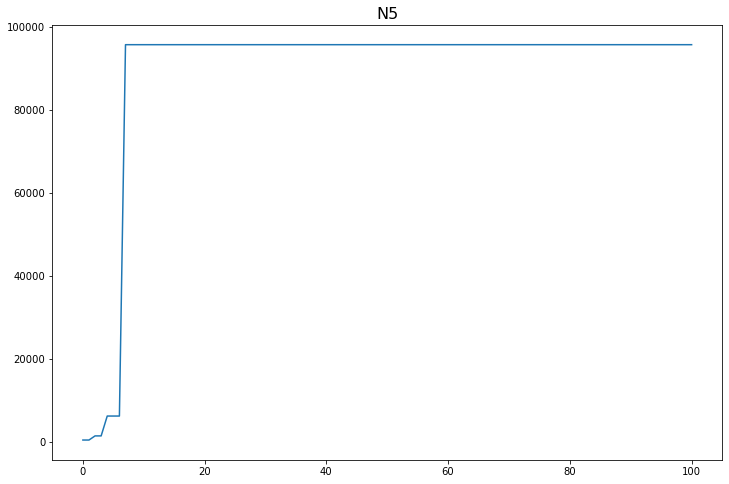

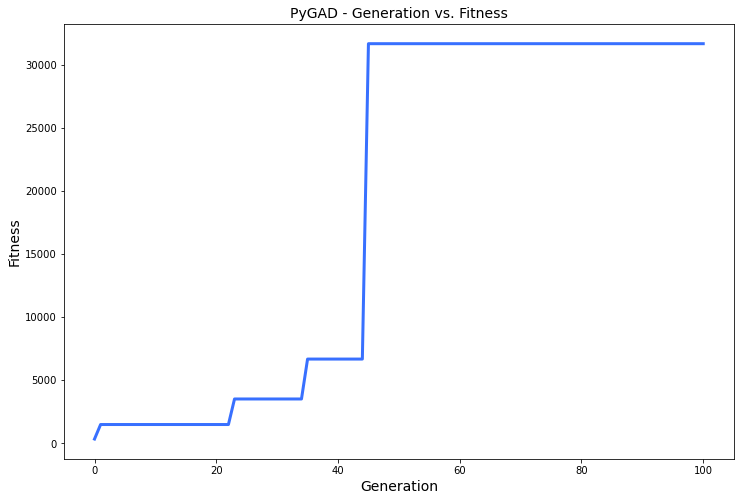

[-0.58]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.58 |===========| 28.905 |==================| 15.475 |==========
[0.392]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 28.927 |==================| 23.285 |==========
[0.283]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 28.939 |==================| 32.604 |==========
[0.661]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.661 |===========| 28.896 |==================| 13.478 |==========
[-0.593]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.593 |===========| 28.904 |==================| 15.121 |==========
[0.22]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 28.946 |==================| 42.314 |==========
[-0.296]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 27.156 |==================| 9.961 |==========
[0.851]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 27.051 |==================| 4.881 |==========
[0.904]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.904 |===========| 27.039 |==================| 4.594 |==========
[-0.469]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 27.144 |==================| 8.919 |==========
[-0.602]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.602 |===========| 27.112 |==================| 6.932 |==========
[0.142]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.142 |===========| 27.222 |==================| 29.484 |==========
[-0.374]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 27.2 |==================| 17.693 |==========
[0.72]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.72 |===========| 27.083 |==================| 5.78 |==========
[0.22]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 27.204 |==================| 19.091 |==========
[-0.666]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 27.096 |==================| 6.252 |==========
Fitness = 265.48926560209384
[-0.469]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 27.144 |==================| 8.919 |==========
[-0.602]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.602 |===========| 27.112 |==================| 6.932 |==========
[0.142]
=====|SOLUTION|===========|OUTPUT|===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 27.176 |==================| 12.508 |==========
[-0.237]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 27.2 |==================| 17.693 |==========
[0.72]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.72 |===========| 27.083 |==================| 5.78 |==========
[0.22]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 27.204 |==================| 19.091 |==========
[-0.666]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 27.096 |==================| 6.252 |==========
[-0.469]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 27.144 |==================| 8.919 |==========
[-0.602]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 27.19 |==================| 15.071 |==========
[-0.246]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 27.198 |==================| 17.071 |==========
[0.932]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.932 |===========| 27.032 |==================| 4.453 |==========
[0.427]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 27.154 |==================| 9.786 |==========
[0.328]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 27.178 |==================| 12.786 |==========
Generation = 2
[0.76]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.76 |===========| 27.074 |==================| 5.474 |==========
[-0.667]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 27.19 |==================| 15.071 |==========
[-0.246]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 27.198 |==================| 17.071 |==========
[0.932]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.932 |===========| 27.032 |==================| 4.453 |==========
[0.427]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 27.154 |==================| 9.786 |==========
[0.328]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 27.178 |==================| 12.786 |==========
Change = 1819.2531389621345
[0.76]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.76 |===========| 27.074 |==================| 5.474 |==========
[-0.667]
=====|SOLUTION|===========|OUTPUT|============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 27.19 |==================| 15.071 |==========
[-0.246]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 27.198 |==================| 17.071 |==========
[0.932]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.932 |===========| 27.032 |==================| 4.453 |==========
[0.427]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 27.154 |==================| 9.786 |==========
[0.328]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 27.178 |==================| 12.786 |==========
[0.465]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 27.145 |==================| 8.981 |==========
[0.96]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 27.238 |==================| 56.483 |==========
[0.427]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 27.154 |==================| 9.804 |==========
[-0.449]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 27.149 |==================| 9.316 |==========
[0.505]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.505 |===========| 27.135 |==================| 8.263 |==========
[0.628]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.628 |===========| 27.105 |==================| 6.634 |==========
Fitness = 2084.7424045642283
[0.465]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 27.145 |==================| 8.981 |==========
[0.96]
=====|SOLUTION|===========|OUTPUT|============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 27.154 |==================| 9.804 |==========
[-0.449]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 27.149 |==================| 9.316 |==========
[0.505]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.505 |===========| 27.135 |==================| 8.263 |==========
[0.628]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.628 |===========| 27.105 |==================| 6.634 |==========
[0.465]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 27.145 |==================| 8.981 |==========
[0.96]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.96 |===========| 27.025 |==================| 4.321 |==========
[0.73]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.559 |===========| 27.122 |==================| 7.463 |==========
[-0.176]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 27.214 |==================| 23.79 |==========
[-0.608]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.608 |===========| 27.11 |==================| 6.856 |==========
Generation = 4
[0.558]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.558 |===========| 27.123 |==================| 7.481 |==========
[0.183]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 27.213 |==================| 22.922 |==========
[0.816]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.816 |===========| 27.06 |==================| 5.092 |==========
[0.951]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 27.214 |==================| 23.79 |==========
[-0.608]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.608 |===========| 27.11 |==================| 6.856 |==========
Change = 0.0
[0.558]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.558 |===========| 27.123 |==================| 7.481 |==========
[0.183]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 27.213 |==================| 22.922 |==========
[0.816]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.816 |===========| 27.06 |==================| 5.092 |==========
[0.951]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.951 |===========| 27.027 |==================| 4.364 |==========
[0.033]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.608 |===========| 27.11 |==================| 6.856 |==========
[-0.382]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 27.165 |==================| 10.967 |==========
[0.835]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.835 |===========| 27.055 |==================| 4.978 |==========
[-0.738]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.738 |===========| 27.079 |==================| 5.638 |==========
[0.345]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 27.174 |==================| 12.145 |==========
[-0.873]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 27.046 |==================| 4.759 |==========
[-0.151]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 27.163 |==================| 10.768 |==========
[0.681]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 27.093 |==================| 6.116 |==========
Fitness = 2547.091601024793
[-0.382]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 27.165 |==================| 10.967 |==========
[0.835]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.835 |===========| 27.055 |==================| 4.978 |==========
[-0.738]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.738 |===========| 27.079 |==================| 5.638 |==========
[0.345]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 27.174 |==================| 12.145 |==========
[-0.873]
=====|SOLUTION|===========|OUTPUT|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 27.163 |==================| 10.768 |==========
[0.681]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 27.093 |==================| 6.116 |==========
[-0.382]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 27.165 |==================| 10.967 |==========
[0.835]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.835 |===========| 27.055 |==================| 4.978 |==========
[-0.738]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.738 |===========| 27.079 |==================| 5.638 |==========
[0.345]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 27.174 |==================| 12.145 |==========
[-0.873]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 27.21 |==================| 21.627 |==========
Generation = 6
[-0.818]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.818 |===========| 27.059 |==================| 5.084 |==========
[-0.069]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 27.24 |==================| 60.933 |==========
[0.022]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 27.251 |==================| 190.166 |==========
[0.79]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 27.066 |==================| 5.265 |==========
[0.035]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 27.248 |==================| 120.394 |==========
[0.951]
=====|SOLUTION|===========|OUTPUT|==================|FITN

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.818 |===========| 27.059 |==================| 5.084 |==========
[-0.069]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 27.24 |==================| 60.933 |==========
[0.022]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 27.251 |==================| 190.166 |==========
[0.79]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 27.066 |==================| 5.265 |==========
[0.035]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 27.248 |==================| 120.394 |==========
[0.951]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.951 |===========| 27.027 |==================| 4.361 |==========
[0.201]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 27.21 |==================| 21.627 |==========
[0.451]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 27.148 |==================| 9.264 |==========
[-0.154]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 27.22 |==================| 27.332 |==========
[0.531]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.531 |===========| 27.129 |==================| 7.869 |==========
[-0.773]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.773 |===========| 27.07 |==================| 5.38 |==========
[0.697]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.697 |===========| 27.089 |==================| 5.978 |==========
[-0.741]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.855 |===========| 27.051 |==================| 4.862 |==========
Fitness = 2547.0916010708906
[0.451]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 27.148 |==================| 9.264 |==========
[-0.154]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 27.22 |==================| 27.332 |==========
[0.531]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.531 |===========| 27.129 |==================| 7.869 |==========
[-0.773]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.773 |===========| 27.07 |==================| 5.38 |==========
[0.697]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.697 |===========| 27.089 |==================| 5.978 |==========
[-0.741]
=====|SOLUTION|===========|OUTPUT|============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.855 |===========| 27.051 |==================| 4.862 |==========
[0.451]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 27.148 |==================| 9.264 |==========
[-0.154]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 27.22 |==================| 27.332 |==========
[0.531]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.531 |===========| 27.129 |==================| 7.869 |==========
[-0.773]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.773 |===========| 27.07 |==================| 5.38 |==========
[0.697]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.697 |===========| 27.089 |==================| 5.978 |==========
[-0.741]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.987 |===========| 27.018 |==================| 4.203 |==========
Generation = 8
[-0.21]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 27.206 |==================| 19.942 |==========
[-0.401]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 27.16 |==================| 10.429 |==========
[0.568]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.568 |===========| 27.12 |==================| 7.345 |==========
[0.535]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.535 |===========| 27.128 |==================| 7.803 |==========
[-0.278]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 27.19 |==================| 15.098 |==========
[0.401]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 27.142 |==================| 8.736 |==========
[-0.987]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.987 |===========| 27.018 |==================| 4.203 |==========
Change = 0.0
[-0.21]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 27.206 |==================| 19.942 |==========
[-0.401]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 27.16 |==================| 10.429 |==========
[0.568]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.568 |===========| 27.12 |==================| 7.345 |==========
[0.535]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.535 |===========| 27.128 |==================| 7.803 |==========
[-0.278]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.88 |===========| 27.044 |==================| 4.718 |==========
[-0.478]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 27.142 |==================| 8.736 |==========
[-0.987]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.987 |===========| 27.018 |==================| 4.203 |==========
[0.496]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 27.137 |==================| 8.425 |==========
[0.14]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 27.223 |==================| 30.001 |==========
[-0.922]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.922 |===========| 27.034 |==================| 4.502 |==========
[0.245]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.951 |===========| 27.027 |==================| 4.363 |==========
[0.819]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.819 |===========| 27.059 |==================| 5.077 |==========
[0.677]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.677 |===========| 27.094 |==================| 6.154 |==========
Fitness = 2547.0916010708906
[0.496]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 27.137 |==================| 8.425 |==========
[0.14]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 27.223 |==================| 30.001 |==========
[-0.922]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.922 |===========| 27.034 |==================| 4.502 |==========
[0.245]
=====|SOLUTION|===========|OUTPUT|=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.936 |===========| 27.031 |==================| 4.431 |==========
[0.951]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.951 |===========| 27.027 |==================| 4.363 |==========
[0.819]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.819 |===========| 27.059 |==================| 5.077 |==========
[0.677]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.677 |===========| 27.094 |==================| 6.154 |==========
[0.496]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 27.137 |==================| 8.425 |==========
[0.14]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 27.223 |==================| 30.001 |==========
[-0.922]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 27.157 |==================| 10.079 |==========
[-0.958]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.958 |===========| 27.025 |==================| 4.33 |==========
[0.352]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 27.172 |==================| 11.896 |==========
Generation = 10
[0.003]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 27.256 |==================| 1493.794 |==========
[0.923]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.923 |===========| 27.034 |==================| 4.496 |==========
[-0.205]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 27.207 |==================| 20.475 |==========
[0.301]
=====|SOLUTION|===========|OUTPUT|==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 27.157 |==================| 10.079 |==========
[-0.958]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.958 |===========| 27.025 |==================| 4.33 |==========
[0.352]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 27.172 |==================| 11.896 |==========
Change = 0.0
[0.003]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 27.256 |==================| 1493.794 |==========
[0.923]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.923 |===========| 27.034 |==================| 4.496 |==========
[-0.205]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 27.207 |==================| 20.475 |==========
[0.301]
=====|SOLUTION|===========|OUTPUT|==================|FIT

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 27.145 |==================| 8.998 |==========
[0.415]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 27.157 |==================| 10.079 |==========
[-0.958]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.958 |===========| 27.025 |==================| 4.33 |==========
[0.352]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 27.172 |==================| 11.896 |==========
[0.529]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.529 |===========| 27.13 |==================| 7.899 |==========
[-0.948]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.948 |===========| 27.028 |==================| 4.374 |==========
[-0.777]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 27.048 |==================| 4.801 |==========
[0.141]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 27.223 |==================| 29.788 |==========
[0.256]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 27.195 |==================| 16.392 |==========
[-0.337]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========| 27.176 |==================| 12.427 |==========
Fitness = 2547.0916010708906
[0.529]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.529 |===========| 27.13 |==================| 7.899 |==========
[-0.948]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.948 |===========| 27.028 |==================| 4.374 |==========
[-0.777]
=====|SOLUTION|===========|OUTPUT|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 27.048 |==================| 4.801 |==========
[0.141]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 27.223 |==================| 29.788 |==========
[0.256]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 27.195 |==================| 16.392 |==========
[-0.337]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========| 27.176 |==================| 12.427 |==========
[0.529]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.529 |===========| 27.13 |==================| 7.899 |==========
[-0.948]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.948 |===========| 27.028 |==================| 4.374 |==========
[-0.777]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.806 |===========| 27.062 |==================| 5.161 |==========
[-0.218]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.218 |===========| 27.204 |==================| 19.224 |==========
[0.652]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.652 |===========| 27.1 |==================| 6.389 |==========
[0.133]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 27.224 |==================| 31.479 |==========
Generation = 12
[0.888]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.888 |===========| 27.042 |==================| 4.674 |==========
[-0.639]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 27.103 |==================| 6.526 |==========
[0.813]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.218 |===========| 27.204 |==================| 19.224 |==========
[0.652]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.652 |===========| 27.1 |==================| 6.389 |==========
[0.133]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 27.224 |==================| 31.479 |==========
Change = 0.0
[0.888]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.888 |===========| 27.042 |==================| 4.674 |==========
[-0.639]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 27.103 |==================| 6.526 |==========
[0.813]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.813 |===========| 27.061 |==================| 5.114 |==========
[0.122]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.806 |===========| 27.062 |==================| 5.161 |==========
[-0.218]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.218 |===========| 27.204 |==================| 19.224 |==========
[0.652]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.652 |===========| 27.1 |==================| 6.389 |==========
[0.133]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 27.224 |==================| 31.479 |==========
[0.69]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 27.091 |==================| 6.036 |==========
[-0.154]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 27.22 |==================| 27.314 |==========
[-0.019]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.63 |===========| 27.105 |==================| 6.619 |==========
[0.988]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.988 |===========| 27.018 |==================| 4.196 |==========
[-0.596]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.596 |===========| 27.113 |==================| 6.994 |==========
[-0.392]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 27.162 |==================| 10.672 |==========
Fitness = 2547.0916010708906
[0.69]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 27.091 |==================| 6.036 |==========
[-0.154]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 27.22 |==================| 27.314 |==========
[-0.019]
=====|SOLUTION|===========|OUTPUT|===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 27.195 |==================| 16.409 |==========
[0.63]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.63 |===========| 27.105 |==================| 6.619 |==========
[0.988]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.988 |===========| 27.018 |==================| 4.196 |==========
[-0.596]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.596 |===========| 27.113 |==================| 6.994 |==========
[-0.392]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 27.162 |==================| 10.672 |==========
[0.69]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 27.091 |==================| 6.036 |==========
[-0.154]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 27.211 |==================| 22.147 |==========
[0.27]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 27.192 |==================| 15.521 |==========
[-0.649]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.649 |===========| 27.1 |==================| 6.419 |==========
[-0.257]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 27.195 |==================| 16.307 |==========
[0.078]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.078 |===========| 27.238 |==================| 53.899 |==========
Generation = 14
[0.991]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.991 |===========| 27.017 |==================| 4.186 |==========
[-0.319]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.783 |===========| 27.068 |==================| 5.308 |==========
[-0.19]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 27.211 |==================| 22.147 |==========
[0.27]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 27.192 |==================| 15.521 |==========
[-0.649]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.649 |===========| 27.1 |==================| 6.419 |==========
[-0.257]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 27.195 |==================| 16.307 |==========
[0.078]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.078 |===========| 27.238 |==================| 53.899 |==========
Change = 0.0
[0.991]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 27.211 |==================| 22.147 |==========
[0.27]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 27.192 |==================| 15.521 |==========
[-0.649]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.649 |===========| 27.1 |==================| 6.419 |==========
[-0.257]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 27.195 |==================| 16.307 |==========
[0.078]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.078 |===========| 27.238 |==================| 53.899 |==========
[0.028]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 27.25 |==================| 150.504 |==========
[-0.045]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 27.226 |==================| 33.08 |==========
[-0.695]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 27.089 |==================| 5.996 |==========
[-0.692]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.692 |===========| 27.09 |==================| 6.02 |==========
[-0.654]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.654 |===========| 27.099 |==================| 6.367 |==========
[-0.201]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 27.208 |==================| 20.871 |==========
[0.205]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 27.207 |==================| 20.445 |==========
Fitness = 2547.0916010708906
[0.028]
=====|SOLUTION|===========|OUTPUT|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 27.246 |==================| 97.386 |==========
[-0.127]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 27.226 |==================| 33.08 |==========
[-0.695]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 27.089 |==================| 5.996 |==========
[-0.692]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.692 |===========| 27.09 |==================| 6.02 |==========
[-0.654]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.654 |===========| 27.099 |==================| 6.367 |==========
[-0.201]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 27.208 |==================| 20.871 |==========
[0.205]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.962 |===========| 27.024 |==================| 4.31 |==========
[-0.41]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 27.158 |==================| 10.198 |==========
[-0.481]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 27.141 |==================| 8.678 |==========
[0.317]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 27.181 |==================| 13.217 |==========
[-0.117]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 27.228 |==================| 35.973 |==========
[0.948]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.948 |===========| 27.028 |==================| 4.376 |==========
[-0.02]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.962 |===========| 27.024 |==================| 4.31 |==========
[-0.41]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 27.158 |==================| 10.198 |==========
[-0.481]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 27.141 |==================| 8.678 |==========
[0.317]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 27.181 |==================| 13.217 |==========
[-0.117]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 27.228 |==================| 35.973 |==========
[0.948]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.948 |===========| 27.028 |==================| 4.376 |==========
[-0.02]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 27.158 |==================| 10.198 |==========
[-0.481]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 27.141 |==================| 8.678 |==========
[0.317]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 27.181 |==================| 13.217 |==========
[-0.117]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 27.228 |==================| 35.973 |==========
[0.948]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.948 |===========| 27.028 |==================| 4.376 |==========
[-0.02]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 27.251 |==================| 206.603 |==========
[-0.743]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 27.234 |==================| 45.466 |==========
[-0.543]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.543 |===========| 27.126 |==================| 7.68 |==========
[0.545]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.545 |===========| 27.126 |==================| 7.657 |==========
[0.284]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.284 |===========| 27.189 |==================| 14.775 |==========
[0.708]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.708 |===========| 27.086 |==================| 5.881 |==========
[0.991]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.991 |===========| 27.017 |==================| 4.183 |==========
Fitness = 2547.0916010708906
[-0.743]
=====|SOLUTION|===========|OUTPUT|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.543 |===========| 27.126 |==================| 7.68 |==========
[0.545]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.545 |===========| 27.126 |==================| 7.657 |==========
[0.284]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.284 |===========| 27.189 |==================| 14.775 |==========
[0.708]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.708 |===========| 27.086 |==================| 5.881 |==========
[0.991]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.991 |===========| 27.017 |==================| 4.183 |==========
[-0.743]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 27.078 |==================| 5.603 |==========
[0.809]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.663 |===========| 27.097 |==================| 6.283 |==========
[-0.523]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.523 |===========| 27.131 |==================| 7.986 |==========
[-0.661]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.661 |===========| 27.098 |==================| 6.302 |==========
[-0.88]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.88 |===========| 27.044 |==================| 4.719 |==========
[-0.142]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.142 |===========| 27.222 |==================| 29.574 |==========
Generation = 18
[-0.908]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.908 |===========| 27.037 |==================| 4.571 |==========
[-0.267]
=====|SOLUTION|===========|OUTPUT|==================|FI

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.663 |===========| 27.097 |==================| 6.283 |==========
[-0.523]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.523 |===========| 27.131 |==================| 7.986 |==========
[-0.661]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.661 |===========| 27.098 |==================| 6.302 |==========
[-0.88]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.88 |===========| 27.044 |==================| 4.719 |==========
[-0.142]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.142 |===========| 27.222 |==================| 29.574 |==========
Change = 0.0
[-0.908]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.908 |===========| 27.037 |==================| 4.571 |==========
[-0.267]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.523 |===========| 27.131 |==================| 7.986 |==========
[-0.661]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.661 |===========| 27.098 |==================| 6.302 |==========
[-0.88]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.88 |===========| 27.044 |==================| 4.719 |==========
[-0.142]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.142 |===========| 27.222 |==================| 29.574 |==========
[-0.031]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 27.249 |==================| 137.699 |==========
[-0.355]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.355 |===========| 27.172 |==================| 11.809 |==========
[0.904]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.899 |===========| 27.04 |==================| 4.62 |==========
[0.223]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 27.203 |==================| 18.852 |==========
[0.336]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 27.176 |==================| 12.481 |==========
[-0.544]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.544 |===========| 27.126 |==================| 7.678 |==========
Fitness = 2547.0916010708906
[-0.031]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 27.249 |==================| 137.699 |==========
[-0.355]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.355 |===========| 27.172 |==================| 11.809 |==========
[0.904]
=====|SOLUTION|===========|OUTPUT|=======

[0.223]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 27.203 |==================| 18.852 |==========
[0.336]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 27.176 |==================| 12.481 |==========
[-0.544]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.544 |===========| 27.126 |==================| 7.678 |==========
[-0.031]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 27.249 |==================| 137.699 |==========
[-0.355]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.355 |===========| 27.172 |==================| 11.809 |==========
[0.904]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.904 |===========| 27.038 |==================| 4.594 |==========
[0.027]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 27.039 |==================| 4.604 |==========
[-0.335]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 27.176 |==================| 12.517 |==========
Generation = 20
[0.788]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.788 |===========| 27.067 |==================| 5.278 |==========
[-0.808]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.808 |===========| 27.062 |==================| 5.147 |==========
[0.235]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 27.2 |==================| 17.88 |==========
[0.53]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.53 |===========| 27.129 |==================| 7.871 |==========
[-0.986]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.848 |===========| 27.052 |==================| 4.901 |==========
[-0.902]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 27.039 |==================| 4.604 |==========
[-0.335]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 27.176 |==================| 12.517 |==========
Change = 0.0
[0.788]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.788 |===========| 27.067 |==================| 5.278 |==========
[-0.808]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.808 |===========| 27.062 |==================| 5.147 |==========
[0.235]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 27.2 |==================| 17.88 |==========
[0.53]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.848 |===========| 27.052 |==================| 4.901 |==========
[-0.902]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 27.039 |==================| 4.604 |==========
[-0.335]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 27.176 |==================| 12.517 |==========
[-0.589]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 27.115 |==================| 7.086 |==========
[-0.925]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.925 |===========| 27.033 |==================| 4.485 |==========
[0.366]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 27.169 |==================| 11.437 |==========
[-0.281]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 27.219 |==================| 26.657 |==========
[-0.471]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 27.143 |==================| 8.866 |==========
Fitness = 2547.0916010708906
[-0.589]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 27.115 |==================| 7.086 |==========
[-0.925]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.925 |===========| 27.033 |==================| 4.485 |==========
[0.366]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 27.169 |==================| 11.437 |==========
[-0.281]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 27.189 |==================| 14.911 |==========
[0.247]
=====|SOLUTION|===========|OUTPUT|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 27.143 |==================| 8.866 |==========
[-0.589]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 27.115 |==================| 7.086 |==========
[-0.925]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.925 |===========| 27.033 |==================| 4.485 |==========
[0.366]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 27.169 |==================| 11.437 |==========
[-0.281]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 27.189 |==================| 14.911 |==========
[0.247]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 27.197 |==================| 16.952 |==========
[0.907]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.89 |===========| 27.042 |==================| 4.666 |==========
[0.845]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.845 |===========| 27.053 |==================| 4.918 |==========
[0.631]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.631 |===========| 27.105 |==================| 6.607 |==========
[-0.596]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.596 |===========| 27.113 |==================| 6.994 |==========
[-0.157]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 27.219 |==================| 26.677 |==========
[-0.703]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.703 |===========| 27.087 |==================| 5.921 |==========
[0.388]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.89 |===========| 27.042 |==================| 4.666 |==========
[0.845]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.845 |===========| 27.053 |==================| 4.918 |==========
[0.631]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.631 |===========| 27.105 |==================| 6.607 |==========
[-0.596]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.596 |===========| 27.113 |==================| 6.994 |==========
[-0.157]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 27.219 |==================| 26.677 |==========
[-0.703]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.703 |===========| 27.087 |==================| 5.921 |==========
[0.388]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 27.175 |==================| 12.33 |==========
[0.38]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 27.165 |==================| 11.01 |==========
[-0.252]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 27.196 |==================| 16.609 |==========
[0.362]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 27.17 |==================| 11.578 |==========
[0.871]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.871 |===========| 27.047 |==================| 4.769 |==========
[0.664]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.664 |===========| 27.097 |==================| 6.274 |==========
[-0.166]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 27.249 |==================| 134.335 |==========
Fitness = 2547.0916010708906
[0.34]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 27.175 |==================| 12.33 |==========
[0.38]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 27.165 |==================| 11.01 |==========
[-0.252]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 27.196 |==================| 16.609 |==========
[0.362]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 27.17 |==================| 11.578 |==========
[0.871]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.871 |===========| 27.047 |==================| 4.769 |==========
[0.664]
=====|SOLUTION|===========|OUTPUT|=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 27.175 |==================| 12.33 |==========
[0.38]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 27.165 |==================| 11.01 |==========
[-0.252]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 27.196 |==================| 16.609 |==========
[0.362]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 27.17 |==================| 11.578 |==========
[0.871]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.871 |===========| 27.047 |==================| 4.769 |==========
[0.664]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.664 |===========| 27.097 |==================| 6.274 |==========
[-0.166]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 27.078 |==================| 5.599 |==========
[0.035]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 27.248 |==================| 119.638 |==========
[-0.907]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.907 |===========| 27.038 |==================| 4.576 |==========
[-0.173]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 27.215 |==================| 24.264 |==========
[0.297]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 27.185 |==================| 14.089 |==========
[-0.182]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 27.213 |==================| 23.082 |==========
[0.955]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 27.248 |==================| 119.638 |==========
[-0.907]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.907 |===========| 27.038 |==================| 4.576 |==========
[-0.173]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 27.215 |==================| 24.264 |==========
[0.297]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 27.185 |==================| 14.089 |==========
[-0.182]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 27.213 |==================| 23.082 |==========
[0.955]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.955 |===========| 27.026 |==================| 4.343 |==========
[0.612]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.285 |===========| 27.188 |==================| 14.692 |==========
[0.969]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.969 |===========| 27.023 |==================| 4.282 |==========
[0.536]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 27.128 |==================| 7.795 |==========
[-0.044]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 27.246 |==================| 96.181 |==========
[-0.614]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.614 |===========| 27.109 |==================| 6.791 |==========
[0.275]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 27.19 |==================| 15.217 |==========
[0.288]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 27.148 |==================| 9.252 |==========
[0.285]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.285 |===========| 27.188 |==================| 14.692 |==========
[0.969]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.969 |===========| 27.023 |==================| 4.282 |==========
[0.536]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 27.128 |==================| 7.795 |==========
[-0.044]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 27.246 |==================| 96.181 |==========
[-0.614]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.614 |===========| 27.109 |==================| 6.791 |==========
[0.275]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 27.19 |==================| 15.101 |==========
[0.452]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 27.148 |==================| 9.252 |==========
[0.285]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.285 |===========| 27.188 |==================| 14.692 |==========
[0.969]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.969 |===========| 27.023 |==================| 4.282 |==========
[0.536]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 27.128 |==================| 7.795 |==========
[-0.044]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 27.246 |==================| 96.181 |==========
[-0.614]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 27.136 |==================| 8.287 |==========
[-0.241]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 27.199 |==================| 17.389 |==========
[-0.764]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.764 |===========| 27.073 |==================| 5.448 |==========
[0.173]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 27.215 |==================| 24.244 |==========
[-0.117]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 27.228 |==================| 35.814 |==========
[-0.419]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.419 |===========| 27.156 |==================| 9.975 |==========
[-0.6]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 27.162 |==================| 10.599 |==========
Change = 0.0
[0.504]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 27.136 |==================| 8.287 |==========
[-0.241]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 27.199 |==================| 17.389 |==========
[-0.764]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.764 |===========| 27.073 |==================| 5.448 |==========
[0.173]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 27.215 |==================| 24.244 |==========
[-0.117]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 27.228 |==================| 35.814 |==========
[-0.419]
=====|SOLUTION|===========|OUTPUT|==================|FI

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.523 |===========| 27.131 |==================| 7.989 |==========
[-0.257]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 27.195 |==================| 16.332 |==========
[-0.882]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 27.044 |==================| 4.71 |==========
[-0.155]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 27.219 |==================| 27.161 |==========
[0.555]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.555 |===========| 27.123 |==================| 7.52 |==========
[0.195]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 27.21 |==================| 21.5 |==========
[0.799]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

[-0.257]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 27.195 |==================| 16.332 |==========
[-0.882]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 27.044 |==================| 4.71 |==========
[-0.155]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 27.219 |==================| 27.161 |==========
[0.555]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.555 |===========| 27.123 |==================| 7.52 |==========
[0.195]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 27.21 |==================| 21.5 |==========
[0.799]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.799 |===========| 27.064 |==================| 5.206 |==========
[-0.638]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 27.044 |==================| 4.71 |==========
[-0.155]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 27.219 |==================| 27.161 |==========
[0.555]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.555 |===========| 27.123 |==================| 7.52 |==========
[0.195]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 27.21 |==================| 21.5 |==========
[0.799]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.799 |===========| 27.064 |==================| 5.206 |==========
[-0.638]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 27.103 |==================| 6.534 |==========
[-0.682]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 27.178 |==================| 12.825 |==========
[-0.259]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 27.195 |==================| 16.219 |==========
[0.363]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 27.17 |==================| 11.544 |==========
[0.471]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 27.144 |==================| 8.878 |==========
[-0.076]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 27.238 |==================| 55.546 |==========
[-0.416]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 27.157 |==================| 10.052 |==========
[0.906]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 27.195 |==================| 16.219 |==========
[0.363]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 27.17 |==================| 11.544 |==========
[0.471]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 27.144 |==================| 8.878 |==========
[-0.076]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 27.238 |==================| 55.546 |==========
[-0.416]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 27.157 |==================| 10.052 |==========
[0.906]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.906 |===========| 27.038 |==================| 4.581 |==========
[-0.838]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.553 |===========| 27.124 |==================| 7.553 |==========
[0.869]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.869 |===========| 27.047 |==================| 4.782 |==========
[-0.533]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.533 |===========| 27.128 |==================| 7.831 |==========
[0.984]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.984 |===========| 27.019 |==================| 4.215 |==========
[-0.805]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.805 |===========| 27.063 |==================| 5.167 |==========
[0.464]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 27.145 |==================| 9.004 |==========
[0.851]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.869 |===========| 27.047 |==================| 4.782 |==========
[-0.533]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.533 |===========| 27.128 |==================| 7.831 |==========
[0.984]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.984 |===========| 27.019 |==================| 4.215 |==========
[-0.805]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.805 |===========| 27.063 |==================| 5.167 |==========
[0.464]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 27.145 |==================| 9.004 |==========
[0.851]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 27.051 |==================| 4.884 |==========
[0.239]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.533 |===========| 27.128 |==================| 7.831 |==========
[0.984]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.984 |===========| 27.019 |==================| 4.215 |==========
[-0.805]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.805 |===========| 27.063 |==================| 5.167 |==========
[0.464]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 27.145 |==================| 9.004 |==========
[0.851]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 27.051 |==================| 4.884 |==========
[0.239]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 27.199 |==================| 17.573 |==========
[-0.276]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.921 |===========| 27.034 |==================| 4.506 |==========
[0.394]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 27.162 |==================| 10.617 |==========
[0.841]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 27.054 |==================| 4.941 |==========
[-0.901]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.901 |===========| 27.039 |==================| 4.606 |==========
[-0.809]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.809 |===========| 27.062 |==================| 5.137 |==========
[0.936]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.936 |===========| 27.03 |==================| 4.431 |==========
[0.392]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 27.162 |==================| 10.617 |==========
[0.841]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 27.054 |==================| 4.941 |==========
[-0.901]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.901 |===========| 27.039 |==================| 4.606 |==========
[-0.809]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.809 |===========| 27.062 |==================| 5.137 |==========
[0.936]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.936 |===========| 27.03 |==================| 4.431 |==========
[0.392]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 27.163 |==================| 10.678 |==========
[0.829]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.698 |===========| 27.089 |==================| 5.966 |==========
[-0.215]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 27.205 |==================| 19.469 |==========
[0.717]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.717 |===========| 27.084 |==================| 5.81 |==========
[-0.935]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.935 |===========| 27.031 |==================| 4.438 |==========
[0.295]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.295 |===========| 27.186 |==================| 14.223 |==========
[-0.961]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 27.025 |==================| 4.318 |==========
[0.644]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.698 |===========| 27.089 |==================| 5.966 |==========
[-0.215]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 27.205 |==================| 19.469 |==========
[0.717]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.717 |===========| 27.084 |==================| 5.81 |==========
[-0.935]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.935 |===========| 27.031 |==================| 4.438 |==========
[0.295]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.295 |===========| 27.186 |==================| 14.223 |==========
[-0.961]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 27.025 |==================| 4.318 |==========
[0.644]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.698 |===========| 27.089 |==================| 5.966 |==========
[-0.215]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 27.205 |==================| 19.469 |==========
[0.717]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.717 |===========| 27.084 |==================| 5.81 |==========
[-0.935]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.935 |===========| 27.031 |==================| 4.438 |==========
[0.295]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.295 |===========| 27.186 |==================| 14.223 |==========
[-0.961]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 27.025 |==================| 4.318 |==========
[0.644]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.811 |===========| 27.061 |==================| 5.128 |==========
[-0.714]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.714 |===========| 27.085 |==================| 5.832 |==========
[0.206]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 27.207 |==================| 20.322 |==========
[0.829]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.829 |===========| 27.057 |==================| 5.013 |==========
[0.819]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.819 |===========| 27.059 |==================| 5.075 |==========
[-0.028]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 27.25 |==================| 151.697 |==========
[0.492]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


[0.206]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 27.207 |==================| 20.322 |==========
[0.829]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.829 |===========| 27.057 |==================| 5.013 |==========
[0.819]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.819 |===========| 27.059 |==================| 5.075 |==========
[-0.028]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 27.25 |==================| 151.697 |==========
[0.492]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 27.138 |==================| 8.487 |==========
[-0.258]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 27.195 |==================| 16.252 |==========
[0.396]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 27.19 |==================| 15.009 |==========
[-0.571]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.571 |===========| 27.119 |==================| 7.307 |==========
[0.045]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 27.245 |==================| 92.809 |==========
[0.222]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 27.203 |==================| 18.887 |==========
[-0.757]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.757 |===========| 27.074 |==================| 5.494 |==========
[-0.528]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 27.13 |==================| 7.91 |==========
[-0.554]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 27.19 |==================| 15.009 |==========
[-0.571]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.571 |===========| 27.119 |==================| 7.307 |==========
[0.045]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 27.245 |==================| 92.809 |==========
[0.222]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 27.203 |==================| 18.887 |==========
[-0.757]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.757 |===========| 27.074 |==================| 5.494 |==========
[-0.528]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 27.13 |==================| 7.91 |==========
[-0.554]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.571 |===========| 27.119 |==================| 7.307 |==========
[0.045]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 27.245 |==================| 92.809 |==========
[0.222]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 27.203 |==================| 18.887 |==========
[-0.757]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.757 |===========| 27.074 |==================| 5.494 |==========
[-0.528]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 27.13 |==================| 7.91 |==========
[-0.554]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.554 |===========| 27.124 |==================| 7.538 |==========
[-0.075]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.839 |===========| 27.054 |==================| 4.952 |==========
[0.614]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.614 |===========| 27.109 |==================| 6.791 |==========
[-0.394]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 27.162 |==================| 10.616 |==========
[0.915]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.915 |===========| 27.036 |==================| 4.539 |==========
[0.184]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 27.212 |==================| 22.87 |==========
[-0.72]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.72 |===========| 27.083 |==================| 5.785 |==========
[0.225]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

[-0.394]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 27.162 |==================| 10.616 |==========
[0.915]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.915 |===========| 27.036 |==================| 4.539 |==========
[0.184]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 27.212 |==================| 22.87 |==========
[-0.72]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.72 |===========| 27.083 |==================| 5.785 |==========
[0.225]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 27.203 |==================| 18.647 |==========
[-0.45]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 27.149 |==================| 9.299 |==========
[0.283]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.061 |===========| 27.242 |==================| 68.436 |==========
[0.068]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 27.24 |==================| 62.008 |==========
[0.364]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 27.169 |==================| 11.486 |==========
[0.259]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 27.194 |==================| 16.193 |==========
[0.38]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 27.165 |==================| 10.998 |==========
Generation = 35
[-0.091]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 27.235 |==================| 46.189 |==========
[-0.517]
=====|SOLUTION|===========|OUTPUT|==================|FI

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 27.24 |==================| 62.008 |==========
[0.364]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 27.169 |==================| 11.486 |==========
[0.259]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 27.194 |==================| 16.193 |==========
[0.38]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 27.165 |==================| 10.998 |==========
Change = 0.0
[-0.091]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 27.235 |==================| 46.189 |==========
[-0.517]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.517 |===========| 27.132 |==================| 8.075 |==========
[-0.604]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.061 |===========| 27.242 |==================| 68.436 |==========
[0.068]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 27.24 |==================| 62.008 |==========
[0.364]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 27.169 |==================| 11.486 |==========
[0.259]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 27.194 |==================| 16.193 |==========
[0.38]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 27.165 |==================| 10.998 |==========
[0.635]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.635 |===========| 27.104 |==================| 6.561 |==========
[-0.83]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.833 |===========| 27.056 |==================| 4.99 |==========
[0.091]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 27.235 |==================| 46.279 |==========
[-0.531]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.531 |===========| 27.129 |==================| 7.865 |==========
[-0.196]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 27.209 |==================| 21.373 |==========
[0.363]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 27.17 |==================| 11.542 |==========
[0.255]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 27.195 |==================| 16.418 |==========
Fitness = 21439.61327093425
[0.635]
=====|SOLUTION|===========|OUTPUT|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.833 |===========| 27.056 |==================| 4.99 |==========
[0.091]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 27.235 |==================| 46.279 |==========
[-0.531]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.531 |===========| 27.129 |==================| 7.865 |==========
[-0.196]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 27.209 |==================| 21.373 |==========
[0.363]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 27.17 |==================| 11.542 |==========
[0.255]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 27.195 |==================| 16.418 |==========
[0.635]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 27.066 |==================| 5.265 |==========
[-0.001]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 27.256 |==================| 7837.86 |==========
[0.91]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.91 |===========| 27.037 |==================| 4.563 |==========
[-0.784]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.784 |===========| 27.068 |==================| 5.306 |==========
[0.01]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 27.254 |==================| 409.638 |==========
[0.929]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.929 |===========| 27.032 |==================| 4.466 |==========
[-0.644]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 27.157 |==================| 10.124 |==========
[-0.79]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 27.066 |==================| 5.265 |==========
[-0.001]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 27.256 |==================| 7837.86 |==========
[0.91]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.91 |===========| 27.037 |==================| 4.563 |==========
[-0.784]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.784 |===========| 27.068 |==================| 5.306 |==========
[0.01]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 27.254 |==================| 409.638 |==========
[0.929]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 27.157 |==================| 10.124 |==========
[-0.79]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 27.066 |==================| 5.265 |==========
[-0.001]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 27.256 |==================| 7837.86 |==========
[0.91]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.91 |===========| 27.037 |==================| 4.563 |==========
[-0.784]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.784 |===========| 27.068 |==================| 5.306 |==========
[0.01]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 27.254 |==================| 409.638 |==========
[0.929]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 27.102 |==================| 6.468 |==========
[0.765]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 27.072 |==================| 5.439 |==========
[-0.654]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.654 |===========| 27.099 |==================| 6.371 |==========
[0.44]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 27.151 |==================| 9.504 |==========
[0.368]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 27.168 |==================| 11.381 |==========
[-0.158]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 27.219 |==================| 26.538 |==========
[-0.748]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 27.102 |==================| 6.468 |==========
[0.765]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 27.072 |==================| 5.439 |==========
[-0.654]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.654 |===========| 27.099 |==================| 6.371 |==========
[0.44]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 27.151 |==================| 9.504 |==========
[0.368]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 27.168 |==================| 11.381 |==========
[-0.158]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 27.219 |==================| 26.538 |==========
[-0.748]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 27.172 |==================| 11.867 |==========
[-0.763]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.763 |===========| 27.073 |==================| 5.451 |==========
[-0.335]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 27.176 |==================| 12.505 |==========
[-0.067]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.067 |===========| 27.24 |==================| 63.039 |==========
[0.564]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.564 |===========| 27.121 |==================| 7.398 |==========
[-0.639]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 27.103 |==================| 6.525 |==========
[0.15]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 27.172 |==================| 11.867 |==========
[-0.763]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.763 |===========| 27.073 |==================| 5.451 |==========
[-0.335]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 27.176 |==================| 12.505 |==========
[-0.067]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.067 |===========| 27.24 |==================| 63.039 |==========
[0.564]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.564 |===========| 27.121 |==================| 7.398 |==========
[-0.639]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 27.103 |==================| 6.525 |==========
[0.15]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 27.172 |==================| 11.867 |==========
[-0.763]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.763 |===========| 27.073 |==================| 5.451 |==========
[-0.335]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 27.176 |==================| 12.505 |==========
[-0.067]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.067 |===========| 27.24 |==================| 63.039 |==========
[0.564]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.564 |===========| 27.121 |==================| 7.398 |==========
[-0.639]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 27.103 |==================| 6.525 |==========
[0.15]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.674 |===========| 27.094 |==================| 6.177 |==========
[-0.342]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 27.174 |==================| 12.236 |==========
[-0.518]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.518 |===========| 27.132 |==================| 8.057 |==========
[0.614]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.614 |===========| 27.109 |==================| 6.791 |==========
[0.855]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.855 |===========| 27.05 |==================| 4.858 |==========
[-0.364]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 27.169 |==================| 11.487 |==========
[0.457]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.84 |===========| 27.054 |==================| 4.944 |==========
[-0.674]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.674 |===========| 27.094 |==================| 6.177 |==========
[-0.342]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 27.174 |==================| 12.236 |==========
[-0.518]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.518 |===========| 27.132 |==================| 8.057 |==========
[0.614]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.614 |===========| 27.109 |==================| 6.791 |==========
[0.855]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.855 |===========| 27.05 |==================| 4.858 |==========
[-0.364]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 27.172 |==================| 11.855 |==========
[0.771]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.771 |===========| 27.071 |==================| 5.395 |==========
[-0.542]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.542 |===========| 27.126 |==================| 7.704 |==========
[0.546]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.546 |===========| 27.125 |==================| 7.645 |==========
[-0.973]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 27.022 |==================| 4.264 |==========
[0.311]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 27.182 |==================| 13.472 |==========
[0.709]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 27.172 |==================| 11.855 |==========
[0.771]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.771 |===========| 27.071 |==================| 5.395 |==========
[-0.542]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.542 |===========| 27.126 |==================| 7.704 |==========
[0.546]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.546 |===========| 27.125 |==================| 7.645 |==========
[-0.973]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 27.022 |==================| 4.264 |==========
[0.311]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 27.182 |==================| 13.472 |==========
[0.709]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 27.172 |==================| 11.855 |==========
[0.771]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.771 |===========| 27.071 |==================| 5.395 |==========
[-0.542]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.542 |===========| 27.126 |==================| 7.704 |==========
[0.546]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.546 |===========| 27.125 |==================| 7.645 |==========
[-0.973]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 27.022 |==================| 4.264 |==========
[0.311]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 27.182 |==================| 13.472 |==========
[0.709]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 27.254 |==================| 487.72 |==========
[-0.761]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.761 |===========| 27.073 |==================| 5.465 |==========
[0.041]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 27.246 |==================| 102.19 |==========
[-0.159]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 27.218 |==================| 26.336 |==========
[-0.639]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 27.103 |==================| 6.52 |==========
[-0.46]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 27.146 |==================| 9.094 |==========
[-0.116]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.797 |===========| 27.065 |==================| 5.217 |==========
[0.009]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 27.254 |==================| 487.72 |==========
[-0.761]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.761 |===========| 27.073 |==================| 5.465 |==========
[0.041]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 27.246 |==================| 102.19 |==========
[-0.159]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 27.218 |==================| 26.336 |==========
[-0.639]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 27.103 |==================| 6.52 |==========
[-0.46]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.926 |===========| 27.033 |==================| 4.481 |==========
[0.496]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 27.138 |==================| 8.426 |==========
[0.104]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 27.231 |==================| 40.268 |==========
[0.145]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 27.222 |==================| 29.042 |==========
[-0.31]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 27.182 |==================| 13.525 |==========
[0.452]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 27.148 |==================| 9.249 |==========
[0.084]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.926 |===========| 27.033 |==================| 4.481 |==========
[0.496]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 27.138 |==================| 8.426 |==========
[0.104]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 27.231 |==================| 40.268 |==========
[0.145]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 27.222 |==================| 29.042 |==========
[-0.31]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 27.182 |==================| 13.525 |==========
[0.452]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 27.148 |==================| 9.249 |==========
[0.084]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.926 |===========| 27.033 |==================| 4.481 |==========
[0.496]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 27.138 |==================| 8.426 |==========
[0.104]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 27.231 |==================| 40.268 |==========
[0.145]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 27.222 |==================| 29.042 |==========
[-0.31]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 27.182 |==================| 13.525 |==========
[0.452]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 27.148 |==================| 9.249 |==========
[0.084]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.781 |===========| 27.068 |==================| 5.326 |==========
[-0.465]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 27.145 |==================| 8.983 |==========
[-0.322]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 27.179 |==================| 13.003 |==========
[0.462]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 27.146 |==================| 9.039 |==========
[0.756]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.756 |===========| 27.074 |==================| 5.504 |==========
[0.842]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.842 |===========| 27.054 |==================| 4.934 |==========
[0.094]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.781 |===========| 27.068 |==================| 5.326 |==========
[-0.465]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 27.145 |==================| 8.983 |==========
[-0.322]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 27.179 |==================| 13.003 |==========
[0.462]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 27.146 |==================| 9.039 |==========
[0.756]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.756 |===========| 27.074 |==================| 5.504 |==========
[0.842]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.842 |===========| 27.054 |==================| 4.934 |==========
[0.094]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 27.17 |==================| 11.569 |==========
[0.836]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.836 |===========| 27.055 |==================| 4.973 |==========
[0.695]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 27.089 |==================| 5.99 |==========
[-0.384]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 27.164 |==================| 10.895 |==========
[0.517]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.517 |===========| 27.132 |==================| 8.08 |==========
[-0.755]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.755 |===========| 27.075 |==================| 5.512 |==========
[-0.761]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.836 |===========| 27.055 |==================| 4.973 |==========
[0.695]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 27.089 |==================| 5.99 |==========
[-0.384]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 27.164 |==================| 10.895 |==========
[0.517]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.517 |===========| 27.132 |==================| 8.08 |==========
[-0.755]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.755 |===========| 27.075 |==================| 5.512 |==========
[-0.761]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.761 |===========| 27.073 |==================| 5.464 |==========
Change = 0.0
[0.705]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.836 |===========| 27.055 |==================| 4.973 |==========
[0.695]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 27.089 |==================| 5.99 |==========
[-0.384]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 27.164 |==================| 10.895 |==========
[0.517]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.517 |===========| 27.132 |==================| 8.08 |==========
[-0.755]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.755 |===========| 27.075 |==================| 5.512 |==========
[-0.761]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.761 |===========| 27.073 |==================| 5.464 |==========
[-0.813]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.88 |===========| 27.044 |==================| 4.721 |==========
[-0.766]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.766 |===========| 27.072 |==================| 5.431 |==========
[-0.484]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 27.14 |==================| 8.623 |==========
[-0.667]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.667 |===========| 27.096 |==================| 6.246 |==========
[0.941]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.941 |===========| 27.029 |==================| 4.409 |==========
[0.865]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 27.048 |==================| 4.805 |==========
[0.161]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.582 |===========| 27.117 |==================| 7.171 |==========
[0.88]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.88 |===========| 27.044 |==================| 4.721 |==========
[-0.766]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.766 |===========| 27.072 |==================| 5.431 |==========
[-0.484]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 27.14 |==================| 8.623 |==========
[-0.667]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.667 |===========| 27.096 |==================| 6.246 |==========
[0.941]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.941 |===========| 27.029 |==================| 4.409 |==========
[0.865]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 27.024 |==================| 4.3 |==========
[-0.92]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.92 |===========| 27.035 |==================| 4.511 |==========
[-0.249]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 27.197 |==================| 16.846 |==========
[-0.997]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.997 |===========| 27.016 |==================| 4.157 |==========
[0.265]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 27.193 |==================| 15.819 |==========
[-0.259]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 27.194 |==================| 16.174 |==========
[0.626]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.308 |===========| 27.183 |==================| 13.624 |==========
[-0.964]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 27.024 |==================| 4.3 |==========
[-0.92]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.92 |===========| 27.035 |==================| 4.511 |==========
[-0.249]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 27.197 |==================| 16.846 |==========
[-0.997]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.997 |===========| 27.016 |==================| 4.157 |==========
[0.265]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 27.193 |==================| 15.819 |==========
[-0.259]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.308 |===========| 27.183 |==================| 13.624 |==========
[-0.964]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 27.024 |==================| 4.3 |==========
[-0.92]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.92 |===========| 27.035 |==================| 4.511 |==========
[-0.249]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 27.197 |==================| 16.846 |==========
[-0.997]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.997 |===========| 27.016 |==================| 4.157 |==========
[0.265]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 27.193 |==================| 15.819 |==========
[-0.259]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 27.247 |==================| 107.164 |==========
[0.794]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.794 |===========| 27.065 |==================| 5.234 |==========
[0.779]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.779 |===========| 27.069 |==================| 5.342 |==========
[-0.823]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.823 |===========| 27.058 |==================| 5.049 |==========
[0.63]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.63 |===========| 27.105 |==================| 6.62 |==========
[0.267]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 27.193 |==================| 15.729 |==========
[-0.198]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 27.247 |==================| 107.164 |==========
[0.794]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.794 |===========| 27.065 |==================| 5.234 |==========
[0.779]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.779 |===========| 27.069 |==================| 5.342 |==========
[-0.823]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.823 |===========| 27.058 |==================| 5.049 |==========
[0.63]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.63 |===========| 27.105 |==================| 6.62 |==========
[0.267]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 27.193 |==================| 15.729 |==========
[-0.198]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 27.039 |==================| 4.602 |==========
[-0.928]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.928 |===========| 27.033 |==================| 4.472 |==========
[-0.194]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 27.21 |==================| 21.656 |==========
[-0.383]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 27.165 |==================| 10.926 |==========
[-0.022]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 27.251 |==================| 195.668 |==========
[0.654]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.654 |===========| 27.099 |==================| 6.37 |==========
[-0.341]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 27.227 |==================| 34.701 |==========
[-0.902]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 27.039 |==================| 4.602 |==========
[-0.928]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.928 |===========| 27.033 |==================| 4.472 |==========
[-0.194]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 27.21 |==================| 21.656 |==========
[-0.383]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 27.165 |==================| 10.926 |==========
[-0.022]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 27.251 |==================| 195.668 |==========
[0.654]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 27.227 |==================| 34.701 |==========
[-0.902]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 27.039 |==================| 4.602 |==========
[-0.928]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.928 |===========| 27.033 |==================| 4.472 |==========
[-0.194]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 27.21 |==================| 21.656 |==========
[-0.383]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 27.165 |==================| 10.926 |==========
[-0.022]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 27.251 |==================| 195.668 |==========
[0.654]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.295 |===========| 27.186 |==================| 14.217 |==========
[-0.557]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.557 |===========| 27.123 |==================| 7.49 |==========
[0.847]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.847 |===========| 27.052 |==================| 4.907 |==========
[-0.366]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 27.169 |==================| 11.45 |==========
[-0.798]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.798 |===========| 27.064 |==================| 5.212 |==========
[-0.508]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.508 |===========| 27.134 |==================| 8.216 |==========
[-0.949]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.557 |===========| 27.123 |==================| 7.49 |==========
[0.847]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.847 |===========| 27.052 |==================| 4.907 |==========
[-0.366]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 27.169 |==================| 11.45 |==========
[-0.798]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.798 |===========| 27.064 |==================| 5.212 |==========
[-0.508]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.508 |===========| 27.134 |==================| 8.216 |==========
[-0.949]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.949 |===========| 27.028 |==================| 4.374 |==========
[0.445]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.812 |===========| 27.061 |==================| 5.121 |==========
[0.3]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 27.185 |==================| 13.949 |==========
[0.135]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 27.224 |==================| 31.202 |==========
[0.04]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 27.247 |==================| 104.804 |==========
[0.722]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 27.083 |==================| 5.766 |==========
[-0.715]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.715 |===========| 27.084 |==================| 5.819 |==========
[0.267]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.812 |===========| 27.061 |==================| 5.121 |==========
[0.3]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 27.185 |==================| 13.949 |==========
[0.135]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 27.224 |==================| 31.202 |==========
[0.04]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 27.247 |==================| 104.804 |==========
[0.722]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 27.083 |==================| 5.766 |==========
[-0.715]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.715 |===========| 27.084 |==================| 5.819 |==========
[0.267]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 27.185 |==================| 13.949 |==========
[0.135]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 27.224 |==================| 31.202 |==========
[0.04]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 27.247 |==================| 104.804 |==========
[0.722]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 27.083 |==================| 5.766 |==========
[-0.715]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.715 |===========| 27.084 |==================| 5.819 |==========
[0.267]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 27.193 |==================| 15.714 |==========
[0.864]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 27.253 |==================| 356.759 |==========
[0.734]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.734 |===========| 27.08 |==================| 5.668 |==========
[0.525]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.525 |===========| 27.13 |==================| 7.956 |==========
[0.358]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 27.171 |==================| 11.681 |==========
[0.677]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.677 |===========| 27.094 |==================| 6.153 |==========
[-0.357]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 27.171 |==================| 11.729 |==========
[0.893]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.734 |===========| 27.08 |==================| 5.668 |==========
[0.525]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.525 |===========| 27.13 |==================| 7.956 |==========
[0.358]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 27.171 |==================| 11.681 |==========
[0.677]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.677 |===========| 27.094 |==================| 6.153 |==========
[-0.357]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 27.171 |==================| 11.729 |==========
[0.893]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.893 |===========| 27.041 |==================| 4.651 |==========
[-0.76]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 27.252 |==================| 244.976 |==========
[-0.567]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.567 |===========| 27.12 |==================| 7.356 |==========
[0.186]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 27.212 |==================| 22.528 |==========
[-0.691]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.691 |===========| 27.09 |==================| 6.023 |==========
[0.958]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.958 |===========| 27.025 |==================| 4.332 |==========
Generation = 53
[0.514]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.514 |===========| 27.133 |==================| 8.123 |==========
[0.729]
=====|SOLUTION|===========|OUTPUT|==================|FITN

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 27.251 |==================| 196.8 |==========
[0.017]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 27.252 |==================| 244.976 |==========
[-0.567]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.567 |===========| 27.12 |==================| 7.356 |==========
[0.186]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 27.212 |==================| 22.528 |==========
[-0.691]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.691 |===========| 27.09 |==================| 6.023 |==========
[0.958]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.958 |===========| 27.025 |==================| 4.332 |==========
Change = 0.0
[0.514]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 27.251 |==================| 196.8 |==========
[0.017]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 27.252 |==================| 244.976 |==========
[-0.567]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.567 |===========| 27.12 |==================| 7.356 |==========
[0.186]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 27.212 |==================| 22.528 |==========
[-0.691]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.691 |===========| 27.09 |==================| 6.023 |==========
[0.958]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.958 |===========| 27.025 |==================| 4.332 |==========
[0.414]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 27.199 |==================| 17.546 |==========
[0.883]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 27.044 |==================| 4.703 |==========
[0.931]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 27.032 |==================| 4.457 |==========
[0.49]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 27.139 |==================| 8.52 |==========
[-0.736]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.736 |===========| 27.079 |==================| 5.657 |==========
[0.114]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 27.229 |==================| 37.0 |==========
[0.636]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 27.199 |==================| 17.546 |==========
[0.883]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 27.044 |==================| 4.703 |==========
[0.931]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 27.032 |==================| 4.457 |==========
[0.49]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 27.139 |==================| 8.52 |==========
[-0.736]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.736 |===========| 27.079 |==================| 5.657 |==========
[0.114]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 27.229 |==================| 37.0 |==========
[0.636]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 27.186 |==================| 14.262 |==========
[-0.319]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 27.18 |==================| 13.143 |==========
[-0.412]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 27.158 |==================| 10.14 |==========
[0.949]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.949 |===========| 27.027 |==================| 4.37 |==========
[0.616]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.616 |===========| 27.109 |==================| 6.771 |==========
[-0.101]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.101 |===========| 27.232 |==================| 41.539 |==========
[-0.96]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.911 |===========| 27.037 |==================| 4.557 |==========
[-0.294]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 27.186 |==================| 14.262 |==========
[-0.319]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 27.18 |==================| 13.143 |==========
[-0.412]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 27.158 |==================| 10.14 |==========
[0.949]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.949 |===========| 27.027 |==================| 4.37 |==========
[0.616]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.616 |===========| 27.109 |==================| 6.771 |==========
[-0.101]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 27.184 |==================| 13.875 |==========
[0.911]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.911 |===========| 27.037 |==================| 4.557 |==========
[-0.294]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 27.186 |==================| 14.262 |==========
[-0.319]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 27.18 |==================| 13.143 |==========
[-0.412]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 27.158 |==================| 10.14 |==========
[0.949]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.949 |===========| 27.027 |==================| 4.37 |==========
[0.616]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 27.068 |==================| 5.319 |==========
[0.469]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 27.144 |==================| 8.913 |==========
[-0.58]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.58 |===========| 27.117 |==================| 7.195 |==========
[0.549]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.549 |===========| 27.125 |==================| 7.604 |==========
[-0.07]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 27.239 |==================| 59.66 |==========
[0.545]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.545 |===========| 27.126 |==================| 7.653 |==========
[-0.173]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 27.068 |==================| 5.319 |==========
[0.469]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 27.144 |==================| 8.913 |==========
[-0.58]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.58 |===========| 27.117 |==================| 7.195 |==========
[0.549]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.549 |===========| 27.125 |==================| 7.604 |==========
[-0.07]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 27.239 |==================| 59.66 |==========
[0.545]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.545 |===========| 27.126 |==================| 7.653 |==========
[-0.173]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.854 |===========| 27.051 |==================| 4.866 |==========
[0.833]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.833 |===========| 27.056 |==================| 4.99 |==========
[0.155]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 27.219 |==================| 27.174 |==========
[0.451]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 27.148 |==================| 9.261 |==========
[-0.367]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 27.168 |==================| 11.392 |==========
[0.927]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.927 |===========| 27.033 |==================| 4.476 |==========
[-0.141]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.854 |===========| 27.051 |==================| 4.866 |==========
[0.833]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.833 |===========| 27.056 |==================| 4.99 |==========
[0.155]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 27.219 |==================| 27.174 |==========
[0.451]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 27.148 |==================| 9.261 |==========
[-0.367]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 27.168 |==================| 11.392 |==========
[0.927]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.927 |===========| 27.033 |==================| 4.476 |==========
[-0.141]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.833 |===========| 27.056 |==================| 4.99 |==========
[0.155]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 27.219 |==================| 27.174 |==========
[0.451]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 27.148 |==================| 9.261 |==========
[-0.367]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 27.168 |==================| 11.392 |==========
[0.927]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.927 |===========| 27.033 |==================| 4.476 |==========
[-0.141]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 27.223 |==================| 29.704 |==========
[0.821]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.558 |===========| 27.122 |==================| 7.477 |==========
[0.932]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.932 |===========| 27.032 |==================| 4.451 |==========
[-0.502]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 27.136 |==================| 8.32 |==========
[0.748]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.748 |===========| 27.077 |==================| 5.565 |==========
[0.563]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.563 |===========| 27.121 |==================| 7.41 |==========
[0.541]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.541 |===========| 27.127 |==================| 7.715 |==========
[-0.557]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.93 |===========| 27.032 |==================| 4.46 |==========
[-0.558]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.558 |===========| 27.122 |==================| 7.477 |==========
[0.932]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.932 |===========| 27.032 |==================| 4.451 |==========
[-0.502]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 27.136 |==================| 8.32 |==========
[0.748]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.748 |===========| 27.077 |==================| 5.565 |==========
[0.563]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.563 |===========| 27.121 |==================| 7.41 |==========
[0.541]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.643 |===========| 27.102 |==================| 6.477 |==========
[0.1]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 27.232 |==================| 42.076 |==========
[0.33]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 27.177 |==================| 12.707 |==========
[-0.002]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 27.256 |==================| 1770.146 |==========
[0.]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.0 |===========| 27.256 |==================| 16689.026 |==========
[0.856]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.856 |===========| 27.05 |==================| 4.853 |==========
[-0.502]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.643 |===========| 27.102 |==================| 6.477 |==========
[0.1]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 27.232 |==================| 42.076 |==========
[0.33]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 27.177 |==================| 12.707 |==========
[-0.002]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 27.256 |==================| 1770.146 |==========
[0.]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.0 |===========| 27.256 |==================| 16689.026 |==========
[0.856]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.856 |===========| 27.05 |==================| 4.853 |==========
[-0.502]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 27.14 |==================| 8.587 |==========
[-0.643]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.643 |===========| 27.102 |==================| 6.477 |==========
[0.1]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 27.232 |==================| 42.076 |==========
[0.33]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 27.177 |==================| 12.707 |==========
[-0.002]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 27.256 |==================| 1770.146 |==========
[0.]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.0 |===========| 27.256 |==================| 16689.026 |==========
[0.856]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.806 |===========| 27.062 |==================| 5.156 |==========
[-0.42]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 27.156 |==================| 9.954 |==========
[-0.311]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 27.182 |==================| 13.459 |==========
[0.982]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.982 |===========| 27.019 |==================| 4.222 |==========
[0.322]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 27.179 |==================| 12.996 |==========
[0.815]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.815 |===========| 27.06 |==================| 5.098 |==========
[0.198]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 27.238 |==================| 55.371 |==========
[0.806]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.806 |===========| 27.062 |==================| 5.156 |==========
[-0.42]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 27.156 |==================| 9.954 |==========
[-0.311]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 27.182 |==================| 13.459 |==========
[0.982]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.982 |===========| 27.019 |==================| 4.222 |==========
[0.322]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 27.179 |==================| 12.996 |==========
[0.815]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.868 |===========| 27.047 |==================| 4.784 |==========
[-0.352]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 27.172 |==================| 11.908 |==========
[-0.02]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 27.252 |==================| 215.11 |==========
[0.76]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.76 |===========| 27.074 |==================| 5.478 |==========
[-0.786]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.786 |===========| 27.067 |==================| 5.288 |==========
[0.882]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 27.044 |==================| 4.706 |==========
[-0.322]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.868 |===========| 27.047 |==================| 4.784 |==========
[-0.352]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 27.172 |==================| 11.908 |==========
[-0.02]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 27.252 |==================| 215.11 |==========
[0.76]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.76 |===========| 27.074 |==================| 5.478 |==========
[-0.786]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.786 |===========| 27.067 |==================| 5.288 |==========
[0.882]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 27.044 |==================| 4.706 |==========
[-0.322]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 27.172 |==================| 11.908 |==========
[-0.02]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 27.252 |==================| 215.11 |==========
[0.76]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.76 |===========| 27.074 |==================| 5.478 |==========
[-0.786]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.786 |===========| 27.067 |==================| 5.288 |==========
[0.882]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 27.044 |==================| 4.706 |==========
[-0.322]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 27.179 |==================| 13.014 |==========
[0.217]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 27.141 |==================| 8.648 |==========
[-0.211]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 27.206 |==================| 19.916 |==========
[-0.175]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 27.215 |==================| 24.031 |==========
[0.688]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.688 |===========| 27.091 |==================| 6.051 |==========
[-0.173]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 27.215 |==================| 24.209 |==========
[0.893]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.893 |===========| 27.041 |==================| 4.648 |==========
Fitness = 21439.61327093425
[0.162]
=====|SOLUTION|===========|OUTPUT|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.698 |===========| 27.089 |==================| 5.965 |==========
[-0.483]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 27.141 |==================| 8.648 |==========
[-0.211]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 27.206 |==================| 19.916 |==========
[-0.175]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 27.215 |==================| 24.031 |==========
[0.688]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.688 |===========| 27.091 |==================| 6.051 |==========
[-0.173]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 27.215 |==================| 24.209 |==========
[0.893]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 27.211 |==================| 22.222 |==========
[0.415]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 27.157 |==================| 10.084 |==========
[0.562]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.562 |===========| 27.122 |==================| 7.425 |==========
[0.697]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.697 |===========| 27.089 |==================| 5.974 |==========
[-0.964]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 27.024 |==================| 4.304 |==========
[0.165]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 27.217 |==================| 25.382 |==========
Generation = 63
[-0.915]
=====|SOLUTION|===========|OUTPUT|==================|FI

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 27.211 |==================| 22.222 |==========
[0.415]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 27.157 |==================| 10.084 |==========
[0.562]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.562 |===========| 27.122 |==================| 7.425 |==========
[0.697]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.697 |===========| 27.089 |==================| 5.974 |==========
[-0.964]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 27.024 |==================| 4.304 |==========
[0.165]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 27.217 |==================| 25.382 |==========
Change = 0.0
[-0.915]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.688 |===========| 27.091 |==================| 6.055 |==========
[0.189]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 27.211 |==================| 22.222 |==========
[0.415]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 27.157 |==================| 10.084 |==========
[0.562]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.562 |===========| 27.122 |==================| 7.425 |==========
[0.697]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.697 |===========| 27.089 |==================| 5.974 |==========
[-0.964]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 27.024 |==================| 4.304 |==========
[0.165]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 27.184 |==================| 13.922 |==========
[0.295]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.295 |===========| 27.186 |==================| 14.216 |==========
[0.475]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 27.142 |==================| 8.793 |==========
[0.975]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.975 |===========| 27.021 |==================| 4.255 |==========
[0.504]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 27.136 |==================| 8.286 |==========
[0.321]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 27.18 |==================| 13.041 |==========
Fitness = 21439.61327093425
[0.832]
=====|SOLUTION|===========|OUTPUT|============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 27.184 |==================| 13.922 |==========
[0.295]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.295 |===========| 27.186 |==================| 14.216 |==========
[0.475]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 27.142 |==================| 8.793 |==========
[0.975]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.975 |===========| 27.021 |==================| 4.255 |==========
[0.504]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 27.136 |==================| 8.286 |==========
[0.321]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 27.18 |==================| 13.041 |==========
[0.832]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.943 |===========| 27.029 |==================| 4.397 |==========
[0.226]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 27.202 |==================| 18.592 |==========
[0.439]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 27.151 |==================| 9.517 |==========
[-0.694]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.694 |===========| 27.09 |==================| 6.0 |==========
[-0.008]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 27.254 |==================| 516.567 |==========
Generation = 65
[-0.278]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 27.19 |==================| 15.075 |==========
[-0.644]
=====|SOLUTION|===========|OUTPUT|==================|FIT

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 27.202 |==================| 18.592 |==========
[0.439]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 27.151 |==================| 9.517 |==========
[-0.694]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.694 |===========| 27.09 |==================| 6.0 |==========
[-0.008]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 27.254 |==================| 516.567 |==========
Change = 0.0
[-0.278]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 27.19 |==================| 15.075 |==========
[-0.644]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 27.102 |==================| 6.476 |==========
[-0.904]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 27.151 |==================| 9.517 |==========
[-0.694]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.694 |===========| 27.09 |==================| 6.0 |==========
[-0.008]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 27.254 |==================| 516.567 |==========
[-0.278]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 27.19 |==================| 15.051 |==========
[-0.515]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 27.133 |==================| 8.116 |==========
[-0.737]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 27.079 |==================| 5.645 |==========
[-0.181]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 27.189 |==================| 14.901 |==========
[-0.743]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 27.078 |==================| 5.598 |==========
Fitness = 21439.61327093425
[-0.278]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 27.19 |==================| 15.051 |==========
[-0.515]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 27.133 |==================| 8.116 |==========
[-0.737]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 27.079 |==================| 5.645 |==========
[-0.181]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 27.213 |==================| 23.16 |==========
[-0.246]
=====|SOLUTION|===========|OUTPUT|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 27.078 |==================| 5.598 |==========
[-0.278]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 27.19 |==================| 15.051 |==========
[-0.515]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 27.133 |==================| 8.116 |==========
[-0.737]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 27.079 |==================| 5.645 |==========
[-0.181]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 27.213 |==================| 23.16 |==========
[-0.246]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 27.197 |==================| 17.013 |==========
[0.563]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.593 |===========| 27.114 |==================| 7.032 |==========
[-0.229]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 27.202 |==================| 18.3 |==========
Generation = 67
[0.994]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.994 |===========| 27.016 |==================| 4.171 |==========
[-0.115]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 27.229 |==================| 36.632 |==========
[-0.199]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 27.209 |==================| 21.103 |==========
[-0.037]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.037 |===========| 27.247 |==================| 113.763 |==========
[-0.595]
=====|SOLUTION|===========|OUTPUT|==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.593 |===========| 27.114 |==================| 7.032 |==========
[-0.229]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 27.202 |==================| 18.3 |==========
Change = 0.0
[0.994]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.994 |===========| 27.016 |==================| 4.171 |==========
[-0.115]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 27.229 |==================| 36.632 |==========
[-0.199]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 27.209 |==================| 21.103 |==========
[-0.037]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.037 |===========| 27.247 |==================| 113.763 |==========
[-0.595]
=====|SOLUTION|===========|OUTPUT|==================|FI

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 27.202 |==================| 18.3 |==========
[0.674]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.674 |===========| 27.094 |==================| 6.178 |==========
[-0.741]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.741 |===========| 27.078 |==================| 5.616 |==========
[0.809]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.809 |===========| 27.062 |==================| 5.141 |==========
[-0.311]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 27.182 |==================| 13.483 |==========
[0.358]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 27.171 |==================| 11.709 |==========
[-0.024]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.674 |===========| 27.094 |==================| 6.178 |==========
[-0.741]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.741 |===========| 27.078 |==================| 5.616 |==========
[0.809]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.809 |===========| 27.062 |==================| 5.141 |==========
[-0.311]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 27.182 |==================| 13.483 |==========
[0.358]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 27.171 |==================| 11.709 |==========
[-0.024]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 27.25 |==================| 172.53 |==========
[-0.326]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.741 |===========| 27.078 |==================| 5.616 |==========
[0.809]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.809 |===========| 27.062 |==================| 5.141 |==========
[-0.311]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 27.182 |==================| 13.483 |==========
[0.358]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 27.171 |==================| 11.709 |==========
[-0.024]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 27.25 |==================| 172.53 |==========
[-0.326]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 27.178 |==================| 12.843 |==========
[0.802]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.846 |===========| 27.053 |==================| 4.913 |==========
[-0.444]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 27.15 |==================| 9.41 |==========
[-0.06]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 27.242 |==================| 70.032 |==========
[0.983]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.983 |===========| 27.019 |==================| 4.219 |==========
[0.849]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.849 |===========| 27.052 |==================| 4.895 |==========
[-0.423]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 27.155 |==================| 9.88 |==========
[0.56]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.846 |===========| 27.053 |==================| 4.913 |==========
[-0.444]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 27.15 |==================| 9.41 |==========
[-0.06]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 27.242 |==================| 70.032 |==========
[0.983]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.983 |===========| 27.019 |==================| 4.219 |==========
[0.849]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.849 |===========| 27.052 |==================| 4.895 |==========
[-0.423]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 27.155 |==================| 9.88 |==========
[0.56]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.946 |===========| 27.028 |==================| 4.387 |==========
[-0.481]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 27.141 |==================| 8.69 |==========
[0.824]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.824 |===========| 27.058 |==================| 5.046 |==========
[0.937]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.937 |===========| 27.03 |==================| 4.426 |==========
[0.223]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 27.203 |==================| 18.815 |==========
[0.645]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.645 |===========| 27.102 |==================| 6.465 |==========
[-0.415]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 27.141 |==================| 8.69 |==========
[0.824]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.824 |===========| 27.058 |==================| 5.046 |==========
[0.937]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.937 |===========| 27.03 |==================| 4.426 |==========
[0.223]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 27.203 |==================| 18.815 |==========
[0.645]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.645 |===========| 27.102 |==================| 6.465 |==========
[-0.415]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 27.157 |==================| 10.084 |==========
[0.525]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.824 |===========| 27.058 |==================| 5.046 |==========
[0.937]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.937 |===========| 27.03 |==================| 4.426 |==========
[0.223]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 27.203 |==================| 18.815 |==========
[0.645]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.645 |===========| 27.102 |==================| 6.465 |==========
[-0.415]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 27.157 |==================| 10.084 |==========
[0.525]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.525 |===========| 27.13 |==================| 7.956 |==========
[-0.408]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 27.197 |==================| 16.828 |==========
[0.451]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 27.148 |==================| 9.263 |==========
[-0.105]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 27.231 |==================| 40.073 |==========
[-0.765]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 27.072 |==================| 5.439 |==========
[-0.027]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 27.25 |==================| 156.311 |==========
[-0.032]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 27.249 |==================| 132.459 |==========
[0.393]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 27.148 |==================| 9.263 |==========
[-0.105]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 27.231 |==================| 40.073 |==========
[-0.765]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 27.072 |==================| 5.439 |==========
[-0.027]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 27.25 |==================| 156.311 |==========
[-0.032]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 27.249 |==================| 132.459 |==========
[0.393]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 27.162 |==================| 10.658 |==========
[0.956]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.707 |===========| 27.086 |==================| 5.89 |==========
[0.7]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.7 |===========| 27.088 |==================| 5.945 |==========
[0.525]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.525 |===========| 27.13 |==================| 7.95 |==========
[0.428]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 27.154 |==================| 9.779 |==========
[-0.711]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.711 |===========| 27.085 |==================| 5.852 |==========
[-0.74]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.74 |===========| 27.078 |==================| 5.626 |==========
[-0.354]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.7 |===========| 27.088 |==================| 5.945 |==========
[0.525]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.525 |===========| 27.13 |==================| 7.95 |==========
[0.428]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 27.154 |==================| 9.779 |==========
[-0.711]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.711 |===========| 27.085 |==================| 5.852 |==========
[-0.74]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.74 |===========| 27.078 |==================| 5.626 |==========
[-0.354]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 27.172 |==================| 11.835 |==========
[0.406]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.525 |===========| 27.13 |==================| 7.95 |==========
[0.428]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 27.154 |==================| 9.779 |==========
[-0.711]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.711 |===========| 27.085 |==================| 5.852 |==========
[-0.74]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.74 |===========| 27.078 |==================| 5.626 |==========
[-0.354]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 27.172 |==================| 11.835 |==========
[0.406]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.406 |===========| 27.159 |==================| 10.306 |==========
[0.942]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 27.251 |==================| 180.843 |==========
[0.023]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 27.251 |==================| 183.253 |==========
[0.586]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.586 |===========| 27.116 |==================| 7.12 |==========
[0.63]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.63 |===========| 27.105 |==================| 6.614 |==========
[0.489]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 27.139 |==================| 8.548 |==========
[-0.682]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.682 |===========| 27.093 |==================| 6.11 |==========
[0.574]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 27.251 |==================| 180.843 |==========
[0.023]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 27.251 |==================| 183.253 |==========
[0.586]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.586 |===========| 27.116 |==================| 7.12 |==========
[0.63]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.63 |===========| 27.105 |==================| 6.614 |==========
[0.489]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 27.139 |==================| 8.548 |==========
[-0.682]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.682 |===========| 27.093 |==================| 6.11 |==========
[0.574]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 27.07 |==================| 5.37 |==========
[0.497]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 27.137 |==================| 8.407 |==========
[-0.721]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.721 |===========| 27.083 |==================| 5.775 |==========
[0.645]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.645 |===========| 27.101 |==================| 6.459 |==========
[-0.872]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 27.046 |==================| 4.763 |==========
[0.39]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 27.163 |==================| 10.742 |==========
[0.751]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 27.07 |==================| 5.37 |==========
[0.497]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 27.137 |==================| 8.407 |==========
[-0.721]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.721 |===========| 27.083 |==================| 5.775 |==========
[0.645]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.645 |===========| 27.101 |==================| 6.459 |==========
[-0.872]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 27.046 |==================| 4.763 |==========
[0.39]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 27.163 |==================| 10.742 |==========
[0.751]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 27.07 |==================| 5.37 |==========
[0.497]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 27.137 |==================| 8.407 |==========
[-0.721]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.721 |===========| 27.083 |==================| 5.775 |==========
[0.645]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.645 |===========| 27.101 |==================| 6.459 |==========
[-0.872]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 27.046 |==================| 4.763 |==========
[0.39]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 27.163 |==================| 10.742 |==========
[0.751]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 27.244 |==================| 81.72 |==========
[-0.573]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.573 |===========| 27.119 |==================| 7.285 |==========
[-0.863]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 27.048 |==================| 4.812 |==========
[-0.226]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 27.202 |==================| 18.557 |==========
[-0.593]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.593 |===========| 27.114 |==================| 7.03 |==========
[-0.433]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 27.153 |==================| 9.664 |==========
[0.116]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.573 |===========| 27.119 |==================| 7.285 |==========
[-0.863]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 27.048 |==================| 4.812 |==========
[-0.226]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 27.202 |==================| 18.557 |==========
[-0.593]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.593 |===========| 27.114 |==================| 7.03 |==========
[-0.433]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 27.153 |==================| 9.664 |==========
[0.116]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 27.228 |==================| 36.083 |==========
[-0.726]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.991 |===========| 27.017 |==================| 4.183 |==========
[0.903]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.903 |===========| 27.039 |==================| 4.596 |==========
[-0.95]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 27.027 |==================| 4.368 |==========
[-0.59]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.59 |===========| 27.115 |==================| 7.07 |==========
[0.593]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.593 |===========| 27.114 |==================| 7.035 |==========
[-0.863]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 27.048 |==================| 4.814 |==========
[-0.521]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.903 |===========| 27.039 |==================| 4.596 |==========
[-0.95]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 27.027 |==================| 4.368 |==========
[-0.59]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.59 |===========| 27.115 |==================| 7.07 |==========
[0.593]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.593 |===========| 27.114 |==================| 7.035 |==========
[-0.863]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 27.048 |==================| 4.814 |==========
[-0.521]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.521 |===========| 27.131 |==================| 8.019 |==========
[-0.935]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.903 |===========| 27.039 |==================| 4.596 |==========
[-0.95]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 27.027 |==================| 4.368 |==========
[-0.59]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.59 |===========| 27.115 |==================| 7.07 |==========
[0.593]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.593 |===========| 27.114 |==================| 7.035 |==========
[-0.863]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 27.048 |==================| 4.814 |==========
[-0.521]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.521 |===========| 27.131 |==================| 8.019 |==========
[-0.935]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 27.179 |==================| 13.027 |==========
[0.601]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 27.112 |==================| 6.944 |==========
[0.849]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.849 |===========| 27.052 |==================| 4.895 |==========
[0.379]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 27.166 |==================| 11.034 |==========
[0.092]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 27.234 |==================| 45.703 |==========
[-0.477]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.477 |===========| 27.142 |==================| 8.752 |==========
Fitness = 21439.61327093425
[0.91]
=====|SOLUTION|===========|OUTPUT|===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 27.179 |==================| 13.027 |==========
[0.601]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 27.112 |==================| 6.944 |==========
[0.849]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.849 |===========| 27.052 |==================| 4.895 |==========
[0.379]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 27.166 |==================| 11.034 |==========
[0.092]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 27.234 |==================| 45.703 |==========
[-0.477]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.477 |===========| 27.142 |==================| 8.752 |==========
[0.91]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.866 |===========| 27.048 |==================| 4.794 |==========
[0.099]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 27.233 |==================| 42.458 |==========
[0.911]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.911 |===========| 27.037 |==================| 4.558 |==========
[0.787]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.787 |===========| 27.067 |==================| 5.287 |==========
[0.241]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 27.199 |==================| 17.433 |==========
[-0.372]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 27.167 |==================| 11.245 |==========
Generation = 78
[-0.806]
=====|SOLUTION|===========|OUTPUT|==================|FI

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.866 |===========| 27.048 |==================| 4.794 |==========
[0.099]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 27.233 |==================| 42.458 |==========
[0.911]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.911 |===========| 27.037 |==================| 4.558 |==========
[0.787]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.787 |===========| 27.067 |==================| 5.287 |==========
[0.241]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 27.199 |==================| 17.433 |==========
[-0.372]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 27.167 |==================| 11.245 |==========
Change = 0.0
[-0.806]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 27.233 |==================| 42.458 |==========
[0.911]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.911 |===========| 27.037 |==================| 4.558 |==========
[0.787]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.787 |===========| 27.067 |==================| 5.287 |==========
[0.241]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 27.199 |==================| 17.433 |==========
[-0.372]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 27.167 |==================| 11.245 |==========
[0.891]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.891 |===========| 27.042 |==================| 4.661 |==========
[0.445]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.881 |===========| 27.044 |==================| 4.714 |==========
[-0.277]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 27.19 |==================| 15.119 |==========
[-0.748]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.748 |===========| 27.076 |==================| 5.562 |==========
[0.086]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.086 |===========| 27.236 |==================| 48.939 |==========
Fitness = 21439.61327093425
[0.891]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.891 |===========| 27.042 |==================| 4.661 |==========
[0.445]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 27.15 |==================| 9.394 |==========
[0.993]
=====|SOLUTION|===========|OUTPUT|============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 27.19 |==================| 15.119 |==========
[-0.748]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.748 |===========| 27.076 |==================| 5.562 |==========
[0.086]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.086 |===========| 27.236 |==================| 48.939 |==========
[0.891]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.891 |===========| 27.042 |==================| 4.661 |==========
[0.445]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 27.15 |==================| 9.394 |==========
[0.993]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.993 |===========| 27.017 |==================| 4.173 |==========
[-0.573]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 27.22 |==================| 27.581 |==========
[-0.317]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 27.181 |==================| 13.225 |==========
[0.441]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 27.151 |==================| 9.488 |==========
[0.33]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 27.177 |==================| 12.678 |==========
Generation = 80
[-0.889]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.889 |===========| 27.042 |==================| 4.672 |==========
[-0.391]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.391 |===========| 27.163 |==================| 10.693 |==========
[-0.006]
=====|SOLUTION|===========|OUTPUT|==================|FI

[-0.317]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 27.181 |==================| 13.225 |==========
[0.441]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 27.151 |==================| 9.488 |==========
[0.33]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 27.177 |==================| 12.678 |==========
Change = 0.0
[-0.889]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.889 |===========| 27.042 |==================| 4.672 |==========
[-0.391]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.391 |===========| 27.163 |==================| 10.693 |==========
[-0.006]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.006 |===========| 27.255 |==================| 743.367 |==========
[0.745]
=====|SOLUTION|===========|OUTPUT|==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 27.22 |==================| 27.581 |==========
[-0.317]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 27.181 |==================| 13.225 |==========
[0.441]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 27.151 |==================| 9.488 |==========
[0.33]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 27.177 |==================| 12.678 |==========
[0.055]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 27.243 |==================| 75.902 |==========
[0.017]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 27.252 |==================| 249.18 |==========
[-0.54]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 27.226 |==================| 33.442 |==========
[0.48]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 27.141 |==================| 8.708 |==========
[-0.013]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 27.253 |==================| 323.17 |==========
[0.277]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 27.19 |==================| 15.154 |==========
[0.141]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 27.223 |==================| 29.879 |==========
Fitness = 21439.61327093425
[0.055]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 27.243 |==================| 75.902 |==========
[0.017]
=====|SOLUTION|===========|OUTPUT|===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 27.141 |==================| 8.708 |==========
[-0.013]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 27.253 |==================| 323.17 |==========
[0.277]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 27.19 |==================| 15.154 |==========
[0.141]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 27.223 |==================| 29.879 |==========
[0.055]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 27.243 |==================| 75.902 |==========
[0.017]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 27.252 |==================| 249.18 |==========
[-0.54]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 27.024 |==================| 4.316 |==========
[0.215]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 27.205 |==================| 19.519 |==========
[-0.345]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 27.174 |==================| 12.135 |==========
Generation = 82
[-0.455]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 27.147 |==================| 9.181 |==========
[0.639]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 27.103 |==================| 6.522 |==========
[-0.327]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 27.178 |==================| 12.805 |==========
[0.386]
=====|SOLUTION|===========|OUTPUT|==================|F

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 27.205 |==================| 19.519 |==========
[-0.345]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 27.174 |==================| 12.135 |==========
Change = 0.0
[-0.455]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 27.147 |==================| 9.181 |==========
[0.639]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 27.103 |==================| 6.522 |==========
[-0.327]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 27.178 |==================| 12.805 |==========
[0.386]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 27.164 |==================| 10.831 |==========
[-0.361]
=====|SOLUTION|===========|OUTPUT|==================|FI

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 27.205 |==================| 19.519 |==========
[-0.345]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 27.174 |==================| 12.135 |==========
[0.242]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 27.199 |==================| 17.346 |==========
[0.602]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.602 |===========| 27.112 |==================| 6.927 |==========
[0.407]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 27.159 |==================| 10.284 |==========
[-0.456]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 27.147 |==================| 9.165 |==========
[-0.515]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 27.217 |==================| 25.372 |==========
[-0.184]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 27.212 |==================| 22.84 |==========
[-0.999]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.999 |===========| 27.015 |==================| 4.148 |==========
Fitness = 21439.61327093425
[0.242]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 27.199 |==================| 17.346 |==========
[0.602]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.602 |===========| 27.112 |==================| 6.927 |==========
[0.407]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 27.159 |==================| 10.284 |==========
[-0.456]
=====|SOLUTION|===========|OUTPUT|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 27.217 |==================| 25.372 |==========
[-0.184]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 27.212 |==================| 22.84 |==========
[-0.999]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.999 |===========| 27.015 |==================| 4.148 |==========
[0.242]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 27.199 |==================| 17.346 |==========
[0.602]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.602 |===========| 27.112 |==================| 6.927 |==========
[0.407]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 27.159 |==================| 10.284 |==========
[-0.456]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 27.242 |==================| 73.036 |==========
[0.173]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 27.215 |==================| 24.199 |==========
[-0.216]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 27.205 |==================| 19.426 |==========
Generation = 84
[0.957]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.957 |===========| 27.025 |==================| 4.333 |==========
[0.613]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.613 |===========| 27.109 |==================| 6.802 |==========
[0.339]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 27.175 |==================| 12.364 |==========
[0.274]
=====|SOLUTION|===========|OUTPUT|==================|FI

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 27.242 |==================| 73.036 |==========
[0.173]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 27.215 |==================| 24.199 |==========
[-0.216]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 27.205 |==================| 19.426 |==========
Change = 0.0
[0.957]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.957 |===========| 27.025 |==================| 4.333 |==========
[0.613]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.613 |===========| 27.109 |==================| 6.802 |==========
[0.339]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 27.175 |==================| 12.364 |==========
[0.274]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.832 |===========| 27.056 |==================| 4.992 |==========
[-0.058]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 27.242 |==================| 73.036 |==========
[0.173]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 27.215 |==================| 24.199 |==========
[-0.216]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 27.205 |==================| 19.426 |==========
[0.903]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.903 |===========| 27.039 |==================| 4.597 |==========
[-0.439]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 27.151 |==================| 9.528 |==========
[-0.165]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 27.168 |==================| 11.307 |==========
[0.436]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 27.152 |==================| 9.581 |==========
[0.364]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 27.169 |==================| 11.513 |==========
[0.052]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 27.244 |==================| 80.236 |==========
Fitness = 21439.61327093425
[0.903]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.903 |===========| 27.039 |==================| 4.597 |==========
[-0.439]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 27.151 |==================| 9.528 |==========
[-0.165]
=====|SOLUTION|===========|OUTPUT|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.556 |===========| 27.123 |==================| 7.505 |==========
[0.37]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 27.168 |==================| 11.307 |==========
[0.436]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 27.152 |==================| 9.581 |==========
[0.364]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 27.169 |==================| 11.513 |==========
[0.052]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 27.244 |==================| 80.236 |==========
[0.903]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.903 |===========| 27.039 |==================| 4.597 |==========
[-0.439]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 27.167 |==================| 11.217 |==========
[-0.334]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 27.176 |==================| 12.532 |==========
[0.165]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 27.217 |==================| 25.473 |==========
[0.868]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.868 |===========| 27.047 |==================| 4.784 |==========
[-0.82]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.82 |===========| 27.059 |==================| 5.071 |==========
Generation = 86
[0.721]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.721 |===========| 27.083 |==================| 5.774 |==========
[-0.384]
=====|SOLUTION|===========|OUTPUT|==================|FIT

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 27.209 |==================| 21.029 |==========
[0.373]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 27.167 |==================| 11.217 |==========
[-0.334]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 27.176 |==================| 12.532 |==========
[0.165]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 27.217 |==================| 25.473 |==========
[0.868]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.868 |===========| 27.047 |==================| 4.784 |==========
[-0.82]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.82 |===========| 27.059 |==================| 5.071 |==========
Change = 0.0
[0.721]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 27.194 |==================| 16.129 |==========
[-0.2]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 27.209 |==================| 21.029 |==========
[0.373]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 27.167 |==================| 11.217 |==========
[-0.334]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 27.176 |==================| 12.532 |==========
[0.165]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 27.217 |==================| 25.473 |==========
[0.868]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.868 |===========| 27.047 |==================| 4.784 |==========
[-0.82]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 27.207 |==================| 20.423 |==========
[-0.894]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.894 |===========| 27.041 |==================| 4.643 |==========
[-0.69]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 27.091 |==================| 6.036 |==========
[0.061]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.061 |===========| 27.242 |==================| 68.395 |==========
[-0.522]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.522 |===========| 27.131 |==================| 8.001 |==========
[-0.763]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.763 |===========| 27.073 |==================| 5.451 |==========
[0.457]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 27.231 |==================| 39.491 |==========
[-0.205]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 27.207 |==================| 20.423 |==========
[-0.894]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.894 |===========| 27.041 |==================| 4.643 |==========
[-0.69]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 27.091 |==================| 6.036 |==========
[0.061]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.061 |===========| 27.242 |==================| 68.395 |==========
[-0.522]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.522 |===========| 27.131 |==================| 8.001 |==========
[-0.763]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.654 |===========| 27.099 |==================| 6.369 |==========
[0.297]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 27.185 |==================| 14.124 |==========
[-0.807]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.807 |===========| 27.062 |==================| 5.154 |==========
[0.826]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.826 |===========| 27.057 |==================| 5.032 |==========
[-0.662]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.662 |===========| 27.097 |==================| 6.293 |==========
[0.265]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 27.193 |==================| 15.799 |==========
[0.924]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 27.185 |==================| 14.124 |==========
[-0.807]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.807 |===========| 27.062 |==================| 5.154 |==========
[0.826]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.826 |===========| 27.057 |==================| 5.032 |==========
[-0.662]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.662 |===========| 27.097 |==================| 6.293 |==========
[0.265]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 27.193 |==================| 15.799 |==========
[0.924]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.924 |===========| 27.034 |==================| 4.493 |==========
[-0.606]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.654 |===========| 27.099 |==================| 6.369 |==========
[0.297]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 27.185 |==================| 14.124 |==========
[-0.807]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.807 |===========| 27.062 |==================| 5.154 |==========
[0.826]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.826 |===========| 27.057 |==================| 5.032 |==========
[-0.662]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.662 |===========| 27.097 |==================| 6.293 |==========
[0.265]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 27.193 |==================| 15.799 |==========
[0.924]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 27.163 |==================| 10.718 |==========
[-0.571]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.571 |===========| 27.119 |==================| 7.31 |==========
[0.829]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.829 |===========| 27.057 |==================| 5.011 |==========
[-0.817]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.817 |===========| 27.06 |==================| 5.086 |==========
[0.343]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 27.174 |==================| 12.204 |==========
[-0.149]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 27.221 |==================| 28.28 |==========
[0.594]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 27.163 |==================| 10.718 |==========
[-0.571]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.571 |===========| 27.119 |==================| 7.31 |==========
[0.829]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.829 |===========| 27.057 |==================| 5.011 |==========
[-0.817]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.817 |===========| 27.06 |==================| 5.086 |==========
[0.343]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 27.174 |==================| 12.204 |==========
[-0.149]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 27.221 |==================| 28.28 |==========
[0.594]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.647 |===========| 27.101 |==================| 6.438 |==========
[-0.786]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.786 |===========| 27.067 |==================| 5.291 |==========
[0.02]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 27.251 |==================| 211.787 |==========
[-0.775]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 27.07 |==================| 5.367 |==========
[0.116]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 27.229 |==================| 36.18 |==========
[-0.175]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 27.214 |==================| 23.983 |==========
[0.206]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.786 |===========| 27.067 |==================| 5.291 |==========
[0.02]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 27.251 |==================| 211.787 |==========
[-0.775]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 27.07 |==================| 5.367 |==========
[0.116]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 27.229 |==================| 36.18 |==========
[-0.175]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 27.214 |==================| 23.983 |==========
[0.206]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 27.207 |==================| 20.37 |==========
[-0.302]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 27.251 |==================| 211.787 |==========
[-0.775]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 27.07 |==================| 5.367 |==========
[0.116]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 27.229 |==================| 36.18 |==========
[-0.175]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 27.214 |==================| 23.983 |==========
[0.206]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 27.207 |==================| 20.37 |==========
[-0.302]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 27.184 |==================| 13.863 |==========
[0.082]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

[0.436]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 27.152 |==================| 9.589 |==========
[-0.339]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 27.175 |==================| 12.367 |==========
[-0.941]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.941 |===========| 27.029 |==================| 4.41 |==========
[0.204]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 27.208 |==================| 20.543 |==========
[0.017]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 27.252 |==================| 243.258 |==========
[0.664]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.664 |===========| 27.097 |==================| 6.275 |==========
[0.978]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 27.152 |==================| 9.589 |==========
[-0.339]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 27.175 |==================| 12.367 |==========
[-0.941]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.941 |===========| 27.029 |==================| 4.41 |==========
[0.204]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 27.208 |==================| 20.543 |==========
[0.017]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 27.252 |==================| 243.258 |==========
[0.664]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.664 |===========| 27.097 |==================| 6.275 |==========
[0.978]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 27.178 |==================| 12.84 |==========
[0.158]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 27.219 |==================| 26.66 |==========
[0.807]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.807 |===========| 27.062 |==================| 5.151 |==========
[0.696]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 27.089 |==================| 5.98 |==========
[0.624]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.624 |===========| 27.107 |==================| 6.683 |==========
[0.23]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 27.201 |==================| 18.203 |==========
[-0.221]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 27.178 |==================| 12.84 |==========
[0.158]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 27.219 |==================| 26.66 |==========
[0.807]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.807 |===========| 27.062 |==================| 5.151 |==========
[0.696]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 27.089 |==================| 5.98 |==========
[0.624]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.624 |===========| 27.107 |==================| 6.683 |==========
[0.23]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 27.201 |==================| 18.203 |==========
[-0.221]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 27.178 |==================| 12.84 |==========
[0.158]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 27.219 |==================| 26.66 |==========
[0.807]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.807 |===========| 27.062 |==================| 5.151 |==========
[0.696]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 27.089 |==================| 5.98 |==========
[0.624]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.624 |===========| 27.107 |==================| 6.683 |==========
[0.23]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 27.201 |==================| 18.203 |==========
[-0.221]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 27.195 |==================| 16.306 |==========
[0.572]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.572 |===========| 27.119 |==================| 7.295 |==========
[-0.133]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 27.224 |==================| 31.541 |==========
[-0.785]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.785 |===========| 27.067 |==================| 5.299 |==========
[0.81]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.81 |===========| 27.061 |==================| 5.134 |==========
[-0.997]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.997 |===========| 27.016 |==================| 4.159 |==========
[0.335]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.572 |===========| 27.119 |==================| 7.295 |==========
[-0.133]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 27.224 |==================| 31.541 |==========
[-0.785]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.785 |===========| 27.067 |==================| 5.299 |==========
[0.81]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.81 |===========| 27.061 |==================| 5.134 |==========
[-0.997]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.997 |===========| 27.016 |==================| 4.159 |==========
[0.335]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 27.176 |==================| 12.498 |==========
[-0.471]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 27.187 |==================| 14.554 |==========
[0.006]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.006 |===========| 27.255 |==================| 687.766 |==========
[0.811]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.811 |===========| 27.061 |==================| 5.128 |==========
[-0.832]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.832 |===========| 27.056 |==================| 4.997 |==========
[0.543]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.543 |===========| 27.126 |==================| 7.685 |==========
Generation = 94
[0.7]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.7 |===========| 27.088 |==================| 5.951 |==========
[0.977]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 27.118 |==================| 7.255 |==========
[0.288]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 27.187 |==================| 14.554 |==========
[0.006]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.006 |===========| 27.255 |==================| 687.766 |==========
[0.811]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.811 |===========| 27.061 |==================| 5.128 |==========
[-0.832]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.832 |===========| 27.056 |==================| 4.997 |==========
[0.543]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.543 |===========| 27.126 |==================| 7.685 |==========
Change = 0.0
[0.7]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 27.118 |==================| 7.255 |==========
[0.288]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 27.187 |==================| 14.554 |==========
[0.006]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.006 |===========| 27.255 |==================| 687.766 |==========
[0.811]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.811 |===========| 27.061 |==================| 5.128 |==========
[-0.832]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.832 |===========| 27.056 |==================| 4.997 |==========
[0.543]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.543 |===========| 27.126 |==================| 7.685 |==========
[0.833]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.707 |===========| 27.086 |==================| 5.892 |==========
[-0.166]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 27.217 |==================| 25.298 |==========
[0.027]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 27.25 |==================| 156.933 |==========
[0.776]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.776 |===========| 27.07 |==================| 5.357 |==========
[-0.928]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.928 |===========| 27.032 |==================| 4.47 |==========
[-0.82]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.82 |===========| 27.059 |==================| 5.069 |==========
Fitness = 21439.61327093425
[0.833]
=====|SOLUTION|===========|OUTPUT|=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 27.217 |==================| 25.199 |==========
[0.707]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.707 |===========| 27.086 |==================| 5.892 |==========
[-0.166]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 27.217 |==================| 25.298 |==========
[0.027]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 27.25 |==================| 156.933 |==========
[0.776]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.776 |===========| 27.07 |==================| 5.357 |==========
[-0.928]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.928 |===========| 27.032 |==================| 4.47 |==========
[-0.82]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 27.051 |==================| 4.88 |==========
[-0.695]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 27.089 |==================| 5.994 |==========
[0.812]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.812 |===========| 27.061 |==================| 5.122 |==========
[-0.755]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.755 |===========| 27.075 |==================| 5.514 |==========
[0.989]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.989 |===========| 27.018 |==================| 4.194 |==========
[0.115]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 27.229 |==================| 36.604 |==========
[0.825]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 27.051 |==================| 4.88 |==========
[-0.695]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 27.089 |==================| 5.994 |==========
[0.812]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.812 |===========| 27.061 |==================| 5.122 |==========
[-0.755]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.755 |===========| 27.075 |==================| 5.514 |==========
[0.989]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.989 |===========| 27.018 |==================| 4.194 |==========
[0.115]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 27.229 |==================| 36.604 |==========
[0.825]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.736 |===========| 27.079 |==================| 5.653 |==========
[0.851]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 27.051 |==================| 4.88 |==========
[-0.695]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 27.089 |==================| 5.994 |==========
[0.812]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.812 |===========| 27.061 |==================| 5.122 |==========
[-0.755]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.755 |===========| 27.075 |==================| 5.514 |==========
[0.989]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.989 |===========| 27.018 |==================| 4.194 |==========
[0.115]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 27.204 |==================| 19.07 |==========
[-0.353]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 27.172 |==================| 11.859 |==========
[0.41]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 27.158 |==================| 10.194 |==========
[0.551]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 27.124 |==================| 7.58 |==========
[0.906]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.906 |===========| 27.038 |==================| 4.581 |==========
[-0.739]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.739 |===========| 27.079 |==================| 5.632 |==========
[-0.49]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.867 |===========| 27.047 |==================| 4.79 |==========
[0.22]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 27.204 |==================| 19.07 |==========
[-0.353]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 27.172 |==================| 11.859 |==========
[0.41]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 27.158 |==================| 10.194 |==========
[0.551]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 27.124 |==================| 7.58 |==========
[0.906]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.906 |===========| 27.038 |==================| 4.581 |==========
[-0.739]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 27.203 |==================| 18.838 |==========
[-0.778]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.778 |===========| 27.069 |==================| 5.347 |==========
[-0.233]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 27.201 |==================| 18.018 |==========
[-0.175]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 27.214 |==================| 23.937 |==========
[-0.306]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.306 |===========| 27.183 |==================| 13.69 |==========
[-0.997]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.997 |===========| 27.016 |==================| 4.16 |==========
[0.424]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.844 |===========| 27.053 |==================| 4.921 |==========
[-0.223]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 27.203 |==================| 18.838 |==========
[-0.778]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.778 |===========| 27.069 |==================| 5.347 |==========
[-0.233]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 27.201 |==================| 18.018 |==========
[-0.175]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 27.214 |==================| 23.937 |==========
[-0.306]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.306 |===========| 27.183 |==================| 13.69 |==========
[-0.997]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.844 |===========| 27.053 |==================| 4.921 |==========
[-0.223]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 27.203 |==================| 18.838 |==========
[-0.778]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.778 |===========| 27.069 |==================| 5.347 |==========
[-0.233]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 27.201 |==================| 18.018 |==========
[-0.175]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 27.214 |==================| 23.937 |==========
[-0.306]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.306 |===========| 27.183 |==================| 13.69 |==========
[-0.997]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 27.165 |==================| 10.938 |==========
[0.716]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.716 |===========| 27.084 |==================| 5.818 |==========
[-0.568]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.568 |===========| 27.12 |==================| 7.347 |==========
[0.335]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 27.176 |==================| 12.482 |==========
[-0.193]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 27.21 |==================| 21.745 |==========
[0.692]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.692 |===========| 27.09 |==================| 6.023 |==========
[0.502]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 27.165 |==================| 10.938 |==========
[0.716]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.716 |===========| 27.084 |==================| 5.818 |==========
[-0.568]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.568 |===========| 27.12 |==================| 7.347 |==========
[0.335]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 27.176 |==================| 12.482 |==========
[-0.193]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 27.21 |==================| 21.745 |==========
[0.692]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.692 |===========| 27.09 |==================| 6.023 |==========
[0.502]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 27.161 |==================| 10.502 |==========
[-0.487]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 27.14 |==================| 8.58 |==========
[0.082]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.082 |===========| 27.237 |==================| 51.207 |==========
[0.532]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.532 |===========| 27.129 |==================| 7.855 |==========
[-0.546]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.546 |===========| 27.125 |==================| 7.651 |==========
[-0.61]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.61 |===========| 27.11 |==================| 6.835 |==========
[-0.263]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 27.14 |==================| 8.58 |==========
[0.082]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.082 |===========| 27.237 |==================| 51.207 |==========
[0.532]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.532 |===========| 27.129 |==================| 7.855 |==========
[-0.546]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.546 |===========| 27.125 |==================| 7.651 |==========
[-0.61]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.61 |===========| 27.11 |==================| 6.835 |==========
[-0.263]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 27.194 |==================| 15.971 |==========
[0.865]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

[0.532]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.532 |===========| 27.129 |==================| 7.855 |==========
[-0.546]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.546 |===========| 27.125 |==================| 7.651 |==========
[-0.61]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.61 |===========| 27.11 |==================| 6.835 |==========
[-0.263]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 27.194 |==================| 15.971 |==========
[0.865]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 27.048 |==================| 4.802 |==========
[-0.664]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.664 |===========| 27.097 |==================| 6.279 |==========
[0.105]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

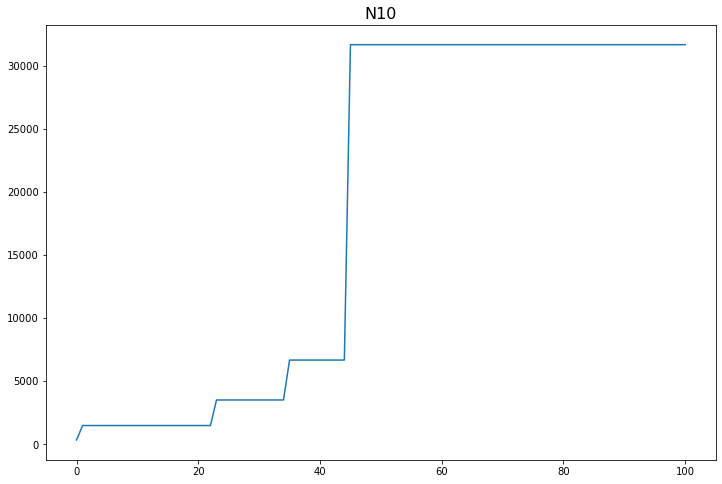

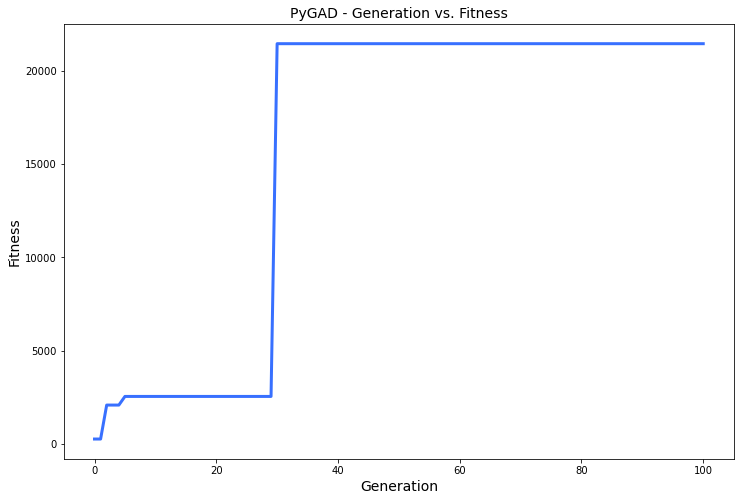

[-0.887]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.887 |===========| 27.043 |==================| 4.684 |==========
[0.557]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.557 |===========| 27.123 |==================| 7.489 |==========
[-0.607]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.607 |===========| 27.111 |==================| 6.874 |==========
[-0.143]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 27.222 |==================| 29.409 |==========
[0.278]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 27.19 |==================| 15.103 |==========
[-0.562]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.562 |===========| 27.121 |==================| 7.422 |==========
[-0.825]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.915 |===========| 24.819 |==================| 19.559 |==========
[0.263]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 24.856 |==================| 68.544 |==========
[0.967]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.967 |===========| 24.816 |==================| 18.487 |==========
[-0.616]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.616 |===========| 24.836 |==================| 29.108 |==========
[-0.725]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 24.83 |==================| 24.726 |==========
[0.772]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.772 |===========| 24.827 |==================| 23.211 |==========
[-0.16]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 24.852 |==================| 53.91 |==========
[-0.616]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.616 |===========| 24.836 |==================| 29.097 |==========
[-0.327]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 24.852 |==================| 55.022 |==========
Fitness = 1371.3194527667986
[0.967]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.967 |===========| 24.816 |==================| 18.487 |==========
[-0.616]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.616 |===========| 24.836 |==================| 29.108 |==========
[-0.725]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 24.83 |==================| 24.726 |==========
[0.772]
=====|SOLUTION|===========|OUTPUT|=====

[-0.616]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.616 |===========| 24.836 |==================| 29.097 |==========
[-0.327]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 24.852 |==================| 55.022 |==========
[0.967]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.967 |===========| 24.816 |==================| 18.487 |==========
[-0.616]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.616 |===========| 24.836 |==================| 29.108 |==========
[-0.725]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 24.83 |==================| 24.726 |==========
[0.772]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.772 |===========| 24.827 |==================| 23.211 |==========
[-0.16]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 24.854 |==================| 60.006 |==========
[-0.544]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.544 |===========| 24.84 |==================| 32.977 |==========
Generation = 2
[0.594]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.594 |===========| 24.837 |==================| 30.202 |==========
[-0.226]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 24.858 |==================| 79.741 |==========
[-0.515]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 24.842 |==================| 34.89 |==========
[-0.503]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.503 |===========| 24.842 |==================| 35.678 |==========
[1.009]
=====|SOLUTION|===========|OUTPUT|==================|FI

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.544 |===========| 24.84 |==================| 32.977 |==========
Change = 0.0
[0.594]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.594 |===========| 24.837 |==================| 30.202 |==========
[-0.226]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 24.858 |==================| 79.741 |==========
[-0.515]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 24.842 |==================| 34.89 |==========
[-0.503]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.503 |===========| 24.842 |==================| 35.678 |==========
[1.009]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.009 |===========| 24.814 |==================| 17.719 |==========
[-0.764]
=====|SOLUTION|===========|OUTPUT|==================|FI

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 24.854 |==================| 60.006 |==========
[-0.544]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.544 |===========| 24.84 |==================| 32.977 |==========
[0.154]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 24.862 |==================| 117.135 |==========
[0.994]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.994 |===========| 24.815 |==================| 17.989 |==========
[-0.489]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 24.843 |==================| 36.702 |==========
[-0.619]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.619 |===========| 24.836 |==================| 28.966 |==========
[-0.422]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 24.822 |==================| 20.51 |==========
[0.116]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 24.864 |==================| 155.295 |==========
Fitness = 1371.3194527667986
[0.154]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 24.862 |==================| 117.135 |==========
[0.994]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.994 |===========| 24.815 |==================| 17.989 |==========
[-0.489]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 24.843 |==================| 36.702 |==========
[-0.619]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.619 |===========| 24.836 |==================| 28.966 |==========
[-0.422]
=====|SOLUTION|===========|OUTPUT|===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 24.852 |==================| 54.295 |==========
[-0.873]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 24.822 |==================| 20.51 |==========
[0.116]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 24.864 |==================| 155.295 |==========
[0.154]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 24.862 |==================| 117.135 |==========
[0.994]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.994 |===========| 24.815 |==================| 17.989 |==========
[-0.489]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 24.843 |==================| 36.702 |==========
[-0.619]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.856 |===========| 24.823 |==================| 20.916 |==========
[-0.913]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.913 |===========| 24.819 |==================| 19.59 |==========
Generation = 4
[-0.403]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.403 |===========| 24.848 |==================| 44.631 |==========
[0.73]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.73 |===========| 24.83 |==================| 24.538 |==========
[-0.034]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 24.868 |==================| 528.483 |==========
[-0.337]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========| 24.852 |==================| 53.378 |==========
[-0.045]
=====|SOLUTION|===========|OUTPUT|==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.856 |===========| 24.823 |==================| 20.916 |==========
[-0.913]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.913 |===========| 24.819 |==================| 19.59 |==========
Change = 0.0
[-0.403]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.403 |===========| 24.848 |==================| 44.631 |==========
[0.73]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.73 |===========| 24.83 |==================| 24.538 |==========
[-0.034]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 24.868 |==================| 528.483 |==========
[-0.337]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========| 24.852 |==================| 53.378 |==========
[-0.045]
=====|SOLUTION|===========|OUTPUT|==================|FI

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.913 |===========| 24.819 |==================| 19.59 |==========
[0.1]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 24.865 |==================| 179.926 |==========
[-0.418]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 24.847 |==================| 43.041 |==========
[0.532]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.532 |===========| 24.841 |==================| 33.755 |==========
[0.378]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 24.849 |==================| 47.565 |==========
[0.74]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.74 |===========| 24.829 |==================| 24.211 |==========
[-0.445]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.657 |===========| 24.834 |==================| 27.275 |==========
[0.52]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.52 |===========| 24.841 |==================| 34.556 |==========
Fitness = 1371.3194527667986
[0.1]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 24.865 |==================| 179.926 |==========
[-0.418]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 24.847 |==================| 43.041 |==========
[0.532]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.532 |===========| 24.841 |==================| 33.755 |==========
[0.378]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 24.849 |==================| 47.565 |==========
[0.74]
=====|SOLUTION|===========|OUTPUT|============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.657 |===========| 24.834 |==================| 27.275 |==========
[0.52]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.52 |===========| 24.841 |==================| 34.556 |==========
[0.1]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 24.865 |==================| 179.926 |==========
[-0.418]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 24.847 |==================| 43.041 |==========
[0.532]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.532 |===========| 24.841 |==================| 33.755 |==========
[0.378]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 24.849 |==================| 47.565 |==========
[0.74]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 24.851 |==================| 52.32 |==========
[0.896]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.896 |===========| 24.82 |==================| 19.978 |==========
[-0.83]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 24.824 |==================| 21.58 |==========
Generation = 6
[0.994]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.994 |===========| 24.815 |==================| 17.975 |==========
[0.751]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.751 |===========| 24.828 |==================| 23.847 |==========
[-0.082]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.082 |===========| 24.866 |==================| 218.63 |==========
[0.364]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 24.851 |==================| 52.32 |==========
[0.896]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.896 |===========| 24.82 |==================| 19.978 |==========
[-0.83]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 24.824 |==================| 21.58 |==========
Change = 0.0
[0.994]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.994 |===========| 24.815 |==================| 17.975 |==========
[0.751]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.751 |===========| 24.828 |==================| 23.847 |==========
[-0.082]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.082 |===========| 24.866 |==================| 218.63 |==========
[0.364]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.896 |===========| 24.82 |==================| 19.978 |==========
[-0.83]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 24.824 |==================| 21.58 |==========
[-0.973]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 24.816 |==================| 18.373 |==========
[0.186]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 24.86 |==================| 96.624 |==========
[0.762]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.762 |===========| 24.828 |==================| 23.508 |==========
[0.262]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.262 |===========| 24.856 |==================| 68.769 |==========
[0.258]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

[-0.256]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 24.856 |==================| 70.226 |==========
[-0.702]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.702 |===========| 24.831 |==================| 25.531 |==========
[-0.533]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.533 |===========| 24.841 |==================| 33.699 |==========
Fitness = 1371.3194527667986
[-0.973]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 24.816 |==================| 18.373 |==========
[0.186]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 24.86 |==================| 96.624 |==========
[0.762]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.762 |===========| 24.828 |==================| 23.508 |==========
[0.262]
=====|SOLUTION|===========|OUT

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 24.856 |==================| 70.226 |==========
[-0.702]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.702 |===========| 24.831 |==================| 25.531 |==========
[-0.533]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.533 |===========| 24.841 |==================| 33.699 |==========
[-0.973]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 24.816 |==================| 18.373 |==========
[0.186]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 24.86 |==================| 96.624 |==========
[0.762]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.762 |===========| 24.828 |==================| 23.508 |==========
[0.262]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 24.862 |==================| 126.257 |==========
[-0.567]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.567 |===========| 24.839 |==================| 31.623 |==========
[-0.333]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 24.852 |==================| 54.042 |==========
[0.7]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.7 |===========| 24.831 |==================| 25.604 |==========
Generation = 8
[-0.357]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 24.851 |==================| 50.421 |==========
[-0.771]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.771 |===========| 24.827 |==================| 23.234 |==========
[-0.416]
=====|SOLUTION|===========|OUTPUT|==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 24.855 |==================| 65.722 |==========
[-0.143]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 24.862 |==================| 126.257 |==========
[-0.567]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.567 |===========| 24.839 |==================| 31.623 |==========
[-0.333]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 24.852 |==================| 54.042 |==========
[0.7]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.7 |===========| 24.831 |==================| 25.604 |==========
Change = 0.0
[-0.357]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 24.851 |==================| 50.421 |==========
[-0.771]
=====|SOLUTION|===========|OUTPUT|==================|FI

[-0.143]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 24.862 |==================| 126.257 |==========
[-0.567]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.567 |===========| 24.839 |==================| 31.623 |==========
[-0.333]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 24.852 |==================| 54.042 |==========
[0.7]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.7 |===========| 24.831 |==================| 25.604 |==========
[-0.025]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.025 |===========| 24.869 |==================| 712.595 |==========
[0.26]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 24.856 |==================| 69.331 |==========
[0.46]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.554 |===========| 24.839 |==================| 32.398 |==========
[-0.946]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.946 |===========| 24.817 |==================| 18.909 |==========
[0.813]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.813 |===========| 24.825 |==================| 22.036 |==========
[-0.52]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.52 |===========| 24.841 |==================| 34.508 |==========
[-0.693]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.693 |===========| 24.832 |==================| 25.858 |==========
Fitness = 4594.233405189389
[-0.025]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.025 |===========| 24.869 |==================| 712.595 |==========
[0.26]
=====|SOLUTION|===========|OUTPUT|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.946 |===========| 24.817 |==================| 18.909 |==========
[0.813]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.813 |===========| 24.825 |==================| 22.036 |==========
[-0.52]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.52 |===========| 24.841 |==================| 34.508 |==========
[-0.693]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.693 |===========| 24.832 |==================| 25.858 |==========
[-0.025]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.025 |===========| 24.869 |==================| 712.595 |==========
[0.26]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 24.856 |==================| 69.331 |==========
[0.46]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.899 |===========| 24.82 |==================| 19.899 |==========
[-0.735]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.735 |===========| 24.829 |==================| 24.373 |==========
[0.155]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 24.862 |==================| 115.93 |==========
Generation = 10
[0.825]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.825 |===========| 24.824 |==================| 21.699 |==========
[-0.43]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 24.846 |==================| 41.829 |==========
[0.615]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.615 |===========| 24.836 |==================| 29.18 |==========
[-0.318]
=====|SOLUTION|===========|OUTPUT|==================|FI

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.735 |===========| 24.829 |==================| 24.373 |==========
[0.155]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 24.862 |==================| 115.93 |==========
Change = 0.0
[0.825]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.825 |===========| 24.824 |==================| 21.699 |==========
[-0.43]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 24.846 |==================| 41.829 |==========
[0.615]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.615 |===========| 24.836 |==================| 29.18 |==========
[-0.318]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 24.853 |==================| 56.638 |==========
[-0.677]
=====|SOLUTION|===========|OUTPUT|==================|FITN

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 24.862 |==================| 115.93 |==========
[0.229]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 24.858 |==================| 78.77 |==========
[-0.325]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 24.852 |==================| 55.417 |==========
[0.048]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 24.868 |==================| 376.192 |==========
[0.205]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 24.859 |==================| 87.887 |==========
[0.106]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 24.864 |==================| 170.336 |==========
[-0.235]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 24.858 |==================| 78.77 |==========
[-0.325]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 24.852 |==================| 55.417 |==========
[0.048]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 24.868 |==================| 376.192 |==========
[0.205]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 24.859 |==================| 87.887 |==========
[0.106]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 24.864 |==================| 170.336 |==========
[-0.235]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 24.857 |==================| 76.748 |==========
[0.565]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 24.852 |==================| 55.417 |==========
[0.048]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 24.868 |==================| 376.192 |==========
[0.205]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 24.859 |==================| 87.887 |==========
[0.106]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 24.864 |==================| 170.336 |==========
[-0.235]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 24.857 |==================| 76.748 |==========
[0.565]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 24.839 |==================| 31.747 |==========
[0.852]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 24.849 |==================| 47.059 |==========
[-0.563]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.563 |===========| 24.839 |==================| 31.856 |==========
[0.506]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.506 |===========| 24.842 |==================| 35.454 |==========
[0.336]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 24.852 |==================| 53.55 |==========
[-0.153]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 24.862 |==================| 118.085 |==========
[-0.358]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 24.85 |==================| 50.287 |==========
[0.888]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.527 |===========| 24.841 |==================| 34.072 |==========
[-0.382]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 24.849 |==================| 47.059 |==========
[-0.563]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.563 |===========| 24.839 |==================| 31.856 |==========
[0.506]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.506 |===========| 24.842 |==================| 35.454 |==========
[0.336]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 24.852 |==================| 53.55 |==========
[-0.153]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 24.862 |==================| 118.085 |==========
[-0.358]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.967 |===========| 24.816 |==================| 18.491 |==========
[-0.651]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.651 |===========| 24.834 |==================| 27.547 |==========
[-0.15]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 24.862 |==================| 120.294 |==========
[-0.516]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 24.842 |==================| 34.785 |==========
[-0.662]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.662 |===========| 24.833 |==================| 27.093 |==========
[0.969]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.969 |===========| 24.816 |==================| 18.444 |==========
[-0.199]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

[0.967]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.967 |===========| 24.816 |==================| 18.491 |==========
[-0.651]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.651 |===========| 24.834 |==================| 27.547 |==========
[-0.15]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 24.862 |==================| 120.294 |==========
[-0.516]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 24.842 |==================| 34.785 |==========
[-0.662]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.662 |===========| 24.833 |==================| 27.093 |==========
[0.969]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.969 |===========| 24.816 |==================| 18.444 |==========
[-0.199]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.651 |===========| 24.834 |==================| 27.547 |==========
[-0.15]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 24.862 |==================| 120.294 |==========
[-0.516]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 24.842 |==================| 34.785 |==========
[-0.662]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.662 |===========| 24.833 |==================| 27.093 |==========
[0.969]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.969 |===========| 24.816 |==================| 18.444 |==========
[-0.199]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 24.859 |==================| 90.626 |==========
[0.227]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 24.855 |==================| 64.254 |==========
[0.599]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.599 |===========| 24.837 |==================| 29.947 |==========
[0.311]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 24.853 |==================| 57.894 |==========
[0.719]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.719 |===========| 24.83 |==================| 24.929 |==========
[-0.682]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.682 |===========| 24.832 |==================| 26.275 |==========
[0.758]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 24.828 |==================| 23.629 |==========
[-0.666]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 24.855 |==================| 64.254 |==========
[0.599]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.599 |===========| 24.837 |==================| 29.947 |==========
[0.311]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 24.853 |==================| 57.894 |==========
[0.719]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.719 |===========| 24.83 |==================| 24.929 |==========
[-0.682]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.682 |===========| 24.832 |==================| 26.275 |==========
[0.758]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 24.828 |==================| 23.629 |==========
[-0.666]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.94 |===========| 24.818 |==================| 19.016 |==========
[-0.871]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.871 |===========| 24.822 |==================| 20.544 |==========
[0.013]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 24.87 |==================| 1411.007 |==========
[-0.156]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 24.862 |==================| 115.481 |==========
[-0.989]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.989 |===========| 24.815 |==================| 18.068 |==========
[0.067]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.067 |===========| 24.867 |==================| 271.035 |==========
[-0.712]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.94 |===========| 24.818 |==================| 19.016 |==========
[-0.871]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.871 |===========| 24.822 |==================| 20.544 |==========
[0.013]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 24.87 |==================| 1411.007 |==========
[-0.156]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 24.862 |==================| 115.481 |==========
[-0.989]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.989 |===========| 24.815 |==================| 18.068 |==========
[0.067]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.067 |===========| 24.867 |==================| 271.035 |==========
[-0.712]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 24.856 |==================| 67.632 |==========
[-0.94]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.94 |===========| 24.818 |==================| 19.016 |==========
[-0.871]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.871 |===========| 24.822 |==================| 20.544 |==========
[0.013]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 24.87 |==================| 1411.007 |==========
[-0.156]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 24.862 |==================| 115.481 |==========
[-0.989]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.989 |===========| 24.815 |==================| 18.068 |==========
[0.067]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 24.844 |==================| 38.079 |==========
[0.825]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.825 |===========| 24.824 |==================| 21.689 |==========
Generation = 16
[0.722]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 24.83 |==================| 24.811 |==========
[-0.904]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.904 |===========| 24.82 |==================| 19.79 |==========
[-0.846]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.846 |===========| 24.823 |==================| 21.155 |==========
[0.531]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.531 |===========| 24.841 |==================| 33.816 |==========
[0.387]
=====|SOLUTION|===========|OUTPUT|==================|FI

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.403 |===========| 24.848 |==================| 44.569 |==========
[0.472]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 24.844 |==================| 38.079 |==========
[0.825]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.825 |===========| 24.824 |==================| 21.689 |==========
Change = 0.0
[0.722]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 24.83 |==================| 24.811 |==========
[-0.904]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.904 |===========| 24.82 |==================| 19.79 |==========
[-0.846]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.846 |===========| 24.823 |==================| 21.155 |==========
[0.531]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 24.849 |==================| 47.022 |==========
[-0.403]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.403 |===========| 24.848 |==================| 44.569 |==========
[0.472]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 24.844 |==================| 38.079 |==========
[0.825]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.825 |===========| 24.824 |==================| 21.689 |==========
[-0.638]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 24.835 |==================| 28.103 |==========
[-0.126]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 24.863 |==================| 142.849 |==========
[-0.45]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

[-0.479]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 24.844 |==================| 37.505 |==========
[-0.965]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.965 |===========| 24.816 |==================| 18.523 |==========
[0.468]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 24.844 |==================| 38.37 |==========
[-0.958]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.958 |===========| 24.817 |==================| 18.665 |==========
Fitness = 13261.417409546857
[-0.638]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 24.835 |==================| 28.103 |==========
[-0.126]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 24.863 |==================| 142.849 |==========
[-0.45]
=====|SOLUTION|===========|O

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 24.846 |==================| 41.115 |==========
[-0.479]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 24.844 |==================| 37.505 |==========
[-0.965]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.965 |===========| 24.816 |==================| 18.523 |==========
[0.468]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 24.844 |==================| 38.37 |==========
[-0.958]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.958 |===========| 24.817 |==================| 18.665 |==========
[-0.638]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 24.835 |==================| 28.103 |==========
[-0.126]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.0 |===========| 24.87 |==================| 43052.328 |==========
[-0.438]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 24.846 |==================| 41.05 |==========
[-0.633]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.633 |===========| 24.835 |==================| 28.322 |==========
[0.061]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.061 |===========| 24.867 |==================| 295.183 |==========
[0.178]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 24.86 |==================| 101.351 |==========
Generation = 18
[-0.48]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 24.844 |==================| 37.409 |==========
[0.566]
=====|SOLUTION|===========|OUTPUT|==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 24.846 |==================| 41.05 |==========
[-0.633]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.633 |===========| 24.835 |==================| 28.322 |==========
[0.061]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.061 |===========| 24.867 |==================| 295.183 |==========
[0.178]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 24.86 |==================| 101.351 |==========
Change = 29790.910792638235
[-0.48]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 24.844 |==================| 37.409 |==========
[0.566]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.566 |===========| 24.839 |==================| 31.713 |==========
[0.079]
=====|SOLUTION|===========|OUTPUT|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.0 |===========| 24.87 |==================| 43052.328 |==========
[-0.438]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 24.846 |==================| 41.05 |==========
[-0.633]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.633 |===========| 24.835 |==================| 28.322 |==========
[0.061]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.061 |===========| 24.867 |==================| 295.183 |==========
[0.178]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 24.86 |==================| 101.351 |==========
[0.743]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 24.829 |==================| 24.109 |==========
[0.591]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.605 |===========| 24.837 |==================| 29.664 |==========
[0.399]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 24.848 |==================| 45.013 |==========
[0.132]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 24.863 |==================| 136.563 |==========
[-0.782]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 24.827 |==================| 22.907 |==========
Fitness = 43052.32820218509
[0.743]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 24.829 |==================| 24.109 |==========
[0.591]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 24.837 |==================| 30.342 |==========
[-0.337]
=====|SOLUTION|===========|OUTPUT|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.605 |===========| 24.837 |==================| 29.664 |==========
[0.399]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 24.848 |==================| 45.013 |==========
[0.132]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 24.863 |==================| 136.563 |==========
[-0.782]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 24.827 |==================| 22.907 |==========
[0.743]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 24.829 |==================| 24.109 |==========
[0.591]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 24.837 |==================| 30.342 |==========
[-0.337]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 24.851 |==================| 52.408 |==========
[0.883]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 24.821 |==================| 20.269 |==========
[0.313]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 24.853 |==================| 57.546 |==========
[0.121]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 24.864 |==================| 148.569 |==========
Generation = 20
[-0.277]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 24.855 |==================| 64.931 |==========
[-0.699]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.699 |===========| 24.831 |==================| 25.638 |==========
[-0.723]
=====|SOLUTION|===========|OUTPUT|================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.549 |===========| 24.84 |==================| 32.693 |==========
[0.343]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 24.851 |==================| 52.408 |==========
[0.883]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 24.821 |==================| 20.269 |==========
[0.313]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 24.853 |==================| 57.546 |==========
[0.121]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 24.864 |==================| 148.569 |==========
Change = 0.0
[-0.277]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 24.855 |==================| 64.931 |==========
[-0.699]
=====|SOLUTION|===========|OUTPUT|==================|FI

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 24.857 |==================| 76.741 |==========
[0.549]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.549 |===========| 24.84 |==================| 32.693 |==========
[0.343]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 24.851 |==================| 52.408 |==========
[0.883]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 24.821 |==================| 20.269 |==========
[0.313]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 24.853 |==================| 57.546 |==========
[0.121]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 24.864 |==================| 148.569 |==========
[-0.031]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.886 |===========| 24.821 |==================| 20.201 |==========
[0.966]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.966 |===========| 24.816 |==================| 18.515 |==========
[-0.133]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 24.863 |==================| 135.261 |==========
[0.234]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 24.857 |==================| 77.01 |==========
[0.95]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 24.817 |==================| 18.815 |==========
[0.683]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.683 |===========| 24.832 |==================| 26.244 |==========
Fitness = 43052.32820218509
[-0.031]
=====|SOLUTION|===========|OUTPUT|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.85 |===========| 24.823 |==================| 21.058 |==========
[-0.886]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.886 |===========| 24.821 |==================| 20.201 |==========
[0.966]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.966 |===========| 24.816 |==================| 18.515 |==========
[-0.133]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 24.863 |==================| 135.261 |==========
[0.234]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 24.857 |==================| 77.01 |==========
[0.95]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 24.817 |==================| 18.815 |==========
[0.683]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 24.859 |==================| 87.855 |==========
[-0.655]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.655 |===========| 24.834 |==================| 27.359 |==========
[-0.309]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 24.853 |==================| 58.223 |==========
[-0.671]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.671 |===========| 24.833 |==================| 26.7 |==========
[0.473]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 24.844 |==================| 37.933 |==========
[0.549]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.549 |===========| 24.84 |==================| 32.706 |==========
[0.958]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 24.859 |==================| 87.855 |==========
[-0.655]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.655 |===========| 24.834 |==================| 27.359 |==========
[-0.309]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 24.853 |==================| 58.223 |==========
[-0.671]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.671 |===========| 24.833 |==================| 26.7 |==========
[0.473]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 24.844 |==================| 37.933 |==========
[0.549]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.549 |===========| 24.84 |==================| 32.706 |==========
[0.958]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 24.859 |==================| 87.855 |==========
[-0.655]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.655 |===========| 24.834 |==================| 27.359 |==========
[-0.309]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 24.853 |==================| 58.223 |==========
[-0.671]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.671 |===========| 24.833 |==================| 26.7 |==========
[0.473]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 24.844 |==================| 37.933 |==========
[0.549]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.549 |===========| 24.84 |==================| 32.706 |==========
[0.958]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 24.864 |==================| 148.466 |==========
[-0.844]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.844 |===========| 24.823 |==================| 21.219 |==========
[0.445]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 24.846 |==================| 40.34 |==========
[-0.392]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 24.849 |==================| 45.801 |==========
[-0.831]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 24.824 |==================| 21.533 |==========
[0.838]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 24.824 |==================| 21.37 |==========
Fitness = 43052.32820218509
[-0.75]
=====|SOLUTION|===========|OUTPUT|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.844 |===========| 24.823 |==================| 21.219 |==========
[0.445]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 24.846 |==================| 40.34 |==========
[-0.392]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 24.849 |==================| 45.801 |==========
[-0.831]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 24.824 |==================| 21.533 |==========
[0.838]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 24.824 |==================| 21.37 |==========
[-0.75]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 24.829 |==================| 23.899 |==========
[0.017]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.64 |===========| 24.835 |==================| 28.021 |==========
[-0.322]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 24.852 |==================| 55.868 |==========
[0.763]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.763 |===========| 24.828 |==================| 23.477 |==========
[0.804]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.804 |===========| 24.825 |==================| 22.274 |==========
Generation = 24
[-0.744]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.744 |===========| 24.829 |==================| 24.089 |==========
[0.845]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.845 |===========| 24.823 |==================| 21.182 |==========
[-0.407]
=====|SOLUTION|===========|OUTPUT|==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 24.852 |==================| 55.868 |==========
[0.763]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.763 |===========| 24.828 |==================| 23.477 |==========
[0.804]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.804 |===========| 24.825 |==================| 22.274 |==========
Change = 0.0
[-0.744]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.744 |===========| 24.829 |==================| 24.089 |==========
[0.845]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.845 |===========| 24.823 |==================| 21.182 |==========
[-0.407]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 24.848 |==================| 44.107 |==========
[0.972]
=====|SOLUTION|===========|OUTPUT|==================|FI

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.64 |===========| 24.835 |==================| 28.021 |==========
[-0.322]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 24.852 |==================| 55.868 |==========
[0.763]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.763 |===========| 24.828 |==================| 23.477 |==========
[0.804]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.804 |===========| 24.825 |==================| 22.274 |==========
[0.657]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.657 |===========| 24.834 |==================| 27.271 |==========
[-0.213]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 24.859 |==================| 84.691 |==========
[0.435]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.533 |===========| 24.841 |==================| 33.657 |==========
[0.547]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.547 |===========| 24.84 |==================| 32.834 |==========
[-0.612]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.612 |===========| 24.836 |==================| 29.325 |==========
Fitness = 43052.32820218509
[0.657]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.657 |===========| 24.834 |==================| 27.271 |==========
[-0.213]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 24.859 |==================| 84.691 |==========
[0.435]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 24.846 |==================| 41.288 |==========
[-0.823]
=====|SOLUTION|===========|OUTPUT|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.533 |===========| 24.841 |==================| 33.657 |==========
[0.547]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.547 |===========| 24.84 |==================| 32.834 |==========
[-0.612]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.612 |===========| 24.836 |==================| 29.325 |==========
[0.657]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.657 |===========| 24.834 |==================| 27.271 |==========
[-0.213]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 24.859 |==================| 84.691 |==========
[0.435]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 24.846 |==================| 41.288 |==========
[-0.823]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.624 |===========| 24.836 |==================| 28.766 |==========
[0.645]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.645 |===========| 24.834 |==================| 27.796 |==========
Generation = 26
[-0.516]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 24.842 |==================| 34.775 |==========
[0.323]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |===========| 24.852 |==================| 55.674 |==========
[-0.812]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.812 |===========| 24.825 |==================| 22.04 |==========
[0.938]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 24.818 |==================| 19.069 |==========
[-0.235]
=====|SOLUTION|===========|OUTPUT|==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.645 |===========| 24.834 |==================| 27.796 |==========
Change = 0.0
[-0.516]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 24.842 |==================| 34.775 |==========
[0.323]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |===========| 24.852 |==================| 55.674 |==========
[-0.812]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.812 |===========| 24.825 |==================| 22.04 |==========
[0.938]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 24.818 |==================| 19.069 |==========
[-0.235]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 24.857 |==================| 76.665 |==========
[-0.718]
=====|SOLUTION|===========|OUTPUT|==================|F

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.645 |===========| 24.834 |==================| 27.796 |==========
[-0.879]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.879 |===========| 24.821 |==================| 20.363 |==========
[0.076]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 24.866 |==================| 236.67 |==========
[0.991]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.991 |===========| 24.815 |==================| 18.038 |==========
[-0.898]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.898 |===========| 24.82 |==================| 19.918 |==========
[-0.605]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.605 |===========| 24.837 |==================| 29.647 |==========
[0.774]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.766 |===========| 24.828 |==================| 23.39 |==========
Fitness = 43052.32820218509
[-0.879]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.879 |===========| 24.821 |==================| 20.363 |==========
[0.076]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 24.866 |==================| 236.67 |==========
[0.991]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.991 |===========| 24.815 |==================| 18.038 |==========
[-0.898]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.898 |===========| 24.82 |==================| 19.918 |==========
[-0.605]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.605 |===========| 24.837 |==================| 29.647 |==========
[0.774]
=====|SOLUTION|===========|OUTPUT|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.766 |===========| 24.828 |==================| 23.39 |==========
[-0.879]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.879 |===========| 24.821 |==================| 20.363 |==========
[0.076]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 24.866 |==================| 236.67 |==========
[0.991]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.991 |===========| 24.815 |==================| 18.038 |==========
[-0.898]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.898 |===========| 24.82 |==================| 19.918 |==========
[-0.605]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.605 |===========| 24.837 |==================| 29.647 |==========
[0.774]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.74 |===========| 24.829 |==================| 24.228 |==========
[0.564]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.564 |===========| 24.839 |==================| 31.822 |==========
[0.814]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.814 |===========| 24.825 |==================| 22.006 |==========
[0.743]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 24.829 |==================| 24.114 |==========
[-0.205]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 24.859 |==================| 87.696 |==========
[-0.486]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 24.843 |==================| 36.928 |==========
[-0.649]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.564 |===========| 24.839 |==================| 31.822 |==========
[0.814]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.814 |===========| 24.825 |==================| 22.006 |==========
[0.743]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 24.829 |==================| 24.114 |==========
[-0.205]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 24.859 |==================| 87.696 |==========
[-0.486]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 24.843 |==================| 36.928 |==========
[-0.649]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.649 |===========| 24.834 |==================| 27.617 |==========
[0.016]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.867 |===========| 24.822 |==================| 20.631 |==========
[-0.399]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 24.848 |==================| 45.025 |==========
[-0.974]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.974 |===========| 24.816 |==================| 18.356 |==========
[0.088]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 24.865 |==================| 205.389 |==========
[-0.247]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 24.857 |==================| 72.947 |==========
[0.535]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.535 |===========| 24.841 |==================| 33.558 |==========
[0.859]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 24.848 |==================| 45.025 |==========
[-0.974]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.974 |===========| 24.816 |==================| 18.356 |==========
[0.088]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 24.865 |==================| 205.389 |==========
[-0.247]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 24.857 |==================| 72.947 |==========
[0.535]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.535 |===========| 24.841 |==================| 33.558 |==========
[0.859]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.859 |===========| 24.822 |==================| 20.834 |==========
[-0.796]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.974 |===========| 24.816 |==================| 18.356 |==========
[0.088]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 24.865 |==================| 205.389 |==========
[-0.247]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 24.857 |==================| 72.947 |==========
[0.535]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.535 |===========| 24.841 |==================| 33.558 |==========
[0.859]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.859 |===========| 24.822 |==================| 20.834 |==========
[-0.796]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.796 |===========| 24.826 |==================| 22.502 |==========
[0.752]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 24.854 |==================| 60.048 |==========
[0.61]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.61 |===========| 24.836 |==================| 29.426 |==========
[-0.921]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.921 |===========| 24.819 |==================| 19.426 |==========
[-0.883]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 24.821 |==================| 20.254 |==========
[-0.049]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 24.868 |==================| 367.644 |==========
[-0.002]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 24.87 |==================| 7603.896 |==========
[-0.414]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.61 |===========| 24.836 |==================| 29.426 |==========
[-0.921]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.921 |===========| 24.819 |==================| 19.426 |==========
[-0.883]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 24.821 |==================| 20.254 |==========
[-0.049]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 24.868 |==================| 367.644 |==========
[-0.002]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 24.87 |==================| 7603.896 |==========
[-0.414]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 24.847 |==================| 43.434 |==========
[-0.919]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 24.864 |==================| 169.195 |==========
[-0.824]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.824 |===========| 24.824 |==================| 21.718 |==========
[-0.325]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 24.852 |==================| 55.417 |==========
[0.138]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 24.863 |==================| 130.752 |==========
[0.629]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 24.835 |==================| 28.511 |==========
[-0.507]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.507 |===========| 24.842 |==================| 35.402 |==========
[-0.884]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.824 |===========| 24.824 |==================| 21.718 |==========
[-0.325]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 24.852 |==================| 55.417 |==========
[0.138]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 24.863 |==================| 130.752 |==========
[0.629]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 24.835 |==================| 28.511 |==========
[-0.507]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.507 |===========| 24.842 |==================| 35.402 |==========
[-0.884]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 24.821 |==================| 20.238 |==========
[0.339]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 24.852 |==================| 55.417 |==========
[0.138]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 24.863 |==================| 130.752 |==========
[0.629]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 24.835 |==================| 28.511 |==========
[-0.507]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.507 |===========| 24.842 |==================| 35.402 |==========
[-0.884]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 24.821 |==================| 20.238 |==========
[0.339]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 24.851 |==================| 53.003 |==========
[-0.673]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 24.856 |==================| 69.217 |==========
[-0.899]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.899 |===========| 24.82 |==================| 19.893 |==========
[-0.368]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 24.85 |==================| 48.896 |==========
[-0.922]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.922 |===========| 24.819 |==================| 19.4 |==========
[-0.217]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 24.858 |==================| 82.966 |==========
[0.361]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 24.85 |==================| 49.78 |==========
[0.114]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.899 |===========| 24.82 |==================| 19.893 |==========
[-0.368]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 24.85 |==================| 48.896 |==========
[-0.922]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.922 |===========| 24.819 |==================| 19.4 |==========
[-0.217]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 24.858 |==================| 82.966 |==========
[0.361]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 24.85 |==================| 49.78 |==========
[0.114]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 24.864 |==================| 158.494 |==========
[-0.09]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.307 |===========| 24.853 |==================| 58.575 |==========
[-0.681]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 24.832 |==================| 26.312 |==========
[-0.435]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 24.846 |==================| 41.267 |==========
[-0.046]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 24.868 |==================| 389.132 |==========
[0.686]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 24.832 |==================| 26.142 |==========
[0.512]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.512 |===========| 24.842 |==================| 35.051 |==========
[-0.57]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.307 |===========| 24.853 |==================| 58.575 |==========
[-0.681]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 24.832 |==================| 26.312 |==========
[-0.435]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 24.846 |==================| 41.267 |==========
[-0.046]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 24.868 |==================| 389.132 |==========
[0.686]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 24.832 |==================| 26.142 |==========
[0.512]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.512 |===========| 24.842 |==================| 35.051 |==========
[-0.57]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 24.832 |==================| 26.312 |==========
[-0.435]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 24.846 |==================| 41.267 |==========
[-0.046]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 24.868 |==================| 389.132 |==========
[0.686]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 24.832 |==================| 26.142 |==========
[0.512]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.512 |===========| 24.842 |==================| 35.051 |==========
[-0.57]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.57 |===========| 24.839 |==================| 31.479 |==========
[-0.999]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.719 |===========| 24.83 |==================| 24.912 |==========
[0.7]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.7 |===========| 24.831 |==================| 25.62 |==========
[-0.608]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.608 |===========| 24.836 |==================| 29.513 |==========
[-0.829]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.829 |===========| 24.824 |==================| 21.6 |==========
[-0.978]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.978 |===========| 24.816 |==================| 18.276 |==========
[0.067]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.067 |===========| 24.867 |==================| 269.756 |==========
[0.504]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.7 |===========| 24.831 |==================| 25.62 |==========
[-0.608]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.608 |===========| 24.836 |==================| 29.513 |==========
[-0.829]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.829 |===========| 24.824 |==================| 21.6 |==========
[-0.978]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.978 |===========| 24.816 |==================| 18.276 |==========
[0.067]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.067 |===========| 24.867 |==================| 269.756 |==========
[0.504]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 24.842 |==================| 35.642 |==========
[0.107]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.508 |===========| 24.842 |==================| 35.329 |==========
[-0.231]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 24.858 |==================| 77.763 |==========
[0.832]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.832 |===========| 24.824 |==================| 21.521 |==========
[0.52]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.52 |===========| 24.841 |==================| 34.493 |==========
[-0.722]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 24.83 |==================| 24.828 |==========
Generation = 35
[-0.469]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 24.844 |==================| 38.335 |==========
[0.258]
=====|SOLUTION|===========|OUTPUT|==================|F

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 24.858 |==================| 77.763 |==========
[0.832]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.832 |===========| 24.824 |==================| 21.521 |==========
[0.52]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.52 |===========| 24.841 |==================| 34.493 |==========
[-0.722]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 24.83 |==================| 24.828 |==========
Change = 0.0
[-0.469]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 24.844 |==================| 38.335 |==========
[0.258]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 24.856 |==================| 69.764 |==========
[-0.772]
=====|SOLUTION|===========|OUTPUT|==================|FITN

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.832 |===========| 24.824 |==================| 21.521 |==========
[0.52]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.52 |===========| 24.841 |==================| 34.493 |==========
[-0.722]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 24.83 |==================| 24.828 |==========
[-0.951]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.951 |===========| 24.817 |==================| 18.798 |==========
[-0.831]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 24.824 |==================| 21.542 |==========
[-0.47]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 24.844 |==================| 38.215 |==========
[0.262]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 24.83 |==================| 24.834 |==========
[0.341]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 24.851 |==================| 52.718 |==========
[0.894]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.894 |===========| 24.82 |==================| 20.011 |==========
Fitness = 43052.32820218509
[-0.951]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.951 |===========| 24.817 |==================| 18.798 |==========
[-0.831]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 24.824 |==================| 21.542 |==========
[-0.47]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 24.844 |==================| 38.215 |==========
[0.262]
=====|SOLUTION|===========|OUTPUT|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.745 |===========| 24.829 |==================| 24.061 |==========
[0.722]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 24.83 |==================| 24.834 |==========
[0.341]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 24.851 |==================| 52.718 |==========
[0.894]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.894 |===========| 24.82 |==================| 20.011 |==========
[-0.951]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.951 |===========| 24.817 |==================| 18.798 |==========
[-0.831]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 24.824 |==================| 21.542 |==========
[-0.47]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.959 |===========| 24.817 |==================| 18.646 |==========
[-0.335]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 24.852 |==================| 53.669 |==========
[0.758]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 24.828 |==================| 23.629 |==========
Generation = 37
[-0.445]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 24.846 |==================| 40.342 |==========
[0.04]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 24.868 |==================| 448.055 |==========
[0.935]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.935 |===========| 24.818 |==================| 19.133 |==========
[-0.746]
=====|SOLUTION|===========|OUTPUT|==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 24.852 |==================| 53.669 |==========
[0.758]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 24.828 |==================| 23.629 |==========
Change = 0.0
[-0.445]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 24.846 |==================| 40.342 |==========
[0.04]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 24.868 |==================| 448.055 |==========
[0.935]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.935 |===========| 24.818 |==================| 19.133 |==========
[-0.746]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.746 |===========| 24.829 |==================| 24.021 |==========
[-0.326]
=====|SOLUTION|===========|OUTPUT|==================|FI

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 24.828 |==================| 23.629 |==========
[0.558]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.558 |===========| 24.839 |==================| 32.176 |==========
[0.776]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.776 |===========| 24.827 |==================| 23.073 |==========
[-0.066]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 24.867 |==================| 271.726 |==========
[-0.399]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 24.848 |==================| 45.011 |==========
[0.665]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.665 |===========| 24.833 |==================| 26.981 |==========
[0.433]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.558 |===========| 24.839 |==================| 32.176 |==========
[0.776]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.776 |===========| 24.827 |==================| 23.073 |==========
[-0.066]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 24.867 |==================| 271.726 |==========
[-0.399]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 24.848 |==================| 45.011 |==========
[0.665]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.665 |===========| 24.833 |==================| 26.981 |==========
[0.433]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 24.846 |==================| 41.458 |==========
[0.765]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.776 |===========| 24.827 |==================| 23.073 |==========
[-0.066]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 24.867 |==================| 271.726 |==========
[-0.399]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 24.848 |==================| 45.011 |==========
[0.665]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.665 |===========| 24.833 |==================| 26.981 |==========
[0.433]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 24.846 |==================| 41.458 |==========
[0.765]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 24.828 |==================| 23.426 |==========
[0.804]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 24.853 |==================| 56.597 |==========
[0.819]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.819 |===========| 24.825 |==================| 21.866 |==========
[0.914]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.914 |===========| 24.819 |==================| 19.577 |==========
[-0.201]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 24.859 |==================| 89.588 |==========
[0.912]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.912 |===========| 24.819 |==================| 19.61 |==========
[-0.936]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.936 |===========| 24.818 |==================| 19.114 |==========
[0.804]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.819 |===========| 24.825 |==================| 21.866 |==========
[0.914]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.914 |===========| 24.819 |==================| 19.577 |==========
[-0.201]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 24.859 |==================| 89.588 |==========
[0.912]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.912 |===========| 24.819 |==================| 19.61 |==========
[-0.936]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.936 |===========| 24.818 |==================| 19.114 |==========
[0.804]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.804 |===========| 24.825 |==================| 22.263 |==========
[0.121]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.944 |===========| 24.818 |==================| 18.95 |==========
[0.473]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 24.844 |==================| 37.994 |==========
[0.463]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 24.845 |==================| 38.755 |==========
[0.967]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.967 |===========| 24.816 |==================| 18.494 |==========
[-0.204]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 24.859 |==================| 88.474 |==========
[-0.201]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 24.859 |==================| 89.529 |==========
[0.705]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.944 |===========| 24.818 |==================| 18.95 |==========
[0.473]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 24.844 |==================| 37.994 |==========
[0.463]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 24.845 |==================| 38.755 |==========
[0.967]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.967 |===========| 24.816 |==================| 18.494 |==========
[-0.204]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 24.859 |==================| 88.474 |==========
[-0.201]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 24.859 |==================| 89.529 |==========
[0.705]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 24.844 |==================| 37.994 |==========
[0.463]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 24.845 |==================| 38.755 |==========
[0.967]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.967 |===========| 24.816 |==================| 18.494 |==========
[-0.204]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 24.859 |==================| 88.474 |==========
[-0.201]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 24.859 |==================| 89.529 |==========
[0.705]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.705 |===========| 24.831 |==================| 25.429 |==========
[-0.695]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.585 |===========| 24.838 |==================| 30.664 |==========
[-0.428]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 24.847 |==================| 42.004 |==========
[-0.738]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.738 |===========| 24.829 |==================| 24.276 |==========
[0.736]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.736 |===========| 24.829 |==================| 24.352 |==========
[-0.275]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 24.855 |==================| 65.38 |==========
[-0.712]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.712 |===========| 24.831 |==================| 25.168 |==========
[-0.81]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.585 |===========| 24.838 |==================| 30.664 |==========
[-0.428]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 24.847 |==================| 42.004 |==========
[-0.738]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.738 |===========| 24.829 |==================| 24.276 |==========
[0.736]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.736 |===========| 24.829 |==================| 24.352 |==========
[-0.275]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 24.855 |==================| 65.38 |==========
[-0.712]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.712 |===========| 24.831 |==================| 25.168 |==========
[-0.81]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 24.861 |==================| 104.798 |==========
[-0.393]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 24.849 |==================| 45.771 |==========
[-0.516]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 24.842 |==================| 34.763 |==========
[-0.383]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 24.849 |==================| 46.938 |==========
[-0.092]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 24.865 |==================| 195.399 |==========
[0.917]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 24.819 |==================| 19.505 |==========
[0.172]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.693 |===========| 24.832 |==================| 25.854 |==========
[0.172]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 24.861 |==================| 104.798 |==========
[-0.393]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 24.849 |==================| 45.771 |==========
[-0.516]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 24.842 |==================| 34.763 |==========
[-0.383]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 24.849 |==================| 46.938 |==========
[-0.092]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 24.865 |==================| 195.399 |==========
[0.917]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 24.861 |==================| 104.798 |==========
[-0.393]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 24.849 |==================| 45.771 |==========
[-0.516]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 24.842 |==================| 34.763 |==========
[-0.383]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 24.849 |==================| 46.938 |==========
[-0.092]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 24.865 |==================| 195.399 |==========
[0.917]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 24.819 |==================| 19.505 |==========
[0.172]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 24.845 |==================| 39.932 |==========
[0.842]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.842 |===========| 24.823 |==================| 21.261 |==========
[-0.609]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.609 |===========| 24.836 |==================| 29.443 |==========
[-0.241]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 24.857 |==================| 74.536 |==========
[-0.43]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 24.846 |==================| 41.752 |==========
[0.174]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.174 |===========| 24.861 |==================| 103.798 |==========
[0.57]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.842 |===========| 24.823 |==================| 21.261 |==========
[-0.609]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.609 |===========| 24.836 |==================| 29.443 |==========
[-0.241]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 24.857 |==================| 74.536 |==========
[-0.43]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 24.846 |==================| 41.752 |==========
[0.174]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.174 |===========| 24.861 |==================| 103.798 |==========
[0.57]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.57 |===========| 24.839 |==================| 31.46 |==========
[-0.21]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 24.859 |==================| 89.268 |==========
[-0.046]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 24.868 |==================| 394.305 |==========
[-0.545]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.545 |===========| 24.84 |==================| 32.941 |==========
[-0.479]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 24.844 |==================| 37.485 |==========
[0.781]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.781 |===========| 24.827 |==================| 22.927 |==========
[-0.222]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 24.858 |==================| 81.017 |==========
[-0.712]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 24.859 |==================| 89.268 |==========
[-0.046]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 24.868 |==================| 394.305 |==========
[-0.545]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.545 |===========| 24.84 |==================| 32.941 |==========
[-0.479]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 24.844 |==================| 37.485 |==========
[0.781]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.781 |===========| 24.827 |==================| 22.927 |==========
[-0.222]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 24.858 |==================| 81.017 |==========
[-0.712]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 24.859 |==================| 89.268 |==========
[-0.046]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 24.868 |==================| 394.305 |==========
[-0.545]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.545 |===========| 24.84 |==================| 32.941 |==========
[-0.479]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 24.844 |==================| 37.485 |==========
[0.781]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.781 |===========| 24.827 |==================| 22.927 |==========
[-0.222]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 24.858 |==================| 81.017 |==========
[-0.712]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 24.861 |==================| 104.735 |==========
[-0.183]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 24.86 |==================| 98.536 |==========
[0.516]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 24.842 |==================| 34.807 |==========
[-0.744]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.744 |===========| 24.829 |==================| 24.075 |==========
[-0.335]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 24.852 |==================| 53.666 |==========
[-0.765]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 24.828 |==================| 23.428 |==========
[-0.224]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 24.861 |==================| 104.735 |==========
[-0.183]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 24.86 |==================| 98.536 |==========
[0.516]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 24.842 |==================| 34.807 |==========
[-0.744]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.744 |===========| 24.829 |==================| 24.075 |==========
[-0.335]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 24.852 |==================| 53.666 |==========
[-0.765]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 24.828 |==================| 23.428 |==========
[-0.224]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.94 |===========| 24.818 |==================| 19.035 |==========
[0.372]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 24.85 |==================| 48.31 |==========
[0.163]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 24.861 |==================| 110.809 |==========
[0.708]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.708 |===========| 24.831 |==================| 25.319 |==========
[-0.394]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 24.848 |==================| 45.628 |==========
[0.554]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.554 |===========| 24.839 |==================| 32.385 |==========
[-0.206]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.94 |===========| 24.818 |==================| 19.035 |==========
[0.372]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 24.85 |==================| 48.31 |==========
[0.163]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 24.861 |==================| 110.809 |==========
[0.708]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.708 |===========| 24.831 |==================| 25.319 |==========
[-0.394]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 24.848 |==================| 45.628 |==========
[0.554]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.554 |===========| 24.839 |==================| 32.385 |==========
[-0.206]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.94 |===========| 24.818 |==================| 19.035 |==========
[0.372]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 24.85 |==================| 48.31 |==========
[0.163]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 24.861 |==================| 110.809 |==========
[0.708]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.708 |===========| 24.831 |==================| 25.319 |==========
[-0.394]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 24.848 |==================| 45.628 |==========
[0.554]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.554 |===========| 24.839 |==================| 32.385 |==========
[-0.206]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.634 |===========| 24.835 |==================| 28.284 |==========
[-0.404]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.404 |===========| 24.848 |==================| 44.472 |==========
[0.491]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 24.843 |==================| 36.546 |==========
[-0.053]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.053 |===========| 24.867 |==================| 337.44 |==========
[0.144]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 24.862 |==================| 124.695 |==========
[0.548]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.548 |===========| 24.84 |==================| 32.755 |==========
[0.623]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.634 |===========| 24.835 |==================| 28.284 |==========
[-0.404]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.404 |===========| 24.848 |==================| 44.472 |==========
[0.491]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 24.843 |==================| 36.546 |==========
[-0.053]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.053 |===========| 24.867 |==================| 337.44 |==========
[0.144]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 24.862 |==================| 124.695 |==========
[0.548]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.548 |===========| 24.84 |==================| 32.755 |==========
[0.623]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 24.835 |==================| 28.5 |==========
[-0.782]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 24.827 |==================| 22.898 |==========
[-0.105]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 24.865 |==================| 171.794 |==========
[0.925]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.925 |===========| 24.819 |==================| 19.338 |==========
[-0.765]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 24.828 |==================| 23.414 |==========
[-0.758]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 24.828 |==================| 23.634 |==========
[-0.659]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 24.827 |==================| 22.898 |==========
[-0.105]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 24.865 |==================| 171.794 |==========
[0.925]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.925 |===========| 24.819 |==================| 19.338 |==========
[-0.765]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 24.828 |==================| 23.414 |==========
[-0.758]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 24.828 |==================| 23.634 |==========
[-0.659]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.659 |===========| 24.834 |==================| 27.22 |==========
[-0.779]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 24.865 |==================| 171.794 |==========
[0.925]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.925 |===========| 24.819 |==================| 19.338 |==========
[-0.765]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 24.828 |==================| 23.414 |==========
[-0.758]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 24.828 |==================| 23.634 |==========
[-0.659]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.659 |===========| 24.834 |==================| 27.22 |==========
[-0.779]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.779 |===========| 24.827 |==================| 23.006 |==========
[0.211]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 24.843 |==================| 37.034 |==========
[-0.01]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 24.87 |==================| 1804.427 |==========
[-0.686]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 24.832 |==================| 26.133 |==========
[0.482]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 24.844 |==================| 37.282 |==========
[0.541]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.541 |===========| 24.84 |==================| 33.206 |==========
[-0.495]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 24.843 |==================| 36.249 |==========
[0.211]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 24.87 |==================| 1804.427 |==========
[-0.686]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 24.832 |==================| 26.133 |==========
[0.482]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 24.844 |==================| 37.282 |==========
[0.541]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.541 |===========| 24.84 |==================| 33.206 |==========
[-0.495]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 24.843 |==================| 36.249 |==========
[0.211]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 24.859 |==================| 85.445 |==========
[0.112]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.885 |===========| 24.821 |==================| 20.227 |==========
[0.079]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 24.866 |==================| 229.388 |==========
[-0.78]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.78 |===========| 24.827 |==================| 22.974 |==========
[0.325]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 24.852 |==================| 55.368 |==========
[0.901]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.901 |===========| 24.82 |==================| 19.852 |==========
[-0.327]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 24.852 |==================| 55.032 |==========
[-0.696]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.885 |===========| 24.821 |==================| 20.227 |==========
[0.079]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 24.866 |==================| 229.388 |==========
[-0.78]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.78 |===========| 24.827 |==================| 22.974 |==========
[0.325]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 24.852 |==================| 55.368 |==========
[0.901]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.901 |===========| 24.82 |==================| 19.852 |==========
[-0.327]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 24.852 |==================| 55.032 |==========
[-0.696]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 24.866 |==================| 229.388 |==========
[-0.78]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.78 |===========| 24.827 |==================| 22.974 |==========
[0.325]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 24.852 |==================| 55.368 |==========
[0.901]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.901 |===========| 24.82 |==================| 19.852 |==========
[-0.327]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 24.852 |==================| 55.032 |==========
[-0.696]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 24.832 |==================| 25.768 |==========
[0.631]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 24.863 |==================| 140.227 |==========
[-0.379]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 24.849 |==================| 47.381 |==========
[0.308]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.308 |===========| 24.853 |==================| 58.4 |==========
[-0.791]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.791 |===========| 24.826 |==================| 22.642 |==========
[-0.737]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 24.829 |==================| 24.315 |==========
[0.946]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.946 |===========| 24.817 |==================| 18.907 |==========
[-0.125]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 24.863 |==================| 140.227 |==========
[-0.379]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 24.849 |==================| 47.381 |==========
[0.308]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.308 |===========| 24.853 |==================| 58.4 |==========
[-0.791]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.791 |===========| 24.826 |==================| 22.642 |==========
[-0.737]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 24.829 |==================| 24.315 |==========
[0.946]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.946 |===========| 24.817 |==================| 18.907 |==========
[-0.125]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 24.854 |==================| 59.347 |==========
[0.527]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.527 |===========| 24.841 |==================| 34.038 |==========
[-0.477]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.477 |===========| 24.844 |==================| 37.652 |==========
[0.273]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 24.855 |==================| 65.806 |==========
[0.925]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.925 |===========| 24.819 |==================| 19.346 |==========
[0.172]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 24.861 |==================| 104.961 |==========
[-0.556]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 24.854 |==================| 59.347 |==========
[0.527]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.527 |===========| 24.841 |==================| 34.038 |==========
[-0.477]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.477 |===========| 24.844 |==================| 37.652 |==========
[0.273]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 24.855 |==================| 65.806 |==========
[0.925]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.925 |===========| 24.819 |==================| 19.346 |==========
[0.172]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 24.861 |==================| 104.961 |==========
[-0.556]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 24.854 |==================| 59.347 |==========
[0.527]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.527 |===========| 24.841 |==================| 34.038 |==========
[-0.477]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.477 |===========| 24.844 |==================| 37.652 |==========
[0.273]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 24.855 |==================| 65.806 |==========
[0.925]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.925 |===========| 24.819 |==================| 19.346 |==========
[0.172]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 24.861 |==================| 104.961 |==========
[-0.556]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.835 |===========| 24.824 |==================| 21.45 |==========
[0.553]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.553 |===========| 24.84 |==================| 32.452 |==========
[0.687]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.687 |===========| 24.832 |==================| 26.09 |==========
[-0.516]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 24.842 |==================| 34.814 |==========
[-0.467]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 24.844 |==================| 38.488 |==========
[0.404]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.404 |===========| 24.848 |==================| 44.455 |==========
[0.035]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.835 |===========| 24.824 |==================| 21.45 |==========
[0.553]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.553 |===========| 24.84 |==================| 32.452 |==========
[0.687]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.687 |===========| 24.832 |==================| 26.09 |==========
[-0.516]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 24.842 |==================| 34.814 |==========
[-0.467]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 24.844 |==================| 38.488 |==========
[0.404]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.404 |===========| 24.848 |==================| 44.455 |==========
[0.035]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 24.85 |==================| 48.188 |==========
[0.427]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 24.847 |==================| 42.073 |==========
[-0.089]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 24.865 |==================| 203.293 |==========
[0.025]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.025 |===========| 24.869 |==================| 720.73 |==========
[-0.41]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 24.848 |==================| 43.874 |==========
[-0.342]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 24.851 |==================| 52.507 |==========
[-0.454]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 24.848 |==================| 45.663 |==========
[0.373]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 24.85 |==================| 48.188 |==========
[0.427]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 24.847 |==================| 42.073 |==========
[-0.089]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 24.865 |==================| 203.293 |==========
[0.025]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.025 |===========| 24.869 |==================| 720.73 |==========
[-0.41]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 24.848 |==================| 43.874 |==========
[-0.342]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.66 |===========| 24.834 |==================| 27.178 |==========
[-0.394]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 24.848 |==================| 45.663 |==========
[0.373]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 24.85 |==================| 48.188 |==========
[0.427]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 24.847 |==================| 42.073 |==========
[-0.089]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 24.865 |==================| 203.293 |==========
[0.025]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.025 |===========| 24.869 |==================| 720.73 |==========
[-0.41]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.637 |===========| 24.835 |==================| 28.162 |==========
[-0.198]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.198 |===========| 24.859 |==================| 90.764 |==========
[-0.634]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.634 |===========| 24.835 |==================| 28.308 |==========
[0.291]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 24.854 |==================| 61.894 |==========
[-0.528]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 24.841 |==================| 34.014 |==========
[0.81]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.81 |===========| 24.825 |==================| 22.093 |==========
[-0.203]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.198 |===========| 24.859 |==================| 90.764 |==========
[-0.634]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.634 |===========| 24.835 |==================| 28.308 |==========
[0.291]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 24.854 |==================| 61.894 |==========
[-0.528]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 24.841 |==================| 34.014 |==========
[0.81]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.81 |===========| 24.825 |==================| 22.093 |==========
[-0.203]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 24.859 |==================| 88.624 |==========
[0.508]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 24.844 |==================| 37.758 |==========
[0.222]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 24.858 |==================| 81.102 |==========
[0.459]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 24.845 |==================| 39.099 |==========
[-0.425]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 24.847 |==================| 42.282 |==========
[-0.92]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.92 |===========| 24.819 |==================| 19.447 |==========
[-0.457]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 24.845 |==================| 39.332 |==========
[0.877]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 24.844 |==================| 37.758 |==========
[0.222]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 24.858 |==================| 81.102 |==========
[0.459]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 24.845 |==================| 39.099 |==========
[-0.425]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 24.847 |==================| 42.282 |==========
[-0.92]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.92 |===========| 24.819 |==================| 19.447 |==========
[-0.457]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 24.845 |==================| 39.332 |==========
[0.877]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 24.844 |==================| 37.758 |==========
[0.222]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 24.858 |==================| 81.102 |==========
[0.459]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 24.845 |==================| 39.099 |==========
[-0.425]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 24.847 |==================| 42.282 |==========
[-0.92]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.92 |===========| 24.819 |==================| 19.447 |==========
[-0.457]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 24.845 |==================| 39.332 |==========
[0.877]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 24.848 |==================| 45.519 |==========
[0.461]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 24.845 |==================| 39.001 |==========
[0.752]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 24.828 |==================| 23.821 |==========
[0.637]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.637 |===========| 24.835 |==================| 28.145 |==========
[-0.313]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 24.853 |==================| 57.517 |==========
[-0.823]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.823 |===========| 24.824 |==================| 21.754 |==========
[0.822]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 24.845 |==================| 39.001 |==========
[0.752]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 24.828 |==================| 23.821 |==========
[0.637]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.637 |===========| 24.835 |==================| 28.145 |==========
[-0.313]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 24.853 |==================| 57.517 |==========
[-0.823]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.823 |===========| 24.824 |==================| 21.754 |==========
[0.822]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.822 |===========| 24.824 |==================| 21.776 |==========
[0.938]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 24.844 |==================| 37.966 |==========
[0.591]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 24.837 |==================| 30.347 |==========
[-0.301]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 24.854 |==================| 59.74 |==========
[0.09]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 24.865 |==================| 201.176 |==========
[-0.004]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 24.87 |==================| 4914.302 |==========
[-0.782]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 24.827 |==================| 22.905 |==========
Generation = 58
[0.478]
=====|SOLUTION|===========|OUTPUT|==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 24.837 |==================| 30.347 |==========
[-0.301]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 24.854 |==================| 59.74 |==========
[0.09]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 24.865 |==================| 201.176 |==========
[-0.004]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 24.87 |==================| 4914.302 |==========
[-0.782]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 24.827 |==================| 22.905 |==========
Change = 0.0
[0.478]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 24.844 |==================| 37.585 |==========
[0.177]
=====|SOLUTION|===========|OUTPUT|==================|FI

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 24.854 |==================| 59.74 |==========
[0.09]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 24.865 |==================| 201.176 |==========
[-0.004]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 24.87 |==================| 4914.302 |==========
[-0.782]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 24.827 |==================| 22.905 |==========
[-0.503]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.503 |===========| 24.842 |==================| 35.669 |==========
[0.659]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.659 |===========| 24.834 |==================| 27.22 |==========
[-0.052]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 24.852 |==================| 54.759 |==========
[-0.88]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.88 |===========| 24.821 |==================| 20.341 |==========
[-0.755]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.755 |===========| 24.828 |==================| 23.717 |==========
Fitness = 43052.32820218509
[-0.503]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.503 |===========| 24.842 |==================| 35.669 |==========
[0.659]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.659 |===========| 24.834 |==================| 27.22 |==========
[-0.052]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 24.867 |==================| 346.775 |==========
[-0.334]
=====|SOLUTION|===========|OUTPUT|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.88 |===========| 24.821 |==================| 20.341 |==========
[-0.755]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.755 |===========| 24.828 |==================| 23.717 |==========
[-0.503]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.503 |===========| 24.842 |==================| 35.669 |==========
[0.659]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.659 |===========| 24.834 |==================| 27.22 |==========
[-0.052]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 24.867 |==================| 346.775 |==========
[-0.334]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 24.852 |==================| 53.803 |==========
[-0.099]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.805 |===========| 24.825 |==================| 22.252 |==========
Generation = 60
[0.325]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 24.852 |==================| 55.368 |==========
[-0.659]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.659 |===========| 24.834 |==================| 27.205 |==========
[0.993]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.993 |===========| 24.815 |==================| 17.997 |==========
[-0.128]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 24.863 |==================| 140.216 |==========
[0.782]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 24.827 |==================| 22.915 |==========
[-0.099]
=====|SOLUTION|===========|OUTPUT|================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 24.852 |==================| 55.368 |==========
[-0.659]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.659 |===========| 24.834 |==================| 27.205 |==========
[0.993]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.993 |===========| 24.815 |==================| 17.997 |==========
[-0.128]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 24.863 |==================| 140.216 |==========
[0.782]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 24.827 |==================| 22.915 |==========
[-0.099]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 24.865 |==================| 181.873 |==========
[-0.359]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 24.843 |==================| 37.089 |==========
[-0.139]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 24.863 |==================| 129.544 |==========
[0.601]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 24.837 |==================| 29.841 |==========
[0.243]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.243 |===========| 24.857 |==================| 74.08 |==========
[-0.253]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 24.856 |==================| 71.062 |==========
[-0.502]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 24.842 |==================| 35.798 |==========
[-0.099]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 24.863 |==================| 129.544 |==========
[0.601]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 24.837 |==================| 29.841 |==========
[0.243]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.243 |===========| 24.857 |==================| 74.08 |==========
[-0.253]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 24.856 |==================| 71.062 |==========
[-0.502]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 24.842 |==================| 35.798 |==========
[-0.099]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 24.865 |==================| 181.812 |==========
[0.224]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 24.837 |==================| 29.841 |==========
[0.243]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.243 |===========| 24.857 |==================| 74.08 |==========
[-0.253]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 24.856 |==================| 71.062 |==========
[-0.502]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 24.842 |==================| 35.798 |==========
[-0.099]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 24.865 |==================| 181.812 |==========
[0.224]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.224 |===========| 24.858 |==================| 80.28 |==========
[-0.785]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 24.838 |==================| 30.971 |==========
[0.196]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 24.859 |==================| 91.939 |==========
[-0.13]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 24.863 |==================| 138.29 |==========
[0.309]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 24.853 |==================| 58.166 |==========
[0.229]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 24.858 |==================| 78.639 |==========
[-0.507]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.507 |===========| 24.842 |==================| 35.446 |==========
[0.794]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 24.862 |==================| 114.023 |==========
[-0.579]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 24.838 |==================| 30.971 |==========
[0.196]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 24.859 |==================| 91.939 |==========
[-0.13]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 24.863 |==================| 138.29 |==========
[0.309]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 24.853 |==================| 58.166 |==========
[0.229]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 24.858 |==================| 78.639 |==========
[-0.507]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

======| 0.435 |===========| 24.846 |==================| 41.295 |==========
[-0.12]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.12 |===========| 24.864 |==================| 149.605 |==========
[-0.185]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 24.86 |==================| 97.555 |==========
[0.538]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.538 |===========| 24.84 |==================| 33.355 |==========
[-0.296]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 24.854 |==================| 60.753 |==========
[-0.185]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 24.86 |==================| 97.573 |==========
[-0.874]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.874 |===========| 24.822 |==================| 20.478 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 24.846 |==================| 41.295 |==========
[-0.12]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.12 |===========| 24.864 |==================| 149.605 |==========
[-0.185]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 24.86 |==================| 97.555 |==========
[0.538]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.538 |===========| 24.84 |==================| 33.355 |==========
[-0.296]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 24.854 |==================| 60.753 |==========
[-0.185]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 24.86 |==================| 97.573 |==========
[-0.874]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 24.846 |==================| 41.295 |==========
[-0.12]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.12 |===========| 24.864 |==================| 149.605 |==========
[-0.185]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 24.86 |==================| 97.555 |==========
[0.538]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.538 |===========| 24.84 |==================| 33.355 |==========
[-0.296]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 24.854 |==================| 60.753 |==========
[-0.185]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 24.86 |==================| 97.573 |==========
[-0.874]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 24.846 |==================| 41.448 |==========
[0.893]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.893 |===========| 24.82 |==================| 20.043 |==========
[-0.133]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 24.863 |==================| 135.583 |==========
[-0.397]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.397 |===========| 24.848 |==================| 45.22 |==========
[-0.438]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 24.846 |==================| 41.053 |==========
[-0.207]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 24.859 |==================| 86.894 |==========
[-0.198]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 24.848 |==================| 44.96 |==========
[0.433]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 24.846 |==================| 41.448 |==========
[0.893]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.893 |===========| 24.82 |==================| 20.043 |==========
[-0.133]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 24.863 |==================| 135.583 |==========
[-0.397]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.397 |===========| 24.848 |==================| 45.22 |==========
[-0.438]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 24.846 |==================| 41.053 |==========
[-0.207]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

======| 0.47 |===========| 24.844 |==================| 38.231 |==========
[0.458]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 24.845 |==================| 39.222 |==========
[0.662]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.662 |===========| 24.833 |==================| 27.094 |==========
[-0.671]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.671 |===========| 24.833 |==================| 26.733 |==========
[-0.215]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 24.858 |==================| 83.571 |==========
[-0.641]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.641 |===========| 24.835 |==================| 27.98 |==========
[0.03]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 24.869 |==================| 608.558 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 24.844 |==================| 38.231 |==========
[0.458]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 24.845 |==================| 39.222 |==========
[0.662]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.662 |===========| 24.833 |==================| 27.094 |==========
[-0.671]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.671 |===========| 24.833 |==================| 26.733 |==========
[-0.215]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 24.858 |==================| 83.571 |==========
[-0.641]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.641 |===========| 24.835 |==================| 27.98 |==========
[0.03]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 24.845 |==================| 39.222 |==========
[0.662]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.662 |===========| 24.833 |==================| 27.094 |==========
[-0.671]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.671 |===========| 24.833 |==================| 26.733 |==========
[-0.215]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 24.858 |==================| 83.571 |==========
[-0.641]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.641 |===========| 24.835 |==================| 27.98 |==========
[0.03]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 24.869 |==================| 608.558 |==========
[-0.9]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.604 |===========| 24.837 |==================| 29.712 |==========
[-0.746]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.746 |===========| 24.829 |==================| 24.029 |==========
[0.871]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.871 |===========| 24.822 |==================| 20.544 |==========
[-0.689]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.689 |===========| 24.832 |==================| 26.005 |==========
[-0.809]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.809 |===========| 24.825 |==================| 22.126 |==========
[0.023]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 24.869 |==================| 800.498 |==========
[-0.777]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.746 |===========| 24.829 |==================| 24.029 |==========
[0.871]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.871 |===========| 24.822 |==================| 20.544 |==========
[-0.689]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.689 |===========| 24.832 |==================| 26.005 |==========
[-0.809]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.809 |===========| 24.825 |==================| 22.126 |==========
[0.023]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 24.869 |==================| 800.498 |==========
[-0.777]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.777 |===========| 24.827 |==================| 23.062 |==========
[-0.901]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 24.854 |==================| 62.346 |==========
[0.757]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.757 |===========| 24.828 |==================| 23.668 |==========
[0.179]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 24.86 |==================| 100.482 |==========
[0.647]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.647 |===========| 24.834 |==================| 27.716 |==========
[0.889]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.889 |===========| 24.821 |==================| 20.128 |==========
[0.917]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 24.819 |==================| 19.515 |==========
[-0.715]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.757 |===========| 24.828 |==================| 23.668 |==========
[0.179]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 24.86 |==================| 100.482 |==========
[0.647]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.647 |===========| 24.834 |==================| 27.716 |==========
[0.889]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.889 |===========| 24.821 |==================| 20.128 |==========
[0.917]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 24.819 |==================| 19.515 |==========
[-0.715]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.715 |===========| 24.83 |==================| 25.074 |==========
[0.442]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 24.86 |==================| 100.482 |==========
[0.647]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.647 |===========| 24.834 |==================| 27.716 |==========
[0.889]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.889 |===========| 24.821 |==================| 20.128 |==========
[0.917]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 24.819 |==================| 19.515 |==========
[-0.715]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.715 |===========| 24.83 |==================| 25.074 |==========
[0.442]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |===========| 24.846 |==================| 40.678 |==========
[0.394]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.702 |===========| 24.831 |==================| 25.52 |==========
[0.989]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.989 |===========| 24.815 |==================| 18.084 |==========
[-0.018]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 24.869 |==================| 1001.978 |==========
[-0.156]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 24.862 |==================| 115.316 |==========
[-0.702]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.702 |===========| 24.831 |==================| 25.541 |==========
[0.555]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.555 |===========| 24.839 |==================| 32.35 |==========
[-0.302]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.989 |===========| 24.815 |==================| 18.084 |==========
[-0.018]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 24.869 |==================| 1001.978 |==========
[-0.156]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 24.862 |==================| 115.316 |==========
[-0.702]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.702 |===========| 24.831 |==================| 25.541 |==========
[0.555]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.555 |===========| 24.839 |==================| 32.35 |==========
[-0.302]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 24.854 |==================| 59.564 |==========
[0.959]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.529 |===========| 24.841 |==================| 33.926 |==========
[0.328]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 24.852 |==================| 54.907 |==========
[-0.64]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.64 |===========| 24.835 |==================| 28.041 |==========
[0.011]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 24.87 |==================| 1621.847 |==========
[0.009]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 24.87 |==================| 2098.65 |==========
[-0.914]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.914 |===========| 24.819 |==================| 19.561 |==========
[-0.476]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.994 |===========| 24.815 |==================| 17.989 |==========
[0.529]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.529 |===========| 24.841 |==================| 33.926 |==========
[0.328]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 24.852 |==================| 54.907 |==========
[-0.64]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.64 |===========| 24.835 |==================| 28.041 |==========
[0.011]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 24.87 |==================| 1621.847 |==========
[0.009]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 24.87 |==================| 2098.65 |==========
[-0.914]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.994 |===========| 24.815 |==================| 17.989 |==========
[0.529]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.529 |===========| 24.841 |==================| 33.926 |==========
[0.328]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 24.852 |==================| 54.907 |==========
[-0.64]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.64 |===========| 24.835 |==================| 28.041 |==========
[0.011]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 24.87 |==================| 1621.847 |==========
[0.009]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 24.87 |==================| 2098.65 |==========
[-0.914]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.684 |===========| 24.832 |==================| 26.207 |==========
[-0.905]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 24.82 |==================| 19.775 |==========
[0.781]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.781 |===========| 24.827 |==================| 22.935 |==========
[-0.305]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 24.853 |==================| 58.973 |==========
[-0.19]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 24.86 |==================| 94.899 |==========
[-0.384]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 24.849 |==================| 46.867 |==========
[-0.821]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 24.82 |==================| 19.775 |==========
[0.781]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.781 |===========| 24.827 |==================| 22.935 |==========
[-0.305]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 24.853 |==================| 58.973 |==========
[-0.19]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 24.86 |==================| 94.899 |==========
[-0.384]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 24.849 |==================| 46.867 |==========
[-0.821]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.821 |===========| 24.824 |==================| 21.803 |==========
[0.768]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 24.85 |==================| 49.235 |==========
[-0.862]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.862 |===========| 24.822 |==================| 20.757 |==========
[-0.624]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.624 |===========| 24.836 |==================| 28.734 |==========
[-0.384]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 24.849 |==================| 46.864 |==========
[-0.467]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 24.844 |==================| 38.448 |==========
[0.195]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 24.86 |==================| 92.201 |==========
[-0.991]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.862 |===========| 24.822 |==================| 20.757 |==========
[-0.624]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.624 |===========| 24.836 |==================| 28.734 |==========
[-0.384]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 24.849 |==================| 46.864 |==========
[-0.467]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 24.844 |==================| 38.448 |==========
[0.195]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 24.86 |==================| 92.201 |==========
[-0.991]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.991 |===========| 24.815 |==================| 18.039 |==========
[0.474]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.624 |===========| 24.836 |==================| 28.734 |==========
[-0.384]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 24.849 |==================| 46.864 |==========
[-0.467]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 24.844 |==================| 38.448 |==========
[0.195]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 24.86 |==================| 92.201 |==========
[-0.991]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.991 |===========| 24.815 |==================| 18.039 |==========
[0.474]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 24.844 |==================| 37.906 |==========
[0.875]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.739 |===========| 24.829 |==================| 24.245 |==========
[0.496]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 24.843 |==================| 36.172 |==========
[0.022]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 24.869 |==================| 812.344 |==========
[0.777]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.777 |===========| 24.827 |==================| 23.05 |==========
[-0.115]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 24.864 |==================| 157.2 |==========
Fitness = 43052.32820218509
[0.875]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.875 |===========| 24.821 |==================| 20.443 |==========
[-0.445]
=====|SOLUTION|===========|OUTPUT|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 24.843 |==================| 36.172 |==========
[0.022]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 24.869 |==================| 812.344 |==========
[0.777]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.777 |===========| 24.827 |==================| 23.05 |==========
[-0.115]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 24.864 |==================| 157.2 |==========
[0.875]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.875 |===========| 24.821 |==================| 20.443 |==========
[-0.445]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 24.846 |==================| 40.393 |==========
[0.035]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 24.847 |==================| 43.044 |==========
[0.458]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 24.845 |==================| 39.185 |==========
[0.561]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.561 |===========| 24.839 |==================| 31.97 |==========
Generation = 73
[-0.849]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.849 |===========| 24.823 |==================| 21.092 |==========
[-0.85]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.85 |===========| 24.823 |==================| 21.068 |==========
[0.325]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 24.852 |==================| 55.389 |==========
[0.731]
=====|SOLUTION|===========|OUTPUT|==================|FI

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 24.847 |==================| 43.044 |==========
[0.458]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 24.845 |==================| 39.185 |==========
[0.561]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.561 |===========| 24.839 |==================| 31.97 |==========
Change = 0.0
[-0.849]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.849 |===========| 24.823 |==================| 21.092 |==========
[-0.85]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.85 |===========| 24.823 |==================| 21.068 |==========
[0.325]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 24.852 |==================| 55.389 |==========
[0.731]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 24.847 |==================| 43.044 |==========
[0.458]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 24.845 |==================| 39.185 |==========
[0.561]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.561 |===========| 24.839 |==================| 31.97 |==========
[0.032]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 24.869 |==================| 565.32 |==========
[0.625]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.625 |===========| 24.836 |==================| 28.704 |==========
[-0.347]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 24.851 |==================| 51.794 |==========
[-0.329]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 24.865 |==================| 185.328 |==========
[0.756]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.756 |===========| 24.828 |==================| 23.708 |==========
[-0.645]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.645 |===========| 24.834 |==================| 27.811 |==========
Fitness = 43052.32820218509
[0.032]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 24.869 |==================| 565.32 |==========
[0.625]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.625 |===========| 24.836 |==================| 28.704 |==========
[-0.347]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 24.851 |==================| 51.794 |==========
[-0.329]
=====|SOLUTION|===========|OUTPUT|====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.756 |===========| 24.828 |==================| 23.708 |==========
[-0.645]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.645 |===========| 24.834 |==================| 27.811 |==========
[0.032]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 24.869 |==================| 565.32 |==========
[0.625]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.625 |===========| 24.836 |==================| 28.704 |==========
[-0.347]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 24.851 |==================| 51.794 |==========
[-0.329]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 24.852 |==================| 54.593 |==========
[-0.758]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.404 |===========| 24.848 |==================| 44.501 |==========
Generation = 75
[0.398]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 24.848 |==================| 45.156 |==========
[0.152]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 24.862 |==================| 118.874 |==========
[0.109]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 24.864 |==================| 166.032 |==========
[0.778]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.778 |===========| 24.827 |==================| 23.016 |==========
[-0.046]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 24.868 |==================| 395.863 |==========
[0.835]
=====|SOLUTION|===========|OUTPUT|================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 24.848 |==================| 45.156 |==========
[0.152]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 24.862 |==================| 118.874 |==========
[0.109]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 24.864 |==================| 166.032 |==========
[0.778]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.778 |===========| 24.827 |==================| 23.016 |==========
[-0.046]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 24.868 |==================| 395.863 |==========
[0.835]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.835 |===========| 24.824 |==================| 21.429 |==========
[0.318]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 24.85 |==================| 49.547 |==========
[0.703]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.703 |===========| 24.831 |==================| 25.487 |==========
[0.473]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 24.844 |==================| 37.961 |==========
[-0.809]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.809 |===========| 24.825 |==================| 22.12 |==========
[-0.742]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.742 |===========| 24.829 |==================| 24.158 |==========
[-0.327]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 24.852 |==================| 54.965 |==========
[0.953]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.703 |===========| 24.831 |==================| 25.487 |==========
[0.473]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 24.844 |==================| 37.961 |==========
[-0.809]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.809 |===========| 24.825 |==================| 22.12 |==========
[-0.742]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.742 |===========| 24.829 |==================| 24.158 |==========
[-0.327]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 24.852 |==================| 54.965 |==========
[0.953]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.953 |===========| 24.817 |==================| 18.76 |==========
[0.04]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 24.844 |==================| 37.961 |==========
[-0.809]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.809 |===========| 24.825 |==================| 22.12 |==========
[-0.742]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.742 |===========| 24.829 |==================| 24.158 |==========
[-0.327]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 24.852 |==================| 54.965 |==========
[0.953]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.953 |===========| 24.817 |==================| 18.76 |==========
[0.04]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 24.868 |==================| 449.387 |==========
[-0.082]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.712 |===========| 24.831 |==================| 25.165 |==========
[-0.776]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.776 |===========| 24.827 |==================| 23.082 |==========
[-0.226]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 24.858 |==================| 79.517 |==========
[-0.42]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 24.847 |==================| 42.744 |==========
[-0.885]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.885 |===========| 24.821 |==================| 20.21 |==========
[0.476]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 24.844 |==================| 37.706 |==========
[0.691]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.776 |===========| 24.827 |==================| 23.082 |==========
[-0.226]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 24.858 |==================| 79.517 |==========
[-0.42]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 24.847 |==================| 42.744 |==========
[-0.885]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.885 |===========| 24.821 |==================| 20.21 |==========
[0.476]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 24.844 |==================| 37.706 |==========
[0.691]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.691 |===========| 24.832 |==================| 25.93 |==========
[-0.486]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 24.832 |==================| 26.33 |==========
[-0.081]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.081 |===========| 24.866 |==================| 221.231 |==========
[-0.658]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.658 |===========| 24.834 |==================| 27.256 |==========
[-0.552]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.552 |===========| 24.84 |==================| 32.485 |==========
[0.923]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.923 |===========| 24.819 |==================| 19.37 |==========
[-0.671]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.671 |===========| 24.833 |==================| 26.723 |==========
[0.282]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.081 |===========| 24.866 |==================| 221.231 |==========
[-0.658]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.658 |===========| 24.834 |==================| 27.256 |==========
[-0.552]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.552 |===========| 24.84 |==================| 32.485 |==========
[0.923]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.923 |===========| 24.819 |==================| 19.37 |==========
[-0.671]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.671 |===========| 24.833 |==================| 26.723 |==========
[0.282]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 24.855 |==================| 63.698 |==========
[-0.713]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.658 |===========| 24.834 |==================| 27.256 |==========
[-0.552]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.552 |===========| 24.84 |==================| 32.485 |==========
[0.923]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.923 |===========| 24.819 |==================| 19.37 |==========
[-0.671]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.671 |===========| 24.833 |==================| 26.723 |==========
[0.282]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 24.855 |==================| 63.698 |==========
[-0.713]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.713 |===========| 24.831 |==================| 25.148 |==========
[0.741]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.563 |===========| 24.839 |==================| 31.874 |==========
[-0.766]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.766 |===========| 24.828 |==================| 23.381 |==========
[-0.126]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 24.863 |==================| 142.927 |==========
[0.148]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 24.862 |==================| 121.936 |==========
[0.144]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 24.862 |==================| 125.141 |==========
[0.265]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 24.856 |==================| 67.78 |==========
[-0.806]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.766 |===========| 24.828 |==================| 23.381 |==========
[-0.126]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 24.863 |==================| 142.927 |==========
[0.148]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 24.862 |==================| 121.936 |==========
[0.144]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 24.862 |==================| 125.141 |==========
[0.265]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 24.856 |==================| 67.78 |==========
[-0.806]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.806 |===========| 24.825 |==================| 22.21 |==========
[0.661]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 24.865 |==================| 198.987 |==========
[-0.758]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 24.828 |==================| 23.635 |==========
[0.284]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.284 |===========| 24.855 |==================| 63.463 |==========
[0.566]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.566 |===========| 24.839 |==================| 31.688 |==========
[-0.613]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.613 |===========| 24.836 |==================| 29.267 |==========
[0.247]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 24.857 |==================| 72.863 |==========
[0.773]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 24.865 |==================| 198.987 |==========
[-0.758]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 24.828 |==================| 23.635 |==========
[0.284]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.284 |===========| 24.855 |==================| 63.463 |==========
[0.566]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.566 |===========| 24.839 |==================| 31.688 |==========
[-0.613]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.613 |===========| 24.836 |==================| 29.267 |==========
[0.247]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 24.857 |==================| 72.863 |==========
[0.773]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 24.828 |==================| 23.635 |==========
[0.284]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.284 |===========| 24.855 |==================| 63.463 |==========
[0.566]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.566 |===========| 24.839 |==================| 31.688 |==========
[-0.613]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.613 |===========| 24.836 |==================| 29.267 |==========
[0.247]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 24.857 |==================| 72.863 |==========
[0.773]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.773 |===========| 24.827 |==================| 23.163 |==========
[0.791]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.568 |===========| 24.839 |==================| 31.569 |==========
[0.485]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 24.843 |==================| 37.027 |==========
[-0.961]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 24.817 |==================| 18.597 |==========
[-0.235]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 24.857 |==================| 76.625 |==========
[0.502]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 24.842 |==================| 35.745 |==========
[-0.161]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 24.861 |==================| 111.696 |==========
[-0.794]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 24.843 |==================| 37.027 |==========
[-0.961]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 24.817 |==================| 18.597 |==========
[-0.235]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 24.857 |==================| 76.625 |==========
[0.502]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 24.842 |==================| 35.745 |==========
[-0.161]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 24.861 |==================| 111.696 |==========
[-0.794]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.794 |===========| 24.826 |==================| 22.563 |==========
[0.328]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 24.869 |==================| 869.532 |==========
[-0.702]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.702 |===========| 24.831 |==================| 25.54 |==========
[0.083]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 24.866 |==================| 217.504 |==========
[-0.505]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.505 |===========| 24.842 |==================| 35.549 |==========
[-0.266]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 24.856 |==================| 67.773 |==========
[0.992]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.992 |===========| 24.815 |==================| 18.02 |==========
Generation = 82
[0.063]
=====|SOLUTION|===========|OUTPUT|=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.702 |===========| 24.831 |==================| 25.54 |==========
[0.083]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 24.866 |==================| 217.504 |==========
[-0.505]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.505 |===========| 24.842 |==================| 35.549 |==========
[-0.266]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 24.856 |==================| 67.773 |==========
[0.992]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.992 |===========| 24.815 |==================| 18.02 |==========
Change = 0.0
[0.063]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 24.867 |==================| 287.51 |==========
[-0.028]
=====|SOLUTION|===========|OUTPUT|==================|FI

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 24.866 |==================| 217.504 |==========
[-0.505]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.505 |===========| 24.842 |==================| 35.549 |==========
[-0.266]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 24.856 |==================| 67.773 |==========
[0.992]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.992 |===========| 24.815 |==================| 18.02 |==========
[-0.102]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 24.865 |==================| 176.985 |==========
[-0.222]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 24.858 |==================| 80.994 |==========
[0.29]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 24.862 |==================| 126.035 |==========
[-0.145]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 24.862 |==================| 124.078 |==========
[-0.012]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 24.87 |==================| 1502.499 |==========
Fitness = 43052.32820218509
[-0.102]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 24.865 |==================| 176.985 |==========
[-0.222]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 24.858 |==================| 80.994 |==========
[0.29]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 24.854 |==================| 62.138 |==========
[0.708]
=====|SOLUTION|===========|OUTPUT|==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 24.862 |==================| 124.078 |==========
[-0.012]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 24.87 |==================| 1502.499 |==========
[-0.102]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 24.865 |==================| 176.985 |==========
[-0.222]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 24.858 |==================| 80.994 |==========
[0.29]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 24.854 |==================| 62.138 |==========
[0.708]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.708 |===========| 24.831 |==================| 25.313 |==========
[0.937]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 24.85 |==================| 49.971 |==========
Generation = 84
[0.213]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 24.859 |==================| 84.57 |==========
[0.378]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 24.849 |==================| 47.606 |==========
[0.951]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.951 |===========| 24.817 |==================| 18.806 |==========
[-0.69]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 24.832 |==================| 25.964 |==========
[-0.783]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.783 |===========| 24.827 |==================| 22.866 |==========
[0.805]
=====|SOLUTION|===========|OUTPUT|==================|FITN

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.936 |===========| 24.818 |==================| 19.104 |==========
[0.36]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 24.85 |==================| 49.971 |==========
Change = 0.0
[0.213]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 24.859 |==================| 84.57 |==========
[0.378]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 24.849 |==================| 47.606 |==========
[0.951]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.951 |===========| 24.817 |==================| 18.806 |==========
[-0.69]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 24.832 |==================| 25.964 |==========
[-0.783]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 24.854 |==================| 60.102 |==========
[-0.936]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.936 |===========| 24.818 |==================| 19.104 |==========
[0.36]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 24.85 |==================| 49.971 |==========
[0.885]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.885 |===========| 24.821 |==================| 20.207 |==========
[-0.601]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 24.837 |==================| 29.846 |==========
[-0.889]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.889 |===========| 24.821 |==================| 20.133 |==========
[-0.736]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 24.865 |==================| 200.345 |==========
[-0.696]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 24.832 |==================| 25.74 |==========
[-0.822]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.822 |===========| 24.824 |==================| 21.777 |==========
Fitness = 43052.32820218509
[0.885]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.885 |===========| 24.821 |==================| 20.207 |==========
[-0.601]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 24.837 |==================| 29.846 |==========
[-0.889]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.889 |===========| 24.821 |==================| 20.133 |==========
[-0.736]
=====|SOLUTION|===========|OUTPUT|====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 24.865 |==================| 200.345 |==========
[-0.696]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 24.832 |==================| 25.74 |==========
[-0.822]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.822 |===========| 24.824 |==================| 21.777 |==========
[0.885]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.885 |===========| 24.821 |==================| 20.207 |==========
[-0.601]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 24.837 |==================| 29.846 |==========
[-0.889]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.889 |===========| 24.821 |==================| 20.133 |==========
[-0.736]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.732 |===========| 24.829 |==================| 24.47 |==========
[0.506]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.506 |===========| 24.842 |==================| 35.484 |==========
Generation = 86
[0.788]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.788 |===========| 24.826 |==================| 22.735 |==========
[-0.327]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 24.852 |==================| 54.915 |==========
[-0.903]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.903 |===========| 24.82 |==================| 19.817 |==========
[-0.872]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 24.822 |==================| 20.53 |==========
[-0.471]
=====|SOLUTION|===========|OUTPUT|==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.506 |===========| 24.842 |==================| 35.484 |==========
Change = 0.0
[0.788]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.788 |===========| 24.826 |==================| 22.735 |==========
[-0.327]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 24.852 |==================| 54.915 |==========
[-0.903]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.903 |===========| 24.82 |==================| 19.817 |==========
[-0.872]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 24.822 |==================| 20.53 |==========
[-0.471]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 24.844 |==================| 38.127 |==========
[0.904]
=====|SOLUTION|===========|OUTPUT|==================|FI

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.615 |===========| 24.836 |==================| 29.179 |==========
[-0.394]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 24.848 |==================| 45.675 |==========
[0.702]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.702 |===========| 24.831 |==================| 25.519 |==========
[-0.859]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.859 |===========| 24.822 |==================| 20.846 |==========
[-0.701]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.701 |===========| 24.831 |==================| 25.586 |==========
[0.591]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 24.837 |==================| 30.349 |==========
[0.029]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.615 |===========| 24.836 |==================| 29.179 |==========
[-0.394]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 24.848 |==================| 45.675 |==========
[0.702]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.702 |===========| 24.831 |==================| 25.519 |==========
[-0.859]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.859 |===========| 24.822 |==================| 20.846 |==========
[-0.701]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.701 |===========| 24.831 |==================| 25.586 |==========
[0.591]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 24.837 |==================| 30.349 |==========
[0.029]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.615 |===========| 24.836 |==================| 29.179 |==========
[-0.394]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 24.848 |==================| 45.675 |==========
[0.702]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.702 |===========| 24.831 |==================| 25.519 |==========
[-0.859]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.859 |===========| 24.822 |==================| 20.846 |==========
[-0.701]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.701 |===========| 24.831 |==================| 25.586 |==========
[0.591]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 24.837 |==================| 30.349 |==========
[0.029]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.539 |===========| 24.84 |==================| 33.283 |==========
[-0.831]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 24.824 |==================| 21.555 |==========
[-0.26]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 24.856 |==================| 69.103 |==========
[0.885]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.885 |===========| 24.821 |==================| 20.222 |==========
[0.231]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 24.858 |==================| 77.977 |==========
[0.09]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 24.865 |==================| 200.894 |==========
[-0.919]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.053 |===========| 24.867 |==================| 342.174 |==========
Change = 0.0
[0.539]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.539 |===========| 24.84 |==================| 33.283 |==========
[-0.831]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 24.824 |==================| 21.555 |==========
[-0.26]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 24.856 |==================| 69.103 |==========
[0.885]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.885 |===========| 24.821 |==================| 20.222 |==========
[0.231]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 24.858 |==================| 77.977 |==========
[0.09]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.801 |===========| 24.826 |==================| 22.353 |==========
[0.053]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.053 |===========| 24.867 |==================| 342.174 |==========
[0.847]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.847 |===========| 24.823 |==================| 21.141 |==========
[-0.544]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.544 |===========| 24.84 |==================| 33.009 |==========
[0.358]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 24.85 |==================| 50.213 |==========
[0.045]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 24.868 |==================| 400.855 |==========
[-0.504]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 24.869 |==================| 674.097 |==========
[0.298]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 24.854 |==================| 60.359 |==========
Fitness = 43052.32820218509
[0.847]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.847 |===========| 24.823 |==================| 21.141 |==========
[-0.544]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.544 |===========| 24.84 |==================| 33.009 |==========
[0.358]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 24.85 |==================| 50.213 |==========
[0.045]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 24.868 |==================| 400.855 |==========
[-0.504]
=====|SOLUTION|===========|OUTPUT|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 24.869 |==================| 674.097 |==========
[0.298]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 24.854 |==================| 60.359 |==========
[0.847]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.847 |===========| 24.823 |==================| 21.141 |==========
[-0.544]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.544 |===========| 24.84 |==================| 33.009 |==========
[0.358]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 24.85 |==================| 50.213 |==========
[0.045]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 24.868 |==================| 400.855 |==========
[-0.504]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.975 |===========| 24.816 |==================| 18.333 |==========
Generation = 90
[0.694]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.694 |===========| 24.832 |==================| 25.819 |==========
[0.685]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.685 |===========| 24.832 |==================| 26.18 |==========
[0.569]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.569 |===========| 24.839 |==================| 31.545 |==========
[-0.742]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.742 |===========| 24.829 |==================| 24.16 |==========
[0.728]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.728 |===========| 24.83 |==================| 24.626 |==========
[0.383]
=====|SOLUTION|===========|OUTPUT|==================|FIT

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.694 |===========| 24.832 |==================| 25.819 |==========
[0.685]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.685 |===========| 24.832 |==================| 26.18 |==========
[0.569]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.569 |===========| 24.839 |==================| 31.545 |==========
[-0.742]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.742 |===========| 24.829 |==================| 24.16 |==========
[0.728]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.728 |===========| 24.83 |==================| 24.626 |==========
[0.383]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 24.849 |==================| 46.951 |==========
[-0.576]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.942 |===========| 24.818 |==================| 18.984 |==========
[-0.536]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 24.84 |==================| 33.486 |==========
[0.949]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.949 |===========| 24.817 |==================| 18.847 |==========
[0.376]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 24.849 |==================| 47.782 |==========
[0.069]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 24.867 |==================| 262.724 |==========
[0.72]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.72 |===========| 24.83 |==================| 24.904 |==========
[-0.235]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.859 |===========| 24.822 |==================| 20.835 |==========
Fitness = 43052.32820218509
[-0.942]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.942 |===========| 24.818 |==================| 18.984 |==========
[-0.536]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 24.84 |==================| 33.486 |==========
[0.949]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.949 |===========| 24.817 |==================| 18.847 |==========
[0.376]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 24.849 |==================| 47.782 |==========
[0.069]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 24.867 |==================| 262.724 |==========
[0.72]
=====|SOLUTION|===========|OUTPUT|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.859 |===========| 24.822 |==================| 20.835 |==========
[-0.942]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.942 |===========| 24.818 |==================| 18.984 |==========
[-0.536]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 24.84 |==================| 33.486 |==========
[0.949]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.949 |===========| 24.817 |==================| 18.847 |==========
[0.376]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 24.849 |==================| 47.782 |==========
[0.069]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 24.867 |==================| 262.724 |==========
[0.72]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.613 |===========| 24.836 |==================| 29.275 |==========
[0.793]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.793 |===========| 24.826 |==================| 22.58 |==========
Generation = 92
[-0.175]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 24.861 |==================| 103.198 |==========
[-0.314]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.314 |===========| 24.853 |==================| 57.32 |==========
[-0.993]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.993 |===========| 24.815 |==================| 17.999 |==========
[0.199]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 24.859 |==================| 90.51 |==========
[-0.151]
=====|SOLUTION|===========|OUTPUT|==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.793 |===========| 24.826 |==================| 22.58 |==========
Change = 0.0
[-0.175]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 24.861 |==================| 103.198 |==========
[-0.314]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.314 |===========| 24.853 |==================| 57.32 |==========
[-0.993]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.993 |===========| 24.815 |==================| 17.999 |==========
[0.199]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 24.859 |==================| 90.51 |==========
[-0.151]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 24.862 |==================| 119.289 |==========
[0.916]
=====|SOLUTION|===========|OUTPUT|==================|F

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.613 |===========| 24.836 |==================| 29.275 |==========
[0.793]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.793 |===========| 24.826 |==================| 22.58 |==========
[-0.655]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.655 |===========| 24.834 |==================| 27.363 |==========
[0.076]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 24.866 |==================| 236.017 |==========
[-0.898]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.898 |===========| 24.82 |==================| 19.93 |==========
[-0.846]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.846 |===========| 24.823 |==================| 21.164 |==========
[-0.564]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.941 |===========| 24.818 |==================| 19.001 |==========
[0.324]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 24.852 |==================| 55.457 |==========
Fitness = 43052.32820218509
[-0.655]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.655 |===========| 24.834 |==================| 27.363 |==========
[0.076]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 24.866 |==================| 236.017 |==========
[-0.898]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.898 |===========| 24.82 |==================| 19.93 |==========
[-0.846]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.846 |===========| 24.823 |==================| 21.164 |==========
[-0.564]
=====|SOLUTION|===========|OUTPUT|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 24.869 |==================| 1096.547 |==========
[0.941]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.941 |===========| 24.818 |==================| 19.001 |==========
[0.324]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 24.852 |==================| 55.457 |==========
[-0.655]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.655 |===========| 24.834 |==================| 27.363 |==========
[0.076]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 24.866 |==================| 236.017 |==========
[-0.898]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.898 |===========| 24.82 |==================| 19.93 |==========
[-0.846]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 24.832 |==================| 26.306 |==========
[0.332]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 24.852 |==================| 54.227 |==========
[0.133]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 24.863 |==================| 135.958 |==========
Generation = 94
[0.489]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 24.843 |==================| 36.71 |==========
[0.947]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.947 |===========| 24.817 |==================| 18.878 |==========
[0.536]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 24.841 |==================| 33.52 |==========
[0.046]
=====|SOLUTION|===========|OUTPUT|==================|FI

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 24.863 |==================| 143.381 |==========
[-0.681]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 24.832 |==================| 26.306 |==========
[0.332]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 24.852 |==================| 54.227 |==========
[0.133]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 24.863 |==================| 135.958 |==========
Change = 0.0
[0.489]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 24.843 |==================| 36.71 |==========
[0.947]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.947 |===========| 24.817 |==================| 18.878 |==========
[0.536]
=====|SOLUTION|===========|OUTPUT|==================|FI

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 24.863 |==================| 143.381 |==========
[-0.681]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 24.832 |==================| 26.306 |==========
[0.332]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 24.852 |==================| 54.227 |==========
[0.133]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 24.863 |==================| 135.958 |==========
[-0.985]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.985 |===========| 24.815 |==================| 18.154 |==========
[0.618]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.618 |===========| 24.836 |==================| 29.034 |==========
[0.003]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 24.855 |==================| 66.577 |==========
[0.782]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 24.827 |==================| 22.904 |==========
[0.592]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.592 |===========| 24.837 |==================| 30.294 |==========
Fitness = 43052.32820218509
[-0.985]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.985 |===========| 24.815 |==================| 18.154 |==========
[0.618]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.618 |===========| 24.836 |==================| 29.034 |==========
[0.003]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 24.87 |==================| 6365.052 |==========
[-0.94]
=====|SOLUTION|===========|OUTPUT|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.856 |===========| 24.823 |==================| 20.897 |==========
[0.27]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 24.855 |==================| 66.577 |==========
[0.782]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 24.827 |==================| 22.904 |==========
[0.592]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.592 |===========| 24.837 |==================| 30.294 |==========
[-0.985]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.985 |===========| 24.815 |==================| 18.154 |==========
[0.618]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.618 |===========| 24.836 |==================| 29.034 |==========
[0.003]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.643 |===========| 24.835 |==================| 27.902 |==========
[-0.334]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 24.852 |==================| 53.912 |==========
[-0.423]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 24.847 |==================| 42.49 |==========
[0.257]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 24.856 |==================| 69.938 |==========
Generation = 96
[0.667]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.667 |===========| 24.833 |==================| 26.866 |==========
[0.693]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.693 |===========| 24.832 |==================| 25.851 |==========
[0.513]
=====|SOLUTION|===========|OUTPUT|==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 24.852 |==================| 53.912 |==========
[-0.423]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 24.847 |==================| 42.49 |==========
[0.257]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 24.856 |==================| 69.938 |==========
Change = 0.0
[0.667]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.667 |===========| 24.833 |==================| 26.866 |==========
[0.693]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.693 |===========| 24.832 |==================| 25.851 |==========
[0.513]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.513 |===========| 24.842 |==================| 34.978 |==========
[-0.297]
=====|SOLUTION|===========|OUTPUT|==================|FIT

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 24.852 |==================| 53.912 |==========
[-0.423]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 24.847 |==================| 42.49 |==========
[0.257]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 24.856 |==================| 69.938 |==========
[0.499]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 24.843 |==================| 35.985 |==========
[-0.227]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 24.858 |==================| 79.305 |==========
[-0.465]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 24.844 |==================| 38.622 |==========
[0.288]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 24.846 |==================| 41.231 |==========
[0.574]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.574 |===========| 24.838 |==================| 31.266 |==========
[-0.666]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 24.833 |==================| 26.908 |==========
[-0.158]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 24.862 |==================| 114.307 |==========
Fitness = 43052.32820218509
[0.499]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 24.843 |==================| 35.985 |==========
[-0.227]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 24.858 |==================| 79.305 |==========
[-0.465]
=====|SOLUTION|===========|OUTPUT|===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.729 |===========| 24.83 |==================| 24.566 |==========
[0.436]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 24.846 |==================| 41.231 |==========
[0.574]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.574 |===========| 24.838 |==================| 31.266 |==========
[-0.666]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 24.833 |==================| 26.908 |==========
[-0.158]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 24.862 |==================| 114.307 |==========
[0.499]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 24.843 |==================| 35.985 |==========
[-0.227]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.797 |===========| 24.826 |==================| 22.467 |==========
[-0.022]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 24.869 |==================| 829.668 |==========
[-0.73]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.73 |===========| 24.83 |==================| 24.547 |==========
[0.427]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 24.847 |==================| 42.081 |==========
[-0.89]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.89 |===========| 24.821 |==================| 20.108 |==========
[0.595]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.595 |===========| 24.837 |==================| 30.134 |==========
Generation = 98
[0.138]
=====|SOLUTION|===========|OUTPUT|==================|FI

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 24.85 |==================| 48.583 |==========
[0.797]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.797 |===========| 24.826 |==================| 22.467 |==========
[-0.022]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 24.869 |==================| 829.668 |==========
[-0.73]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.73 |===========| 24.83 |==================| 24.547 |==========
[0.427]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 24.847 |==================| 42.081 |==========
[-0.89]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.89 |===========| 24.821 |==================| 20.108 |==========
[0.595]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 24.866 |==================| 211.172 |==========
[0.37]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 24.85 |==================| 48.583 |==========
[0.797]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.797 |===========| 24.826 |==================| 22.467 |==========
[-0.022]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 24.869 |==================| 829.668 |==========
[-0.73]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.73 |===========| 24.83 |==================| 24.547 |==========
[0.427]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 24.847 |==================| 42.081 |==========
[-0.89]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


[0.976]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.976 |===========| 24.816 |==================| 18.311 |==========
[0.345]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 24.851 |==================| 52.166 |==========
[-0.182]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 24.86 |==================| 99.136 |==========
[-0.432]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 24.846 |==================| 41.57 |==========
[-0.409]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 24.848 |==================| 43.903 |==========
[0.902]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 24.82 |==================| 19.83 |==========
[-0.607]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 24.851 |==================| 52.166 |==========
[-0.182]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 24.86 |==================| 99.136 |==========
[-0.432]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 24.846 |==================| 41.57 |==========
[-0.409]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 24.848 |==================| 43.903 |==========
[0.902]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 24.82 |==================| 19.83 |==========
[-0.607]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.607 |===========| 24.837 |==================| 29.535 |==========
[0.885]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 24.86 |==================| 96.98 |==========
[-0.168]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.168 |===========| 24.861 |==================| 107.229 |==========
[0.242]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 24.857 |==================| 74.29 |==========
[-0.666]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 24.833 |==================| 26.911 |==========
[-0.152]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 24.862 |==================| 118.4 |==========
[-0.81]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.81 |===========| 24.825 |==================| 22.116 |==========
[-0.15]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 24.851 |==================| 51.813 |==========
[-0.186]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 24.86 |==================| 96.98 |==========
[-0.168]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.168 |===========| 24.861 |==================| 107.229 |==========
[0.242]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 24.857 |==================| 74.29 |==========
[-0.666]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 24.833 |==================| 26.911 |==========
[-0.152]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 24.862 |==================| 118.4 |==========
[-0.81]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 24.86 |==================| 96.98 |==========
[-0.168]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.168 |===========| 24.861 |==================| 107.229 |==========
[0.242]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 24.857 |==================| 74.29 |==========
[-0.666]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 24.833 |==================| 26.911 |==========
[-0.152]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 24.862 |==================| 118.4 |==========
[-0.81]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.81 |===========| 24.825 |==================| 22.116 |==========
[-0.15]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

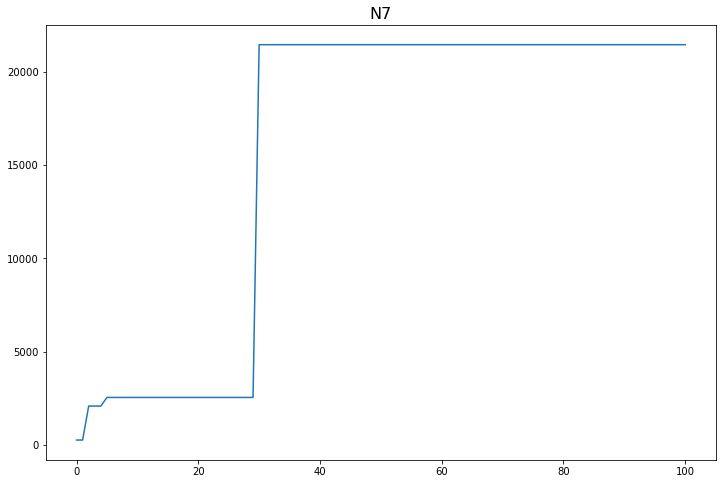

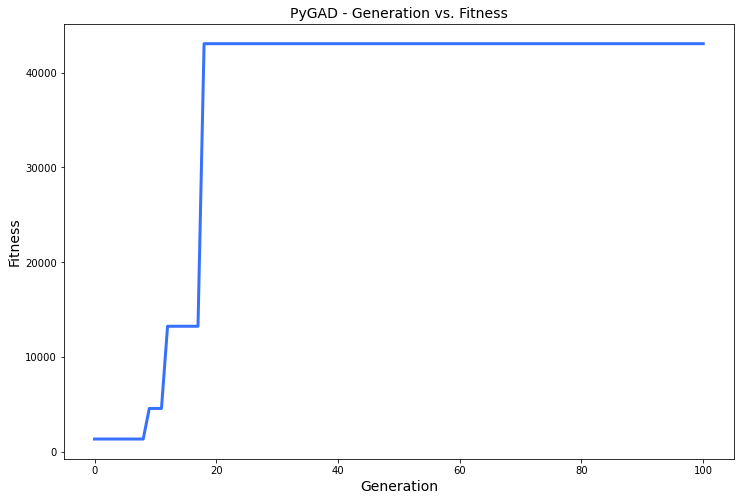

[-0.405]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 24.848 |==================| 44.342 |==========
[0.299]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 24.854 |==================| 60.1 |==========
[0.062]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 24.867 |==================| 292.222 |==========
[0.368]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 24.85 |==================| 48.888 |==========
[-0.268]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 24.855 |==================| 67.119 |==========
[-0.302]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 24.854 |==================| 59.494 |==========
[0.456]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 26.578 |==================| 26.416 |==========
[0.474]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 26.581 |==================| 24.335 |==========
[0.236]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 26.6 |==================| 16.815 |==========
[1.424]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.424 |===========| 26.507 |==================| 29.84 |==========
[1.699]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.699 |===========| 26.485 |==================| 18.027 |==========
[1.323]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.323 |===========| 26.515 |==================| 39.229 |==========
[0.347]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 26.592 |==================| 19.247 |==========
[1.602]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.602 |===========| 26.493 |==================| 20.966 |==========
[1.824]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.824 |===========| 26.475 |==================| 15.279 |==========
Fitness = 461.70769530080867
[1.424]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.424 |===========| 26.507 |==================| 29.84 |==========
[1.699]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.699 |===========| 26.485 |==================| 18.027 |==========
[1.323]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.323 |===========| 26.515 |==================| 39.229 |==========
[0.347]
=====|SOLUTION|===========|OUTPUT|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 26.592 |==================| 19.247 |==========
[1.602]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.602 |===========| 26.493 |==================| 20.966 |==========
[1.824]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.824 |===========| 26.475 |==================| 15.279 |==========
[1.424]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.424 |===========| 26.507 |==================| 29.84 |==========
[1.699]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.699 |===========| 26.485 |==================| 18.027 |==========
[1.323]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.323 |===========| 26.515 |==================| 39.229 |==========
[0.347]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.491 |===========| 26.501 |==================| 25.727 |==========
[1.118]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.118 |===========| 26.531 |==================| 107.811 |==========
Generation = 2
[0.763]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.763 |===========| 26.559 |==================| 53.73 |==========
[0.036]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 26.615 |==================| 13.366 |==========
[0.325]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 26.593 |==================| 19.02 |==========
[1.796]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.796 |===========| 26.477 |==================| 15.807 |==========
[1.909]
=====|SOLUTION|===========|OUTPUT|==================|FIT

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.698 |===========| 26.485 |==================| 18.048 |==========
[1.491]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.491 |===========| 26.501 |==================| 25.727 |==========
[1.118]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.118 |===========| 26.531 |==================| 107.811 |==========
Change = 0.0
[0.763]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.763 |===========| 26.559 |==================| 53.73 |==========
[0.036]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 26.615 |==================| 13.366 |==========
[0.325]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 26.593 |==================| 19.02 |==========
[1.796]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.698 |===========| 26.485 |==================| 18.048 |==========
[1.491]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.491 |===========| 26.501 |==================| 25.727 |==========
[1.118]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.118 |===========| 26.531 |==================| 107.811 |==========
[0.677]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.677 |===========| 26.566 |==================| 39.551 |==========
[1.594]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.594 |===========| 26.493 |==================| 21.236 |==========
[1.429]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.429 |===========| 26.506 |==================| 29.508 |==========
[1.714]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.546 |===========| 26.497 |==================| 23.134 |==========
[1.919]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.919 |===========| 26.467 |==================| 13.675 |==========
[1.03]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.03 |===========| 26.538 |==================| 418.376 |==========
[1.912]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.912 |===========| 26.468 |==================| 13.79 |==========
Fitness = 461.70769530080867
[0.677]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.677 |===========| 26.566 |==================| 39.551 |==========
[1.594]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.594 |===========| 26.493 |==================| 21.236 |==========
[1.429]
=====|SOLUTION|===========|OUTPUT|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.903 |===========| 26.469 |==================| 13.917 |==========
[1.546]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.546 |===========| 26.497 |==================| 23.134 |==========
[1.919]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.919 |===========| 26.467 |==================| 13.675 |==========
[1.03]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.03 |===========| 26.538 |==================| 418.376 |==========
[1.912]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.912 |===========| 26.468 |==================| 13.79 |==========
[0.677]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.677 |===========| 26.566 |==================| 39.551 |==========
[1.594]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.181 |===========| 26.526 |==================| 70.121 |==========
[1.712]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.712 |===========| 26.484 |==================| 17.707 |==========
[0.462]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 26.582 |==================| 23.805 |==========
[0.513]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.513 |===========| 26.578 |==================| 26.298 |==========
[0.009]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 26.617 |==================| 13.006 |==========
Generation = 4
[0.937]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.937 |===========| 26.545 |==================| 202.333 |==========
[0.349]
=====|SOLUTION|===========|OUTPUT|==================|F

[1.712]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.712 |===========| 26.484 |==================| 17.707 |==========
[0.462]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 26.582 |==================| 23.805 |==========
[0.513]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.513 |===========| 26.578 |==================| 26.298 |==========
[0.009]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 26.617 |==================| 13.006 |==========
Change = 0.0
[0.937]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.937 |===========| 26.545 |==================| 202.333 |==========
[0.349]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 26.591 |==================| 19.715 |==========
[1.496]
=====|SOLUTION|===========|OUTPUT|==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.712 |===========| 26.484 |==================| 17.707 |==========
[0.462]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 26.582 |==================| 23.805 |==========
[0.513]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.513 |===========| 26.578 |==================| 26.298 |==========
[0.009]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 26.617 |==================| 13.006 |==========
[0.187]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 26.604 |==================| 15.807 |==========
[0.799]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.799 |===========| 26.556 |==================| 63.309 |==========
[1.747]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.176 |===========| 26.526 |==================| 71.902 |==========
[0.239]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 26.6 |==================| 16.887 |==========
[1.234]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.234 |===========| 26.522 |==================| 54.214 |==========
Fitness = 461.70769530080867
[0.187]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 26.604 |==================| 15.807 |==========
[0.799]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.799 |===========| 26.556 |==================| 63.309 |==========
[1.747]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.747 |===========| 26.481 |==================| 16.865 |==========
[1.236]
=====|SOLUTION|===========|OUTPUT|=========

[1.176]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.176 |===========| 26.526 |==================| 71.902 |==========
[0.239]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 26.6 |==================| 16.887 |==========
[1.234]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.234 |===========| 26.522 |==================| 54.214 |==========
[0.187]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 26.604 |==================| 15.807 |==========
[0.799]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.799 |===========| 26.556 |==================| 63.309 |==========
[1.747]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.747 |===========| 26.481 |==================| 16.865 |==========
[1.236]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.857 |===========| 26.552 |==================| 89.357 |==========
[0.446]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 26.584 |==================| 23.122 |==========
[0.37]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 26.589 |==================| 20.358 |==========
Generation = 6
[1.946]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.946 |===========| 26.465 |==================| 13.284 |==========
[0.296]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 26.595 |==================| 18.248 |==========
[0.31]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 26.594 |==================| 18.598 |==========
[1.314]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 26.584 |==================| 23.122 |==========
[0.37]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 26.589 |==================| 20.358 |==========
Change = 192.89611577332033
[1.946]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.946 |===========| 26.465 |==================| 13.284 |==========
[0.296]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 26.595 |==================| 18.248 |==========
[0.31]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 26.594 |==================| 18.598 |==========
[1.314]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.314 |===========| 26.516 |==================| 40.319 |==========
[0.467]
=====|SOLUTION|===========|OUTPUT|============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 26.584 |==================| 23.122 |==========
[0.37]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 26.589 |==================| 20.358 |==========
[0.211]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 26.602 |==================| 16.295 |==========
[0.797]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.797 |===========| 26.556 |==================| 62.941 |==========
[1.003]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.003 |===========| 26.54 |==================| 3708.322 |==========
[1.468]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.468 |===========| 26.503 |==================| 27.01 |==========
[1.31]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.221 |===========| 26.523 |==================| 57.36 |==========
[0.151]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 26.606 |==================| 15.147 |==========
Fitness = 3708.3223239410545
[0.211]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 26.602 |==================| 16.295 |==========
[0.797]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.797 |===========| 26.556 |==================| 62.941 |==========
[1.003]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.003 |===========| 26.54 |==================| 3708.322 |==========
[1.468]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.468 |===========| 26.503 |==================| 27.01 |==========
[1.31]
=====|SOLUTION|===========|OUTPUT|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.221 |===========| 26.523 |==================| 57.36 |==========
[0.151]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 26.606 |==================| 15.147 |==========
[0.211]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 26.602 |==================| 16.295 |==========
[0.797]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.797 |===========| 26.556 |==================| 62.941 |==========
[1.003]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.003 |===========| 26.54 |==================| 3708.322 |==========
[1.468]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.468 |===========| 26.503 |==================| 27.01 |==========
[1.31]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.739 |===========| 26.561 |==================| 48.941 |==========
[1.424]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.424 |===========| 26.507 |==================| 29.845 |==========
Generation = 8
[1.85]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.85 |===========| 26.473 |==================| 14.794 |==========
[1.792]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.792 |===========| 26.477 |==================| 15.894 |==========
[1.25]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.25 |===========| 26.521 |==================| 50.615 |==========
[0.83]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 26.554 |==================| 75.05 |==========
[0.2]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.739 |===========| 26.561 |==================| 48.941 |==========
[1.424]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.424 |===========| 26.507 |==================| 29.845 |==========
Change = -9.771156328497455e-08
[1.85]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.85 |===========| 26.473 |==================| 14.794 |==========
[1.792]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.792 |===========| 26.477 |==================| 15.894 |==========
[1.25]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.25 |===========| 26.521 |==================| 50.615 |==========
[0.83]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 26.554 |==================| 75.05 |==========
[0.2]
=====|SOLUTION|===========|OUTPUT|=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.739 |===========| 26.561 |==================| 48.941 |==========
[1.424]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.424 |===========| 26.507 |==================| 29.845 |==========
[1.064]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.064 |===========| 26.535 |==================| 199.808 |==========
[1.804]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.804 |===========| 26.476 |==================| 15.657 |==========
[0.322]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 26.593 |==================| 18.922 |==========
[0.775]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 26.558 |==================| 56.65 |==========
[0.51]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.219 |===========| 26.523 |==================| 57.817 |==========
[0.743]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 26.56 |==================| 49.734 |==========
Fitness = 3708.322323843343
[1.064]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.064 |===========| 26.535 |==================| 199.808 |==========
[1.804]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.804 |===========| 26.476 |==================| 15.657 |==========
[0.322]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 26.593 |==================| 18.922 |==========
[0.775]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 26.558 |==================| 56.65 |==========
[0.51]
=====|SOLUTION|===========|OUTPUT|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 26.56 |==================| 49.734 |==========
[1.064]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.064 |===========| 26.535 |==================| 199.808 |==========
[1.804]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.804 |===========| 26.476 |==================| 15.657 |==========
[0.322]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 26.593 |==================| 18.922 |==========
[0.775]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 26.558 |==================| 56.65 |==========
[0.51]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 26.579 |==================| 26.12 |==========
[0.728]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.576 |===========| 26.574 |==================| 30.161 |==========
[1.077]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.077 |===========| 26.534 |==================| 165.414 |==========
[1.427]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.427 |===========| 26.507 |==================| 29.637 |==========
[1.536]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.536 |===========| 26.498 |==================| 23.546 |==========
[1.145]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.145 |===========| 26.529 |==================| 87.645 |==========
[1.29]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.29 |===========| 26.517 |==================| 43.706 |==========
[0.192]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

[0.576]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.576 |===========| 26.574 |==================| 30.161 |==========
[1.077]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.077 |===========| 26.534 |==================| 165.414 |==========
[1.427]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.427 |===========| 26.507 |==================| 29.637 |==========
[1.536]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.536 |===========| 26.498 |==================| 23.546 |==========
[1.145]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.145 |===========| 26.529 |==================| 87.645 |==========
[1.29]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.29 |===========| 26.517 |==================| 43.706 |==========
[0.192]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.807 |===========| 26.476 |==================| 15.59 |==========
[1.909]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.909 |===========| 26.468 |==================| 13.831 |==========
[1.91]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.91 |===========| 26.468 |==================| 13.81 |==========
[1.022]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.022 |===========| 26.539 |==================| 566.157 |==========
[1.581]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.581 |===========| 26.494 |==================| 21.736 |==========
[0.017]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 26.617 |==================| 13.111 |==========
[0.254]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.366 |===========| 26.511 |==================| 34.543 |==========
Fitness = 3708.322323843343
[1.909]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.909 |===========| 26.468 |==================| 13.831 |==========
[1.91]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.91 |===========| 26.468 |==================| 13.81 |==========
[1.022]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.022 |===========| 26.539 |==================| 566.157 |==========
[1.581]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.581 |===========| 26.494 |==================| 21.736 |==========
[0.017]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 26.617 |==================| 13.111 |==========
[0.254]
=====|SOLUTION|===========|OUTPUT|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.503 |===========| 26.579 |==================| 25.774 |==========
[1.366]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.366 |===========| 26.511 |==================| 34.543 |==========
[1.909]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.909 |===========| 26.468 |==================| 13.831 |==========
[1.91]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.91 |===========| 26.468 |==================| 13.81 |==========
[1.022]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.022 |===========| 26.539 |==================| 566.157 |==========
[1.581]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.581 |===========| 26.494 |==================| 21.736 |==========
[0.017]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.697 |===========| 26.485 |==================| 18.078 |==========
[0.065]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 26.613 |==================| 13.772 |==========
[0.799]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.799 |===========| 26.556 |==================| 63.602 |==========
Generation = 12
[1.612]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.612 |===========| 26.492 |==================| 20.622 |==========
[1.082]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.082 |===========| 26.534 |==================| 154.834 |==========
[1.226]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.226 |===========| 26.523 |==================| 56.127 |==========
[0.82]
=====|SOLUTION|===========|OUTPUT|==================|F

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.697 |===========| 26.485 |==================| 18.078 |==========
[0.065]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 26.613 |==================| 13.772 |==========
[0.799]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.799 |===========| 26.556 |==================| 63.602 |==========
Change = 0.0
[1.612]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.612 |===========| 26.492 |==================| 20.622 |==========
[1.082]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.082 |===========| 26.534 |==================| 154.834 |==========
[1.226]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.226 |===========| 26.523 |==================| 56.127 |==========
[0.82]
=====|SOLUTION|===========|OUTPUT|==================|FITN

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 26.613 |==================| 13.772 |==========
[0.799]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.799 |===========| 26.556 |==================| 63.602 |==========
[0.271]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.271 |===========| 26.597 |==================| 17.622 |==========
[0.431]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 26.585 |==================| 22.525 |==========
[1.514]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.514 |===========| 26.5 |==================| 24.597 |==========
[1.002]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.002 |===========| 26.54 |==================| 6139.84 |==========
[0.01]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.772 |===========| 26.558 |==================| 56.06 |==========
[1.067]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.067 |===========| 26.535 |==================| 189.426 |==========
[1.401]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.401 |===========| 26.509 |==================| 31.561 |==========
Fitness = 6139.839860047507
[0.271]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.271 |===========| 26.597 |==================| 17.622 |==========
[0.431]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 26.585 |==================| 22.525 |==========
[1.514]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.514 |===========| 26.5 |==================| 24.597 |==========
[1.002]
=====|SOLUTION|===========|OUTPUT|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.535 |===========| 26.577 |==================| 27.495 |==========
[0.772]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.772 |===========| 26.558 |==================| 56.06 |==========
[1.067]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.067 |===========| 26.535 |==================| 189.426 |==========
[1.401]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.401 |===========| 26.509 |==================| 31.561 |==========
[0.271]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.271 |===========| 26.597 |==================| 17.622 |==========
[0.431]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 26.585 |==================| 22.525 |==========
[1.514]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.128 |===========| 26.53 |==================| 99.203 |==========
[0.223]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 26.601 |==================| 16.529 |==========
[0.039]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 26.615 |==================| 13.402 |==========
[1.748]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.748 |===========| 26.481 |==================| 16.851 |==========
[1.937]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.937 |===========| 26.466 |==================| 13.406 |==========
Generation = 14
[0.633]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.633 |===========| 26.569 |==================| 34.815 |==========
[0.103]
=====|SOLUTION|===========|OUTPUT|==================|FI

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.836 |===========| 26.553 |==================| 77.515 |==========
[1.128]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.128 |===========| 26.53 |==================| 99.203 |==========
[0.223]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 26.601 |==================| 16.529 |==========
[0.039]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 26.615 |==================| 13.402 |==========
[1.748]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.748 |===========| 26.481 |==================| 16.851 |==========
[1.937]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.937 |===========| 26.466 |==================| 13.406 |==========
Change = 0.0
[0.633]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.836 |===========| 26.553 |==================| 77.515 |==========
[1.128]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.128 |===========| 26.53 |==================| 99.203 |==========
[0.223]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 26.601 |==================| 16.529 |==========
[0.039]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 26.615 |==================| 13.402 |==========
[1.748]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.748 |===========| 26.481 |==================| 16.851 |==========
[1.937]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.937 |===========| 26.466 |==================| 13.406 |==========
[0.924]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 26.584 |==================| 22.992 |==========
[0.003]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 26.618 |==================| 12.928 |==========
[1.684]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.684 |===========| 26.486 |==================| 18.438 |==========
[0.14]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 26.607 |==================| 14.951 |==========
[1.616]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.616 |===========| 26.492 |==================| 20.492 |==========
[1.808]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.808 |===========| 26.476 |==================| 15.579 |==========
Fitness = 6139.839860047507
[0.924]
=====|SOLUTION|===========|OUTPUT|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.953 |===========| 26.465 |==================| 13.188 |==========
[0.443]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 26.584 |==================| 22.992 |==========
[0.003]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 26.618 |==================| 12.928 |==========
[1.684]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.684 |===========| 26.486 |==================| 18.438 |==========
[0.14]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 26.607 |==================| 14.951 |==========
[1.616]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.616 |===========| 26.492 |==================| 20.492 |==========
[1.808]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 26.616 |==================| 13.26 |==========
[1.436]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.436 |===========| 26.506 |==================| 29.013 |==========
[0.398]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 26.587 |==================| 21.284 |==========
[0.34]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 26.592 |==================| 19.443 |==========
[1.721]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.721 |===========| 26.483 |==================| 17.483 |==========
[0.444]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 26.584 |==================| 23.063 |==========
Generation = 16
[0.667]
=====|SOLUTION|===========|OUTPUT|==================|FITN

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.436 |===========| 26.506 |==================| 29.013 |==========
[0.398]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 26.587 |==================| 21.284 |==========
[0.34]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 26.592 |==================| 19.443 |==========
[1.721]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.721 |===========| 26.483 |==================| 17.483 |==========
[0.444]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 26.584 |==================| 23.063 |==========
Change = 0.0
[0.667]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.667 |===========| 26.566 |==================| 38.375 |==========
[0.737]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 26.616 |==================| 13.26 |==========
[1.436]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.436 |===========| 26.506 |==================| 29.013 |==========
[0.398]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 26.587 |==================| 21.284 |==========
[0.34]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 26.592 |==================| 19.443 |==========
[1.721]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.721 |===========| 26.483 |==================| 17.483 |==========
[0.444]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 26.584 |==================| 23.063 |==========
[0.314]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.513 |===========| 26.578 |==================| 26.294 |==========
[1.929]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.929 |===========| 26.466 |==================| 13.529 |==========
[0.381]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 26.589 |==================| 20.729 |==========
[0.411]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 26.586 |==================| 21.782 |==========
[1.328]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.328 |===========| 26.514 |==================| 38.56 |==========
[1.725]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.725 |===========| 26.483 |==================| 17.375 |==========
Fitness = 6139.839860047507
[0.314]
=====|SOLUTION|===========|OUTPUT|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.513 |===========| 26.578 |==================| 26.294 |==========
[1.929]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.929 |===========| 26.466 |==================| 13.529 |==========
[0.381]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 26.589 |==================| 20.729 |==========
[0.411]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 26.586 |==================| 21.782 |==========
[1.328]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.328 |===========| 26.514 |==================| 38.56 |==========
[1.725]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.725 |===========| 26.483 |==================| 17.375 |==========
[0.314]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.944 |===========| 26.465 |==================| 13.309 |==========
[1.424]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.424 |===========| 26.507 |==================| 29.824 |==========
[0.786]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.786 |===========| 26.557 |==================| 59.486 |==========
[1.746]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.746 |===========| 26.481 |==================| 16.884 |==========
[0.272]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 26.597 |==================| 17.642 |==========
Generation = 18
[0.657]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.657 |===========| 26.567 |==================| 37.278 |==========
[0.953]
=====|SOLUTION|===========|OUTPUT|==================|F

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.944 |===========| 26.465 |==================| 13.309 |==========
[1.424]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.424 |===========| 26.507 |==================| 29.824 |==========
[0.786]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.786 |===========| 26.557 |==================| 59.486 |==========
[1.746]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.746 |===========| 26.481 |==================| 16.884 |==========
[0.272]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 26.597 |==================| 17.642 |==========
Change = 0.0
[0.657]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.657 |===========| 26.567 |==================| 37.278 |==========
[0.953]
=====|SOLUTION|===========|OUTPUT|==================|FITN

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.208 |===========| 26.524 |==================| 60.88 |==========
[1.944]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.944 |===========| 26.465 |==================| 13.309 |==========
[1.424]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.424 |===========| 26.507 |==================| 29.824 |==========
[0.786]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.786 |===========| 26.557 |==================| 59.486 |==========
[1.746]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.746 |===========| 26.481 |==================| 16.884 |==========
[0.272]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 26.597 |==================| 17.642 |==========
[0.92]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.922 |===========| 26.546 |==================| 163.709 |==========
[0.958]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.958 |===========| 26.544 |==================| 303.973 |==========
[1.661]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.661 |===========| 26.488 |==================| 19.073 |==========
[0.38]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 26.589 |==================| 20.67 |==========
[0.11]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 26.609 |==================| 14.468 |==========
[1.02]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.02 |===========| 26.539 |==================| 637.866 |==========
[1.557]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.44 |===========| 26.506 |==================| 28.718 |==========
[0.922]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.922 |===========| 26.546 |==================| 163.709 |==========
[0.958]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.958 |===========| 26.544 |==================| 303.973 |==========
[1.661]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.661 |===========| 26.488 |==================| 19.073 |==========
[0.38]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 26.589 |==================| 20.67 |==========
[0.11]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 26.609 |==================| 14.468 |==========
[1.02]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.74 |===========| 26.561 |==================| 49.053 |==========
[1.623]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.623 |===========| 26.491 |==================| 20.266 |==========
[1.141]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.141 |===========| 26.529 |==================| 90.227 |==========
[1.201]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.201 |===========| 26.525 |==================| 63.124 |==========
[1.999]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.999 |===========| 26.461 |==================| 12.564 |==========
[0.41]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 26.586 |==================| 21.743 |==========
[0.821]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 26.61 |==================| 14.258 |==========
[0.74]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.74 |===========| 26.561 |==================| 49.053 |==========
[1.623]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.623 |===========| 26.491 |==================| 20.266 |==========
[1.141]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.141 |===========| 26.529 |==================| 90.227 |==========
[1.201]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.201 |===========| 26.525 |==================| 63.124 |==========
[1.999]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.999 |===========| 26.461 |==================| 12.564 |==========
[0.41]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 26.61 |==================| 14.258 |==========
[0.74]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.74 |===========| 26.561 |==================| 49.053 |==========
[1.623]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.623 |===========| 26.491 |==================| 20.266 |==========
[1.141]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.141 |===========| 26.529 |==================| 90.227 |==========
[1.201]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.201 |===========| 26.525 |==================| 63.124 |==========
[1.999]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.999 |===========| 26.461 |==================| 12.564 |==========
[0.41]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.532 |===========| 26.577 |==================| 27.366 |==========
[0.252]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 26.599 |==================| 17.171 |==========
[0.525]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.525 |===========| 26.577 |==================| 26.964 |==========
[0.678]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.678 |===========| 26.566 |==================| 39.645 |==========
[0.873]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 26.55 |==================| 100.293 |==========
[0.452]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 26.583 |==================| 23.379 |==========
[1.424]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.532 |===========| 26.577 |==================| 27.366 |==========
[0.252]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 26.599 |==================| 17.171 |==========
[0.525]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.525 |===========| 26.577 |==================| 26.964 |==========
[0.678]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.678 |===========| 26.566 |==================| 39.645 |==========
[0.873]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 26.55 |==================| 100.293 |==========
[0.452]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 26.583 |==================| 23.379 |==========
[1.424]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 26.605 |==================| 15.358 |==========
[0.463]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 26.582 |==================| 23.856 |==========
[0.044]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 26.615 |==================| 13.47 |==========
[1.564]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.564 |===========| 26.496 |==================| 22.369 |==========
[0.346]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 26.591 |==================| 19.61 |==========
[0.015]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 26.617 |==================| 13.078 |==========
[1.681]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.369 |===========| 26.511 |==================| 34.266 |==========
[0.163]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 26.605 |==================| 15.358 |==========
[0.463]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 26.582 |==================| 23.856 |==========
[0.044]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 26.615 |==================| 13.47 |==========
[1.564]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.564 |===========| 26.496 |==================| 22.369 |==========
[0.346]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 26.591 |==================| 19.61 |==========
[0.015]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.913 |===========| 26.468 |==================| 13.772 |==========
[1.369]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.369 |===========| 26.511 |==================| 34.266 |==========
[0.163]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 26.605 |==================| 15.358 |==========
[0.463]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 26.582 |==================| 23.856 |==========
[0.044]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 26.615 |==================| 13.47 |==========
[1.564]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.564 |===========| 26.496 |==================| 22.369 |==========
[0.346]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.914 |===========| 26.547 |==================| 147.431 |==========
[0.26]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 26.598 |==================| 17.366 |==========
[1.666]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.666 |===========| 26.488 |==================| 18.948 |==========
[1.195]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.195 |===========| 26.525 |==================| 65.005 |==========
[1.533]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.533 |===========| 26.498 |==================| 23.687 |==========
[1.534]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.534 |===========| 26.498 |==================| 23.669 |==========
[1.816]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.74 |===========| 26.482 |==================| 17.03 |==========
[0.914]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.914 |===========| 26.547 |==================| 147.431 |==========
[0.26]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 26.598 |==================| 17.366 |==========
[1.666]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.666 |===========| 26.488 |==================| 18.948 |==========
[1.195]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.195 |===========| 26.525 |==================| 65.005 |==========
[1.533]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.533 |===========| 26.498 |==================| 23.687 |==========
[1.534]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.466 |===========| 26.503 |==================| 27.128 |==========
[0.256]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 26.598 |==================| 17.255 |==========
[1.798]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.798 |===========| 26.477 |==================| 15.777 |==========
[0.479]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 26.581 |==================| 24.596 |==========
[1.517]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.517 |===========| 26.499 |==================| 24.452 |==========
[0.405]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 26.587 |==================| 21.538 |==========
[1.539]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.6 |===========| 26.572 |==================| 31.939 |==========
[1.466]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.466 |===========| 26.503 |==================| 27.128 |==========
[0.256]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 26.598 |==================| 17.255 |==========
[1.798]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.798 |===========| 26.477 |==================| 15.777 |==========
[0.479]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 26.581 |==================| 24.596 |==========
[1.517]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.517 |===========| 26.499 |==================| 24.452 |==========
[0.405]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 2.0 |===========| 26.461 |==================| 12.562 |==========
[0.6]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.6 |===========| 26.572 |==================| 31.939 |==========
[1.466]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.466 |===========| 26.503 |==================| 27.128 |==========
[0.256]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 26.598 |==================| 17.255 |==========
[1.798]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.798 |===========| 26.477 |==================| 15.777 |==========
[0.479]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 26.581 |==================| 24.596 |==========
[1.517]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 26.58 |==================| 24.999 |==========
[0.493]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.493 |===========| 26.58 |==================| 25.255 |==========
[0.237]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 26.6 |==================| 16.831 |==========
[1.286]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.286 |===========| 26.518 |==================| 44.374 |==========
[0.865]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 26.551 |==================| 94.34 |==========
[1.907]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.907 |===========| 26.468 |==================| 13.861 |==========
[1.697]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.736 |===========| 26.561 |==================| 48.348 |==========
[0.488]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 26.58 |==================| 24.999 |==========
[0.493]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.493 |===========| 26.58 |==================| 25.255 |==========
[0.237]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 26.6 |==================| 16.831 |==========
[1.286]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.286 |===========| 26.518 |==================| 44.374 |==========
[0.865]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 26.551 |==================| 94.34 |==========
[1.907]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.409 |===========| 26.508 |==================| 30.917 |==========
[0.69]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 26.565 |==================| 41.238 |==========
[0.828]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.828 |===========| 26.554 |==================| 73.934 |==========
[1.797]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.797 |===========| 26.477 |==================| 15.8 |==========
[0.01]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 26.617 |==================| 13.012 |==========
[1.731]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.731 |===========| 26.482 |==================| 17.247 |==========
[1.]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 26.605 |==================| 15.415 |==========
[1.409]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.409 |===========| 26.508 |==================| 30.917 |==========
[0.69]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 26.565 |==================| 41.238 |==========
[0.828]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.828 |===========| 26.554 |==================| 73.934 |==========
[1.797]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.797 |===========| 26.477 |==================| 15.8 |==========
[0.01]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 26.617 |==================| 13.012 |==========
[1.731]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 26.605 |==================| 15.415 |==========
[1.409]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.409 |===========| 26.508 |==================| 30.917 |==========
[0.69]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 26.565 |==================| 41.238 |==========
[0.828]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.828 |===========| 26.554 |==================| 73.934 |==========
[1.797]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.797 |===========| 26.477 |==================| 15.8 |==========
[0.01]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 26.617 |==================| 13.012 |==========
[1.731]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.919 |===========| 26.467 |==================| 13.671 |==========
[1.94]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.94 |===========| 26.466 |==================| 13.372 |==========
[1.087]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.087 |===========| 26.534 |==================| 146.182 |==========
[0.915]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.915 |===========| 26.547 |==================| 150.462 |==========
[0.1]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 26.61 |==================| 14.296 |==========
[1.413]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.413 |===========| 26.508 |==================| 30.663 |==========
[0.492]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.924 |===========| 26.467 |==================| 13.602 |==========
[1.919]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.919 |===========| 26.467 |==================| 13.671 |==========
[1.94]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.94 |===========| 26.466 |==================| 13.372 |==========
[1.087]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.087 |===========| 26.534 |==================| 146.182 |==========
[0.915]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.915 |===========| 26.547 |==================| 150.462 |==========
[0.1]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 26.61 |==================| 14.296 |==========
[1.413]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.333 |===========| 26.514 |==================| 38.085 |==========
[0.475]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 26.581 |==================| 24.398 |==========
[0.756]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.756 |===========| 26.559 |==================| 52.243 |==========
[1.37]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.37 |===========| 26.511 |==================| 34.228 |==========
[1.53]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.53 |===========| 26.498 |==================| 23.836 |==========
[0.518]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.518 |===========| 26.578 |==================| 26.574 |==========
[0.653]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

[1.767]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.767 |===========| 26.479 |==================| 16.412 |==========
Fitness = 32298.05787957527
[1.333]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.333 |===========| 26.514 |==================| 38.085 |==========
[0.475]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 26.581 |==================| 24.398 |==========
[0.756]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.756 |===========| 26.559 |==================| 52.243 |==========
[1.37]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.37 |===========| 26.511 |==================| 34.228 |==========
[1.53]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.53 |===========| 26.498 |==================| 23.836 |==========
[0.518]
=====|SOLUTION|===========|OUTPUT|====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.289 |===========| 26.518 |==================| 43.845 |==========
[1.767]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.767 |===========| 26.479 |==================| 16.412 |==========
[1.333]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.333 |===========| 26.514 |==================| 38.085 |==========
[0.475]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 26.581 |==================| 24.398 |==========
[0.756]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.756 |===========| 26.559 |==================| 52.243 |==========
[1.37]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.37 |===========| 26.511 |==================| 34.228 |==========
[1.53]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.797 |===========| 26.556 |==================| 62.946 |==========
[0.72]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.72 |===========| 26.562 |==================| 45.642 |==========
Generation = 29
[0.887]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.887 |===========| 26.549 |==================| 112.392 |==========
[0.018]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 26.617 |==================| 13.126 |==========
[1.865]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.865 |===========| 26.472 |==================| 14.541 |==========
[0.649]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.649 |===========| 26.568 |==================| 36.455 |==========
[1.281]
=====|SOLUTION|===========|OUTPUT|==================|FI

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.797 |===========| 26.556 |==================| 62.946 |==========
[0.72]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.72 |===========| 26.562 |==================| 45.642 |==========
Change = 0.0
[0.887]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.887 |===========| 26.549 |==================| 112.392 |==========
[0.018]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 26.617 |==================| 13.126 |==========
[1.865]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.865 |===========| 26.472 |==================| 14.541 |==========
[0.649]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.649 |===========| 26.568 |==================| 36.455 |==========
[1.281]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 26.606 |==================| 15.228 |==========
[0.797]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.797 |===========| 26.556 |==================| 62.946 |==========
[0.72]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.72 |===========| 26.562 |==================| 45.642 |==========
[0.428]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 26.585 |==================| 22.421 |==========
[0.413]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 26.586 |==================| 21.853 |==========
[0.358]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 26.59 |==================| 19.975 |==========
[1.789]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.631 |===========| 26.569 |==================| 34.649 |==========
[0.662]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.662 |===========| 26.567 |==================| 37.834 |==========
[1.803]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.803 |===========| 26.477 |==================| 15.672 |==========
Fitness = 32298.05787957527
[0.428]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 26.585 |==================| 22.421 |==========
[0.413]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 26.586 |==================| 21.853 |==========
[0.358]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 26.59 |==================| 19.975 |==========
[1.789]
=====|SOLUTION|===========|OUTPUT|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.631 |===========| 26.569 |==================| 34.649 |==========
[0.662]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.662 |===========| 26.567 |==================| 37.834 |==========
[1.803]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.803 |===========| 26.477 |==================| 15.672 |==========
[0.428]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 26.585 |==================| 22.421 |==========
[0.413]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 26.586 |==================| 21.853 |==========
[0.358]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 26.59 |==================| 19.975 |==========
[1.789]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 26.578 |==================| 26.454 |==========
[0.013]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 26.617 |==================| 13.062 |==========
[1.596]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.596 |===========| 26.493 |==================| 21.168 |==========
Generation = 31
[1.768]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.768 |===========| 26.479 |==================| 16.403 |==========
[1.227]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.227 |===========| 26.522 |==================| 55.793 |==========
[1.172]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.172 |===========| 26.527 |==================| 73.833 |==========
[0.487]
=====|SOLUTION|===========|OUTPUT|==================|F

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.659 |===========| 26.488 |==================| 19.125 |==========
[0.516]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 26.578 |==================| 26.454 |==========
[0.013]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 26.617 |==================| 13.062 |==========
[1.596]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.596 |===========| 26.493 |==================| 21.168 |==========
Change = 0.0
[1.768]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.768 |===========| 26.479 |==================| 16.403 |==========
[1.227]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.227 |===========| 26.522 |==================| 55.793 |==========
[1.172]
=====|SOLUTION|===========|OUTPUT|==================|FITN

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.659 |===========| 26.488 |==================| 19.125 |==========
[0.516]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 26.578 |==================| 26.454 |==========
[0.013]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 26.617 |==================| 13.062 |==========
[1.596]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.596 |===========| 26.493 |==================| 21.168 |==========
[1.357]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.357 |===========| 26.512 |==================| 35.502 |==========
[0.042]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.042 |===========| 26.615 |==================| 13.452 |==========
[0.082]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.677 |===========| 26.487 |==================| 18.634 |==========
[1.435]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.435 |===========| 26.506 |==================| 29.073 |==========
[1.206]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.206 |===========| 26.524 |==================| 61.574 |==========
[1.063]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.063 |===========| 26.535 |==================| 202.751 |==========
Fitness = 32298.05787957527
[1.357]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.357 |===========| 26.512 |==================| 35.502 |==========
[0.042]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.042 |===========| 26.615 |==================| 13.452 |==========
[0.082]
=====|SOLUTION|===========|OUTPUT|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.598 |===========| 26.572 |==================| 31.78 |==========
[1.677]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.677 |===========| 26.487 |==================| 18.634 |==========
[1.435]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.435 |===========| 26.506 |==================| 29.073 |==========
[1.206]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.206 |===========| 26.524 |==================| 61.574 |==========
[1.063]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.063 |===========| 26.535 |==================| 202.751 |==========
[1.357]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.357 |===========| 26.512 |==================| 35.502 |==========
[0.042]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.94 |===========| 26.545 |==================| 213.195 |==========
[0.885]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.885 |===========| 26.549 |==================| 110.932 |==========
[1.09]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.09 |===========| 26.533 |==================| 141.151 |==========
[1.035]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.035 |===========| 26.538 |==================| 358.525 |==========
[0.159]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 26.606 |==================| 15.293 |==========
[1.135]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.135 |===========| 26.53 |==================| 94.236 |==========
Generation = 33
[0.128]
=====|SOLUTION|===========|OUTPUT|==================|F

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.885 |===========| 26.549 |==================| 110.932 |==========
[1.09]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.09 |===========| 26.533 |==================| 141.151 |==========
[1.035]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.035 |===========| 26.538 |==================| 358.525 |==========
[0.159]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 26.606 |==================| 15.293 |==========
[1.135]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.135 |===========| 26.53 |==================| 94.236 |==========
Change = 0.0
[0.128]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 26.608 |==================| 14.755 |==========
[1.768]
=====|SOLUTION|===========|OUTPUT|==================|FITN

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.94 |===========| 26.545 |==================| 213.195 |==========
[0.885]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.885 |===========| 26.549 |==================| 110.932 |==========
[1.09]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.09 |===========| 26.533 |==================| 141.151 |==========
[1.035]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.035 |===========| 26.538 |==================| 358.525 |==========
[0.159]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 26.606 |==================| 15.293 |==========
[1.135]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.135 |===========| 26.53 |==================| 94.236 |==========
[1.535]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.989 |===========| 26.541 |==================| 1162.008 |==========
[1.292]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.292 |===========| 26.517 |==================| 43.365 |==========
[1.242]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.242 |===========| 26.521 |==================| 52.459 |==========
[0.579]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 26.573 |==================| 30.352 |==========
[0.575]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 26.574 |==================| 30.077 |==========
[1.763]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.763 |===========| 26.48 |==================| 16.504 |==========
Fitness = 32298.05787957527
[1.535]
=====|SOLUTION|===========|OUTPUT|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.989 |===========| 26.541 |==================| 1162.008 |==========
[1.292]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.292 |===========| 26.517 |==================| 43.365 |==========
[1.242]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.242 |===========| 26.521 |==================| 52.459 |==========
[0.579]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 26.573 |==================| 30.352 |==========
[0.575]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 26.574 |==================| 30.077 |==========
[1.763]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.763 |===========| 26.48 |==================| 16.504 |==========
[1.535]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.977 |===========| 26.542 |==================| 555.439 |==========
[1.723]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.723 |===========| 26.483 |==================| 17.432 |==========
[0.63]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.63 |===========| 26.569 |==================| 34.519 |==========
[0.285]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.285 |===========| 26.596 |==================| 17.962 |==========
[1.541]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.541 |===========| 26.498 |==================| 23.35 |==========
Generation = 35
[1.644]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.644 |===========| 26.489 |==================| 19.579 |==========
[1.805]
=====|SOLUTION|===========|OUTPUT|==================|FIT

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.185 |===========| 26.526 |==================| 68.432 |==========
[0.977]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.977 |===========| 26.542 |==================| 555.439 |==========
[1.723]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.723 |===========| 26.483 |==================| 17.432 |==========
[0.63]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.63 |===========| 26.569 |==================| 34.519 |==========
[0.285]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.285 |===========| 26.596 |==================| 17.962 |==========
[1.541]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.541 |===========| 26.498 |==================| 23.35 |==========
Change = 0.0
[1.644]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.185 |===========| 26.526 |==================| 68.432 |==========
[0.977]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.977 |===========| 26.542 |==================| 555.439 |==========
[1.723]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.723 |===========| 26.483 |==================| 17.432 |==========
[0.63]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.63 |===========| 26.569 |==================| 34.519 |==========
[0.285]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.285 |===========| 26.596 |==================| 17.962 |==========
[1.541]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.541 |===========| 26.498 |==================| 23.35 |==========
[0.757]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 26.607 |==================| 14.931 |==========
[0.689]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.689 |===========| 26.565 |==================| 41.039 |==========
[0.878]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.878 |===========| 26.55 |==================| 104.498 |==========
[1.654]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.654 |===========| 26.489 |==================| 19.296 |==========
[1.801]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.801 |===========| 26.477 |==================| 15.711 |==========
Fitness = 32298.05787957527
[0.757]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.757 |===========| 26.559 |==================| 52.576 |==========
[1.738]
=====|SOLUTION|===========|OUTPUT|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.689 |===========| 26.565 |==================| 41.039 |==========
[0.878]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.878 |===========| 26.55 |==================| 104.498 |==========
[1.654]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.654 |===========| 26.489 |==================| 19.296 |==========
[1.801]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.801 |===========| 26.477 |==================| 15.711 |==========
[0.757]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.757 |===========| 26.559 |==================| 52.576 |==========
[1.738]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.738 |===========| 26.482 |==================| 17.068 |==========
[0.445]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 26.609 |==================| 14.636 |==========
[1.939]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.939 |===========| 26.466 |==================| 13.381 |==========
[1.607]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.607 |===========| 26.492 |==================| 20.789 |==========
Generation = 37
[1.587]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.587 |===========| 26.494 |==================| 21.497 |==========
[0.87]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.87 |===========| 26.551 |==================| 97.857 |==========
[1.005]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.005 |===========| 26.54 |==================| 2591.336 |==========
[0.663]
=====|SOLUTION|===========|OUTPUT|==================|FI

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 26.609 |==================| 14.636 |==========
[1.939]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.939 |===========| 26.466 |==================| 13.381 |==========
[1.607]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.607 |===========| 26.492 |==================| 20.789 |==========
Change = 0.0
[1.587]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.587 |===========| 26.494 |==================| 21.497 |==========
[0.87]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.87 |===========| 26.551 |==================| 97.857 |==========
[1.005]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.005 |===========| 26.54 |==================| 2591.336 |==========
[0.663]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.513 |===========| 26.578 |==================| 26.281 |==========
[0.121]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 26.609 |==================| 14.636 |==========
[1.939]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.939 |===========| 26.466 |==================| 13.381 |==========
[1.607]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.607 |===========| 26.492 |==================| 20.789 |==========
[1.779]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.779 |===========| 26.479 |==================| 16.17 |==========
[1.827]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.827 |===========| 26.475 |==================| 15.219 |==========
[1.901]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.57 |===========| 26.574 |==================| 29.715 |==========
[0.589]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 26.572 |==================| 31.121 |==========
[1.37]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.37 |===========| 26.511 |==================| 34.212 |==========
[1.749]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.749 |===========| 26.481 |==================| 16.816 |==========
Fitness = 32298.05787957527
[1.779]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.779 |===========| 26.479 |==================| 16.17 |==========
[1.827]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.827 |===========| 26.475 |==================| 15.219 |==========
[1.901]
=====|SOLUTION|===========|OUTPUT|============

[1.03]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.03 |===========| 26.538 |==================| 426.271 |==========
[0.57]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.57 |===========| 26.574 |==================| 29.715 |==========
[0.589]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 26.572 |==================| 31.121 |==========
[1.37]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.37 |===========| 26.511 |==================| 34.212 |==========
[1.749]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.749 |===========| 26.481 |==================| 16.816 |==========
[1.779]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.779 |===========| 26.479 |==================| 16.17 |==========
[1.827]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.585 |===========| 26.494 |==================| 21.587 |==========
[0.002]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 26.618 |==================| 12.913 |==========
[0.126]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 26.608 |==================| 14.725 |==========
[0.095]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 26.611 |==================| 14.23 |==========
[0.677]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.677 |===========| 26.566 |==================| 39.487 |==========
[0.125]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 26.608 |==================| 14.708 |==========
Generation = 39
[1.972]
=====|SOLUTION|===========|OUTPUT|==================|FI

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.933 |===========| 26.546 |==================| 190.565 |==========
[1.585]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.585 |===========| 26.494 |==================| 21.587 |==========
[0.002]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 26.618 |==================| 12.913 |==========
[0.126]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 26.608 |==================| 14.725 |==========
[0.095]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 26.611 |==================| 14.23 |==========
[0.677]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.677 |===========| 26.566 |==================| 39.487 |==========
[0.125]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.568 |===========| 26.574 |==================| 29.643 |==========
[0.933]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.933 |===========| 26.546 |==================| 190.565 |==========
[1.585]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.585 |===========| 26.494 |==================| 21.587 |==========
[0.002]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 26.618 |==================| 12.913 |==========
[0.126]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 26.608 |==================| 14.725 |==========
[0.095]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 26.611 |==================| 14.23 |==========
[0.677]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 26.595 |==================| 18.173 |==========
[1.39]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.39 |===========| 26.51 |==================| 32.476 |==========
[1.39]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.39 |===========| 26.51 |==================| 32.468 |==========
[0.483]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 26.581 |==================| 24.785 |==========
[1.832]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.832 |===========| 26.474 |==================| 15.129 |==========
[1.916]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.916 |===========| 26.468 |==================| 13.73 |==========
[0.273]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.705 |===========| 26.563 |==================| 43.305 |==========
[0.294]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 26.595 |==================| 18.173 |==========
[1.39]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.39 |===========| 26.51 |==================| 32.476 |==========
[1.39]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.39 |===========| 26.51 |==================| 32.468 |==========
[0.483]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 26.581 |==================| 24.785 |==========
[1.832]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.832 |===========| 26.474 |==================| 15.129 |==========
[1.916]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.994 |===========| 26.541 |==================| 2290.048 |==========
[0.626]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.626 |===========| 26.57 |==================| 34.135 |==========
[1.696]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.696 |===========| 26.485 |==================| 18.122 |==========
[1.909]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.909 |===========| 26.468 |==================| 13.834 |==========
[0.863]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 26.551 |==================| 92.869 |==========
[0.842]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.842 |===========| 26.553 |==================| 80.797 |==========
[1.699]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.994 |===========| 26.541 |==================| 2290.048 |==========
[0.626]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.626 |===========| 26.57 |==================| 34.135 |==========
[1.696]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.696 |===========| 26.485 |==================| 18.122 |==========
[1.909]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.909 |===========| 26.468 |==================| 13.834 |==========
[0.863]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 26.551 |==================| 92.869 |==========
[0.842]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.842 |===========| 26.553 |==================| 80.797 |==========
[1.699]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.994 |===========| 26.541 |==================| 2290.048 |==========
[0.626]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.626 |===========| 26.57 |==================| 34.135 |==========
[1.696]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.696 |===========| 26.485 |==================| 18.122 |==========
[1.909]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.909 |===========| 26.468 |==================| 13.834 |==========
[0.863]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 26.551 |==================| 92.869 |==========
[0.842]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.842 |===========| 26.553 |==================| 80.797 |==========
[1.699]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.708 |===========| 26.484 |==================| 17.813 |==========
[0.882]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 26.55 |==================| 108.236 |==========
[1.552]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.552 |===========| 26.497 |==================| 22.862 |==========
[0.401]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 26.587 |==================| 21.417 |==========
[1.628]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.628 |===========| 26.491 |==================| 20.08 |==========
[0.425]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 26.585 |==================| 22.279 |==========
[1.648]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.58 |===========| 26.573 |==================| 30.456 |==========
[1.708]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.708 |===========| 26.484 |==================| 17.813 |==========
[0.882]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 26.55 |==================| 108.236 |==========
[1.552]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.552 |===========| 26.497 |==================| 22.862 |==========
[0.401]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 26.587 |==================| 21.417 |==========
[1.628]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.628 |===========| 26.491 |==================| 20.08 |==========
[0.425]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 26.595 |==================| 18.376 |==========
[1.16]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.16 |===========| 26.528 |==================| 79.493 |==========
[0.535]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.535 |===========| 26.577 |==================| 27.519 |==========
[1.558]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.558 |===========| 26.496 |==================| 22.626 |==========
[1.735]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.735 |===========| 26.482 |==================| 17.147 |==========
[1.499]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.499 |===========| 26.501 |==================| 25.319 |==========
[0.746]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 26.595 |==================| 18.376 |==========
[1.16]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.16 |===========| 26.528 |==================| 79.493 |==========
[0.535]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.535 |===========| 26.577 |==================| 27.519 |==========
[1.558]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.558 |===========| 26.496 |==================| 22.626 |==========
[1.735]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.735 |===========| 26.482 |==================| 17.147 |==========
[1.499]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.499 |===========| 26.501 |==================| 25.319 |==========
[0.746]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.651 |===========| 26.489 |==================| 19.385 |==========
[0.301]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 26.595 |==================| 18.376 |==========
[1.16]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.16 |===========| 26.528 |==================| 79.493 |==========
[0.535]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.535 |===========| 26.577 |==================| 27.519 |==========
[1.558]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.558 |===========| 26.496 |==================| 22.626 |==========
[1.735]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.735 |===========| 26.482 |==================| 17.147 |==========
[1.499]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 26.615 |==================| 13.4 |==========
[0.085]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 26.611 |==================| 14.07 |==========
[1.371]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.371 |===========| 26.511 |==================| 34.144 |==========
[1.824]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.824 |===========| 26.475 |==================| 15.271 |==========
[1.715]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.715 |===========| 26.484 |==================| 17.628 |==========
[1.528]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.528 |===========| 26.499 |==================| 23.939 |==========
[1.311]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

[0.039]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 26.615 |==================| 13.4 |==========
[0.085]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 26.611 |==================| 14.07 |==========
[1.371]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.371 |===========| 26.511 |==================| 34.144 |==========
[1.824]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.824 |===========| 26.475 |==================| 15.271 |==========
[1.715]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.715 |===========| 26.484 |==================| 17.628 |==========
[1.528]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.528 |===========| 26.499 |==================| 23.939 |==========
[1.311]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|====

[1.171]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.171 |===========| 26.527 |==================| 74.167 |==========
[1.954]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.954 |===========| 26.464 |==================| 13.171 |==========
[1.234]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.234 |===========| 26.522 |==================| 54.239 |==========
[1.089]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.089 |===========| 26.533 |==================| 142.075 |==========
[1.011]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.011 |===========| 26.539 |==================| 1115.284 |==========
[1.122]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.122 |===========| 26.531 |==================| 104.427 |==========
[1.451]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.171 |===========| 26.527 |==================| 74.167 |==========
[1.954]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.954 |===========| 26.464 |==================| 13.171 |==========
[1.234]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.234 |===========| 26.522 |==================| 54.239 |==========
[1.089]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.089 |===========| 26.533 |==================| 142.075 |==========
[1.011]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.011 |===========| 26.539 |==================| 1115.284 |==========
[1.122]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.122 |===========| 26.531 |==================| 104.427 |==========
[1.451]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

[0.94]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.94 |===========| 26.545 |==================| 212.805 |==========
[1.171]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.171 |===========| 26.527 |==================| 74.167 |==========
[1.954]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.954 |===========| 26.464 |==================| 13.171 |==========
[1.234]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.234 |===========| 26.522 |==================| 54.239 |==========
[1.089]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.089 |===========| 26.533 |==================| 142.075 |==========
[1.011]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.011 |===========| 26.539 |==================| 1115.284 |==========
[1.122]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 26.585 |==================| 22.364 |==========
[1.605]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.605 |===========| 26.492 |==================| 20.853 |==========
[0.625]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.625 |===========| 26.57 |==================| 34.081 |==========
[1.222]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.222 |===========| 26.523 |==================| 57.218 |==========
[1.495]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.495 |===========| 26.501 |==================| 25.518 |==========
[1.889]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.889 |===========| 26.47 |==================| 14.146 |==========
[1.071]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 26.585 |==================| 22.364 |==========
[1.605]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.605 |===========| 26.492 |==================| 20.853 |==========
[0.625]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.625 |===========| 26.57 |==================| 34.081 |==========
[1.222]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.222 |===========| 26.523 |==================| 57.218 |==========
[1.495]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.495 |===========| 26.501 |==================| 25.518 |==========
[1.889]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.889 |===========| 26.47 |==================| 14.146 |==========
[1.071]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.212 |===========| 26.524 |==================| 59.788 |==========
[1.265]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.265 |===========| 26.519 |==================| 47.826 |==========
[1.46]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.46 |===========| 26.504 |==================| 27.461 |==========
[1.222]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.222 |===========| 26.523 |==================| 57.254 |==========
[1.706]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.706 |===========| 26.484 |==================| 17.847 |==========
[1.52]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.52 |===========| 26.499 |==================| 24.273 |==========
[0.463]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 26.599 |==================| 17.159 |==========
[1.212]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.212 |===========| 26.524 |==================| 59.788 |==========
[1.265]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.265 |===========| 26.519 |==================| 47.826 |==========
[1.46]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.46 |===========| 26.504 |==================| 27.461 |==========
[1.222]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.222 |===========| 26.523 |==================| 57.254 |==========
[1.706]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.706 |===========| 26.484 |==================| 17.847 |==========
[1.52]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 26.599 |==================| 17.159 |==========
[1.212]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.212 |===========| 26.524 |==================| 59.788 |==========
[1.265]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.265 |===========| 26.519 |==================| 47.826 |==========
[1.46]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.46 |===========| 26.504 |==================| 27.461 |==========
[1.222]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.222 |===========| 26.523 |==================| 57.254 |==========
[1.706]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.706 |===========| 26.484 |==================| 17.847 |==========
[1.52]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.022 |===========| 26.539 |==================| 583.576 |==========
[1.798]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.798 |===========| 26.477 |==================| 15.78 |==========
[0.398]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 26.587 |==================| 21.291 |==========
[1.826]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.826 |===========| 26.475 |==================| 15.229 |==========
[0.725]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 26.562 |==================| 46.483 |==========
[1.126]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.126 |===========| 26.53 |==================| 100.448 |==========
[1.849]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.513 |===========| 26.5 |==================| 24.619 |==========
[1.022]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.022 |===========| 26.539 |==================| 583.576 |==========
[1.798]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.798 |===========| 26.477 |==================| 15.78 |==========
[0.398]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 26.587 |==================| 21.291 |==========
[1.826]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.826 |===========| 26.475 |==================| 15.229 |==========
[0.725]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 26.562 |==================| 46.483 |==========
[1.126]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.158 |===========| 26.528 |==================| 80.399 |==========
[0.317]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 26.594 |==================| 18.794 |==========
[1.284]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.284 |===========| 26.518 |==================| 44.631 |==========
[0.866]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.866 |===========| 26.551 |==================| 95.093 |==========
[1.812]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.812 |===========| 26.476 |==================| 15.496 |==========
[0.862]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.862 |===========| 26.551 |==================| 92.156 |==========
[0.708]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.118 |===========| 26.531 |==================| 107.985 |==========
[1.158]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.158 |===========| 26.528 |==================| 80.399 |==========
[0.317]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 26.594 |==================| 18.794 |==========
[1.284]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.284 |===========| 26.518 |==================| 44.631 |==========
[0.866]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.866 |===========| 26.551 |==================| 95.093 |==========
[1.812]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.812 |===========| 26.476 |==================| 15.496 |==========
[0.862]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.158 |===========| 26.528 |==================| 80.399 |==========
[0.317]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 26.594 |==================| 18.794 |==========
[1.284]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.284 |===========| 26.518 |==================| 44.631 |==========
[0.866]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.866 |===========| 26.551 |==================| 95.093 |==========
[1.812]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.812 |===========| 26.476 |==================| 15.496 |==========
[0.862]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.862 |===========| 26.551 |==================| 92.156 |==========
[0.708]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.135 |===========| 26.53 |==================| 93.879 |==========
[0.917]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 26.547 |==================| 153.98 |==========
[0.51]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 26.579 |==================| 26.137 |==========
[1.058]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.058 |===========| 26.536 |==================| 217.46 |==========
[0.409]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 26.586 |==================| 21.682 |==========
[0.742]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.742 |===========| 26.561 |==================| 49.514 |==========
[0.755]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 26.582 |==================| 23.932 |==========
[1.135]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.135 |===========| 26.53 |==================| 93.879 |==========
[0.917]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 26.547 |==================| 153.98 |==========
[0.51]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 26.579 |==================| 26.137 |==========
[1.058]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.058 |===========| 26.536 |==================| 217.46 |==========
[0.409]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 26.586 |==================| 21.682 |==========
[0.742]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 26.613 |==================| 13.842 |==========
[1.345]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.345 |===========| 26.513 |==================| 36.729 |==========
[0.216]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 26.601 |==================| 16.384 |==========
[1.386]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.386 |===========| 26.51 |==================| 32.803 |==========
[0.013]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 26.617 |==================| 13.054 |==========
[1.768]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.768 |===========| 26.479 |==================| 16.394 |==========
[1.377]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.288 |===========| 26.518 |==================| 44.026 |==========
[0.07]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 26.613 |==================| 13.842 |==========
[1.345]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.345 |===========| 26.513 |==================| 36.729 |==========
[0.216]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 26.601 |==================| 16.384 |==========
[1.386]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.386 |===========| 26.51 |==================| 32.803 |==========
[0.013]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 26.617 |==================| 13.054 |==========
[1.768]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.987 |===========| 26.462 |==================| 12.723 |==========
[1.288]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.288 |===========| 26.518 |==================| 44.026 |==========
[0.07]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 26.613 |==================| 13.842 |==========
[1.345]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.345 |===========| 26.513 |==================| 36.729 |==========
[0.216]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 26.601 |==================| 16.384 |==========
[1.386]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.386 |===========| 26.51 |==================| 32.803 |==========
[0.013]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 26.604 |==================| 15.643 |==========
[1.979]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.979 |===========| 26.462 |==================| 12.833 |==========
[0.644]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 26.568 |==================| 35.936 |==========
[1.435]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.435 |===========| 26.506 |==================| 29.06 |==========
[0.795]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.795 |===========| 26.556 |==================| 62.165 |==========
[0.154]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 26.606 |==================| 15.212 |==========
[0.509]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 26.604 |==================| 15.602 |==========
Change = 0.0
[0.178]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 26.604 |==================| 15.643 |==========
[1.979]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.979 |===========| 26.462 |==================| 12.833 |==========
[0.644]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 26.568 |==================| 35.936 |==========
[1.435]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.435 |===========| 26.506 |==================| 29.06 |==========
[0.795]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.795 |===========| 26.556 |==================| 62.165 |==========
[0.154]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.18 |===========| 26.526 |==================| 70.374 |==========
[0.176]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 26.604 |==================| 15.602 |==========
[0.747]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.747 |===========| 26.56 |==================| 50.421 |==========
[1.97]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.97 |===========| 26.463 |==================| 12.952 |==========
[1.353]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.353 |===========| 26.512 |==================| 35.868 |==========
[0.946]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.946 |===========| 26.545 |==================| 234.64 |==========
[1.341]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.937 |===========| 26.545 |==================| 201.709 |==========
[0.325]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 26.593 |==================| 19.004 |==========
[0.918]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.918 |===========| 26.547 |==================| 155.509 |==========
Fitness = 32298.05787957527
[0.747]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.747 |===========| 26.56 |==================| 50.421 |==========
[1.97]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.97 |===========| 26.463 |==================| 12.952 |==========
[1.353]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.353 |===========| 26.512 |==================| 35.868 |==========
[0.946]
=====|SOLUTION|===========|OUTPUT|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.675 |===========| 26.487 |==================| 18.685 |==========
[0.937]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.937 |===========| 26.545 |==================| 201.709 |==========
[0.325]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 26.593 |==================| 19.004 |==========
[0.918]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.918 |===========| 26.547 |==================| 155.509 |==========
[0.747]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.747 |===========| 26.56 |==================| 50.421 |==========
[1.97]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.97 |===========| 26.463 |==================| 12.952 |==========
[1.353]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.621 |===========| 26.57 |==================| 33.76 |==========
[0.408]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 26.587 |==================| 21.662 |==========
[0.437]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 26.584 |==================| 22.762 |==========
[1.019]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.019 |===========| 26.539 |==================| 655.938 |==========
[0.003]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 26.618 |==================| 12.926 |==========
Generation = 54
[0.846]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.846 |===========| 26.552 |==================| 82.949 |==========
[0.103]
=====|SOLUTION|===========|OUTPUT|==================|FI

[0.621]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.621 |===========| 26.57 |==================| 33.76 |==========
[0.408]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 26.587 |==================| 21.662 |==========
[0.437]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 26.584 |==================| 22.762 |==========
[1.019]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.019 |===========| 26.539 |==================| 655.938 |==========
[0.003]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 26.618 |==================| 12.926 |==========
Change = 0.0
[0.846]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.846 |===========| 26.552 |==================| 82.949 |==========
[0.103]
=====|SOLUTION|===========|OUTPUT|================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.621 |===========| 26.57 |==================| 33.76 |==========
[0.408]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 26.587 |==================| 21.662 |==========
[0.437]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 26.584 |==================| 22.762 |==========
[1.019]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.019 |===========| 26.539 |==================| 655.938 |==========
[0.003]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 26.618 |==================| 12.926 |==========
[0.488]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 26.58 |==================| 25.003 |==========
[0.779]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.745 |===========| 26.56 |==================| 50.046 |==========
[0.059]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 26.613 |==================| 13.693 |==========
[0.897]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 26.548 |==================| 123.404 |==========
[0.557]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.557 |===========| 26.575 |==================| 28.893 |==========
[1.286]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.286 |===========| 26.518 |==================| 44.304 |==========
Fitness = 32298.05787957527
[0.488]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 26.58 |==================| 25.003 |==========
[0.779]
=====|SOLUTION|===========|OUTPUT|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 26.613 |==================| 13.693 |==========
[0.897]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 26.548 |==================| 123.404 |==========
[0.557]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.557 |===========| 26.575 |==================| 28.893 |==========
[1.286]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.286 |===========| 26.518 |==================| 44.304 |==========
[0.488]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 26.58 |==================| 25.003 |==========
[0.779]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.779 |===========| 26.558 |==================| 57.789 |==========
[1.581]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.535 |===========| 26.577 |==================| 27.526 |==========
[1.849]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.849 |===========| 26.473 |==================| 14.826 |==========
[1.549]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.549 |===========| 26.497 |==================| 23.023 |==========
[0.568]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.568 |===========| 26.574 |==================| 29.606 |==========
[1.874]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.874 |===========| 26.471 |==================| 14.383 |==========
Generation = 56
[1.831]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.831 |===========| 26.474 |==================| 15.146 |==========
[0.894]
=====|SOLUTION|===========|OUTPUT|==================|F

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.535 |===========| 26.577 |==================| 27.526 |==========
[1.849]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.849 |===========| 26.473 |==================| 14.826 |==========
[1.549]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.549 |===========| 26.497 |==================| 23.023 |==========
[0.568]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.568 |===========| 26.574 |==================| 29.606 |==========
[1.874]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.874 |===========| 26.471 |==================| 14.383 |==========
Change = 0.0
[1.831]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.831 |===========| 26.474 |==================| 15.146 |==========
[0.894]
=====|SOLUTION|===========|OUTPUT|==================|FITN

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.535 |===========| 26.577 |==================| 27.526 |==========
[1.849]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.849 |===========| 26.473 |==================| 14.826 |==========
[1.549]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.549 |===========| 26.497 |==================| 23.023 |==========
[0.568]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.568 |===========| 26.574 |==================| 29.606 |==========
[1.874]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.874 |===========| 26.471 |==================| 14.383 |==========
[0.29]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 26.596 |==================| 18.094 |==========
[1.077]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.748 |===========| 26.56 |==================| 50.63 |==========
[1.906]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.906 |===========| 26.468 |==================| 13.871 |==========
[1.932]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.932 |===========| 26.466 |==================| 13.489 |==========
[1.073]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.073 |===========| 26.535 |==================| 174.192 |==========
[0.102]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 26.61 |==================| 14.333 |==========
Fitness = 32298.05787957527
[0.29]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 26.596 |==================| 18.094 |==========
[1.077]
=====|SOLUTION|===========|OUTPUT|============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.906 |===========| 26.468 |==================| 13.871 |==========
[1.932]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.932 |===========| 26.466 |==================| 13.489 |==========
[1.073]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.073 |===========| 26.535 |==================| 174.192 |==========
[0.102]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 26.61 |==================| 14.333 |==========
[0.29]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 26.596 |==================| 18.094 |==========
[1.077]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.077 |===========| 26.534 |==================| 164.432 |==========
[1.291]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.876 |===========| 26.55 |==================| 102.547 |==========
[0.328]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 26.593 |==================| 19.105 |==========
[0.864]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.864 |===========| 26.551 |==================| 93.891 |==========
Generation = 58
[1.362]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.362 |===========| 26.512 |==================| 35.009 |==========
[0.854]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.854 |===========| 26.552 |==================| 87.112 |==========
[0.461]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 26.582 |==================| 23.767 |==========
[0.265]
=====|SOLUTION|===========|OUTPUT|==================|F

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 26.593 |==================| 19.105 |==========
[0.864]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.864 |===========| 26.551 |==================| 93.891 |==========
Change = 0.0
[1.362]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.362 |===========| 26.512 |==================| 35.009 |==========
[0.854]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.854 |===========| 26.552 |==================| 87.112 |==========
[0.461]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 26.582 |==================| 23.767 |==========
[0.265]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 26.598 |==================| 17.478 |==========
[0.089]
=====|SOLUTION|===========|OUTPUT|==================|FITN

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 26.593 |==================| 19.105 |==========
[0.864]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.864 |===========| 26.551 |==================| 93.891 |==========
[1.606]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.606 |===========| 26.492 |==================| 20.836 |==========
[0.816]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.816 |===========| 26.555 |==================| 69.446 |==========
[1.048]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.048 |===========| 26.537 |==================| 262.738 |==========
[0.743]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 26.561 |==================| 49.614 |==========
[1.299]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 26.602 |==================| 16.309 |==========
[0.852]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.852 |===========| 26.552 |==================| 85.83 |==========
Fitness = 32298.05787957527
[1.606]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.606 |===========| 26.492 |==================| 20.836 |==========
[0.816]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.816 |===========| 26.555 |==================| 69.446 |==========
[1.048]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.048 |===========| 26.537 |==================| 262.738 |==========
[0.743]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 26.561 |==================| 49.614 |==========
[1.299]
=====|SOLUTION|===========|OUTPUT|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 26.602 |==================| 16.309 |==========
[0.852]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.852 |===========| 26.552 |==================| 85.83 |==========
[1.606]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.606 |===========| 26.492 |==================| 20.836 |==========
[0.816]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.816 |===========| 26.555 |==================| 69.446 |==========
[1.048]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.048 |===========| 26.537 |==================| 262.738 |==========
[0.743]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 26.561 |==================| 49.614 |==========
[1.299]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.724 |===========| 26.483 |==================| 17.412 |==========
[1.911]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.911 |===========| 26.468 |==================| 13.793 |==========
Generation = 60
[1.274]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.274 |===========| 26.519 |==================| 46.245 |==========
[0.945]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.945 |===========| 26.545 |==================| 231.42 |==========
[1.543]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.543 |===========| 26.497 |==================| 23.272 |==========
[0.909]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.909 |===========| 26.547 |==================| 140.13 |==========
[0.211]
=====|SOLUTION|===========|OUTPUT|==================|F

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.724 |===========| 26.483 |==================| 17.412 |==========
[1.911]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.911 |===========| 26.468 |==================| 13.793 |==========
Change = 0.0
[1.274]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.274 |===========| 26.519 |==================| 46.245 |==========
[0.945]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.945 |===========| 26.545 |==================| 231.42 |==========
[1.543]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.543 |===========| 26.497 |==================| 23.272 |==========
[0.909]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.909 |===========| 26.547 |==================| 140.13 |==========
[0.211]
=====|SOLUTION|===========|OUTPUT|==================|FITN

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.724 |===========| 26.483 |==================| 17.412 |==========
[1.911]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.911 |===========| 26.468 |==================| 13.793 |==========
[1.89]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.89 |===========| 26.47 |==================| 14.123 |==========
[1.58]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.58 |===========| 26.494 |==================| 21.757 |==========
[0.964]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 26.543 |==================| 357.672 |==========
[0.11]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 26.609 |==================| 14.464 |==========
[1.345]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 26.613 |==================| 13.749 |==========
Fitness = 32298.05787957527
[1.89]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.89 |===========| 26.47 |==================| 14.123 |==========
[1.58]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.58 |===========| 26.494 |==================| 21.757 |==========
[0.964]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 26.543 |==================| 357.672 |==========
[0.11]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 26.609 |==================| 14.464 |==========
[1.345]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.345 |===========| 26.513 |==================| 36.679 |==========
[1.939]
=====|SOLUTION|===========|OUTPUT|==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.979 |===========| 26.462 |==================| 12.834 |==========
[0.063]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 26.613 |==================| 13.749 |==========
[1.89]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.89 |===========| 26.47 |==================| 14.123 |==========
[1.58]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.58 |===========| 26.494 |==================| 21.757 |==========
[0.964]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 26.543 |==================| 357.672 |==========
[0.11]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 26.609 |==================| 14.464 |==========
[1.345]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 26.599 |==================| 17.047 |==========
[0.889]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.889 |===========| 26.549 |==================| 114.95 |==========
Generation = 62
[1.564]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.564 |===========| 26.496 |==================| 22.392 |==========
[0.979]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.979 |===========| 26.542 |==================| 609.732 |==========
[1.801]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.801 |===========| 26.477 |==================| 15.72 |==========
[1.605]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.605 |===========| 26.492 |==================| 20.876 |==========
[1.844]
=====|SOLUTION|===========|OUTPUT|==================|F

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.889 |===========| 26.549 |==================| 114.95 |==========
Change = 0.0
[1.564]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.564 |===========| 26.496 |==================| 22.392 |==========
[0.979]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.979 |===========| 26.542 |==================| 609.732 |==========
[1.801]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.801 |===========| 26.477 |==================| 15.72 |==========
[1.605]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.605 |===========| 26.492 |==================| 20.876 |==========
[1.844]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.844 |===========| 26.473 |==================| 14.911 |==========
[1.632]
=====|SOLUTION|===========|OUTPUT|==================|FITN

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.889 |===========| 26.549 |==================| 114.95 |==========
[0.472]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 26.582 |==================| 24.274 |==========
[0.727]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 26.562 |==================| 46.698 |==========
[1.307]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.307 |===========| 26.516 |==================| 41.29 |==========
[1.543]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.543 |===========| 26.497 |==================| 23.244 |==========
[0.101]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.101 |===========| 26.61 |==================| 14.322 |==========
[0.223]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.209 |===========| 26.524 |==================| 60.769 |==========
[0.114]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 26.609 |==================| 14.53 |==========
Fitness = 32298.05787957527
[0.472]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 26.582 |==================| 24.274 |==========
[0.727]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 26.562 |==================| 46.698 |==========
[1.307]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.307 |===========| 26.516 |==================| 41.29 |==========
[1.543]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.543 |===========| 26.497 |==================| 23.244 |==========
[0.101]
=====|SOLUTION|===========|OUTPUT|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 26.609 |==================| 14.53 |==========
[0.472]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 26.582 |==================| 24.274 |==========
[0.727]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 26.562 |==================| 46.698 |==========
[1.307]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.307 |===========| 26.516 |==================| 41.29 |==========
[1.543]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.543 |===========| 26.497 |==================| 23.244 |==========
[0.101]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.101 |===========| 26.61 |==================| 14.322 |==========
[0.223]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.963 |===========| 26.464 |==================| 13.049 |==========
Generation = 64
[0.925]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.925 |===========| 26.546 |==================| 168.794 |==========
[1.665]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.665 |===========| 26.488 |==================| 18.971 |==========
[1.754]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.754 |===========| 26.48 |==================| 16.698 |==========
[1.85]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.85 |===========| 26.473 |==================| 14.793 |==========
[1.249]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.249 |===========| 26.521 |==================| 50.893 |==========
[1.318]
=====|SOLUTION|===========|OUTPUT|==================|FIT

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.963 |===========| 26.464 |==================| 13.049 |==========
Change = 0.0
[0.925]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.925 |===========| 26.546 |==================| 168.794 |==========
[1.665]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.665 |===========| 26.488 |==================| 18.971 |==========
[1.754]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.754 |===========| 26.48 |==================| 16.698 |==========
[1.85]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.85 |===========| 26.473 |==================| 14.793 |==========
[1.249]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.249 |===========| 26.521 |==================| 50.893 |==========
[1.318]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.963 |===========| 26.464 |==================| 13.049 |==========
[0.647]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.647 |===========| 26.568 |==================| 36.153 |==========
[1.343]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.343 |===========| 26.513 |==================| 36.941 |==========
[1.494]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.494 |===========| 26.501 |==================| 25.567 |==========
[0.131]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 26.608 |==================| 14.804 |==========
[1.912]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.912 |===========| 26.468 |==================| 13.788 |==========
[1.644]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.285 |===========| 26.596 |==================| 17.959 |==========
Fitness = 32298.05787957527
[0.647]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.647 |===========| 26.568 |==================| 36.153 |==========
[1.343]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.343 |===========| 26.513 |==================| 36.941 |==========
[1.494]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.494 |===========| 26.501 |==================| 25.567 |==========
[0.131]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 26.608 |==================| 14.804 |==========
[1.912]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.912 |===========| 26.468 |==================| 13.788 |==========
[1.644]
=====|SOLUTION|===========|OUTPUT|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.647 |===========| 26.568 |==================| 36.153 |==========
[1.343]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.343 |===========| 26.513 |==================| 36.941 |==========
[1.494]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.494 |===========| 26.501 |==================| 25.567 |==========
[0.131]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 26.608 |==================| 14.804 |==========
[1.912]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.912 |===========| 26.468 |==================| 13.788 |==========
[1.644]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.644 |===========| 26.489 |==================| 19.581 |==========
[1.345]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 26.565 |==================| 40.643 |==========
[1.638]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.638 |===========| 26.49 |==================| 19.763 |==========
[0.579]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 26.573 |==================| 30.371 |==========
[0.528]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 26.577 |==================| 27.115 |==========
[0.653]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.653 |===========| 26.567 |==================| 36.848 |==========
[1.627]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.627 |===========| 26.491 |==================| 20.117 |==========
[0.913]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.621 |===========| 26.57 |==================| 33.737 |==========
[0.686]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 26.565 |==================| 40.643 |==========
[1.638]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.638 |===========| 26.49 |==================| 19.763 |==========
[0.579]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 26.573 |==================| 30.371 |==========
[0.528]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 26.577 |==================| 27.115 |==========
[0.653]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.653 |===========| 26.567 |==================| 36.848 |==========
[1.627]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.088 |===========| 26.533 |==================| 144.249 |==========
[1.015]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.015 |===========| 26.539 |==================| 820.868 |==========
[0.926]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.926 |===========| 26.546 |==================| 172.477 |==========
[1.247]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.247 |===========| 26.521 |==================| 51.364 |==========
[0.874]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.874 |===========| 26.55 |==================| 101.4 |==========
[0.919]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.919 |===========| 26.547 |==================| 157.373 |==========
[1.875]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.414 |===========| 26.508 |==================| 30.555 |==========
Fitness = 32298.05787957527
[1.088]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.088 |===========| 26.533 |==================| 144.249 |==========
[1.015]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.015 |===========| 26.539 |==================| 820.868 |==========
[0.926]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.926 |===========| 26.546 |==================| 172.477 |==========
[1.247]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.247 |===========| 26.521 |==================| 51.364 |==========
[0.874]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.874 |===========| 26.55 |==================| 101.4 |==========
[0.919]
=====|SOLUTION|===========|OUTPUT|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 26.582 |==================| 23.928 |==========
[1.414]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.414 |===========| 26.508 |==================| 30.555 |==========
[1.088]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.088 |===========| 26.533 |==================| 144.249 |==========
[1.015]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.015 |===========| 26.539 |==================| 820.868 |==========
[0.926]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.926 |===========| 26.546 |==================| 172.477 |==========
[1.247]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.247 |===========| 26.521 |==================| 51.364 |==========
[0.874]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.84 |===========| 26.474 |==================| 14.971 |==========
[1.351]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.351 |===========| 26.513 |==================| 36.11 |==========
[0.826]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.826 |===========| 26.554 |==================| 73.326 |==========
Generation = 68
[1.134]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.134 |===========| 26.53 |==================| 95.019 |==========
[0.111]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 26.609 |==================| 14.475 |==========
[1.39]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.39 |===========| 26.51 |==================| 32.471 |==========
[0.371]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.563 |===========| 26.496 |==================| 22.416 |==========
[1.84]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.84 |===========| 26.474 |==================| 14.971 |==========
[1.351]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.351 |===========| 26.513 |==================| 36.11 |==========
[0.826]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.826 |===========| 26.554 |==================| 73.326 |==========
Change = 0.0
[1.134]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.134 |===========| 26.53 |==================| 95.019 |==========
[0.111]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 26.609 |==================| 14.475 |==========
[1.39]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.84 |===========| 26.474 |==================| 14.971 |==========
[1.351]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.351 |===========| 26.513 |==================| 36.11 |==========
[0.826]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.826 |===========| 26.554 |==================| 73.326 |==========
[1.599]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.599 |===========| 26.493 |==================| 21.083 |==========
[1.041]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.041 |===========| 26.537 |==================| 306.914 |==========
[0.476]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 26.581 |==================| 24.439 |==========
[0.255]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 26.58 |==================| 25.421 |==========
[0.138]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 26.607 |==================| 14.931 |==========
Fitness = 32298.05787957527
[1.599]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.599 |===========| 26.493 |==================| 21.083 |==========
[1.041]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.041 |===========| 26.537 |==================| 306.914 |==========
[0.476]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 26.581 |==================| 24.439 |==========
[0.255]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 26.598 |==================| 17.237 |==========
[1.81]
=====|SOLUTION|===========|OUTPUT|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 26.607 |==================| 14.931 |==========
[1.599]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.599 |===========| 26.493 |==================| 21.083 |==========
[1.041]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.041 |===========| 26.537 |==================| 306.914 |==========
[0.476]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 26.581 |==================| 24.439 |==========
[0.255]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 26.598 |==================| 17.237 |==========
[1.81]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.81 |===========| 26.476 |==================| 15.539 |==========
[0.231]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.211 |===========| 26.524 |==================| 60.093 |==========
Generation = 70
[1.039]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.039 |===========| 26.537 |==================| 324.808 |==========
[1.892]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.892 |===========| 26.469 |==================| 14.093 |==========
[0.26]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 26.598 |==================| 17.347 |==========
[0.219]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 26.601 |==================| 16.455 |==========
[0.836]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.836 |===========| 26.553 |==================| 77.581 |==========
[0.023]
=====|SOLUTION|===========|OUTPUT|==================|FI

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.211 |===========| 26.524 |==================| 60.093 |==========
Change = 0.0
[1.039]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.039 |===========| 26.537 |==================| 324.808 |==========
[1.892]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.892 |===========| 26.469 |==================| 14.093 |==========
[0.26]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 26.598 |==================| 17.347 |==========
[0.219]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 26.601 |==================| 16.455 |==========
[0.836]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.836 |===========| 26.553 |==================| 77.581 |==========
[0.023]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.211 |===========| 26.524 |==================| 60.093 |==========
[1.934]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.934 |===========| 26.466 |==================| 13.459 |==========
[0.415]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 26.586 |==================| 21.898 |==========
[1.039]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.039 |===========| 26.537 |==================| 327.559 |==========
[0.752]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 26.56 |==================| 51.417 |==========
[0.649]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.649 |===========| 26.568 |==================| 36.4 |==========
[0.666]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 26.59 |==================| 20.111 |==========
[1.514]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.514 |===========| 26.5 |==================| 24.569 |==========
Fitness = 32298.05787957527
[1.934]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.934 |===========| 26.466 |==================| 13.459 |==========
[0.415]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 26.586 |==================| 21.898 |==========
[1.039]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.039 |===========| 26.537 |==================| 327.559 |==========
[0.752]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 26.56 |==================| 51.417 |==========
[0.649]
=====|SOLUTION|===========|OUTPUT|===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 26.59 |==================| 20.111 |==========
[1.514]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.514 |===========| 26.5 |==================| 24.569 |==========
[1.934]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.934 |===========| 26.466 |==================| 13.459 |==========
[0.415]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 26.586 |==================| 21.898 |==========
[1.039]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.039 |===========| 26.537 |==================| 327.559 |==========
[0.752]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 26.56 |==================| 51.417 |==========
[0.649]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.812 |===========| 26.476 |==================| 15.503 |==========
Generation = 72
[0.278]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 26.597 |==================| 17.798 |==========
[0.466]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 26.582 |==================| 23.986 |==========
[0.915]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.915 |===========| 26.547 |==================| 150.297 |==========
[0.84]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.84 |===========| 26.553 |==================| 79.696 |==========
[0.486]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 26.581 |==================| 24.899 |==========
[1.748]
=====|SOLUTION|===========|OUTPUT|==================|FI

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 26.597 |==================| 17.798 |==========
[0.466]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 26.582 |==================| 23.986 |==========
[0.915]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.915 |===========| 26.547 |==================| 150.297 |==========
[0.84]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.84 |===========| 26.553 |==================| 79.696 |==========
[0.486]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 26.581 |==================| 24.899 |==========
[1.748]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.748 |===========| 26.481 |==================| 16.832 |==========
[1.219]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 26.608 |==================| 14.871 |==========
[1.369]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.369 |===========| 26.511 |==================| 34.351 |==========
[0.374]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 26.589 |==================| 20.496 |==========
[0.715]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.715 |===========| 26.563 |==================| 44.829 |==========
[0.121]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 26.609 |==================| 14.641 |==========
[0.33]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 26.593 |==================| 19.156 |==========
[0.092]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.369 |===========| 26.511 |==================| 34.351 |==========
[0.374]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 26.589 |==================| 20.496 |==========
[0.715]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.715 |===========| 26.563 |==================| 44.829 |==========
[0.121]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 26.609 |==================| 14.641 |==========
[0.33]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 26.593 |==================| 19.156 |==========
[0.092]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 26.611 |==================| 14.17 |==========
[1.369]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 26.589 |==================| 20.496 |==========
[0.715]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.715 |===========| 26.563 |==================| 44.829 |==========
[0.121]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 26.609 |==================| 14.641 |==========
[0.33]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 26.593 |==================| 19.156 |==========
[0.092]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 26.611 |==================| 14.17 |==========
[1.369]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.369 |===========| 26.511 |==================| 34.28 |==========
[0.591]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.835 |===========| 26.553 |==================| 77.203 |==========
[0.723]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.723 |===========| 26.562 |==================| 46.075 |==========
[0.067]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.067 |===========| 26.613 |==================| 13.809 |==========
[0.977]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.977 |===========| 26.542 |==================| 562.658 |==========
[1.694]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.694 |===========| 26.485 |==================| 18.157 |==========
[0.274]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 26.597 |==================| 17.679 |==========
[0.308]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.835 |===========| 26.553 |==================| 77.203 |==========
[0.723]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.723 |===========| 26.562 |==================| 46.075 |==========
[0.067]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.067 |===========| 26.613 |==================| 13.809 |==========
[0.977]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.977 |===========| 26.542 |==================| 562.658 |==========
[1.694]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.694 |===========| 26.485 |==================| 18.157 |==========
[0.274]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 26.597 |==================| 17.679 |==========
[0.308]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.971 |===========| 26.543 |==================| 437.542 |==========
[1.475]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.475 |===========| 26.503 |==================| 26.64 |==========
[0.67]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 26.566 |==================| 38.662 |==========
[0.86]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.86 |===========| 26.551 |==================| 91.012 |==========
[0.196]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 26.603 |==================| 15.997 |==========
[0.957]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.957 |===========| 26.544 |==================| 292.51 |==========
[0.56]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.475 |===========| 26.503 |==================| 26.64 |==========
[0.67]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 26.566 |==================| 38.662 |==========
[0.86]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.86 |===========| 26.551 |==================| 91.012 |==========
[0.196]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 26.603 |==================| 15.997 |==========
[0.957]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.957 |===========| 26.544 |==================| 292.51 |==========
[0.56]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.56 |===========| 26.575 |==================| 29.069 |==========
[0.816]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 26.566 |==================| 38.662 |==========
[0.86]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.86 |===========| 26.551 |==================| 91.012 |==========
[0.196]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 26.603 |==================| 15.997 |==========
[0.957]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.957 |===========| 26.544 |==================| 292.51 |==========
[0.56]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.56 |===========| 26.575 |==================| 29.069 |==========
[0.816]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.816 |===========| 26.555 |==================| 69.11 |==========
[0.88]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.998 |===========| 26.461 |==================| 12.584 |==========
[1.649]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.649 |===========| 26.489 |==================| 19.449 |==========
[0.604]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.604 |===========| 26.571 |==================| 32.323 |==========
[1.764]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.764 |===========| 26.48 |==================| 16.485 |==========
[0.532]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.532 |===========| 26.577 |==================| 27.325 |==========
[1.619]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.619 |===========| 26.491 |==================| 20.372 |==========
[0.432]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 26.575 |==================| 28.523 |==========
[1.998]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.998 |===========| 26.461 |==================| 12.584 |==========
[1.649]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.649 |===========| 26.489 |==================| 19.449 |==========
[0.604]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.604 |===========| 26.571 |==================| 32.323 |==========
[1.764]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.764 |===========| 26.48 |==================| 16.485 |==========
[0.532]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.532 |===========| 26.577 |==================| 27.325 |==========
[1.619]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 26.583 |==================| 23.316 |==========
[1.26]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.26 |===========| 26.52 |==================| 48.71 |==========
[1.639]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.639 |===========| 26.49 |==================| 19.745 |==========
[1.487]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.487 |===========| 26.502 |==================| 25.976 |==========
[0.227]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 26.6 |==================| 16.631 |==========
[1.603]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.603 |===========| 26.493 |==================| 20.916 |==========
[1.378]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 26.583 |==================| 23.316 |==========
[1.26]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.26 |===========| 26.52 |==================| 48.71 |==========
[1.639]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.639 |===========| 26.49 |==================| 19.745 |==========
[1.487]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.487 |===========| 26.502 |==================| 25.976 |==========
[0.227]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 26.6 |==================| 16.631 |==========
[1.603]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.603 |===========| 26.493 |==================| 20.916 |==========
[1.378]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.26 |===========| 26.52 |==================| 48.71 |==========
[1.639]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.639 |===========| 26.49 |==================| 19.745 |==========
[1.487]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.487 |===========| 26.502 |==================| 25.976 |==========
[0.227]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 26.6 |==================| 16.631 |==========
[1.603]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.603 |===========| 26.493 |==================| 20.916 |==========
[1.378]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.378 |===========| 26.51 |==================| 33.462 |==========
[1.299]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.063 |===========| 26.535 |==================| 201.983 |==========
[0.164]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 26.605 |==================| 15.378 |==========
[0.193]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 26.603 |==================| 15.924 |==========
[0.313]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 26.594 |==================| 18.69 |==========
[0.938]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 26.545 |==================| 206.818 |==========
[0.952]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.952 |===========| 26.544 |==================| 265.805 |==========
[0.038]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.615 |===========| 26.492 |==================| 20.502 |==========
[1.063]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.063 |===========| 26.535 |==================| 201.983 |==========
[0.164]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 26.605 |==================| 15.378 |==========
[0.193]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 26.603 |==================| 15.924 |==========
[0.313]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 26.594 |==================| 18.69 |==========
[0.938]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 26.545 |==================| 206.818 |==========
[0.952]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.809 |===========| 26.476 |==================| 15.551 |==========
[1.193]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.193 |===========| 26.525 |==================| 65.844 |==========
[1.907]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.907 |===========| 26.468 |==================| 13.865 |==========
[0.46]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 26.582 |==================| 23.733 |==========
[0.896]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.896 |===========| 26.549 |==================| 122.154 |==========
[1.5]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.5 |===========| 26.501 |==================| 25.281 |==========
[0.056]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.809 |===========| 26.476 |==================| 15.551 |==========
[1.193]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.193 |===========| 26.525 |==================| 65.844 |==========
[1.907]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.907 |===========| 26.468 |==================| 13.865 |==========
[0.46]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 26.582 |==================| 23.733 |==========
[0.896]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.896 |===========| 26.549 |==================| 122.154 |==========
[1.5]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.5 |===========| 26.501 |==================| 25.281 |==========
[0.056]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.809 |===========| 26.476 |==================| 15.551 |==========
[1.193]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.193 |===========| 26.525 |==================| 65.844 |==========
[1.907]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.907 |===========| 26.468 |==================| 13.865 |==========
[0.46]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 26.582 |==================| 23.733 |==========
[0.896]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.896 |===========| 26.549 |==================| 122.154 |==========
[1.5]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.5 |===========| 26.501 |==================| 25.281 |==========
[0.056]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.583 |===========| 26.573 |==================| 30.706 |==========
[0.967]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.967 |===========| 26.543 |==================| 379.887 |==========
[1.967]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.967 |===========| 26.463 |==================| 12.989 |==========
[1.911]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.911 |===========| 26.468 |==================| 13.804 |==========
[1.221]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.221 |===========| 26.523 |==================| 57.262 |==========
[0.782]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 26.557 |==================| 58.433 |==========
[1.334]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.967 |===========| 26.543 |==================| 379.887 |==========
[1.967]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.967 |===========| 26.463 |==================| 12.989 |==========
[1.911]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.911 |===========| 26.468 |==================| 13.804 |==========
[1.221]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.221 |===========| 26.523 |==================| 57.262 |==========
[0.782]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 26.557 |==================| 58.433 |==========
[1.334]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.334 |===========| 26.514 |==================| 37.886 |==========
[1.929]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 26.6 |==================| 16.832 |==========
[1.956]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.956 |===========| 26.464 |==================| 13.14 |==========
[0.849]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.849 |===========| 26.552 |==================| 84.462 |==========
[1.634]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.634 |===========| 26.49 |==================| 19.9 |==========
[1.351]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.351 |===========| 26.513 |==================| 36.056 |==========
[0.841]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 26.553 |==================| 80.37 |==========
[1.664]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 26.6 |==================| 16.832 |==========
[1.956]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.956 |===========| 26.464 |==================| 13.14 |==========
[0.849]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.849 |===========| 26.552 |==================| 84.462 |==========
[1.634]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.634 |===========| 26.49 |==================| 19.9 |==========
[1.351]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.351 |===========| 26.513 |==================| 36.056 |==========
[0.841]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 26.553 |==================| 80.37 |==========
[1.664]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 26.6 |==================| 16.832 |==========
[1.956]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.956 |===========| 26.464 |==================| 13.14 |==========
[0.849]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.849 |===========| 26.552 |==================| 84.462 |==========
[1.634]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.634 |===========| 26.49 |==================| 19.9 |==========
[1.351]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.351 |===========| 26.513 |==================| 36.056 |==========
[0.841]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 26.553 |==================| 80.37 |==========
[1.664]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.816 |===========| 26.555 |==================| 69.144 |==========
[0.965]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.965 |===========| 26.543 |==================| 358.649 |==========
[1.113]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.113 |===========| 26.531 |==================| 112.16 |==========
[1.77]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.77 |===========| 26.479 |==================| 16.365 |==========
[0.542]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.542 |===========| 26.576 |==================| 27.952 |==========
[1.715]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.715 |===========| 26.484 |==================| 17.628 |==========
[1.43]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.965 |===========| 26.543 |==================| 358.649 |==========
[1.113]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.113 |===========| 26.531 |==================| 112.16 |==========
[1.77]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.77 |===========| 26.479 |==================| 16.365 |==========
[0.542]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.542 |===========| 26.576 |==================| 27.952 |==========
[1.715]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.715 |===========| 26.484 |==================| 17.628 |==========
[1.43]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.43 |===========| 26.506 |==================| 29.422 |==========
[1.926]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.861 |===========| 26.551 |==================| 91.548 |==========
[0.105]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 26.61 |==================| 14.385 |==========
[0.233]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 26.6 |==================| 16.747 |==========
[1.283]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.283 |===========| 26.518 |==================| 44.833 |==========
[1.913]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.913 |===========| 26.468 |==================| 13.776 |==========
[1.742]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.742 |===========| 26.481 |==================| 16.97 |==========
[1.55]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.029 |===========| 26.538 |==================| 444.846 |==========
[0.861]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.861 |===========| 26.551 |==================| 91.548 |==========
[0.105]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 26.61 |==================| 14.385 |==========
[0.233]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 26.6 |==================| 16.747 |==========
[1.283]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.283 |===========| 26.518 |==================| 44.833 |==========
[1.913]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.913 |===========| 26.468 |==================| 13.776 |==========
[1.742]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.029 |===========| 26.538 |==================| 444.846 |==========
[0.861]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.861 |===========| 26.551 |==================| 91.548 |==========
[0.105]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 26.61 |==================| 14.385 |==========
[0.233]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 26.6 |==================| 16.747 |==========
[1.283]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.283 |===========| 26.518 |==================| 44.833 |==========
[1.913]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.913 |===========| 26.468 |==================| 13.776 |==========
[1.742]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.702 |===========| 26.564 |==================| 42.893 |==========
[0.517]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.517 |===========| 26.578 |==================| 26.514 |==========
[1.759]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.759 |===========| 26.48 |==================| 16.601 |==========
[1.612]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.612 |===========| 26.492 |==================| 20.617 |==========
[1.406]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.406 |===========| 26.508 |==================| 31.183 |==========
[1.727]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.727 |===========| 26.483 |==================| 17.326 |==========
[0.804]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.702 |===========| 26.564 |==================| 42.893 |==========
[0.517]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.517 |===========| 26.578 |==================| 26.514 |==========
[1.759]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.759 |===========| 26.48 |==================| 16.601 |==========
[1.612]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.612 |===========| 26.492 |==================| 20.617 |==========
[1.406]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.406 |===========| 26.508 |==================| 31.183 |==========
[1.727]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.727 |===========| 26.483 |==================| 17.326 |==========
[0.804]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.198 |===========| 26.603 |==================| 16.028 |==========
[1.519]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.519 |===========| 26.499 |==================| 24.344 |==========
[1.684]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.684 |===========| 26.486 |==================| 18.441 |==========
[1.654]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.654 |===========| 26.489 |==================| 19.285 |==========
[1.801]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.801 |===========| 26.477 |==================| 15.72 |==========
[1.469]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.469 |===========| 26.503 |==================| 26.969 |==========
[0.687]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.21 |===========| 26.524 |==================| 60.318 |==========
[0.198]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.198 |===========| 26.603 |==================| 16.028 |==========
[1.519]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.519 |===========| 26.499 |==================| 24.344 |==========
[1.684]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.684 |===========| 26.486 |==================| 18.441 |==========
[1.654]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.654 |===========| 26.489 |==================| 19.285 |==========
[1.801]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.801 |===========| 26.477 |==================| 15.72 |==========
[1.469]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.198 |===========| 26.603 |==================| 16.028 |==========
[1.519]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.519 |===========| 26.499 |==================| 24.344 |==========
[1.684]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.684 |===========| 26.486 |==================| 18.441 |==========
[1.654]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.654 |===========| 26.489 |==================| 19.285 |==========
[1.801]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.801 |===========| 26.477 |==================| 15.72 |==========
[1.469]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.469 |===========| 26.503 |==================| 26.969 |==========
[0.687]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 26.59 |==================| 20.279 |==========
[0.101]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.101 |===========| 26.61 |==================| 14.326 |==========
[1.002]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.002 |===========| 26.54 |==================| 6170.037 |==========
[1.426]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.426 |===========| 26.507 |==================| 29.71 |==========
[1.471]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.471 |===========| 26.503 |==================| 26.867 |==========
[0.018]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 26.617 |==================| 13.124 |==========
[0.255]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.101 |===========| 26.61 |==================| 14.326 |==========
[1.002]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.002 |===========| 26.54 |==================| 6170.037 |==========
[1.426]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.426 |===========| 26.507 |==================| 29.71 |==========
[1.471]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.471 |===========| 26.503 |==================| 26.867 |==========
[0.018]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 26.617 |==================| 13.124 |==========
[0.255]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 26.598 |==================| 17.252 |==========
[0.186]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.661 |===========| 26.488 |==================| 19.091 |==========
[1.943]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.943 |===========| 26.465 |==================| 13.33 |==========
[1.301]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.301 |===========| 26.517 |==================| 42.11 |==========
[1.725]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.725 |===========| 26.483 |==================| 17.379 |==========
[0.697]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.697 |===========| 26.564 |==================| 42.132 |==========
[1.458]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.458 |===========| 26.504 |==================| 27.581 |==========
[1.264]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.993 |===========| 26.541 |==================| 1704.382 |==========
[1.661]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.661 |===========| 26.488 |==================| 19.091 |==========
[1.943]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.943 |===========| 26.465 |==================| 13.33 |==========
[1.301]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.301 |===========| 26.517 |==================| 42.11 |==========
[1.725]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.725 |===========| 26.483 |==================| 17.379 |==========
[0.697]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.697 |===========| 26.564 |==================| 42.132 |==========
[1.458]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.993 |===========| 26.541 |==================| 1704.382 |==========
[1.661]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.661 |===========| 26.488 |==================| 19.091 |==========
[1.943]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.943 |===========| 26.465 |==================| 13.33 |==========
[1.301]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.301 |===========| 26.517 |==================| 42.11 |==========
[1.725]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.725 |===========| 26.483 |==================| 17.379 |==========
[0.697]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.697 |===========| 26.564 |==================| 42.132 |==========
[1.458]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.126 |===========| 26.53 |==================| 100.637 |==========
[1.504]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.504 |===========| 26.5 |==================| 25.081 |==========
[1.769]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.769 |===========| 26.479 |==================| 16.38 |==========
[1.683]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.683 |===========| 26.486 |==================| 18.458 |==========
[0.174]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.174 |===========| 26.605 |==================| 15.575 |==========
[1.33]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.33 |===========| 26.514 |==================| 38.335 |==========
[1.666]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.504 |===========| 26.5 |==================| 25.081 |==========
[1.769]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.769 |===========| 26.479 |==================| 16.38 |==========
[1.683]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.683 |===========| 26.486 |==================| 18.458 |==========
[0.174]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.174 |===========| 26.605 |==================| 15.575 |==========
[1.33]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.33 |===========| 26.514 |==================| 38.335 |==========
[1.666]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.666 |===========| 26.488 |==================| 18.94 |==========
[1.287]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.559 |===========| 26.575 |==================| 29.037 |==========
[0.797]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.797 |===========| 26.556 |==================| 62.931 |==========
[1.536]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.536 |===========| 26.498 |==================| 23.587 |==========
[0.556]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.556 |===========| 26.575 |==================| 28.805 |==========
[0.334]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 26.592 |==================| 19.275 |==========
[1.568]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.568 |===========| 26.495 |==================| 22.214 |==========
[1.054]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.559 |===========| 26.575 |==================| 29.037 |==========
[0.797]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.797 |===========| 26.556 |==================| 62.931 |==========
[1.536]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.536 |===========| 26.498 |==================| 23.587 |==========
[0.556]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.556 |===========| 26.575 |==================| 28.805 |==========
[0.334]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 26.592 |==================| 19.275 |==========
[1.568]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.568 |===========| 26.495 |==================| 22.214 |==========
[1.054]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.559 |===========| 26.575 |==================| 29.037 |==========
[0.797]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.797 |===========| 26.556 |==================| 62.931 |==========
[1.536]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.536 |===========| 26.498 |==================| 23.587 |==========
[0.556]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.556 |===========| 26.575 |==================| 28.805 |==========
[0.334]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 26.592 |==================| 19.275 |==========
[1.568]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.568 |===========| 26.495 |==================| 22.214 |==========
[1.054]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.578 |===========| 26.495 |==================| 21.858 |==========
[0.396]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 26.588 |==================| 21.211 |==========
[0.546]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.546 |===========| 26.576 |==================| 28.155 |==========
[0.953]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.953 |===========| 26.544 |==================| 271.099 |==========
[0.934]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.934 |===========| 26.546 |==================| 192.249 |==========
[1.441]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.441 |===========| 26.506 |==================| 28.694 |==========
[1.7]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 26.588 |==================| 21.211 |==========
[0.546]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.546 |===========| 26.576 |==================| 28.155 |==========
[0.953]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.953 |===========| 26.544 |==================| 271.099 |==========
[0.934]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.934 |===========| 26.546 |==================| 192.249 |==========
[1.441]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.441 |===========| 26.506 |==================| 28.694 |==========
[1.7]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.7 |===========| 26.485 |==================| 18.017 |==========
[1.348]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.472 |===========| 26.503 |==================| 26.81 |==========
[0.53]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.53 |===========| 26.577 |==================| 27.259 |==========
[1.69]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.69 |===========| 26.486 |==================| 18.274 |==========
[1.605]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.605 |===========| 26.492 |==================| 20.871 |==========
[0.13]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 26.608 |==================| 14.79 |==========
[1.499]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.499 |===========| 26.501 |==================| 25.34 |==========
[0.112]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.894 |===========| 26.469 |==================| 14.066 |==========
[1.472]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.472 |===========| 26.503 |==================| 26.81 |==========
[0.53]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.53 |===========| 26.577 |==================| 27.259 |==========
[1.69]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.69 |===========| 26.486 |==================| 18.274 |==========
[1.605]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.605 |===========| 26.492 |==================| 20.871 |==========
[0.13]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 26.608 |==================| 14.79 |==========
[1.499]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.139 |===========| 26.529 |==================| 91.028 |==========
[1.894]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.894 |===========| 26.469 |==================| 14.066 |==========
[1.472]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.472 |===========| 26.503 |==================| 26.81 |==========
[0.53]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.53 |===========| 26.577 |==================| 27.259 |==========
[1.69]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.69 |===========| 26.486 |==================| 18.274 |==========
[1.605]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.605 |===========| 26.492 |==================| 20.871 |==========
[0.13]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.509 |===========| 26.5 |==================| 24.839 |==========
[0.346]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 26.591 |==================| 19.608 |==========
[0.296]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 26.595 |==================| 18.245 |==========
[1.071]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.071 |===========| 26.535 |==================| 178.124 |==========
[1.854]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.854 |===========| 26.472 |==================| 14.733 |==========
[0.9]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.9 |===========| 26.548 |==================| 127.685 |==========
[1.815]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.509 |===========| 26.5 |==================| 24.839 |==========
[0.346]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 26.591 |==================| 19.608 |==========
[0.296]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 26.595 |==================| 18.245 |==========
[1.071]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.071 |===========| 26.535 |==================| 178.124 |==========
[1.854]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.854 |===========| 26.472 |==================| 14.733 |==========
[0.9]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.9 |===========| 26.548 |==================| 127.685 |==========
[1.815]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

======| 0.926 |===========| 26.546 |==================| 171.335 |==========
[0.251]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 26.599 |==================| 17.144 |==========
[0.557]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.557 |===========| 26.575 |==================| 28.859 |==========
[1.763]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.763 |===========| 26.48 |==================| 16.509 |==========
[0.785]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.785 |===========| 26.557 |==================| 59.449 |==========
[1.43]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.43 |===========| 26.506 |==================| 29.397 |==========
[0.209]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.209 |===========| 26.602 |==================| 16.25 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.926 |===========| 26.546 |==================| 171.335 |==========
[0.251]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 26.599 |==================| 17.144 |==========
[0.557]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.557 |===========| 26.575 |==================| 28.859 |==========
[1.763]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.763 |===========| 26.48 |==================| 16.509 |==========
[0.785]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.785 |===========| 26.557 |==================| 59.449 |==========
[1.43]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.43 |===========| 26.506 |==================| 29.397 |==========
[0.209]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 26.585 |==================| 22.296 |==========
[0.926]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.926 |===========| 26.546 |==================| 171.335 |==========
[0.251]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 26.599 |==================| 17.144 |==========
[0.557]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.557 |===========| 26.575 |==================| 28.859 |==========
[1.763]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.763 |===========| 26.48 |==================| 16.509 |==========
[0.785]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.785 |===========| 26.557 |==================| 59.449 |==========
[1.43]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 26.543 |==================| 465.843 |==========
[0.523]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.523 |===========| 26.578 |==================| 26.834 |==========
[0.834]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.834 |===========| 26.553 |==================| 76.691 |==========
[1.742]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.742 |===========| 26.481 |==================| 16.985 |==========
[1.908]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.908 |===========| 26.468 |==================| 13.845 |==========
[0.88]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.88 |===========| 26.55 |==================| 106.434 |==========
[1.001]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.523 |===========| 26.578 |==================| 26.834 |==========
[0.834]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.834 |===========| 26.553 |==================| 76.691 |==========
[1.742]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.742 |===========| 26.481 |==================| 16.985 |==========
[1.908]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.908 |===========| 26.468 |==================| 13.845 |==========
[0.88]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.88 |===========| 26.55 |==================| 106.434 |==========
[1.001]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.001 |===========| 26.54 |==================| 11329.505 |==========
[0.306]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.623 |===========| 26.491 |==================| 20.263 |==========
[0.433]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 26.585 |==================| 22.597 |==========
[1.389]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.389 |===========| 26.51 |==================| 32.532 |==========
[1.266]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.266 |===========| 26.519 |==================| 47.65 |==========
[0.055]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 26.614 |==================| 13.624 |==========
[0.373]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 26.589 |==================| 20.454 |==========
[1.197]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.623 |===========| 26.491 |==================| 20.263 |==========
[0.433]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 26.585 |==================| 22.597 |==========
[1.389]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.389 |===========| 26.51 |==================| 32.532 |==========
[1.266]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.266 |===========| 26.519 |==================| 47.65 |==========
[0.055]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 26.614 |==================| 13.624 |==========
[0.373]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 26.589 |==================| 20.454 |==========
[1.197]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.623 |===========| 26.491 |==================| 20.263 |==========
[0.433]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 26.585 |==================| 22.597 |==========
[1.389]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.389 |===========| 26.51 |==================| 32.532 |==========
[1.266]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.266 |===========| 26.519 |==================| 47.65 |==========
[0.055]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 26.614 |==================| 13.624 |==========
[0.373]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 26.589 |==================| 20.454 |==========
[1.197]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.944 |===========| 26.545 |==================| 228.163 |==========
[1.055]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.055 |===========| 26.536 |==================| 230.132 |==========
[1.847]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.847 |===========| 26.473 |==================| 14.858 |==========
[1.374]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.374 |===========| 26.511 |==================| 33.855 |==========
[0.159]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 26.606 |==================| 15.298 |==========
[0.378]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 26.589 |==================| 20.627 |==========
[0.984]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.944 |===========| 26.545 |==================| 228.163 |==========
[1.055]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.055 |===========| 26.536 |==================| 230.132 |==========
[1.847]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.847 |===========| 26.473 |==================| 14.858 |==========
[1.374]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.374 |===========| 26.511 |==================| 33.855 |==========
[0.159]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 26.606 |==================| 15.298 |==========
[0.378]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 26.589 |==================| 20.627 |==========
[0.984]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.585 |===========| 26.573 |==================| 30.803 |==========
[0.983]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.983 |===========| 26.542 |==================| 746.388 |==========
[0.01]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 26.617 |==================| 13.024 |==========
[0.735]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.735 |===========| 26.561 |==================| 48.246 |==========
[0.771]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.771 |===========| 26.558 |==================| 55.699 |==========
[0.67]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 26.566 |==================| 38.751 |==========
[0.049]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.585 |===========| 26.573 |==================| 30.803 |==========
[0.983]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.983 |===========| 26.542 |==================| 746.388 |==========
[0.01]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 26.617 |==================| 13.024 |==========
[0.735]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.735 |===========| 26.561 |==================| 48.246 |==========
[0.771]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.771 |===========| 26.558 |==================| 55.699 |==========
[0.67]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 26.566 |==================| 38.751 |==========
[0.049]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.585 |===========| 26.573 |==================| 30.803 |==========
[0.983]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.983 |===========| 26.542 |==================| 746.388 |==========
[0.01]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 26.617 |==================| 13.024 |==========
[0.735]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.735 |===========| 26.561 |==================| 48.246 |==========
[0.771]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.771 |===========| 26.558 |==================| 55.699 |==========
[0.67]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 26.566 |==================| 38.751 |==========
[0.049]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 26.599 |==================| 17.029 |==========
[1.496]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.496 |===========| 26.501 |==================| 25.482 |==========
[1.18]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.18 |===========| 26.526 |==================| 70.342 |==========
[1.007]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.007 |===========| 26.54 |==================| 1873.939 |==========
[0.643]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.643 |===========| 26.568 |==================| 35.828 |==========
[0.835]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.835 |===========| 26.553 |==================| 77.328 |==========
[0.093]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 26.599 |==================| 17.029 |==========
[1.496]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.496 |===========| 26.501 |==================| 25.482 |==========
[1.18]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.18 |===========| 26.526 |==================| 70.342 |==========
[1.007]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.007 |===========| 26.54 |==================| 1873.939 |==========
[0.643]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.643 |===========| 26.568 |==================| 35.828 |==========
[0.835]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.835 |===========| 26.553 |==================| 77.328 |==========
[0.093]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 26.579 |==================| 25.729 |==========
[1.426]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.426 |===========| 26.507 |==================| 29.689 |==========
[0.074]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 26.612 |==================| 13.902 |==========
[0.207]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 26.602 |==================| 16.205 |==========
[0.836]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.836 |===========| 26.553 |==================| 77.733 |==========
[1.699]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.699 |===========| 26.485 |==================| 18.039 |==========
[1.623]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.426 |===========| 26.507 |==================| 29.689 |==========
[0.074]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 26.612 |==================| 13.902 |==========
[0.207]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 26.602 |==================| 16.205 |==========
[0.836]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.836 |===========| 26.553 |==================| 77.733 |==========
[1.699]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.699 |===========| 26.485 |==================| 18.039 |==========
[1.623]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.623 |===========| 26.491 |==================| 20.254 |==========
[1.13]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 26.612 |==================| 13.902 |==========
[0.207]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 26.602 |==================| 16.205 |==========
[0.836]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.836 |===========| 26.553 |==================| 77.733 |==========
[1.699]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.699 |===========| 26.485 |==================| 18.039 |==========
[1.623]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.623 |===========| 26.491 |==================| 20.254 |==========
[1.13]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.13 |===========| 26.53 |==================| 97.436 |==========
[0.626]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.88 |===========| 26.55 |==================| 106.287 |==========
[0.685]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.685 |===========| 26.565 |==================| 40.609 |==========
[1.627]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.627 |===========| 26.491 |==================| 20.137 |==========
[0.814]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.814 |===========| 26.555 |==================| 68.688 |==========
[1.148]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.148 |===========| 26.529 |==================| 85.834 |==========
[0.687]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.687 |===========| 26.565 |==================| 40.834 |==========
[1.787]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.685 |===========| 26.565 |==================| 40.609 |==========
[1.627]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.627 |===========| 26.491 |==================| 20.137 |==========
[0.814]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.814 |===========| 26.555 |==================| 68.688 |==========
[1.148]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.148 |===========| 26.529 |==================| 85.834 |==========
[0.687]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.687 |===========| 26.565 |==================| 40.834 |==========
[1.787]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.787 |===========| 26.478 |==================| 16.008 |==========
[1.768]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

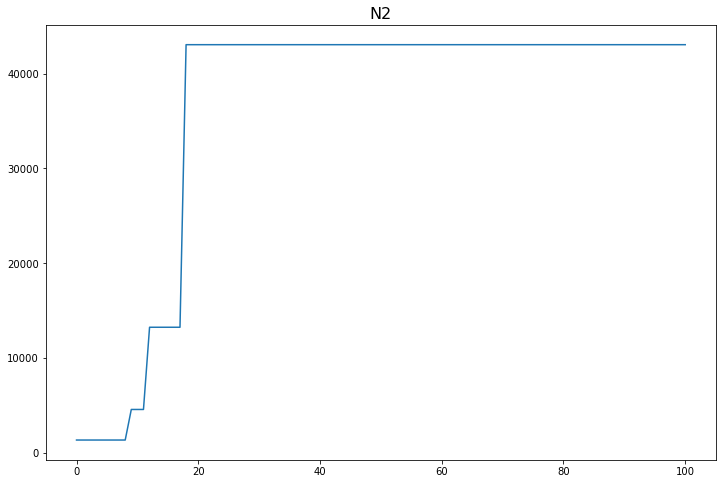

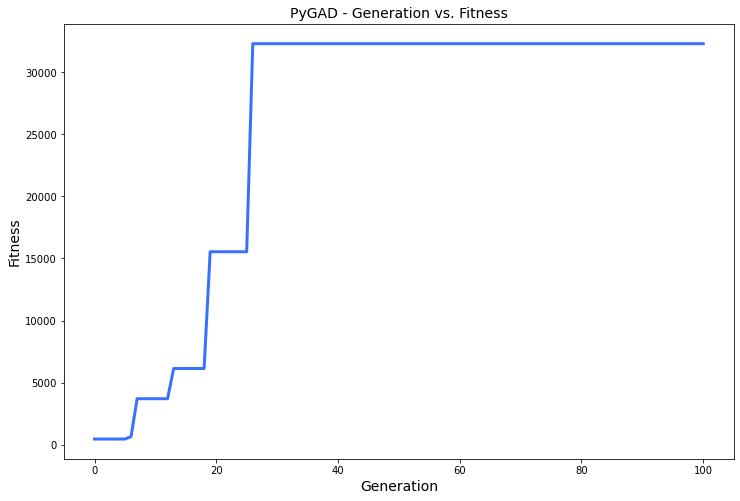

[1.23]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.23 |===========| 26.522 |==================| 55.148 |==========
[0.94]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.94 |===========| 26.545 |==================| 212.068 |==========
[0.862]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.862 |===========| 26.551 |==================| 92.093 |==========
[1.644]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.644 |===========| 26.489 |==================| 19.597 |==========
[0.178]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 26.604 |==================| 15.646 |==========
[1.889]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.889 |===========| 26.47 |==================| 14.15 |==========
[1.448]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 27.007 |==================| 12.739 |==========
[0.573]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.573 |===========| 26.972 |==================| 8.857 |==========
[0.667]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.667 |===========| 26.953 |==================| 7.589 |==========
[0.058]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 27.074 |==================| 89.212 |==========
[0.065]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 27.072 |==================| 78.767 |==========
[0.773]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.773 |===========| 26.932 |==================| 6.535 |==========
[0.887]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 27.054 |==================| 32.336 |==========
[-0.624]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.624 |===========| 26.962 |==================| 8.116 |==========
Fitness = 8004.631244495578
[0.058]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 27.074 |==================| 89.212 |==========
[0.065]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 27.072 |==================| 78.767 |==========
[0.773]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.773 |===========| 26.932 |==================| 6.535 |==========
[0.887]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.887 |===========| 26.909 |==================| 5.679 |==========
[-0.703]
=====|SOLUTION|===========|OUTPUT|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 27.054 |==================| 32.336 |==========
[-0.624]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.624 |===========| 26.962 |==================| 8.116 |==========
[0.058]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 27.074 |==================| 89.212 |==========
[0.065]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 27.072 |==================| 78.767 |==========
[0.773]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.773 |===========| 26.932 |==================| 6.535 |==========
[0.887]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.887 |===========| 26.909 |==================| 5.679 |==========
[-0.703]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.762 |===========| 26.934 |==================| 6.624 |==========
[0.613]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.613 |===========| 26.964 |==================| 8.266 |==========
Generation = 2
[-0.744]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.744 |===========| 26.938 |==================| 6.79 |==========
[0.769]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.769 |===========| 26.933 |==================| 6.569 |==========
[-0.304]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.304 |===========| 27.025 |==================| 16.759 |==========
[0.498]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.498 |===========| 26.987 |==================| 10.206 |==========
[-0.188]
=====|SOLUTION|===========|OUTPUT|==================|FITN

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.613 |===========| 26.964 |==================| 8.266 |==========
Change = 0.0
[-0.744]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.744 |===========| 26.938 |==================| 6.79 |==========
[0.769]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.769 |===========| 26.933 |==================| 6.569 |==========
[-0.304]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.304 |===========| 27.025 |==================| 16.759 |==========
[0.498]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.498 |===========| 26.987 |==================| 10.206 |==========
[-0.188]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 27.048 |==================| 27.181 |==========
[0.283]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.762 |===========| 26.934 |==================| 6.624 |==========
[0.613]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.613 |===========| 26.964 |==================| 8.266 |==========
[0.448]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 26.997 |==================| 11.344 |==========
[0.407]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 27.005 |==================| 12.507 |==========
[-0.371]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 27.012 |==================| 13.717 |==========
[0.973]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 26.891 |==================| 5.166 |==========
[-0.344]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 27.06 |==================| 40.537 |==========
[0.509]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.509 |===========| 26.985 |==================| 9.972 |==========
Fitness = 8004.631244495578
[0.448]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 26.997 |==================| 11.344 |==========
[0.407]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 27.005 |==================| 12.507 |==========
[-0.371]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 27.012 |==================| 13.717 |==========
[0.973]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 26.891 |==================| 5.166 |==========
[-0.344]
=====|SOLUTION|===========|OUTPUT|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.509 |===========| 26.985 |==================| 9.972 |==========
[0.448]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 26.997 |==================| 11.344 |==========
[0.407]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 27.005 |==================| 12.507 |==========
[-0.371]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 27.012 |==================| 13.717 |==========
[0.973]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 26.891 |==================| 5.166 |==========
[-0.344]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 27.018 |==================| 14.812 |==========
[0.861]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 27.02 |==================| 15.491 |==========
[0.974]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.974 |===========| 26.891 |==================| 5.159 |==========
[-0.733]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.733 |===========| 26.94 |==================| 6.891 |==========
[0.644]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 26.958 |==================| 7.867 |==========
[-0.764]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.764 |===========| 26.934 |==================| 6.605 |==========
[0.941]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.941 |===========| 26.898 |==================| 5.344 |==========
[-0.947]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.974 |===========| 26.891 |==================| 5.159 |==========
[-0.733]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.733 |===========| 26.94 |==================| 6.891 |==========
[0.644]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 26.958 |==================| 7.867 |==========
[-0.764]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.764 |===========| 26.934 |==================| 6.605 |==========
[0.941]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.941 |===========| 26.898 |==================| 5.344 |==========
[-0.947]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.947 |===========| 26.897 |==================| 5.308 |==========
[-0.601]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 27.084 |==================| 942.807 |==========
[0.476]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 26.991 |==================| 10.681 |==========
[-0.282]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 27.03 |==================| 18.121 |==========
[-0.581]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.581 |===========| 26.97 |==================| 8.723 |==========
[-0.662]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.662 |===========| 26.954 |==================| 7.647 |==========
[-0.773]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.773 |===========| 26.932 |==================| 6.53 |==========
[-0.39]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 27.066 |==================| 52.595 |==========
[-0.005]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 27.084 |==================| 942.807 |==========
[0.476]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 26.991 |==================| 10.681 |==========
[-0.282]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 27.03 |==================| 18.121 |==========
[-0.581]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.581 |===========| 26.97 |==================| 8.723 |==========
[-0.662]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.662 |===========| 26.954 |==================| 7.647 |==========
[-0.773]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 27.066 |==================| 52.595 |==========
[-0.005]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 27.084 |==================| 942.807 |==========
[0.476]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 26.991 |==================| 10.681 |==========
[-0.282]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 27.03 |==================| 18.121 |==========
[-0.581]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.581 |===========| 26.97 |==================| 8.723 |==========
[-0.662]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.662 |===========| 26.954 |==================| 7.647 |==========
[-0.773]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 27.07 |==================| 66.901 |==========
[-0.049]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 27.075 |==================| 103.863 |==========
[0.258]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 27.034 |==================| 19.765 |==========
[0.772]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.772 |===========| 26.932 |==================| 6.537 |==========
[0.01]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 27.083 |==================| 522.055 |==========
[0.537]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.537 |===========| 26.979 |==================| 9.448 |==========
[-0.398]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 27.075 |==================| 103.863 |==========
[0.258]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 27.034 |==================| 19.765 |==========
[0.772]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.772 |===========| 26.932 |==================| 6.537 |==========
[0.01]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 27.083 |==================| 522.055 |==========
[0.537]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.537 |===========| 26.979 |==================| 9.448 |==========
[-0.398]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 27.007 |==================| 12.806 |==========
[-0.585]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 27.007 |==================| 12.804 |==========
[-0.215]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 27.043 |==================| 23.737 |==========
[0.506]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.506 |===========| 26.985 |==================| 10.03 |==========
[-0.693]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.693 |===========| 26.948 |==================| 7.301 |==========
[-0.909]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.909 |===========| 26.904 |==================| 5.539 |==========
[-0.342]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 27.018 |==================| 14.893 |==========
[0.749]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 27.043 |==================| 23.737 |==========
[0.506]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.506 |===========| 26.985 |==================| 10.03 |==========
[-0.693]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.693 |===========| 26.948 |==================| 7.301 |==========
[-0.909]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.909 |===========| 26.904 |==================| 5.539 |==========
[-0.342]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 27.018 |==================| 14.893 |==========
[0.749]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.749 |===========| 26.937 |==================| 6.747 |==========
[0.679]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.506 |===========| 26.985 |==================| 10.03 |==========
[-0.693]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.693 |===========| 26.948 |==================| 7.301 |==========
[-0.909]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.909 |===========| 26.904 |==================| 5.539 |==========
[-0.342]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 27.018 |==================| 14.893 |==========
[0.749]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.749 |===========| 26.937 |==================| 6.747 |==========
[0.679]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.679 |===========| 26.951 |==================| 7.449 |==========
[-0.427]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 26.987 |==================| 10.244 |==========
[0.402]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 27.006 |==================| 12.657 |==========
[0.918]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.918 |===========| 26.903 |==================| 5.48 |==========
[0.778]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.778 |===========| 26.931 |==================| 6.486 |==========
[0.97]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.97 |===========| 26.892 |==================| 5.184 |==========
[-0.289]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 27.028 |==================| 17.655 |==========
[-0.077]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 27.082 |==================| 311.859 |==========
[-0.496]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 26.987 |==================| 10.244 |==========
[0.402]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 27.006 |==================| 12.657 |==========
[0.918]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.918 |===========| 26.903 |==================| 5.48 |==========
[0.778]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.778 |===========| 26.931 |==================| 6.486 |==========
[0.97]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.97 |===========| 26.892 |==================| 5.184 |==========
[-0.289]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 27.027 |==================| 17.17 |==========
[0.209]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.209 |===========| 27.044 |==================| 24.513 |==========
[0.349]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 27.017 |==================| 14.613 |==========
[0.46]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 26.995 |==================| 11.059 |==========
[-0.409]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 27.005 |==================| 12.448 |==========
[-0.486]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 26.989 |==================| 10.458 |==========
[0.242]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 27.026 |==================| 16.896 |==========
[0.297]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 27.027 |==================| 17.17 |==========
[0.209]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.209 |===========| 27.044 |==================| 24.513 |==========
[0.349]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 27.017 |==================| 14.613 |==========
[0.46]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 26.995 |==================| 11.059 |==========
[-0.409]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 27.005 |==================| 12.448 |==========
[-0.486]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 27.026 |==================| 16.896 |==========
[0.297]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 27.027 |==================| 17.17 |==========
[0.209]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.209 |===========| 27.044 |==================| 24.513 |==========
[0.349]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 27.017 |==================| 14.613 |==========
[0.46]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 26.995 |==================| 11.059 |==========
[-0.409]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 27.005 |==================| 12.448 |==========
[-0.486]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.688 |===========| 26.949 |==================| 7.35 |==========
[-0.945]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.945 |===========| 26.897 |==================| 5.32 |==========
[0.654]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.654 |===========| 26.956 |==================| 7.746 |==========
[-0.054]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 27.075 |==================| 95.578 |==========
[-0.964]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 26.893 |==================| 5.215 |==========
[0.59]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.59 |===========| 26.969 |==================| 8.587 |==========
[0.803]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.945 |===========| 26.897 |==================| 5.32 |==========
[0.654]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.654 |===========| 26.956 |==================| 7.746 |==========
[-0.054]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 27.075 |==================| 95.578 |==========
[-0.964]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 26.893 |==================| 5.215 |==========
[0.59]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.59 |===========| 26.969 |==================| 8.587 |==========
[0.803]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.803 |===========| 26.926 |==================| 6.285 |==========
[-0.499]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 26.99 |==================| 10.547 |==========
[-0.408]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 27.005 |==================| 12.471 |==========
[-0.339]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 27.018 |==================| 15.027 |==========
[0.155]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 27.055 |==================| 32.947 |==========
[-0.574]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.574 |===========| 26.972 |==================| 8.829 |==========
[-0.175]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 27.051 |==================| 29.273 |==========
[0.218]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.652 |===========| 26.956 |==================| 7.766 |==========
[0.482]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 26.99 |==================| 10.547 |==========
[-0.408]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 27.005 |==================| 12.471 |==========
[-0.339]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 27.018 |==================| 15.027 |==========
[0.155]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 27.055 |==================| 32.947 |==========
[-0.574]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.574 |===========| 26.972 |==================| 8.829 |==========
[-0.175]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.652 |===========| 26.956 |==================| 7.766 |==========
[0.482]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 26.99 |==================| 10.547 |==========
[-0.408]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 27.005 |==================| 12.471 |==========
[-0.339]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 27.018 |==================| 15.027 |==========
[0.155]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 27.055 |==================| 32.947 |==========
[-0.574]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.574 |===========| 26.972 |==================| 8.829 |==========
[-0.175]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 27.064 |==================| 46.844 |==========
[0.85]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.85 |===========| 26.916 |==================| 5.933 |==========
[-0.961]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 26.894 |==================| 5.233 |==========
[-0.322]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 27.022 |==================| 15.829 |==========
[0.701]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.701 |===========| 26.946 |==================| 7.209 |==========
[-0.708]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.708 |===========| 26.945 |==================| 7.138 |==========
[-0.145]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.908 |===========| 26.905 |==================| 5.546 |==========
[-0.109]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 27.064 |==================| 46.844 |==========
[0.85]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.85 |===========| 26.916 |==================| 5.933 |==========
[-0.961]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 26.894 |==================| 5.233 |==========
[-0.322]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 27.022 |==================| 15.829 |==========
[0.701]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.701 |===========| 26.946 |==================| 7.209 |==========
[-0.708]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.953 |===========| 26.896 |==================| 5.279 |==========
[0.329]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 27.021 |==================| 15.506 |==========
[-0.851]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 26.916 |==================| 5.924 |==========
[-0.692]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.692 |===========| 26.948 |==================| 7.31 |==========
[-0.557]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.557 |===========| 26.975 |==================| 9.113 |==========
[-0.374]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 27.012 |==================| 13.637 |==========
[-0.245]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.953 |===========| 26.896 |==================| 5.279 |==========
[0.329]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 27.021 |==================| 15.506 |==========
[-0.851]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 26.916 |==================| 5.924 |==========
[-0.692]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.692 |===========| 26.948 |==================| 7.31 |==========
[-0.557]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.557 |===========| 26.975 |==================| 9.113 |==========
[-0.374]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 27.012 |==================| 13.637 |==========
[-0.245]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.953 |===========| 26.896 |==================| 5.279 |==========
[0.329]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 27.021 |==================| 15.506 |==========
[-0.851]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 26.916 |==================| 5.924 |==========
[-0.692]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.692 |===========| 26.948 |==================| 7.31 |==========
[-0.557]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.557 |===========| 26.975 |==================| 9.113 |==========
[-0.374]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 27.012 |==================| 13.637 |==========
[-0.245]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.819 |===========| 26.923 |==================| 6.161 |==========
[0.726]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.726 |===========| 26.941 |==================| 6.958 |==========
[-0.805]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.805 |===========| 26.925 |==================| 6.264 |==========
[-0.86]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.86 |===========| 26.914 |==================| 5.858 |==========
[0.635]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.635 |===========| 26.96 |==================| 7.98 |==========
[0.002]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 27.085 |==================| 2260.211 |==========
[-0.376]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.819 |===========| 26.923 |==================| 6.161 |==========
[0.726]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.726 |===========| 26.941 |==================| 6.958 |==========
[-0.805]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.805 |===========| 26.925 |==================| 6.264 |==========
[-0.86]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.86 |===========| 26.914 |==================| 5.858 |==========
[0.635]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.635 |===========| 26.96 |==================| 7.98 |==========
[0.002]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 27.085 |==================| 2260.211 |==========
[-0.376]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 26.947 |==================| 7.264 |==========
[-0.382]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 27.01 |==================| 13.322 |==========
[0.871]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.871 |===========| 26.912 |==================| 5.785 |==========
[0.267]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 27.033 |==================| 19.129 |==========
[0.372]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 27.012 |==================| 13.711 |==========
[-0.601]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 26.966 |==================| 8.427 |==========
[-0.489]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 26.947 |==================| 7.264 |==========
[-0.382]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 27.01 |==================| 13.322 |==========
[0.871]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.871 |===========| 26.912 |==================| 5.785 |==========
[0.267]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 27.033 |==================| 19.129 |==========
[0.372]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 27.012 |==================| 13.711 |==========
[-0.601]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 26.966 |==================| 8.427 |==========
[-0.489]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 27.002 |==================| 12.077 |==========
[-0.696]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 26.947 |==================| 7.264 |==========
[-0.382]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 27.01 |==================| 13.322 |==========
[0.871]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.871 |===========| 26.912 |==================| 5.785 |==========
[0.267]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 27.033 |==================| 19.129 |==========
[0.372]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 27.012 |==================| 13.711 |==========
[-0.601]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 26.995 |==================| 11.151 |==========
[-0.146]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 27.056 |==================| 35.018 |==========
[0.672]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.672 |===========| 26.952 |==================| 7.531 |==========
[0.681]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 26.951 |==================| 7.434 |==========
[0.995]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.995 |===========| 26.887 |==================| 5.048 |==========
[0.338]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 27.019 |==================| 15.104 |==========
[0.772]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 26.995 |==================| 11.151 |==========
[-0.146]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 27.056 |==================| 35.018 |==========
[0.672]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.672 |===========| 26.952 |==================| 7.531 |==========
[0.681]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 26.951 |==================| 7.434 |==========
[0.995]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.995 |===========| 26.887 |==================| 5.048 |==========
[0.338]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 27.019 |==================| 15.104 |==========
[0.772]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 27.02 |==================| 15.375 |==========
[0.88]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.88 |===========| 26.91 |==================| 5.721 |==========
[0.106]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 27.064 |==================| 48.382 |==========
[0.799]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.799 |===========| 26.927 |==================| 6.318 |==========
[-0.962]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.962 |===========| 26.894 |==================| 5.227 |==========
[0.016]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 27.082 |==================| 330.137 |==========
[0.794]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 27.02 |==================| 15.375 |==========
[0.88]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.88 |===========| 26.91 |==================| 5.721 |==========
[0.106]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 27.064 |==================| 48.382 |==========
[0.799]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.799 |===========| 26.927 |==================| 6.318 |==========
[-0.962]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.962 |===========| 26.894 |==================| 5.227 |==========
[0.016]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 27.082 |==================| 330.137 |==========
[0.794]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.901 |===========| 26.906 |==================| 5.588 |==========
[-0.332]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 27.02 |==================| 15.375 |==========
[0.88]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.88 |===========| 26.91 |==================| 5.721 |==========
[0.106]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 27.064 |==================| 48.382 |==========
[0.799]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.799 |===========| 26.927 |==================| 6.318 |==========
[-0.962]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.962 |===========| 26.894 |==================| 5.227 |==========
[0.016]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 26.939 |==================| 6.854 |==========
[-0.514]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.514 |===========| 26.984 |==================| 9.888 |==========
[-0.616]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.616 |===========| 26.963 |==================| 8.224 |==========
[0.905]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 26.905 |==================| 5.562 |==========
[-0.95]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 26.896 |==================| 5.294 |==========
[-0.977]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.977 |===========| 26.891 |==================| 5.144 |==========
[-0.038]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.991 |===========| 26.888 |==================| 5.071 |==========
[0.737]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 26.939 |==================| 6.854 |==========
[-0.514]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.514 |===========| 26.984 |==================| 9.888 |==========
[-0.616]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.616 |===========| 26.963 |==================| 8.224 |==========
[0.905]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 26.905 |==================| 5.562 |==========
[-0.95]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 26.896 |==================| 5.294 |==========
[-0.977]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 27.043 |==================| 23.66 |==========
[0.018]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 27.082 |==================| 286.941 |==========
[0.637]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.637 |===========| 26.959 |==================| 7.944 |==========
[-0.904]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.904 |===========| 26.905 |==================| 5.567 |==========
[0.826]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.826 |===========| 26.921 |==================| 6.107 |==========
[-0.415]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 27.003 |==================| 12.255 |==========
[0.536]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 27.082 |==================| 286.941 |==========
[0.637]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.637 |===========| 26.959 |==================| 7.944 |==========
[-0.904]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.904 |===========| 26.905 |==================| 5.567 |==========
[0.826]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.826 |===========| 26.921 |==================| 6.107 |==========
[-0.415]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 27.003 |==================| 12.255 |==========
[0.536]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 26.98 |==================| 9.476 |==========
[-0.969]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 27.082 |==================| 286.941 |==========
[0.637]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.637 |===========| 26.959 |==================| 7.944 |==========
[-0.904]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.904 |===========| 26.905 |==================| 5.567 |==========
[0.826]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.826 |===========| 26.921 |==================| 6.107 |==========
[-0.415]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 27.003 |==================| 12.255 |==========
[0.536]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 26.98 |==================| 9.476 |==========
[-0.969]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 27.012 |==================| 13.675 |==========
[0.024]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 27.08 |==================| 213.307 |==========
[0.017]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 27.082 |==================| 302.645 |==========
[-0.731]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.731 |===========| 26.94 |==================| 6.913 |==========
[-0.748]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.748 |===========| 26.937 |==================| 6.749 |==========
[-0.102]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 27.065 |==================| 50.209 |==========
[-0.606]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.859 |===========| 26.915 |==================| 5.866 |==========
[-0.373]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 27.012 |==================| 13.675 |==========
[0.024]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 27.08 |==================| 213.307 |==========
[0.017]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 27.082 |==================| 302.645 |==========
[-0.731]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.731 |===========| 26.94 |==================| 6.913 |==========
[-0.748]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.748 |===========| 26.937 |==================| 6.749 |==========
[-0.102]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.811 |===========| 26.924 |==================| 6.223 |==========
[-0.345]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 27.017 |==================| 14.773 |==========
[-0.277]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 27.031 |==================| 18.453 |==========
[-0.459]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 26.995 |==================| 11.08 |==========
[-0.08]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 27.069 |==================| 64.291 |==========
[-0.858]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.858 |===========| 26.915 |==================| 5.872 |==========
[0.157]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 26.992 |==================| 10.772 |==========
[0.811]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.811 |===========| 26.924 |==================| 6.223 |==========
[-0.345]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 27.017 |==================| 14.773 |==========
[-0.277]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 27.031 |==================| 18.453 |==========
[-0.459]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 26.995 |==================| 11.08 |==========
[-0.08]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 27.069 |==================| 64.291 |==========
[-0.858]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 27.053 |==================| 30.894 |==========
[0.472]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 26.992 |==================| 10.772 |==========
[0.811]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.811 |===========| 26.924 |==================| 6.223 |==========
[-0.345]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 27.017 |==================| 14.773 |==========
[-0.277]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 27.031 |==================| 18.453 |==========
[-0.459]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 26.995 |==================| 11.08 |==========
[-0.08]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 27.058 |==================| 36.878 |==========
[-0.8]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.8 |===========| 26.926 |==================| 6.307 |==========
[-0.173]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 27.051 |==================| 29.631 |==========
[-0.144]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 27.057 |==================| 35.449 |==========
[0.977]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.977 |===========| 26.891 |==================| 5.142 |==========
[-0.173]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 27.051 |==================| 29.582 |==========
[-0.744]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 27.065 |==================| 50.369 |==========
[-0.139]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 27.058 |==================| 36.878 |==========
[-0.8]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.8 |===========| 26.926 |==================| 6.307 |==========
[-0.173]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 27.051 |==================| 29.631 |==========
[-0.144]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 27.057 |==================| 35.449 |==========
[0.977]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.977 |===========| 26.891 |==================| 5.142 |==========
[-0.173]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.576 |===========| 26.971 |==================| 8.807 |==========
[-0.392]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 27.008 |==================| 12.986 |==========
[0.83]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 26.92 |==================| 6.072 |==========
[0.845]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.845 |===========| 26.917 |==================| 5.966 |==========
[-0.878]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.878 |===========| 26.911 |==================| 5.737 |==========
[-0.983]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.983 |===========| 26.889 |==================| 5.112 |==========
[-0.669]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.673 |===========| 26.952 |==================| 7.517 |==========
Fitness = 8004.631244495578
[-0.576]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.576 |===========| 26.971 |==================| 8.807 |==========
[-0.392]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 27.008 |==================| 12.986 |==========
[0.83]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 26.92 |==================| 6.072 |==========
[0.845]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.845 |===========| 26.917 |==================| 5.966 |==========
[-0.878]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.878 |===========| 26.911 |==================| 5.737 |==========
[-0.983]
=====|SOLUTION|===========|OUTPUT|============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |===========| 27.022 |==================| 15.787 |==========
[-0.673]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.673 |===========| 26.952 |==================| 7.517 |==========
[-0.576]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.576 |===========| 26.971 |==================| 8.807 |==========
[-0.392]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 27.008 |==================| 12.986 |==========
[0.83]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 26.92 |==================| 6.072 |==========
[0.845]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.845 |===========| 26.917 |==================| 5.966 |==========
[-0.878]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.888 |===========| 26.909 |==================| 5.671 |==========
[0.285]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.285 |===========| 27.029 |==================| 17.934 |==========
[0.11]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 27.064 |==================| 46.49 |==========
Generation = 24
[-0.49]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 26.989 |==================| 10.375 |==========
[0.084]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 27.069 |==================| 61.271 |==========
[0.803]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.803 |===========| 26.926 |==================| 6.286 |==========
[0.347]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.888 |===========| 26.909 |==================| 5.671 |==========
[0.285]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.285 |===========| 27.029 |==================| 17.934 |==========
[0.11]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 27.064 |==================| 46.49 |==========
Change = 0.0
[-0.49]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 26.989 |==================| 10.375 |==========
[0.084]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 27.069 |==================| 61.271 |==========
[0.803]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.803 |===========| 26.926 |==================| 6.286 |==========
[0.347]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.285 |===========| 27.029 |==================| 17.934 |==========
[0.11]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 27.064 |==================| 46.49 |==========
[-0.021]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 27.081 |==================| 248.979 |==========
[-0.602]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.602 |===========| 26.966 |==================| 8.423 |==========
[0.466]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 26.993 |==================| 10.903 |==========
[-0.954]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.954 |===========| 26.895 |==================| 5.271 |==========
[-0.256]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.903 |===========| 26.906 |==================| 5.576 |==========
Fitness = 8004.631244495578
[-0.021]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 27.081 |==================| 248.979 |==========
[-0.602]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.602 |===========| 26.966 |==================| 8.423 |==========
[0.466]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 26.993 |==================| 10.903 |==========
[-0.954]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.954 |===========| 26.895 |==================| 5.271 |==========
[-0.256]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 27.035 |==================| 19.914 |==========
[0.832]
=====|SOLUTION|===========|OUTPUT|======

[-0.903]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.903 |===========| 26.906 |==================| 5.576 |==========
[-0.021]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 27.081 |==================| 248.979 |==========
[-0.602]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.602 |===========| 26.966 |==================| 8.423 |==========
[0.466]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 26.993 |==================| 10.903 |==========
[-0.954]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.954 |===========| 26.895 |==================| 5.271 |==========
[-0.256]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 27.035 |==================| 19.914 |==========
[0.832]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.526 |===========| 26.982 |==================| 9.659 |==========
[0.085]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 27.068 |==================| 60.417 |==========
Generation = 26
[-0.348]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 27.017 |==================| 14.632 |==========
[0.274]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 27.031 |==================| 18.636 |==========
[-0.492]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 26.988 |==================| 10.333 |==========
[0.473]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 26.992 |==================| 10.756 |==========
[0.701]
=====|SOLUTION|===========|OUTPUT|==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 27.056 |==================| 34.08 |==========
[-0.526]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.526 |===========| 26.982 |==================| 9.659 |==========
[0.085]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 27.068 |==================| 60.417 |==========
Change = 0.0
[-0.348]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 27.017 |==================| 14.632 |==========
[0.274]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 27.031 |==================| 18.636 |==========
[-0.492]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 26.988 |==================| 10.333 |==========
[0.473]
=====|SOLUTION|===========|OUTPUT|==================|FITN

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 26.971 |==================| 8.765 |==========
[0.15]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 27.056 |==================| 34.08 |==========
[-0.526]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.526 |===========| 26.982 |==================| 9.659 |==========
[0.085]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 27.068 |==================| 60.417 |==========
[-0.853]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 26.916 |==================| 5.912 |==========
[-0.033]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 27.079 |==================| 156.192 |==========
[0.927]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.315 |===========| 27.023 |==================| 16.205 |==========
[0.669]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.669 |===========| 26.953 |==================| 7.563 |==========
[0.668]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 26.953 |==================| 7.58 |==========
[0.926]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.926 |===========| 26.901 |==================| 5.436 |==========
[0.851]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 26.916 |==================| 5.921 |==========
Fitness = 8004.631244495578
[-0.853]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 26.916 |==================| 5.912 |==========
[-0.033]
=====|SOLUTION|===========|OUTPUT|============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.689 |===========| 26.949 |==================| 7.34 |==========
[0.315]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.315 |===========| 27.023 |==================| 16.205 |==========
[0.669]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.669 |===========| 26.953 |==================| 7.563 |==========
[0.668]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 26.953 |==================| 7.58 |==========
[0.926]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.926 |===========| 26.901 |==================| 5.436 |==========
[0.851]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 26.916 |==================| 5.921 |==========
[-0.853]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 27.048 |==================| 27.272 |==========
[-0.214]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 27.043 |==================| 23.943 |==========
[0.158]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 27.054 |==================| 32.461 |==========
[-0.626]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.626 |===========| 26.961 |==================| 8.086 |==========
[0.532]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.532 |===========| 26.98 |==================| 9.54 |==========
Generation = 28
[-0.295]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.295 |===========| 27.027 |==================| 17.304 |==========
[-0.329]
=====|SOLUTION|===========|OUTPUT|==================|F

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 27.048 |==================| 27.272 |==========
[-0.214]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 27.043 |==================| 23.943 |==========
[0.158]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 27.054 |==================| 32.461 |==========
[-0.626]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.626 |===========| 26.961 |==================| 8.086 |==========
[0.532]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.532 |===========| 26.98 |==================| 9.54 |==========
Change = 0.0
[-0.295]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.295 |===========| 27.027 |==================| 17.304 |==========
[-0.329]
=====|SOLUTION|===========|OUTPUT|==================|FITN

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 27.043 |==================| 23.943 |==========
[0.158]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 27.054 |==================| 32.461 |==========
[-0.626]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.626 |===========| 26.961 |==================| 8.086 |==========
[0.532]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.532 |===========| 26.98 |==================| 9.54 |==========
[0.536]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 26.979 |==================| 9.466 |==========
[0.263]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 27.034 |==================| 19.423 |==========
[0.994]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 27.07 |==================| 67.67 |==========
[-0.457]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 26.995 |==================| 11.117 |==========
[-0.895]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.895 |===========| 26.907 |==================| 5.625 |==========
[-0.413]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 27.004 |==================| 12.311 |==========
[-0.447]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 26.997 |==================| 11.37 |==========
Fitness = 8004.631244495578
[0.536]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 26.979 |==================| 9.466 |==========
[0.263]
=====|SOLUTION|===========|OUTPUT|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 27.07 |==================| 67.67 |==========
[-0.457]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 26.995 |==================| 11.117 |==========
[-0.895]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.895 |===========| 26.907 |==================| 5.625 |==========
[-0.413]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 27.004 |==================| 12.311 |==========
[-0.447]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 26.997 |==================| 11.37 |==========
[0.536]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 26.979 |==================| 9.466 |==========
[0.263]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.9 |===========| 26.906 |==================| 5.594 |==========
[0.306]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.306 |===========| 27.025 |==================| 16.681 |==========
[0.366]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 27.013 |==================| 13.939 |==========
[-0.283]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 27.03 |==================| 18.046 |==========
Generation = 30
[-0.255]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 27.035 |==================| 20.031 |==========
[-0.807]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.807 |===========| 26.925 |==================| 6.248 |==========
[-0.48]
=====|SOLUTION|===========|OUTPUT|==================|FIT

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.306 |===========| 27.025 |==================| 16.681 |==========
[0.366]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 27.013 |==================| 13.939 |==========
[-0.283]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 27.03 |==================| 18.046 |==========
Change = 0.0
[-0.255]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 27.035 |==================| 20.031 |==========
[-0.807]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.807 |===========| 26.925 |==================| 6.248 |==========
[-0.48]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 26.991 |==================| 10.59 |==========
[0.48]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.306 |===========| 27.025 |==================| 16.681 |==========
[0.366]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 27.013 |==================| 13.939 |==========
[-0.283]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 27.03 |==================| 18.046 |==========
[-0.694]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.694 |===========| 26.948 |==================| 7.292 |==========
[-0.712]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.712 |===========| 26.944 |==================| 7.104 |==========
[-0.934]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.934 |===========| 26.899 |==================| 5.387 |==========
[-0.483]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.846 |===========| 26.917 |==================| 5.962 |==========
[0.777]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.777 |===========| 26.931 |==================| 6.496 |==========
[0.851]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 26.916 |==================| 5.919 |==========
Fitness = 8004.631244495578
[-0.694]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.694 |===========| 26.948 |==================| 7.292 |==========
[-0.712]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.712 |===========| 26.944 |==================| 7.104 |==========
[-0.934]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.934 |===========| 26.899 |==================| 5.387 |==========
[-0.483]
=====|SOLUTION|===========|OUTPUT|==========

[-0.846]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.846 |===========| 26.917 |==================| 5.962 |==========
[0.777]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.777 |===========| 26.931 |==================| 6.496 |==========
[0.851]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 26.916 |==================| 5.919 |==========
[-0.694]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.694 |===========| 26.948 |==================| 7.292 |==========
[-0.712]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.712 |===========| 26.944 |==================| 7.104 |==========
[-0.934]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.934 |===========| 26.899 |==================| 5.387 |==========
[-0.483]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.671 |===========| 26.952 |==================| 7.537 |==========
[-0.451]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 26.996 |==================| 11.272 |==========
[0.263]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 27.033 |==================| 19.386 |==========
[-0.992]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.992 |===========| 26.888 |==================| 5.065 |==========
Generation = 32
[0.603]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.603 |===========| 26.966 |==================| 8.405 |==========
[-0.508]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.508 |===========| 26.985 |==================| 9.99 |==========
[-0.979]
=====|SOLUTION|===========|OUTPUT|==================|FI

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.671 |===========| 26.952 |==================| 7.537 |==========
[-0.451]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 26.996 |==================| 11.272 |==========
[0.263]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 27.033 |==================| 19.386 |==========
[-0.992]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.992 |===========| 26.888 |==================| 5.065 |==========
Change = 0.0
[0.603]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.603 |===========| 26.966 |==================| 8.405 |==========
[-0.508]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.508 |===========| 26.985 |==================| 9.99 |==========
[-0.979]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

[-0.451]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 26.996 |==================| 11.272 |==========
[0.263]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 27.033 |==================| 19.386 |==========
[-0.992]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.992 |===========| 26.888 |==================| 5.065 |==========
[0.414]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 27.004 |==================| 12.307 |==========
[-0.919]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.919 |===========| 26.902 |==================| 5.473 |==========
[0.601]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 26.966 |==================| 8.429 |==========
[-0.465]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.771 |===========| 26.932 |==================| 6.549 |==========
[0.662]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.662 |===========| 26.954 |==================| 7.651 |==========
Fitness = 8004.631244495578
[0.414]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 27.004 |==================| 12.307 |==========
[-0.919]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.919 |===========| 26.902 |==================| 5.473 |==========
[0.601]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 26.966 |==================| 8.429 |==========
[-0.465]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 26.994 |==================| 10.939 |==========
[0.552]
=====|SOLUTION|===========|OUTPUT|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.785 |===========| 26.93 |==================| 6.433 |==========
[-0.771]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.771 |===========| 26.932 |==================| 6.549 |==========
[0.662]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.662 |===========| 26.954 |==================| 7.651 |==========
[0.414]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 27.004 |==================| 12.307 |==========
[-0.919]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.919 |===========| 26.902 |==================| 5.473 |==========
[0.601]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 26.966 |==================| 8.429 |==========
[-0.465]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.271 |===========| 27.032 |==================| 18.831 |==========
[0.942]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.942 |===========| 26.898 |==================| 5.341 |==========
[-0.525]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.525 |===========| 26.982 |==================| 9.666 |==========
[-0.958]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.958 |===========| 26.895 |==================| 5.249 |==========
Generation = 34
[-0.467]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 26.993 |==================| 10.885 |==========
[-0.534]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.534 |===========| 26.98 |==================| 9.499 |==========
[-0.994]
=====|SOLUTION|===========|OUTPUT|==================|F

[0.942]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.942 |===========| 26.898 |==================| 5.341 |==========
[-0.525]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.525 |===========| 26.982 |==================| 9.666 |==========
[-0.958]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.958 |===========| 26.895 |==================| 5.249 |==========
Change = 0.0
[-0.467]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 26.993 |==================| 10.885 |==========
[-0.534]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.534 |===========| 26.98 |==================| 9.499 |==========
[-0.994]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.994 |===========| 26.887 |==================| 5.056 |==========
[-0.578]
=====|SOLUTION|===========|OUTPUT|===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.525 |===========| 26.982 |==================| 9.666 |==========
[-0.958]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.958 |===========| 26.895 |==================| 5.249 |==========
[0.113]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 27.063 |==================| 45.323 |==========
[-0.9]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.9 |===========| 26.906 |==================| 5.597 |==========
[-0.426]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 27.001 |==================| 11.936 |==========
[0.453]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 26.996 |==================| 11.237 |==========
[0.294]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 27.083 |==================| 417.954 |==========
[-0.523]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.523 |===========| 26.982 |==================| 9.698 |==========
[-0.817]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.817 |===========| 26.923 |==================| 6.171 |==========
Fitness = 8004.631244495578
[0.113]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 27.063 |==================| 45.323 |==========
[-0.9]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.9 |===========| 26.906 |==================| 5.597 |==========
[-0.426]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 27.001 |==================| 11.936 |==========
[0.453]
=====|SOLUTION|===========|OUTPUT|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 27.083 |==================| 417.954 |==========
[-0.523]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.523 |===========| 26.982 |==================| 9.698 |==========
[-0.817]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.817 |===========| 26.923 |==================| 6.171 |==========
[0.113]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 27.063 |==================| 45.323 |==========
[-0.9]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.9 |===========| 26.906 |==================| 5.597 |==========
[-0.426]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 27.001 |==================| 11.936 |==========
[0.453]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.514 |===========| 26.984 |==================| 9.871 |==========
[0.617]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.617 |===========| 26.963 |==================| 8.214 |==========
[0.229]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 27.04 |==================| 22.307 |==========
[0.563]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.563 |===========| 26.974 |==================| 9.01 |==========
Generation = 36
[0.834]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.834 |===========| 26.92 |==================| 6.046 |==========
[-0.23]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 27.04 |==================| 22.196 |==========
[-0.174]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.514 |===========| 26.984 |==================| 9.871 |==========
[0.617]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.617 |===========| 26.963 |==================| 8.214 |==========
[0.229]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 27.04 |==================| 22.307 |==========
[0.563]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.563 |===========| 26.974 |==================| 9.01 |==========
Change = 0.0
[0.834]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.834 |===========| 26.92 |==================| 6.046 |==========
[-0.23]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 27.04 |==================| 22.196 |==========
[-0.174]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.832 |===========| 26.92 |==================| 6.061 |==========
[-0.514]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.514 |===========| 26.984 |==================| 9.871 |==========
[0.617]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.617 |===========| 26.963 |==================| 8.214 |==========
[0.229]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 27.04 |==================| 22.307 |==========
[0.563]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.563 |===========| 26.974 |==================| 9.01 |==========
[-0.206]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 27.045 |==================| 24.808 |==========
[-0.726]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 26.92 |==================| 6.065 |==========
[0.519]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.519 |===========| 26.983 |==================| 9.792 |==========
[0.071]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 27.071 |==================| 72.274 |==========
[0.639]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 26.959 |==================| 7.924 |==========
[0.864]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.864 |===========| 26.914 |==================| 5.831 |==========
[-0.849]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.849 |===========| 26.917 |==================| 5.939 |==========
Fitness = 8004.631244495578
[-0.206]
=====|SOLUTION|===========|OUTPUT|============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 26.92 |==================| 6.065 |==========
[0.519]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.519 |===========| 26.983 |==================| 9.792 |==========
[0.071]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 27.071 |==================| 72.274 |==========
[0.639]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 26.959 |==================| 7.924 |==========
[0.864]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.864 |===========| 26.914 |==================| 5.831 |==========
[-0.849]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.849 |===========| 26.917 |==================| 5.939 |==========
[-0.206]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 27.058 |==================| 36.628 |==========
[-0.158]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 27.054 |==================| 32.414 |==========
[-0.585]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.585 |===========| 26.97 |==================| 8.66 |==========
[0.036]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 27.078 |==================| 141.481 |==========
[-0.938]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 26.899 |==================| 5.364 |==========
[0.245]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 27.037 |==================| 20.846 |==========
[-0.759]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 27.058 |==================| 36.628 |==========
[-0.158]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 27.054 |==================| 32.414 |==========
[-0.585]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.585 |===========| 26.97 |==================| 8.66 |==========
[0.036]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 27.078 |==================| 141.481 |==========
[-0.938]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 26.899 |==================| 5.364 |==========
[0.245]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 27.037 |==================| 20.846 |==========
[-0.759]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 27.054 |==================| 32.414 |==========
[-0.585]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.585 |===========| 26.97 |==================| 8.66 |==========
[0.036]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 27.078 |==================| 141.481 |==========
[-0.938]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 26.899 |==================| 5.364 |==========
[0.245]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 27.037 |==================| 20.846 |==========
[-0.759]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.759 |===========| 26.935 |==================| 6.654 |==========
[0.744]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.642 |===========| 26.958 |==================| 7.891 |==========
[0.944]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.944 |===========| 26.897 |==================| 5.326 |==========
[-0.836]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.836 |===========| 26.919 |==================| 6.029 |==========
[-0.009]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 27.083 |==================| 557.609 |==========
[0.734]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.734 |===========| 26.94 |==================| 6.886 |==========
Fitness = 8004.631244495578
[0.744]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.744 |===========| 26.938 |==================| 6.791 |==========
[-0.537]
=====|SOLUTION|===========|OUTPUT|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.68 |===========| 26.951 |==================| 7.439 |==========
[-0.642]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.642 |===========| 26.958 |==================| 7.891 |==========
[0.944]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.944 |===========| 26.897 |==================| 5.326 |==========
[-0.836]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.836 |===========| 26.919 |==================| 6.029 |==========
[-0.009]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 27.083 |==================| 557.609 |==========
[0.734]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.734 |===========| 26.94 |==================| 6.886 |==========
[0.744]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.835 |===========| 26.919 |==================| 6.041 |==========
[0.393]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 27.008 |==================| 12.944 |==========
[-0.989]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.989 |===========| 26.888 |==================| 5.079 |==========
[0.45]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 26.997 |==================| 11.298 |==========
[0.648]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.648 |===========| 26.957 |==================| 7.814 |==========
[0.242]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 27.038 |==================| 21.124 |==========
[-0.027]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

[0.393]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 27.008 |==================| 12.944 |==========
[-0.989]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.989 |===========| 26.888 |==================| 5.079 |==========
[0.45]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 26.997 |==================| 11.298 |==========
[0.648]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.648 |===========| 26.957 |==================| 7.814 |==========
[0.242]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 27.038 |==================| 21.124 |==========
[-0.027]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 27.08 |==================| 193.403 |==========
Change = 0.0
[0.787]
=====|SOLUTION|===========|OUTPUT|=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.835 |===========| 26.919 |==================| 6.041 |==========
[0.393]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 27.008 |==================| 12.944 |==========
[-0.989]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.989 |===========| 26.888 |==================| 5.079 |==========
[0.45]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 26.997 |==================| 11.298 |==========
[0.648]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.648 |===========| 26.957 |==================| 7.814 |==========
[0.242]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 27.038 |==================| 21.124 |==========
[-0.027]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 27.0 |==================| 11.827 |==========
[0.836]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.836 |===========| 26.919 |==================| 6.031 |==========
[0.761]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.761 |===========| 26.934 |==================| 6.639 |==========
[0.77]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.77 |===========| 26.932 |==================| 6.556 |==========
[0.35]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 27.016 |==================| 14.565 |==========
[0.836]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.836 |===========| 26.919 |==================| 6.034 |==========
Fitness = 8004.631244495578
[0.048]
=====|SOLUTION|===========|OUTPUT|==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 27.0 |==================| 11.827 |==========
[0.836]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.836 |===========| 26.919 |==================| 6.031 |==========
[0.761]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.761 |===========| 26.934 |==================| 6.639 |==========
[0.77]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.77 |===========| 26.932 |==================| 6.556 |==========
[0.35]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 27.016 |==================| 14.565 |==========
[0.836]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.836 |===========| 26.919 |==================| 6.034 |==========
[0.048]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.989 |===========| 26.888 |==================| 5.078 |==========
[0.748]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.748 |===========| 26.937 |==================| 6.753 |==========
[-0.259]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 27.034 |==================| 19.687 |==========
[-0.012]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 27.083 |==================| 415.922 |==========
Generation = 42
[0.403]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.403 |===========| 27.006 |==================| 12.617 |==========
[-0.816]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.816 |===========| 26.923 |==================| 6.179 |==========
[-0.632]
=====|SOLUTION|===========|OUTPUT|==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.975 |===========| 26.891 |==================| 5.156 |==========
[-0.989]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.989 |===========| 26.888 |==================| 5.078 |==========
[0.748]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.748 |===========| 26.937 |==================| 6.753 |==========
[-0.259]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 27.034 |==================| 19.687 |==========
[-0.012]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 27.083 |==================| 415.922 |==========
Change = 0.0
[0.403]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.403 |===========| 27.006 |==================| 12.617 |==========
[-0.816]
=====|SOLUTION|===========|OUTPUT|==================|FI

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.975 |===========| 26.891 |==================| 5.156 |==========
[-0.989]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.989 |===========| 26.888 |==================| 5.078 |==========
[0.748]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.748 |===========| 26.937 |==================| 6.753 |==========
[-0.259]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 27.034 |==================| 19.687 |==========
[-0.012]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 27.083 |==================| 415.922 |==========
[-0.874]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.874 |===========| 26.911 |==================| 5.761 |==========
[0.278]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.999 |===========| 26.886 |==================| 5.028 |==========
[-0.507]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.507 |===========| 26.985 |==================| 10.024 |==========
[-0.06]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 27.073 |==================| 86.019 |==========
[-0.241]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 27.038 |==================| 21.171 |==========
[-0.58]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.58 |===========| 26.971 |==================| 8.737 |==========
[-0.589]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 26.969 |==================| 8.602 |==========
Fitness = 8004.631244495578
[-0.874]
=====|SOLUTION|===========|OUTPUT|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.999 |===========| 26.886 |==================| 5.028 |==========
[-0.507]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.507 |===========| 26.985 |==================| 10.024 |==========
[-0.06]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 27.073 |==================| 86.019 |==========
[-0.241]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 27.038 |==================| 21.171 |==========
[-0.58]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.58 |===========| 26.971 |==================| 8.737 |==========
[-0.589]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 26.969 |==================| 8.602 |==========
[-0.874]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 27.02 |==================| 15.486 |==========
[-0.589]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 26.969 |==================| 8.609 |==========
[-0.17]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 27.052 |==================| 30.095 |==========
[-0.052]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 27.075 |==================| 97.791 |==========
[-0.192]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 27.048 |==================| 26.659 |==========
Generation = 44
[-0.611]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.611 |===========| 26.964 |==================| 8.294 |==========
[0.663]
=====|SOLUTION|===========|OUTPUT|==================|F

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 26.969 |==================| 8.609 |==========
[-0.17]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 27.052 |==================| 30.095 |==========
[-0.052]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 27.075 |==================| 97.791 |==========
[-0.192]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 27.048 |==================| 26.659 |==========
Change = 0.0
[-0.611]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.611 |===========| 26.964 |==================| 8.294 |==========
[0.663]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.663 |===========| 26.954 |==================| 7.637 |==========
[-0.134]
=====|SOLUTION|===========|OUTPUT|==================|FITN

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 27.052 |==================| 30.095 |==========
[-0.052]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 27.075 |==================| 97.791 |==========
[-0.192]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 27.048 |==================| 26.659 |==========
[0.115]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 27.063 |==================| 44.692 |==========
[-0.618]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.618 |===========| 26.963 |==================| 8.201 |==========
[-0.171]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 27.052 |==================| 29.93 |==========
[-0.688]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.959 |===========| 26.894 |==================| 5.246 |==========
[0.58]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.58 |===========| 26.971 |==================| 8.744 |==========
Fitness = 8004.631244495578
[0.115]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 27.063 |==================| 44.692 |==========
[-0.618]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.618 |===========| 26.963 |==================| 8.201 |==========
[-0.171]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 27.052 |==================| 29.93 |==========
[-0.688]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.688 |===========| 26.949 |==================| 7.357 |==========
[0.695]
=====|SOLUTION|===========|OUTPUT|============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.58 |===========| 26.971 |==================| 8.744 |==========
[0.115]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 27.063 |==================| 44.692 |==========
[-0.618]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.618 |===========| 26.963 |==================| 8.201 |==========
[-0.171]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 27.052 |==================| 29.93 |==========
[-0.688]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.688 |===========| 26.949 |==================| 7.357 |==========
[0.695]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 26.948 |==================| 7.275 |==========
[-0.638]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.941 |===========| 26.898 |==================| 5.345 |==========
[-0.73]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.73 |===========| 26.94 |==================| 6.918 |==========
[-0.502]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 26.986 |==================| 10.121 |==========
[-0.043]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 27.077 |==================| 118.375 |==========
[-0.409]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 27.005 |==================| 12.443 |==========
[-0.808]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.808 |===========| 26.925 |==================| 6.243 |==========
[-0.095]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.73 |===========| 26.94 |==================| 6.918 |==========
[-0.502]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 26.986 |==================| 10.121 |==========
[-0.043]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 27.077 |==================| 118.375 |==========
[-0.409]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 27.005 |==================| 12.443 |==========
[-0.808]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.808 |===========| 26.925 |==================| 6.243 |==========
[-0.095]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 27.067 |==================| 54.137 |==========
[0.507]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 26.99 |==================| 10.573 |==========
[0.08]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 27.069 |==================| 63.998 |==========
[0.061]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.061 |===========| 27.073 |==================| 83.804 |==========
[-0.383]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 27.01 |==================| 13.285 |==========
[-0.626]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.626 |===========| 26.962 |==================| 8.098 |==========
[0.197]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 27.046 |==================| 25.91 |==========
[-0.997]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 26.99 |==================| 10.573 |==========
[0.08]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 27.069 |==================| 63.998 |==========
[0.061]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.061 |===========| 27.073 |==================| 83.804 |==========
[-0.383]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 27.01 |==================| 13.285 |==========
[-0.626]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.626 |===========| 26.962 |==================| 8.098 |==========
[0.197]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 27.046 |==================| 25.91 |==========
[-0.997]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 26.99 |==================| 10.573 |==========
[0.08]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 27.069 |==================| 63.998 |==========
[0.061]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.061 |===========| 27.073 |==================| 83.804 |==========
[-0.383]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 27.01 |==================| 13.285 |==========
[-0.626]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.626 |===========| 26.962 |==================| 8.098 |==========
[0.197]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 27.046 |==================| 25.91 |==========
[-0.997]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.771 |===========| 26.932 |==================| 6.547 |==========
[0.882]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 26.91 |==================| 5.709 |==========
[-0.773]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.773 |===========| 26.932 |==================| 6.53 |==========
[0.567]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.567 |===========| 26.973 |==================| 8.952 |==========
[0.968]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.968 |===========| 26.892 |==================| 5.194 |==========
[-0.803]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.803 |===========| 26.926 |==================| 6.281 |==========
[-0.829]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 26.91 |==================| 5.709 |==========
[-0.773]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.773 |===========| 26.932 |==================| 6.53 |==========
[0.567]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.567 |===========| 26.973 |==================| 8.952 |==========
[0.968]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.968 |===========| 26.892 |==================| 5.194 |==========
[-0.803]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.803 |===========| 26.926 |==================| 6.281 |==========
[-0.829]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.829 |===========| 26.921 |==================| 6.085 |==========
[-0.399]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.68 |===========| 26.951 |==================| 7.441 |==========
[-0.766]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.766 |===========| 26.933 |==================| 6.593 |==========
[-0.59]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.59 |===========| 26.969 |==================| 8.588 |==========
[-0.279]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 27.03 |==================| 18.315 |==========
[0.253]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 27.036 |==================| 20.22 |==========
[-0.231]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 27.04 |==================| 22.09 |==========
[-0.168]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.68 |===========| 26.951 |==================| 7.441 |==========
[-0.766]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.766 |===========| 26.933 |==================| 6.593 |==========
[-0.59]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.59 |===========| 26.969 |==================| 8.588 |==========
[-0.279]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 27.03 |==================| 18.315 |==========
[0.253]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 27.036 |==================| 20.22 |==========
[-0.231]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 27.04 |==================| 22.09 |==========
[-0.168]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 27.052 |==================| 30.716 |==========
[0.68]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.68 |===========| 26.951 |==================| 7.441 |==========
[-0.766]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.766 |===========| 26.933 |==================| 6.593 |==========
[-0.59]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.59 |===========| 26.969 |==================| 8.588 |==========
[-0.279]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 27.03 |==================| 18.315 |==========
[0.253]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 27.036 |==================| 20.22 |==========
[-0.231]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.692 |===========| 26.948 |==================| 7.308 |==========
[-0.55]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.55 |===========| 26.977 |==================| 9.23 |==========
[0.081]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.081 |===========| 27.069 |==================| 63.127 |==========
[0.399]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 27.007 |==================| 12.769 |==========
[-0.329]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 27.021 |==================| 15.519 |==========
[0.745]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.745 |===========| 26.938 |==================| 6.779 |==========
[0.672]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.55 |===========| 26.977 |==================| 9.23 |==========
[0.081]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.081 |===========| 27.069 |==================| 63.127 |==========
[0.399]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 27.007 |==================| 12.769 |==========
[-0.329]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 27.021 |==================| 15.519 |==========
[0.745]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.745 |===========| 26.938 |==================| 6.779 |==========
[0.672]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.672 |===========| 26.952 |==================| 7.534 |==========
[0.571]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 26.974 |==================| 8.98 |==========
[0.198]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.198 |===========| 27.046 |==================| 25.796 |==========
[-0.229]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 27.04 |==================| 22.273 |==========
[-0.299]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 27.027 |==================| 17.089 |==========
[0.258]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 27.035 |==================| 19.826 |==========
[-0.759]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.759 |===========| 26.935 |==================| 6.651 |==========
[-0.335]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 26.974 |==================| 8.98 |==========
[0.198]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.198 |===========| 27.046 |==================| 25.796 |==========
[-0.229]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 27.04 |==================| 22.273 |==========
[-0.299]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 27.027 |==================| 17.089 |==========
[0.258]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 27.035 |==================| 19.826 |==========
[-0.759]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.759 |===========| 26.935 |==================| 6.651 |==========
[-0.335]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 26.974 |==================| 8.98 |==========
[0.198]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.198 |===========| 27.046 |==================| 25.796 |==========
[-0.229]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 27.04 |==================| 22.273 |==========
[-0.299]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 27.027 |==================| 17.089 |==========
[0.258]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 27.035 |==================| 19.826 |==========
[-0.759]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.759 |===========| 26.935 |==================| 6.651 |==========
[-0.335]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 27.055 |==================| 33.785 |==========
[-0.963]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.963 |===========| 26.893 |==================| 5.221 |==========
[-0.084]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 27.069 |==================| 61.332 |==========
[0.468]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 26.993 |==================| 10.852 |==========
[0.752]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 26.936 |==================| 6.713 |==========
[-0.276]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 27.031 |==================| 18.481 |==========
[-0.447]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.963 |===========| 26.893 |==================| 5.221 |==========
[-0.084]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 27.069 |==================| 61.332 |==========
[0.468]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 26.993 |==================| 10.852 |==========
[0.752]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 26.936 |==================| 6.713 |==========
[-0.276]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 27.031 |==================| 18.481 |==========
[-0.447]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 26.997 |==================| 11.38 |==========
[-0.807]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 27.012 |==================| 13.749 |==========
[-0.693]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.693 |===========| 26.948 |==================| 7.294 |==========
[-0.865]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 26.913 |==================| 5.823 |==========
[0.1]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 27.065 |==================| 51.089 |==========
[0.322]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 27.022 |==================| 15.814 |==========
[0.8]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.8 |===========| 26.927 |==================| 6.311 |==========
[-0.446]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 27.021 |==================| 15.519 |==========
[0.371]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 27.012 |==================| 13.749 |==========
[-0.693]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.693 |===========| 26.948 |==================| 7.294 |==========
[-0.865]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 26.913 |==================| 5.823 |==========
[0.1]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 27.065 |==================| 51.089 |==========
[0.322]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 27.022 |==================| 15.814 |==========
[0.8]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

[0.329]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 27.021 |==================| 15.519 |==========
[0.371]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 27.012 |==================| 13.749 |==========
[-0.693]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.693 |===========| 26.948 |==================| 7.294 |==========
[-0.865]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 26.913 |==================| 5.823 |==========
[0.1]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 27.065 |==================| 51.089 |==========
[0.322]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 27.022 |==================| 15.814 |==========
[0.8]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.766 |===========| 26.933 |==================| 6.592 |==========
[0.61]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.61 |===========| 26.965 |==================| 8.31 |==========
[0.171]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 27.052 |==================| 29.96 |==========
[-0.593]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.593 |===========| 26.968 |==================| 8.545 |==========
[-0.796]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.796 |===========| 26.927 |==================| 6.339 |==========
[0.784]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.784 |===========| 26.93 |==================| 6.441 |==========
[-0.216]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.766 |===========| 26.933 |==================| 6.592 |==========
[0.61]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.61 |===========| 26.965 |==================| 8.31 |==========
[0.171]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 27.052 |==================| 29.96 |==========
[-0.593]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.593 |===========| 26.968 |==================| 8.545 |==========
[-0.796]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.796 |===========| 26.927 |==================| 6.339 |==========
[0.784]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.784 |===========| 26.93 |==================| 6.441 |==========
[-0.216]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 27.045 |==================| 25.27 |==========
[0.81]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.81 |===========| 26.924 |==================| 6.226 |==========
[0.06]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 27.073 |==================| 85.261 |==========
[-0.055]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 27.074 |==================| 93.951 |==========
[0.324]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 27.022 |==================| 15.763 |==========
[0.863]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 26.914 |==================| 5.84 |==========
[-0.302]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.713 |===========| 26.944 |==================| 7.09 |==========
[-0.202]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 27.045 |==================| 25.27 |==========
[0.81]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.81 |===========| 26.924 |==================| 6.226 |==========
[0.06]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 27.073 |==================| 85.261 |==========
[-0.055]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 27.074 |==================| 93.951 |==========
[0.324]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 27.022 |==================| 15.763 |==========
[0.863]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.713 |===========| 26.944 |==================| 7.09 |==========
[-0.202]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 27.045 |==================| 25.27 |==========
[0.81]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.81 |===========| 26.924 |==================| 6.226 |==========
[0.06]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 27.073 |==================| 85.261 |==========
[-0.055]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 27.074 |==================| 93.951 |==========
[0.324]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 27.022 |==================| 15.763 |==========
[0.863]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.512 |===========| 26.984 |==================| 9.909 |==========
[0.296]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 27.027 |==================| 17.265 |==========
[0.871]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.871 |===========| 26.912 |==================| 5.787 |==========
[-0.157]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 27.054 |==================| 32.58 |==========
[-0.334]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 27.019 |==================| 15.248 |==========
[-0.543]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.543 |===========| 26.978 |==================| 9.341 |==========
[-0.215]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 27.027 |==================| 17.265 |==========
[0.871]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.871 |===========| 26.912 |==================| 5.787 |==========
[-0.157]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 27.054 |==================| 32.58 |==========
[-0.334]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 27.019 |==================| 15.248 |==========
[-0.543]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.543 |===========| 26.978 |==================| 9.341 |==========
[-0.215]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 27.043 |==================| 23.759 |==========
[-0.573]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 26.892 |==================| 5.169 |==========
[0.154]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 27.055 |==================| 33.247 |==========
[0.841]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 26.918 |==================| 5.997 |==========
[-0.13]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 27.06 |==================| 39.494 |==========
[0.956]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.956 |===========| 26.895 |==================| 5.26 |==========
[-0.751]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.751 |===========| 26.936 |==================| 6.73 |==========
[0.837]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 27.055 |==================| 33.247 |==========
[0.841]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 26.918 |==================| 5.997 |==========
[-0.13]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 27.06 |==================| 39.494 |==========
[0.956]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.956 |===========| 26.895 |==================| 5.26 |==========
[-0.751]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.751 |===========| 26.936 |==================| 6.73 |==========
[0.837]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.837 |===========| 26.919 |==================| 6.022 |==========
[-0.221]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 26.918 |==================| 5.997 |==========
[-0.13]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 27.06 |==================| 39.494 |==========
[0.956]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.956 |===========| 26.895 |==================| 5.26 |==========
[-0.751]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.751 |===========| 26.936 |==================| 6.73 |==========
[0.837]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.837 |===========| 26.919 |==================| 6.022 |==========
[-0.221]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 27.042 |==================| 23.091 |==========
[-0.454]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 26.92 |==================| 6.077 |==========
[0.358]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 27.015 |==================| 14.247 |==========
[-0.24]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 27.038 |==================| 21.265 |==========
[1.]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.0 |===========| 26.886 |==================| 5.024 |==========
[0.121]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 27.061 |==================| 42.193 |==========
[0.777]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.777 |===========| 26.931 |==================| 6.501 |==========
[0.383]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 27.015 |==================| 14.247 |==========
[-0.24]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 27.038 |==================| 21.265 |==========
[1.]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.0 |===========| 26.886 |==================| 5.024 |==========
[0.121]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 27.061 |==================| 42.193 |==========
[0.777]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.777 |===========| 26.931 |==================| 6.501 |==========
[0.383]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 27.01 |==================| 13.286 |==========
[-0.354]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.687 |===========| 26.949 |==================| 7.359 |==========
[-0.455]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 26.996 |==================| 11.183 |==========
[-0.696]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 26.947 |==================| 7.265 |==========
[0.143]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 27.057 |==================| 35.924 |==========
[0.777]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.777 |===========| 26.931 |==================| 6.495 |==========
Generation = 59
[-0.498]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.498 |===========| 26.987 |==================| 10.195 |==========
[0.537]
=====|SOLUTION|===========|OUTPUT|==================|F

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 26.996 |==================| 11.183 |==========
[-0.696]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 26.947 |==================| 7.265 |==========
[0.143]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 27.057 |==================| 35.924 |==========
[0.777]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.777 |===========| 26.931 |==================| 6.495 |==========
Change = 0.0
[-0.498]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.498 |===========| 26.987 |==================| 10.195 |==========
[0.537]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.537 |===========| 26.979 |==================| 9.45 |==========
[-0.702]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 26.947 |==================| 7.265 |==========
[0.143]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 27.057 |==================| 35.924 |==========
[0.777]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.777 |===========| 26.931 |==================| 6.495 |==========
[0.429]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 27.001 |==================| 11.858 |==========
[0.427]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 27.001 |==================| 11.904 |==========
[-0.487]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 26.989 |==================| 10.441 |==========
[0.123]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.719 |===========| 26.943 |==================| 7.03 |==========
[0.522]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.522 |===========| 26.982 |==================| 9.72 |==========
Fitness = 8004.631244495578
[0.429]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 27.001 |==================| 11.858 |==========
[0.427]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 27.001 |==================| 11.904 |==========
[-0.487]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 26.989 |==================| 10.441 |==========
[0.123]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.123 |===========| 27.061 |==================| 41.794 |==========
[0.212]
=====|SOLUTION|===========|OUTPUT|===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.522 |===========| 26.982 |==================| 9.72 |==========
[0.429]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 27.001 |==================| 11.858 |==========
[0.427]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 27.001 |==================| 11.904 |==========
[-0.487]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 26.989 |==================| 10.441 |==========
[0.123]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.123 |===========| 27.061 |==================| 41.794 |==========
[0.212]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 27.044 |==================| 24.124 |==========
[-0.855]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.685 |===========| 26.95 |==================| 7.381 |==========
[0.185]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 27.049 |==================| 27.664 |==========
[-0.065]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 27.072 |==================| 78.553 |==========
[-0.643]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.643 |===========| 26.958 |==================| 7.88 |==========
[-0.574]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.574 |===========| 26.972 |==================| 8.827 |==========
[-0.349]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 27.017 |==================| 14.599 |==========
[0.713]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 27.049 |==================| 27.664 |==========
[-0.065]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 27.072 |==================| 78.553 |==========
[-0.643]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.643 |===========| 26.958 |==================| 7.88 |==========
[-0.574]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.574 |===========| 26.972 |==================| 8.827 |==========
[-0.349]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 27.017 |==================| 14.599 |==========
[0.713]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.713 |===========| 26.944 |==================| 7.092 |==========
[0.749]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 27.036 |==================| 20.51 |==========
[-0.516]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 26.983 |==================| 9.844 |==========
[0.466]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 26.993 |==================| 10.909 |==========
[-0.822]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.822 |===========| 26.922 |==================| 6.136 |==========
[-0.884]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 26.909 |==================| 5.697 |==========
[0.594]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.594 |===========| 26.968 |==================| 8.54 |==========
[-0.542]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.698 |===========| 26.947 |==================| 7.243 |==========
Fitness = 8004.631244495578
[0.249]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 27.036 |==================| 20.51 |==========
[-0.516]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 26.983 |==================| 9.844 |==========
[0.466]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 26.993 |==================| 10.909 |==========
[-0.822]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.822 |===========| 26.922 |==================| 6.136 |==========
[-0.884]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 26.909 |==================| 5.697 |==========
[0.594]
=====|SOLUTION|===========|OUTPUT|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 27.036 |==================| 20.51 |==========
[-0.516]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 26.983 |==================| 9.844 |==========
[0.466]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 26.993 |==================| 10.909 |==========
[-0.822]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.822 |===========| 26.922 |==================| 6.136 |==========
[-0.884]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 26.909 |==================| 5.697 |==========
[0.594]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.594 |===========| 26.968 |==================| 8.54 |==========
[-0.542]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.646 |===========| 26.957 |==================| 7.841 |==========
[-0.446]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 26.997 |==================| 11.406 |==========
[-0.793]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.793 |===========| 26.928 |==================| 6.367 |==========
[0.13]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 27.06 |==================| 39.514 |==========
[0.177]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 27.05 |==================| 28.904 |==========
[-0.71]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.71 |===========| 26.945 |==================| 7.119 |==========
[-0.575]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 27.023 |==================| 16.108 |==========
Change = 0.0
[-0.646]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.646 |===========| 26.957 |==================| 7.841 |==========
[-0.446]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 26.997 |==================| 11.406 |==========
[-0.793]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.793 |===========| 26.928 |==================| 6.367 |==========
[0.13]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 27.06 |==================| 39.514 |==========
[0.177]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 27.05 |==================| 28.904 |==========
[-0.71]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.529 |===========| 26.981 |==================| 9.598 |==========
[-0.317]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 27.023 |==================| 16.108 |==========
[-0.086]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.086 |===========| 27.068 |==================| 59.969 |==========
[0.565]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 26.974 |==================| 8.98 |==========
[0.366]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 27.013 |==================| 13.925 |==========
[0.713]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.713 |===========| 26.944 |==================| 7.086 |==========
[-0.849]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.886 |===========| 26.909 |==================| 5.687 |==========
[0.441]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 26.998 |==================| 11.538 |==========
Fitness = 8004.631244495578
[-0.086]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.086 |===========| 27.068 |==================| 59.969 |==========
[0.565]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 26.974 |==================| 8.98 |==========
[0.366]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 27.013 |==================| 13.925 |==========
[0.713]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.713 |===========| 26.944 |==================| 7.086 |==========
[-0.849]
=====|SOLUTION|===========|OUTPUT|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.982 |===========| 26.89 |==================| 5.116 |==========
[-0.886]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.886 |===========| 26.909 |==================| 5.687 |==========
[0.441]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 26.998 |==================| 11.538 |==========
[-0.086]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.086 |===========| 27.068 |==================| 59.969 |==========
[0.565]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 26.974 |==================| 8.98 |==========
[0.366]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 27.013 |==================| 13.925 |==========
[0.713]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 27.075 |==================| 100.834 |==========
[0.607]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.607 |===========| 26.965 |==================| 8.352 |==========
Generation = 65
[-0.811]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.811 |===========| 26.924 |==================| 6.216 |==========
[-0.063]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 27.073 |==================| 81.366 |==========
[0.952]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.952 |===========| 26.896 |==================| 5.282 |==========
[0.666]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 26.954 |==================| 7.604 |==========
[0.321]
=====|SOLUTION|===========|OUTPUT|==================|FI

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.607 |===========| 26.965 |==================| 8.352 |==========
Change = 0.0
[-0.811]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.811 |===========| 26.924 |==================| 6.216 |==========
[-0.063]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 27.073 |==================| 81.366 |==========
[0.952]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.952 |===========| 26.896 |==================| 5.282 |==========
[0.666]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 26.954 |==================| 7.604 |==========
[0.321]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 27.022 |==================| 15.873 |==========
[0.661]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 26.988 |==================| 10.344 |==========
[0.565]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 26.974 |==================| 8.982 |==========
[-0.036]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 27.078 |==================| 142.633 |==========
[-0.263]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 27.033 |==================| 19.382 |==========
[0.377]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 27.011 |==================| 13.522 |==========
[0.978]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.978 |===========| 26.89 |==================| 5.14 |==========
[-0.919]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 26.988 |==================| 10.344 |==========
[0.565]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 26.974 |==================| 8.982 |==========
[-0.036]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 27.078 |==================| 142.633 |==========
[-0.263]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 27.033 |==================| 19.382 |==========
[0.377]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 27.011 |==================| 13.522 |==========
[0.978]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.978 |===========| 26.89 |==================| 5.14 |==========
[-0.919]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 26.988 |==================| 10.344 |==========
[0.565]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 26.974 |==================| 8.982 |==========
[-0.036]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 27.078 |==================| 142.633 |==========
[-0.263]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 27.033 |==================| 19.382 |==========
[0.377]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 27.011 |==================| 13.522 |==========
[0.978]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.978 |===========| 26.89 |==================| 5.14 |==========
[-0.919]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.632 |===========| 26.96 |==================| 8.014 |==========
Generation = 67
[-0.208]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 27.044 |==================| 24.62 |==========
[-0.469]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 26.993 |==================| 10.847 |==========
[0.894]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.894 |===========| 26.907 |==================| 5.631 |==========
[0.699]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.699 |===========| 26.947 |==================| 7.23 |==========
[-0.09]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 27.068 |==================| 57.109 |==========
[-0.756]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 27.06 |==================| 39.185 |==========
[0.632]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.632 |===========| 26.96 |==================| 8.014 |==========
Change = 0.0
[-0.208]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 27.044 |==================| 24.62 |==========
[-0.469]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 26.993 |==================| 10.847 |==========
[0.894]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.894 |===========| 26.907 |==================| 5.631 |==========
[0.699]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.699 |===========| 26.947 |==================| 7.23 |==========
[-0.09]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.632 |===========| 26.96 |==================| 8.014 |==========
[-0.863]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 26.914 |==================| 5.836 |==========
[-0.204]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 27.045 |==================| 25.012 |==========
[0.128]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 27.06 |==================| 40.122 |==========
[1.]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.0 |===========| 26.886 |==================| 5.022 |==========
[0.589]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 26.969 |==================| 8.6 |==========
[-0.963]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 26.914 |==================| 5.836 |==========
[-0.204]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 27.045 |==================| 25.012 |==========
[0.128]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 27.06 |==================| 40.122 |==========
[1.]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.0 |===========| 26.886 |==================| 5.022 |==========
[0.589]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 26.969 |==================| 8.6 |==========
[-0.963]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.963 |===========| 26.893 |==================| 5.219 |==========
[0.333]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 27.05 |==================| 28.624 |==========
[-0.863]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 26.914 |==================| 5.836 |==========
[-0.204]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 27.045 |==================| 25.012 |==========
[0.128]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 27.06 |==================| 40.122 |==========
[1.]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.0 |===========| 26.886 |==================| 5.022 |==========
[0.589]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 26.969 |==================| 8.6 |==========
[-0.963]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.875 |===========| 26.911 |==================| 5.758 |==========
Generation = 69
[0.404]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.404 |===========| 27.006 |==================| 12.59 |==========
[0.636]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.636 |===========| 26.96 |==================| 7.968 |==========
[-0.696]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 26.947 |==================| 7.268 |==========
[0.323]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |===========| 27.022 |==================| 15.768 |==========
[-0.07]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 27.071 |==================| 73.363 |==========
[0.18]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.404 |===========| 27.006 |==================| 12.59 |==========
[0.636]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.636 |===========| 26.96 |==================| 7.968 |==========
[-0.696]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 26.947 |==================| 7.268 |==========
[0.323]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |===========| 27.022 |==================| 15.768 |==========
[-0.07]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 27.071 |==================| 73.363 |==========
[0.18]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 27.05 |==================| 28.481 |==========
[0.554]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 27.014 |==================| 13.997 |==========
[0.302]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 27.026 |==================| 16.888 |==========
[0.905]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 26.905 |==================| 5.564 |==========
[-0.591]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 26.968 |==================| 8.572 |==========
[-0.054]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 27.074 |==================| 94.727 |==========
[0.242]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 27.038 |==================| 21.155 |==========
[-0.979]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.655 |===========| 26.956 |==================| 7.723 |==========
Fitness = 8004.631244495578
[-0.364]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 27.014 |==================| 13.997 |==========
[0.302]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 27.026 |==================| 16.888 |==========
[0.905]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 26.905 |==================| 5.564 |==========
[-0.591]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 26.968 |==================| 8.572 |==========
[-0.054]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 27.074 |==================| 94.727 |==========
[0.242]
=====|SOLUTION|===========|OUTPUT|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 27.014 |==================| 13.997 |==========
[0.302]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 27.026 |==================| 16.888 |==========
[0.905]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 26.905 |==================| 5.564 |==========
[-0.591]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 26.968 |==================| 8.572 |==========
[-0.054]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 27.074 |==================| 94.727 |==========
[0.242]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 27.038 |==================| 21.155 |==========
[-0.979]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 27.012 |==================| 13.762 |==========
[0.602]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.602 |===========| 26.966 |==================| 8.414 |==========
[0.555]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.555 |===========| 26.976 |==================| 9.134 |==========
[0.891]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.891 |===========| 26.908 |==================| 5.653 |==========
[0.486]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 26.989 |==================| 10.451 |==========
[0.855]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.855 |===========| 26.915 |==================| 5.891 |==========
[-0.499]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.602 |===========| 26.966 |==================| 8.414 |==========
[0.555]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.555 |===========| 26.976 |==================| 9.134 |==========
[0.891]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.891 |===========| 26.908 |==================| 5.653 |==========
[0.486]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 26.989 |==================| 10.451 |==========
[0.855]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.855 |===========| 26.915 |==================| 5.891 |==========
[-0.499]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 26.987 |==================| 10.183 |==========
[0.071]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 27.033 |==================| 19.151 |==========
[0.574]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.574 |===========| 26.972 |==================| 8.833 |==========
[0.206]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 27.045 |==================| 24.764 |==========
[-0.438]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 26.999 |==================| 11.604 |==========
[0.189]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 27.048 |==================| 27.088 |==========
[0.059]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 27.074 |==================| 87.661 |==========
[-0.165]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.574 |===========| 26.972 |==================| 8.833 |==========
[0.206]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 27.045 |==================| 24.764 |==========
[-0.438]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 26.999 |==================| 11.604 |==========
[0.189]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 27.048 |==================| 27.088 |==========
[0.059]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 27.074 |==================| 87.661 |==========
[-0.165]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 27.053 |==================| 31.04 |==========
[-0.277]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 27.045 |==================| 24.764 |==========
[-0.438]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 26.999 |==================| 11.604 |==========
[0.189]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 27.048 |==================| 27.088 |==========
[0.059]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 27.074 |==================| 87.661 |==========
[-0.165]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 27.053 |==================| 31.04 |==========
[-0.277]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 27.031 |==================| 18.428 |==========
[0.065]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 27.059 |==================| 38.445 |==========
[0.774]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.774 |===========| 26.932 |==================| 6.522 |==========
[0.872]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 26.912 |==================| 5.781 |==========
[-0.364]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 27.014 |==================| 13.993 |==========
[-0.257]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 27.035 |==================| 19.837 |==========
[-0.167]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 27.052 |==================| 30.65 |==========
[-0.569]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

[0.133]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 27.059 |==================| 38.445 |==========
[0.774]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.774 |===========| 26.932 |==================| 6.522 |==========
[0.872]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 26.912 |==================| 5.781 |==========
[-0.364]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 27.014 |==================| 13.993 |==========
[-0.257]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 27.035 |==================| 19.837 |==========
[-0.167]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 27.052 |==================| 30.65 |==========
[-0.569]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.711 |===========| 26.944 |==================| 7.11 |==========
[-0.186]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 27.049 |==================| 27.473 |==========
[-0.183]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 27.049 |==================| 27.924 |==========
[0.578]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.578 |===========| 26.971 |==================| 8.766 |==========
[-0.124]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 27.061 |==================| 41.239 |==========
[0.836]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.836 |===========| 26.919 |==================| 6.03 |==========
[-0.762]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 27.049 |==================| 27.473 |==========
[-0.183]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 27.049 |==================| 27.924 |==========
[0.578]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.578 |===========| 26.971 |==================| 8.766 |==========
[-0.124]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 27.061 |==================| 41.239 |==========
[0.836]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.836 |===========| 26.919 |==================| 6.03 |==========
[-0.762]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.762 |===========| 26.934 |==================| 6.629 |==========
[-0.693]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 27.049 |==================| 27.924 |==========
[0.578]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.578 |===========| 26.971 |==================| 8.766 |==========
[-0.124]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 27.061 |==================| 41.239 |==========
[0.836]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.836 |===========| 26.919 |==================| 6.03 |==========
[-0.762]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.762 |===========| 26.934 |==================| 6.629 |==========
[-0.693]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.693 |===========| 26.948 |==================| 7.298 |==========
[-0.227]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.68 |===========| 26.951 |==================| 7.435 |==========
[0.133]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 27.059 |==================| 38.639 |==========
[-0.471]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 26.992 |==================| 10.785 |==========
[-0.654]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.654 |===========| 26.956 |==================| 7.74 |==========
[0.026]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.026 |===========| 27.08 |==================| 199.315 |==========
[-0.077]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 27.07 |==================| 66.844 |==========
[-0.18]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 27.059 |==================| 38.639 |==========
[-0.471]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 26.992 |==================| 10.785 |==========
[-0.654]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.654 |===========| 26.956 |==================| 7.74 |==========
[0.026]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.026 |===========| 27.08 |==================| 199.315 |==========
[-0.077]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 27.07 |==================| 66.844 |==========
[-0.18]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 27.05 |==================| 28.481 |==========
[0.313]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.66 |===========| 26.955 |==================| 7.668 |==========
[0.898]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.898 |===========| 26.907 |==================| 5.604 |==========
[0.315]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.315 |===========| 27.023 |==================| 16.169 |==========
[0.391]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.391 |===========| 27.008 |==================| 13.028 |==========
[0.362]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 27.014 |==================| 14.082 |==========
[0.555]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.555 |===========| 26.976 |==================| 9.142 |==========
[0.128]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.898 |===========| 26.907 |==================| 5.604 |==========
[0.315]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.315 |===========| 27.023 |==================| 16.169 |==========
[0.391]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.391 |===========| 27.008 |==================| 13.028 |==========
[0.362]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 27.014 |==================| 14.082 |==========
[0.555]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.555 |===========| 26.976 |==================| 9.142 |==========
[0.128]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 27.06 |==================| 40.14 |==========
[0.276]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.315 |===========| 27.023 |==================| 16.169 |==========
[0.391]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.391 |===========| 27.008 |==================| 13.028 |==========
[0.362]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 27.014 |==================| 14.082 |==========
[0.555]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.555 |===========| 26.976 |==================| 9.142 |==========
[0.128]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 27.06 |==================| 40.14 |==========
[0.276]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 27.031 |==================| 18.522 |==========
[-0.867]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 27.013 |==================| 13.911 |==========
[0.467]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 26.993 |==================| 10.882 |==========
[0.579]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 26.971 |==================| 8.759 |==========
[0.405]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 27.005 |==================| 12.561 |==========
[0.79]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 26.928 |==================| 6.385 |==========
[0.57]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.57 |===========| 26.973 |==================| 8.899 |==========
Fitness = 8004.631244495578
[0.516]
=====|SOLUTION|===========|OUTPUT|===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 26.993 |==================| 10.882 |==========
[0.579]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 26.971 |==================| 8.759 |==========
[0.405]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 27.005 |==================| 12.561 |==========
[0.79]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 26.928 |==================| 6.385 |==========
[0.57]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.57 |===========| 26.973 |==================| 8.899 |==========
[0.516]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 26.983 |==================| 9.837 |==========
[0.769]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.754 |===========| 26.936 |==================| 6.695 |==========
[0.63]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.63 |===========| 26.961 |==================| 8.043 |==========
[0.078]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.078 |===========| 27.07 |==================| 65.738 |==========
[-0.298]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 27.027 |==================| 17.102 |==========
Generation = 78
[0.297]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 27.027 |==================| 17.202 |==========
[0.557]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.557 |===========| 26.975 |==================| 9.114 |==========
[-0.625]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.63 |===========| 26.961 |==================| 8.043 |==========
[0.078]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.078 |===========| 27.07 |==================| 65.738 |==========
[-0.298]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 27.027 |==================| 17.102 |==========
Change = 0.0
[0.297]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 27.027 |==================| 17.202 |==========
[0.557]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.557 |===========| 26.975 |==================| 9.114 |==========
[-0.625]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.625 |===========| 26.962 |==================| 8.106 |==========
[-0.393]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.078 |===========| 27.07 |==================| 65.738 |==========
[-0.298]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 27.027 |==================| 17.102 |==========
[0.485]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 26.99 |==================| 10.479 |==========
[-0.276]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 27.031 |==================| 18.508 |==========
[0.871]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.871 |===========| 26.912 |==================| 5.785 |==========
[-0.352]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 27.016 |==================| 14.496 |==========
[-0.887]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.61 |===========| 26.965 |==================| 8.301 |==========
Fitness = 8004.631244495578
[0.485]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 26.99 |==================| 10.479 |==========
[-0.276]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 27.031 |==================| 18.508 |==========
[0.871]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.871 |===========| 26.912 |==================| 5.785 |==========
[-0.352]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 27.016 |==================| 14.496 |==========
[-0.887]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.887 |===========| 26.909 |==================| 5.677 |==========
[0.695]
=====|SOLUTION|===========|OUTPUT|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 27.003 |==================| 12.216 |==========
[-0.61]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.61 |===========| 26.965 |==================| 8.301 |==========
[0.485]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 26.99 |==================| 10.479 |==========
[-0.276]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 27.031 |==================| 18.508 |==========
[0.871]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.871 |===========| 26.912 |==================| 5.785 |==========
[-0.352]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 27.016 |==================| 14.496 |==========
[-0.887]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 27.018 |==================| 14.921 |==========
Generation = 80
[-0.967]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.967 |===========| 26.893 |==================| 5.198 |==========
[0.796]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.796 |===========| 26.927 |==================| 6.341 |==========
[0.584]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.584 |===========| 26.97 |==================| 8.686 |==========
[-0.224]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.224 |===========| 27.041 |==================| 22.771 |==========
[0.398]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 27.007 |==================| 12.795 |==========
[-0.66]
=====|SOLUTION|===========|OUTPUT|==================|FIT

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 27.011 |==================| 13.473 |==========
[0.342]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 27.018 |==================| 14.921 |==========
Change = 0.0
[-0.967]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.967 |===========| 26.893 |==================| 5.198 |==========
[0.796]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.796 |===========| 26.927 |==================| 6.341 |==========
[0.584]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.584 |===========| 26.97 |==================| 8.686 |==========
[-0.224]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.224 |===========| 27.041 |==================| 22.771 |==========
[0.398]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 27.011 |==================| 13.473 |==========
[0.342]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 27.018 |==================| 14.921 |==========
[-0.869]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.869 |===========| 26.913 |==================| 5.797 |==========
[0.559]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.559 |===========| 26.975 |==================| 9.074 |==========
[0.446]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 26.997 |==================| 11.402 |==========
[0.308]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.308 |===========| 27.025 |==================| 16.554 |==========
[-0.427]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

[-0.016]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 27.082 |==================| 314.347 |==========
[0.937]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.937 |===========| 26.899 |==================| 5.366 |==========
[0.647]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.647 |===========| 26.957 |==================| 7.819 |==========
Fitness = 8004.631244495578
[-0.869]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.869 |===========| 26.913 |==================| 5.797 |==========
[0.559]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.559 |===========| 26.975 |==================| 9.074 |==========
[0.446]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 26.997 |==================| 11.402 |==========
[0.308]
=====|SOLUTION|===========|OUTPUT|=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.682 |===========| 26.95 |==================| 7.413 |==========
[-0.016]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 27.082 |==================| 314.347 |==========
[0.937]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.937 |===========| 26.899 |==================| 5.366 |==========
[0.647]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.647 |===========| 26.957 |==================| 7.819 |==========
[-0.869]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.869 |===========| 26.913 |==================| 5.797 |==========
[0.559]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.559 |===========| 26.975 |==================| 9.074 |==========
[0.446]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.633 |===========| 26.96 |==================| 8.0 |==========
[-0.636]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.636 |===========| 26.959 |==================| 7.959 |==========
[-0.613]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.613 |===========| 26.964 |==================| 8.264 |==========
[0.903]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.903 |===========| 26.906 |==================| 5.573 |==========
Generation = 82
[-0.219]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 27.042 |==================| 23.393 |==========
[-0.49]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 26.989 |==================| 10.373 |==========
[-0.912]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.633 |===========| 26.96 |==================| 8.0 |==========
[-0.636]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.636 |===========| 26.959 |==================| 7.959 |==========
[-0.613]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.613 |===========| 26.964 |==================| 8.264 |==========
[0.903]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.903 |===========| 26.906 |==================| 5.573 |==========
Change = 0.0
[-0.219]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 27.042 |==================| 23.393 |==========
[-0.49]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 26.989 |==================| 10.373 |==========
[-0.912]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 26.91 |==================| 5.7 |==========
[0.633]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.633 |===========| 26.96 |==================| 8.0 |==========
[-0.636]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.636 |===========| 26.959 |==================| 7.959 |==========
[-0.613]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.613 |===========| 26.964 |==================| 8.264 |==========
[0.903]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.903 |===========| 26.906 |==================| 5.573 |==========
[-0.229]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 27.04 |==================| 22.302 |==========
[-0.829]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 27.015 |==================| 14.204 |==========
[-0.48]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 26.991 |==================| 10.593 |==========
[-0.702]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.702 |===========| 26.946 |==================| 7.207 |==========
[-0.824]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.824 |===========| 26.922 |==================| 6.118 |==========
[-0.002]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 27.085 |==================| 2319.455 |==========
Fitness = 8004.631244495578
[-0.229]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 27.04 |==================| 22.302 |==========
[-0.829]
=====|SOLUTION|===========|OUTPUT|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 27.015 |==================| 14.204 |==========
[-0.48]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 26.991 |==================| 10.593 |==========
[-0.702]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.702 |===========| 26.946 |==================| 7.207 |==========
[-0.824]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.824 |===========| 26.922 |==================| 6.118 |==========
[-0.002]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 27.085 |==================| 2319.455 |==========
[-0.229]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 27.04 |==================| 22.302 |==========
[-0.829]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 27.062 |==================| 44.065 |==========
[-0.813]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.813 |===========| 26.924 |==================| 6.202 |==========
[-0.693]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.693 |===========| 26.948 |==================| 7.3 |==========
[-0.101]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.101 |===========| 27.065 |==================| 50.996 |==========
Generation = 84
[0.064]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 27.073 |==================| 80.313 |==========
[-0.93]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.93 |===========| 26.9 |==================| 5.411 |==========
[-0.201]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.813 |===========| 26.924 |==================| 6.202 |==========
[-0.693]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.693 |===========| 26.948 |==================| 7.3 |==========
[-0.101]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.101 |===========| 27.065 |==================| 50.996 |==========
Change = 0.0
[0.064]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 27.073 |==================| 80.313 |==========
[-0.93]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.93 |===========| 26.9 |==================| 5.411 |==========
[-0.201]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 27.046 |==================| 25.452 |==========
[0.334]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.693 |===========| 26.948 |==================| 7.3 |==========
[-0.101]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.101 |===========| 27.065 |==================| 50.996 |==========
[0.374]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 27.012 |==================| 13.623 |==========
[0.859]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.859 |===========| 26.915 |==================| 5.87 |==========
[0.836]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.836 |===========| 26.919 |==================| 6.029 |==========
[-0.605]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.605 |===========| 26.966 |==================| 8.381 |==========
[0.162]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.688 |===========| 26.949 |==================| 7.355 |==========
Fitness = 8004.631244495578
[0.374]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 27.012 |==================| 13.623 |==========
[0.859]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.859 |===========| 26.915 |==================| 5.87 |==========
[0.836]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.836 |===========| 26.919 |==================| 6.029 |==========
[-0.605]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.605 |===========| 26.966 |==================| 8.381 |==========
[0.162]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 27.053 |==================| 31.53 |==========
[0.396]
=====|SOLUTION|===========|OUTPUT|=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 27.012 |==================| 13.623 |==========
[0.859]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.859 |===========| 26.915 |==================| 5.87 |==========
[0.836]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.836 |===========| 26.919 |==================| 6.029 |==========
[-0.605]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.605 |===========| 26.966 |==================| 8.381 |==========
[0.162]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 27.053 |==================| 31.53 |==========
[0.396]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 27.007 |==================| 12.845 |==========
[0.303]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 27.067 |==================| 55.15 |==========
Generation = 86
[0.156]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 27.055 |==================| 32.868 |==========
[0.43]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 27.0 |==================| 11.828 |==========
[-0.653]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.653 |===========| 26.956 |==================| 7.747 |==========
[-0.328]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 27.021 |==================| 15.557 |==========
[-0.896]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.896 |===========| 26.907 |==================| 5.621 |==========
[0.549]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 27.067 |==================| 55.15 |==========
Change = 0.0
[0.156]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 27.055 |==================| 32.868 |==========
[0.43]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 27.0 |==================| 11.828 |==========
[-0.653]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.653 |===========| 26.956 |==================| 7.747 |==========
[-0.328]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 27.021 |==================| 15.557 |==========
[-0.896]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.896 |===========| 26.907 |==================| 5.621 |==========
[0.549]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 27.018 |==================| 14.893 |==========
[-0.093]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 27.067 |==================| 55.15 |==========
[-0.235]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 27.039 |==================| 21.74 |==========
[0.794]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.794 |===========| 26.928 |==================| 6.359 |==========
[0.143]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 27.057 |==================| 35.808 |==========
[-0.53]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.53 |===========| 26.981 |==================| 9.58 |==========
[-0.889]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.921 |===========| 26.902 |==================| 5.461 |==========
[-0.251]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 27.036 |==================| 20.377 |==========
Fitness = 8004.631244495578
[-0.235]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 27.039 |==================| 21.74 |==========
[0.794]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.794 |===========| 26.928 |==================| 6.359 |==========
[0.143]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 27.057 |==================| 35.808 |==========
[-0.53]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.53 |===========| 26.981 |==================| 9.58 |==========
[-0.889]
=====|SOLUTION|===========|OUTPUT|===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.921 |===========| 26.902 |==================| 5.461 |==========
[-0.251]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 27.036 |==================| 20.377 |==========
[-0.235]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 27.039 |==================| 21.74 |==========
[0.794]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.794 |===========| 26.928 |==================| 6.359 |==========
[0.143]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 27.057 |==================| 35.808 |==========
[-0.53]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.53 |===========| 26.981 |==================| 9.58 |==========
[-0.889]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 27.003 |==================| 12.125 |==========
[-0.437]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 26.999 |==================| 11.629 |==========
Generation = 88
[0.414]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 27.004 |==================| 12.296 |==========
[-0.246]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 27.037 |==================| 20.781 |==========
[0.903]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.903 |===========| 26.906 |==================| 5.578 |==========
[0.784]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.784 |===========| 26.93 |==================| 6.441 |==========
[0.024]
=====|SOLUTION|===========|OUTPUT|==================|FIT

[0.56]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.56 |===========| 26.975 |==================| 9.061 |==========
[0.42]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 27.003 |==================| 12.125 |==========
[-0.437]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 26.999 |==================| 11.629 |==========
Change = 0.0
[0.414]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 27.004 |==================| 12.296 |==========
[-0.246]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 27.037 |==================| 20.781 |==========
[0.903]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.903 |===========| 26.906 |==================| 5.578 |==========
[0.784]
=====|SOLUTION|===========|OUTPUT|==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.772 |===========| 26.932 |==================| 6.538 |==========
[0.56]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.56 |===========| 26.975 |==================| 9.061 |==========
[0.42]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 27.003 |==================| 12.125 |==========
[-0.437]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 26.999 |==================| 11.629 |==========
[-0.251]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 27.036 |==================| 20.357 |==========
[0.901]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.901 |===========| 26.906 |==================| 5.591 |==========
[-0.446]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

[-0.214]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 27.043 |==================| 23.938 |==========
[-0.498]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.498 |===========| 26.987 |==================| 10.196 |==========
[0.86]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.86 |===========| 26.914 |==================| 5.857 |==========
Fitness = 8004.631244495578
[-0.251]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 27.036 |==================| 20.357 |==========
[0.901]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.901 |===========| 26.906 |==================| 5.591 |==========
[-0.446]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 26.997 |==================| 11.41 |==========
[-0.561]
=====|SOLUTION|===========|OUTPUT|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.498 |===========| 26.987 |==================| 10.196 |==========
[0.86]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.86 |===========| 26.914 |==================| 5.857 |==========
[-0.251]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 27.036 |==================| 20.357 |==========
[0.901]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.901 |===========| 26.906 |==================| 5.591 |==========
[-0.446]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 26.997 |==================| 11.41 |==========
[-0.561]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.561 |===========| 26.974 |==================| 9.043 |==========
[0.298]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 26.989 |==================| 10.373 |==========
Generation = 90
[-0.393]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 27.008 |==================| 12.971 |==========
[-0.615]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.615 |===========| 26.964 |==================| 8.241 |==========
[-0.166]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 27.053 |==================| 30.831 |==========
[0.111]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 27.063 |==================| 46.006 |==========
[0.223]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 27.041 |==================| 22.889 |==========
[-0.351]
=====|SOLUTION|===========|OUTPUT|==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 27.008 |==================| 12.971 |==========
[-0.615]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.615 |===========| 26.964 |==================| 8.241 |==========
[-0.166]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 27.053 |==================| 30.831 |==========
[0.111]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 27.063 |==================| 46.006 |==========
[0.223]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 27.041 |==================| 22.889 |==========
[-0.351]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 27.016 |==================| 14.529 |==========
[-0.573]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 27.045 |==================| 24.711 |==========
[0.907]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.907 |===========| 26.905 |==================| 5.551 |==========
[-0.659]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.659 |===========| 26.955 |==================| 7.68 |==========
[0.926]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.926 |===========| 26.901 |==================| 5.434 |==========
[0.705]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.705 |===========| 26.946 |==================| 7.171 |==========
[-0.41]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 27.005 |==================| 12.42 |==========
[0.902]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 27.061 |==================| 42.4 |==========
[0.207]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 27.045 |==================| 24.711 |==========
[0.907]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.907 |===========| 26.905 |==================| 5.551 |==========
[-0.659]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.659 |===========| 26.955 |==================| 7.68 |==========
[0.926]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.926 |===========| 26.901 |==================| 5.434 |==========
[0.705]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.705 |===========| 26.946 |==================| 7.171 |==========
[-0.41]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 27.061 |==================| 42.4 |==========
[0.207]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 27.045 |==================| 24.711 |==========
[0.907]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.907 |===========| 26.905 |==================| 5.551 |==========
[-0.659]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.659 |===========| 26.955 |==================| 7.68 |==========
[0.926]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.926 |===========| 26.901 |==================| 5.434 |==========
[0.705]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.705 |===========| 26.946 |==================| 7.171 |==========
[-0.41]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.633 |===========| 26.96 |==================| 8.005 |==========
[-0.162]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 27.053 |==================| 31.606 |==========
[-0.902]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 26.906 |==================| 5.582 |==========
[0.052]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 27.075 |==================| 98.505 |==========
[0.841]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 26.918 |==================| 5.993 |==========
[-0.274]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 27.031 |==================| 18.61 |==========
[-0.353]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 27.053 |==================| 31.606 |==========
[-0.902]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 26.906 |==================| 5.582 |==========
[0.052]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 27.075 |==================| 98.505 |==========
[0.841]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 26.918 |==================| 5.993 |==========
[-0.274]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 27.031 |==================| 18.61 |==========
[-0.353]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 27.016 |==================| 14.433 |==========
[0.214]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 27.041 |==================| 22.74 |==========
[-0.867]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.867 |===========| 26.913 |==================| 5.813 |==========
[-0.677]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.677 |===========| 26.951 |==================| 7.479 |==========
[0.562]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.562 |===========| 26.974 |==================| 9.029 |==========
[0.029]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 27.079 |==================| 178.182 |==========
[-0.182]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 27.049 |==================| 28.047 |==========
[-0.697]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 27.043 |==================| 23.971 |==========
[-0.225]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 27.041 |==================| 22.74 |==========
[-0.867]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.867 |===========| 26.913 |==================| 5.813 |==========
[-0.677]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.677 |===========| 26.951 |==================| 7.479 |==========
[0.562]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.562 |===========| 26.974 |==================| 9.029 |==========
[0.029]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 27.079 |==================| 178.182 |==========
[-0.182]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.809 |===========| 26.925 |==================| 6.239 |==========
[-0.213]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 27.043 |==================| 23.971 |==========
[-0.225]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 27.041 |==================| 22.74 |==========
[-0.867]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.867 |===========| 26.913 |==================| 5.813 |==========
[-0.677]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.677 |===========| 26.951 |==================| 7.479 |==========
[0.562]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.562 |===========| 26.974 |==================| 9.029 |==========
[0.029]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.916 |===========| 26.903 |==================| 5.496 |==========
[0.132]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 27.059 |==================| 38.883 |==========
[-0.114]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 27.063 |==================| 44.812 |==========
[0.693]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.693 |===========| 26.948 |==================| 7.297 |==========
[0.515]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 26.984 |==================| 9.862 |==========
[0.913]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.913 |===========| 26.904 |==================| 5.513 |==========
[-0.608]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 27.059 |==================| 38.883 |==========
[-0.114]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 27.063 |==================| 44.812 |==========
[0.693]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.693 |===========| 26.948 |==================| 7.297 |==========
[0.515]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 26.984 |==================| 9.862 |==========
[0.913]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.913 |===========| 26.904 |==================| 5.513 |==========
[-0.608]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.608 |===========| 26.965 |==================| 8.334 |==========
[-0.837]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 27.072 |==================| 78.968 |==========
[-0.38]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 27.01 |==================| 13.387 |==========
[0.699]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.699 |===========| 26.947 |==================| 7.237 |==========
[-0.418]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 27.003 |==================| 12.173 |==========
[0.437]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 26.999 |==================| 11.64 |==========
[0.851]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 26.916 |==================| 5.919 |==========
[-0.453]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 27.01 |==================| 13.387 |==========
[0.699]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.699 |===========| 26.947 |==================| 7.237 |==========
[-0.418]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 27.003 |==================| 12.173 |==========
[0.437]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 26.999 |==================| 11.64 |==========
[0.851]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 26.916 |==================| 5.919 |==========
[-0.453]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 26.996 |==================| 11.229 |==========
[-0.525]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 27.01 |==================| 13.387 |==========
[0.699]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.699 |===========| 26.947 |==================| 7.237 |==========
[-0.418]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 27.003 |==================| 12.173 |==========
[0.437]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 26.999 |==================| 11.64 |==========
[0.851]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 26.916 |==================| 5.919 |==========
[-0.453]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 26.996 |==================| 11.229 |==========
[-0.525]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.557 |===========| 26.975 |==================| 9.1 |==========
[0.479]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 26.991 |==================| 10.607 |==========
[0.626]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.626 |===========| 26.962 |==================| 8.096 |==========
[0.317]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 27.023 |==================| 16.102 |==========
[-0.524]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.524 |===========| 26.982 |==================| 9.692 |==========
[-0.108]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 27.064 |==================| 47.49 |==========
[-0.874]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.557 |===========| 26.975 |==================| 9.1 |==========
[0.479]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 26.991 |==================| 10.607 |==========
[0.626]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.626 |===========| 26.962 |==================| 8.096 |==========
[0.317]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 27.023 |==================| 16.102 |==========
[-0.524]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.524 |===========| 26.982 |==================| 9.692 |==========
[-0.108]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 27.064 |==================| 47.49 |==========
[-0.874]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 27.079 |==================| 158.895 |==========
[-0.993]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.993 |===========| 26.887 |==================| 5.059 |==========
[0.291]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 27.028 |==================| 17.546 |==========
[-0.116]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 27.062 |==================| 44.227 |==========
[-0.209]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.209 |===========| 27.044 |==================| 24.506 |==========
[-0.798]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.798 |===========| 26.927 |==================| 6.325 |==========
[0.413]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 27.079 |==================| 158.895 |==========
[-0.993]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.993 |===========| 26.887 |==================| 5.059 |==========
[0.291]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 27.028 |==================| 17.546 |==========
[-0.116]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 27.062 |==================| 44.227 |==========
[-0.209]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.209 |===========| 27.044 |==================| 24.506 |==========
[-0.798]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.798 |===========| 26.927 |==================| 6.325 |==========
[0.413]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.993 |===========| 26.887 |==================| 5.059 |==========
[0.291]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 27.028 |==================| 17.546 |==========
[-0.116]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 27.062 |==================| 44.227 |==========
[-0.209]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.209 |===========| 27.044 |==================| 24.506 |==========
[-0.798]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.798 |===========| 26.927 |==================| 6.325 |==========
[0.413]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 27.004 |==================| 12.317 |==========
[-0.664]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.702 |===========| 26.946 |==================| 7.204 |==========
[-0.167]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 27.052 |==================| 30.692 |==========
[0.024]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 27.08 |==================| 214.95 |==========
[0.74]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.74 |===========| 26.939 |==================| 6.83 |==========
[-0.457]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 26.995 |==================| 11.122 |==========
[-0.793]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.793 |===========| 26.928 |==================| 6.363 |==========
[0.075]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.702 |===========| 26.946 |==================| 7.204 |==========
[-0.167]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 27.052 |==================| 30.692 |==========
[0.024]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 27.08 |==================| 214.95 |==========
[0.74]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.74 |===========| 26.939 |==================| 6.83 |==========
[-0.457]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 26.995 |==================| 11.122 |==========
[-0.793]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.793 |===========| 26.928 |==================| 6.363 |==========
[0.075]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 26.903 |==================| 5.486 |==========
[0.313]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 27.024 |==================| 16.308 |==========
[0.363]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 27.014 |==================| 14.028 |==========
[-0.527]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.527 |===========| 26.981 |==================| 9.629 |==========
[-0.743]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 26.938 |==================| 6.797 |==========
[0.107]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 27.064 |==================| 48.006 |==========
[0.955]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 26.903 |==================| 5.486 |==========
[0.313]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 27.024 |==================| 16.308 |==========
[0.363]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 27.014 |==================| 14.028 |==========
[-0.527]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.527 |===========| 26.981 |==================| 9.629 |==========
[-0.743]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 26.938 |==================| 6.797 |==========
[0.107]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 27.064 |==================| 48.006 |==========
[0.955]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

[0.972]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.972 |===========| 26.892 |==================| 5.172 |==========
[0.917]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 26.903 |==================| 5.486 |==========
[0.313]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 27.024 |==================| 16.308 |==========
[0.363]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 27.014 |==================| 14.028 |==========
[-0.527]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.527 |===========| 26.981 |==================| 9.629 |==========
[-0.743]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 26.938 |==================| 6.797 |==========
[0.107]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 26.99 |==================| 10.47 |==========
[0.043]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 27.077 |==================| 119.949 |==========
[-0.303]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 27.026 |==================| 16.829 |==========
[0.2]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 27.046 |==================| 25.511 |==========
[-0.879]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.879 |===========| 26.91 |==================| 5.729 |==========
[0.895]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.895 |===========| 26.907 |==================| 5.629 |==========
[-0.299]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 26.99 |==================| 10.47 |==========
[0.043]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 27.077 |==================| 119.949 |==========
[-0.303]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 27.026 |==================| 16.829 |==========
[0.2]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 27.046 |==================| 25.511 |==========
[-0.879]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.879 |===========| 26.91 |==================| 5.729 |==========
[0.895]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.895 |===========| 26.907 |==================| 5.629 |==========
[-0.299]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

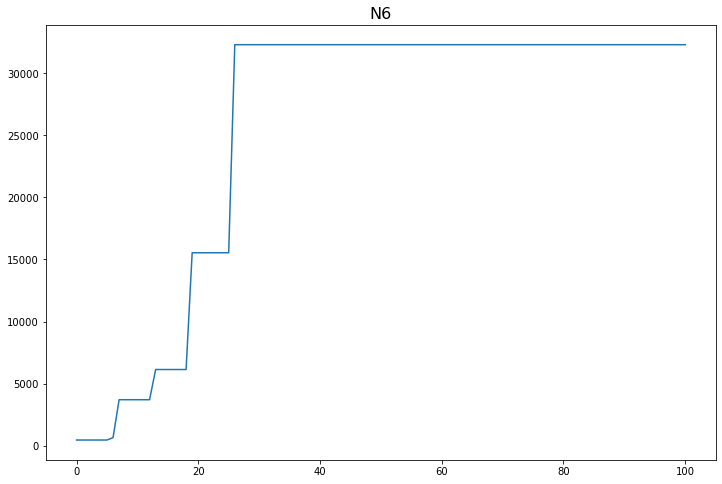

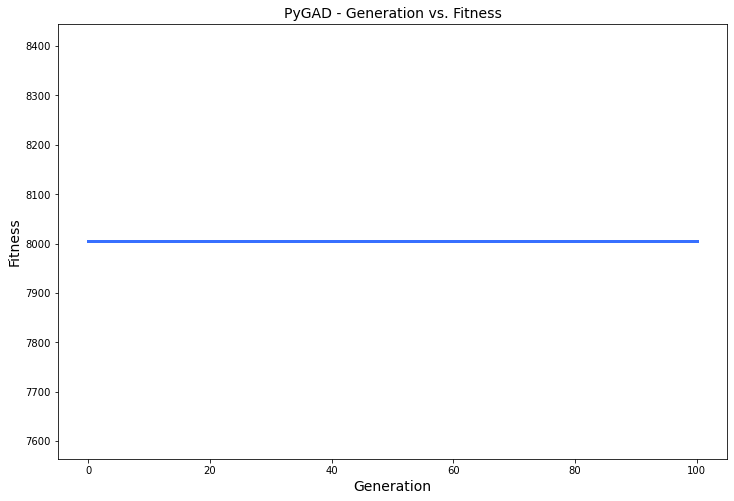

[0.387]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 27.009 |==================| 13.175 |==========
[-0.564]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.564 |===========| 26.974 |==================| 8.994 |==========
[0.866]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.866 |===========| 26.913 |==================| 5.818 |==========
[0.449]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 26.997 |==================| 11.328 |==========
[0.567]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.567 |===========| 26.973 |==================| 8.944 |==========
[-0.851]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 26.916 |==================| 5.92 |==========
[0.663]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.72 |===========| 24.94 |==================| 4.561 |==========
[0.614]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.614 |===========| 24.973 |==================| 5.355 |==========
[0.713]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.713 |===========| 24.942 |==================| 4.603 |==========
[0.587]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.587 |===========| 24.981 |==================| 5.603 |==========
[0.001]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 25.159 |==================| 5419.621 |==========
[0.022]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 25.153 |==================| 153.373 |==========
[0.447]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 25.086 |==================| 13.67 |==========
[-0.115]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 25.124 |==================| 28.767 |==========
Fitness = 5419.620864436249
[0.587]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.587 |===========| 24.981 |==================| 5.603 |==========
[0.001]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 25.159 |==================| 5419.621 |==========
[0.022]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 25.153 |==================| 153.373 |==========
[0.447]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 25.024 |==================| 7.376 |==========
[-0.034]
=====|SOLUTION|===========|OUTPUT|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 25.124 |==================| 28.767 |==========
[0.587]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.587 |===========| 24.981 |==================| 5.603 |==========
[0.001]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 25.159 |==================| 5419.621 |==========
[0.022]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 25.153 |==================| 153.373 |==========
[0.447]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 25.024 |==================| 7.376 |==========
[-0.034]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 25.149 |==================| 96.595 |==========
[0.414]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.823 |===========| 24.908 |==================| 3.981 |==========
[-0.429]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 25.029 |==================| 7.682 |==========
Generation = 2
[0.001]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 25.159 |==================| 3678.033 |==========
[-0.905]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 24.883 |==================| 3.618 |==========
[-0.362]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 25.05 |==================| 9.117 |==========
[-0.811]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.811 |===========| 24.912 |==================| 4.042 |==========
[-0.718]
=====|SOLUTION|===========|OUTPUT|==================|F

======| 0.704 |===========| 24.945 |==================| 4.665 |==========
[-0.823]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.823 |===========| 24.908 |==================| 3.981 |==========
[-0.429]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 25.029 |==================| 7.682 |==========
Change = 0.0
[0.001]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 25.159 |==================| 3678.033 |==========
[-0.905]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 24.883 |==================| 3.618 |==========
[-0.362]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 25.05 |==================| 9.117 |==========
[-0.811]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.811 |===========| 24.912 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.704 |===========| 24.945 |==================| 4.665 |==========
[-0.823]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.823 |===========| 24.908 |==================| 3.981 |==========
[-0.429]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 25.029 |==================| 7.682 |==========
[0.105]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 25.127 |==================| 31.381 |==========
[0.955]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.955 |===========| 24.867 |==================| 3.425 |==========
[-0.777]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.777 |===========| 24.922 |==================| 4.219 |==========
[-0.813]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 25.158 |==================| 655.291 |==========
[0.745]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.745 |===========| 24.932 |==================| 4.401 |==========
[0.206]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 25.097 |==================| 16.064 |==========
[0.436]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 25.027 |==================| 7.561 |==========
Fitness = 5419.620864436249
[0.105]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 25.127 |==================| 31.381 |==========
[0.955]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.955 |===========| 24.867 |==================| 3.425 |==========
[-0.777]
=====|SOLUTION|===========|OUTPUT|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.62 |===========| 24.971 |==================| 5.298 |==========
[0.005]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 25.158 |==================| 655.291 |==========
[0.745]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.745 |===========| 24.932 |==================| 4.401 |==========
[0.206]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 25.097 |==================| 16.064 |==========
[0.436]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 25.027 |==================| 7.561 |==========
[0.105]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 25.127 |==================| 31.381 |==========
[0.955]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 25.09 |==================| 14.392 |==========
[0.37]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 25.047 |==================| 8.914 |==========
[0.339]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 25.056 |==================| 9.726 |==========
[0.356]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.356 |===========| 25.051 |==================| 9.273 |==========
Generation = 4
[-0.612]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.612 |===========| 24.973 |==================| 5.366 |==========
[-0.767]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 24.925 |==================| 4.277 |==========
[0.323]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 25.09 |==================| 14.392 |==========
[0.37]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 25.047 |==================| 8.914 |==========
[0.339]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 25.056 |==================| 9.726 |==========
[0.356]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.356 |===========| 25.051 |==================| 9.273 |==========
Change = 0.0
[-0.612]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.612 |===========| 24.973 |==================| 5.366 |==========
[-0.767]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 24.925 |==================| 4.277 |==========
[0.323]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 25.09 |==================| 14.392 |==========
[0.37]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 25.047 |==================| 8.914 |==========
[0.339]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 25.056 |==================| 9.726 |==========
[0.356]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.356 |===========| 25.051 |==================| 9.273 |==========
[-0.784]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.784 |===========| 24.92 |==================| 4.185 |==========
[-0.906]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.906 |===========| 24.882 |==================| 3.612 |==========
[0.326]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

[-0.195]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 25.1 |==================| 16.988 |==========
[-0.504]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 25.006 |==================| 6.534 |==========
Fitness = 5419.620864436249
[-0.784]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.784 |===========| 24.92 |==================| 4.185 |==========
[-0.906]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.906 |===========| 24.882 |==================| 3.612 |==========
[0.326]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 25.061 |==================| 10.135 |==========
[-0.985]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.985 |===========| 24.858 |==================| 3.32 |==========
[0.166]
=====|SOLUTION|===========|OUTPUT|===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 25.1 |==================| 16.988 |==========
[-0.504]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 25.006 |==================| 6.534 |==========
[-0.784]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.784 |===========| 24.92 |==================| 4.185 |==========
[-0.906]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.906 |===========| 24.882 |==================| 3.612 |==========
[0.326]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 25.061 |==================| 10.135 |==========
[-0.985]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.985 |===========| 24.858 |==================| 3.32 |==========
[0.166]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.805 |===========| 24.914 |==================| 4.072 |==========
Generation = 6
[-0.195]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 25.1 |==================| 16.988 |==========
[-0.83]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 24.906 |==================| 3.951 |==========
[0.085]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 25.134 |==================| 39.115 |==========
[-0.538]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.538 |===========| 24.996 |==================| 6.113 |==========
[0.92]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.92 |===========| 24.878 |==================| 3.559 |==========
[-0.881]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 25.1 |==================| 16.988 |==========
[-0.83]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 24.906 |==================| 3.951 |==========
[0.085]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 25.134 |==================| 39.115 |==========
[-0.538]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.538 |===========| 24.996 |==================| 6.113 |==========
[0.92]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.92 |===========| 24.878 |==================| 3.559 |==========
[-0.881]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.881 |===========| 24.89 |==================| 3.716 |==========
[0.495]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.901 |===========| 24.884 |==================| 3.633 |==========
[-0.225]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 25.091 |==================| 14.706 |==========
[0.263]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 25.08 |==================| 12.579 |==========
[0.76]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.76 |===========| 24.927 |==================| 4.313 |==========
[-0.984]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.984 |===========| 24.858 |==================| 3.322 |==========
[0.579]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 24.983 |==================| 5.677 |==========
[-0.272]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.901 |===========| 24.884 |==================| 3.633 |==========
[-0.225]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 25.091 |==================| 14.706 |==========
[0.263]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 25.08 |==================| 12.579 |==========
[0.76]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.76 |===========| 24.927 |==================| 4.313 |==========
[-0.984]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.984 |===========| 24.858 |==================| 3.322 |==========
[0.579]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 24.983 |==================| 5.677 |==========
[-0.272]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 25.091 |==================| 14.706 |==========
[0.263]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 25.08 |==================| 12.579 |==========
[0.76]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.76 |===========| 24.927 |==================| 4.313 |==========
[-0.984]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.984 |===========| 24.858 |==================| 3.322 |==========
[0.579]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 24.983 |==================| 5.677 |==========
[-0.272]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 25.077 |==================| 12.15 |==========
[0.096]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.785 |===========| 24.92 |==================| 4.18 |==========
[0.665]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.665 |===========| 24.957 |==================| 4.941 |==========
[0.179]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 25.105 |==================| 18.42 |==========
[-0.496]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 25.008 |==================| 6.633 |==========
[-0.941]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.941 |===========| 24.872 |==================| 3.479 |==========
[0.521]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.521 |===========| 25.001 |==================| 6.317 |==========
[-0.902]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 24.938 |==================| 4.511 |==========
[-0.785]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.785 |===========| 24.92 |==================| 4.18 |==========
[0.665]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.665 |===========| 24.957 |==================| 4.941 |==========
[0.179]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 25.105 |==================| 18.42 |==========
[-0.496]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 25.008 |==================| 6.633 |==========
[-0.941]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.941 |===========| 24.872 |==================| 3.479 |==========
[0.521]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.663 |===========| 24.957 |==================| 4.953 |==========
[0.397]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.397 |===========| 25.039 |==================| 8.308 |==========
[0.311]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 25.065 |==================| 10.609 |==========
[-0.251]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 25.083 |==================| 13.137 |==========
[0.594]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.594 |===========| 24.979 |==================| 5.536 |==========
[-0.767]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 24.925 |==================| 4.276 |==========
[-0.484]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.397 |===========| 25.039 |==================| 8.308 |==========
[0.311]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 25.065 |==================| 10.609 |==========
[-0.251]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 25.083 |==================| 13.137 |==========
[0.594]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.594 |===========| 24.979 |==================| 5.536 |==========
[-0.767]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 24.925 |==================| 4.276 |==========
[-0.484]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 25.012 |==================| 6.802 |==========
[-0.592]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 25.065 |==================| 10.609 |==========
[-0.251]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 25.083 |==================| 13.137 |==========
[0.594]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.594 |===========| 24.979 |==================| 5.536 |==========
[-0.767]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 24.925 |==================| 4.276 |==========
[-0.484]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 25.012 |==================| 6.802 |==========
[-0.592]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.592 |===========| 24.979 |==================| 5.557 |==========
[0.071]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 25.086 |==================| 13.743 |==========
[-0.165]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 25.109 |==================| 20.044 |==========
[-0.89]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.89 |===========| 24.888 |==================| 3.681 |==========
[0.81]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.81 |===========| 24.912 |==================| 4.044 |==========
[0.142]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.142 |===========| 25.116 |==================| 23.365 |==========
[-0.886]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.886 |===========| 24.889 |==================| 3.695 |==========
[-0.686]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

[-0.165]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 25.109 |==================| 20.044 |==========
[-0.89]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.89 |===========| 24.888 |==================| 3.681 |==========
[0.81]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.81 |===========| 24.912 |==================| 4.044 |==========
[0.142]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.142 |===========| 25.116 |==================| 23.365 |==========
[-0.886]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.886 |===========| 24.889 |==================| 3.695 |==========
[-0.686]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 24.95 |==================| 4.783 |==========
[0.3]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.508 |===========| 25.005 |==================| 6.478 |==========
[-0.816]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.816 |===========| 24.91 |==================| 4.018 |==========
[-0.371]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 25.047 |==================| 8.89 |==========
[0.436]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 25.027 |==================| 7.553 |==========
[-0.614]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.614 |===========| 24.972 |==================| 5.353 |==========
[0.575]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 24.984 |==================| 5.718 |==========
[0.895]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.508 |===========| 25.005 |==================| 6.478 |==========
[-0.816]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.816 |===========| 24.91 |==================| 4.018 |==========
[-0.371]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 25.047 |==================| 8.89 |==========
[0.436]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 25.027 |==================| 7.553 |==========
[-0.614]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.614 |===========| 24.972 |==================| 5.353 |==========
[0.575]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 24.984 |==================| 5.718 |==========
[0.895]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

[-0.508]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.508 |===========| 25.005 |==================| 6.478 |==========
[-0.816]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.816 |===========| 24.91 |==================| 4.018 |==========
[-0.371]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 25.047 |==================| 8.89 |==========
[0.436]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 25.027 |==================| 7.553 |==========
[-0.614]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.614 |===========| 24.972 |==================| 5.353 |==========
[0.575]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 24.984 |==================| 5.718 |==========
[0.895]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 25.049 |==================| 9.036 |==========
[0.907]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.907 |===========| 24.882 |==================| 3.608 |==========
[0.49]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 25.01 |==================| 6.719 |==========
[-0.161]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 25.11 |==================| 20.485 |==========
[0.396]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 25.039 |==================| 8.324 |==========
[-0.717]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.717 |===========| 24.941 |==================| 4.576 |==========
[-0.07]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.142 |===========| 25.116 |==================| 23.251 |==========
[0.365]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 25.049 |==================| 9.036 |==========
[0.907]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.907 |===========| 24.882 |==================| 3.608 |==========
[0.49]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 25.01 |==================| 6.719 |==========
[-0.161]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 25.11 |==================| 20.485 |==========
[0.396]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 25.039 |==================| 8.324 |==========
[-0.717]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 25.092 |==================| 14.962 |==========
[0.601]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 24.977 |==================| 5.473 |==========
[-0.972]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.972 |===========| 24.862 |==================| 3.364 |==========
[0.682]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.682 |===========| 24.952 |==================| 4.817 |==========
[-0.495]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 25.009 |==================| 6.645 |==========
[0.392]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 25.04 |==================| 8.416 |==========
[0.24]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 25.092 |==================| 14.962 |==========
[0.601]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 24.977 |==================| 5.473 |==========
[-0.972]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.972 |===========| 24.862 |==================| 3.364 |==========
[0.682]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.682 |===========| 24.952 |==================| 4.817 |==========
[-0.495]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 25.009 |==================| 6.645 |==========
[0.392]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 25.04 |==================| 8.416 |==========
[0.24]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 25.092 |==================| 14.962 |==========
[0.601]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 24.977 |==================| 5.473 |==========
[-0.972]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.972 |===========| 24.862 |==================| 3.364 |==========
[0.682]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.682 |===========| 24.952 |==================| 4.817 |==========
[-0.495]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 25.009 |==================| 6.645 |==========
[0.392]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 25.04 |==================| 8.416 |==========
[0.24]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 25.09 |==================| 14.357 |==========
[0.938]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 24.873 |==================| 3.49 |==========
[0.204]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 25.097 |==================| 16.171 |==========
[0.44]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 25.026 |==================| 7.488 |==========
[-0.248]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 25.084 |==================| 13.305 |==========
[-0.105]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 25.128 |==================| 31.5 |==========
[-0.393]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.904 |===========| 24.883 |==================| 3.621 |==========
[0.23]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 25.09 |==================| 14.357 |==========
[0.938]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 24.873 |==================| 3.49 |==========
[0.204]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 25.097 |==================| 16.171 |==========
[0.44]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 25.026 |==================| 7.488 |==========
[-0.248]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 25.084 |==================| 13.305 |==========
[-0.105]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.626 |===========| 24.969 |==================| 5.248 |==========
[0.516]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 25.002 |==================| 6.373 |==========
[0.349]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 25.053 |==================| 9.444 |==========
[0.372]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 25.046 |==================| 8.865 |==========
[-0.287]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 25.072 |==================| 11.522 |==========
[0.561]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.561 |===========| 24.989 |==================| 5.861 |==========
[-0.104]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.626 |===========| 24.969 |==================| 5.248 |==========
[0.516]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 25.002 |==================| 6.373 |==========
[0.349]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 25.053 |==================| 9.444 |==========
[0.372]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 25.046 |==================| 8.865 |==========
[-0.287]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 25.072 |==================| 11.522 |==========
[0.561]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.561 |===========| 24.989 |==================| 5.861 |==========
[-0.104]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 25.002 |==================| 6.373 |==========
[0.349]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 25.053 |==================| 9.444 |==========
[0.372]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 25.046 |==================| 8.865 |==========
[-0.287]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 25.072 |==================| 11.522 |==========
[0.561]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.561 |===========| 24.989 |==================| 5.861 |==========
[-0.104]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 25.128 |==================| 31.949 |==========
[0.031]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 25.092 |==================| 14.95 |==========
[0.44]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 25.026 |==================| 7.483 |==========
[-0.669]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.669 |===========| 24.955 |==================| 4.908 |==========
[-0.593]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.593 |===========| 24.979 |==================| 5.54 |==========
[0.095]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 25.13 |==================| 34.713 |==========
[-0.406]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.406 |===========| 25.036 |==================| 8.12 |==========
[0.016]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.934 |===========| 24.874 |==================| 3.504 |==========
[0.221]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 25.092 |==================| 14.95 |==========
[0.44]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 25.026 |==================| 7.483 |==========
[-0.669]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.669 |===========| 24.955 |==================| 4.908 |==========
[-0.593]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.593 |===========| 24.979 |==================| 5.54 |==========
[0.095]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 25.13 |==================| 34.713 |==========
[-0.406]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.915 |===========| 24.88 |==================| 3.578 |==========
[0.205]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 25.097 |==================| 16.094 |==========
[-0.061]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.061 |===========| 25.141 |==================| 54.618 |==========
[0.166]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 25.109 |==================| 19.872 |==========
[0.496]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 25.008 |==================| 6.631 |==========
[-0.214]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 25.094 |==================| 15.437 |==========
[-0.224]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 25.062 |==================| 10.305 |==========
[0.915]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.915 |===========| 24.88 |==================| 3.578 |==========
[0.205]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 25.097 |==================| 16.094 |==========
[-0.061]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.061 |===========| 25.141 |==================| 54.618 |==========
[0.166]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 25.109 |==================| 19.872 |==========
[0.496]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 25.008 |==================| 6.631 |==========
[-0.214]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 25.062 |==================| 10.305 |==========
[0.915]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.915 |===========| 24.88 |==================| 3.578 |==========
[0.205]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 25.097 |==================| 16.094 |==========
[-0.061]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.061 |===========| 25.141 |==================| 54.618 |==========
[0.166]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 25.109 |==================| 19.872 |==========
[0.496]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 25.008 |==================| 6.631 |==========
[-0.214]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.6 |===========| 24.977 |==================| 5.481 |==========
[0.885]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.885 |===========| 24.889 |==================| 3.701 |==========
[0.643]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.643 |===========| 24.964 |==================| 5.11 |==========
[0.153]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 25.113 |==================| 21.574 |==========
[-0.196]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 25.1 |==================| 16.823 |==========
[0.247]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 25.084 |==================| 13.363 |==========
[0.623]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.6 |===========| 24.977 |==================| 5.481 |==========
[0.885]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.885 |===========| 24.889 |==================| 3.701 |==========
[0.643]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.643 |===========| 24.964 |==================| 5.11 |==========
[0.153]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 25.113 |==================| 21.574 |==========
[-0.196]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 25.1 |==================| 16.823 |==========
[0.247]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 25.084 |==================| 13.363 |==========
[0.623]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 25.026 |==================| 7.488 |==========
[-0.808]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.808 |===========| 24.913 |==================| 4.055 |==========
[-0.478]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 25.014 |==================| 6.891 |==========
[-0.163]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 25.11 |==================| 20.324 |==========
[0.257]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 25.082 |==================| 12.875 |==========
[-0.582]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.582 |===========| 24.982 |==================| 5.652 |==========
[0.254]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 25.026 |==================| 7.488 |==========
[-0.808]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.808 |===========| 24.913 |==================| 4.055 |==========
[-0.478]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 25.014 |==================| 6.891 |==========
[-0.163]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 25.11 |==================| 20.324 |==========
[0.257]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 25.082 |==================| 12.875 |==========
[-0.582]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.582 |===========| 24.982 |==================| 5.652 |==========
[0.254]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 25.026 |==================| 7.488 |==========
[-0.808]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.808 |===========| 24.913 |==================| 4.055 |==========
[-0.478]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 25.014 |==================| 6.891 |==========
[-0.163]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 25.11 |==================| 20.324 |==========
[0.257]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 25.082 |==================| 12.875 |==========
[-0.582]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.582 |===========| 24.982 |==================| 5.652 |==========
[0.254]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.802 |===========| 24.914 |==================| 4.086 |==========
[-0.069]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 25.138 |==================| 47.683 |==========
[-0.205]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 25.097 |==================| 16.156 |==========
[-0.495]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 25.009 |==================| 6.65 |==========
[-0.958]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.958 |===========| 24.866 |==================| 3.414 |==========
[-0.767]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 24.926 |==================| 4.278 |==========
[0.57]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

[-0.069]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 25.138 |==================| 47.683 |==========
[-0.205]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 25.097 |==================| 16.156 |==========
[-0.495]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 25.009 |==================| 6.65 |==========
[-0.958]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.958 |===========| 24.866 |==================| 3.414 |==========
[-0.767]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 24.926 |==================| 4.278 |==========
[0.57]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.57 |===========| 24.986 |==================| 5.773 |==========
[0.203]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 25.124 |==================| 28.114 |==========
[0.602]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.602 |===========| 24.976 |==================| 5.458 |==========
[-0.669]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.669 |===========| 24.956 |==================| 4.91 |==========
[-0.919]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.919 |===========| 24.879 |==================| 3.563 |==========
[0.069]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 25.138 |==================| 48.145 |==========
[0.313]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 25.064 |==================| 10.535 |==========
[-0.068]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 25.124 |==================| 28.114 |==========
[0.602]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.602 |===========| 24.976 |==================| 5.458 |==========
[-0.669]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.669 |===========| 24.956 |==================| 4.91 |==========
[-0.919]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.919 |===========| 24.879 |==================| 3.563 |==========
[0.069]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 25.138 |==================| 48.145 |==========
[0.313]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 25.064 |==================| 10.535 |==========
[-0.068]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.646 |===========| 24.963 |==================| 5.085 |==========
[0.118]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 25.124 |==================| 28.114 |==========
[0.602]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.602 |===========| 24.976 |==================| 5.458 |==========
[-0.669]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.669 |===========| 24.956 |==================| 4.91 |==========
[-0.919]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.919 |===========| 24.879 |==================| 3.563 |==========
[0.069]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 25.138 |==================| 48.145 |==========
[0.313]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.676 |===========| 24.954 |==================| 4.86 |==========
[-0.299]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 25.069 |==================| 11.035 |==========
[-0.112]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.112 |===========| 25.125 |==================| 29.49 |==========
[0.181]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 25.104 |==================| 18.239 |==========
[-0.25]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 25.084 |==================| 13.224 |==========
[0.197]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 25.1 |==================| 16.763 |==========
[-0.584]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.986 |===========| 24.858 |==================| 3.316 |==========
[-0.676]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.676 |===========| 24.954 |==================| 4.86 |==========
[-0.299]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 25.069 |==================| 11.035 |==========
[-0.112]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.112 |===========| 25.125 |==================| 29.49 |==========
[0.181]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 25.104 |==================| 18.239 |==========
[-0.25]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 25.084 |==================| 13.224 |==========
[0.197]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 25.131 |==================| 35.081 |==========
[0.665]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.665 |===========| 24.957 |==================| 4.939 |==========
[0.504]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 25.006 |==================| 6.525 |==========
[0.702]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.702 |===========| 24.946 |==================| 4.679 |==========
[-0.698]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.698 |===========| 24.947 |==================| 4.701 |==========
[-0.116]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 25.124 |==================| 28.487 |==========
[0.327]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.583 |===========| 24.982 |==================| 5.64 |==========
[0.094]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 25.131 |==================| 35.081 |==========
[0.665]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.665 |===========| 24.957 |==================| 4.939 |==========
[0.504]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 25.006 |==================| 6.525 |==========
[0.702]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.702 |===========| 24.946 |==================| 4.679 |==========
[-0.698]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.698 |===========| 24.947 |==================| 4.701 |==========
[-0.116]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 25.131 |==================| 35.081 |==========
[0.665]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.665 |===========| 24.957 |==================| 4.939 |==========
[0.504]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 25.006 |==================| 6.525 |==========
[0.702]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.702 |===========| 24.946 |==================| 4.679 |==========
[-0.698]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.698 |===========| 24.947 |==================| 4.701 |==========
[-0.116]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 25.124 |==================| 28.487 |==========
[0.327]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.518 |===========| 25.002 |==================| 6.356 |==========
[0.306]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.306 |===========| 25.067 |==================| 10.789 |==========
[-0.55]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.55 |===========| 24.992 |==================| 5.977 |==========
[0.865]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 24.895 |==================| 3.789 |==========
[-0.454]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 25.021 |==================| 7.253 |==========
[-0.574]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.574 |===========| 24.985 |==================| 5.724 |==========
[0.792]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.716 |===========| 24.941 |==================| 4.584 |==========
[0.518]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.518 |===========| 25.002 |==================| 6.356 |==========
[0.306]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.306 |===========| 25.067 |==================| 10.789 |==========
[-0.55]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.55 |===========| 24.992 |==================| 5.977 |==========
[0.865]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 24.895 |==================| 3.789 |==========
[-0.454]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 25.021 |==================| 7.253 |==========
[-0.574]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.734 |===========| 24.936 |==================| 4.473 |==========
[-0.314]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.314 |===========| 25.064 |==================| 10.523 |==========
[0.035]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 25.149 |==================| 93.451 |==========
[-0.647]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.647 |===========| 24.962 |==================| 5.077 |==========
[0.661]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.661 |===========| 24.958 |==================| 4.972 |==========
[-0.368]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 25.048 |==================| 8.956 |==========
[0.571]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 25.144 |==================| 65.271 |==========
[0.734]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.734 |===========| 24.936 |==================| 4.473 |==========
[-0.314]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.314 |===========| 25.064 |==================| 10.523 |==========
[0.035]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 25.149 |==================| 93.451 |==========
[-0.647]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.647 |===========| 24.962 |==================| 5.077 |==========
[0.661]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.661 |===========| 24.958 |==================| 4.972 |==========
[-0.368]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

[-0.051]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 25.144 |==================| 65.271 |==========
[0.734]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.734 |===========| 24.936 |==================| 4.473 |==========
[-0.314]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.314 |===========| 25.064 |==================| 10.523 |==========
[0.035]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 25.149 |==================| 93.451 |==========
[-0.647]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.647 |===========| 24.962 |==================| 5.077 |==========
[0.661]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.661 |===========| 24.958 |==================| 4.972 |==========
[-0.368]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 25.027 |==================| 7.586 |==========
[0.851]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 24.9 |==================| 3.851 |==========
[0.203]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 25.098 |==================| 16.321 |==========
[0.291]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 25.071 |==================| 11.33 |==========
[0.238]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.238 |===========| 25.087 |==================| 13.88 |==========
[0.761]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.761 |===========| 24.927 |==================| 4.309 |==========
[-0.143]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

[-0.434]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 25.027 |==================| 7.586 |==========
[0.851]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 24.9 |==================| 3.851 |==========
[0.203]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 25.098 |==================| 16.321 |==========
[0.291]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 25.071 |==================| 11.33 |==========
[0.238]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.238 |===========| 25.087 |==================| 13.88 |==========
[0.761]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.761 |===========| 24.927 |==================| 4.309 |==========
[-0.143]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 25.137 |==================| 45.534 |==========
[-0.523]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.523 |===========| 25.0 |==================| 6.292 |==========
[0.746]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.746 |===========| 24.932 |==================| 4.398 |==========
[-0.535]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.535 |===========| 24.997 |==================| 6.155 |==========
[0.034]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 25.149 |==================| 96.271 |==========
[-0.598]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.598 |===========| 24.977 |==================| 5.493 |==========
[0.856]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 25.086 |==================| 13.678 |==========
[-0.073]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 25.137 |==================| 45.534 |==========
[-0.523]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.523 |===========| 25.0 |==================| 6.292 |==========
[0.746]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.746 |===========| 24.932 |==================| 4.398 |==========
[-0.535]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.535 |===========| 24.997 |==================| 6.155 |==========
[0.034]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 25.149 |==================| 96.271 |==========
[-0.598]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.997 |===========| 24.854 |==================| 3.28 |==========
[-0.242]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 25.086 |==================| 13.678 |==========
[-0.073]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 25.137 |==================| 45.534 |==========
[-0.523]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.523 |===========| 25.0 |==================| 6.292 |==========
[0.746]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.746 |===========| 24.932 |==================| 4.398 |==========
[-0.535]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.535 |===========| 24.997 |==================| 6.155 |==========
[0.034]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.624 |===========| 24.969 |==================| 5.27 |==========
Generation = 28
[0.729]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.729 |===========| 24.937 |==================| 4.504 |==========
[-0.94]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.94 |===========| 24.872 |==================| 3.481 |==========
[0.479]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 25.014 |==================| 6.879 |==========
[-0.353]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 25.052 |==================| 9.337 |==========
[-0.133]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 25.119 |==================| 24.944 |==========
[0.045]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 25.138 |==================| 47.674 |==========
[0.624]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.624 |===========| 24.969 |==================| 5.27 |==========
Change = 0.0
[0.729]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.729 |===========| 24.937 |==================| 4.504 |==========
[-0.94]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.94 |===========| 24.872 |==================| 3.481 |==========
[0.479]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 25.014 |==================| 6.879 |==========
[-0.353]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 25.052 |==================| 9.337 |==========
[-0.133]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.675 |===========| 24.954 |==================| 4.868 |==========
[-0.069]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 25.138 |==================| 47.674 |==========
[0.624]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.624 |===========| 24.969 |==================| 5.27 |==========
[0.843]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.843 |===========| 24.902 |==================| 3.887 |==========
[0.238]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.238 |===========| 25.087 |==================| 13.908 |==========
[-0.929]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.929 |===========| 24.875 |==================| 3.521 |==========
[0.495]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.854 |===========| 24.899 |==================| 3.837 |==========
[-0.464]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 25.018 |==================| 7.104 |==========
Fitness = 5419.620864436249
[0.843]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.843 |===========| 24.902 |==================| 3.887 |==========
[0.238]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.238 |===========| 25.087 |==================| 13.908 |==========
[-0.929]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.929 |===========| 24.875 |==================| 3.521 |==========
[0.495]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 25.009 |==================| 6.653 |==========
[-0.599]
=====|SOLUTION|===========|OUTPUT|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 25.018 |==================| 7.104 |==========
[0.843]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.843 |===========| 24.902 |==================| 3.887 |==========
[0.238]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.238 |===========| 25.087 |==================| 13.908 |==========
[-0.929]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.929 |===========| 24.875 |==================| 3.521 |==========
[0.495]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 25.009 |==================| 6.653 |==========
[-0.599]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.599 |===========| 24.977 |==================| 5.488 |==========
[0.575]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

[-0.399]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 25.038 |==================| 8.263 |==========
[0.28]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 25.075 |==================| 11.802 |==========
Generation = 30
[-0.628]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.628 |===========| 24.968 |==================| 5.235 |==========
[-0.812]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.812 |===========| 24.912 |==================| 4.039 |==========
[0.803]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.803 |===========| 24.914 |==================| 4.084 |==========
[-0.666]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 24.956 |==================| 4.931 |==========
[0.408]
=====|SOLUTION|===========|OUTPUT|===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 25.087 |==================| 13.933 |==========
[-0.399]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 25.038 |==================| 8.263 |==========
[0.28]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 25.075 |==================| 11.802 |==========
Change = 0.0
[-0.628]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.628 |===========| 24.968 |==================| 5.235 |==========
[-0.812]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.812 |===========| 24.912 |==================| 4.039 |==========
[0.803]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.803 |===========| 24.914 |==================| 4.084 |==========
[-0.666]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 25.091 |==================| 14.601 |==========
[0.237]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 25.087 |==================| 13.933 |==========
[-0.399]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 25.038 |==================| 8.263 |==========
[0.28]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 25.075 |==================| 11.802 |==========
[0.95]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 24.869 |==================| 3.446 |==========
[0.966]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.966 |===========| 24.864 |==================| 3.385 |==========
[-0.226]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 25.044 |==================| 8.665 |==========
[0.165]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 25.109 |==================| 20.002 |==========
[-0.604]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.604 |===========| 24.976 |==================| 5.446 |==========
[0.71]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.71 |===========| 24.943 |==================| 4.622 |==========
Fitness = 5419.620864436249
[0.95]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 24.869 |==================| 3.446 |==========
[0.966]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.966 |===========| 24.864 |==================| 3.385 |==========
[-0.226]
=====|SOLUTION|===========|OUTPUT|================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 25.044 |==================| 8.665 |==========
[0.165]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 25.109 |==================| 20.002 |==========
[-0.604]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.604 |===========| 24.976 |==================| 5.446 |==========
[0.71]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.71 |===========| 24.943 |==================| 4.622 |==========
[0.95]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 24.869 |==================| 3.446 |==========
[0.966]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.966 |===========| 24.864 |==================| 3.385 |==========
[-0.226]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.568 |===========| 24.986 |==================| 5.789 |==========
[0.278]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 25.075 |==================| 11.864 |==========
[-0.034]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 25.149 |==================| 98.716 |==========
Generation = 32
[0.02]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 25.153 |==================| 162.957 |==========
[-0.049]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 25.144 |==================| 67.617 |==========
[0.295]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.295 |===========| 25.07 |==================| 11.174 |==========
[0.582]
=====|SOLUTION|===========|OUTPUT|==================|FI

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.568 |===========| 24.986 |==================| 5.789 |==========
[0.278]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 25.075 |==================| 11.864 |==========
[-0.034]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 25.149 |==================| 98.716 |==========
Change = 0.0
[0.02]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 25.153 |==================| 162.957 |==========
[-0.049]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 25.144 |==================| 67.617 |==========
[0.295]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.295 |===========| 25.07 |==================| 11.174 |==========
[0.582]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 25.157 |==================| 482.698 |==========
[0.568]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.568 |===========| 24.986 |==================| 5.789 |==========
[0.278]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 25.075 |==================| 11.864 |==========
[-0.034]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 25.149 |==================| 98.716 |==========
[0.03]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 25.15 |==================| 108.84 |==========
[-0.569]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.569 |===========| 24.986 |==================| 5.777 |==========
[0.685]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 24.935 |==================| 4.451 |==========
[0.827]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.827 |===========| 24.907 |==================| 3.96 |==========
[-0.312]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 25.065 |==================| 10.585 |==========
[0.285]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.285 |===========| 25.073 |==================| 11.588 |==========
[0.22]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 25.093 |==================| 15.011 |==========
Fitness = 5419.620864436249
[0.03]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 25.15 |==================| 108.84 |==========
[-0.569]
=====|SOLUTION|===========|OUTPUT|==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.827 |===========| 24.907 |==================| 3.96 |==========
[-0.312]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 25.065 |==================| 10.585 |==========
[0.285]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.285 |===========| 25.073 |==================| 11.588 |==========
[0.22]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 25.093 |==================| 15.011 |==========
[0.03]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 25.15 |==================| 108.84 |==========
[-0.569]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.569 |===========| 24.986 |==================| 5.777 |==========
[0.685]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.714 |===========| 24.942 |==================| 4.594 |==========
[0.227]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 25.091 |==================| 14.563 |==========
[-0.14]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 25.117 |==================| 23.621 |==========
[0.117]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 25.124 |==================| 28.296 |==========
Generation = 34
[0.014]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 25.155 |==================| 234.994 |==========
[-0.536]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 24.996 |==================| 6.139 |==========
[0.703]
=====|SOLUTION|===========|OUTPUT|==================|FI

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 25.116 |==================| 22.872 |==========
[-0.714]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.714 |===========| 24.942 |==================| 4.594 |==========
[0.227]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 25.091 |==================| 14.563 |==========
[-0.14]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 25.117 |==================| 23.621 |==========
[0.117]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 25.124 |==================| 28.296 |==========
Change = 0.0
[0.014]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 25.155 |==================| 234.994 |==========
[-0.536]
=====|SOLUTION|===========|OUTPUT|==================|FIT

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.697 |===========| 24.947 |==================| 4.711 |==========
[-0.145]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 25.116 |==================| 22.872 |==========
[-0.714]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.714 |===========| 24.942 |==================| 4.594 |==========
[0.227]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 25.091 |==================| 14.563 |==========
[-0.14]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 25.117 |==================| 23.621 |==========
[0.117]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 25.124 |==================| 28.296 |==========
[-0.301]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.87 |===========| 24.894 |==================| 3.766 |==========
[0.106]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 25.127 |==================| 31.184 |==========
[0.762]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.762 |===========| 24.927 |==================| 4.303 |==========
[0.486]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 25.012 |==================| 6.77 |==========
[0.47]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 25.017 |==================| 7.011 |==========
[0.952]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.952 |===========| 24.868 |==================| 3.435 |==========
[0.77]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.87 |===========| 24.894 |==================| 3.766 |==========
[0.106]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 25.127 |==================| 31.184 |==========
[0.762]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.762 |===========| 24.927 |==================| 4.303 |==========
[0.486]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 25.012 |==================| 6.77 |==========
[0.47]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 25.017 |==================| 7.011 |==========
[0.952]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.952 |===========| 24.868 |==================| 3.435 |==========
[0.77]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.887 |===========| 24.888 |==================| 3.692 |==========
[0.775]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 24.923 |==================| 4.231 |==========
[-0.643]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.643 |===========| 24.964 |==================| 5.112 |==========
[0.89]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.89 |===========| 24.887 |==================| 3.68 |==========
[0.668]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 24.956 |==================| 4.914 |==========
[0.995]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.995 |===========| 24.855 |==================| 3.287 |==========
[-0.237]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 24.923 |==================| 4.231 |==========
[-0.643]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.643 |===========| 24.964 |==================| 5.112 |==========
[0.89]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.89 |===========| 24.887 |==================| 3.68 |==========
[0.668]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 24.956 |==================| 4.914 |==========
[0.995]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.995 |===========| 24.855 |==================| 3.287 |==========
[-0.237]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 25.087 |==================| 13.921 |==========
Change = 0.0
[0.74]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 24.923 |==================| 4.231 |==========
[-0.643]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.643 |===========| 24.964 |==================| 5.112 |==========
[0.89]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.89 |===========| 24.887 |==================| 3.68 |==========
[0.668]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 24.956 |==================| 4.914 |==========
[0.995]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.995 |===========| 24.855 |==================| 3.287 |==========
[-0.237]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 25.087 |==================| 13.921 |==========
[-0.871]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 25.129 |==================| 33.499 |==========
[-0.667]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.667 |===========| 24.956 |==================| 4.924 |==========
[0.533]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.533 |===========| 24.997 |==================| 6.176 |==========
[-0.817]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.817 |===========| 24.91 |==================| 4.012 |==========
[-0.405]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 25.036 |==================| 8.139 |==========
[-0.849]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.849 |===========| 24.9 |==================| 3.861 |==========
[-0.524]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.667 |===========| 24.956 |==================| 4.924 |==========
[0.533]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.533 |===========| 24.997 |==================| 6.176 |==========
[-0.817]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.817 |===========| 24.91 |==================| 4.012 |==========
[-0.405]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 25.036 |==================| 8.139 |==========
[-0.849]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.849 |===========| 24.9 |==================| 3.861 |==========
[-0.524]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.524 |===========| 25.0 |==================| 6.277 |==========
[-0.871]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 24.903 |==================| 3.91 |==========
[-0.536]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 24.996 |==================| 6.136 |==========
[-0.764]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.764 |===========| 24.926 |==================| 4.292 |==========
[-0.72]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.72 |===========| 24.94 |==================| 4.556 |==========
Generation = 38
[0.979]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.979 |===========| 24.86 |==================| 3.339 |==========
[-0.339]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 25.056 |==================| 9.726 |==========
[-0.395]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 25.097 |==================| 16.093 |==========
[0.838]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 24.903 |==================| 3.91 |==========
[-0.536]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 24.996 |==================| 6.136 |==========
[-0.764]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.764 |===========| 24.926 |==================| 4.292 |==========
[-0.72]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.72 |===========| 24.94 |==================| 4.556 |==========
Change = 0.0
[0.979]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.979 |===========| 24.86 |==================| 3.339 |==========
[-0.339]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.711 |===========| 24.943 |==================| 4.618 |==========
[-0.205]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 25.097 |==================| 16.093 |==========
[0.838]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 24.903 |==================| 3.91 |==========
[-0.536]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 24.996 |==================| 6.136 |==========
[-0.764]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.764 |===========| 24.926 |==================| 4.292 |==========
[-0.72]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.72 |===========| 24.94 |==================| 4.556 |==========
[0.361]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.061 |===========| 25.141 |==================| 54.146 |==========
[-0.002]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 25.159 |==================| 1382.823 |==========
[-0.002]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 25.159 |==================| 2159.795 |==========
[-0.152]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 25.113 |==================| 21.75 |==========
[0.31]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 25.065 |==================| 10.629 |==========
[0.527]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.527 |===========| 24.999 |==================| 6.248 |==========
[0.018]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.061 |===========| 25.141 |==================| 54.146 |==========
[-0.002]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 25.159 |==================| 1382.823 |==========
[-0.002]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 25.159 |==================| 2159.795 |==========
[-0.152]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 25.113 |==================| 21.75 |==========
[0.31]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 25.065 |==================| 10.629 |==========
[0.527]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.527 |===========| 24.999 |==================| 6.248 |==========
[0.018]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 25.155 |==================| 244.678 |==========
[0.318]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 25.063 |==================| 10.376 |==========
[0.752]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 24.93 |==================| 4.362 |==========
[-0.179]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 25.105 |==================| 18.51 |==========
[0.483]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 25.012 |==================| 6.812 |==========
[0.723]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.723 |===========| 24.939 |==================| 4.537 |==========
[-0.729]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.996 |===========| 24.855 |==================| 3.283 |==========
[-0.014]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 25.155 |==================| 244.678 |==========
[0.318]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 25.063 |==================| 10.376 |==========
[0.752]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 24.93 |==================| 4.362 |==========
[-0.179]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 25.105 |==================| 18.51 |==========
[0.483]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 25.012 |==================| 6.812 |==========
[0.723]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 25.155 |==================| 244.678 |==========
[0.318]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 25.063 |==================| 10.376 |==========
[0.752]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 24.93 |==================| 4.362 |==========
[-0.179]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 25.105 |==================| 18.51 |==========
[0.483]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 25.012 |==================| 6.812 |==========
[0.723]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.723 |===========| 24.939 |==================| 4.537 |==========
[-0.729]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.62 |===========| 24.971 |==================| 5.301 |==========
[-0.529]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.529 |===========| 24.998 |==================| 6.221 |==========
[-0.19]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 25.102 |==================| 17.416 |==========
[0.331]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 25.059 |==================| 9.973 |==========
[0.548]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.548 |===========| 24.993 |==================| 5.999 |==========
[-0.616]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.616 |===========| 24.972 |==================| 5.337 |==========
[-0.206]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.875 |===========| 24.892 |==================| 3.743 |==========
[0.62]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.62 |===========| 24.971 |==================| 5.301 |==========
[-0.529]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.529 |===========| 24.998 |==================| 6.221 |==========
[-0.19]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 25.102 |==================| 17.416 |==========
[0.331]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 25.059 |==================| 9.973 |==========
[0.548]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.548 |===========| 24.993 |==================| 5.999 |==========
[-0.616]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.697 |===========| 24.947 |==================| 4.709 |==========
[-0.425]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 25.03 |==================| 7.751 |==========
[-0.459]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 25.02 |==================| 7.171 |==========
[0.08]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 25.135 |==================| 41.563 |==========
[0.15]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 25.114 |==================| 22.069 |==========
[0.088]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 25.133 |==================| 37.705 |==========
[-0.276]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 25.03 |==================| 7.751 |==========
[-0.459]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 25.02 |==================| 7.171 |==========
[0.08]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 25.135 |==================| 41.563 |==========
[0.15]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 25.114 |==================| 22.069 |==========
[0.088]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 25.133 |==================| 37.705 |==========
[-0.276]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 25.076 |==================| 11.984 |==========
Change = 0.0
[-0.648]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 25.02 |==================| 7.171 |==========
[0.08]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 25.135 |==================| 41.563 |==========
[0.15]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 25.114 |==================| 22.069 |==========
[0.088]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 25.133 |==================| 37.705 |==========
[-0.276]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 25.076 |==================| 11.984 |==========
[-0.728]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.728 |===========| 24.937 |==================| 4.508 |==========
[-0.788]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 25.074 |==================| 11.789 |==========
[-0.755]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.755 |===========| 24.929 |==================| 4.345 |==========
[-0.571]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.571 |===========| 24.985 |==================| 5.755 |==========
[0.835]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.835 |===========| 24.904 |==================| 3.922 |==========
Fitness = 5419.620864436249
[-0.728]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.728 |===========| 24.937 |==================| 4.508 |==========
[-0.788]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.788 |===========| 24.919 |==================| 4.159 |==========
[0.688]
=====|SOLUTION|===========|OUTPUT|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.755 |===========| 24.929 |==================| 4.345 |==========
[-0.571]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.571 |===========| 24.985 |==================| 5.755 |==========
[0.835]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.835 |===========| 24.904 |==================| 3.922 |==========
[-0.728]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.728 |===========| 24.937 |==================| 4.508 |==========
[-0.788]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.788 |===========| 24.919 |==================| 4.159 |==========
[0.688]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.688 |===========| 24.95 |==================| 4.772 |==========
[-0.205]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 25.087 |==================| 13.773 |==========
[0.06]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 25.141 |==================| 54.969 |==========
[-0.584]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.584 |===========| 24.982 |==================| 5.628 |==========
Generation = 44
[0.27]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 25.077 |==================| 12.213 |==========
[-0.284]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.284 |===========| 25.073 |==================| 11.614 |==========
[0.229]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 25.09 |==================| 14.407 |==========
[0.095]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 25.057 |==================| 9.805 |==========
[-0.24]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 25.087 |==================| 13.773 |==========
[0.06]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 25.141 |==================| 54.969 |==========
[-0.584]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.584 |===========| 24.982 |==================| 5.628 |==========
Change = 0.0
[0.27]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 25.077 |==================| 12.213 |==========
[-0.284]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.284 |===========| 25.073 |==================| 11.614 |==========
[0.229]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 25.087 |==================| 13.773 |==========
[0.06]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 25.141 |==================| 54.969 |==========
[-0.584]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.584 |===========| 24.982 |==================| 5.628 |==========
[0.211]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 25.095 |==================| 15.629 |==========
[0.671]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.671 |===========| 24.955 |==================| 4.892 |==========
[0.167]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 25.109 |==================| 19.78 |==========
[-0.906]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.561 |===========| 24.989 |==================| 5.867 |==========
[0.032]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 25.15 |==================| 105.051 |==========
Fitness = 5419.620864436249
[0.211]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 25.095 |==================| 15.629 |==========
[0.671]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.671 |===========| 24.955 |==================| 4.892 |==========
[0.167]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 25.109 |==================| 19.78 |==========
[-0.906]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.906 |===========| 24.883 |==================| 3.614 |==========
[-0.633]
=====|SOLUTION|===========|OUTPUT|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.561 |===========| 24.989 |==================| 5.867 |==========
[0.032]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 25.15 |==================| 105.051 |==========
[0.211]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 25.095 |==================| 15.629 |==========
[0.671]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.671 |===========| 24.955 |==================| 4.892 |==========
[0.167]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 25.109 |==================| 19.78 |==========
[-0.906]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.906 |===========| 24.883 |==================| 3.614 |==========
[-0.633]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 25.031 |==================| 7.787 |==========
[-0.717]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.717 |===========| 24.941 |==================| 4.578 |==========
Generation = 46
[-0.517]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.517 |===========| 25.002 |==================| 6.364 |==========
[0.796]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.796 |===========| 24.916 |==================| 4.117 |==========
[0.221]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 25.092 |==================| 14.933 |==========
[0.175]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 25.106 |==================| 18.862 |==========
[-0.705]
=====|SOLUTION|===========|OUTPUT|==================|FI

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 25.031 |==================| 7.787 |==========
[-0.717]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.717 |===========| 24.941 |==================| 4.578 |==========
Change = 0.0
[-0.517]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.517 |===========| 25.002 |==================| 6.364 |==========
[0.796]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.796 |===========| 24.916 |==================| 4.117 |==========
[0.221]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 25.092 |==================| 14.933 |==========
[0.175]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 25.106 |==================| 18.862 |==========
[-0.705]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.717 |===========| 24.941 |==================| 4.578 |==========
[0.567]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.567 |===========| 24.987 |==================| 5.803 |==========
[-0.426]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 25.03 |==================| 7.733 |==========
[0.095]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 25.131 |==================| 34.823 |==========
[-0.153]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 25.113 |==================| 21.669 |==========
[0.073]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 25.137 |==================| 45.629 |==========
[-0.507]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.567 |===========| 24.987 |==================| 5.803 |==========
[-0.426]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 25.03 |==================| 7.733 |==========
[0.095]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 25.131 |==================| 34.823 |==========
[-0.153]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 25.113 |==================| 21.669 |==========
[0.073]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 25.137 |==================| 45.629 |==========
[-0.507]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.507 |===========| 25.005 |==================| 6.497 |==========
[0.944]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 25.03 |==================| 7.733 |==========
[0.095]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 25.131 |==================| 34.823 |==========
[-0.153]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 25.113 |==================| 21.669 |==========
[0.073]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 25.137 |==================| 45.629 |==========
[-0.507]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.507 |===========| 25.005 |==================| 6.497 |==========
[0.944]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.944 |===========| 24.871 |==================| 3.467 |==========
[-0.197]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 25.049 |==================| 9.094 |==========
[0.709]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.709 |===========| 24.943 |==================| 4.632 |==========
[0.22]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 25.093 |==================| 15.043 |==========
[0.492]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 25.01 |==================| 6.695 |==========
[0.225]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 25.091 |==================| 14.664 |==========
[0.576]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.576 |===========| 24.984 |==================| 5.709 |==========
[0.4]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.507 |===========| 25.005 |==================| 6.495 |==========
Change = 0.0
[0.363]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 25.049 |==================| 9.094 |==========
[0.709]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.709 |===========| 24.943 |==================| 4.632 |==========
[0.22]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 25.093 |==================| 15.043 |==========
[0.492]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 25.01 |==================| 6.695 |==========
[0.225]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 25.091 |==================| 14.664 |==========
[0.576]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.507 |===========| 25.005 |==================| 6.495 |==========
[0.531]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.531 |===========| 24.998 |==================| 6.2 |==========
[0.718]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.718 |===========| 24.941 |==================| 4.574 |==========
[-0.525]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.525 |===========| 25.0 |==================| 6.272 |==========
[-0.13]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 25.12 |==================| 25.434 |==========
[-0.662]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.662 |===========| 24.958 |==================| 4.959 |==========
[0.823]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.531 |===========| 24.998 |==================| 6.2 |==========
[0.718]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.718 |===========| 24.941 |==================| 4.574 |==========
[-0.525]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.525 |===========| 25.0 |==================| 6.272 |==========
[-0.13]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 25.12 |==================| 25.434 |==========
[-0.662]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.662 |===========| 24.958 |==================| 4.959 |==========
[0.823]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.823 |===========| 24.908 |==================| 3.981 |==========
[-0.409]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 25.13 |==================| 34.226 |==========
[0.531]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.531 |===========| 24.998 |==================| 6.2 |==========
[0.718]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.718 |===========| 24.941 |==================| 4.574 |==========
[-0.525]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.525 |===========| 25.0 |==================| 6.272 |==========
[-0.13]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 25.12 |==================| 25.434 |==========
[-0.662]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.662 |===========| 24.958 |==================| 4.959 |==========
[0.823]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 25.1 |==================| 16.805 |==========
[-0.906]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.906 |===========| 24.882 |==================| 3.612 |==========
[0.511]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.511 |===========| 25.004 |==================| 6.439 |==========
[0.8]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.8 |===========| 24.915 |==================| 4.098 |==========
[0.522]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.522 |===========| 25.001 |==================| 6.301 |==========
[-0.815]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.815 |===========| 24.91 |==================| 4.02 |==========
[-0.312]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 24.95 |==================| 4.784 |==========
[0.197]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 25.1 |==================| 16.805 |==========
[-0.906]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.906 |===========| 24.882 |==================| 3.612 |==========
[0.511]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.511 |===========| 25.004 |==================| 6.439 |==========
[0.8]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.8 |===========| 24.915 |==================| 4.098 |==========
[0.522]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.522 |===========| 25.001 |==================| 6.301 |==========
[-0.815]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 25.11 |==================| 20.458 |==========
[0.654]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.654 |===========| 24.96 |==================| 5.019 |==========
[0.447]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 25.023 |==================| 7.366 |==========
[-0.323]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |===========| 25.061 |==================| 10.219 |==========
[-0.465]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 25.018 |==================| 7.082 |==========
[0.621]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.621 |===========| 24.97 |==================| 5.295 |==========
[0.052]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 25.11 |==================| 20.458 |==========
[0.654]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.654 |===========| 24.96 |==================| 5.019 |==========
[0.447]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 25.023 |==================| 7.366 |==========
[-0.323]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |===========| 25.061 |==================| 10.219 |==========
[-0.465]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 25.018 |==================| 7.082 |==========
[0.621]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.621 |===========| 24.97 |==================| 5.295 |==========
[0.052]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.654 |===========| 24.96 |==================| 5.019 |==========
[0.447]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 25.023 |==================| 7.366 |==========
[-0.323]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |===========| 25.061 |==================| 10.219 |==========
[-0.465]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 25.018 |==================| 7.082 |==========
[0.621]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.621 |===========| 24.97 |==================| 5.295 |==========
[0.052]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 25.144 |==================| 63.972 |==========
[-0.164]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.812 |===========| 24.911 |==================| 4.035 |==========
[0.253]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 25.083 |==================| 13.047 |==========
[-0.854]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.854 |===========| 24.899 |==================| 3.837 |==========
[0.108]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 25.127 |==================| 30.78 |==========
[0.153]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 25.113 |==================| 21.621 |==========
[-0.473]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 25.015 |==================| 6.955 |==========
[0.984]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 25.083 |==================| 13.047 |==========
[-0.854]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.854 |===========| 24.899 |==================| 3.837 |==========
[0.108]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 25.127 |==================| 30.78 |==========
[0.153]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 25.113 |==================| 21.621 |==========
[-0.473]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 25.015 |==================| 6.955 |==========
[0.984]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.984 |===========| 24.858 |==================| 3.324 |==========
[0.976]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.68 |===========| 24.952 |==================| 4.827 |==========
[-0.775]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 24.923 |==================| 4.232 |==========
[-0.433]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 25.028 |==================| 7.605 |==========
[-0.725]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 24.938 |==================| 4.529 |==========
[0.046]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 25.145 |==================| 72.545 |==========
[0.836]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.836 |===========| 24.904 |==================| 3.92 |==========
[-0.159]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 25.033 |==================| 7.904 |==========
[0.68]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.68 |===========| 24.952 |==================| 4.827 |==========
[-0.775]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 24.923 |==================| 4.232 |==========
[-0.433]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 25.028 |==================| 7.605 |==========
[-0.725]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 24.938 |==================| 4.529 |==========
[0.046]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 25.145 |==================| 72.545 |==========
[0.836]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

[0.68]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.68 |===========| 24.952 |==================| 4.827 |==========
[-0.775]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 24.923 |==================| 4.232 |==========
[-0.433]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 25.028 |==================| 7.605 |==========
[-0.725]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 24.938 |==================| 4.529 |==========
[0.046]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 25.145 |==================| 72.545 |==========
[0.836]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.836 |===========| 24.904 |==================| 3.92 |==========
[-0.159]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.822 |===========| 24.908 |==================| 3.986 |==========
[-0.139]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 25.117 |==================| 23.811 |==========
[-0.476]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 25.015 |==================| 6.924 |==========
[-0.57]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.57 |===========| 24.986 |==================| 5.764 |==========
[-0.473]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 25.016 |==================| 6.964 |==========
[0.649]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.649 |===========| 24.962 |==================| 5.06 |==========
[0.128]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 25.117 |==================| 23.811 |==========
[-0.476]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 25.015 |==================| 6.924 |==========
[-0.57]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.57 |===========| 24.986 |==================| 5.764 |==========
[-0.473]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 25.016 |==================| 6.964 |==========
[0.649]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.649 |===========| 24.962 |==================| 5.06 |==========
[0.128]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 25.121 |==================| 25.904 |==========
[-0.015]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.65 |===========| 24.961 |==================| 5.055 |==========
[-0.88]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.88 |===========| 24.89 |==================| 3.721 |==========
[0.302]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 25.068 |==================| 10.92 |==========
[0.576]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.576 |===========| 24.984 |==================| 5.706 |==========
[-0.715]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.715 |===========| 24.941 |==================| 4.592 |==========
[0.691]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.691 |===========| 24.949 |==================| 4.751 |==========
[0.908]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 25.153 |==================| 148.792 |==========
[0.65]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.65 |===========| 24.961 |==================| 5.055 |==========
[-0.88]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.88 |===========| 24.89 |==================| 3.721 |==========
[0.302]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 25.068 |==================| 10.92 |==========
[0.576]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.576 |===========| 24.984 |==================| 5.706 |==========
[-0.715]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.715 |===========| 24.941 |==================| 4.592 |==========
[0.691]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

[0.65]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.65 |===========| 24.961 |==================| 5.055 |==========
[-0.88]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.88 |===========| 24.89 |==================| 3.721 |==========
[0.302]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 25.068 |==================| 10.92 |==========
[0.576]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.576 |===========| 24.984 |==================| 5.706 |==========
[-0.715]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.715 |===========| 24.941 |==================| 4.592 |==========
[0.691]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.691 |===========| 24.949 |==================| 4.751 |==========
[0.908]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.651 |===========| 24.961 |==================| 5.047 |==========
[-0.586]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.586 |===========| 24.981 |==================| 5.608 |==========
[0.951]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.951 |===========| 24.869 |==================| 3.442 |==========
[0.085]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 25.134 |==================| 39.173 |==========
[-0.08]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 25.135 |==================| 41.374 |==========
[-0.26]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 25.081 |==================| 12.725 |==========
[0.84]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.651 |===========| 24.961 |==================| 5.047 |==========
[-0.586]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.586 |===========| 24.981 |==================| 5.608 |==========
[0.951]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.951 |===========| 24.869 |==================| 3.442 |==========
[0.085]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 25.134 |==================| 39.173 |==========
[-0.08]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 25.135 |==================| 41.374 |==========
[-0.26]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 25.081 |==================| 12.725 |==========
[0.84]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.812 |===========| 24.912 |==================| 4.037 |==========
[0.007]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 25.157 |==================| 450.723 |==========
[-0.63]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.63 |===========| 24.967 |==================| 5.213 |==========
[-0.57]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.57 |===========| 24.986 |==================| 5.768 |==========
[0.503]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.503 |===========| 25.007 |==================| 6.55 |==========
[-0.03]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 25.15 |==================| 110.408 |==========
[-0.566]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.812 |===========| 24.912 |==================| 4.037 |==========
[0.007]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 25.157 |==================| 450.723 |==========
[-0.63]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.63 |===========| 24.967 |==================| 5.213 |==========
[-0.57]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.57 |===========| 24.986 |==================| 5.768 |==========
[0.503]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.503 |===========| 25.007 |==================| 6.55 |==========
[-0.03]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 25.15 |==================| 110.408 |==========
[-0.566]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 25.157 |==================| 450.723 |==========
[-0.63]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.63 |===========| 24.967 |==================| 5.213 |==========
[-0.57]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.57 |===========| 24.986 |==================| 5.768 |==========
[0.503]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.503 |===========| 25.007 |==================| 6.55 |==========
[-0.03]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 25.15 |==================| 110.408 |==========
[-0.566]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.566 |===========| 24.987 |==================| 5.81 |==========
[-0.044]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 25.062 |==================| 10.303 |==========
[-0.469]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 25.017 |==================| 7.029 |==========
[0.357]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 25.051 |==================| 9.241 |==========
[-0.177]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 25.106 |==================| 18.655 |==========
[0.702]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.702 |===========| 24.946 |==================| 4.679 |==========
[0.571]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.571 |===========| 24.986 |==================| 5.761 |==========
[-0.396]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.96 |===========| 24.866 |==================| 3.409 |==========
[-0.32]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 25.062 |==================| 10.303 |==========
[-0.469]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 25.017 |==================| 7.029 |==========
[0.357]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 25.051 |==================| 9.241 |==========
[-0.177]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 25.106 |==================| 18.655 |==========
[0.702]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.702 |===========| 24.946 |==================| 4.679 |==========
[0.571]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 25.101 |==================| 17.059 |==========
[-0.443]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 25.025 |==================| 7.44 |==========
[-0.402]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 25.037 |==================| 8.205 |==========
[-0.438]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 25.026 |==================| 7.514 |==========
[0.898]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.898 |===========| 24.885 |==================| 3.646 |==========
[-0.129]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.129 |===========| 25.12 |==================| 25.721 |==========
[-0.407]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 25.101 |==================| 17.059 |==========
[-0.443]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 25.025 |==================| 7.44 |==========
[-0.402]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 25.037 |==================| 8.205 |==========
[-0.438]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 25.026 |==================| 7.514 |==========
[0.898]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.898 |===========| 24.885 |==================| 3.646 |==========
[-0.129]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.129 |===========| 25.12 |==================| 25.721 |==========
[-0.407]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.375 |===========| 25.045 |==================| 8.789 |==========
[-0.194]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 25.101 |==================| 17.059 |==========
[-0.443]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 25.025 |==================| 7.44 |==========
[-0.402]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 25.037 |==================| 8.205 |==========
[-0.438]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 25.026 |==================| 7.514 |==========
[0.898]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.898 |===========| 24.885 |==================| 3.646 |==========
[-0.129]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 25.011 |==================| 6.759 |==========
[-0.972]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.972 |===========| 24.862 |==================| 3.365 |==========
[0.106]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 25.127 |==================| 31.231 |==========
[0.764]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.764 |===========| 24.926 |==================| 4.292 |==========
[0.595]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.595 |===========| 24.978 |==================| 5.524 |==========
[-0.041]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 25.147 |==================| 81.259 |==========
[-0.136]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.972 |===========| 24.862 |==================| 3.365 |==========
[0.106]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 25.127 |==================| 31.231 |==========
[0.764]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.764 |===========| 24.926 |==================| 4.292 |==========
[0.595]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.595 |===========| 24.978 |==================| 5.524 |==========
[-0.041]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 25.147 |==================| 81.259 |==========
[-0.136]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 25.118 |==================| 24.328 |==========
[-0.772]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.723 |===========| 24.939 |==================| 4.541 |==========
[0.651]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.651 |===========| 24.961 |==================| 5.048 |==========
[0.79]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 24.918 |==================| 4.151 |==========
[-0.203]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 25.098 |==================| 16.304 |==========
[-0.292]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 25.071 |==================| 11.323 |==========
[0.303]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 25.067 |==================| 10.877 |==========
[0.62]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.512 |===========| 25.004 |==================| 6.424 |==========
[-0.723]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.723 |===========| 24.939 |==================| 4.541 |==========
[0.651]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.651 |===========| 24.961 |==================| 5.048 |==========
[0.79]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 24.918 |==================| 4.151 |==========
[-0.203]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 25.098 |==================| 16.304 |==========
[-0.292]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 25.071 |==================| 11.323 |==========
[0.303]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.512 |===========| 25.004 |==================| 6.424 |==========
[-0.723]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.723 |===========| 24.939 |==================| 4.541 |==========
[0.651]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.651 |===========| 24.961 |==================| 5.048 |==========
[0.79]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 24.918 |==================| 4.151 |==========
[-0.203]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 25.098 |==================| 16.304 |==========
[-0.292]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 25.071 |==================| 11.323 |==========
[0.303]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 25.082 |==================| 13.023 |==========
[0.181]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 25.104 |==================| 18.236 |==========
[-0.042]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.042 |===========| 25.147 |==================| 79.201 |==========
[0.973]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 24.862 |==================| 3.362 |==========
[-0.679]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.679 |===========| 24.952 |==================| 4.834 |==========
[0.42]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 25.032 |==================| 7.846 |==========
[-0.144]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 25.082 |==================| 13.023 |==========
[0.181]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 25.104 |==================| 18.236 |==========
[-0.042]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.042 |===========| 25.147 |==================| 79.201 |==========
[0.973]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 24.862 |==================| 3.362 |==========
[-0.679]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.679 |===========| 24.952 |==================| 4.834 |==========
[0.42]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 25.032 |==================| 7.846 |==========
[-0.144]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.613 |===========| 24.973 |==================| 5.36 |==========
[0.842]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.842 |===========| 24.902 |==================| 3.89 |==========
[0.26]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 25.081 |==================| 12.706 |==========
[0.879]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.879 |===========| 24.891 |==================| 3.724 |==========
[0.05]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 25.144 |==================| 66.06 |==========
[0.169]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.169 |===========| 25.108 |==================| 19.612 |==========
[-0.568]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======|

[0.842]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.842 |===========| 24.902 |==================| 3.89 |==========
[0.26]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 25.081 |==================| 12.706 |==========
[0.879]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.879 |===========| 24.891 |==================| 3.724 |==========
[0.05]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 25.144 |==================| 66.06 |==========
[0.169]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.169 |===========| 25.108 |==================| 19.612 |==========
[-0.568]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.568 |===========| 24.987 |==================| 5.792 |==========
[-0.575]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 25.081 |==================| 12.706 |==========
[0.879]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.879 |===========| 24.891 |==================| 3.724 |==========
[0.05]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 25.144 |==================| 66.06 |==========
[0.169]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.169 |===========| 25.108 |==================| 19.612 |==========
[-0.568]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.568 |===========| 24.987 |==================| 5.792 |==========
[-0.575]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 24.984 |==================| 5.721 |==========
[0.04]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 24.984 |==================| 5.72 |==========
[-0.519]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.519 |===========| 25.001 |==================| 6.335 |==========
[0.999]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.999 |===========| 24.854 |==================| 3.272 |==========
[0.337]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========| 25.057 |==================| 9.799 |==========
[0.229]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 25.09 |==================| 14.397 |==========
[-0.089]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 25.133 |==================| 37.405 |==========
[0.993]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 24.984 |==================| 5.72 |==========
[-0.519]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.519 |===========| 25.001 |==================| 6.335 |==========
[0.999]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.999 |===========| 24.854 |==================| 3.272 |==========
[0.337]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========| 25.057 |==================| 9.799 |==========
[0.229]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 25.09 |==================| 14.397 |==========
[-0.089]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 25.133 |==================| 37.405 |==========
[0.993]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

[-0.647]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.647 |===========| 24.962 |==================| 5.078 |==========
[-0.269]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 25.078 |==================| 12.268 |==========
[-0.478]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 25.014 |==================| 6.895 |==========
[0.624]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.624 |===========| 24.97 |==================| 5.27 |==========
[0.296]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 25.07 |==================| 11.169 |==========
[0.606]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.606 |===========| 24.975 |==================| 5.428 |==========
[-0.097]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 24.987 |==================| 5.817 |==========
[-0.647]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.647 |===========| 24.962 |==================| 5.078 |==========
[-0.269]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 25.078 |==================| 12.268 |==========
[-0.478]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 25.014 |==================| 6.895 |==========
[0.624]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.624 |===========| 24.97 |==================| 5.27 |==========
[0.296]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 25.07 |==================| 11.169 |==========
[0.606]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 24.987 |==================| 5.817 |==========
[-0.647]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.647 |===========| 24.962 |==================| 5.078 |==========
[-0.269]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 25.078 |==================| 12.268 |==========
[-0.478]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 25.014 |==================| 6.895 |==========
[0.624]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.624 |===========| 24.97 |==================| 5.27 |==========
[0.296]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 25.07 |==================| 11.169 |==========
[0.606]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 25.124 |==================| 28.375 |==========
[0.082]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.082 |===========| 25.135 |==================| 40.434 |==========
[0.167]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 25.109 |==================| 19.82 |==========
[0.618]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.618 |===========| 24.971 |==================| 5.315 |==========
[-0.316]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 25.063 |==================| 10.428 |==========
[-0.796]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.796 |===========| 24.917 |==================| 4.12 |==========
[0.015]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 25.124 |==================| 28.375 |==========
[0.082]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.082 |===========| 25.135 |==================| 40.434 |==========
[0.167]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 25.109 |==================| 19.82 |==========
[0.618]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.618 |===========| 24.971 |==================| 5.315 |==========
[-0.316]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 25.063 |==================| 10.428 |==========
[-0.796]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.796 |===========| 24.917 |==================| 4.12 |==========
[0.015]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.828 |===========| 24.907 |==================| 3.959 |==========
[0.978]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.978 |===========| 24.86 |==================| 3.343 |==========
[-0.274]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 25.076 |==================| 12.036 |==========
[0.911]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.911 |===========| 24.881 |==================| 3.592 |==========
[0.647]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.647 |===========| 24.962 |==================| 5.081 |==========
[-0.181]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 25.104 |==================| 18.22 |==========
[-0.506]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

[0.828]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.828 |===========| 24.907 |==================| 3.959 |==========
[0.978]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.978 |===========| 24.86 |==================| 3.343 |==========
[-0.274]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 25.076 |==================| 12.036 |==========
[0.911]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.911 |===========| 24.881 |==================| 3.592 |==========
[0.647]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.647 |===========| 24.962 |==================| 5.081 |==========
[-0.181]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 25.104 |==================| 18.22 |==========
[-0.506]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 25.116 |==================| 23.137 |==========
[0.828]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.828 |===========| 24.907 |==================| 3.959 |==========
[0.978]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.978 |===========| 24.86 |==================| 3.343 |==========
[-0.274]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 25.076 |==================| 12.036 |==========
[0.911]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.911 |===========| 24.881 |==================| 3.592 |==========
[0.647]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.647 |===========| 24.962 |==================| 5.081 |==========
[-0.181]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.837 |===========| 24.904 |==================| 3.915 |==========
[-0.57]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.57 |===========| 24.986 |==================| 5.772 |==========
[0.134]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.134 |===========| 25.119 |==================| 24.662 |==========
[-0.363]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 25.049 |==================| 9.092 |==========
[0.213]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 25.095 |==================| 15.526 |==========
[0.304]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.304 |===========| 25.067 |==================| 10.862 |==========
[-0.028]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 25.016 |==================| 6.97 |==========
[-0.837]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.837 |===========| 24.904 |==================| 3.915 |==========
[-0.57]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.57 |===========| 24.986 |==================| 5.772 |==========
[0.134]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.134 |===========| 25.119 |==================| 24.662 |==========
[-0.363]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 25.049 |==================| 9.092 |==========
[0.213]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 25.095 |==================| 15.526 |==========
[0.304]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 25.089 |==================| 14.224 |==========
[0.257]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 25.082 |==================| 12.87 |==========
[0.108]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 25.127 |==================| 30.722 |==========
[-0.464]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 25.018 |==================| 7.099 |==========
[-0.876]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.876 |===========| 24.892 |==================| 3.74 |==========
[0.433]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 25.028 |==================| 7.616 |==========
[-0.541]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 25.089 |==================| 14.224 |==========
[0.257]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 25.082 |==================| 12.87 |==========
[0.108]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 25.127 |==================| 30.722 |==========
[-0.464]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 25.018 |==================| 7.099 |==========
[-0.876]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.876 |===========| 24.892 |==================| 3.74 |==========
[0.433]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 25.028 |==================| 7.616 |==========
[-0.541]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.726 |===========| 24.938 |==================| 4.518 |==========
[-0.232]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 25.089 |==================| 14.224 |==========
[0.257]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 25.082 |==================| 12.87 |==========
[0.108]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 25.127 |==================| 30.722 |==========
[-0.464]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 25.018 |==================| 7.099 |==========
[-0.876]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.876 |===========| 24.892 |==================| 3.74 |==========
[0.433]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.923 |===========| 24.877 |==================| 3.544 |==========
[-0.432]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 25.028 |==================| 7.624 |==========
[-0.972]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.972 |===========| 24.862 |==================| 3.364 |==========
[-0.663]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.663 |===========| 24.957 |==================| 4.956 |==========
[0.564]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.564 |===========| 24.988 |==================| 5.831 |==========
[0.773]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.773 |===========| 24.923 |==================| 4.241 |==========
[0.76]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.923 |===========| 24.877 |==================| 3.544 |==========
[-0.432]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 25.028 |==================| 7.624 |==========
[-0.972]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.972 |===========| 24.862 |==================| 3.364 |==========
[-0.663]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.663 |===========| 24.957 |==================| 4.956 |==========
[0.564]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.564 |===========| 24.988 |==================| 5.831 |==========
[0.773]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.773 |===========| 24.923 |==================| 4.241 |==========
[0.76]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.549 |===========| 24.992 |==================| 5.995 |==========
[0.079]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 25.135 |==================| 42.021 |==========
[-0.055]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 25.143 |==================| 60.637 |==========
[-0.71]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.71 |===========| 24.943 |==================| 4.62 |==========
[-0.801]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.801 |===========| 24.915 |==================| 4.091 |==========
[-0.504]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 25.006 |==================| 6.532 |==========
[-0.532]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.549 |===========| 24.992 |==================| 5.995 |==========
[0.079]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 25.135 |==================| 42.021 |==========
[-0.055]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 25.143 |==================| 60.637 |==========
[-0.71]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.71 |===========| 24.943 |==================| 4.62 |==========
[-0.801]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.801 |===========| 24.915 |==================| 4.091 |==========
[-0.504]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 25.006 |==================| 6.532 |==========
[-0.532]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 24.89 |==================| 3.709 |==========
[-0.549]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.549 |===========| 24.992 |==================| 5.995 |==========
[0.079]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 25.135 |==================| 42.021 |==========
[-0.055]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 25.143 |==================| 60.637 |==========
[-0.71]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.71 |===========| 24.943 |==================| 4.62 |==========
[-0.801]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.801 |===========| 24.915 |==================| 4.091 |==========
[-0.504]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.112 |===========| 25.125 |==================| 29.582 |==========
[0.406]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.406 |===========| 25.036 |==================| 8.127 |==========
[0.829]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.829 |===========| 24.906 |==================| 3.954 |==========
[0.364]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 25.049 |==================| 9.062 |==========
[-0.867]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.867 |===========| 24.895 |==================| 3.778 |==========
[0.57]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.57 |===========| 24.986 |==================| 5.765 |==========
[-0.081]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 25.008 |==================| 6.592 |==========
[-0.112]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.112 |===========| 25.125 |==================| 29.582 |==========
[0.406]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.406 |===========| 25.036 |==================| 8.127 |==========
[0.829]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.829 |===========| 24.906 |==================| 3.954 |==========
[0.364]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 25.049 |==================| 9.062 |==========
[-0.867]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.867 |===========| 24.895 |==================| 3.778 |==========
[0.57]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.614 |===========| 24.973 |==================| 5.356 |==========
[0.722]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 24.939 |==================| 4.546 |==========
[0.089]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 25.132 |==================| 37.13 |==========
[0.618]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.618 |===========| 24.971 |==================| 5.315 |==========
[-0.42]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 25.032 |==================| 7.845 |==========
[-0.807]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.807 |===========| 24.913 |==================| 4.063 |==========
[0.053]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.614 |===========| 24.973 |==================| 5.356 |==========
[0.722]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 24.939 |==================| 4.546 |==========
[0.089]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 25.132 |==================| 37.13 |==========
[0.618]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.618 |===========| 24.971 |==================| 5.315 |==========
[-0.42]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 25.032 |==================| 7.845 |==========
[-0.807]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.807 |===========| 24.913 |==================| 4.063 |==========
[0.053]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.614 |===========| 24.973 |==================| 5.356 |==========
[0.722]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 24.939 |==================| 4.546 |==========
[0.089]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 25.132 |==================| 37.13 |==========
[0.618]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.618 |===========| 24.971 |==================| 5.315 |==========
[-0.42]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 25.032 |==================| 7.845 |==========
[-0.807]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.807 |===========| 24.913 |==================| 4.063 |==========
[0.053]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 25.047 |==================| 8.928 |==========
[0.176]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 25.106 |==================| 18.79 |==========
[-0.571]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.571 |===========| 24.985 |==================| 5.754 |==========
[-0.481]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 25.013 |==================| 6.844 |==========
[-0.552]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.552 |===========| 24.992 |==================| 5.962 |==========
[-0.487]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 25.011 |==================| 6.758 |==========
[-0.274]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.777 |===========| 24.922 |==================| 4.223 |==========
[0.369]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 25.047 |==================| 8.928 |==========
[0.176]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 25.106 |==================| 18.79 |==========
[-0.571]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.571 |===========| 24.985 |==================| 5.754 |==========
[-0.481]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 25.013 |==================| 6.844 |==========
[-0.552]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.552 |===========| 24.992 |==================| 5.962 |==========
[-0.487]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.956 |===========| 24.867 |==================| 3.421 |==========
[0.95]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 24.869 |==================| 3.443 |==========
[0.758]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 24.928 |==================| 4.326 |==========
[-0.333]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 25.058 |==================| 9.901 |==========
[0.329]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 25.059 |==================| 10.02 |==========
[-0.297]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 25.069 |==================| 11.114 |==========
[0.054]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 24.869 |==================| 3.443 |==========
[0.758]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 24.928 |==================| 4.326 |==========
[-0.333]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 25.058 |==================| 9.901 |==========
[0.329]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 25.059 |==================| 10.02 |==========
[-0.297]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 25.069 |==================| 11.114 |==========
[0.054]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 25.143 |==================| 61.364 |==========
[-0.83]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 24.928 |==================| 4.326 |==========
[-0.333]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 25.058 |==================| 9.901 |==========
[0.329]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 25.059 |==================| 10.02 |==========
[-0.297]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 25.069 |==================| 11.114 |==========
[0.054]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 25.143 |==================| 61.364 |==========
[-0.83]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 24.906 |==================| 3.947 |==========
[-0.521]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.66 |===========| 24.958 |==================| 4.975 |==========
[0.641]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.641 |===========| 24.964 |==================| 5.128 |==========
[-0.36]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 25.05 |==================| 9.151 |==========
[-0.071]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 25.138 |==================| 46.833 |==========
[-0.186]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 25.103 |==================| 17.805 |==========
[0.284]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.284 |===========| 25.073 |==================| 11.641 |==========
[0.425]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.641 |===========| 24.964 |==================| 5.128 |==========
[-0.36]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 25.05 |==================| 9.151 |==========
[-0.071]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 25.138 |==================| 46.833 |==========
[-0.186]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 25.103 |==================| 17.805 |==========
[0.284]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.284 |===========| 25.073 |==================| 11.641 |==========
[0.425]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 25.03 |==================| 7.75 |==========
[-0.482]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.744 |===========| 24.933 |==================| 4.411 |==========
[-0.852]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.852 |===========| 24.899 |==================| 3.845 |==========
[-0.504]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 25.006 |==================| 6.531 |==========
[0.311]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 25.065 |==================| 10.625 |==========
[-0.433]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 25.028 |==================| 7.612 |==========
[0.81]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.81 |===========| 24.912 |==================| 4.045 |==========
[0.005]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.852 |===========| 24.899 |==================| 3.845 |==========
[-0.504]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 25.006 |==================| 6.531 |==========
[0.311]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 25.065 |==================| 10.625 |==========
[-0.433]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 25.028 |==================| 7.612 |==========
[0.81]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.81 |===========| 24.912 |==================| 4.045 |==========
[0.005]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 25.158 |==================| 640.174 |==========
[0.037]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.744 |===========| 24.933 |==================| 4.411 |==========
[-0.852]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.852 |===========| 24.899 |==================| 3.845 |==========
[-0.504]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 25.006 |==================| 6.531 |==========
[0.311]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 25.065 |==================| 10.625 |==========
[-0.433]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 25.028 |==================| 7.612 |==========
[0.81]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.81 |===========| 24.912 |==================| 4.045 |==========
[0.005]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 25.012 |==================| 6.792 |==========
[0.733]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.733 |===========| 24.936 |==================| 4.478 |==========
[0.452]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 25.022 |==================| 7.294 |==========
[0.772]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.772 |===========| 24.924 |==================| 4.25 |==========
[-0.554]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.554 |===========| 24.991 |==================| 5.939 |==========
[0.012]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 25.156 |==================| 283.954 |==========
[0.627]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.733 |===========| 24.936 |==================| 4.478 |==========
[0.452]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 25.022 |==================| 7.294 |==========
[0.772]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.772 |===========| 24.924 |==================| 4.25 |==========
[-0.554]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.554 |===========| 24.991 |==================| 5.939 |==========
[0.012]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 25.156 |==================| 283.954 |==========
[0.627]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.627 |===========| 24.969 |==================| 5.243 |==========
[0.1]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.646 |===========| 24.963 |==================| 5.088 |==========
[-0.734]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.734 |===========| 24.936 |==================| 4.472 |==========
[0.892]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.892 |===========| 24.887 |==================| 3.67 |==========
[0.068]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 25.139 |==================| 48.356 |==========
[0.637]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.637 |===========| 24.965 |==================| 5.16 |==========
[-0.235]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 25.088 |==================| 14.029 |==========
[-0.006]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 25.112 |==================| 21.373 |==========
[0.646]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.646 |===========| 24.963 |==================| 5.088 |==========
[-0.734]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.734 |===========| 24.936 |==================| 4.472 |==========
[0.892]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.892 |===========| 24.887 |==================| 3.67 |==========
[0.068]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 25.139 |==================| 48.356 |==========
[0.637]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.637 |===========| 24.965 |==================| 5.16 |==========
[-0.235]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.646 |===========| 24.963 |==================| 5.088 |==========
[-0.734]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.734 |===========| 24.936 |==================| 4.472 |==========
[0.892]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.892 |===========| 24.887 |==================| 3.67 |==========
[0.068]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 25.139 |==================| 48.356 |==========
[0.637]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.637 |===========| 24.965 |==================| 5.16 |==========
[-0.235]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 25.088 |==================| 14.029 |==========
[-0.006]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.12 |===========| 25.123 |==================| 27.527 |==========
[-0.812]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.812 |===========| 24.912 |==================| 4.037 |==========
[-0.019]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.019 |===========| 25.153 |==================| 170.586 |==========
[-0.141]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 25.117 |==================| 23.479 |==========
[0.008]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 25.157 |==================| 401.651 |==========
[-0.811]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.811 |===========| 24.912 |==================| 4.041 |==========
[-0.331]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.933 |===========| 24.874 |==================| 3.509 |==========
[-0.12]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.12 |===========| 25.123 |==================| 27.527 |==========
[-0.812]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.812 |===========| 24.912 |==================| 4.037 |==========
[-0.019]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.019 |===========| 25.153 |==================| 170.586 |==========
[-0.141]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 25.117 |==================| 23.479 |==========
[0.008]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 25.157 |==================| 401.651 |==========
[-0.811]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 25.04 |==================| 8.382 |==========
[0.046]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 25.145 |==================| 72.479 |==========
[-0.943]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.943 |===========| 24.871 |==================| 3.468 |==========
[0.824]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.824 |===========| 24.908 |==================| 3.976 |==========
[-0.768]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 24.925 |==================| 4.268 |==========
[-0.505]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.505 |===========| 25.006 |==================| 6.517 |==========
[0.21]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 25.04 |==================| 8.382 |==========
[0.046]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 25.145 |==================| 72.479 |==========
[-0.943]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.943 |===========| 24.871 |==================| 3.468 |==========
[0.824]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.824 |===========| 24.908 |==================| 3.976 |==========
[-0.768]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 24.925 |==================| 4.268 |==========
[-0.505]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.505 |===========| 25.006 |==================| 6.517 |==========
[0.21]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 25.145 |==================| 72.479 |==========
[-0.943]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.943 |===========| 24.871 |==================| 3.468 |==========
[0.824]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.824 |===========| 24.908 |==================| 3.976 |==========
[-0.768]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 24.925 |==================| 4.268 |==========
[-0.505]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.505 |===========| 25.006 |==================| 6.517 |==========
[0.21]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 25.096 |==================| 15.71 |==========
[-0.111]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 25.103 |==================| 17.705 |==========
[-0.798]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.798 |===========| 24.916 |==================| 4.111 |==========
[0.877]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.877 |===========| 24.891 |==================| 3.734 |==========
[0.495]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 25.009 |==================| 6.656 |==========
[-0.78]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.78 |===========| 24.921 |==================| 4.204 |==========
[0.561]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.561 |===========| 24.989 |==================| 5.867 |==========
[-0.915]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 24.925 |==================| 4.271 |==========
[0.187]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 25.103 |==================| 17.705 |==========
[-0.798]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.798 |===========| 24.916 |==================| 4.111 |==========
[0.877]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.877 |===========| 24.891 |==================| 3.734 |==========
[0.495]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 25.009 |==================| 6.656 |==========
[-0.78]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.78 |===========| 24.921 |==================| 4.204 |==========
[0.561]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 25.127 |==================| 30.76 |==========
[0.866]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.866 |===========| 24.895 |==================| 3.78 |==========
[0.305]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 25.067 |==================| 10.809 |==========
[-0.633]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.633 |===========| 24.967 |==================| 5.19 |==========
[0.799]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.799 |===========| 24.915 |==================| 4.102 |==========
[0.818]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.818 |===========| 24.91 |==================| 4.006 |==========
[-0.833]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 25.155 |==================| 211.263 |==========
[-0.108]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 25.127 |==================| 30.76 |==========
[0.866]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.866 |===========| 24.895 |==================| 3.78 |==========
[0.305]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 25.067 |==================| 10.809 |==========
[-0.633]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.633 |===========| 24.967 |==================| 5.19 |==========
[0.799]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.799 |===========| 24.915 |==================| 4.102 |==========
[0.818]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 25.124 |==================| 28.753 |==========
[-0.016]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 25.155 |==================| 211.263 |==========
[-0.108]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 25.127 |==================| 30.76 |==========
[0.866]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.866 |===========| 24.895 |==================| 3.78 |==========
[0.305]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 25.067 |==================| 10.809 |==========
[-0.633]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.633 |===========| 24.967 |==================| 5.19 |==========
[0.799]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 25.09 |==================| 14.405 |==========
[-0.023]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 25.152 |==================| 146.694 |==========
[0.13]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 25.12 |==================| 25.452 |==========
[-0.027]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 25.151 |==================| 120.774 |==========
[0.152]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 25.113 |==================| 21.756 |==========
[-0.767]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 24.925 |==================| 4.276 |==========
[-0.031]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 25.09 |==================| 14.405 |==========
[-0.023]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 25.152 |==================| 146.694 |==========
[0.13]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 25.12 |==================| 25.452 |==========
[-0.027]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 25.151 |==================| 120.774 |==========
[0.152]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 25.113 |==================| 21.756 |==========
[-0.767]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 24.925 |==================| 4.276 |==========
[-0.031]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 24.95 |==================| 4.787 |==========
[0.826]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.826 |===========| 24.907 |==================| 3.966 |==========
[0.079]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 25.135 |==================| 41.937 |==========
[0.07]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 25.138 |==================| 47.561 |==========
[-0.809]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.809 |===========| 24.913 |==================| 4.053 |==========
[0.764]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.764 |===========| 24.926 |==================| 4.292 |==========
[0.034]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 24.95 |==================| 4.787 |==========
[0.826]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.826 |===========| 24.907 |==================| 3.966 |==========
[0.079]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 25.135 |==================| 41.937 |==========
[0.07]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 25.138 |==================| 47.561 |==========
[-0.809]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.809 |===========| 24.913 |==================| 4.053 |==========
[0.764]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.764 |===========| 24.926 |==================| 4.292 |==========
[0.034]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 24.95 |==================| 4.787 |==========
[0.826]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.826 |===========| 24.907 |==================| 3.966 |==========
[0.079]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 25.135 |==================| 41.937 |==========
[0.07]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 25.138 |==================| 47.561 |==========
[-0.809]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.809 |===========| 24.913 |==================| 4.053 |==========
[0.764]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.764 |===========| 24.926 |==================| 4.292 |==========
[0.034]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.651 |===========| 24.961 |==================| 5.047 |==========
[0.653]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.653 |===========| 24.96 |==================| 5.027 |==========
[-0.738]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.738 |===========| 24.934 |==================| 4.449 |==========
[-0.715]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.715 |===========| 24.941 |==================| 4.59 |==========
[-0.31]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 25.065 |==================| 10.653 |==========
[-0.691]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.691 |===========| 24.949 |==================| 4.751 |==========
[0.057]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.651 |===========| 24.961 |==================| 5.047 |==========
[0.653]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.653 |===========| 24.96 |==================| 5.027 |==========
[-0.738]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.738 |===========| 24.934 |==================| 4.449 |==========
[-0.715]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.715 |===========| 24.941 |==================| 4.59 |==========
[-0.31]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 25.065 |==================| 10.653 |==========
[-0.691]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.691 |===========| 24.949 |==================| 4.751 |==========
[0.057]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.403 |===========| 25.037 |==================| 8.176 |==========
[0.514]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.514 |===========| 25.003 |==================| 6.406 |==========
[0.359]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 25.05 |==================| 9.175 |==========
[-0.632]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.632 |===========| 24.967 |==================| 5.201 |==========
[0.768]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 24.925 |==================| 4.27 |==========
[0.942]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.942 |===========| 24.871 |==================| 3.473 |==========
[0.387]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.403 |===========| 25.037 |==================| 8.176 |==========
[0.514]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.514 |===========| 25.003 |==================| 6.406 |==========
[0.359]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 25.05 |==================| 9.175 |==========
[-0.632]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.632 |===========| 24.967 |==================| 5.201 |==========
[0.768]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 24.925 |==================| 4.27 |==========
[0.942]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.942 |===========| 24.871 |==================| 3.473 |==========
[0.387]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

[-0.403]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.403 |===========| 25.037 |==================| 8.176 |==========
[0.514]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.514 |===========| 25.003 |==================| 6.406 |==========
[0.359]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 25.05 |==================| 9.175 |==========
[-0.632]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.632 |===========| 24.967 |==================| 5.201 |==========
[0.768]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 24.925 |==================| 4.27 |==========
[0.942]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.942 |===========| 24.871 |==================| 3.473 |==========
[0.387]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 25.155 |==================| 228.933 |==========
[-0.686]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 24.95 |==================| 4.786 |==========
[-0.194]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 25.101 |==================| 17.037 |==========
[-0.396]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 25.039 |==================| 8.33 |==========
[-0.88]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.88 |===========| 24.891 |==================| 3.723 |==========
[-0.44]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 25.026 |==================| 7.489 |==========
[0.304]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.979 |===========| 24.86 |==================| 3.341 |==========
[0.014]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 25.155 |==================| 228.933 |==========
[-0.686]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 24.95 |==================| 4.786 |==========
[-0.194]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 25.101 |==================| 17.037 |==========
[-0.396]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 25.039 |==================| 8.33 |==========
[-0.88]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.88 |===========| 24.891 |==================| 3.723 |==========
[-0.44]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.304 |===========| 25.067 |==================| 10.854 |==========
[-0.917]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 24.879 |==================| 3.571 |==========
[-0.063]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 25.14 |==================| 52.549 |==========
[0.463]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 25.019 |==================| 7.108 |==========
[-0.769]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.769 |===========| 24.925 |==================| 4.266 |==========
[0.128]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 25.12 |==================| 25.748 |==========
[0.575]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.304 |===========| 25.067 |==================| 10.854 |==========
[-0.917]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 24.879 |==================| 3.571 |==========
[-0.063]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 25.14 |==================| 52.549 |==========
[0.463]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 25.019 |==================| 7.108 |==========
[-0.769]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.769 |===========| 24.925 |==================| 4.266 |==========
[0.128]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 25.12 |==================| 25.748 |==========
[0.575]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 24.879 |==================| 3.571 |==========
[-0.063]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 25.14 |==================| 52.549 |==========
[0.463]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 25.019 |==================| 7.108 |==========
[-0.769]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.769 |===========| 24.925 |==================| 4.266 |==========
[0.128]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 25.12 |==================| 25.748 |==========
[0.575]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 24.984 |==================| 5.716 |==========
[-0.176]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.721 |===========| 24.94 |==================| 4.554 |==========
[-0.63]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.63 |===========| 24.968 |==================| 5.216 |==========
[0.354]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 25.052 |==================| 9.325 |==========
[-0.869]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.869 |===========| 24.894 |==================| 3.77 |==========
[-0.901]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.901 |===========| 24.884 |==================| 3.632 |==========
[0.784]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.784 |===========| 24.92 |==================| 4.184 |==========
[0.472]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.63 |===========| 24.968 |==================| 5.216 |==========
[0.354]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 25.052 |==================| 9.325 |==========
[-0.869]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.869 |===========| 24.894 |==================| 3.77 |==========
[-0.901]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.901 |===========| 24.884 |==================| 3.632 |==========
[0.784]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.784 |===========| 24.92 |==================| 4.184 |==========
[0.472]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 25.016 |==================| 6.975 |==========
[-0.865]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 25.066 |==================| 10.679 |==========
[0.888]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.888 |===========| 24.888 |==================| 3.686 |==========
[-0.979]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.979 |===========| 24.86 |==================| 3.341 |==========
[0.429]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 25.029 |==================| 7.685 |==========
[-0.137]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.137 |===========| 25.118 |==================| 24.193 |==========
[0.554]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.554 |===========| 24.991 |==================| 5.937 |==========
[-0.455]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


[0.376]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 25.045 |==================| 8.774 |==========
[-0.309]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 25.066 |==================| 10.679 |==========
[0.888]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.888 |===========| 24.888 |==================| 3.686 |==========
[-0.979]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.979 |===========| 24.86 |==================| 3.341 |==========
[0.429]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 25.029 |==================| 7.685 |==========
[-0.137]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.137 |===========| 25.118 |==================| 24.193 |==========
[0.554]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 25.045 |==================| 8.774 |==========
[-0.309]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 25.066 |==================| 10.679 |==========
[0.888]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.888 |===========| 24.888 |==================| 3.686 |==========
[-0.979]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.979 |===========| 24.86 |==================| 3.341 |==========
[0.429]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 25.029 |==================| 7.685 |==========
[-0.137]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.137 |===========| 25.118 |==================| 24.193 |==========
[0.554]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.209 |===========| 25.096 |==================| 15.824 |==========
[-0.349]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 25.053 |==================| 9.447 |==========
[0.837]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.837 |===========| 24.904 |==================| 3.917 |==========
[-0.602]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.602 |===========| 24.976 |==================| 5.464 |==========
[0.984]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.984 |===========| 24.859 |==================| 3.325 |==========
[0.481]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 25.013 |==================| 6.85 |==========
[-0.937]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.613 |===========| 24.973 |==================| 5.363 |==========
[0.209]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.209 |===========| 25.096 |==================| 15.824 |==========
[-0.349]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 25.053 |==================| 9.447 |==========
[0.837]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.837 |===========| 24.904 |==================| 3.917 |==========
[-0.602]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.602 |===========| 24.976 |==================| 5.464 |==========
[0.984]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.984 |===========| 24.859 |==================| 3.325 |==========
[0.481]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 25.144 |==================| 67.766 |==========
[-0.534]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.534 |===========| 24.997 |==================| 6.157 |==========
[-0.868]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.868 |===========| 24.894 |==================| 3.776 |==========
[-0.041]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 25.147 |==================| 80.02 |==========
[0.573]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.573 |===========| 24.985 |==================| 5.743 |==========
[-0.913]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.913 |===========| 24.88 |==================| 3.585 |==========
[0.714]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.711 |===========| 24.943 |==================| 4.617 |==========
[-0.049]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 25.144 |==================| 67.766 |==========
[-0.534]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.534 |===========| 24.997 |==================| 6.157 |==========
[-0.868]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.868 |===========| 24.894 |==================| 3.776 |==========
[-0.041]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 25.147 |==================| 80.02 |==========
[0.573]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.573 |===========| 24.985 |==================| 5.743 |==========
[-0.913]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.711 |===========| 24.943 |==================| 4.617 |==========
[-0.049]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 25.144 |==================| 67.766 |==========
[-0.534]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.534 |===========| 24.997 |==================| 6.157 |==========
[-0.868]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.868 |===========| 24.894 |==================| 3.776 |==========
[-0.041]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 25.147 |==================| 80.02 |==========
[0.573]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.573 |===========| 24.985 |==================| 5.743 |==========
[-0.913]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

[-0.21]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 25.096 |==================| 15.72 |==========
[0.751]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.751 |===========| 24.93 |==================| 4.365 |==========
[0.838]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 24.903 |==================| 3.909 |==========
[-0.155]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 25.113 |==================| 21.396 |==========
[0.433]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 25.028 |==================| 7.617 |==========
[-0.34]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 25.056 |==================| 9.708 |==========
[-0.749]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.895 |===========| 24.886 |==================| 3.66 |==========
[-0.21]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 25.096 |==================| 15.72 |==========
[0.751]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.751 |===========| 24.93 |==================| 4.365 |==========
[0.838]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 24.903 |==================| 3.909 |==========
[-0.155]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 25.113 |==================| 21.396 |==========
[0.433]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 25.028 |==================| 7.617 |==========
[-0.34]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 25.081 |==================| 12.813 |==========
[-0.513]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.513 |===========| 25.003 |==================| 6.419 |==========
[0.222]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 25.092 |==================| 14.875 |==========
[-0.633]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.633 |===========| 24.967 |==================| 5.193 |==========
[-0.144]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 25.116 |==================| 23.009 |==========
[-0.921]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.921 |===========| 24.878 |==================| 3.555 |==========
[-0.631]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.546 |===========| 24.993 |==================| 6.026 |==========
[-0.258]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 25.081 |==================| 12.813 |==========
[-0.513]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.513 |===========| 25.003 |==================| 6.419 |==========
[0.222]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 25.092 |==================| 14.875 |==========
[-0.633]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.633 |===========| 24.967 |==================| 5.193 |==========
[-0.144]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 25.116 |==================| 23.009 |==========
[-0.921]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.546 |===========| 24.993 |==================| 6.026 |==========
[-0.258]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 25.081 |==================| 12.813 |==========
[-0.513]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.513 |===========| 25.003 |==================| 6.419 |==========
[0.222]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 25.092 |==================| 14.875 |==========
[-0.633]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.633 |===========| 24.967 |==================| 5.193 |==========
[-0.144]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 25.116 |==================| 23.009 |==========
[-0.921]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.532 |===========| 24.997 |==================| 6.179 |==========
[0.023]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 25.152 |==================| 142.123 |==========
[-0.225]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 25.091 |==================| 14.711 |==========
[-0.181]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 25.104 |==================| 18.225 |==========
[-0.639]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 24.965 |==================| 5.14 |==========
[-0.157]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 25.112 |==================| 21.102 |==========
[-0.299]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 25.152 |==================| 142.123 |==========
[-0.225]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 25.091 |==================| 14.711 |==========
[-0.181]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 25.104 |==================| 18.225 |==========
[-0.639]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 24.965 |==================| 5.14 |==========
[-0.157]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 25.112 |==================| 21.102 |==========
[-0.299]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 25.069 |==================| 11.021 |==========
[-0.185]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.611 |===========| 24.973 |==================| 5.383 |==========
[0.155]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 25.112 |==================| 21.374 |==========
[-0.812]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.812 |===========| 24.912 |==================| 4.037 |==========
[-0.232]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 25.089 |==================| 14.264 |==========
[-0.272]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 25.077 |==================| 12.139 |==========
[-0.547]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.547 |===========| 24.993 |==================| 6.01 |==========
[0.997]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.611 |===========| 24.973 |==================| 5.383 |==========
[0.155]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 25.112 |==================| 21.374 |==========
[-0.812]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.812 |===========| 24.912 |==================| 4.037 |==========
[-0.232]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 25.089 |==================| 14.264 |==========
[-0.272]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 25.077 |==================| 12.139 |==========
[-0.547]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.547 |===========| 24.993 |==================| 6.01 |==========
[0.997]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.611 |===========| 24.973 |==================| 5.383 |==========
[0.155]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 25.112 |==================| 21.374 |==========
[-0.812]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.812 |===========| 24.912 |==================| 4.037 |==========
[-0.232]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 25.089 |==================| 14.264 |==========
[-0.272]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 25.077 |==================| 12.139 |==========
[-0.547]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.547 |===========| 24.993 |==================| 6.01 |==========
[0.997]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 25.139 |==================| 48.687 |==========
[-0.957]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.957 |===========| 24.867 |==================| 3.417 |==========
[0.475]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 25.015 |==================| 6.937 |==========
[-0.044]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 25.146 |==================| 75.738 |==========
[-0.425]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 25.03 |==================| 7.747 |==========
[0.136]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 25.118 |==================| 24.373 |==========
[-0.226]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 25.145 |==================| 71.237 |==========
[0.068]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 25.139 |==================| 48.687 |==========
[-0.957]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.957 |===========| 24.867 |==================| 3.417 |==========
[0.475]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 25.015 |==================| 6.937 |==========
[-0.044]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 25.146 |==================| 75.738 |==========
[-0.425]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 25.03 |==================| 7.747 |==========
[0.136]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 25.017 |==================| 7.028 |==========
[0.765]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 24.926 |==================| 4.285 |==========
[0.484]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 25.012 |==================| 6.801 |==========
[-0.661]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.661 |===========| 24.958 |==================| 4.966 |==========
[0.815]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.815 |===========| 24.911 |==================| 4.024 |==========
[-0.722]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 24.939 |==================| 4.548 |==========
[0.877]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 24.926 |==================| 4.285 |==========
[0.484]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 25.012 |==================| 6.801 |==========
[-0.661]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.661 |===========| 24.958 |==================| 4.966 |==========
[0.815]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.815 |===========| 24.911 |==================| 4.024 |==========
[-0.722]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 24.939 |==================| 4.548 |==========
[0.877]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.877 |===========| 24.891 |==================| 3.733 |==========
[-0.251]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 25.017 |==================| 7.028 |==========
[0.765]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 24.926 |==================| 4.285 |==========
[0.484]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 25.012 |==================| 6.801 |==========
[-0.661]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.661 |===========| 24.958 |==================| 4.966 |==========
[0.815]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.815 |===========| 24.911 |==================| 4.024 |==========
[-0.722]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 24.939 |==================| 4.548 |==========
[0.877]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 25.038 |==================| 8.263 |==========
[0.457]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 25.021 |==================| 7.215 |==========
[-0.335]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 25.058 |==================| 9.856 |==========
[0.65]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.65 |===========| 24.962 |==================| 5.057 |==========
[-0.86]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.86 |===========| 24.897 |==================| 3.808 |==========
[-0.302]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 25.068 |==================| 10.918 |==========
[-0.803]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 25.021 |==================| 7.215 |==========
[-0.335]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 25.058 |==================| 9.856 |==========
[0.65]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.65 |===========| 24.962 |==================| 5.057 |==========
[-0.86]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.86 |===========| 24.897 |==================| 3.808 |==========
[-0.302]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 25.068 |==================| 10.918 |==========
[-0.803]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.803 |===========| 24.914 |==================| 4.082 |==========
[0.632]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

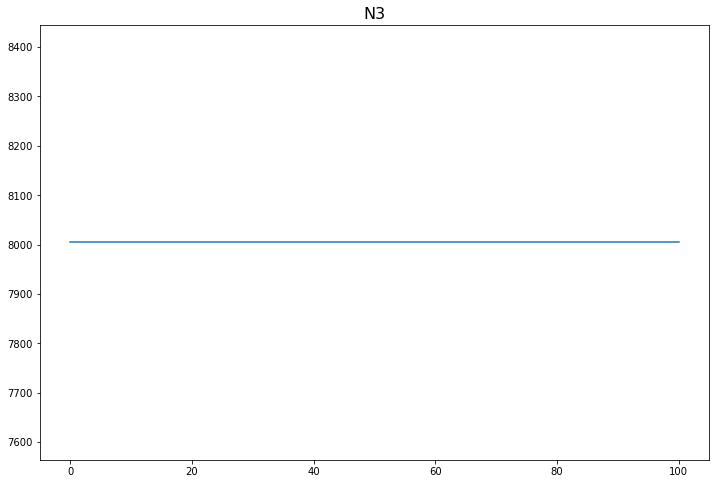

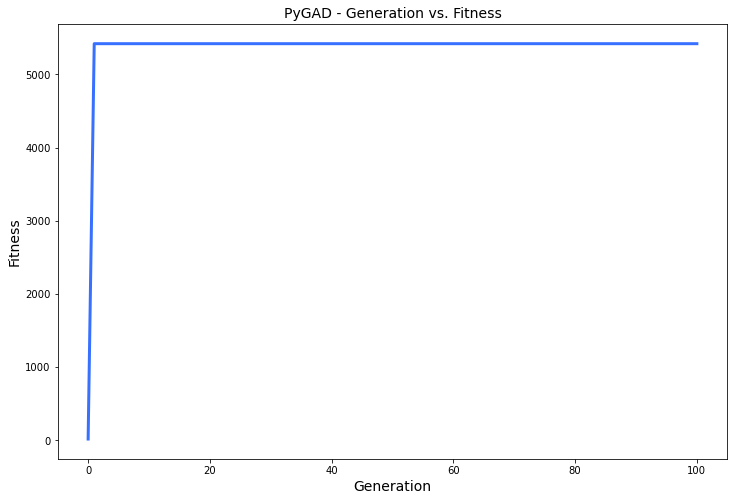

[0.728]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.728 |===========| 24.937 |==================| 4.504 |==========
[0.496]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 25.009 |==================| 6.643 |==========
[0.443]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 25.025 |==================| 7.439 |==========
[0.399]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 25.038 |==================| 8.263 |==========
[0.457]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 25.021 |==================| 7.215 |==========
[-0.335]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 25.058 |==================| 9.856 |==========
[0.65]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 30.119 |==================| 2.099 |==========
[0.474]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 30.087 |==================| 1.968 |==========
[0.161]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 30.431 |==================| 6.094 |==========
[0.664]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.664 |===========| 29.864 |==================| 1.367 |==========
[-0.093]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 30.501 |==================| 10.622 |==========
[0.246]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 30.341 |==================| 3.927 |==========
[0.059]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.733 |===========| 29.781 |==================| 1.228 |==========
[0.579]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 29.966 |==================| 1.589 |==========
[0.17]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 30.421 |==================| 5.738 |==========
Fitness = 16.78444476939295
[0.664]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.664 |===========| 29.864 |==================| 1.367 |==========
[-0.093]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 30.501 |==================| 10.622 |==========
[0.246]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 30.341 |==================| 3.927 |==========
[0.059]
=====|SOLUTION|===========|OUTPUT|==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.733 |===========| 29.781 |==================| 1.228 |==========
[0.579]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 29.966 |==================| 1.589 |==========
[0.17]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 30.421 |==================| 5.738 |==========
[0.664]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.664 |===========| 29.864 |==================| 1.367 |==========
[-0.093]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 30.501 |==================| 10.622 |==========
[0.246]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 30.341 |==================| 3.927 |==========
[0.059]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 30.232 |==================| 2.752 |==========
[0.934]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.934 |===========| 29.529 |==================| 0.938 |==========
[-0.408]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 30.163 |==================| 2.312 |==========
Generation = 2
[0.376]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 30.198 |==================| 2.517 |==========
[0.784]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.784 |===========| 29.718 |==================| 1.14 |==========
[-0.085]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 30.509 |==================| 11.634 |==========
[-0.636]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 30.232 |==================| 2.752 |==========
[0.934]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.934 |===========| 29.529 |==================| 0.938 |==========
[-0.408]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 30.163 |==================| 2.312 |==========
Change = 0.0
[0.376]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 30.198 |==================| 2.517 |==========
[0.784]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.784 |===========| 29.718 |==================| 1.14 |==========
[-0.085]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 30.509 |==================| 11.634 |==========
[-0.636]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 30.232 |==================| 2.752 |==========
[0.934]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.934 |===========| 29.529 |==================| 0.938 |==========
[-0.408]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 30.163 |==================| 2.312 |==========
[1.]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.0 |===========| 29.445 |==================| 0.87 |==========
[-0.164]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 30.428 |==================| 5.984 |==========
[0.43]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 30.138 |==================| 2.185 |==========
[0.749]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.869 |===========| 29.612 |==================| 1.017 |==========
[0.816]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.816 |===========| 29.679 |==================| 1.091 |==========
[-0.113]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 30.481 |==================| 8.726 |==========
Fitness = 16.78444476939295
[1.]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.0 |===========| 29.445 |==================| 0.87 |==========
[-0.164]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 30.428 |==================| 5.984 |==========
[0.43]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 30.138 |==================| 2.185 |==========
[0.749]
=====|SOLUTION|===========|OUTPUT|==================|F

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.869 |===========| 29.612 |==================| 1.017 |==========
[0.816]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.816 |===========| 29.679 |==================| 1.091 |==========
[-0.113]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 30.481 |==================| 8.726 |==========
[1.]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.0 |===========| 29.445 |==================| 0.87 |==========
[-0.164]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 30.428 |==================| 5.984 |==========
[0.43]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 30.138 |==================| 2.185 |==========
[0.749]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.814 |===========| 29.681 |==================| 1.093 |==========
[0.842]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.842 |===========| 29.646 |==================| 1.054 |==========
[-0.625]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.625 |===========| 29.911 |==================| 1.462 |==========
Generation = 4
[0.857]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.857 |===========| 29.627 |==================| 1.033 |==========
[0.255]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 30.331 |==================| 3.778 |==========
[-0.853]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 29.632 |==================| 1.038 |==========
[0.613]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.814 |===========| 29.681 |==================| 1.093 |==========
[0.842]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.842 |===========| 29.646 |==================| 1.054 |==========
[-0.625]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.625 |===========| 29.911 |==================| 1.462 |==========
Change = 9.294479665518772
[0.857]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.857 |===========| 29.627 |==================| 1.033 |==========
[0.255]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 30.331 |==================| 3.778 |==========
[-0.853]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 29.632 |==================| 1.038 |==========
[0.613]
=====|SOLUTION|===========|OUTPUT|=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.694 |===========| 29.828 |==================| 1.304 |==========
[-0.814]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.814 |===========| 29.681 |==================| 1.093 |==========
[0.842]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.842 |===========| 29.646 |==================| 1.054 |==========
[-0.625]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.625 |===========| 29.911 |==================| 1.462 |==========
[-0.813]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.813 |===========| 29.683 |==================| 1.096 |==========
[-0.947]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.947 |===========| 29.514 |==================| 0.924 |==========
[0.316]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.796 |===========| 29.703 |==================| 1.121 |==========
[-0.069]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 30.526 |==================| 14.329 |==========
[0.718]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.718 |===========| 29.798 |==================| 1.255 |==========
[0.329]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 30.251 |==================| 2.901 |==========
[0.136]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 30.457 |==================| 7.219 |==========
Fitness = 26.078924434911723
[-0.813]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.813 |===========| 29.683 |==================| 1.096 |==========
[-0.947]
=====|SOLUTION|===========|OUTPUT|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.796 |===========| 29.703 |==================| 1.121 |==========
[-0.069]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 30.526 |==================| 14.329 |==========
[0.718]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.718 |===========| 29.798 |==================| 1.255 |==========
[0.329]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 30.251 |==================| 2.901 |==========
[0.136]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 30.457 |==================| 7.219 |==========
[-0.813]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.813 |===========| 29.683 |==================| 1.096 |==========
[-0.947]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.85 |===========| 29.636 |==================| 1.043 |==========
[-0.072]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.072 |===========| 30.522 |==================| 13.722 |==========
[-0.339]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 30.239 |==================| 2.807 |==========
Generation = 6
[0.436]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 30.13 |==================| 2.15 |==========
[-0.319]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 30.262 |==================| 2.998 |==========
[0.638]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 29.895 |==================| 1.428 |==========
[0.042]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.85 |===========| 29.636 |==================| 1.043 |==========
[-0.072]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.072 |===========| 30.522 |==================| 13.722 |==========
[-0.339]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 30.239 |==================| 2.807 |==========
Change = 26.66293204484946
[0.436]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 30.13 |==================| 2.15 |==========
[-0.319]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 30.262 |==================| 2.998 |==========
[0.638]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 29.895 |==================| 1.428 |==========
[0.042]
=====|SOLUTION|===========|OUTPUT|==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.85 |===========| 29.636 |==================| 1.043 |==========
[-0.072]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.072 |===========| 30.522 |==================| 13.722 |==========
[-0.339]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 30.239 |==================| 2.807 |==========
[-0.013]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 30.582 |==================| 77.198 |==========
[-0.456]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 30.108 |==================| 2.051 |==========
[0.177]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 30.414 |==================| 5.507 |==========
[-0.954]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 30.418 |==================| 5.648 |==========
[0.09]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 30.505 |==================| 11.022 |==========
[-0.043]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 30.552 |==================| 23.054 |==========
[0.488]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 30.071 |==================| 1.909 |==========
Fitness = 77.1977742629334
[-0.013]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 30.582 |==================| 77.198 |==========
[-0.456]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 30.108 |==================| 2.051 |==========
[0.177]
=====|SOLUTION|===========|OUTPUT|===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.965 |===========| 29.49 |==================| 0.905 |==========
[0.173]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 30.418 |==================| 5.648 |==========
[0.09]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 30.505 |==================| 11.022 |==========
[-0.043]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 30.552 |==================| 23.054 |==========
[0.488]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 30.071 |==================| 1.909 |==========
[-0.013]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 30.582 |==================| 77.198 |==========
[-0.456]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 29.577 |==================| 0.982 |==========
[0.963]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.963 |===========| 29.493 |==================| 0.908 |==========
[0.241]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 30.346 |==================| 4.005 |==========
[-0.543]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.543 |===========| 30.008 |==================| 1.702 |==========
[0.533]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.533 |===========| 30.019 |==================| 1.736 |==========
Generation = 8
[0.284]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.284 |===========| 30.3 |==================| 3.383 |==========
[-0.712]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.963 |===========| 29.493 |==================| 0.908 |==========
[0.241]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 30.346 |==================| 4.005 |==========
[-0.543]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.543 |===========| 30.008 |==================| 1.702 |==========
[0.533]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.533 |===========| 30.019 |==================| 1.736 |==========
Change = 0.0
[0.284]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.284 |===========| 30.3 |==================| 3.383 |==========
[-0.712]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.712 |===========| 29.807 |==================| 1.268 |==========
[0.144]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.963 |===========| 29.493 |==================| 0.908 |==========
[0.241]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 30.346 |==================| 4.005 |==========
[-0.543]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.543 |===========| 30.008 |==================| 1.702 |==========
[0.533]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.533 |===========| 30.019 |==================| 1.736 |==========
[0.198]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.198 |===========| 30.392 |==================| 4.91 |==========
[0.244]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 30.342 |==================| 3.953 |==========
[0.581]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.92 |===========| 29.548 |==================| 0.955 |==========
[0.374]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 30.201 |==================| 2.534 |==========
[-0.326]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 30.254 |==================| 2.926 |==========
[0.873]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 29.607 |==================| 1.012 |==========
Fitness = 77.1977742629334
[0.198]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.198 |===========| 30.392 |==================| 4.91 |==========
[0.244]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 30.342 |==================| 3.953 |==========
[0.581]
=====|SOLUTION|===========|OUTPUT|================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.92 |===========| 29.548 |==================| 0.955 |==========
[0.374]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 30.201 |==================| 2.534 |==========
[-0.326]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 30.254 |==================| 2.926 |==========
[0.873]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 29.607 |==================| 1.012 |==========
[0.198]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.198 |===========| 30.392 |==================| 4.91 |==========
[0.244]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 30.342 |==================| 3.953 |==========
[0.581]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.939 |===========| 29.523 |==================| 0.933 |==========
Generation = 10
[0.625]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.625 |===========| 29.911 |==================| 1.46 |==========
[0.805]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.805 |===========| 29.693 |==================| 1.108 |==========
[0.109]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 30.484 |==================| 9.017 |==========
[0.444]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 30.122 |==================| 2.111 |==========
[-0.675]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.675 |===========| 29.852 |==================| 1.345 |==========
[-0.341]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.939 |===========| 29.523 |==================| 0.933 |==========
Change = 0.0
[0.625]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.625 |===========| 29.911 |==================| 1.46 |==========
[0.805]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.805 |===========| 29.693 |==================| 1.108 |==========
[0.109]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 30.484 |==================| 9.017 |==========
[0.444]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 30.122 |==================| 2.111 |==========
[-0.675]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.675 |===========| 29.852 |==================| 1.345 |==========
[-0.341]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.939 |===========| 29.523 |==================| 0.933 |==========
[0.319]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 30.262 |==================| 2.996 |==========
[-0.083]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 30.512 |==================| 11.965 |==========
[0.755]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.755 |===========| 29.753 |==================| 1.188 |==========
[-0.954]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.954 |===========| 29.504 |==================| 0.916 |==========
[0.865]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 29.618 |==================| 1.023 |==========
[-0.698]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.598 |===========| 29.943 |==================| 1.534 |==========
[0.233]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 30.355 |==================| 4.162 |==========
Fitness = 77.1977742629334
[0.319]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 30.262 |==================| 2.996 |==========
[-0.083]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 30.512 |==================| 11.965 |==========
[0.755]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.755 |===========| 29.753 |==================| 1.188 |==========
[-0.954]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.954 |===========| 29.504 |==================| 0.916 |==========
[0.865]
=====|SOLUTION|===========|OUTPUT|============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.887 |===========| 29.59 |==================| 0.995 |==========
[0.598]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.598 |===========| 29.943 |==================| 1.534 |==========
[0.233]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 30.355 |==================| 4.162 |==========
[0.319]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 30.262 |==================| 2.996 |==========
[-0.083]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 30.512 |==================| 11.965 |==========
[0.755]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.755 |===========| 29.753 |==================| 1.188 |==========
[-0.954]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.613 |===========| 29.925 |==================| 1.492 |==========
[-0.031]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 30.564 |==================| 32.162 |==========
[0.401]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 30.17 |==================| 2.351 |==========
[-0.013]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 30.583 |==================| 78.833 |==========
Generation = 12
[-0.21]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 30.379 |==================| 4.62 |==========
[-0.535]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.535 |===========| 30.017 |==================| 1.728 |==========
[-0.064]
=====|SOLUTION|===========|OUTPUT|==================|FITN

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.613 |===========| 29.925 |==================| 1.492 |==========
[-0.031]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 30.564 |==================| 32.162 |==========
[0.401]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 30.17 |==================| 2.351 |==========
[-0.013]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 30.583 |==================| 78.833 |==========
Change = 1.6350378976228654
[-0.21]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 30.379 |==================| 4.62 |==========
[-0.535]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.535 |===========| 30.017 |==================| 1.728 |==========
[-0.064]
=====|SOLUTION|===========|OUTPUT|===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 30.556 |==================| 25.474 |==========
[0.613]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.613 |===========| 29.925 |==================| 1.492 |==========
[-0.031]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 30.564 |==================| 32.162 |==========
[0.401]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 30.17 |==================| 2.351 |==========
[-0.013]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 30.583 |==================| 78.833 |==========
[-0.045]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 30.55 |==================| 22.297 |==========
[0.733]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 30.535 |==================| 16.464 |==========
[0.611]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.611 |===========| 29.927 |==================| 1.496 |==========
[-0.452]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 30.112 |==================| 2.07 |==========
[0.454]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 30.111 |==================| 2.063 |==========
Fitness = 78.83281216057834
[-0.045]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 30.55 |==================| 22.297 |==========
[0.733]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.733 |===========| 29.781 |==================| 1.227 |==========
[0.254]
=====|SOLUTION|===========|OUTPUT|=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.611 |===========| 29.927 |==================| 1.496 |==========
[-0.452]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 30.112 |==================| 2.07 |==========
[0.454]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 30.111 |==================| 2.063 |==========
[-0.045]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 30.55 |==================| 22.297 |==========
[0.733]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.733 |===========| 29.781 |==================| 1.227 |==========
[0.254]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 30.332 |==================| 3.802 |==========
[0.616]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.801 |===========| 29.696 |==================| 1.113 |==========
[0.465]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 30.097 |==================| 2.007 |==========
Generation = 14
[0.562]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.562 |===========| 29.985 |==================| 1.639 |==========
[-0.36]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 30.216 |==================| 2.635 |==========
[0.405]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 30.166 |==================| 2.33 |==========
[0.144]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 30.449 |==================| 6.825 |==========
[-0.817]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 30.097 |==================| 2.007 |==========
Change = 0.0
[0.562]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.562 |===========| 29.985 |==================| 1.639 |==========
[-0.36]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 30.216 |==================| 2.635 |==========
[0.405]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 30.166 |==================| 2.33 |==========
[0.144]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 30.449 |==================| 6.825 |==========
[-0.817]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.817 |===========| 29.677 |==================| 1.089 |==========
[-0.198]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 29.492 |==================| 0.906 |==========
[0.729]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.729 |===========| 29.786 |==================| 1.235 |==========
[-0.616]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.616 |===========| 29.922 |==================| 1.484 |==========
[0.397]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.397 |===========| 30.175 |==================| 2.38 |==========
[-0.511]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.511 |===========| 30.044 |==================| 1.815 |==========
[0.351]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 30.226 |==================| 2.71 |==========
[0.54]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.729 |===========| 29.786 |==================| 1.235 |==========
[-0.616]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.616 |===========| 29.922 |==================| 1.484 |==========
[0.397]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.397 |===========| 30.175 |==================| 2.38 |==========
[-0.511]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.511 |===========| 30.044 |==================| 1.815 |==========
[0.351]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 30.226 |==================| 2.71 |==========
[0.54]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.54 |===========| 30.01 |==================| 1.71 |==========
[-0.287]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.616 |===========| 29.922 |==================| 1.484 |==========
[0.397]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.397 |===========| 30.175 |==================| 2.38 |==========
[-0.511]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.511 |===========| 30.044 |==================| 1.815 |==========
[0.351]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 30.226 |==================| 2.71 |==========
[0.54]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.54 |===========| 30.01 |==================| 1.71 |==========
[-0.287]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 30.296 |==================| 3.34 |==========
[-0.825]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.953 |===========| 29.506 |==================| 0.918 |==========
[-0.164]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 30.427 |==================| 5.949 |==========
[0.326]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 30.254 |==================| 2.928 |==========
[0.778]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.778 |===========| 29.725 |==================| 1.149 |==========
[-0.036]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 30.559 |==================| 27.871 |==========
[-0.051]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 30.544 |==================| 19.515 |==========
[0.676]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.732 |===========| 29.782 |==================| 1.23 |==========
[0.953]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.953 |===========| 29.506 |==================| 0.918 |==========
[-0.164]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 30.427 |==================| 5.949 |==========
[0.326]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 30.254 |==================| 2.928 |==========
[0.778]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.778 |===========| 29.725 |==================| 1.149 |==========
[-0.036]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 30.559 |==================| 27.871 |==========
[-0.051]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.613 |===========| 29.926 |==================| 1.493 |==========
[0.427]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 30.141 |==================| 2.202 |==========
[0.106]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 30.488 |==================| 9.353 |==========
[0.68]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.68 |===========| 29.845 |==================| 1.333 |==========
[-0.15]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 30.442 |==================| 6.537 |==========
[-0.736]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.736 |===========| 29.777 |==================| 1.222 |==========
[0.926]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.613 |===========| 29.926 |==================| 1.493 |==========
[0.427]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 30.141 |==================| 2.202 |==========
[0.106]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 30.488 |==================| 9.353 |==========
[0.68]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.68 |===========| 29.845 |==================| 1.333 |==========
[-0.15]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 30.442 |==================| 6.537 |==========
[-0.736]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.736 |===========| 29.777 |==================| 1.222 |==========
[0.926]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 30.141 |==================| 2.202 |==========
[0.106]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 30.488 |==================| 9.353 |==========
[0.68]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.68 |===========| 29.845 |==================| 1.333 |==========
[-0.15]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 30.442 |==================| 6.537 |==========
[-0.736]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.736 |===========| 29.777 |==================| 1.222 |==========
[0.926]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.926 |===========| 29.54 |==================| 0.948 |==========
[-0.222]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 30.064 |==================| 1.884 |==========
[-0.362]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 30.214 |==================| 2.62 |==========
[-0.698]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.698 |===========| 29.823 |==================| 1.295 |==========
[-0.694]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.694 |===========| 29.828 |==================| 1.304 |==========
[-0.227]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 30.361 |==================| 4.274 |==========
[-0.125]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 30.468 |==================| 7.855 |==========
[-0.603]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 30.214 |==================| 2.62 |==========
[-0.698]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.698 |===========| 29.823 |==================| 1.295 |==========
[-0.694]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.694 |===========| 29.828 |==================| 1.304 |==========
[-0.227]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 30.361 |==================| 4.274 |==========
[-0.125]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 30.468 |==================| 7.855 |==========
[-0.603]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.603 |===========| 29.937 |==================| 1.518 |==========
[-0.084]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.969 |===========| 29.485 |==================| 0.9 |==========
[0.407]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 30.164 |==================| 2.318 |==========
[-0.331]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 30.248 |==================| 2.879 |==========
[0.288]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 30.295 |==================| 3.328 |==========
[-0.667]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.667 |===========| 29.861 |==================| 1.362 |==========
[0.479]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 30.082 |==================| 1.948 |==========
[0.073]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 30.497 |==================| 10.174 |==========
[0.969]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.969 |===========| 29.485 |==================| 0.9 |==========
[0.407]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 30.164 |==================| 2.318 |==========
[-0.331]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 30.248 |==================| 2.879 |==========
[0.288]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 30.295 |==================| 3.328 |==========
[-0.667]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.667 |===========| 29.861 |==================| 1.362 |==========
[0.479]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 30.497 |==================| 10.174 |==========
[0.969]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.969 |===========| 29.485 |==================| 0.9 |==========
[0.407]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 30.164 |==================| 2.318 |==========
[-0.331]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 30.248 |==================| 2.879 |==========
[0.288]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 30.295 |==================| 3.328 |==========
[-0.667]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.667 |===========| 29.861 |==================| 1.362 |==========
[0.479]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.54 |===========| 30.011 |==================| 1.711 |==========
[0.954]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.954 |===========| 29.505 |==================| 0.917 |==========
[-0.034]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 30.561 |==================| 29.37 |==========
[0.082]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.082 |===========| 30.513 |==================| 12.15 |==========
[0.198]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.198 |===========| 30.392 |==================| 4.92 |==========
[-0.199]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 30.391 |==================| 4.897 |==========
[-0.068]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.954 |===========| 29.505 |==================| 0.917 |==========
[-0.034]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 30.561 |==================| 29.37 |==========
[0.082]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.082 |===========| 30.513 |==================| 12.15 |==========
[0.198]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.198 |===========| 30.392 |==================| 4.92 |==========
[-0.199]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 30.391 |==================| 4.897 |==========
[-0.068]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 30.527 |==================| 14.596 |==========
[0.529]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 30.581 |==================| 69.78 |==========
[-0.491]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 30.068 |==================| 1.895 |==========
[-0.629]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 29.906 |==================| 1.45 |==========
[-0.184]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 30.406 |==================| 5.289 |==========
[-0.759]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.759 |===========| 29.748 |==================| 1.181 |==========
[-0.1]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 30.495 |==================| 9.923 |==========
[-0.848]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.811 |===========| 29.684 |==================| 1.098 |==========
[-0.014]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 30.581 |==================| 69.78 |==========
[-0.491]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 30.068 |==================| 1.895 |==========
[-0.629]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 29.906 |==================| 1.45 |==========
[-0.184]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 30.406 |==================| 5.289 |==========
[-0.759]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.759 |===========| 29.748 |==================| 1.181 |==========
[-0.1]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.811 |===========| 29.684 |==================| 1.098 |==========
[-0.014]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 30.581 |==================| 69.78 |==========
[-0.491]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 30.068 |==================| 1.895 |==========
[-0.629]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 29.906 |==================| 1.45 |==========
[-0.184]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 30.406 |==================| 5.289 |==========
[-0.759]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.759 |===========| 29.748 |==================| 1.181 |==========
[-0.1]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.966 |===========| 29.488 |==================| 0.903 |==========
[0.812]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.812 |===========| 29.683 |==================| 1.096 |==========
[0.551]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 29.999 |==================| 1.676 |==========
[-0.041]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 30.555 |==================| 24.564 |==========
[0.76]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.76 |===========| 29.748 |==================| 1.18 |==========
[0.585]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.585 |===========| 29.958 |==================| 1.57 |==========
[0.745]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.732 |===========| 29.782 |==================| 1.23 |==========
[-0.966]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.966 |===========| 29.488 |==================| 0.903 |==========
[0.812]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.812 |===========| 29.683 |==================| 1.096 |==========
[0.551]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 29.999 |==================| 1.676 |==========
[-0.041]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 30.555 |==================| 24.564 |==========
[0.76]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.76 |===========| 29.748 |==================| 1.18 |==========
[0.585]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.699 |===========| 29.822 |==================| 1.293 |==========
[-0.874]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.874 |===========| 29.606 |==================| 1.01 |==========
[0.908]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.908 |===========| 29.563 |==================| 0.969 |==========
[0.75]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 29.76 |==================| 1.197 |==========
[-0.325]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 30.254 |==================| 2.932 |==========
[-0.534]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.534 |===========| 30.018 |==================| 1.732 |==========
[0.538]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.699 |===========| 29.822 |==================| 1.293 |==========
[-0.874]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.874 |===========| 29.606 |==================| 1.01 |==========
[0.908]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.908 |===========| 29.563 |==================| 0.969 |==========
[0.75]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 29.76 |==================| 1.197 |==========
[-0.325]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 30.254 |==================| 2.932 |==========
[-0.534]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.534 |===========| 30.018 |==================| 1.732 |==========
[0.538]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 30.577 |==================| 55.4 |==========
[-0.699]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.699 |===========| 29.822 |==================| 1.293 |==========
[-0.874]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.874 |===========| 29.606 |==================| 1.01 |==========
[0.908]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.908 |===========| 29.563 |==================| 0.969 |==========
[0.75]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 29.76 |==================| 1.197 |==========
[-0.325]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 30.254 |==================| 2.932 |==========
[-0.534]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.592 |===========| 29.95 |==================| 1.549 |==========
[0.831]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 29.66 |==================| 1.069 |==========
[-0.234]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 30.353 |==================| 4.128 |==========
[-0.645]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.645 |===========| 29.888 |==================| 1.413 |==========
[-0.247]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 30.34 |==================| 3.911 |==========
[0.251]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 30.335 |==================| 3.845 |==========
[-0.389]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.592 |===========| 29.95 |==================| 1.549 |==========
[0.831]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 29.66 |==================| 1.069 |==========
[-0.234]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 30.353 |==================| 4.128 |==========
[-0.645]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.645 |===========| 29.888 |==================| 1.413 |==========
[-0.247]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 30.34 |==================| 3.911 |==========
[0.251]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 30.335 |==================| 3.845 |==========
[-0.389]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 30.447 |==================| 6.734 |==========
[-0.328]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 30.251 |==================| 2.903 |==========
[0.865]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 29.617 |==================| 1.022 |==========
[-0.768]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 29.738 |==================| 1.166 |==========
[0.025]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.025 |===========| 30.57 |==================| 39.41 |==========
[0.686]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 29.838 |==================| 1.32 |==========
[-0.926]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.002 |===========| 29.443 |==================| 0.868 |==========
Fitness = 107.41512765932308
[0.146]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 30.447 |==================| 6.734 |==========
[-0.328]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 30.251 |==================| 2.903 |==========
[0.865]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 29.617 |==================| 1.022 |==========
[-0.768]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 29.738 |==================| 1.166 |==========
[0.025]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.025 |===========| 30.57 |==================| 39.41 |==========
[0.686]
=====|SOLUTION|===========|OUTPUT|============

[0.917]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 29.551 |==================| 0.958 |==========
[1.002]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.002 |===========| 29.443 |==================| 0.868 |==========
[0.146]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 30.447 |==================| 6.734 |==========
[-0.328]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 30.251 |==================| 2.903 |==========
[0.865]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 29.617 |==================| 1.022 |==========
[-0.768]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 29.738 |==================| 1.166 |==========
[0.025]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.664 |===========| 29.864 |==================| 1.368 |==========
Generation = 26
[0.762]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.762 |===========| 29.745 |==================| 1.176 |==========
[0.349]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 30.228 |==================| 2.721 |==========
[-0.94]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.94 |===========| 29.522 |==================| 0.932 |==========
[0.226]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 30.362 |==================| 4.288 |==========
[-0.649]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.649 |===========| 29.883 |==================| 1.403 |==========
[-0.634]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.657 |===========| 29.872 |==================| 1.383 |==========
[-0.664]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.664 |===========| 29.864 |==================| 1.368 |==========
Change = 0.0
[0.762]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.762 |===========| 29.745 |==================| 1.176 |==========
[0.349]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 30.228 |==================| 2.721 |==========
[-0.94]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.94 |===========| 29.522 |==================| 0.932 |==========
[0.226]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 30.362 |==================| 4.288 |==========
[-0.649]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 30.418 |==================| 5.641 |==========
[-0.657]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.657 |===========| 29.872 |==================| 1.383 |==========
[-0.664]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.664 |===========| 29.864 |==================| 1.368 |==========
[-0.211]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 30.378 |==================| 4.598 |==========
[0.608]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.608 |===========| 29.931 |==================| 1.505 |==========
[0.796]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.796 |===========| 29.704 |==================| 1.122 |==========
[0.867]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 30.134 |==================| 2.169 |==========
[0.154]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 30.438 |==================| 6.376 |==========
[-0.197]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 30.393 |==================| 4.941 |==========
Fitness = 107.41512765932308
[-0.211]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 30.378 |==================| 4.598 |==========
[0.608]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.608 |===========| 29.931 |==================| 1.505 |==========
[0.796]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.796 |===========| 29.704 |==================| 1.122 |==========
[0.867]
=====|SOLUTION|===========|OUTPUT|===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.826 |===========| 29.666 |==================| 1.076 |==========
[-0.433]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 30.134 |==================| 2.169 |==========
[0.154]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 30.438 |==================| 6.376 |==========
[-0.197]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 30.393 |==================| 4.941 |==========
[-0.211]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 30.378 |==================| 4.598 |==========
[0.608]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.608 |===========| 29.931 |==================| 1.505 |==========
[0.796]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 30.12 |==================| 2.104 |==========
[-0.907]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.907 |===========| 29.564 |==================| 0.97 |==========
[-0.111]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 30.483 |==================| 8.897 |==========
[-0.285]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.285 |===========| 30.299 |==================| 3.373 |==========
[0.257]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 30.328 |==================| 3.748 |==========
Generation = 28
[-0.192]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 30.398 |==================| 5.081 |==========
[0.564]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.523 |===========| 30.03 |==================| 1.77 |==========
[-0.445]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 30.12 |==================| 2.104 |==========
[-0.907]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.907 |===========| 29.564 |==================| 0.97 |==========
[-0.111]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 30.483 |==================| 8.897 |==========
[-0.285]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.285 |===========| 30.299 |==================| 3.373 |==========
[0.257]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 30.328 |==================| 3.748 |==========
Change = 31.847894580084414
[-0.192]
=====|SOLUTION|===========|OUTPUT|=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 30.12 |==================| 2.104 |==========
[-0.907]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.907 |===========| 29.564 |==================| 0.97 |==========
[-0.111]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 30.483 |==================| 8.897 |==========
[-0.285]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.285 |===========| 30.299 |==================| 3.373 |==========
[0.257]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 30.328 |==================| 3.748 |==========
[0.606]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.606 |===========| 29.934 |==================| 1.512 |==========
[-0.348]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.732 |===========| 29.782 |==================| 1.229 |==========
[0.104]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 30.49 |==================| 9.533 |==========
[-0.507]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.507 |===========| 30.049 |==================| 1.83 |==========
[0.593]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.593 |===========| 29.949 |==================| 1.546 |==========
[0.028]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 30.568 |==================| 36.226 |==========
[-0.518]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.518 |===========| 30.037 |==================| 1.79 |==========
Fitness = 1420.2537640242617
[0.606]
=====|SOLUTION|===========|OUTPUT|=============

[0.104]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 30.49 |==================| 9.533 |==========
[-0.507]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.507 |===========| 30.049 |==================| 1.83 |==========
[0.593]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.593 |===========| 29.949 |==================| 1.546 |==========
[0.028]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 30.568 |==================| 36.226 |==========
[-0.518]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.518 |===========| 30.037 |==================| 1.79 |==========
[0.606]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.606 |===========| 29.934 |==================| 1.512 |==========
[-0.348]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.554 |===========| 29.995 |==================| 1.665 |==========
[-0.64]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.64 |===========| 29.894 |==================| 1.425 |==========
[0.912]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.912 |===========| 29.558 |==================| 0.964 |==========
[-0.223]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 30.365 |==================| 4.344 |==========
[-0.979]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.979 |===========| 29.472 |==================| 0.89 |==========
Generation = 30
[-0.754]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.754 |===========| 29.755 |==================| 1.189 |==========
[-0.117]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

[0.554]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.554 |===========| 29.995 |==================| 1.665 |==========
[-0.64]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.64 |===========| 29.894 |==================| 1.425 |==========
[0.912]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.912 |===========| 29.558 |==================| 0.964 |==========
[-0.223]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 30.365 |==================| 4.344 |==========
[-0.979]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.979 |===========| 29.472 |==================| 0.89 |==========
Change = 0.0
[-0.754]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.754 |===========| 29.755 |==================| 1.189 |==========
[-0.117]
=====|SOLUTION|===========|OUTPUT|==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 30.402 |==================| 5.17 |==========
[0.554]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.554 |===========| 29.995 |==================| 1.665 |==========
[-0.64]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.64 |===========| 29.894 |==================| 1.425 |==========
[0.912]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.912 |===========| 29.558 |==================| 0.964 |==========
[-0.223]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 30.365 |==================| 4.344 |==========
[-0.979]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.979 |===========| 29.472 |==================| 0.89 |==========
[-0.07]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 30.276 |==================| 3.133 |==========
[0.095]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 30.499 |==================| 10.427 |==========
[0.155]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 30.437 |==================| 6.33 |==========
[-0.768]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 29.738 |==================| 1.167 |==========
[0.321]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 30.259 |==================| 2.97 |==========
[0.589]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 29.954 |==================| 1.558 |==========
Fitness = 1420.2537640242617
[-0.07]
=====|SOLUTION|===========|OUTPUT|=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 29.607 |==================| 1.012 |==========
[0.305]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 30.276 |==================| 3.133 |==========
[0.095]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 30.499 |==================| 10.427 |==========
[0.155]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 30.437 |==================| 6.33 |==========
[-0.768]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 29.738 |==================| 1.167 |==========
[0.321]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 30.259 |==================| 2.97 |==========
[0.589]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 30.48 |==================| 8.668 |==========
[0.382]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 30.192 |==================| 2.479 |==========
[-0.358]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 30.218 |==================| 2.651 |==========
[-0.393]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 30.179 |==================| 2.404 |==========
[-0.601]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 29.94 |==================| 1.525 |==========
[0.331]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 30.248 |==================| 2.88 |==========
[0.683]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 30.347 |==================| 4.035 |==========
[0.114]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 30.48 |==================| 8.668 |==========
[0.382]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 30.192 |==================| 2.479 |==========
[-0.358]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 30.218 |==================| 2.651 |==========
[-0.393]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 30.179 |==================| 2.404 |==========
[-0.601]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 29.94 |==================| 1.525 |==========
[0.331]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 29.551 |==================| 0.958 |==========
[0.24]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 30.347 |==================| 4.035 |==========
[0.114]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 30.48 |==================| 8.668 |==========
[0.382]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 30.192 |==================| 2.479 |==========
[-0.358]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 30.218 |==================| 2.651 |==========
[-0.393]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 30.179 |==================| 2.404 |==========
[-0.601]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.972 |===========| 29.481 |==================| 0.898 |==========
[-0.256]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 30.33 |==================| 3.765 |==========
[-0.2]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 30.389 |==================| 4.859 |==========
[0.534]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.534 |===========| 30.018 |==================| 1.732 |==========
[-0.151]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 30.441 |==================| 6.495 |==========
[-0.897]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 29.576 |==================| 0.981 |==========
[-0.092]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.493 |===========| 30.066 |==================| 1.889 |==========
[0.972]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.972 |===========| 29.481 |==================| 0.898 |==========
[-0.256]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 30.33 |==================| 3.765 |==========
[-0.2]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 30.389 |==================| 4.859 |==========
[0.534]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.534 |===========| 30.018 |==================| 1.732 |==========
[-0.151]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 30.441 |==================| 6.495 |==========
[-0.897]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.581 |===========| 29.963 |==================| 1.582 |==========
[-0.393]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 30.179 |==================| 2.4 |==========
[0.885]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.885 |===========| 29.593 |==================| 0.997 |==========
[0.258]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 30.328 |==================| 3.735 |==========
[0.767]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 29.739 |==================| 1.167 |==========
[0.046]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 30.55 |==================| 21.914 |==========
[0.44]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 30.188 |==================| 2.458 |==========
[-0.581]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.581 |===========| 29.963 |==================| 1.582 |==========
[-0.393]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 30.179 |==================| 2.4 |==========
[0.885]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.885 |===========| 29.593 |==================| 0.997 |==========
[0.258]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 30.328 |==================| 3.735 |==========
[0.767]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 29.739 |==================| 1.167 |==========
[0.046]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.581 |===========| 29.963 |==================| 1.582 |==========
[-0.393]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 30.179 |==================| 2.4 |==========
[0.885]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.885 |===========| 29.593 |==================| 0.997 |==========
[0.258]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 30.328 |==================| 3.735 |==========
[0.767]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 29.739 |==================| 1.167 |==========
[0.046]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 30.55 |==================| 21.914 |==========
[0.44]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.616 |===========| 29.921 |==================| 1.483 |==========
[-0.551]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 29.998 |==================| 1.674 |==========
[-0.286]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 30.297 |==================| 3.355 |==========
[0.013]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 30.583 |==================| 80.193 |==========
[0.6]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.6 |===========| 29.941 |==================| 1.528 |==========
Fitness = 1420.2537640242617
[-0.685]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.685 |===========| 29.839 |==================| 1.323 |==========
[0.638]
=====|SOLUTION|===========|OUTPUT|=============

[0.616]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.616 |===========| 29.921 |==================| 1.483 |==========
[-0.551]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 29.998 |==================| 1.674 |==========
[-0.286]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 30.297 |==================| 3.355 |==========
[0.013]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 30.583 |==================| 80.193 |==========
[0.6]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.6 |===========| 29.941 |==================| 1.528 |==========
[-0.685]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.685 |===========| 29.839 |==================| 1.323 |==========
[0.638]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.868 |===========| 29.614 |==================| 1.019 |==========
[-0.684]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.684 |===========| 29.84 |==================| 1.323 |==========
[-0.766]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.766 |===========| 29.74 |==================| 1.169 |==========
[-0.995]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.995 |===========| 29.451 |==================| 0.874 |==========
Generation = 36
[0.083]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 30.511 |==================| 11.925 |==========
[0.588]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.588 |===========| 29.955 |==================| 1.562 |==========
[0.523]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.684 |===========| 29.84 |==================| 1.323 |==========
[-0.766]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.766 |===========| 29.74 |==================| 1.169 |==========
[-0.995]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.995 |===========| 29.451 |==================| 0.874 |==========
Change = 0.0
[0.083]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 30.511 |==================| 11.925 |==========
[0.588]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.588 |===========| 29.955 |==================| 1.562 |==========
[0.523]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.523 |===========| 30.03 |==================| 1.77 |==========
[0.007]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.684 |===========| 29.84 |==================| 1.323 |==========
[-0.766]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.766 |===========| 29.74 |==================| 1.169 |==========
[-0.995]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.995 |===========| 29.451 |==================| 0.874 |==========
[-0.82]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.82 |===========| 29.673 |==================| 1.085 |==========
[0.291]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 30.292 |==================| 3.301 |==========
[0.936]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.936 |===========| 29.528 |==================| 0.937 |==========
[0.927]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.569 |===========| 29.977 |==================| 1.617 |==========
[0.424]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 30.144 |==================| 2.215 |==========
[-0.52]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.52 |===========| 30.034 |==================| 1.781 |==========
Fitness = 1420.2537640242617
[-0.82]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.82 |===========| 29.673 |==================| 1.085 |==========
[0.291]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 30.292 |==================| 3.301 |==========
[0.936]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.936 |===========| 29.528 |==================| 0.937 |==========
[0.927]
=====|SOLUTION|===========|OUTPUT|===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 30.144 |==================| 2.215 |==========
[-0.52]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.52 |===========| 30.034 |==================| 1.781 |==========
[-0.82]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.82 |===========| 29.673 |==================| 1.085 |==========
[0.291]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 30.292 |==================| 3.301 |==========
[0.936]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.936 |===========| 29.528 |==================| 0.937 |==========
[0.927]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.927 |===========| 29.539 |==================| 0.947 |==========
[0.104]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 30.463 |==================| 7.531 |==========
[-0.781]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.781 |===========| 29.722 |==================| 1.145 |==========
[0.972]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.972 |===========| 29.482 |==================| 0.898 |==========
[0.749]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.749 |===========| 29.761 |==================| 1.198 |==========
[-0.312]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 30.269 |==================| 3.066 |==========
[-0.77]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.77 |===========| 29.736 |==================| 1.163 |==========
[-0.654]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 30.463 |==================| 7.531 |==========
[-0.781]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.781 |===========| 29.722 |==================| 1.145 |==========
[0.972]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.972 |===========| 29.482 |==================| 0.898 |==========
[0.749]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.749 |===========| 29.761 |==================| 1.198 |==========
[-0.312]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 30.269 |==================| 3.066 |==========
[-0.77]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.77 |===========| 29.736 |==================| 1.163 |==========
[-0.654]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.648 |===========| 29.884 |==================| 1.405 |==========
[0.116]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 30.477 |==================| 8.476 |==========
[-0.433]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 30.134 |==================| 2.169 |==========
[-0.405]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 30.166 |==================| 2.329 |==========
[0.365]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 30.211 |==================| 2.599 |==========
[0.581]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.581 |===========| 29.963 |==================| 1.581 |==========
[-0.586]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 30.477 |==================| 8.476 |==========
[-0.433]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 30.134 |==================| 2.169 |==========
[-0.405]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 30.166 |==================| 2.329 |==========
[0.365]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 30.211 |==================| 2.599 |==========
[0.581]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.581 |===========| 29.963 |==================| 1.581 |==========
[-0.586]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.586 |===========| 29.957 |==================| 1.567 |==========
[0.851]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 30.134 |==================| 2.169 |==========
[-0.405]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 30.166 |==================| 2.329 |==========
[0.365]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 30.211 |==================| 2.599 |==========
[0.581]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.581 |===========| 29.963 |==================| 1.581 |==========
[-0.586]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.586 |===========| 29.957 |==================| 1.567 |==========
[0.851]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 29.634 |==================| 1.041 |==========
[-0.07]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 29.954 |==================| 1.559 |==========
[0.05]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 30.545 |==================| 19.999 |==========
[-0.527]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.527 |===========| 30.026 |==================| 1.756 |==========
[0.301]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 30.281 |==================| 3.179 |==========
[-0.742]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.742 |===========| 29.77 |==================| 1.212 |==========
[-0.034]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 30.561 |==================| 29.562 |==========
[0.95]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 29.954 |==================| 1.559 |==========
[0.05]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 30.545 |==================| 19.999 |==========
[-0.527]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.527 |===========| 30.026 |==================| 1.756 |==========
[0.301]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 30.281 |==================| 3.179 |==========
[-0.742]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.742 |===========| 29.77 |==================| 1.212 |==========
[-0.034]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 30.561 |==================| 29.562 |==========
[0.95]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.977 |===========| 29.475 |==================| 0.893 |==========
[0.248]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 30.338 |==================| 3.893 |==========
[-0.043]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 30.552 |==================| 22.976 |==========
[-0.708]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.708 |===========| 29.811 |==================| 1.275 |==========
[-0.458]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 30.105 |==================| 2.041 |==========
[0.932]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.932 |===========| 29.533 |==================| 0.941 |==========
[0.257]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.977 |===========| 29.475 |==================| 0.893 |==========
[0.248]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 30.338 |==================| 3.893 |==========
[-0.043]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 30.552 |==================| 22.976 |==========
[-0.708]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.708 |===========| 29.811 |==================| 1.275 |==========
[-0.458]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 30.105 |==================| 2.041 |==========
[0.932]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.932 |===========| 29.533 |==================| 0.941 |==========
[0.257]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.977 |===========| 29.475 |==================| 0.893 |==========
[0.248]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 30.338 |==================| 3.893 |==========
[-0.043]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 30.552 |==================| 22.976 |==========
[-0.708]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.708 |===========| 29.811 |==================| 1.275 |==========
[-0.458]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 30.105 |==================| 2.041 |==========
[0.932]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.932 |===========| 29.533 |==================| 0.941 |==========
[0.257]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 30.068 |==================| 1.897 |==========
[0.749]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.749 |===========| 29.761 |==================| 1.198 |==========
[0.696]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 29.826 |==================| 1.3 |==========
[0.462]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 30.101 |==================| 2.023 |==========
[-0.616]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.616 |===========| 29.922 |==================| 1.484 |==========
[-0.643]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.643 |===========| 29.89 |==================| 1.418 |==========
[0.363]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.749 |===========| 29.761 |==================| 1.198 |==========
[0.696]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 29.826 |==================| 1.3 |==========
[0.462]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 30.101 |==================| 2.023 |==========
[-0.616]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.616 |===========| 29.922 |==================| 1.484 |==========
[-0.643]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.643 |===========| 29.89 |==================| 1.418 |==========
[0.363]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 30.213 |==================| 2.615 |==========
[-0.484]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 30.387 |==================| 4.794 |==========
[-0.627]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.627 |===========| 29.908 |==================| 1.455 |==========
[0.208]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 30.381 |==================| 4.667 |==========
[0.815]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.815 |===========| 29.68 |==================| 1.092 |==========
[-0.669]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.669 |===========| 29.858 |==================| 1.357 |==========
[-0.828]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.828 |===========| 29.663 |==================| 1.073 |==========
[0.48]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 30.387 |==================| 4.794 |==========
[-0.627]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.627 |===========| 29.908 |==================| 1.455 |==========
[0.208]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 30.381 |==================| 4.667 |==========
[0.815]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.815 |===========| 29.68 |==================| 1.092 |==========
[-0.669]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.669 |===========| 29.858 |==================| 1.357 |==========
[-0.828]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.828 |===========| 29.663 |==================| 1.073 |==========
[0.48]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.757 |===========| 29.752 |==================| 1.185 |==========
[0.203]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 30.387 |==================| 4.794 |==========
[-0.627]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.627 |===========| 29.908 |==================| 1.455 |==========
[0.208]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 30.381 |==================| 4.667 |==========
[0.815]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.815 |===========| 29.68 |==================| 1.092 |==========
[-0.669]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.669 |===========| 29.858 |==================| 1.357 |==========
[-0.828]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.356 |===========| 30.22 |==================| 2.668 |==========
[0.548]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.548 |===========| 30.001 |==================| 1.684 |==========
[0.485]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 30.075 |==================| 1.921 |==========
[0.775]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 29.73 |==================| 1.155 |==========
[-0.047]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 30.548 |==================| 21.265 |==========
[-0.087]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.087 |===========| 30.507 |==================| 11.326 |==========
[0.669]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.356 |===========| 30.22 |==================| 2.668 |==========
[0.548]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.548 |===========| 30.001 |==================| 1.684 |==========
[0.485]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 30.075 |==================| 1.921 |==========
[0.775]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 29.73 |==================| 1.155 |==========
[-0.047]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 30.548 |==================| 21.265 |==========
[-0.087]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.087 |===========| 30.507 |==================| 11.326 |==========
[0.669]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 30.439 |==================| 6.385 |==========
[-0.545]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.545 |===========| 30.005 |==================| 1.695 |==========
[-0.426]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 30.142 |==================| 2.208 |==========
[0.048]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 30.547 |==================| 20.796 |==========
[-0.701]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.701 |===========| 29.819 |==================| 1.288 |==========
[0.873]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 29.607 |==================| 1.012 |==========
[-0.501]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.545 |===========| 30.005 |==================| 1.695 |==========
[-0.426]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 30.142 |==================| 2.208 |==========
[0.048]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 30.547 |==================| 20.796 |==========
[-0.701]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.701 |===========| 29.819 |==================| 1.288 |==========
[0.873]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 29.607 |==================| 1.012 |==========
[-0.501]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.501 |===========| 30.056 |==================| 1.856 |==========
[-0.008]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 30.142 |==================| 2.208 |==========
[0.048]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 30.547 |==================| 20.796 |==========
[-0.701]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.701 |===========| 29.819 |==================| 1.288 |==========
[0.873]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 29.607 |==================| 1.012 |==========
[-0.501]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.501 |===========| 30.056 |==================| 1.856 |==========
[-0.008]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 30.587 |==================| 120.87 |==========
[0.902]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 29.888 |==================| 1.415 |==========
[-0.106]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 30.488 |==================| 9.354 |==========
[-0.796]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.796 |===========| 29.703 |==================| 1.121 |==========
[-0.318]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 30.262 |==================| 3.0 |==========
[-0.984]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.984 |===========| 29.466 |==================| 0.886 |==========
[-0.795]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.795 |===========| 29.705 |==================| 1.123 |==========
[-0.711]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 30.488 |==================| 9.354 |==========
[-0.796]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.796 |===========| 29.703 |==================| 1.121 |==========
[-0.318]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 30.262 |==================| 3.0 |==========
[-0.984]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.984 |===========| 29.466 |==================| 0.886 |==========
[-0.795]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.795 |===========| 29.705 |==================| 1.123 |==========
[-0.711]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.711 |===========| 29.807 |==================| 1.268 |==========
[-0.369]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.618 |===========| 29.92 |==================| 1.48 |==========
[0.582]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.582 |===========| 29.962 |==================| 1.578 |==========
[0.959]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.959 |===========| 29.498 |==================| 0.911 |==========
[0.071]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 30.524 |==================| 14.094 |==========
[-0.727]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 29.789 |==================| 1.239 |==========
[0.579]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 29.965 |==================| 1.586 |==========
[0.451]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.582 |===========| 29.962 |==================| 1.578 |==========
[0.959]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.959 |===========| 29.498 |==================| 0.911 |==========
[0.071]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 30.524 |==================| 14.094 |==========
[-0.727]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 29.789 |==================| 1.239 |==========
[0.579]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 29.965 |==================| 1.586 |==========
[0.451]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 30.113 |==================| 2.075 |==========
[0.605]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.582 |===========| 29.962 |==================| 1.578 |==========
[0.959]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.959 |===========| 29.498 |==================| 0.911 |==========
[0.071]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 30.524 |==================| 14.094 |==========
[-0.727]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 29.789 |==================| 1.239 |==========
[0.579]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 29.965 |==================| 1.586 |==========
[0.451]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 30.113 |==================| 2.075 |==========
[0.605]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 30.075 |==================| 1.921 |==========
[-0.461]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 30.102 |==================| 2.027 |==========
[0.257]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 30.329 |==================| 3.754 |==========
[0.912]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.912 |===========| 29.557 |==================| 0.963 |==========
[-0.95]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 29.509 |==================| 0.921 |==========
[-0.904]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.904 |===========| 29.568 |==================| 0.974 |==========
[-0.742]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 30.075 |==================| 1.921 |==========
[-0.461]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 30.102 |==================| 2.027 |==========
[0.257]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 30.329 |==================| 3.754 |==========
[0.912]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.912 |===========| 29.557 |==================| 0.963 |==========
[-0.95]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 29.509 |==================| 0.921 |==========
[-0.904]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.904 |===========| 29.568 |==================| 0.974 |==========
[-0.742]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

[0.853]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 29.633 |==================| 1.039 |==========
[0.344]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 30.234 |==================| 2.766 |==========
[-0.02]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 30.575 |==================| 49.29 |==========
[-0.721]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.721 |===========| 29.795 |==================| 1.25 |==========
[-0.587]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.587 |===========| 29.956 |==================| 1.565 |==========
[0.956]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.956 |===========| 29.501 |==================| 0.914 |==========
[-0.854]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.688 |===========| 29.835 |==================| 1.316 |==========
[0.853]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 29.633 |==================| 1.039 |==========
[0.344]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 30.234 |==================| 2.766 |==========
[-0.02]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 30.575 |==================| 49.29 |==========
[-0.721]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.721 |===========| 29.795 |==================| 1.25 |==========
[-0.587]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.587 |===========| 29.956 |==================| 1.565 |==========
[0.956]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 29.633 |==================| 1.039 |==========
[0.344]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 30.234 |==================| 2.766 |==========
[-0.02]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 30.575 |==================| 49.29 |==========
[-0.721]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.721 |===========| 29.795 |==================| 1.25 |==========
[-0.587]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.587 |===========| 29.956 |==================| 1.565 |==========
[0.956]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.956 |===========| 29.501 |==================| 0.914 |==========
[-0.854]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 30.076 |==================| 1.927 |==========
[-0.74]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.74 |===========| 29.772 |==================| 1.215 |==========
[-0.689]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.689 |===========| 29.834 |==================| 1.314 |==========
[-0.159]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 30.433 |==================| 6.145 |==========
[0.464]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 30.099 |==================| 2.014 |==========
[0.41]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 30.16 |==================| 2.299 |==========
[0.694]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 30.429 |==================| 6.022 |==========
[-0.483]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 30.076 |==================| 1.927 |==========
[-0.74]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.74 |===========| 29.772 |==================| 1.215 |==========
[-0.689]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.689 |===========| 29.834 |==================| 1.314 |==========
[-0.159]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 30.433 |==================| 6.145 |==========
[0.464]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 30.099 |==================| 2.014 |==========
[0.41]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 30.541 |==================| 18.508 |==========
[-0.639]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 29.895 |==================| 1.428 |==========
[-0.412]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 30.157 |==================| 2.284 |==========
[0.854]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.854 |===========| 29.631 |==================| 1.037 |==========
[-0.432]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 30.136 |==================| 2.175 |==========
[-0.28]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 30.304 |==================| 3.433 |==========
[0.628]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 29.895 |==================| 1.428 |==========
[-0.412]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 30.157 |==================| 2.284 |==========
[0.854]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.854 |===========| 29.631 |==================| 1.037 |==========
[-0.432]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 30.136 |==================| 2.175 |==========
[-0.28]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 30.304 |==================| 3.433 |==========
[0.628]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.628 |===========| 29.907 |==================| 1.454 |==========
[-0.02]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 29.895 |==================| 1.428 |==========
[-0.412]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 30.157 |==================| 2.284 |==========
[0.854]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.854 |===========| 29.631 |==================| 1.037 |==========
[-0.432]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 30.136 |==================| 2.175 |==========
[-0.28]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 30.304 |==================| 3.433 |==========
[0.628]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.628 |===========| 29.907 |==================| 1.454 |==========
[-0.02]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.747 |===========| 29.764 |==================| 1.203 |==========
[-0.817]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.817 |===========| 29.678 |==================| 1.09 |==========
[-0.539]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.539 |===========| 30.012 |==================| 1.716 |==========
[0.894]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.894 |===========| 29.581 |==================| 0.986 |==========
[0.096]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.096 |===========| 30.498 |==================| 10.309 |==========
[0.421]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 30.147 |==================| 2.231 |==========
[0.878]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.817 |===========| 29.678 |==================| 1.09 |==========
[-0.539]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.539 |===========| 30.012 |==================| 1.716 |==========
[0.894]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.894 |===========| 29.581 |==================| 0.986 |==========
[0.096]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.096 |===========| 30.498 |==================| 10.309 |==========
[0.421]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 30.147 |==================| 2.231 |==========
[0.878]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.878 |===========| 29.601 |==================| 1.006 |==========
[0.358]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.805 |===========| 29.692 |==================| 1.107 |==========
[-0.674]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.674 |===========| 29.853 |==================| 1.346 |==========
[0.098]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 30.497 |==================| 10.134 |==========
[0.935]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.935 |===========| 29.529 |==================| 0.938 |==========
[-0.869]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.869 |===========| 29.612 |==================| 1.017 |==========
[0.929]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.929 |===========| 29.537 |==================| 0.945 |==========
[0.444]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.805 |===========| 29.692 |==================| 1.107 |==========
[-0.674]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.674 |===========| 29.853 |==================| 1.346 |==========
[0.098]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 30.497 |==================| 10.134 |==========
[0.935]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.935 |===========| 29.529 |==================| 0.938 |==========
[-0.869]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.869 |===========| 29.612 |==================| 1.017 |==========
[0.929]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.929 |===========| 29.537 |==================| 0.945 |==========
[0.444]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 30.231 |==================| 2.744 |==========
[0.805]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.805 |===========| 29.692 |==================| 1.107 |==========
[-0.674]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.674 |===========| 29.853 |==================| 1.346 |==========
[0.098]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 30.497 |==================| 10.134 |==========
[0.935]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.935 |===========| 29.529 |==================| 0.938 |==========
[-0.869]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.869 |===========| 29.612 |==================| 1.017 |==========
[0.929]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 30.306 |==================| 3.457 |==========
[0.23]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 30.358 |==================| 4.208 |==========
[0.452]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 30.113 |==================| 2.072 |==========
[0.595]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.595 |===========| 29.946 |==================| 1.54 |==========
[0.699]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.699 |===========| 29.822 |==================| 1.293 |==========
[0.393]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 30.18 |==================| 2.405 |==========
[0.967]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 30.358 |==================| 4.208 |==========
[0.452]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 30.113 |==================| 2.072 |==========
[0.595]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.595 |===========| 29.946 |==================| 1.54 |==========
[0.699]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.699 |===========| 29.822 |==================| 1.293 |==========
[0.393]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 30.18 |==================| 2.405 |==========
[0.967]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.967 |===========| 29.488 |==================| 0.903 |==========
[0.238]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 30.475 |==================| 8.294 |==========
[-0.007]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 30.589 |==================| 147.254 |==========
[-0.286]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 30.298 |==================| 3.358 |==========
[-0.972]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.972 |===========| 29.481 |==================| 0.898 |==========
[0.113]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 30.481 |==================| 8.735 |==========
[-0.238]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.238 |===========| 30.349 |==================| 4.066 |==========
Generation = 55
[0.8]
=====|SOLUTION|===========|OUTPUT|==================|FIT

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 30.099 |==================| 2.014 |==========
[0.119]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 30.475 |==================| 8.294 |==========
[-0.007]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 30.589 |==================| 147.254 |==========
[-0.286]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 30.298 |==================| 3.358 |==========
[-0.972]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.972 |===========| 29.481 |==================| 0.898 |==========
[0.113]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 30.481 |==================| 8.735 |==========
[-0.238]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 30.099 |==================| 2.014 |==========
[0.119]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 30.475 |==================| 8.294 |==========
[-0.007]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 30.589 |==================| 147.254 |==========
[-0.286]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 30.298 |==================| 3.358 |==========
[-0.972]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.972 |===========| 29.481 |==================| 0.898 |==========
[0.113]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 30.481 |==================| 8.735 |==========
[-0.238]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.904 |===========| 29.568 |==================| 0.974 |==========
[0.672]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.672 |===========| 29.855 |==================| 1.351 |==========
[-0.893]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.893 |===========| 29.582 |==================| 0.987 |==========
[-0.397]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.397 |===========| 30.174 |==================| 2.375 |==========
[0.121]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 30.472 |==================| 8.11 |==========
[-0.162]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 30.43 |==================| 6.037 |==========
Fitness = 1420.2537640242617
[0.704]
=====|SOLUTION|===========|OUTPUT|============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.904 |===========| 29.568 |==================| 0.974 |==========
[0.672]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.672 |===========| 29.855 |==================| 1.351 |==========
[-0.893]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.893 |===========| 29.582 |==================| 0.987 |==========
[-0.397]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.397 |===========| 30.174 |==================| 2.375 |==========
[0.121]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 30.472 |==================| 8.11 |==========
[-0.162]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 30.43 |==================| 6.037 |==========
[0.704]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.308 |===========| 30.273 |==================| 3.107 |==========
[0.468]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 30.094 |==================| 1.994 |==========
[0.376]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 30.199 |==================| 2.521 |==========
[0.864]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.864 |===========| 29.618 |==================| 1.024 |==========
[-0.137]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.137 |===========| 30.456 |==================| 7.161 |==========
[0.725]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 29.79 |==================| 1.242 |==========
Generation = 57
[0.354]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.308 |===========| 30.273 |==================| 3.107 |==========
[0.468]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 30.094 |==================| 1.994 |==========
[0.376]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 30.199 |==================| 2.521 |==========
[0.864]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.864 |===========| 29.618 |==================| 1.024 |==========
[-0.137]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.137 |===========| 30.456 |==================| 7.161 |==========
[0.725]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 29.79 |==================| 1.242 |==========
Change = 0.0
[0.354]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.537 |===========| 30.015 |==================| 1.723 |==========
[0.308]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.308 |===========| 30.273 |==================| 3.107 |==========
[0.468]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 30.094 |==================| 1.994 |==========
[0.376]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 30.199 |==================| 2.521 |==========
[0.864]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.864 |===========| 29.618 |==================| 1.024 |==========
[-0.137]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.137 |===========| 30.456 |==================| 7.161 |==========
[0.725]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 29.525 |==================| 0.934 |==========
[-0.999]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.999 |===========| 29.447 |==================| 0.871 |==========
[0.051]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 30.544 |==================| 19.643 |==========
[0.126]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 30.467 |==================| 7.821 |==========
[0.776]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.776 |===========| 29.728 |==================| 1.153 |==========
[0.644]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 29.888 |==================| 1.414 |==========
[-0.114]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.999 |===========| 29.447 |==================| 0.871 |==========
[0.051]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 30.544 |==================| 19.643 |==========
[0.126]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 30.467 |==================| 7.821 |==========
[0.776]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.776 |===========| 29.728 |==================| 1.153 |==========
[0.644]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 29.888 |==================| 1.414 |==========
[-0.114]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 30.48 |==================| 8.653 |==========
[0.058]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 30.386 |==================| 4.769 |==========
[-0.24]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 30.347 |==================| 4.03 |==========
[0.477]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.477 |===========| 30.084 |==================| 1.954 |==========
[-0.091]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 30.503 |==================| 10.844 |==========
[0.49]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 30.069 |==================| 1.901 |==========
Generation = 59
[0.056]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 30.54 |==================| 17.943 |==========
[0.898]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 30.347 |==================| 4.03 |==========
[0.477]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.477 |===========| 30.084 |==================| 1.954 |==========
[-0.091]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 30.503 |==================| 10.844 |==========
[0.49]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 30.069 |==================| 1.901 |==========
Change = 0.0
[0.056]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 30.54 |==================| 17.943 |==========
[0.898]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.898 |===========| 29.576 |==================| 0.981 |==========
[-0.649]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 30.386 |==================| 4.769 |==========
[-0.24]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 30.347 |==================| 4.03 |==========
[0.477]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.477 |===========| 30.084 |==================| 1.954 |==========
[-0.091]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 30.503 |==================| 10.844 |==========
[0.49]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 30.069 |==================| 1.901 |==========
[0.957]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.957 |===========| 29.5 |==================| 0.913 |==========
[-0.224]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.942 |===========| 29.52 |==================| 0.93 |==========
[0.033]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 30.562 |==================| 29.92 |==========
[0.72]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.72 |===========| 29.797 |==================| 1.252 |==========
[0.161]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 30.431 |==================| 6.08 |==========
[0.545]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.545 |===========| 30.005 |==================| 1.694 |==========
Fitness = 1420.2537640242617
[0.957]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.957 |===========| 29.5 |==================| 0.913 |==========
[-0.224]
=====|SOLUTION|===========|OUTPUT|==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 30.562 |==================| 29.92 |==========
[0.72]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.72 |===========| 29.797 |==================| 1.252 |==========
[0.161]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 30.431 |==================| 6.08 |==========
[0.545]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.545 |===========| 30.005 |==================| 1.694 |==========
[0.957]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.957 |===========| 29.5 |==================| 0.913 |==========
[-0.224]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.224 |===========| 30.364 |==================| 4.323 |==========
[-0.648]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.734 |===========| 29.779 |==================| 1.225 |==========
[0.056]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 30.539 |==================| 17.799 |==========
Generation = 61
[0.103]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.103 |===========| 30.491 |==================| 9.551 |==========
[0.417]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 30.152 |==================| 2.257 |==========
[0.541]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.541 |===========| 30.01 |==================| 1.708 |==========
[0.536]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 30.016 |==================| 1.726 |==========
[-0.733]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.734 |===========| 29.779 |==================| 1.225 |==========
[0.056]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 30.539 |==================| 17.799 |==========
Change = 0.0
[0.103]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.103 |===========| 30.491 |==================| 9.551 |==========
[0.417]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 30.152 |==================| 2.257 |==========
[0.541]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.541 |===========| 30.01 |==================| 1.708 |==========
[0.536]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 30.016 |==================| 1.726 |==========
[-0.733]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 30.539 |==================| 17.799 |==========
[-0.86]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.86 |===========| 29.623 |==================| 1.029 |==========
[0.755]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.755 |===========| 29.754 |==================| 1.189 |==========
[0.344]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 30.234 |==================| 2.766 |==========
[0.094]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 30.5 |==================| 10.504 |==========
[0.365]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 30.21 |==================| 2.597 |==========
[-0.961]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 30.541 |==================| 18.38 |==========
Fitness = 1420.2537640242617
[-0.86]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.86 |===========| 29.623 |==================| 1.029 |==========
[0.755]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.755 |===========| 29.754 |==================| 1.189 |==========
[0.344]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 30.234 |==================| 2.766 |==========
[0.094]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 30.5 |==================| 10.504 |==========
[0.365]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 30.21 |==================| 2.597 |==========
[-0.961]
=====|SOLUTION|===========|OUTPUT|===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.85 |===========| 29.636 |==================| 1.043 |==========
[-0.054]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 30.541 |==================| 18.38 |==========
[-0.86]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.86 |===========| 29.623 |==================| 1.029 |==========
[0.755]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.755 |===========| 29.754 |==================| 1.189 |==========
[0.344]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 30.234 |==================| 2.766 |==========
[0.094]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 30.5 |==================| 10.504 |==========
[0.365]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.912 |===========| 29.558 |==================| 0.964 |==========
[-0.098]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 30.496 |==================| 10.079 |==========
Generation = 63
[-0.782]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 29.721 |==================| 1.143 |==========
[-0.712]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.712 |===========| 29.806 |==================| 1.268 |==========
[0.121]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 30.472 |==================| 8.127 |==========
[0.599]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.599 |===========| 29.942 |==================| 1.53 |==========
[0.003]
=====|SOLUTION|===========|OUTPUT|==================|FITN

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.912 |===========| 29.558 |==================| 0.964 |==========
[-0.098]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 30.496 |==================| 10.079 |==========
Change = 0.0
[-0.782]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 29.721 |==================| 1.143 |==========
[-0.712]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.712 |===========| 29.806 |==================| 1.268 |==========
[0.121]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 30.472 |==================| 8.127 |==========
[0.599]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.599 |===========| 29.942 |==================| 1.53 |==========
[0.003]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.912 |===========| 29.558 |==================| 0.964 |==========
[-0.098]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 30.496 |==================| 10.079 |==========
[-0.19]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 30.4 |==================| 5.129 |==========
[0.03]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 30.566 |==================| 33.707 |==========
[0.615]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.615 |===========| 29.923 |==================| 1.487 |==========
[0.005]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 30.591 |==================| 211.015 |==========
[0.196]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.596 |===========| 29.945 |==================| 1.537 |==========
Fitness = 1420.2537640242617
[-0.19]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 30.4 |==================| 5.129 |==========
[0.03]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 30.566 |==================| 33.707 |==========
[0.615]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.615 |===========| 29.923 |==================| 1.487 |==========
[0.005]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 30.591 |==================| 211.015 |==========
[0.196]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 30.394 |==================| 4.977 |==========
[0.287]
=====|SOLUTION|===========|OUTPUT|===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.596 |===========| 29.945 |==================| 1.537 |==========
[-0.19]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 30.4 |==================| 5.129 |==========
[0.03]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 30.566 |==================| 33.707 |==========
[0.615]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.615 |===========| 29.923 |==================| 1.487 |==========
[0.005]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 30.591 |==================| 211.015 |==========
[0.196]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 30.394 |==================| 4.977 |==========
[0.287]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 30.42 |==================| 5.7 |==========
Generation = 65
[-0.68]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.68 |===========| 29.845 |==================| 1.333 |==========
[0.216]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 30.373 |==================| 4.502 |==========
[0.808]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.808 |===========| 29.689 |==================| 1.103 |==========
[-0.729]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.729 |===========| 29.786 |==================| 1.236 |==========
[0.389]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 30.183 |==================| 2.426 |==========
[-0.68]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 30.42 |==================| 5.7 |==========
Change = 0.0
[-0.68]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.68 |===========| 29.845 |==================| 1.333 |==========
[0.216]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 30.373 |==================| 4.502 |==========
[0.808]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.808 |===========| 29.689 |==================| 1.103 |==========
[-0.729]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.729 |===========| 29.786 |==================| 1.236 |==========
[0.389]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 30.183 |==================| 2.426 |==========
[-0.68]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 30.42 |==================| 5.7 |==========
[-0.176]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 30.415 |==================| 5.537 |==========
[-0.931]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 29.533 |==================| 0.942 |==========
[0.724]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.724 |===========| 29.791 |==================| 1.243 |==========
[-0.121]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 30.472 |==================| 8.118 |==========
[0.888]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.888 |===========| 29.588 |==================| 0.993 |==========
[0.757]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 30.132 |==================| 2.157 |==========
Fitness = 1420.2537640242617
[-0.176]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 30.415 |==================| 5.537 |==========
[-0.931]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 29.533 |==================| 0.942 |==========
[0.724]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.724 |===========| 29.791 |==================| 1.243 |==========
[-0.121]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 30.472 |==================| 8.118 |==========
[0.888]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.888 |===========| 29.588 |==================| 0.993 |==========
[0.757]
=====|SOLUTION|===========|OUTPUT|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 30.132 |==================| 2.157 |==========
[-0.176]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 30.415 |==================| 5.537 |==========
[-0.931]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 29.533 |==================| 0.942 |==========
[0.724]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.724 |===========| 29.791 |==================| 1.243 |==========
[-0.121]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 30.472 |==================| 8.118 |==========
[0.888]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.888 |===========| 29.588 |==================| 0.993 |==========
[0.757]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.568 |===========| 29.978 |==================| 1.621 |==========
[-0.168]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.168 |===========| 30.424 |==================| 5.828 |==========
[0.192]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 30.398 |==================| 5.078 |==========
[-0.526]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.526 |===========| 30.027 |==================| 1.76 |==========
[-0.398]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 30.173 |==================| 2.369 |==========
[0.338]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 30.24 |==================| 2.815 |==========
[0.937]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.168 |===========| 30.424 |==================| 5.828 |==========
[0.192]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 30.398 |==================| 5.078 |==========
[-0.526]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.526 |===========| 30.027 |==================| 1.76 |==========
[-0.398]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 30.173 |==================| 2.369 |==========
[0.338]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 30.24 |==================| 2.815 |==========
[0.937]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.937 |===========| 29.527 |==================| 0.936 |==========
[0.135]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 30.397 |==================| 5.036 |==========
[-0.22]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 30.369 |==================| 4.412 |==========
[-0.068]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 30.527 |==================| 14.662 |==========
[-0.801]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.801 |===========| 29.697 |==================| 1.113 |==========
[0.651]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.651 |===========| 29.88 |==================| 1.398 |==========
[-0.463]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 30.1 |==================| 2.018 |==========
[0.238]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 30.369 |==================| 4.412 |==========
[-0.068]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 30.527 |==================| 14.662 |==========
[-0.801]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.801 |===========| 29.697 |==================| 1.113 |==========
[0.651]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.651 |===========| 29.88 |==================| 1.398 |==========
[-0.463]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 30.1 |==================| 2.018 |==========
[0.238]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.238 |===========| 30.349 |==================| 4.065 |==========
[0.382]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 30.527 |==================| 14.662 |==========
[-0.801]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.801 |===========| 29.697 |==================| 1.113 |==========
[0.651]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.651 |===========| 29.88 |==================| 1.398 |==========
[-0.463]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 30.1 |==================| 2.018 |==========
[0.238]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.238 |===========| 30.349 |==================| 4.065 |==========
[0.382]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 30.192 |==================| 2.478 |==========
[-0.77]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.928 |===========| 29.537 |==================| 0.945 |==========
[-0.41]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 30.16 |==================| 2.295 |==========
[-0.782]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 29.72 |==================| 1.143 |==========
[0.448]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 30.117 |==================| 2.091 |==========
[0.338]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 30.241 |==================| 2.821 |==========
[0.397]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.397 |===========| 30.175 |==================| 2.377 |==========
[0.776]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 30.16 |==================| 2.295 |==========
[-0.782]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 29.72 |==================| 1.143 |==========
[0.448]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 30.117 |==================| 2.091 |==========
[0.338]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 30.241 |==================| 2.821 |==========
[0.397]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.397 |===========| 30.175 |==================| 2.377 |==========
[0.776]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.776 |===========| 29.728 |==================| 1.153 |==========
[-0.132]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.972 |===========| 29.482 |==================| 0.898 |==========
[-0.485]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 30.074 |==================| 1.92 |==========
[0.93]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.93 |===========| 29.535 |==================| 0.943 |==========
[0.711]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.711 |===========| 29.807 |==================| 1.269 |==========
[0.103]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.103 |===========| 30.491 |==================| 9.564 |==========
[0.82]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.82 |===========| 29.674 |==================| 1.085 |==========
[0.303]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.972 |===========| 29.482 |==================| 0.898 |==========
[-0.485]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 30.074 |==================| 1.92 |==========
[0.93]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.93 |===========| 29.535 |==================| 0.943 |==========
[0.711]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.711 |===========| 29.807 |==================| 1.269 |==========
[0.103]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.103 |===========| 30.491 |==================| 9.564 |==========
[0.82]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.82 |===========| 29.674 |==================| 1.085 |==========
[0.303]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.93 |===========| 29.535 |==================| 0.943 |==========
[0.711]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.711 |===========| 29.807 |==================| 1.269 |==========
[0.103]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.103 |===========| 30.491 |==================| 9.564 |==========
[0.82]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.82 |===========| 29.674 |==================| 1.085 |==========
[0.303]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 30.279 |==================| 3.159 |==========
[-0.603]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.603 |===========| 29.937 |==================| 1.519 |==========
[-0.068]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.667 |===========| 29.861 |==================| 1.362 |==========
[0.199]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 30.391 |==================| 4.883 |==========
[0.73]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.73 |===========| 29.784 |==================| 1.233 |==========
[0.959]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.959 |===========| 29.499 |==================| 0.912 |==========
[0.822]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.822 |===========| 29.671 |==================| 1.082 |==========
[0.777]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.777 |===========| 29.727 |==================| 1.152 |==========
[-0.909]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.667 |===========| 29.861 |==================| 1.362 |==========
[0.199]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 30.391 |==================| 4.883 |==========
[0.73]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.73 |===========| 29.784 |==================| 1.233 |==========
[0.959]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.959 |===========| 29.499 |==================| 0.912 |==========
[0.822]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.822 |===========| 29.671 |==================| 1.082 |==========
[0.777]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.777 |===========| 29.727 |==================| 1.152 |==========
[-0.909]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 30.099 |==================| 2.016 |==========
[0.049]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 30.546 |==================| 20.311 |==========
[0.019]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.019 |===========| 30.576 |==================| 53.06 |==========
[0.48]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 30.08 |==================| 1.941 |==========
[0.976]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.976 |===========| 29.477 |==================| 0.894 |==========
[0.603]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.603 |===========| 29.937 |==================| 1.519 |==========
[-0.344]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 30.099 |==================| 2.016 |==========
[0.049]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 30.546 |==================| 20.311 |==========
[0.019]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.019 |===========| 30.576 |==================| 53.06 |==========
[0.48]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 30.08 |==================| 1.941 |==========
[0.976]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.976 |===========| 29.477 |==================| 0.894 |==========
[0.603]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.603 |===========| 29.937 |==================| 1.519 |==========
[-0.344]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 30.099 |==================| 2.016 |==========
[0.049]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 30.546 |==================| 20.311 |==========
[0.019]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.019 |===========| 30.576 |==================| 53.06 |==========
[0.48]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 30.08 |==================| 1.941 |==========
[0.976]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.976 |===========| 29.477 |==================| 0.894 |==========
[0.603]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.603 |===========| 29.937 |==================| 1.519 |==========
[-0.344]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.92 |===========| 29.548 |==================| 0.955 |==========
[0.762]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.762 |===========| 29.745 |==================| 1.176 |==========
[-0.806]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.806 |===========| 29.691 |==================| 1.106 |==========
[0.641]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.641 |===========| 29.891 |==================| 1.421 |==========
[0.947]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.947 |===========| 29.514 |==================| 0.925 |==========
[-0.535]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.535 |===========| 30.016 |==================| 1.727 |==========
[0.554]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.792 |===========| 29.708 |==================| 1.127 |==========
[0.92]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.92 |===========| 29.548 |==================| 0.955 |==========
[0.762]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.762 |===========| 29.745 |==================| 1.176 |==========
[-0.806]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.806 |===========| 29.691 |==================| 1.106 |==========
[0.641]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.641 |===========| 29.891 |==================| 1.421 |==========
[0.947]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.947 |===========| 29.514 |==================| 0.925 |==========
[-0.535]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

[-0.814]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.814 |===========| 29.681 |==================| 1.093 |==========
[0.588]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.588 |===========| 29.955 |==================| 1.561 |==========
[-0.01]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 30.586 |==================| 102.562 |==========
[0.537]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.537 |===========| 30.014 |==================| 1.721 |==========
[-0.152]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 30.44 |==================| 6.438 |==========
[-0.01]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 30.585 |==================| 99.023 |==========
[0.243]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.814 |===========| 29.681 |==================| 1.093 |==========
[0.588]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.588 |===========| 29.955 |==================| 1.561 |==========
[-0.01]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 30.586 |==================| 102.562 |==========
[0.537]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.537 |===========| 30.014 |==================| 1.721 |==========
[-0.152]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 30.44 |==================| 6.438 |==========
[-0.01]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 30.585 |==================| 99.023 |==========
[0.243]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.814 |===========| 29.681 |==================| 1.093 |==========
[0.588]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.588 |===========| 29.955 |==================| 1.561 |==========
[-0.01]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 30.586 |==================| 102.562 |==========
[0.537]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.537 |===========| 30.014 |==================| 1.721 |==========
[-0.152]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 30.44 |==================| 6.438 |==========
[-0.01]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 30.585 |==================| 99.023 |==========
[0.243]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.819 |===========| 29.675 |==================| 1.087 |==========
[0.199]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 30.391 |==================| 4.887 |==========
[0.545]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.545 |===========| 30.005 |==================| 1.695 |==========
[-0.146]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 30.447 |==================| 6.726 |==========
[-0.282]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 30.301 |==================| 3.4 |==========
[0.528]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 30.025 |==================| 1.753 |==========
[0.658]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 30.391 |==================| 4.887 |==========
[0.545]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.545 |===========| 30.005 |==================| 1.695 |==========
[-0.146]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 30.447 |==================| 6.726 |==========
[-0.282]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 30.301 |==================| 3.4 |==========
[0.528]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 30.025 |==================| 1.753 |==========
[0.658]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.658 |===========| 29.872 |==================| 1.383 |==========
[0.21]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

[-0.669]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.669 |===========| 29.858 |==================| 1.356 |==========
[-0.991]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.991 |===========| 29.457 |==================| 0.879 |==========
[-0.764]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.764 |===========| 29.743 |==================| 1.173 |==========
[-0.485]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 30.075 |==================| 1.922 |==========
[0.482]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 30.078 |==================| 1.934 |==========
Generation = 76
[-0.907]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.907 |===========| 29.564 |==================| 0.97 |==========
[-0.066]
=====|SOLUTION|===========|OUTPUT|=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 30.592 |==================| 267.985 |==========
[-0.669]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.669 |===========| 29.858 |==================| 1.356 |==========
[-0.991]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.991 |===========| 29.457 |==================| 0.879 |==========
[-0.764]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.764 |===========| 29.743 |==================| 1.173 |==========
[-0.485]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 30.075 |==================| 1.922 |==========
[0.482]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 30.078 |==================| 1.934 |==========
Change = 0.0
[-0.907]
=====|SOLUTION|===========|OUTPUT|==================|FIT

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.757 |===========| 29.752 |==================| 1.185 |==========
[-0.004]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 30.592 |==================| 267.985 |==========
[-0.669]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.669 |===========| 29.858 |==================| 1.356 |==========
[-0.991]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.991 |===========| 29.457 |==================| 0.879 |==========
[-0.764]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.764 |===========| 29.743 |==================| 1.173 |==========
[-0.485]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 30.075 |==================| 1.922 |==========
[0.482]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 30.457 |==================| 7.214 |==========
[-0.111]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 30.483 |==================| 8.878 |==========
[-0.697]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.697 |===========| 29.824 |==================| 1.297 |==========
[0.588]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.588 |===========| 29.955 |==================| 1.561 |==========
[0.742]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.742 |===========| 29.77 |==================| 1.211 |==========
[0.254]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 30.332 |==================| 3.802 |==========
[0.82]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 30.483 |==================| 8.878 |==========
[-0.697]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.697 |===========| 29.824 |==================| 1.297 |==========
[0.588]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.588 |===========| 29.955 |==================| 1.561 |==========
[0.742]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.742 |===========| 29.77 |==================| 1.211 |==========
[0.254]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 30.332 |==================| 3.802 |==========
[0.82]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.82 |===========| 29.673 |==================| 1.084 |==========
[-0.165]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 30.419 |==================| 5.656 |==========
[0.575]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 29.97 |==================| 1.599 |==========
[0.754]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.754 |===========| 29.756 |==================| 1.191 |==========
[0.539]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.539 |===========| 30.012 |==================| 1.713 |==========
[0.824]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.824 |===========| 29.669 |==================| 1.079 |==========
[-0.973]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 29.48 |==================| 0.896 |==========
[0.148]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 30.416 |==================| 5.565 |==========
[-0.173]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 30.419 |==================| 5.656 |==========
[0.575]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 29.97 |==================| 1.599 |==========
[0.754]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.754 |===========| 29.756 |==================| 1.191 |==========
[0.539]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.539 |===========| 30.012 |==================| 1.713 |==========
[0.824]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.824 |===========| 29.669 |==================| 1.079 |==========
[-0.973]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 30.416 |==================| 5.565 |==========
[-0.173]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 30.419 |==================| 5.656 |==========
[0.575]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 29.97 |==================| 1.599 |==========
[0.754]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.754 |===========| 29.756 |==================| 1.191 |==========
[0.539]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.539 |===========| 30.012 |==================| 1.713 |==========
[0.824]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.824 |===========| 29.669 |==================| 1.079 |==========
[-0.973]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

[-0.812]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.812 |===========| 29.684 |==================| 1.097 |==========
[-0.928]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.928 |===========| 29.537 |==================| 0.945 |==========
[0.141]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 30.452 |==================| 6.954 |==========
[-0.694]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.694 |===========| 29.828 |==================| 1.303 |==========
[-0.382]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 30.192 |==================| 2.477 |==========
[0.749]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.749 |===========| 29.761 |==================| 1.198 |==========
[0.721]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.544 |===========| 30.006 |==================| 1.698 |==========
[-0.812]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.812 |===========| 29.684 |==================| 1.097 |==========
[-0.928]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.928 |===========| 29.537 |==================| 0.945 |==========
[0.141]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 30.452 |==================| 6.954 |==========
[-0.694]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.694 |===========| 29.828 |==================| 1.303 |==========
[-0.382]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 30.192 |==================| 2.477 |==========
[0.749]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.726 |===========| 29.789 |==================| 1.241 |==========
[-0.817]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.817 |===========| 29.677 |==================| 1.089 |==========
[0.22]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 30.368 |==================| 4.404 |==========
[-0.073]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 30.521 |==================| 13.517 |==========
[0.835]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.835 |===========| 29.655 |==================| 1.064 |==========
[0.164]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 30.427 |==================| 5.953 |==========
[-0.166]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 30.193 |==================| 2.487 |==========
[0.726]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.726 |===========| 29.789 |==================| 1.241 |==========
[-0.817]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.817 |===========| 29.677 |==================| 1.089 |==========
[0.22]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 30.368 |==================| 4.404 |==========
[-0.073]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 30.521 |==================| 13.517 |==========
[0.835]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.835 |===========| 29.655 |==================| 1.064 |==========
[0.164]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.82 |===========| 29.674 |==================| 1.085 |==========
[-0.38]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 30.193 |==================| 2.487 |==========
[0.726]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.726 |===========| 29.789 |==================| 1.241 |==========
[-0.817]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.817 |===========| 29.677 |==================| 1.089 |==========
[0.22]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 30.368 |==================| 4.404 |==========
[-0.073]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 30.521 |==================| 13.517 |==========
[0.835]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.672 |===========| 29.854 |==================| 1.349 |==========
[-0.79]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 29.711 |==================| 1.131 |==========
[-0.865]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 29.617 |==================| 1.022 |==========
[0.167]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 30.424 |==================| 5.85 |==========
[0.821]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.821 |===========| 29.672 |==================| 1.083 |==========
[0.361]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 30.214 |==================| 2.625 |==========
[0.147]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

[-0.672]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.672 |===========| 29.854 |==================| 1.349 |==========
[-0.79]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 29.711 |==================| 1.131 |==========
[-0.865]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 29.617 |==================| 1.022 |==========
[0.167]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 30.424 |==================| 5.85 |==========
[0.821]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.821 |===========| 29.672 |==================| 1.083 |==========
[0.361]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 30.214 |==================| 2.625 |==========
[0.147]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.91 |===========| 29.56 |==================| 0.966 |==========
[0.855]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.855 |===========| 29.63 |==================| 1.036 |==========
[0.276]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 30.308 |==================| 3.48 |==========
[-0.333]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 30.246 |==================| 2.86 |==========
[0.404]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.404 |===========| 30.167 |==================| 2.334 |==========
[0.033]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 30.563 |==================| 30.542 |==========
[-0.52]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.91 |===========| 29.56 |==================| 0.966 |==========
[0.855]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.855 |===========| 29.63 |==================| 1.036 |==========
[0.276]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 30.308 |==================| 3.48 |==========
[-0.333]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 30.246 |==================| 2.86 |==========
[0.404]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.404 |===========| 30.167 |==================| 2.334 |==========
[0.033]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 30.563 |==================| 30.542 |==========
[-0.52]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.91 |===========| 29.56 |==================| 0.966 |==========
[0.855]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.855 |===========| 29.63 |==================| 1.036 |==========
[0.276]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 30.308 |==================| 3.48 |==========
[-0.333]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 30.246 |==================| 2.86 |==========
[0.404]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.404 |===========| 30.167 |==================| 2.334 |==========
[0.033]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 30.563 |==================| 30.542 |==========
[-0.52]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 29.739 |==================| 1.168 |==========
[-0.421]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 30.147 |==================| 2.233 |==========
[-0.457]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 30.106 |==================| 2.046 |==========
[-0.482]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 30.079 |==================| 1.936 |==========
[0.481]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 30.079 |==================| 1.937 |==========
[-0.181]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 30.41 |==================| 5.403 |==========
[0.116]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 30.145 |==================| 2.22 |==========
[0.767]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 29.739 |==================| 1.168 |==========
[-0.421]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 30.147 |==================| 2.233 |==========
[-0.457]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 30.106 |==================| 2.046 |==========
[-0.482]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 30.079 |==================| 1.936 |==========
[0.481]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 30.079 |==================| 1.937 |==========
[-0.181]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.503 |===========| 30.054 |==================| 1.848 |==========
[0.736]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.736 |===========| 29.777 |==================| 1.223 |==========
[0.621]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.621 |===========| 29.916 |==================| 1.471 |==========
[0.3]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 30.282 |==================| 3.188 |==========
[-0.92]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.92 |===========| 29.548 |==================| 0.955 |==========
[0.59]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.59 |===========| 29.953 |==================| 1.556 |==========
[0.329]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.736 |===========| 29.777 |==================| 1.223 |==========
[0.621]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.621 |===========| 29.916 |==================| 1.471 |==========
[0.3]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 30.282 |==================| 3.188 |==========
[-0.92]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.92 |===========| 29.548 |==================| 0.955 |==========
[0.59]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.59 |===========| 29.953 |==================| 1.556 |==========
[0.329]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 30.25 |==================| 2.9 |==========
[-0.428]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 30.282 |==================| 3.188 |==========
[-0.92]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.92 |===========| 29.548 |==================| 0.955 |==========
[0.59]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.59 |===========| 29.953 |==================| 1.556 |==========
[0.329]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 30.25 |==================| 2.9 |==========
[-0.428]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 30.14 |==================| 2.195 |==========
[0.083]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 30.512 |==================| 12.018 |==========
[-0.226]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.174 |===========| 30.417 |==================| 5.602 |==========
[-0.809]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.809 |===========| 29.687 |==================| 1.101 |==========
[0.464]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 30.098 |==================| 2.013 |==========
[0.262]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.262 |===========| 30.324 |==================| 3.681 |==========
[-0.965]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.965 |===========| 29.491 |==================| 0.905 |==========
[0.273]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 30.312 |==================| 3.529 |==========
[-0.044]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.174 |===========| 30.417 |==================| 5.602 |==========
[-0.809]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.809 |===========| 29.687 |==================| 1.101 |==========
[0.464]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 30.098 |==================| 2.013 |==========
[0.262]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.262 |===========| 30.324 |==================| 3.681 |==========
[-0.965]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.965 |===========| 29.491 |==================| 0.905 |==========
[0.273]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 30.312 |==================| 3.529 |==========
[-0.044]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.285 |===========| 30.298 |==================| 3.367 |==========
[0.596]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.596 |===========| 29.945 |==================| 1.537 |==========
[0.788]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.788 |===========| 29.713 |==================| 1.133 |==========
[0.035]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 30.56 |==================| 28.216 |==========
[-0.574]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.574 |===========| 29.971 |==================| 1.603 |==========
[0.58]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.58 |===========| 29.964 |==================| 1.583 |==========
[0.926]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.285 |===========| 30.298 |==================| 3.367 |==========
[0.596]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.596 |===========| 29.945 |==================| 1.537 |==========
[0.788]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.788 |===========| 29.713 |==================| 1.133 |==========
[0.035]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 30.56 |==================| 28.216 |==========
[-0.574]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.574 |===========| 29.971 |==================| 1.603 |==========
[0.58]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.58 |===========| 29.964 |==================| 1.583 |==========
[0.926]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.285 |===========| 30.298 |==================| 3.367 |==========
[0.596]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.596 |===========| 29.945 |==================| 1.537 |==========
[0.788]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.788 |===========| 29.713 |==================| 1.133 |==========
[0.035]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 30.56 |==================| 28.216 |==========
[-0.574]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.574 |===========| 29.971 |==================| 1.603 |==========
[0.58]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.58 |===========| 29.964 |==================| 1.583 |==========
[0.926]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 30.357 |==================| 4.203 |==========
[-0.384]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 30.189 |==================| 2.462 |==========
[-0.831]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 29.66 |==================| 1.069 |==========
[-0.89]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.89 |===========| 29.585 |==================| 0.99 |==========
[0.402]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 30.169 |==================| 2.348 |==========
[-0.653]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.653 |===========| 29.878 |==================| 1.394 |==========
[0.184]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 30.357 |==================| 4.203 |==========
[-0.384]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 30.189 |==================| 2.462 |==========
[-0.831]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 29.66 |==================| 1.069 |==========
[-0.89]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.89 |===========| 29.585 |==================| 0.99 |==========
[0.402]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 30.169 |==================| 2.348 |==========
[-0.653]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.653 |===========| 29.878 |==================| 1.394 |==========
[0.184]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.73 |===========| 29.785 |==================| 1.233 |==========
[-0.818]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.818 |===========| 29.676 |==================| 1.088 |==========
[-0.442]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |===========| 30.123 |==================| 2.118 |==========
[0.132]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 30.461 |==================| 7.459 |==========
[-0.192]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 30.399 |==================| 5.083 |==========
[-0.962]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.962 |===========| 29.494 |==================| 0.908 |==========
[-0.21]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.721 |===========| 29.795 |==================| 1.25 |==========
[-0.73]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.73 |===========| 29.785 |==================| 1.233 |==========
[-0.818]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.818 |===========| 29.676 |==================| 1.088 |==========
[-0.442]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |===========| 30.123 |==================| 2.118 |==========
[0.132]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 30.461 |==================| 7.459 |==========
[-0.192]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 30.399 |==================| 5.083 |==========
[-0.962]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.721 |===========| 29.795 |==================| 1.25 |==========
[-0.73]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.73 |===========| 29.785 |==================| 1.233 |==========
[-0.818]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.818 |===========| 29.676 |==================| 1.088 |==========
[-0.442]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |===========| 30.123 |==================| 2.118 |==========
[0.132]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 30.461 |==================| 7.459 |==========
[-0.192]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 30.399 |==================| 5.083 |==========
[-0.962]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.843 |===========| 29.645 |==================| 1.052 |==========
[-0.665]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.665 |===========| 29.863 |==================| 1.366 |==========
[-0.837]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.837 |===========| 29.652 |==================| 1.06 |==========
[0.743]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 29.769 |==================| 1.21 |==========
[0.826]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.826 |===========| 29.666 |==================| 1.076 |==========
[-0.125]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 30.468 |==================| 7.854 |==========
[-0.072]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 30.046 |==================| 1.819 |==========
[-0.843]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.843 |===========| 29.645 |==================| 1.052 |==========
[-0.665]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.665 |===========| 29.863 |==================| 1.366 |==========
[-0.837]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.837 |===========| 29.652 |==================| 1.06 |==========
[0.743]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 29.769 |==================| 1.21 |==========
[0.826]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.826 |===========| 29.666 |==================| 1.076 |==========
[-0.125]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.537 |===========| 30.014 |==================| 1.72 |==========
[-0.54]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.54 |===========| 30.011 |==================| 1.713 |==========
[-0.066]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 30.528 |==================| 14.963 |==========
[-0.925]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.925 |===========| 29.541 |==================| 0.948 |==========
[-0.715]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.715 |===========| 29.803 |==================| 1.262 |==========
[-0.096]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.096 |===========| 30.498 |==================| 10.262 |==========
[0.006]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.54 |===========| 30.011 |==================| 1.713 |==========
[-0.066]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 30.528 |==================| 14.963 |==========
[-0.925]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.925 |===========| 29.541 |==================| 0.948 |==========
[-0.715]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.715 |===========| 29.803 |==================| 1.262 |==========
[-0.096]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.096 |===========| 30.498 |==================| 10.262 |==========
[0.006]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.006 |===========| 30.59 |==================| 172.639 |==========
[-0.554]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.54 |===========| 30.011 |==================| 1.713 |==========
[-0.066]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 30.528 |==================| 14.963 |==========
[-0.925]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.925 |===========| 29.541 |==================| 0.948 |==========
[-0.715]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.715 |===========| 29.803 |==================| 1.262 |==========
[-0.096]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.096 |===========| 30.498 |==================| 10.262 |==========
[0.006]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.006 |===========| 30.59 |==================| 172.639 |==========
[-0.554]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.541 |===========| 30.01 |==================| 1.709 |==========
[-0.348]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 30.23 |==================| 2.734 |==========
[0.202]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 30.388 |==================| 4.822 |==========
[0.562]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.562 |===========| 29.986 |==================| 1.641 |==========
[-0.754]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.754 |===========| 29.755 |==================| 1.191 |==========
[-0.302]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 30.28 |==================| 3.168 |==========
[-0.822]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.837 |===========| 29.653 |==================| 1.061 |==========
[-0.541]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.541 |===========| 30.01 |==================| 1.709 |==========
[-0.348]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 30.23 |==================| 2.734 |==========
[0.202]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 30.388 |==================| 4.822 |==========
[0.562]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.562 |===========| 29.986 |==================| 1.641 |==========
[-0.754]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.754 |===========| 29.755 |==================| 1.191 |==========
[-0.302]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.55 |===========| 30.0 |==================| 1.679 |==========
[-0.705]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.705 |===========| 29.814 |==================| 1.28 |==========
[-0.393]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 30.179 |==================| 2.402 |==========
[0.076]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 30.519 |==================| 13.032 |==========
[0.392]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 30.18 |==================| 2.41 |==========
[0.126]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 30.467 |==================| 7.823 |==========
[0.504]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 30.1 |==================| 2.02 |==========
[0.55]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.55 |===========| 30.0 |==================| 1.679 |==========
[-0.705]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.705 |===========| 29.814 |==================| 1.28 |==========
[-0.393]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 30.179 |==================| 2.402 |==========
[0.076]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 30.519 |==================| 13.032 |==========
[0.392]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 30.18 |==================| 2.41 |==========
[0.126]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.705 |===========| 29.814 |==================| 1.28 |==========
[-0.393]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 30.179 |==================| 2.402 |==========
[0.076]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 30.519 |==================| 13.032 |==========
[0.392]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 30.18 |==================| 2.41 |==========
[0.126]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 30.467 |==================| 7.823 |==========
[0.504]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 30.053 |==================| 1.845 |==========
[-0.249]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 30.298 |==================| 3.36 |==========
[-0.386]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 30.187 |==================| 2.45 |==========
[-0.174]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.174 |===========| 30.417 |==================| 5.616 |==========
[-0.264]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 30.321 |==================| 3.649 |==========
[-0.652]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.652 |===========| 29.879 |==================| 1.396 |==========
[-0.211]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 30.378 |==================| 4.609 |==========
[-0.785]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 30.298 |==================| 3.36 |==========
[-0.386]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 30.187 |==================| 2.45 |==========
[-0.174]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.174 |===========| 30.417 |==================| 5.616 |==========
[-0.264]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 30.321 |==================| 3.649 |==========
[-0.652]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.652 |===========| 29.879 |==================| 1.396 |==========
[-0.211]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 30.378 |==================| 4.609 |==========
[-0.785]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 30.447 |==================| 6.736 |==========
[0.789]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.789 |===========| 29.712 |==================| 1.132 |==========
[-0.063]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 30.532 |==================| 15.875 |==========
[-0.439]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 30.128 |==================| 2.139 |==========
[0.272]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 30.313 |==================| 3.542 |==========
[0.897]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 29.577 |==================| 0.982 |==========
[0.661]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 30.447 |==================| 6.736 |==========
[0.789]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.789 |===========| 29.712 |==================| 1.132 |==========
[-0.063]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 30.532 |==================| 15.875 |==========
[-0.439]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 30.128 |==================| 2.139 |==========
[0.272]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 30.313 |==================| 3.542 |==========
[0.897]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 29.577 |==================| 0.982 |==========
[0.661]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.789 |===========| 29.712 |==================| 1.132 |==========
[-0.063]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 30.532 |==================| 15.875 |==========
[-0.439]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 30.128 |==================| 2.139 |==========
[0.272]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 30.313 |==================| 3.542 |==========
[0.897]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 29.577 |==================| 0.982 |==========
[0.661]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.661 |===========| 29.868 |==================| 1.376 |==========
[-0.806]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.78 |===========| 29.723 |==================| 1.147 |==========
[-0.515]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 30.04 |==================| 1.799 |==========
[0.482]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 30.078 |==================| 1.932 |==========
[0.523]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.523 |===========| 30.03 |==================| 1.77 |==========
[0.598]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.598 |===========| 29.943 |==================| 1.532 |==========
[-0.026]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.026 |===========| 30.57 |==================| 39.161 |==========
[0.683]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.78 |===========| 29.723 |==================| 1.147 |==========
[-0.515]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 30.04 |==================| 1.799 |==========
[0.482]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 30.078 |==================| 1.932 |==========
[0.523]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.523 |===========| 30.03 |==================| 1.77 |==========
[0.598]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.598 |===========| 29.943 |==================| 1.532 |==========
[-0.026]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.026 |===========| 30.57 |==================| 39.161 |==========
[0.683]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.087 |===========| 30.508 |==================| 11.417 |==========
[-0.75]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 29.759 |==================| 1.196 |==========
[0.577]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.577 |===========| 29.968 |==================| 1.594 |==========
[0.535]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.535 |===========| 30.017 |==================| 1.729 |==========
[0.214]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 30.375 |==================| 4.547 |==========
[-0.079]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 30.516 |==================| 12.553 |==========
Generation = 96
[0.211]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.937 |===========| 29.526 |==================| 0.935 |==========
[0.087]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.087 |===========| 30.508 |==================| 11.417 |==========
[-0.75]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 29.759 |==================| 1.196 |==========
[0.577]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.577 |===========| 29.968 |==================| 1.594 |==========
[0.535]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.535 |===========| 30.017 |==================| 1.729 |==========
[0.214]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 30.375 |==================| 4.547 |==========
[-0.079]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.087 |===========| 30.508 |==================| 11.417 |==========
[-0.75]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 29.759 |==================| 1.196 |==========
[0.577]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.577 |===========| 29.968 |==================| 1.594 |==========
[0.535]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.535 |===========| 30.017 |==================| 1.729 |==========
[0.214]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 30.375 |==================| 4.547 |==========
[-0.079]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 30.516 |==================| 12.553 |==========
[-0.472]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 30.463 |==================| 7.545 |==========
[0.897]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 29.577 |==================| 0.982 |==========
[0.481]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 30.079 |==================| 1.937 |==========
[0.022]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 30.573 |==================| 44.671 |==========
[-0.838]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 29.652 |==================| 1.06 |==========
Fitness = 1420.2537640242617
[-0.472]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 30.09 |==================| 1.977 |==========
[-0.87]
=====|SOLUTION|===========|OUTPUT|=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.97 |===========| 29.484 |==================| 0.9 |==========
[0.13]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 30.463 |==================| 7.545 |==========
[0.897]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 29.577 |==================| 0.982 |==========
[0.481]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 30.079 |==================| 1.937 |==========
[0.022]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 30.573 |==================| 44.671 |==========
[-0.838]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 29.652 |==================| 1.06 |==========
[-0.472]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.785 |===========| 29.717 |==================| 1.138 |==========
[0.259]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 30.327 |==================| 3.725 |==========
[0.557]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.557 |===========| 29.991 |==================| 1.655 |==========
[-0.935]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.935 |===========| 29.529 |==================| 0.938 |==========
Generation = 98
[-0.585]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.585 |===========| 29.958 |==================| 1.569 |==========
[-0.702]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.702 |===========| 29.818 |==================| 1.287 |==========
[-0.197]
=====|SOLUTION|===========|OUTPUT|==================|FIT

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.928 |===========| 29.538 |==================| 0.946 |==========
[0.785]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.785 |===========| 29.717 |==================| 1.138 |==========
[0.259]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 30.327 |==================| 3.725 |==========
[0.557]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.557 |===========| 29.991 |==================| 1.655 |==========
[-0.935]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.935 |===========| 29.529 |==================| 0.938 |==========
Change = 0.0
[-0.585]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.585 |===========| 29.958 |==================| 1.569 |==========
[-0.702]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.928 |===========| 29.538 |==================| 0.946 |==========
[0.785]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.785 |===========| 29.717 |==================| 1.138 |==========
[0.259]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 30.327 |==================| 3.725 |==========
[0.557]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.557 |===========| 29.991 |==================| 1.655 |==========
[-0.935]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.935 |===========| 29.529 |==================| 0.938 |==========
[0.206]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 30.383 |==================| 4.711 |==========
[-0.853]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 30.255 |==================| 2.935 |==========
[0.821]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.821 |===========| 29.672 |==================| 1.083 |==========
[0.261]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 30.325 |==================| 3.697 |==========
[-0.832]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.832 |===========| 29.658 |==================| 1.067 |==========
Fitness = 1420.2537640242617
[0.206]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 30.383 |==================| 4.711 |==========
[-0.853]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 29.632 |==================| 1.038 |==========
[0.375]
=====|SOLUTION|===========|OUTPUT|===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 30.255 |==================| 2.935 |==========
[0.821]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.821 |===========| 29.672 |==================| 1.083 |==========
[0.261]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 30.325 |==================| 3.697 |==========
[-0.832]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.832 |===========| 29.658 |==================| 1.067 |==========
[0.206]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 30.383 |==================| 4.711 |==========
[-0.853]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 29.632 |==================| 1.038 |==========
[0.375]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.981 |===========| 29.469 |==================| 0.888 |==========
[-0.946]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.946 |===========| 29.515 |==================| 0.926 |==========
[0.302]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 30.279 |==================| 3.166 |==========
[0.129]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.129 |===========| 30.465 |==================| 7.657 |==========
Generation = 100
[-0.289]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 30.294 |==================| 3.314 |==========
[0.571]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.571 |===========| 29.974 |==================| 1.61 |==========
[0.057]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.981 |===========| 29.469 |==================| 0.888 |==========
[-0.946]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.946 |===========| 29.515 |==================| 0.926 |==========
[0.302]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 30.279 |==================| 3.166 |==========
[0.129]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.129 |===========| 30.465 |==================| 7.657 |==========
Change = 0.0
[-0.289]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 30.294 |==================| 3.314 |==========
[0.571]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.571 |===========| 29.974 |==================| 1.61 |==========
[0.057]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=

[-0.946]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.946 |===========| 29.515 |==================| 0.926 |==========
[0.302]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 30.279 |==================| 3.166 |==========
[0.129]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.129 |===========| 30.465 |==================| 7.657 |==========


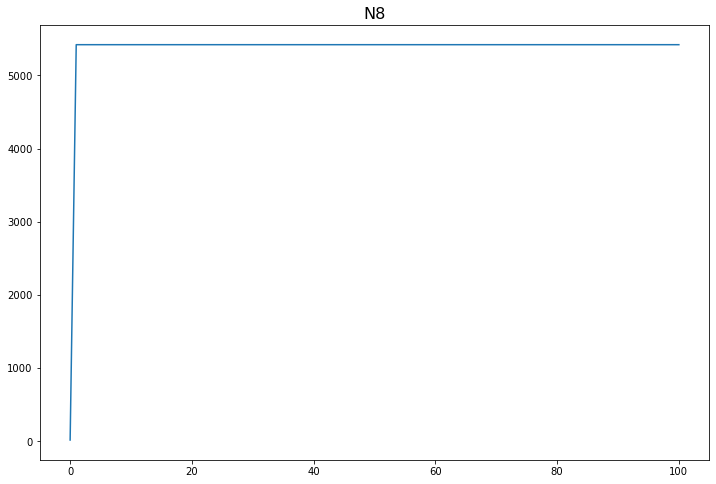

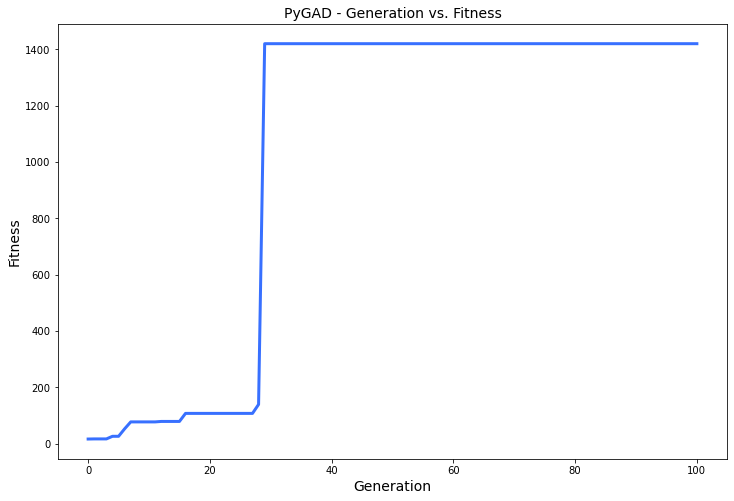

[-0.289]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 30.294 |==================| 3.314 |==========
[0.571]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.571 |===========| 29.974 |==================| 1.61 |==========
[0.057]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 30.538 |==================| 17.346 |==========
[-0.225]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 30.363 |==================| 4.309 |==========
[-0.925]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.925 |===========| 29.542 |==================| 0.949 |==========
[-0.509]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.509 |===========| 30.047 |==================| 1.824 |==========
[-0.348]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.712 |===========| 24.151 |==================| 4.517 |==========
[0.42]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 24.242 |==================| 7.674 |==========
[0.705]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.705 |===========| 24.153 |==================| 4.559 |==========
[0.299]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 24.279 |==================| 10.772 |==========
[-0.644]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 24.172 |==================| 4.993 |==========
[0.696]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 24.156 |==================| 4.616 |==========
[0.728]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.728 |===========| 24.146 |==================| 4.415 |==========
[0.838]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 24.111 |==================| 3.831 |==========
[0.4]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 24.248 |==================| 8.046 |==========
[0.675]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.675 |===========| 24.162 |==================| 4.761 |==========
Fitness = 447.6255080537119
[0.299]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 24.279 |==================| 10.772 |==========
[-0.644]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 24.172 |==================| 4.993 |==========
[0.696]
=====|SOLUTION|===========|OUTPUT|================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.728 |===========| 24.146 |==================| 4.415 |==========
[0.838]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 24.111 |==================| 3.831 |==========
[0.4]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 24.248 |==================| 8.046 |==========
[0.675]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.675 |===========| 24.162 |==================| 4.761 |==========
[0.299]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 24.279 |==================| 10.772 |==========
[-0.644]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 24.172 |==================| 4.993 |==========
[0.696]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 24.264 |==================| 9.22 |==========
[0.05]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 24.357 |==================| 64.3 |==========
[0.343]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 24.266 |==================| 9.384 |==========
[0.964]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 24.072 |==================| 3.328 |==========
Generation = 2
[-0.605]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.605 |===========| 24.184 |==================| 5.313 |==========
[0.23]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 24.301 |==================| 14.021 |==========
[-0.565]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 24.224 |==================| 6.764 |==========
[-0.35]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 24.264 |==================| 9.22 |==========
[0.05]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 24.357 |==================| 64.3 |==========
[0.343]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 24.266 |==================| 9.384 |==========
[0.964]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 24.072 |==================| 3.328 |==========
Change = 0.0
[-0.605]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.605 |===========| 24.184 |==================| 5.313 |==========
[0.23]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 24.288 |==================| 11.847 |==========
[0.476]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 24.224 |==================| 6.764 |==========
[-0.35]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 24.264 |==================| 9.22 |==========
[0.05]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 24.357 |==================| 64.3 |==========
[0.343]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 24.266 |==================| 9.384 |==========
[0.964]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 24.072 |==================| 3.328 |==========
[-0.265]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.91 |===========| 24.089 |==================| 3.528 |==========
[0.016]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 24.367 |==================| 196.236 |==========
[-0.368]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 24.258 |==================| 8.756 |==========
[0.495]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 24.218 |==================| 6.503 |==========
[-0.738]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.738 |===========| 24.143 |==================| 4.352 |==========
[-0.644]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 24.172 |==================| 4.993 |==========
Fitness = 447.6255080537119
[-0.265]
=====|SOLUTION|===========|OUTPUT|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 24.232 |==================| 7.135 |==========
[0.91]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.91 |===========| 24.089 |==================| 3.528 |==========
[0.016]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 24.367 |==================| 196.236 |==========
[-0.368]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 24.258 |==================| 8.756 |==========
[0.495]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 24.218 |==================| 6.503 |==========
[-0.738]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.738 |===========| 24.143 |==================| 4.352 |==========
[-0.644]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 24.27 |==================| 9.765 |==========
[0.83]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 24.114 |==================| 3.871 |==========
[0.149]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 24.326 |==================| 21.667 |==========
[0.957]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.957 |===========| 24.074 |==================| 3.352 |==========
[-0.962]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.962 |===========| 24.072 |==================| 3.336 |==========
[-0.009]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 24.37 |==================| 374.358 |==========
Generation = 4
[-0.489]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 24.114 |==================| 3.871 |==========
[0.149]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 24.326 |==================| 21.667 |==========
[0.957]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.957 |===========| 24.074 |==================| 3.352 |==========
[-0.962]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.962 |===========| 24.072 |==================| 3.336 |==========
[-0.009]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 24.37 |==================| 374.358 |==========
Change = 0.0
[-0.489]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 24.22 |==================| 6.585 |==========
[-0.883]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 24.27 |==================| 9.765 |==========
[0.83]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 24.114 |==================| 3.871 |==========
[0.149]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 24.326 |==================| 21.667 |==========
[0.957]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.957 |===========| 24.074 |==================| 3.352 |==========
[-0.962]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.962 |===========| 24.072 |==================| 3.336 |==========
[-0.009]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 24.37 |==================| 374.358 |==========
[-0.453]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.705 |===========| 24.153 |==================| 4.561 |==========
[-0.609]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.609 |===========| 24.183 |==================| 5.284 |==========
[-0.697]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.697 |===========| 24.155 |==================| 4.611 |==========
[-0.658]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.658 |===========| 24.168 |==================| 4.886 |==========
[0.207]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 24.308 |==================| 15.585 |==========
[-0.795]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.795 |===========| 24.125 |==================| 4.039 |==========
[0.259]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.609 |===========| 24.183 |==================| 5.284 |==========
[-0.697]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.697 |===========| 24.155 |==================| 4.611 |==========
[-0.658]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.658 |===========| 24.168 |==================| 4.886 |==========
[0.207]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 24.308 |==================| 15.585 |==========
[-0.795]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.795 |===========| 24.125 |==================| 4.039 |==========
[0.259]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 24.292 |==================| 12.468 |==========
[-0.453]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 24.249 |==================| 8.1 |==========
[0.359]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 24.261 |==================| 8.98 |==========
[0.793]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.793 |===========| 24.125 |==================| 4.05 |==========
[0.266]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 24.29 |==================| 12.141 |==========
[-0.871]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.871 |===========| 24.101 |==================| 3.688 |==========
[0.048]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 24.357 |==================| 66.83 |==========
[-0.899]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 24.249 |==================| 8.1 |==========
[0.359]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 24.261 |==================| 8.98 |==========
[0.793]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.793 |===========| 24.125 |==================| 4.05 |==========
[0.266]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 24.29 |==================| 12.141 |==========
[-0.871]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.871 |===========| 24.101 |==================| 3.688 |==========
[0.048]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 24.357 |==================| 66.83 |==========
[-0.899]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 24.249 |==================| 8.1 |==========
[0.359]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 24.261 |==================| 8.98 |==========
[0.793]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.793 |===========| 24.125 |==================| 4.05 |==========
[0.266]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 24.29 |==================| 12.141 |==========
[-0.871]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.871 |===========| 24.101 |==================| 3.688 |==========
[0.048]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 24.357 |==================| 66.83 |==========
[-0.899]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 24.347 |==================| 40.146 |==========
[0.174]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.174 |===========| 24.318 |==================| 18.584 |==========
[0.222]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 24.303 |==================| 14.522 |==========
[1.003]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.003 |===========| 24.06 |==================| 3.199 |==========
[0.142]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.142 |===========| 24.328 |==================| 22.698 |==========
[0.536]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 24.206 |==================| 6.003 |==========
[-0.348]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.735 |===========| 24.144 |==================| 4.372 |==========
[0.08]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 24.347 |==================| 40.146 |==========
[0.174]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.174 |===========| 24.318 |==================| 18.584 |==========
[0.222]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 24.303 |==================| 14.522 |==========
[1.003]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.003 |===========| 24.06 |==================| 3.199 |==========
[0.142]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.142 |===========| 24.328 |==================| 22.698 |==========
[0.536]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.949 |===========| 24.076 |==================| 3.38 |==========
[0.539]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.539 |===========| 24.205 |==================| 5.973 |==========
[0.094]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 24.343 |==================| 34.28 |==========
[-0.341]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 24.267 |==================| 9.462 |==========
[-0.365]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 24.259 |==================| 8.822 |==========
[0.904]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.904 |===========| 24.091 |==================| 3.552 |==========
[0.773]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.949 |===========| 24.076 |==================| 3.38 |==========
[0.539]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.539 |===========| 24.205 |==================| 5.973 |==========
[0.094]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 24.343 |==================| 34.28 |==========
[-0.341]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 24.267 |==================| 9.462 |==========
[-0.365]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 24.259 |==================| 8.822 |==========
[0.904]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.904 |===========| 24.091 |==================| 3.552 |==========
[0.773]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.71 |===========| 24.151 |==================| 4.528 |==========
[0.949]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.949 |===========| 24.076 |==================| 3.38 |==========
[0.539]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.539 |===========| 24.205 |==================| 5.973 |==========
[0.094]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 24.343 |==================| 34.28 |==========
[-0.341]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 24.267 |==================| 9.462 |==========
[-0.365]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 24.259 |==================| 8.822 |==========
[0.904]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.741 |===========| 24.142 |==================| 4.335 |==========
[-0.009]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 24.369 |==================| 355.096 |==========
[-0.448]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 24.233 |==================| 7.191 |==========
[-0.39]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 24.251 |==================| 8.267 |==========
[0.17]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 24.32 |==================| 19.038 |==========
[0.78]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.78 |===========| 24.129 |==================| 4.116 |==========
[0.58]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

[-0.741]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.741 |===========| 24.142 |==================| 4.335 |==========
[-0.009]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 24.369 |==================| 355.096 |==========
[-0.448]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 24.233 |==================| 7.191 |==========
[-0.39]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 24.251 |==================| 8.267 |==========
[0.17]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 24.32 |==================| 19.038 |==========
[0.78]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.78 |===========| 24.129 |==================| 4.116 |==========
[0.58]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.966 |===========| 24.071 |==================| 3.322 |==========
[-0.412]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 24.244 |==================| 7.819 |==========
[-0.95]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 24.076 |==================| 3.378 |==========
[-0.528]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 24.208 |==================| 6.101 |==========
[-0.72]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.72 |===========| 24.148 |==================| 4.464 |==========
[-0.105]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 24.34 |==================| 30.612 |==========
[-0.626]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.941 |===========| 24.079 |==================| 3.41 |==========
[-0.966]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.966 |===========| 24.071 |==================| 3.322 |==========
[-0.412]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 24.244 |==================| 7.819 |==========
[-0.95]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 24.076 |==================| 3.378 |==========
[-0.528]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 24.208 |==================| 6.101 |==========
[-0.72]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.72 |===========| 24.148 |==================| 4.464 |==========
[-0.105]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 24.233 |==================| 7.175 |==========
[-0.941]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.941 |===========| 24.079 |==================| 3.41 |==========
[-0.966]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.966 |===========| 24.071 |==================| 3.322 |==========
[-0.412]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 24.244 |==================| 7.819 |==========
[-0.95]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 24.076 |==================| 3.378 |==========
[-0.528]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 24.208 |==================| 6.101 |==========
[-0.72]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.771 |===========| 24.132 |==================| 4.169 |==========
[-0.848]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.848 |===========| 24.108 |==================| 3.786 |==========
[-0.791]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.791 |===========| 24.126 |==================| 4.062 |==========
[-0.408]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 24.245 |==================| 7.888 |==========
[0.831]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 24.114 |==================| 3.865 |==========
[0.611]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.611 |===========| 24.182 |==================| 5.263 |==========
[0.036]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.951 |===========| 24.076 |==================| 3.373 |==========
[0.771]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.771 |===========| 24.132 |==================| 4.169 |==========
[-0.848]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.848 |===========| 24.108 |==================| 3.786 |==========
[-0.791]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.791 |===========| 24.126 |==================| 4.062 |==========
[-0.408]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 24.245 |==================| 7.888 |==========
[0.831]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 24.114 |==================| 3.865 |==========
[0.611]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 24.138 |==================| 4.275 |==========
[0.351]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 24.263 |==================| 9.193 |==========
[0.056]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 24.355 |==================| 57.19 |==========
[-0.88]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.88 |===========| 24.098 |==================| 3.649 |==========
[0.462]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 24.229 |==================| 6.971 |==========
[0.754]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.754 |===========| 24.138 |==================| 4.262 |==========
[0.168]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 24.263 |==================| 9.193 |==========
[0.056]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 24.355 |==================| 57.19 |==========
[-0.88]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.88 |===========| 24.098 |==================| 3.649 |==========
[0.462]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 24.229 |==================| 6.971 |==========
[0.754]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.754 |===========| 24.138 |==================| 4.262 |==========
[0.168]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.168 |===========| 24.32 |==================| 19.194 |==========
[-0.191]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 24.355 |==================| 57.19 |==========
[-0.88]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.88 |===========| 24.098 |==================| 3.649 |==========
[0.462]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 24.229 |==================| 6.971 |==========
[0.754]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.754 |===========| 24.138 |==================| 4.262 |==========
[0.168]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.168 |===========| 24.32 |==================| 19.194 |==========
[-0.191]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 24.313 |==================| 16.931 |==========
[0.175]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.742 |===========| 24.141 |==================| 4.33 |==========
[-0.813]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.813 |===========| 24.119 |==================| 3.95 |==========
[0.226]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 24.302 |==================| 14.268 |==========
[-0.862]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.862 |===========| 24.104 |==================| 3.725 |==========
[0.31]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 24.276 |==================| 10.413 |==========
[0.268]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 24.289 |==================| 12.037 |==========
[0.81]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.813 |===========| 24.119 |==================| 3.95 |==========
[0.226]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 24.302 |==================| 14.268 |==========
[-0.862]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.862 |===========| 24.104 |==================| 3.725 |==========
[0.31]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 24.276 |==================| 10.413 |==========
[0.268]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 24.289 |==================| 12.037 |==========
[0.81]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.81 |===========| 24.12 |==================| 3.968 |==========
[0.033]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.772 |===========| 24.132 |==================| 4.163 |==========
[0.708]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.708 |===========| 24.152 |==================| 4.538 |==========
[0.066]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 24.352 |==================| 48.682 |==========
[0.856]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.856 |===========| 24.106 |==================| 3.75 |==========
[0.681]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 24.16 |==================| 4.719 |==========
[0.509]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.509 |===========| 24.214 |==================| 6.326 |==========
[0.776]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 24.326 |==================| 21.486 |==========
[0.772]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.772 |===========| 24.132 |==================| 4.163 |==========
[0.708]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.708 |===========| 24.152 |==================| 4.538 |==========
[0.066]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 24.352 |==================| 48.682 |==========
[0.856]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.856 |===========| 24.106 |==================| 3.75 |==========
[0.681]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 24.16 |==================| 4.719 |==========
[0.509]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.772 |===========| 24.132 |==================| 4.163 |==========
[0.708]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.708 |===========| 24.152 |==================| 4.538 |==========
[0.066]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 24.352 |==================| 48.682 |==========
[0.856]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.856 |===========| 24.106 |==================| 3.75 |==========
[0.681]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 24.16 |==================| 4.719 |==========
[0.509]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.509 |===========| 24.214 |==================| 6.326 |==========
[0.776]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.787 |===========| 24.127 |==================| 4.083 |==========
[-0.993]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.993 |===========| 24.063 |==================| 3.232 |==========
[0.449]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 24.233 |==================| 7.175 |==========
[-0.48]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 24.223 |==================| 6.702 |==========
[0.706]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.706 |===========| 24.153 |==================| 4.55 |==========
[0.562]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.562 |===========| 24.198 |==================| 5.724 |==========
[0.552]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.787 |===========| 24.127 |==================| 4.083 |==========
[-0.993]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.993 |===========| 24.063 |==================| 3.232 |==========
[0.449]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 24.233 |==================| 7.175 |==========
[-0.48]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 24.223 |==================| 6.702 |==========
[0.706]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.706 |===========| 24.153 |==================| 4.55 |==========
[0.562]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.562 |===========| 24.198 |==================| 5.724 |==========
[0.552]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 24.34 |==================| 30.685 |==========
[-0.544]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.544 |===========| 24.203 |==================| 5.915 |==========
[0.069]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 24.351 |==================| 46.526 |==========
[-0.301]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 24.279 |==================| 10.702 |==========
[0.135]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 24.33 |==================| 23.832 |==========
[-0.558]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.558 |===========| 24.199 |==================| 5.764 |==========
[0.533]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.544 |===========| 24.203 |==================| 5.915 |==========
[0.069]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 24.351 |==================| 46.526 |==========
[-0.301]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 24.279 |==================| 10.702 |==========
[0.135]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 24.33 |==================| 23.832 |==========
[-0.558]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.558 |===========| 24.199 |==================| 5.764 |==========
[0.533]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.533 |===========| 24.207 |==================| 6.037 |==========
Change = 0.0
[-0.064]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.544 |===========| 24.203 |==================| 5.915 |==========
[0.069]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 24.351 |==================| 46.526 |==========
[-0.301]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 24.279 |==================| 10.702 |==========
[0.135]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 24.33 |==================| 23.832 |==========
[-0.558]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.558 |===========| 24.199 |==================| 5.764 |==========
[0.533]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.533 |===========| 24.207 |==================| 6.037 |==========
[0.204]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


[0.36]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 24.26 |==================| 8.943 |==========
[0.498]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.498 |===========| 24.218 |==================| 6.467 |==========
[0.483]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 24.222 |==================| 6.662 |==========
[-0.422]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 24.241 |==================| 7.64 |==========
[-0.767]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 24.134 |==================| 4.189 |==========
[0.7]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.7 |===========| 24.154 |==================| 4.59 |==========
Fitness = 447.6255080537119
[0.204]
=====|SOLUTION|===========|OUTPUT|=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 24.26 |==================| 8.943 |==========
[0.498]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.498 |===========| 24.218 |==================| 6.467 |==========
[0.483]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 24.222 |==================| 6.662 |==========
[-0.422]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 24.241 |==================| 7.64 |==========
[-0.767]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 24.134 |==================| 4.189 |==========
[0.7]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.7 |===========| 24.154 |==================| 4.59 |==========
[0.204]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.626 |===========| 24.178 |==================| 5.138 |==========
[-0.648]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.648 |===========| 24.171 |==================| 4.963 |==========
[0.539]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.539 |===========| 24.205 |==================| 5.967 |==========
[-0.952]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.952 |===========| 24.076 |==================| 3.37 |==========
Generation = 18
[-0.795]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.795 |===========| 24.125 |==================| 4.04 |==========
[0.236]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 24.299 |==================| 13.671 |==========
[0.486]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.648 |===========| 24.171 |==================| 4.963 |==========
[0.539]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.539 |===========| 24.205 |==================| 5.967 |==========
[-0.952]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.952 |===========| 24.076 |==================| 3.37 |==========
Change = 0.0
[-0.795]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.795 |===========| 24.125 |==================| 4.04 |==========
[0.236]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 24.299 |==================| 13.671 |==========
[0.486]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 24.221 |==================| 6.628 |==========
[-0.847]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|

[-0.648]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.648 |===========| 24.171 |==================| 4.963 |==========
[0.539]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.539 |===========| 24.205 |==================| 5.967 |==========
[-0.952]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.952 |===========| 24.076 |==================| 3.37 |==========
[0.978]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.978 |===========| 24.068 |==================| 3.281 |==========
[0.498]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.498 |===========| 24.218 |==================| 6.466 |==========
[0.949]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.949 |===========| 24.077 |==================| 3.382 |==========
[-0.057]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 24.265 |==================| 9.282 |==========
[0.995]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.995 |===========| 24.062 |==================| 3.224 |==========
[-0.437]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 24.237 |==================| 7.375 |==========
Fitness = 447.6255080537119
[0.978]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.978 |===========| 24.068 |==================| 3.281 |==========
[0.498]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.498 |===========| 24.218 |==================| 6.466 |==========
[0.949]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.949 |===========| 24.077 |==================| 3.382 |==========
[-0.057]
=====|SOLUTION|===========|OUTPUT|============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.406 |===========| 24.246 |==================| 7.93 |==========
[-0.347]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 24.265 |==================| 9.282 |==========
[0.995]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.995 |===========| 24.062 |==================| 3.224 |==========
[-0.437]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 24.237 |==================| 7.375 |==========
[0.978]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.978 |===========| 24.068 |==================| 3.281 |==========
[0.498]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.498 |===========| 24.218 |==================| 6.466 |==========
[0.949]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.375 |===========| 24.256 |==================| 8.593 |==========
[0.563]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.563 |===========| 24.197 |==================| 5.713 |==========
[0.896]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.896 |===========| 24.093 |==================| 3.582 |==========
[0.814]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.814 |===========| 24.119 |==================| 3.944 |==========
Generation = 20
[0.068]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 24.351 |==================| 47.158 |==========
[-0.861]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.861 |===========| 24.104 |==================| 3.73 |==========
[0.583]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.375 |===========| 24.256 |==================| 8.593 |==========
[0.563]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.563 |===========| 24.197 |==================| 5.713 |==========
[0.896]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.896 |===========| 24.093 |==================| 3.582 |==========
[0.814]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.814 |===========| 24.119 |==================| 3.944 |==========
Change = 0.0
[0.068]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 24.351 |==================| 47.158 |==========
[-0.861]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.861 |===========| 24.104 |==================| 3.73 |==========
[0.583]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.635 |===========| 24.175 |==================| 5.064 |==========
[0.375]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.375 |===========| 24.256 |==================| 8.593 |==========
[0.563]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.563 |===========| 24.197 |==================| 5.713 |==========
[0.896]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.896 |===========| 24.093 |==================| 3.582 |==========
[0.814]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.814 |===========| 24.119 |==================| 3.944 |==========
[0.582]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.582 |===========| 24.191 |==================| 5.527 |==========
[0.718]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 24.292 |==================| 12.407 |==========
[-0.221]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 24.304 |==================| 14.619 |==========
[-0.61]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.61 |===========| 24.182 |==================| 5.269 |==========
[-0.613]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.613 |===========| 24.182 |==================| 5.247 |==========
[-0.831]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 24.114 |==================| 3.866 |==========
[0.758]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 24.136 |==================| 4.24 |==========
Fitness = 447.6255080537119
[0.582]
=====|SOLUTION|===========|OUTPUT|============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 24.304 |==================| 14.619 |==========
[-0.61]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.61 |===========| 24.182 |==================| 5.269 |==========
[-0.613]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.613 |===========| 24.182 |==================| 5.247 |==========
[-0.831]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 24.114 |==================| 3.866 |==========
[0.758]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 24.136 |==================| 4.24 |==========
[0.582]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.582 |===========| 24.191 |==================| 5.527 |==========
[0.718]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.871 |===========| 24.101 |==================| 3.684 |==========
[0.935]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.935 |===========| 24.081 |==================| 3.433 |==========
[0.807]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.807 |===========| 24.121 |==================| 3.978 |==========
[0.154]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 24.324 |==================| 20.894 |==========
[-0.014]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 24.368 |==================| 229.903 |==========
Generation = 22
[-0.203]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 24.309 |==================| 15.877 |==========
[0.795]
=====|SOLUTION|===========|OUTPUT|==================|F

[-0.156]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 24.324 |==================| 20.636 |==========
[-0.871]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.871 |===========| 24.101 |==================| 3.684 |==========
[0.935]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.935 |===========| 24.081 |==================| 3.433 |==========
[0.807]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.807 |===========| 24.121 |==================| 3.978 |==========
[0.154]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 24.324 |==================| 20.894 |==========
[-0.014]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 24.368 |==================| 229.903 |==========
Change = 0.0
[-0.203]
=====|SOLUTION|===========|OUTPUT|=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 24.263 |==================| 9.189 |==========
[-0.156]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 24.324 |==================| 20.636 |==========
[-0.871]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.871 |===========| 24.101 |==================| 3.684 |==========
[0.935]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.935 |===========| 24.081 |==================| 3.433 |==========
[0.807]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.807 |===========| 24.121 |==================| 3.978 |==========
[0.154]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 24.324 |==================| 20.894 |==========
[-0.014]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 24.107 |==================| 3.774 |==========
[-0.136]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 24.33 |==================| 23.671 |==========
[0.096]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.096 |===========| 24.343 |==================| 33.757 |==========
[0.725]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 24.147 |==================| 4.433 |==========
[0.993]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.993 |===========| 24.063 |==================| 3.23 |==========
[0.146]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 24.327 |==================| 22.113 |==========
Fitness = 447.6255080537119
[-0.028]
=====|SOLUTION|===========|OUTPUT|===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 24.271 |==================| 9.86 |==========
[0.851]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 24.107 |==================| 3.774 |==========
[-0.136]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 24.33 |==================| 23.671 |==========
[0.096]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.096 |===========| 24.343 |==================| 33.757 |==========
[0.725]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 24.147 |==================| 4.433 |==========
[0.993]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.993 |===========| 24.063 |==================| 3.23 |==========
[0.146]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.929 |===========| 24.083 |==================| 3.454 |==========
[0.932]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.932 |===========| 24.082 |==================| 3.443 |==========
[-0.177]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 24.317 |==================| 18.211 |==========
[-0.343]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 24.266 |==================| 9.407 |==========
[0.828]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.828 |===========| 24.114 |==================| 3.879 |==========
[0.25]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 24.295 |==================| 12.876 |==========
[0.452]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.929 |===========| 24.083 |==================| 3.454 |==========
[0.932]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.932 |===========| 24.082 |==================| 3.443 |==========
[-0.177]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 24.317 |==================| 18.211 |==========
[-0.343]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 24.266 |==================| 9.407 |==========
[0.828]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.828 |===========| 24.114 |==================| 3.879 |==========
[0.25]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 24.295 |==================| 12.876 |==========
[0.452]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.929 |===========| 24.083 |==================| 3.454 |==========
[0.932]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.932 |===========| 24.082 |==================| 3.443 |==========
[-0.177]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 24.317 |==================| 18.211 |==========
[-0.343]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 24.266 |==================| 9.407 |==========
[0.828]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.828 |===========| 24.114 |==================| 3.879 |==========
[0.25]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 24.295 |==================| 12.876 |==========
[0.452]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 24.264 |==================| 9.237 |==========
[-0.208]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 24.308 |==================| 15.521 |==========
[-0.503]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.503 |===========| 24.216 |==================| 6.395 |==========
[0.095]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 24.343 |==================| 33.963 |==========
[0.756]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.756 |===========| 24.137 |==================| 4.252 |==========
[0.287]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 24.283 |==================| 11.221 |==========
[-0.844]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 24.264 |==================| 9.237 |==========
[-0.208]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 24.308 |==================| 15.521 |==========
[-0.503]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.503 |===========| 24.216 |==================| 6.395 |==========
[0.095]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 24.343 |==================| 33.963 |==========
[0.756]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.756 |===========| 24.137 |==================| 4.252 |==========
[0.287]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 24.283 |==================| 11.221 |==========
[-0.844]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.651 |===========| 24.17 |==================| 4.937 |==========
[-0.369]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 24.258 |==================| 8.728 |==========
[0.746]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.746 |===========| 24.14 |==================| 4.305 |==========
[0.261]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 24.291 |==================| 12.346 |==========
[0.749]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.749 |===========| 24.139 |==================| 4.29 |==========
[-0.625]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.625 |===========| 24.178 |==================| 5.144 |==========
[0.302]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.651 |===========| 24.17 |==================| 4.937 |==========
[-0.369]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 24.258 |==================| 8.728 |==========
[0.746]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.746 |===========| 24.14 |==================| 4.305 |==========
[0.261]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 24.291 |==================| 12.346 |==========
[0.749]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.749 |===========| 24.139 |==================| 4.29 |==========
[-0.625]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.625 |===========| 24.178 |==================| 5.144 |==========
[0.302]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.651 |===========| 24.17 |==================| 4.937 |==========
[-0.369]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 24.258 |==================| 8.728 |==========
[0.746]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.746 |===========| 24.14 |==================| 4.305 |==========
[0.261]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 24.291 |==================| 12.346 |==========
[0.749]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.749 |===========| 24.139 |==================| 4.29 |==========
[-0.625]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.625 |===========| 24.178 |==================| 5.144 |==========
[0.302]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.866 |===========| 24.103 |==================| 3.709 |==========
[-0.765]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 24.134 |==================| 4.198 |==========
[-0.974]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.974 |===========| 24.069 |==================| 3.295 |==========
[0.354]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 24.262 |==================| 9.097 |==========
[0.502]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 24.216 |==================| 6.415 |==========
[-0.897]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 24.093 |==================| 3.577 |==========
[-0.582]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.866 |===========| 24.103 |==================| 3.709 |==========
[-0.765]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 24.134 |==================| 4.198 |==========
[-0.974]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.974 |===========| 24.069 |==================| 3.295 |==========
[0.354]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 24.262 |==================| 9.097 |==========
[0.502]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 24.216 |==================| 6.415 |==========
[-0.897]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 24.093 |==================| 3.577 |==========
[-0.582]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.864 |===========| 24.103 |==================| 3.716 |==========
[0.626]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.626 |===========| 24.178 |==================| 5.136 |==========
[0.875]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.875 |===========| 24.1 |==================| 3.667 |==========
[-0.458]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 24.23 |==================| 7.029 |==========
[0.488]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 24.221 |==================| 6.603 |==========
[-0.337]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========| 24.268 |==================| 9.569 |==========
[0.674]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.864 |===========| 24.103 |==================| 3.716 |==========
[0.626]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.626 |===========| 24.178 |==================| 5.136 |==========
[0.875]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.875 |===========| 24.1 |==================| 3.667 |==========
[-0.458]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 24.23 |==================| 7.029 |==========
[0.488]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 24.221 |==================| 6.603 |==========
[-0.337]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========| 24.268 |==================| 9.569 |==========
[0.674]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.928 |===========| 24.083 |==================| 3.458 |==========
[0.864]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.864 |===========| 24.103 |==================| 3.716 |==========
[0.626]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.626 |===========| 24.178 |==================| 5.136 |==========
[0.875]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.875 |===========| 24.1 |==================| 3.667 |==========
[-0.458]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 24.23 |==================| 7.029 |==========
[0.488]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 24.221 |==================| 6.603 |==========
[-0.337]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.842 |===========| 24.11 |==================| 3.812 |==========
[0.273]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 24.287 |==================| 11.793 |==========
[-0.626]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.626 |===========| 24.178 |==================| 5.138 |==========
[0.912]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.912 |===========| 24.088 |==================| 3.517 |==========
[0.762]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.762 |===========| 24.135 |==================| 4.218 |==========
[0.063]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 24.353 |==================| 51.23 |==========
[-0.955]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.842 |===========| 24.11 |==================| 3.812 |==========
[0.273]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 24.287 |==================| 11.793 |==========
[-0.626]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.626 |===========| 24.178 |==================| 5.138 |==========
[0.912]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.912 |===========| 24.088 |==================| 3.517 |==========
[0.762]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.762 |===========| 24.135 |==================| 4.218 |==========
[0.063]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 24.353 |==================| 51.23 |==========
[-0.955]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.006 |===========| 24.37 |==================| 550.307 |==========
[-0.361]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 24.26 |==================| 8.932 |==========
[-0.051]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 24.356 |==================| 63.291 |==========
[0.813]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.813 |===========| 24.119 |==================| 3.951 |==========
[-0.063]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 24.353 |==================| 50.895 |==========
[-0.156]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 24.324 |==================| 20.754 |==========
[0.869]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.006 |===========| 24.37 |==================| 550.307 |==========
[-0.361]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 24.26 |==================| 8.932 |==========
[-0.051]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 24.356 |==================| 63.291 |==========
[0.813]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.813 |===========| 24.119 |==================| 3.951 |==========
[-0.063]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 24.353 |==================| 50.895 |==========
[-0.156]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 24.324 |==================| 20.754 |==========
[0.869]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.006 |===========| 24.37 |==================| 550.307 |==========
[-0.361]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 24.26 |==================| 8.932 |==========
[-0.051]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 24.356 |==================| 63.291 |==========
[0.813]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.813 |===========| 24.119 |==================| 3.951 |==========
[-0.063]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 24.353 |==================| 50.895 |==========
[-0.156]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 24.324 |==================| 20.754 |==========
[0.869]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

[-0.897]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 24.093 |==================| 3.578 |==========
[-0.522]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.522 |===========| 24.21 |==================| 6.164 |==========
[0.255]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 24.293 |==================| 12.669 |==========
[-0.645]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.645 |===========| 24.172 |==================| 4.986 |==========
[-0.382]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 24.254 |==================| 8.426 |==========
[0.473]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 24.225 |==================| 6.811 |==========
[0.87]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 24.093 |==================| 3.578 |==========
[-0.522]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.522 |===========| 24.21 |==================| 6.164 |==========
[0.255]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 24.293 |==================| 12.669 |==========
[-0.645]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.645 |===========| 24.172 |==================| 4.986 |==========
[-0.382]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 24.254 |==================| 8.426 |==========
[0.473]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 24.225 |==================| 6.811 |==========
[0.87]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.942 |===========| 24.079 |==================| 3.406 |==========
[0.2]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 24.31 |==================| 16.155 |==========
[-0.931]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 24.082 |==================| 3.446 |==========
[0.156]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 24.324 |==================| 20.743 |==========
[0.178]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 24.317 |==================| 18.164 |==========
[-0.976]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.976 |===========| 24.068 |==================| 3.286 |==========
[-0.982]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.653 |===========| 24.169 |==================| 4.923 |==========
[-0.942]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.942 |===========| 24.079 |==================| 3.406 |==========
[0.2]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 24.31 |==================| 16.155 |==========
[-0.931]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 24.082 |==================| 3.446 |==========
[0.156]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 24.324 |==================| 20.743 |==========
[0.178]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 24.317 |==================| 18.164 |==========
[-0.976]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.556 |===========| 24.2 |==================| 5.792 |==========
[-0.653]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.653 |===========| 24.169 |==================| 4.923 |==========
[-0.942]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.942 |===========| 24.079 |==================| 3.406 |==========
[0.2]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 24.31 |==================| 16.155 |==========
[-0.931]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 24.082 |==================| 3.446 |==========
[0.156]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 24.324 |==================| 20.743 |==========
[0.178]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 24.235 |==================| 7.275 |==========
[0.639]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 24.174 |==================| 5.036 |==========
[-0.787]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.787 |===========| 24.127 |==================| 4.082 |==========
[-0.904]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.904 |===========| 24.091 |==================| 3.549 |==========
[-0.813]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.813 |===========| 24.119 |==================| 3.952 |==========
[0.449]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 24.233 |==================| 7.175 |==========
[-0.031]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


[-0.713]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.713 |===========| 24.151 |==================| 4.51 |==========
[-0.443]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 24.235 |==================| 7.275 |==========
[0.639]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 24.174 |==================| 5.036 |==========
[-0.787]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.787 |===========| 24.127 |==================| 4.082 |==========
[-0.904]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.904 |===========| 24.091 |==================| 3.549 |==========
[-0.813]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.813 |===========| 24.119 |==================| 3.952 |==========
[0.449]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 24.296 |==================| 13.172 |==========
[0.751]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.751 |===========| 24.139 |==================| 4.28 |==========
[-0.227]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 24.302 |==================| 14.213 |==========
[-0.369]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 24.258 |==================| 8.744 |==========
[-0.741]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.741 |===========| 24.142 |==================| 4.336 |==========
[0.755]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.755 |===========| 24.137 |==================| 4.254 |==========
[-0.054]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

[0.751]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.751 |===========| 24.139 |==================| 4.28 |==========
[-0.227]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 24.302 |==================| 14.213 |==========
[-0.369]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 24.258 |==================| 8.744 |==========
[-0.741]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.741 |===========| 24.142 |==================| 4.336 |==========
[0.755]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.755 |===========| 24.137 |==================| 4.254 |==========
[-0.054]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 24.356 |==================| 60.192 |==========
[0.026]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.751 |===========| 24.139 |==================| 4.28 |==========
[-0.227]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 24.302 |==================| 14.213 |==========
[-0.369]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 24.258 |==================| 8.744 |==========
[-0.741]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.741 |===========| 24.142 |==================| 4.336 |==========
[0.755]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.755 |===========| 24.137 |==================| 4.254 |==========
[-0.054]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 24.356 |==================| 60.192 |==========
[0.026]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.677 |===========| 24.162 |==================| 4.751 |==========
[-0.916]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.916 |===========| 24.087 |==================| 3.505 |==========
[-0.668]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 24.164 |==================| 4.811 |==========
[-0.647]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.647 |===========| 24.171 |==================| 4.971 |==========
[0.4]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 24.248 |==================| 8.06 |==========
[-0.089]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 24.345 |==================| 36.113 |==========
[-0.549]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.677 |===========| 24.162 |==================| 4.751 |==========
[-0.916]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.916 |===========| 24.087 |==================| 3.505 |==========
[-0.668]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 24.164 |==================| 4.811 |==========
[-0.647]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.647 |===========| 24.171 |==================| 4.971 |==========
[0.4]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 24.248 |==================| 8.06 |==========
[-0.089]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 24.345 |==================| 36.113 |==========
[-0.549]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 24.357 |==================| 65.211 |==========
[0.434]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 24.237 |==================| 7.418 |==========
[-0.227]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 24.302 |==================| 14.196 |==========
[-0.158]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 24.323 |==================| 20.398 |==========
[0.725]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 24.147 |==================| 4.433 |==========
[-0.712]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.712 |===========| 24.151 |==================| 4.514 |==========
[-0.583]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 24.237 |==================| 7.418 |==========
[-0.227]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 24.302 |==================| 14.196 |==========
[-0.158]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 24.323 |==================| 20.398 |==========
[0.725]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 24.147 |==================| 4.433 |==========
[-0.712]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.712 |===========| 24.151 |==================| 4.514 |==========
[-0.583]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.583 |===========| 24.191 |==================| 5.514 |==========
[-0.07]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 24.237 |==================| 7.418 |==========
[-0.227]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 24.302 |==================| 14.196 |==========
[-0.158]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 24.323 |==================| 20.398 |==========
[0.725]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 24.147 |==================| 4.433 |==========
[-0.712]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.712 |===========| 24.151 |==================| 4.514 |==========
[-0.583]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.583 |===========| 24.191 |==================| 5.514 |==========
[-0.07]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 24.319 |==================| 18.927 |==========
[-0.172]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 24.319 |==================| 18.812 |==========
[-0.908]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.908 |===========| 24.089 |==================| 3.534 |==========
[0.926]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.926 |===========| 24.084 |==================| 3.466 |==========
[-0.908]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.908 |===========| 24.089 |==================| 3.534 |==========
[-0.991]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.991 |===========| 24.063 |==================| 3.237 |==========
[0.912]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 24.319 |==================| 18.812 |==========
[-0.908]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.908 |===========| 24.089 |==================| 3.534 |==========
[0.926]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.926 |===========| 24.084 |==================| 3.466 |==========
[-0.908]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.908 |===========| 24.089 |==================| 3.534 |==========
[-0.991]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.991 |===========| 24.063 |==================| 3.237 |==========
[0.912]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.912 |===========| 24.088 |==================| 3.521 |==========
[0.044]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


[0.262]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.262 |===========| 24.291 |==================| 12.32 |==========
[-0.05]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 24.357 |==================| 64.941 |==========
[-0.443]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 24.235 |==================| 7.27 |==========
[0.295]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.295 |===========| 24.281 |==================| 10.939 |==========
[0.143]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 24.328 |==================| 22.56 |==========
[-0.473]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 24.225 |==================| 6.803 |==========
[0.485]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 24.357 |==================| 64.941 |==========
[-0.443]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 24.235 |==================| 7.27 |==========
[0.295]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.295 |===========| 24.281 |==================| 10.939 |==========
[0.143]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 24.328 |==================| 22.56 |==========
[-0.473]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 24.225 |==================| 6.803 |==========
[0.485]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 24.222 |==================| 6.643 |==========
[-0.757]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 24.357 |==================| 64.941 |==========
[-0.443]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 24.235 |==================| 7.27 |==========
[0.295]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.295 |===========| 24.281 |==================| 10.939 |==========
[0.143]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 24.328 |==================| 22.56 |==========
[-0.473]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 24.225 |==================| 6.803 |==========
[0.485]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 24.222 |==================| 6.643 |==========
[-0.757]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.842 |===========| 24.11 |==================| 3.812 |==========
[0.915]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.915 |===========| 24.087 |==================| 3.509 |==========
[-0.973]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 24.069 |==================| 3.297 |==========
[-0.99]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.99 |===========| 24.064 |==================| 3.239 |==========
[0.297]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 24.28 |==================| 10.857 |==========
[0.954]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.954 |===========| 24.075 |==================| 3.364 |==========
[-0.44]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.842 |===========| 24.11 |==================| 3.812 |==========
[0.915]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.915 |===========| 24.087 |==================| 3.509 |==========
[-0.973]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 24.069 |==================| 3.297 |==========
[-0.99]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.99 |===========| 24.064 |==================| 3.239 |==========
[0.297]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 24.28 |==================| 10.857 |==========
[0.954]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.954 |===========| 24.075 |==================| 3.364 |==========
[-0.44]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.522 |===========| 24.21 |==================| 6.161 |==========
[-0.199]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 24.311 |==================| 16.188 |==========
[-0.291]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 24.282 |==================| 11.061 |==========
[0.725]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 24.147 |==================| 4.435 |==========
[0.648]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.648 |===========| 24.171 |==================| 4.965 |==========
[0.996]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.996 |===========| 24.062 |==================| 3.22 |==========
[0.932]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.522 |===========| 24.21 |==================| 6.161 |==========
[-0.199]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 24.311 |==================| 16.188 |==========
[-0.291]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 24.282 |==================| 11.061 |==========
[0.725]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 24.147 |==================| 4.435 |==========
[0.648]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.648 |===========| 24.171 |==================| 4.965 |==========
[0.996]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.996 |===========| 24.062 |==================| 3.22 |==========
[0.932]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.522 |===========| 24.21 |==================| 6.161 |==========
[-0.199]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 24.311 |==================| 16.188 |==========
[-0.291]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 24.282 |==================| 11.061 |==========
[0.725]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 24.147 |==================| 4.435 |==========
[0.648]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.648 |===========| 24.171 |==================| 4.965 |==========
[0.996]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.996 |===========| 24.062 |==================| 3.22 |==========
[0.932]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.568 |===========| 24.196 |==================| 5.667 |==========
[-0.217]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 24.305 |==================| 14.846 |==========
[0.167]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 24.321 |==================| 19.328 |==========
[-0.311]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 24.276 |==================| 10.366 |==========
[0.208]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 24.308 |==================| 15.536 |==========
[-0.208]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 24.308 |==================| 15.528 |==========
[0.698]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.568 |===========| 24.196 |==================| 5.667 |==========
[-0.217]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 24.305 |==================| 14.846 |==========
[0.167]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 24.321 |==================| 19.328 |==========
[-0.311]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 24.276 |==================| 10.366 |==========
[0.208]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 24.308 |==================| 15.536 |==========
[-0.208]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 24.308 |==================| 15.528 |==========
[0.698]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 24.333 |==================| 25.674 |==========
[0.055]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 24.355 |==================| 58.365 |==========
[-0.573]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.573 |===========| 24.194 |==================| 5.619 |==========
[0.773]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.773 |===========| 24.132 |==================| 4.156 |==========
[-0.073]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 24.35 |==================| 44.061 |==========
[-0.288]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 24.283 |==================| 11.187 |==========
[-0.132]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 24.333 |==================| 25.674 |==========
[0.055]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 24.355 |==================| 58.365 |==========
[-0.573]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.573 |===========| 24.194 |==================| 5.619 |==========
[0.773]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.773 |===========| 24.132 |==================| 4.156 |==========
[-0.073]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 24.35 |==================| 44.061 |==========
[-0.288]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 24.283 |==================| 11.187 |==========
[-0.132]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 24.355 |==================| 58.365 |==========
[-0.573]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.573 |===========| 24.194 |==================| 5.619 |==========
[0.773]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.773 |===========| 24.132 |==================| 4.156 |==========
[-0.073]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 24.35 |==================| 44.061 |==========
[-0.288]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 24.283 |==================| 11.187 |==========
[-0.132]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 24.331 |==================| 24.454 |==========
[-0.833]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 24.136 |==================| 4.237 |==========
[-0.89]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.89 |===========| 24.095 |==================| 3.605 |==========
[-0.056]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 24.355 |==================| 57.177 |==========
[0.843]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.843 |===========| 24.11 |==================| 3.809 |==========
[0.639]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 24.174 |==================| 5.035 |==========
[0.11]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 24.338 |==================| 29.383 |==========
[-0.235]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.89 |===========| 24.095 |==================| 3.605 |==========
[-0.056]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 24.355 |==================| 57.177 |==========
[0.843]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.843 |===========| 24.11 |==================| 3.809 |==========
[0.639]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 24.174 |==================| 5.035 |==========
[0.11]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 24.338 |==================| 29.383 |==========
[-0.235]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 24.299 |==================| 13.718 |==========
[-0.179]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.928 |===========| 24.083 |==================| 3.46 |==========
[-0.012]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 24.369 |==================| 265.444 |==========
[0.384]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 24.253 |==================| 8.396 |==========
[0.386]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 24.252 |==================| 8.345 |==========
[-0.751]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.751 |===========| 24.139 |==================| 4.279 |==========
[-0.639]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 24.174 |==================| 5.032 |==========
[-0.44]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.101 |===========| 24.341 |==================| 31.95 |==========
[0.928]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.928 |===========| 24.083 |==================| 3.46 |==========
[-0.012]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 24.369 |==================| 265.444 |==========
[0.384]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 24.253 |==================| 8.396 |==========
[0.386]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 24.252 |==================| 8.345 |==========
[-0.751]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.751 |===========| 24.139 |==================| 4.279 |==========
[-0.639]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 24.329 |==================| 23.146 |==========
[-0.101]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.101 |===========| 24.341 |==================| 31.95 |==========
[0.928]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.928 |===========| 24.083 |==================| 3.46 |==========
[-0.012]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 24.369 |==================| 265.444 |==========
[0.384]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 24.253 |==================| 8.396 |==========
[0.386]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 24.252 |==================| 8.345 |==========
[-0.751]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.909 |===========| 24.089 |==================| 3.53 |==========
[0.089]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 24.345 |==================| 36.419 |==========
[-0.277]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 24.286 |==================| 11.637 |==========
[-0.278]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 24.286 |==================| 11.597 |==========
[0.357]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 24.262 |==================| 9.036 |==========
[-0.339]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 24.267 |==================| 9.512 |==========
[-0.751]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

[0.909]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.909 |===========| 24.089 |==================| 3.53 |==========
[0.089]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 24.345 |==================| 36.419 |==========
[-0.277]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 24.286 |==================| 11.637 |==========
[-0.278]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 24.286 |==================| 11.597 |==========
[0.357]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 24.262 |==================| 9.036 |==========
[-0.339]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 24.267 |==================| 9.512 |==========
[-0.751]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.55 |===========| 24.201 |==================| 5.848 |==========
[0.898]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.898 |===========| 24.093 |==================| 3.576 |==========
[-0.676]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.676 |===========| 24.162 |==================| 4.754 |==========
[-0.357]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 24.261 |==================| 9.022 |==========
[-0.733]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.733 |===========| 24.144 |==================| 4.384 |==========
[0.248]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 24.295 |==================| 13.023 |==========
[-0.324]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 24.101 |==================| 3.684 |==========
[-0.55]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.55 |===========| 24.201 |==================| 5.848 |==========
[0.898]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.898 |===========| 24.093 |==================| 3.576 |==========
[-0.676]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.676 |===========| 24.162 |==================| 4.754 |==========
[-0.357]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 24.261 |==================| 9.022 |==========
[-0.733]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.733 |===========| 24.144 |==================| 4.384 |==========
[0.248]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.887 |===========| 24.096 |==================| 3.62 |==========
[-0.872]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 24.101 |==================| 3.684 |==========
[-0.55]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.55 |===========| 24.201 |==================| 5.848 |==========
[0.898]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.898 |===========| 24.093 |==================| 3.576 |==========
[-0.676]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.676 |===========| 24.162 |==================| 4.754 |==========
[-0.357]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 24.261 |==================| 9.022 |==========
[-0.733]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 24.261 |==================| 9.013 |==========
[0.479]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 24.224 |==================| 6.727 |==========
[-0.843]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.843 |===========| 24.11 |==================| 3.811 |==========
[-0.465]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 24.228 |==================| 6.92 |==========
[-0.548]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.548 |===========| 24.202 |==================| 5.872 |==========
[-0.017]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 24.367 |==================| 186.131 |==========
[0.424]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.834 |===========| 24.112 |==================| 3.849 |==========
[-0.358]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 24.261 |==================| 9.013 |==========
[0.479]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 24.224 |==================| 6.727 |==========
[-0.843]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.843 |===========| 24.11 |==================| 3.811 |==========
[-0.465]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 24.228 |==================| 6.92 |==========
[-0.548]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.548 |===========| 24.202 |==================| 5.872 |==========
[-0.017]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.419 |===========| 24.242 |==================| 7.692 |==========
[0.389]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 24.251 |==================| 8.277 |==========
[-0.267]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 24.29 |==================| 12.09 |==========
[0.093]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 24.343 |==================| 34.63 |==========
[-0.066]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 24.352 |==================| 48.701 |==========
[0.603]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.603 |===========| 24.185 |==================| 5.336 |==========
[-0.493]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 24.251 |==================| 8.277 |==========
[-0.267]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 24.29 |==================| 12.09 |==========
[0.093]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 24.343 |==================| 34.63 |==========
[-0.066]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 24.352 |==================| 48.701 |==========
[0.603]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.603 |===========| 24.185 |==================| 5.336 |==========
[-0.493]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.493 |===========| 24.219 |==================| 6.529 |==========
[0.693]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 24.251 |==================| 8.277 |==========
[-0.267]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 24.29 |==================| 12.09 |==========
[0.093]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 24.343 |==================| 34.63 |==========
[-0.066]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 24.352 |==================| 48.701 |==========
[0.603]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.603 |===========| 24.185 |==================| 5.336 |==========
[-0.493]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.493 |===========| 24.219 |==================| 6.529 |==========
[0.693]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.647 |===========| 24.171 |==================| 4.969 |==========
[0.522]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.522 |===========| 24.21 |==================| 6.17 |==========
[-0.996]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.996 |===========| 24.062 |==================| 3.22 |==========
[-0.143]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 24.328 |==================| 22.501 |==========
[0.822]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.822 |===========| 24.116 |==================| 3.909 |==========
[-0.569]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.569 |===========| 24.195 |==================| 5.656 |==========
[0.087]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.647 |===========| 24.171 |==================| 4.969 |==========
[0.522]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.522 |===========| 24.21 |==================| 6.17 |==========
[-0.996]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.996 |===========| 24.062 |==================| 3.22 |==========
[-0.143]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 24.328 |==================| 22.501 |==========
[0.822]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.822 |===========| 24.116 |==================| 3.909 |==========
[-0.569]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.569 |===========| 24.195 |==================| 5.656 |==========
[0.087]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.969 |===========| 24.07 |==================| 3.312 |==========
[-0.207]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 24.308 |==================| 15.548 |==========
[0.402]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 24.247 |==================| 8.007 |==========
[-0.557]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.557 |===========| 24.199 |==================| 5.775 |==========
[-0.609]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.609 |===========| 24.183 |==================| 5.282 |==========
[-0.108]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 24.339 |==================| 29.983 |==========
[0.288]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.969 |===========| 24.07 |==================| 3.312 |==========
[-0.207]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 24.308 |==================| 15.548 |==========
[0.402]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 24.247 |==================| 8.007 |==========
[-0.557]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.557 |===========| 24.199 |==================| 5.775 |==========
[-0.609]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.609 |===========| 24.183 |==================| 5.282 |==========
[-0.108]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 24.339 |==================| 29.983 |==========
[0.288]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.969 |===========| 24.07 |==================| 3.312 |==========
[-0.207]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 24.308 |==================| 15.548 |==========
[0.402]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 24.247 |==================| 8.007 |==========
[-0.557]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.557 |===========| 24.199 |==================| 5.775 |==========
[-0.609]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.609 |===========| 24.183 |==================| 5.282 |==========
[-0.108]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 24.339 |==================| 29.983 |==========
[0.288]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 24.216 |==================| 6.389 |==========
[-0.717]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.717 |===========| 24.149 |==================| 4.482 |==========
[-0.06]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 24.354 |==================| 54.252 |==========
[-0.707]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.707 |===========| 24.152 |==================| 4.549 |==========
[0.591]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 24.189 |==================| 5.444 |==========
[0.27]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 24.289 |==================| 11.957 |==========
[0.706]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 24.216 |==================| 6.389 |==========
[-0.717]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.717 |===========| 24.149 |==================| 4.482 |==========
[-0.06]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 24.354 |==================| 54.252 |==========
[-0.707]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.707 |===========| 24.152 |==================| 4.549 |==========
[0.591]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 24.189 |==================| 5.444 |==========
[0.27]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 24.289 |==================| 11.957 |==========
[0.706]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 24.234 |==================| 7.223 |==========
[0.972]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.972 |===========| 24.069 |==================| 3.301 |==========
[-0.513]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.513 |===========| 24.213 |==================| 6.269 |==========
[-0.315]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.315 |===========| 24.275 |==================| 10.24 |==========
[-0.104]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 24.34 |==================| 31.051 |==========
[-0.501]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.501 |===========| 24.217 |==================| 6.431 |==========
[-0.248]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.602 |===========| 24.185 |==================| 5.345 |==========
[-0.446]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 24.234 |==================| 7.223 |==========
[0.972]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.972 |===========| 24.069 |==================| 3.301 |==========
[-0.513]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.513 |===========| 24.213 |==================| 6.269 |==========
[-0.315]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.315 |===========| 24.275 |==================| 10.24 |==========
[-0.104]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 24.34 |==================| 31.051 |==========
[-0.501]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.602 |===========| 24.185 |==================| 5.345 |==========
[-0.446]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 24.234 |==================| 7.223 |==========
[0.972]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.972 |===========| 24.069 |==================| 3.301 |==========
[-0.513]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.513 |===========| 24.213 |==================| 6.269 |==========
[-0.315]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.315 |===========| 24.275 |==================| 10.24 |==========
[-0.104]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 24.34 |==================| 31.051 |==========
[-0.501]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.761 |===========| 24.136 |==================| 4.225 |==========
[0.679]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.679 |===========| 24.161 |==================| 4.734 |==========
[-0.363]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 24.26 |==================| 8.881 |==========
[0.038]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 24.36 |==================| 84.882 |==========
[0.47]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 24.226 |==================| 6.853 |==========
[0.238]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.238 |===========| 24.299 |==================| 13.562 |==========
[-0.58]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.679 |===========| 24.161 |==================| 4.734 |==========
[-0.363]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 24.26 |==================| 8.881 |==========
[0.038]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 24.36 |==================| 84.882 |==========
[0.47]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 24.226 |==================| 6.853 |==========
[0.238]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.238 |===========| 24.299 |==================| 13.562 |==========
[-0.58]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.58 |===========| 24.192 |==================| 5.547 |==========
[0.943]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 24.206 |==================| 5.999 |==========
[0.659]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.659 |===========| 24.167 |==================| 4.881 |==========
[-0.771]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.771 |===========| 24.132 |==================| 4.168 |==========
[0.585]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.585 |===========| 24.191 |==================| 5.504 |==========
[-0.213]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 24.306 |==================| 15.145 |==========
[0.364]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 24.259 |==================| 8.856 |==========
[0.096]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.659 |===========| 24.167 |==================| 4.881 |==========
[-0.771]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.771 |===========| 24.132 |==================| 4.168 |==========
[0.585]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.585 |===========| 24.191 |==================| 5.504 |==========
[-0.213]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 24.306 |==================| 15.145 |==========
[0.364]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 24.259 |==================| 8.856 |==========
[0.096]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.096 |===========| 24.343 |==================| 33.617 |==========
[0.612]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 24.206 |==================| 5.999 |==========
[0.659]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.659 |===========| 24.167 |==================| 4.881 |==========
[-0.771]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.771 |===========| 24.132 |==================| 4.168 |==========
[0.585]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.585 |===========| 24.191 |==================| 5.504 |==========
[-0.213]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 24.306 |==================| 15.145 |==========
[0.364]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 24.259 |==================| 8.856 |==========
[0.096]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.503 |===========| 24.216 |==================| 6.399 |==========
[-0.858]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.858 |===========| 24.105 |==================| 3.742 |==========
[0.01]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 24.369 |==================| 307.879 |==========
[-0.159]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 24.323 |==================| 20.285 |==========
[-0.498]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.498 |===========| 24.218 |==================| 6.465 |==========
[-0.022]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 24.365 |==================| 143.866 |==========
[-0.342]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 24.091 |==================| 3.559 |==========
[-0.503]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.503 |===========| 24.216 |==================| 6.399 |==========
[-0.858]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.858 |===========| 24.105 |==================| 3.742 |==========
[0.01]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 24.369 |==================| 307.879 |==========
[-0.159]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 24.323 |==================| 20.285 |==========
[-0.498]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.498 |===========| 24.218 |==================| 6.465 |==========
[-0.022]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.969 |===========| 24.07 |==================| 3.311 |==========
[-0.116]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 24.336 |==================| 27.717 |==========
[0.589]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 24.189 |==================| 5.46 |==========
[0.696]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 24.156 |==================| 4.618 |==========
[-0.624]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.624 |===========| 24.178 |==================| 5.154 |==========
[0.613]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.613 |===========| 24.182 |==================| 5.244 |==========
[-0.611]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 24.097 |==================| 3.639 |==========
[-0.969]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.969 |===========| 24.07 |==================| 3.311 |==========
[-0.116]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 24.336 |==================| 27.717 |==========
[0.589]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 24.189 |==================| 5.46 |==========
[0.696]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 24.156 |==================| 4.618 |==========
[-0.624]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.624 |===========| 24.178 |==================| 5.154 |==========
[0.613]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.554 |===========| 24.2 |==================| 5.807 |==========
[-0.882]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 24.097 |==================| 3.639 |==========
[-0.969]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.969 |===========| 24.07 |==================| 3.311 |==========
[-0.116]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 24.336 |==================| 27.717 |==========
[0.589]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 24.189 |==================| 5.46 |==========
[0.696]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 24.156 |==================| 4.618 |==========
[-0.624]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 24.249 |==================| 8.102 |==========
[0.766]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.766 |===========| 24.134 |==================| 4.196 |==========
[-0.629]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 24.177 |==================| 5.111 |==========
[0.866]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.866 |===========| 24.102 |==================| 3.706 |==========
[0.979]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.979 |===========| 24.067 |==================| 3.279 |==========
[0.723]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.723 |===========| 24.147 |==================| 4.444 |==========
[0.341]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 24.249 |==================| 8.102 |==========
[0.766]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.766 |===========| 24.134 |==================| 4.196 |==========
[-0.629]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 24.177 |==================| 5.111 |==========
[0.866]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.866 |===========| 24.102 |==================| 3.706 |==========
[0.979]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.979 |===========| 24.067 |==================| 3.279 |==========
[0.723]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.723 |===========| 24.147 |==================| 4.444 |==========
[0.341]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.888 |===========| 24.096 |==================| 3.614 |==========
[0.208]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 24.308 |==================| 15.503 |==========
[-0.453]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 24.232 |==================| 7.113 |==========
[0.916]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.916 |===========| 24.087 |==================| 3.504 |==========
[-0.615]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.615 |===========| 24.181 |==================| 5.227 |==========
[0.95]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 24.076 |==================| 3.378 |==========
[-0.419]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.888 |===========| 24.096 |==================| 3.614 |==========
[0.208]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 24.308 |==================| 15.503 |==========
[-0.453]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 24.232 |==================| 7.113 |==========
[0.916]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.916 |===========| 24.087 |==================| 3.504 |==========
[-0.615]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.615 |===========| 24.181 |==================| 5.227 |==========
[0.95]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 24.076 |==================| 3.378 |==========
[-0.419]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.304 |===========| 24.278 |==================| 10.614 |==========
[0.888]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.888 |===========| 24.096 |==================| 3.614 |==========
[0.208]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 24.308 |==================| 15.503 |==========
[-0.453]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 24.232 |==================| 7.113 |==========
[0.916]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.916 |===========| 24.087 |==================| 3.504 |==========
[-0.615]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.615 |===========| 24.181 |==================| 5.227 |==========
[0.95]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

[0.744]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.744 |===========| 24.141 |==================| 4.32 |==========
[0.972]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.972 |===========| 24.069 |==================| 3.3 |==========
[0.304]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.304 |===========| 24.278 |==================| 10.596 |==========
[-0.151]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 24.325 |==================| 21.313 |==========
[-0.918]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.918 |===========| 24.086 |==================| 3.497 |==========
[-0.128]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 24.333 |==================| 25.19 |==========
[-0.903]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|====

[0.656]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.656 |===========| 24.168 |==================| 4.905 |==========
[0.744]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.744 |===========| 24.141 |==================| 4.32 |==========
[0.972]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.972 |===========| 24.069 |==================| 3.3 |==========
[0.304]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.304 |===========| 24.278 |==================| 10.596 |==========
[-0.151]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 24.325 |==================| 21.313 |==========
[-0.918]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.918 |===========| 24.086 |==================| 3.497 |==========
[-0.128]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 24.26 |==================| 8.914 |==========
[0.348]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 24.264 |==================| 9.271 |==========
[0.838]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 24.111 |==================| 3.832 |==========
[-0.305]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 24.278 |==================| 10.571 |==========
[-0.919]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.919 |===========| 24.086 |==================| 3.491 |==========
[-0.154]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 24.325 |==================| 20.963 |==========
[0.146]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


[-0.313]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 24.275 |==================| 10.313 |==========
[-0.362]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 24.26 |==================| 8.914 |==========
[0.348]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 24.264 |==================| 9.271 |==========
[0.838]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 24.111 |==================| 3.832 |==========
[-0.305]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 24.278 |==================| 10.571 |==========
[-0.919]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.919 |===========| 24.086 |==================| 3.491 |==========
[-0.154]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=

[-0.728]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.728 |===========| 24.146 |==================| 4.416 |==========
[-0.313]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 24.275 |==================| 10.313 |==========
[-0.362]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 24.26 |==================| 8.914 |==========
[0.348]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 24.264 |==================| 9.271 |==========
[0.838]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 24.111 |==================| 3.832 |==========
[-0.305]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 24.278 |==================| 10.571 |==========
[-0.919]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.834 |===========| 24.113 |==================| 3.85 |==========
Generation = 61
[-0.105]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 24.34 |==================| 30.687 |==========
[0.738]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.738 |===========| 24.143 |==================| 4.352 |==========
[-0.152]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 24.325 |==================| 21.228 |==========
[0.969]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.969 |===========| 24.07 |==================| 3.311 |==========
[-0.844]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.844 |===========| 24.109 |==================| 3.803 |==========
[-0.841]
=====|SOLUTION|===========|OUTPUT|==================|FITN

Change = 0.0
[-0.105]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 24.34 |==================| 30.687 |==========
[0.738]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.738 |===========| 24.143 |==================| 4.352 |==========
[-0.152]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 24.325 |==================| 21.228 |==========
[0.969]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.969 |===========| 24.07 |==================| 3.311 |==========
[-0.844]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.844 |===========| 24.109 |==================| 3.803 |==========
[-0.841]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 24.11 |==================| 3.816 |==========
[0.056]
=====|SOLUTION|===========|OUTPUT|==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.864 |===========| 24.103 |==================| 3.714 |==========
[-0.943]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.943 |===========| 24.078 |==================| 3.404 |==========
[0.083]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 24.347 |==================| 38.954 |==========
[-0.261]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 24.291 |==================| 12.376 |==========
[0.996]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.996 |===========| 24.062 |==================| 3.221 |==========
[-0.711]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.711 |===========| 24.151 |==================| 4.52 |==========
[-0.699]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.864 |===========| 24.103 |==================| 3.714 |==========
[-0.943]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.943 |===========| 24.078 |==================| 3.404 |==========
[0.083]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 24.347 |==================| 38.954 |==========
[-0.261]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 24.291 |==================| 12.376 |==========
[0.996]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.996 |===========| 24.062 |==================| 3.221 |==========
[-0.711]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.711 |===========| 24.151 |==================| 4.52 |==========
[-0.699]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.799 |===========| 24.124 |==================| 4.022 |==========
[-0.864]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.864 |===========| 24.103 |==================| 3.714 |==========
[-0.943]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.943 |===========| 24.078 |==================| 3.404 |==========
[0.083]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 24.347 |==================| 38.954 |==========
[-0.261]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 24.291 |==================| 12.376 |==========
[0.996]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.996 |===========| 24.062 |==================| 3.221 |==========
[-0.711]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 24.26 |==================| 8.917 |==========
Generation = 63
[-0.239]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 24.298 |==================| 13.508 |==========
[0.986]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.986 |===========| 24.065 |==================| 3.253 |==========
[0.383]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 24.253 |==================| 8.403 |==========
[-0.819]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.819 |===========| 24.117 |==================| 3.922 |==========
[0.198]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.198 |===========| 24.311 |==================| 16.33 |==========
[0.779]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 24.26 |==================| 8.917 |==========
Change = 0.0
[-0.239]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 24.298 |==================| 13.508 |==========
[0.986]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.986 |===========| 24.065 |==================| 3.253 |==========
[0.383]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 24.253 |==================| 8.403 |==========
[-0.819]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.819 |===========| 24.117 |==================| 3.922 |==========
[0.198]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.198 |===========| 24.311 |==================| 16.33 |==========
[0.779]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 24.326 |==================| 21.826 |==========
[0.361]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 24.26 |==================| 8.917 |==========
[0.789]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.789 |===========| 24.127 |==================| 4.074 |==========
[-0.808]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.808 |===========| 24.121 |==================| 3.976 |==========
[-0.113]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 24.337 |==================| 28.692 |==========
[0.437]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 24.236 |==================| 7.365 |==========
[-0.517]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.703 |===========| 24.153 |==================| 4.57 |==========
[-0.009]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 24.369 |==================| 341.343 |==========
Fitness = 1354.7251717937945
[0.789]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.789 |===========| 24.127 |==================| 4.074 |==========
[-0.808]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.808 |===========| 24.121 |==================| 3.976 |==========
[-0.113]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 24.337 |==================| 28.692 |==========
[0.437]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 24.236 |==================| 7.365 |==========
[-0.517]
=====|SOLUTION|===========|OUTPUT|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 24.369 |==================| 341.343 |==========
[0.789]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.789 |===========| 24.127 |==================| 4.074 |==========
[-0.808]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.808 |===========| 24.121 |==================| 3.976 |==========
[-0.113]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 24.337 |==================| 28.692 |==========
[0.437]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 24.236 |==================| 7.365 |==========
[-0.517]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.517 |===========| 24.212 |==================| 6.223 |==========
[0.028]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 24.279 |==================| 10.7 |==========
[0.289]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 24.283 |==================| 11.17 |==========
Generation = 65
[0.321]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 24.273 |==================| 10.053 |==========
[-0.125]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 24.334 |==================| 25.845 |==========
[0.402]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 24.247 |==================| 8.011 |==========
[-0.692]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.692 |===========| 24.157 |==================| 4.643 |==========
[0.636]
=====|SOLUTION|===========|OUTPUT|==================|FITN

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 24.283 |==================| 11.17 |==========
Change = 0.0
[0.321]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 24.273 |==================| 10.053 |==========
[-0.125]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 24.334 |==================| 25.845 |==========
[0.402]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 24.247 |==================| 8.011 |==========
[-0.692]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.692 |===========| 24.157 |==================| 4.643 |==========
[0.636]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.636 |===========| 24.175 |==================| 5.059 |==========
[-0.574]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.631 |===========| 24.176 |==================| 5.095 |==========
[-0.801]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.801 |===========| 24.123 |==================| 4.01 |==========
[0.499]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 24.217 |==================| 6.453 |==========
[0.458]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 24.23 |==================| 7.031 |==========
[0.712]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.712 |===========| 24.151 |==================| 4.517 |==========
[0.139]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 24.329 |==================| 23.201 |==========
[0.278]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.801 |===========| 24.123 |==================| 4.01 |==========
[0.499]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 24.217 |==================| 6.453 |==========
[0.458]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 24.23 |==================| 7.031 |==========
[0.712]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.712 |===========| 24.151 |==================| 4.517 |==========
[0.139]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 24.329 |==================| 23.201 |==========
[0.278]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 24.286 |==================| 11.578 |==========
[-0.54]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.801 |===========| 24.123 |==================| 4.01 |==========
[0.499]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 24.217 |==================| 6.453 |==========
[0.458]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 24.23 |==================| 7.031 |==========
[0.712]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.712 |===========| 24.151 |==================| 4.517 |==========
[0.139]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 24.329 |==================| 23.201 |==========
[0.278]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 24.286 |==================| 11.578 |==========
[-0.54]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 24.352 |==================| 48.963 |==========
[0.182]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 24.316 |==================| 17.76 |==========
[0.362]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 24.26 |==================| 8.908 |==========
[-0.937]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.937 |===========| 24.08 |==================| 3.425 |==========
[-0.292]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 24.282 |==================| 11.044 |==========
[-0.025]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.025 |===========| 24.364 |==================| 128.365 |==========
[-0.444]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 24.263 |==================| 9.18 |==========
[0.066]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 24.352 |==================| 48.963 |==========
[0.182]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 24.316 |==================| 17.76 |==========
[0.362]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 24.26 |==================| 8.908 |==========
[-0.937]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.937 |===========| 24.08 |==================| 3.425 |==========
[-0.292]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 24.282 |==================| 11.044 |==========
[-0.025]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 24.229 |==================| 6.979 |==========
[0.309]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 24.276 |==================| 10.435 |==========
[0.965]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.965 |===========| 24.071 |==================| 3.325 |==========
[0.175]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 24.318 |==================| 18.434 |==========
[-0.456]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 24.231 |==================| 7.065 |==========
[0.672]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.672 |===========| 24.163 |==================| 4.786 |==========
[0.198]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 24.229 |==================| 6.979 |==========
[0.309]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 24.276 |==================| 10.435 |==========
[0.965]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.965 |===========| 24.071 |==================| 3.325 |==========
[0.175]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 24.318 |==================| 18.434 |==========
[-0.456]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 24.231 |==================| 7.065 |==========
[0.672]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.672 |===========| 24.163 |==================| 4.786 |==========
[0.198]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

[0.218]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.218 |===========| 24.305 |==================| 14.812 |==========
[-0.461]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 24.229 |==================| 6.979 |==========
[0.309]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 24.276 |==================| 10.435 |==========
[0.965]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.965 |===========| 24.071 |==================| 3.325 |==========
[0.175]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 24.318 |==================| 18.434 |==========
[-0.456]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 24.231 |==================| 7.065 |==========
[0.672]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 24.294 |==================| 12.835 |==========
Generation = 69
[-0.448]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 24.233 |==================| 7.184 |==========
[-0.521]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.521 |===========| 24.21 |==================| 6.181 |==========
[-0.227]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 24.302 |==================| 14.235 |==========
[-0.546]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.546 |===========| 24.203 |==================| 5.899 |==========
[-0.05]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 24.357 |==================| 64.172 |==========
[0.26]
=====|SOLUTION|===========|OUTPUT|==================|FIT

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.957 |===========| 24.074 |==================| 3.353 |==========
[-0.251]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 24.294 |==================| 12.835 |==========
Change = 0.0
[-0.448]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 24.233 |==================| 7.184 |==========
[-0.521]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.521 |===========| 24.21 |==================| 6.181 |==========
[-0.227]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 24.302 |==================| 14.235 |==========
[-0.546]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.546 |===========| 24.203 |==================| 5.899 |==========
[-0.05]
=====|SOLUTION|===========|OUTPUT|==================|FITN

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 24.216 |==================| 6.386 |==========
[-0.957]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.957 |===========| 24.074 |==================| 3.353 |==========
[-0.251]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 24.294 |==================| 12.835 |==========
[0.858]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.858 |===========| 24.105 |==================| 3.743 |==========
[0.378]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 24.255 |==================| 8.515 |==========
[-0.679]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.679 |===========| 24.161 |==================| 4.735 |==========
[0.03]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.683 |===========| 24.16 |==================| 4.704 |==========
[0.829]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.829 |===========| 24.114 |==================| 3.876 |==========
[0.244]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 24.297 |==================| 13.219 |==========
[-0.641]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.641 |===========| 24.173 |==================| 5.014 |==========
Fitness = 1354.7251717937945
[0.858]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.858 |===========| 24.105 |==================| 3.743 |==========
[0.378]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 24.255 |==================| 8.515 |==========
[-0.679]
=====|SOLUTION|===========|OUTPUT|===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.829 |===========| 24.114 |==================| 3.876 |==========
[0.244]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 24.297 |==================| 13.219 |==========
[-0.641]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.641 |===========| 24.173 |==================| 5.014 |==========
[0.858]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.858 |===========| 24.105 |==================| 3.743 |==========
[0.378]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 24.255 |==================| 8.515 |==========
[-0.679]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.679 |===========| 24.161 |==================| 4.735 |==========
[0.03]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.811 |===========| 24.12 |==================| 3.958 |==========
[-0.36]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 24.261 |==================| 8.955 |==========
Generation = 71
[-0.009]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 24.37 |==================| 361.273 |==========
[-0.415]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 24.243 |==================| 7.764 |==========
[-0.469]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 24.227 |==================| 6.869 |==========
[-0.856]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.856 |===========| 24.106 |==================| 3.75 |==========
[-0.415]
=====|SOLUTION|===========|OUTPUT|==================|FITN

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 24.261 |==================| 8.955 |==========
Change = 0.0
[-0.009]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 24.37 |==================| 361.273 |==========
[-0.415]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 24.243 |==================| 7.764 |==========
[-0.469]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 24.227 |==================| 6.869 |==========
[-0.856]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.856 |===========| 24.106 |==================| 3.75 |==========
[-0.415]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 24.244 |==================| 7.768 |==========
[-0.283]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 24.318 |==================| 18.483 |==========
[-0.679]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.679 |===========| 24.161 |==================| 4.734 |==========
[0.496]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 24.218 |==================| 6.49 |==========
[-0.157]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 24.324 |==================| 20.566 |==========
[-0.939]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.939 |===========| 24.08 |==================| 3.416 |==========
[0.027]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 24.364 |==================| 120.988 |==========
[0.543]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.679 |===========| 24.161 |==================| 4.734 |==========
[0.496]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 24.218 |==================| 6.49 |==========
[-0.157]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 24.324 |==================| 20.566 |==========
[-0.939]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.939 |===========| 24.08 |==================| 3.416 |==========
[0.027]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 24.364 |==================| 120.988 |==========
[0.543]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.543 |===========| 24.204 |==================| 5.928 |==========
[-0.128]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 24.218 |==================| 6.49 |==========
[-0.157]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 24.324 |==================| 20.566 |==========
[-0.939]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.939 |===========| 24.08 |==================| 3.416 |==========
[0.027]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 24.364 |==================| 120.988 |==========
[0.543]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.543 |===========| 24.204 |==================| 5.928 |==========
[-0.128]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 24.333 |==================| 25.232 |==========
[0.808]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 24.26 |==================| 8.905 |==========
[0.301]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 24.279 |==================| 10.698 |==========
[0.417]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 24.243 |==================| 7.717 |==========
[0.902]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 24.091 |==================| 3.559 |==========
[-0.348]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 24.264 |==================| 9.256 |==========
[-0.129]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.129 |===========| 24.332 |==================| 25.012 |==========
[-0.429]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 24.26 |==================| 8.905 |==========
[0.301]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 24.279 |==================| 10.698 |==========
[0.417]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 24.243 |==================| 7.717 |==========
[0.902]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 24.091 |==================| 3.559 |==========
[-0.348]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 24.264 |==================| 9.256 |==========
[-0.129]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.129 |===========| 24.332 |==================| 25.012 |==========
[-0.429]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.082 |===========| 24.347 |==================| 39.301 |==========
[-0.398]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 24.249 |==================| 8.099 |==========
[-0.965]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.965 |===========| 24.071 |==================| 3.325 |==========
[-0.318]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 24.273 |==================| 10.124 |==========
[-0.206]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 24.308 |==================| 15.677 |==========
[0.183]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 24.316 |==================| 17.634 |==========
[-0.835]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 24.249 |==================| 8.099 |==========
[-0.965]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.965 |===========| 24.071 |==================| 3.325 |==========
[-0.318]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 24.273 |==================| 10.124 |==========
[-0.206]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 24.308 |==================| 15.677 |==========
[0.183]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 24.316 |==================| 17.634 |==========
[-0.835]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.835 |===========| 24.112 |==================| 3.845 |==========
[0.084]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.082 |===========| 24.347 |==================| 39.301 |==========
[-0.398]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 24.249 |==================| 8.099 |==========
[-0.965]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.965 |===========| 24.071 |==================| 3.325 |==========
[-0.318]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 24.273 |==================| 10.124 |==========
[-0.206]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 24.308 |==================| 15.677 |==========
[0.183]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 24.316 |==================| 17.634 |==========
[-0.835]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 24.291 |==================| 12.344 |==========
[0.077]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 24.348 |==================| 42.043 |==========
[0.238]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.238 |===========| 24.298 |==================| 13.527 |==========
[0.983]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.983 |===========| 24.066 |==================| 3.264 |==========
[0.551]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 24.201 |==================| 5.841 |==========
[0.298]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 24.28 |==================| 10.835 |==========
[0.85]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 24.279 |==================| 10.691 |==========
[-0.261]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 24.291 |==================| 12.344 |==========
[0.077]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 24.348 |==================| 42.043 |==========
[0.238]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.238 |===========| 24.298 |==================| 13.527 |==========
[0.983]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.983 |===========| 24.066 |==================| 3.264 |==========
[0.551]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 24.201 |==================| 5.841 |==========
[0.298]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.596 |===========| 24.187 |==================| 5.397 |==========
[0.528]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 24.208 |==================| 6.1 |==========
[0.24]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 24.298 |==================| 13.44 |==========
[-0.009]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 24.37 |==================| 367.103 |==========
[-0.931]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 24.082 |==================| 3.448 |==========
[0.514]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.514 |===========| 24.213 |==================| 6.26 |==========
[0.08]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 24.208 |==================| 6.099 |==========
[-0.596]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.596 |===========| 24.187 |==================| 5.397 |==========
[0.528]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 24.208 |==================| 6.1 |==========
[0.24]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 24.298 |==================| 13.44 |==========
[-0.009]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 24.37 |==================| 367.103 |==========
[-0.931]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 24.082 |==================| 3.448 |==========
[0.514]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.596 |===========| 24.187 |==================| 5.397 |==========
[0.528]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 24.208 |==================| 6.1 |==========
[0.24]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 24.298 |==================| 13.44 |==========
[-0.009]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 24.37 |==================| 367.103 |==========
[-0.931]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 24.082 |==================| 3.448 |==========
[0.514]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.514 |===========| 24.213 |==================| 6.26 |==========
[0.08]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.586 |===========| 24.19 |==================| 5.488 |==========
[0.058]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 24.354 |==================| 55.982 |==========
[0.67]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 24.164 |==================| 4.798 |==========
[0.146]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 24.327 |==================| 22.075 |==========
[-0.476]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 24.224 |==================| 6.763 |==========
[-0.132]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 24.331 |==================| 24.391 |==========
[-0.479]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.513 |===========| 24.213 |==================| 6.28 |==========
[-0.586]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.586 |===========| 24.19 |==================| 5.488 |==========
[0.058]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 24.354 |==================| 55.982 |==========
[0.67]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 24.164 |==================| 4.798 |==========
[0.146]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 24.327 |==================| 22.075 |==========
[-0.476]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 24.224 |==================| 6.763 |==========
[-0.132]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.612 |===========| 24.182 |==================| 5.254 |==========
[-0.216]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 24.305 |==================| 14.915 |==========
[0.316]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 24.274 |==================| 10.213 |==========
[-0.495]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 24.219 |==================| 6.504 |==========
[-0.986]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.986 |===========| 24.065 |==================| 3.254 |==========
[-0.802]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.802 |===========| 24.123 |==================| 4.006 |==========
[0.246]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 24.25 |==================| 8.145 |==========
Fitness = 1354.7251717937945
[0.612]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.612 |===========| 24.182 |==================| 5.254 |==========
[-0.216]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 24.305 |==================| 14.915 |==========
[0.316]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 24.274 |==================| 10.213 |==========
[-0.495]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 24.219 |==================| 6.504 |==========
[-0.986]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.986 |===========| 24.065 |==================| 3.254 |==========
[-0.802]
=====|SOLUTION|===========|OUTPUT|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 24.25 |==================| 8.145 |==========
[0.612]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.612 |===========| 24.182 |==================| 5.254 |==========
[-0.216]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 24.305 |==================| 14.915 |==========
[0.316]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 24.274 |==================| 10.213 |==========
[-0.495]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 24.219 |==================| 6.504 |==========
[-0.986]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.986 |===========| 24.065 |==================| 3.254 |==========
[-0.802]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 24.346 |==================| 38.059 |==========
Generation = 79
[0.696]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 24.156 |==================| 4.621 |==========
[0.745]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.745 |===========| 24.141 |==================| 4.315 |==========
[0.075]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 24.349 |==================| 43.063 |==========
[0.913]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.913 |===========| 24.088 |==================| 3.517 |==========
[-0.928]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.928 |===========| 24.083 |==================| 3.458 |==========
[0.984]
=====|SOLUTION|===========|OUTPUT|==================|FITN

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 24.156 |==================| 4.621 |==========
[0.745]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.745 |===========| 24.141 |==================| 4.315 |==========
[0.075]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 24.349 |==================| 43.063 |==========
[0.913]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.913 |===========| 24.088 |==================| 3.517 |==========
[-0.928]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.928 |===========| 24.083 |==================| 3.458 |==========
[0.984]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.984 |===========| 24.066 |==================| 3.26 |==========
[0.041]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 24.201 |==================| 5.838 |==========
[0.552]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.552 |===========| 24.201 |==================| 5.825 |==========
[0.398]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 24.249 |==================| 8.086 |==========
[-0.048]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 24.357 |==================| 67.522 |==========
[0.137]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.137 |===========| 24.33 |==================| 23.608 |==========
[-0.894]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.894 |===========| 24.094 |==================| 3.592 |==========
[-0.434]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 24.201 |==================| 5.838 |==========
[0.552]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.552 |===========| 24.201 |==================| 5.825 |==========
[0.398]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 24.249 |==================| 8.086 |==========
[-0.048]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 24.357 |==================| 67.522 |==========
[0.137]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.137 |===========| 24.33 |==================| 23.608 |==========
[-0.894]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.894 |===========| 24.094 |==================| 3.592 |==========
[-0.434]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 24.266 |==================| 9.414 |==========
[0.551]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 24.201 |==================| 5.838 |==========
[0.552]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.552 |===========| 24.201 |==================| 5.825 |==========
[0.398]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 24.249 |==================| 8.086 |==========
[-0.048]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 24.357 |==================| 67.522 |==========
[0.137]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.137 |===========| 24.33 |==================| 23.608 |==========
[-0.894]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.929 |===========| 24.083 |==================| 3.454 |==========
[-0.267]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 24.289 |==================| 12.069 |==========
Generation = 81
[0.708]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.708 |===========| 24.152 |==================| 4.539 |==========
[0.923]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.923 |===========| 24.085 |==================| 3.478 |==========
[-0.141]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 24.328 |==================| 22.829 |==========
[-0.217]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 24.305 |==================| 14.899 |==========
[-0.655]
=====|SOLUTION|===========|OUTPUT|==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 24.289 |==================| 12.069 |==========
Change = 0.0
[0.708]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.708 |===========| 24.152 |==================| 4.539 |==========
[0.923]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.923 |===========| 24.085 |==================| 3.478 |==========
[-0.141]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 24.328 |==================| 22.829 |==========
[-0.217]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 24.305 |==================| 14.899 |==========
[-0.655]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.655 |===========| 24.169 |==================| 4.909 |==========
[0.989]
=====|SOLUTION|===========|OUTPUT|==================|FITN

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.929 |===========| 24.083 |==================| 3.454 |==========
[-0.267]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 24.289 |==================| 12.069 |==========
[-0.509]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.509 |===========| 24.214 |==================| 6.321 |==========
[0.096]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.096 |===========| 24.343 |==================| 33.724 |==========
[0.908]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.908 |===========| 24.089 |==================| 3.536 |==========
[-0.747]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.747 |===========| 24.14 |==================| 4.302 |==========
[-0.989]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 24.134 |==================| 4.189 |==========
[0.826]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.826 |===========| 24.115 |==================| 3.886 |==========
[0.377]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 24.255 |==================| 8.557 |==========
Fitness = 1354.7251717937945
[-0.509]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.509 |===========| 24.214 |==================| 6.321 |==========
[0.096]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.096 |===========| 24.343 |==================| 33.724 |==========
[0.908]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.908 |===========| 24.089 |==================| 3.536 |==========
[-0.747]
=====|SOLUTION|===========|OUTPUT|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.826 |===========| 24.115 |==================| 3.886 |==========
[0.377]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 24.255 |==================| 8.557 |==========
[-0.509]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.509 |===========| 24.214 |==================| 6.321 |==========
[0.096]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.096 |===========| 24.343 |==================| 33.724 |==========
[0.908]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.908 |===========| 24.089 |==================| 3.536 |==========
[-0.747]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.747 |===========| 24.14 |==================| 4.302 |==========
[-0.989]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.561 |===========| 24.198 |==================| 5.739 |==========
[0.955]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.955 |===========| 24.075 |==================| 3.36 |==========
[0.67]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 24.164 |==================| 4.797 |==========
Generation = 83
[0.741]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.741 |===========| 24.142 |==================| 4.336 |==========
[0.736]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.736 |===========| 24.143 |==================| 4.366 |==========
[-0.012]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 24.368 |==================| 259.955 |==========
[-0.017]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 24.249 |==================| 8.095 |==========
[0.561]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.561 |===========| 24.198 |==================| 5.739 |==========
[0.955]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.955 |===========| 24.075 |==================| 3.36 |==========
[0.67]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 24.164 |==================| 4.797 |==========
Change = 0.0
[0.741]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.741 |===========| 24.142 |==================| 4.336 |==========
[0.736]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.736 |===========| 24.143 |==================| 4.366 |==========
[-0.012]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.238 |===========| 24.299 |==================| 13.556 |==========
[-0.398]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 24.249 |==================| 8.095 |==========
[0.561]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.561 |===========| 24.198 |==================| 5.739 |==========
[0.955]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.955 |===========| 24.075 |==================| 3.36 |==========
[0.67]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 24.164 |==================| 4.797 |==========
[-0.342]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 24.266 |==================| 9.421 |==========
[0.103]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 24.136 |==================| 4.237 |==========
[0.012]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 24.369 |==================| 278.064 |==========
[-0.982]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.982 |===========| 24.066 |==================| 3.268 |==========
[0.156]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 24.324 |==================| 20.675 |==========
[-0.876]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.876 |===========| 24.099 |==================| 3.666 |==========
Fitness = 1354.7251717937945
[-0.342]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 24.266 |==================| 9.421 |==========
[0.103]
=====|SOLUTION|===========|OUTPUT|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 24.136 |==================| 4.237 |==========
[0.012]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 24.369 |==================| 278.064 |==========
[-0.982]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.982 |===========| 24.066 |==================| 3.268 |==========
[0.156]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 24.324 |==================| 20.675 |==========
[-0.876]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.876 |===========| 24.099 |==================| 3.666 |==========
[-0.342]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 24.266 |==================| 9.421 |==========
[0.103]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

[-0.143]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 24.328 |==================| 22.567 |==========
[-0.973]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 24.069 |==================| 3.298 |==========
[0.967]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.967 |===========| 24.071 |==================| 3.316 |==========
[-0.084]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 24.346 |==================| 38.315 |==========
[0.574]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.574 |===========| 24.194 |==================| 5.607 |==========
[-0.812]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.812 |===========| 24.119 |==================| 3.955 |==========
Generation = 85
[-0.237]
=====|SOLUTION|===========|OUTPUT|===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 24.255 |==================| 8.508 |==========
[-0.143]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 24.328 |==================| 22.567 |==========
[-0.973]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 24.069 |==================| 3.298 |==========
[0.967]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.967 |===========| 24.071 |==================| 3.316 |==========
[-0.084]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 24.346 |==================| 38.315 |==========
[0.574]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.574 |===========| 24.194 |==================| 5.607 |==========
[-0.812]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 24.255 |==================| 8.508 |==========
[-0.143]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 24.328 |==================| 22.567 |==========
[-0.973]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 24.069 |==================| 3.298 |==========
[0.967]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.967 |===========| 24.071 |==================| 3.316 |==========
[-0.084]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 24.346 |==================| 38.315 |==========
[0.574]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.574 |===========| 24.194 |==================| 5.607 |==========
[-0.812]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 24.291 |==================| 12.269 |==========
[-0.431]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 24.238 |==================| 7.468 |==========
[-0.389]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 24.252 |==================| 8.286 |==========
[0.503]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.503 |===========| 24.216 |==================| 6.397 |==========
[0.722]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 24.148 |==================| 4.45 |==========
[-0.334]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 24.269 |==================| 9.652 |==========
Fitness = 1354.7251717937945
[0.145]
=====|SOLUTION|===========|OUTPUT|==========

[0.263]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 24.291 |==================| 12.269 |==========
[-0.431]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 24.238 |==================| 7.468 |==========
[-0.389]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 24.252 |==================| 8.286 |==========
[0.503]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.503 |===========| 24.216 |==================| 6.397 |==========
[0.722]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 24.148 |==================| 4.45 |==========
[-0.334]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 24.269 |==================| 9.652 |==========
[0.145]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 24.371 |==================| 698.16 |==========
[0.981]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.981 |===========| 24.066 |==================| 3.269 |==========
[-0.037]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.037 |===========| 24.361 |==================| 87.069 |==========
[-0.966]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.966 |===========| 24.071 |==================| 3.32 |==========
[-0.988]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.988 |===========| 24.064 |==================| 3.248 |==========
[0.164]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 24.321 |==================| 19.627 |==========
[-0.243]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 24.101 |==================| 3.681 |==========
[-0.005]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 24.371 |==================| 698.16 |==========
[0.981]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.981 |===========| 24.066 |==================| 3.269 |==========
[-0.037]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.037 |===========| 24.361 |==================| 87.069 |==========
[-0.966]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.966 |===========| 24.071 |==================| 3.32 |==========
[-0.988]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.988 |===========| 24.064 |==================| 3.248 |==========
[0.164]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 24.101 |==================| 3.681 |==========
[-0.005]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 24.371 |==================| 698.16 |==========
[0.981]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.981 |===========| 24.066 |==================| 3.269 |==========
[-0.037]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.037 |===========| 24.361 |==================| 87.069 |==========
[-0.966]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.966 |===========| 24.071 |==================| 3.32 |==========
[-0.988]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.988 |===========| 24.064 |==================| 3.248 |==========
[0.164]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 24.138 |==================| 4.272 |==========
[0.769]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.769 |===========| 24.133 |==================| 4.179 |==========
[-0.824]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.824 |===========| 24.116 |==================| 3.896 |==========
[-0.617]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.617 |===========| 24.18 |==================| 5.213 |==========
[0.553]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.553 |===========| 24.201 |==================| 5.822 |==========
[0.965]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.965 |===========| 24.072 |==================| 3.326 |==========
[0.794]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

[-0.752]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 24.138 |==================| 4.272 |==========
[0.769]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.769 |===========| 24.133 |==================| 4.179 |==========
[-0.824]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.824 |===========| 24.116 |==================| 3.896 |==========
[-0.617]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.617 |===========| 24.18 |==================| 5.213 |==========
[0.553]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.553 |===========| 24.201 |==================| 5.822 |==========
[0.965]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.965 |===========| 24.072 |==================| 3.326 |==========
[0.794]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 24.305 |==================| 14.906 |==========
[0.716]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.716 |===========| 24.149 |==================| 4.486 |==========
[0.112]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.112 |===========| 24.338 |==================| 28.796 |==========
[0.358]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 24.261 |==================| 9.002 |==========
[0.681]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 24.16 |==================| 4.718 |==========
[-0.606]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.606 |===========| 24.184 |==================| 5.307 |==========
[-0.021]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.716 |===========| 24.149 |==================| 4.486 |==========
[0.112]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.112 |===========| 24.338 |==================| 28.796 |==========
[0.358]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 24.261 |==================| 9.002 |==========
[0.681]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 24.16 |==================| 4.718 |==========
[-0.606]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.606 |===========| 24.184 |==================| 5.307 |==========
[-0.021]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 24.366 |==================| 150.384 |==========
[0.836]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


[0.358]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 24.261 |==================| 9.002 |==========
[0.681]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 24.16 |==================| 4.718 |==========
[-0.606]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.606 |===========| 24.184 |==================| 5.307 |==========
[-0.021]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 24.366 |==================| 150.384 |==========
[0.836]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.836 |===========| 24.112 |==================| 3.841 |==========
[-0.334]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 24.269 |==================| 9.64 |==========
[-0.95]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|====

[0.351]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 24.263 |==================| 9.17 |==========
[0.867]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.867 |===========| 24.102 |==================| 3.705 |==========
[-0.556]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.556 |===========| 24.2 |==================| 5.79 |==========
[0.304]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.304 |===========| 24.278 |==================| 10.591 |==========
[-0.608]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.608 |===========| 24.183 |==================| 5.294 |==========
Fitness = 1354.7251717937945
[-0.334]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 24.269 |==================| 9.64 |==========
[-0.95]
=====|SOLUTION|===========|OUTPUT|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.096 |===========| 24.342 |==================| 33.466 |==========
[0.351]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 24.263 |==================| 9.17 |==========
[0.867]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.867 |===========| 24.102 |==================| 3.705 |==========
[-0.556]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.556 |===========| 24.2 |==================| 5.79 |==========
[0.304]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.304 |===========| 24.278 |==================| 10.591 |==========
[-0.608]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.608 |===========| 24.183 |==================| 5.294 |==========
[-0.334]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 24.361 |==================| 91.357 |==========
[-0.741]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.741 |===========| 24.142 |==================| 4.334 |==========
[0.48]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 24.223 |==================| 6.707 |==========
[0.25]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 24.295 |==================| 12.885 |==========
[0.648]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.648 |===========| 24.171 |==================| 4.965 |==========
[0.953]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.953 |===========| 24.075 |==================| 3.368 |==========
Generation = 91
[-0.403]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 24.223 |==================| 6.707 |==========
[0.25]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 24.295 |==================| 12.885 |==========
[0.648]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.648 |===========| 24.171 |==================| 4.965 |==========
[0.953]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.953 |===========| 24.075 |==================| 3.368 |==========
Change = 0.0
[-0.403]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.403 |===========| 24.247 |==================| 7.99 |==========
[-0.246]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 24.296 |==================| 13.095 |==========
[0.211]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 24.223 |==================| 6.707 |==========
[0.25]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 24.295 |==================| 12.885 |==========
[0.648]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.648 |===========| 24.171 |==================| 4.965 |==========
[0.953]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.953 |===========| 24.075 |==================| 3.368 |==========
[-0.618]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.618 |===========| 24.18 |==================| 5.207 |==========
[0.089]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 24.345 |==================| 36.442 |==========
[0.488]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.971 |===========| 24.07 |==================| 3.303 |==========
[0.83]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 24.114 |==================| 3.87 |==========
[-0.039]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 24.36 |==================| 83.076 |==========
[0.444]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 24.234 |==================| 7.251 |==========
Fitness = 1354.7251717937945
[-0.618]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.618 |===========| 24.18 |==================| 5.207 |==========
[0.089]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 24.345 |==================| 36.442 |==========
[0.488]
=====|SOLUTION|===========|OUTPUT|===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.971 |===========| 24.07 |==================| 3.303 |==========
[0.83]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 24.114 |==================| 3.87 |==========
[-0.039]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 24.36 |==================| 83.076 |==========
[0.444]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 24.234 |==================| 7.251 |==========
[-0.618]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.618 |===========| 24.18 |==================| 5.207 |==========
[0.089]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 24.345 |==================| 36.442 |==========
[0.488]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 24.372 |==================| 1653.657 |==========
[-0.38]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 24.254 |==================| 8.479 |==========
[0.883]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 24.097 |==================| 3.637 |==========
Generation = 93
[-0.921]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.921 |===========| 24.085 |==================| 3.485 |==========
[-0.696]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 24.156 |==================| 4.622 |==========
[0.931]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 24.082 |==================| 3.447 |==========
[0.882]
=====|SOLUTION|===========|OUTPUT|==================|FIT

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 24.254 |==================| 8.479 |==========
[0.883]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 24.097 |==================| 3.637 |==========
Change = 298.9321520920828
[-0.921]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.921 |===========| 24.085 |==================| 3.485 |==========
[-0.696]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 24.156 |==================| 4.622 |==========
[0.931]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 24.082 |==================| 3.447 |==========
[0.882]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 24.098 |==================| 3.64 |==========
[0.083]
=====|SOLUTION|===========|OUTPUT|===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 24.372 |==================| 1653.657 |==========
[-0.38]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 24.254 |==================| 8.479 |==========
[0.883]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 24.097 |==================| 3.637 |==========
[-0.336]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 24.268 |==================| 9.585 |==========
[-0.588]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.588 |===========| 24.19 |==================| 5.471 |==========
[0.146]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 24.327 |==================| 22.111 |==========
[-0.637]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 24.317 |==================| 17.941 |==========
[-0.288]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 24.283 |==================| 11.202 |==========
Fitness = 1653.6573238955923
[-0.336]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 24.268 |==================| 9.585 |==========
[-0.588]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.588 |===========| 24.19 |==================| 5.471 |==========
[0.146]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 24.327 |==================| 22.111 |==========
[-0.637]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.637 |===========| 24.174 |==================| 5.048 |==========
[-0.971]
=====|SOLUTION|===========|OUTPUT|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 24.283 |==================| 11.202 |==========
[-0.336]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 24.268 |==================| 9.585 |==========
[-0.588]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.588 |===========| 24.19 |==================| 5.471 |==========
[0.146]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 24.327 |==================| 22.111 |==========
[-0.637]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.637 |===========| 24.174 |==================| 5.048 |==========
[-0.971]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.971 |===========| 24.07 |==================| 3.305 |==========
[-0.572]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 24.223 |==================| 6.721 |==========
[-0.205]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 24.309 |==================| 15.725 |==========
[0.988]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.988 |===========| 24.064 |==================| 3.247 |==========
[-0.119]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 24.335 |==================| 27.072 |==========
[-0.521]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.521 |===========| 24.21 |==================| 6.179 |==========
[0.003]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 24.371 |==================| 1092.456 |==========
[-0.953]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

[0.988]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.988 |===========| 24.064 |==================| 3.247 |==========
[-0.119]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 24.335 |==================| 27.072 |==========
[-0.521]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.521 |===========| 24.21 |==================| 6.179 |==========
[0.003]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 24.371 |==================| 1092.456 |==========
[-0.953]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.953 |===========| 24.075 |==================| 3.367 |==========
[0.007]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 24.37 |==================| 445.667 |==========
[-0.247]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.665 |===========| 24.166 |==================| 4.837 |==========
[-0.448]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 24.233 |==================| 7.188 |==========
[0.]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.0 |===========| 24.372 |==================| 7714.102 |==========
[-0.398]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 24.249 |==================| 8.104 |==========
[0.477]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.477 |===========| 24.224 |==================| 6.755 |==========
[-0.637]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.637 |===========| 24.174 |==================| 5.046 |==========
[-0.397]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 24.233 |==================| 7.188 |==========
[0.]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.0 |===========| 24.372 |==================| 7714.102 |==========
[-0.398]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 24.249 |==================| 8.104 |==========
[0.477]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.477 |===========| 24.224 |==================| 6.755 |==========
[-0.637]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.637 |===========| 24.174 |==================| 5.046 |==========
[-0.397]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.397 |===========| 24.249 |==================| 8.118 |==========
[-0.926]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 24.233 |==================| 7.188 |==========
[0.]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.0 |===========| 24.372 |==================| 7714.102 |==========
[-0.398]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 24.249 |==================| 8.104 |==========
[0.477]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.477 |===========| 24.224 |==================| 6.755 |==========
[-0.637]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.637 |===========| 24.174 |==================| 5.046 |==========
[-0.397]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.397 |===========| 24.249 |==================| 8.118 |==========
[-0.926]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 24.231 |==================| 7.074 |==========
[0.669]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.669 |===========| 24.164 |==================| 4.809 |==========
[0.845]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.845 |===========| 24.109 |==================| 3.8 |==========
[0.964]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 24.072 |==================| 3.327 |==========
[0.467]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 24.227 |==================| 6.899 |==========
[-0.871]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.871 |===========| 24.101 |==================| 3.688 |==========
[0.209]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 24.231 |==================| 7.074 |==========
[0.669]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.669 |===========| 24.164 |==================| 4.809 |==========
[0.845]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.845 |===========| 24.109 |==================| 3.8 |==========
[0.964]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 24.072 |==================| 3.327 |==========
[0.467]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 24.227 |==================| 6.899 |==========
[-0.871]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.871 |===========| 24.101 |==================| 3.688 |==========
[0.209]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.967 |===========| 24.071 |==================| 3.319 |==========
[-0.494]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 24.219 |==================| 6.52 |==========
[0.436]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 24.237 |==================| 7.395 |==========
[0.954]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.954 |===========| 24.075 |==================| 3.362 |==========
[-0.944]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.944 |===========| 24.078 |==================| 3.398 |==========
[0.035]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 24.362 |==================| 93.107 |==========
[-0.88]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 24.219 |==================| 6.52 |==========
[0.436]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 24.237 |==================| 7.395 |==========
[0.954]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.954 |===========| 24.075 |==================| 3.362 |==========
[-0.944]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.944 |===========| 24.078 |==================| 3.398 |==========
[0.035]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 24.362 |==================| 93.107 |==========
[-0.88]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.88 |===========| 24.098 |==================| 3.65 |==========
[0.854]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

[0.436]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 24.237 |==================| 7.395 |==========
[0.954]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.954 |===========| 24.075 |==================| 3.362 |==========
[-0.944]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.944 |===========| 24.078 |==================| 3.398 |==========
[0.035]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 24.362 |==================| 93.107 |==========
[-0.88]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.88 |===========| 24.098 |==================| 3.65 |==========
[0.854]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.854 |===========| 24.106 |==================| 3.761 |==========
[-0.644]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.541 |===========| 24.204 |==================| 5.95 |==========
[-0.674]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.674 |===========| 24.163 |==================| 4.769 |==========
[0.567]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.567 |===========| 24.196 |==================| 5.673 |==========
[0.767]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 24.133 |==================| 4.187 |==========
[-0.669]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.669 |===========| 24.164 |==================| 4.803 |==========
[-0.602]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.602 |===========| 24.185 |==================| 5.347 |==========
[-0.32]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.541 |===========| 24.204 |==================| 5.95 |==========
[-0.674]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.674 |===========| 24.163 |==================| 4.769 |==========
[0.567]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.567 |===========| 24.196 |==================| 5.673 |==========
[0.767]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 24.133 |==================| 4.187 |==========
[-0.669]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.669 |===========| 24.164 |==================| 4.803 |==========
[-0.602]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.602 |===========| 24.185 |==================| 5.347 |==========
[-0.32]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.679 |===========| 24.161 |==================| 4.731 |==========
[0.643]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.643 |===========| 24.172 |==================| 5.004 |==========
[-0.518]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.518 |===========| 24.211 |==================| 6.21 |==========
[-0.809]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.809 |===========| 24.12 |==================| 3.968 |==========
[0.195]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 24.312 |==================| 16.577 |==========
[0.394]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 24.25 |==================| 8.183 |==========
[0.034]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

[0.226]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 24.302 |==================| 14.265 |==========
[-0.679]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.679 |===========| 24.161 |==================| 4.731 |==========
[0.643]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.643 |===========| 24.172 |==================| 5.004 |==========
[-0.518]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.518 |===========| 24.211 |==================| 6.21 |==========
[-0.809]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.809 |===========| 24.12 |==================| 3.968 |==========
[0.195]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 24.312 |==================| 16.577 |==========
[0.394]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 24.302 |==================| 14.265 |==========
[-0.679]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.679 |===========| 24.161 |==================| 4.731 |==========
[0.643]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.643 |===========| 24.172 |==================| 5.004 |==========
[-0.518]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.518 |===========| 24.211 |==================| 6.21 |==========
[-0.809]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.809 |===========| 24.12 |==================| 3.968 |==========
[0.195]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 24.312 |==================| 16.577 |==========
[0.394]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

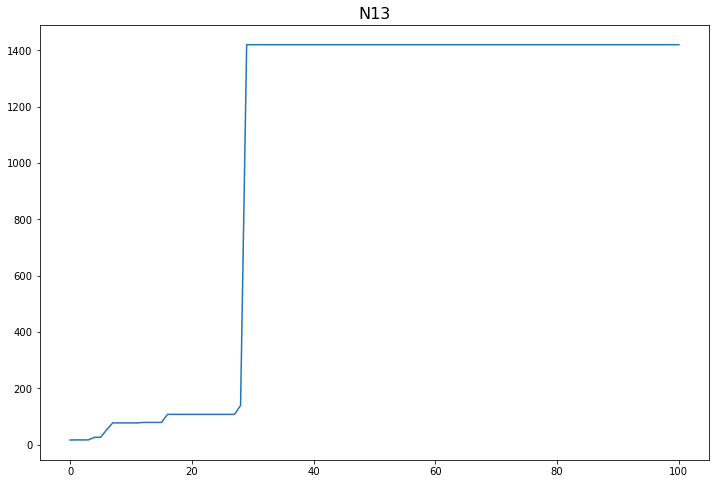

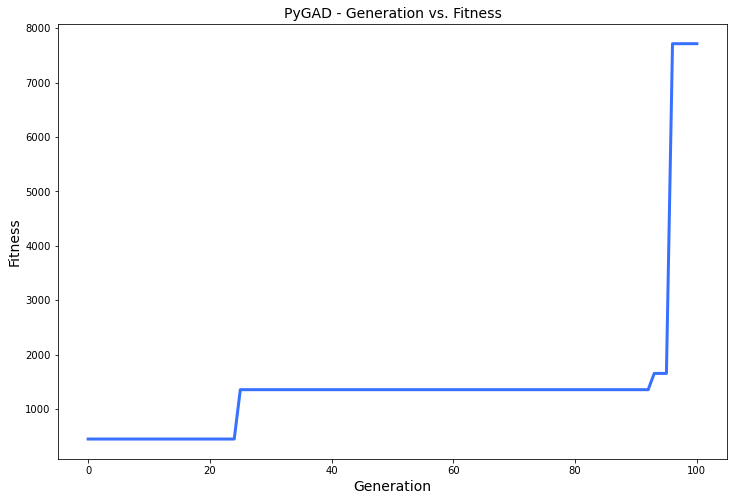

[-0.616]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.616 |===========| 24.181 |==================| 5.225 |==========
[-0.492]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 24.219 |==================| 6.539 |==========
[-0.741]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.741 |===========| 24.142 |==================| 4.337 |==========
[-0.384]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 24.253 |==================| 8.393 |==========
[0.226]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 24.302 |==================| 14.265 |==========
[-0.679]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.679 |===========| 24.161 |==================| 4.731 |==========
[0.643]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=

[0.414]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 24.619 |==================| 2.264 |==========
[0.3]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 24.751 |==================| 3.221 |==========
[0.206]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 24.853 |==================| 4.808 |==========
[-0.594]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.594 |===========| 24.4 |==================| 1.512 |==========
[0.069]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 24.994 |==================| 14.997 |==========
[0.774]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.774 |===========| 24.166 |==================| 1.118 |==========
[0.343]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 24.594 |==================| 2.142 |==========
[0.527]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.527 |===========| 24.483 |==================| 1.73 |==========
Fitness = 181.47801957628468
[-0.594]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.594 |===========| 24.4 |==================| 1.512 |==========
[0.069]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 24.994 |==================| 14.997 |==========
[0.774]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.774 |===========| 24.166 |==================| 1.118 |==========
[0.343]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 24.702 |==================| 2.783 |==========
[0.263]
=====|SOLUTION|===========|OUTPUT|==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 24.597 |==================| 2.153 |==========
[-0.435]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 24.594 |==================| 2.142 |==========
[0.527]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.527 |===========| 24.483 |==================| 1.73 |==========
[-0.594]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.594 |===========| 24.4 |==================| 1.512 |==========
[0.069]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 24.994 |==================| 14.997 |==========
[0.774]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.774 |===========| 24.166 |==================| 1.118 |==========
[0.343]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 24.599 |==================| 2.164 |==========
Generation = 2
[-0.793]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.793 |===========| 24.14 |==================| 1.086 |==========
[-0.046]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 25.016 |==================| 22.302 |==========
[0.375]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.375 |===========| 24.665 |==================| 2.522 |==========
[-0.994]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.994 |===========| 23.861 |==================| 0.833 |==========
[0.798]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.798 |===========| 24.133 |==================| 1.078 |==========
[0.738]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 24.599 |==================| 2.164 |==========
Change = 0.0
[-0.793]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.793 |===========| 24.14 |==================| 1.086 |==========
[-0.046]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 25.016 |==================| 22.302 |==========
[0.375]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.375 |===========| 24.665 |==================| 2.522 |==========
[-0.994]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.994 |===========| 23.861 |==================| 0.833 |==========
[0.798]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.798 |===========| 24.133 |==================| 1.078 |==========
[0.738]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 24.599 |==================| 2.164 |==========
[-0.628]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.628 |===========| 24.357 |==================| 1.42 |==========
[-0.783]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.783 |===========| 24.154 |==================| 1.102 |==========
[-0.357]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 24.686 |==================| 2.663 |==========
[0.876]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.876 |===========| 24.027 |==================| 0.967 |==========
[0.541]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.541 |===========| 24.467 |==================| 1.682 |==========
[-0.682]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.761 |===========| 24.183 |==================| 1.139 |==========
Fitness = 181.47801957628468
[-0.628]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.628 |===========| 24.357 |==================| 1.42 |==========
[-0.783]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.783 |===========| 24.154 |==================| 1.102 |==========
[-0.357]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 24.686 |==================| 2.663 |==========
[0.876]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.876 |===========| 24.027 |==================| 0.967 |==========
[0.541]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.541 |===========| 24.467 |==================| 1.682 |==========
[-0.682]
=====|SOLUTION|===========|OUTPUT|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.91 |===========| 23.98 |==================| 0.925 |==========
[0.761]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.761 |===========| 24.183 |==================| 1.139 |==========
[-0.628]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.628 |===========| 24.357 |==================| 1.42 |==========
[-0.783]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.783 |===========| 24.154 |==================| 1.102 |==========
[-0.357]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 24.686 |==================| 2.663 |==========
[0.876]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.876 |===========| 24.027 |==================| 0.967 |==========
[0.541]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

[0.864]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.864 |===========| 24.043 |==================| 0.982 |==========
Generation = 4
[0.875]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.875 |===========| 24.028 |==================| 0.968 |==========
[-0.01]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 25.052 |==================| 108.719 |==========
[-0.7]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.7 |===========| 24.264 |==================| 1.255 |==========
[0.005]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 25.056 |==================| 214.743 |==========
[0.087]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.087 |===========| 24.976 |==================| 11.694 |==========
[0.303]
=====|SOLUTION|===========|OUTPUT|==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.858 |===========| 24.051 |==================| 0.99 |==========
[0.864]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.864 |===========| 24.043 |==================| 0.982 |==========
Change = 33.26489291199505
[0.875]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.875 |===========| 24.028 |==================| 0.968 |==========
[-0.01]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 25.052 |==================| 108.719 |==========
[-0.7]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.7 |===========| 24.264 |==================| 1.255 |==========
[0.005]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 25.056 |==================| 214.743 |==========
[0.087]
=====|SOLUTION|===========|OUTPUT|================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.826 |===========| 24.095 |==================| 1.035 |==========
[0.858]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.858 |===========| 24.051 |==================| 0.99 |==========
[0.864]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.864 |===========| 24.043 |==================| 0.982 |==========
[-0.156]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 24.905 |==================| 6.417 |==========
[-0.003]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 25.059 |==================| 398.054 |==========
[0.586]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.586 |===========| 24.41 |==================| 1.537 |==========
[0.48]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.627 |===========| 24.358 |==================| 1.422 |==========
[0.652]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.652 |===========| 24.326 |==================| 1.361 |==========
Fitness = 398.05354720361737
[-0.156]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 24.905 |==================| 6.417 |==========
[-0.003]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 25.059 |==================| 398.054 |==========
[0.586]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.586 |===========| 24.41 |==================| 1.537 |==========
[0.48]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 24.541 |==================| 1.922 |==========
[0.613]
=====|SOLUTION|===========|OUTPUT|============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.918 |===========| 23.968 |==================| 0.915 |==========
[-0.627]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.627 |===========| 24.358 |==================| 1.422 |==========
[0.652]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.652 |===========| 24.326 |==================| 1.361 |==========
[-0.156]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 24.905 |==================| 6.417 |==========
[-0.003]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 25.059 |==================| 398.054 |==========
[0.586]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.586 |===========| 24.41 |==================| 1.537 |==========
[0.48]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 24.498 |==================| 1.776 |==========
[0.199]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 24.86 |==================| 4.981 |==========
Generation = 6
[-0.857]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.857 |===========| 24.053 |==================| 0.992 |==========
[-0.501]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.501 |===========| 24.516 |==================| 1.834 |==========
[0.429]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 24.601 |==================| 2.176 |==========
[0.391]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.391 |===========| 24.646 |==================| 2.411 |==========
[-0.604]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.926 |===========| 23.956 |==================| 0.905 |==========
[0.515]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 24.498 |==================| 1.776 |==========
[0.199]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 24.86 |==================| 4.981 |==========
Change = 5.629203769785818e-10
[-0.857]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.857 |===========| 24.053 |==================| 0.992 |==========
[-0.501]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.501 |===========| 24.516 |==================| 1.834 |==========
[0.429]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 24.601 |==================| 2.176 |==========
[0.391]
=====|SOLUTION|===========|OUTPUT|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.926 |===========| 23.956 |==================| 0.905 |==========
[0.515]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 24.498 |==================| 1.776 |==========
[0.199]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 24.86 |==================| 4.981 |==========
[0.329]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 24.717 |==================| 2.906 |==========
[-0.271]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.271 |===========| 24.782 |==================| 3.587 |==========
[-0.601]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 24.392 |==================| 1.494 |==========
[-0.415]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.933 |===========| 23.947 |==================| 0.898 |==========
[0.695]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 24.271 |==================| 1.265 |==========
[0.06]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 25.003 |==================| 17.282 |==========
[-0.864]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.864 |===========| 24.043 |==================| 0.982 |==========
Fitness = 398.0535472041803
[0.329]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 24.717 |==================| 2.906 |==========
[-0.271]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.271 |===========| 24.782 |==================| 3.587 |==========
[-0.601]
=====|SOLUTION|===========|OUTPUT|============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 24.869 |==================| 5.217 |==========
[-0.933]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.933 |===========| 23.947 |==================| 0.898 |==========
[0.695]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 24.271 |==================| 1.265 |==========
[0.06]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 25.003 |==================| 17.282 |==========
[-0.864]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.864 |===========| 24.043 |==================| 0.982 |==========
[0.329]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 24.717 |==================| 2.906 |==========
[-0.271]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.958 |===========| 23.911 |==================| 0.87 |==========
[0.22]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 24.838 |==================| 4.483 |==========
[-0.574]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.574 |===========| 24.426 |==================| 1.574 |==========
[-0.08]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 24.983 |==================| 12.764 |==========
[-0.109]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 24.953 |==================| 9.282 |==========
Generation = 8
[0.302]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 24.747 |==================| 3.188 |==========
[0.102]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 24.838 |==================| 4.483 |==========
[-0.574]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.574 |===========| 24.426 |==================| 1.574 |==========
[-0.08]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 24.983 |==================| 12.764 |==========
[-0.109]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 24.953 |==================| 9.282 |==========
Change = 0.0
[0.302]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 24.747 |==================| 3.188 |==========
[0.102]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 24.96 |==================| 9.942 |==========
[-0.052]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.574 |===========| 24.426 |==================| 1.574 |==========
[-0.08]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 24.983 |==================| 12.764 |==========
[-0.109]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 24.953 |==================| 9.282 |==========
[0.158]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 24.904 |==================| 6.356 |==========
[-0.432]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 24.598 |==================| 2.161 |==========
[-0.435]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 24.594 |==================| 2.143 |==========
[-0.071]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.892 |===========| 24.005 |==================| 0.947 |==========
[-0.438]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 24.592 |==================| 2.13 |==========
Fitness = 577.2850211039423
[0.158]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 24.904 |==================| 6.356 |==========
[-0.432]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 24.598 |==================| 2.161 |==========
[-0.435]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 24.594 |==================| 2.143 |==========
[-0.071]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 24.992 |==================| 14.471 |==========
[-0.249]
=====|SOLUTION|===========|OUTPUT|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 24.592 |==================| 2.13 |==========
[0.158]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 24.904 |==================| 6.356 |==========
[-0.432]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 24.598 |==================| 2.161 |==========
[-0.435]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 24.594 |==================| 2.143 |==========
[-0.071]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 24.992 |==================| 14.471 |==========
[-0.249]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 24.807 |==================| 3.932 |==========
[0.854]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 24.56 |==================| 1.994 |==========
[0.278]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 24.774 |==================| 3.485 |==========
[-0.149]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 24.913 |==================| 6.752 |==========
[-0.707]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.707 |===========| 24.254 |==================| 1.239 |==========
[-0.426]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 24.606 |==================| 2.196 |==========
[0.343]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 24.701 |==================| 2.78 |==========
[-0.871]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

[0.119]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 24.943 |==================| 8.506 |==========
Change = 0.0
[-0.464]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 24.56 |==================| 1.994 |==========
[0.278]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 24.774 |==================| 3.485 |==========
[-0.149]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 24.913 |==================| 6.752 |==========
[-0.707]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.707 |===========| 24.254 |==================| 1.239 |==========
[-0.426]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 24.606 |==================| 2.196 |==========
[0.343]
=====|SOLUTION|===========|OUTPUT|==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 24.943 |==================| 8.506 |==========
[-0.132]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 24.931 |==================| 7.666 |==========
[0.24]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 24.817 |==================| 4.093 |==========
[0.097]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 24.966 |==================| 10.513 |==========
[-0.597]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.597 |===========| 24.396 |==================| 1.504 |==========
[0.115]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 24.948 |==================| 8.811 |==========
[0.463]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 24.904 |==================| 6.353 |==========
Fitness = 577.2850211039423
[-0.132]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 24.931 |==================| 7.666 |==========
[0.24]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 24.817 |==================| 4.093 |==========
[0.097]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 24.966 |==================| 10.513 |==========
[-0.597]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.597 |===========| 24.396 |==================| 1.504 |==========
[0.115]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 24.948 |==================| 8.811 |==========
[0.463]
=====|SOLUTION|===========|OUTPUT|=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.53 |===========| 24.48 |==================| 1.722 |==========
[-0.158]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 24.904 |==================| 6.353 |==========
[-0.132]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 24.931 |==================| 7.666 |==========
[0.24]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 24.817 |==================| 4.093 |==========
[0.097]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 24.966 |==================| 10.513 |==========
[-0.597]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.597 |===========| 24.396 |==================| 1.504 |==========
[0.115]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 25.029 |==================| 30.847 |==========
Generation = 12
[-0.428]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 24.603 |==================| 2.182 |==========
[-0.516]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 24.498 |==================| 1.775 |==========
[-0.851]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 24.061 |==================| 1.0 |==========
[0.569]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.569 |===========| 24.432 |==================| 1.589 |==========
[0.02]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 25.042 |==================| 52.685 |==========
[0.34]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.869 |===========| 24.037 |==================| 0.976 |==========
[-0.034]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 25.029 |==================| 30.847 |==========
Change = 0.0
[-0.428]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 24.603 |==================| 2.182 |==========
[-0.516]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 24.498 |==================| 1.775 |==========
[-0.851]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 24.061 |==================| 1.0 |==========
[0.569]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.569 |===========| 24.432 |==================| 1.589 |==========
[0.02]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 25.029 |==================| 30.847 |==========
[0.841]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 24.074 |==================| 1.013 |==========
[0.725]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 24.231 |==================| 1.205 |==========
[0.51]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 24.504 |==================| 1.796 |==========
[-0.047]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 25.016 |==================| 22.177 |==========
[-0.399]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 24.637 |==================| 2.358 |==========
[-0.778]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 24.576 |==================| 2.06 |==========
Fitness = 577.2850211039423
[0.841]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 24.074 |==================| 1.013 |==========
[0.725]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 24.231 |==================| 1.205 |==========
[0.51]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 24.504 |==================| 1.796 |==========
[-0.047]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 25.016 |==================| 22.177 |==========
[-0.399]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 24.637 |==================| 2.358 |==========
[-0.778]
=====|SOLUTION|===========|OUTPUT|=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 24.576 |==================| 2.06 |==========
[0.841]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 24.074 |==================| 1.013 |==========
[0.725]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 24.231 |==================| 1.205 |==========
[0.51]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 24.504 |==================| 1.796 |==========
[-0.047]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 25.016 |==================| 22.177 |==========
[-0.399]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 24.637 |==================| 2.358 |==========
[-0.778]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.527 |===========| 24.484 |==================| 1.732 |==========
[-0.41]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 24.624 |==================| 2.288 |==========
[-0.223]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 24.835 |==================| 4.42 |==========
[0.896]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.896 |===========| 23.998 |==================| 0.941 |==========
[-0.623]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.623 |===========| 24.364 |==================| 1.434 |==========
[0.489]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 24.53 |==================| 1.883 |==========
[0.625]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 24.69 |==================| 2.695 |==========
[0.527]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.527 |===========| 24.484 |==================| 1.732 |==========
[-0.41]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 24.624 |==================| 2.288 |==========
[-0.223]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 24.835 |==================| 4.42 |==========
[0.896]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.896 |===========| 23.998 |==================| 0.941 |==========
[-0.623]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.623 |===========| 24.364 |==================| 1.434 |==========
[0.489]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 25.018 |==================| 23.138 |==========
[0.191]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 24.868 |==================| 5.189 |==========
[0.166]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 24.895 |==================| 6.04 |==========
[0.337]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========| 24.709 |==================| 2.838 |==========
[0.955]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.955 |===========| 23.916 |==================| 0.873 |==========
[0.546]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.546 |===========| 24.461 |==================| 1.666 |==========
[0.683]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 24.652 |==================| 2.443 |==========
[-0.045]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 25.018 |==================| 23.138 |==========
[0.191]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 24.868 |==================| 5.189 |==========
[0.166]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 24.895 |==================| 6.04 |==========
[0.337]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========| 24.709 |==================| 2.838 |==========
[0.955]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.955 |===========| 23.916 |==================| 0.873 |==========
[0.546]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 25.018 |==================| 23.138 |==========
[0.191]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 24.868 |==================| 5.189 |==========
[0.166]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 24.895 |==================| 6.04 |==========
[0.337]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========| 24.709 |==================| 2.838 |==========
[0.955]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.955 |===========| 23.916 |==================| 0.873 |==========
[0.546]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.546 |===========| 24.461 |==================| 1.666 |==========
[0.683]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 24.926 |==================| 7.417 |==========
[0.948]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.948 |===========| 23.926 |==================| 0.881 |==========
[0.474]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 24.548 |==================| 1.95 |==========
[0.49]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 24.528 |==================| 1.877 |==========
[-0.985]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.985 |===========| 23.873 |==================| 0.842 |==========
[0.671]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.671 |===========| 24.302 |==================| 1.317 |==========
[-0.64]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.198 |===========| 24.861 |==================| 5.011 |==========
[0.136]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 24.926 |==================| 7.417 |==========
[0.948]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.948 |===========| 23.926 |==================| 0.881 |==========
[0.474]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 24.548 |==================| 1.95 |==========
[0.49]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 24.528 |==================| 1.877 |==========
[-0.985]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.985 |===========| 23.873 |==================| 0.842 |==========
[0.671]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 24.816 |==================| 4.074 |==========
[0.378]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 24.661 |==================| 2.503 |==========
[-0.353]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 24.691 |==================| 2.7 |==========
[-0.84]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.84 |===========| 24.077 |==================| 1.016 |==========
[-0.039]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 25.024 |==================| 26.903 |==========
[-0.804]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.804 |===========| 24.125 |==================| 1.068 |==========
[-0.709]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 24.816 |==================| 4.074 |==========
[0.378]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 24.661 |==================| 2.503 |==========
[-0.353]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 24.691 |==================| 2.7 |==========
[-0.84]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.84 |===========| 24.077 |==================| 1.016 |==========
[-0.039]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 25.024 |==================| 26.903 |==========
[-0.804]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.804 |===========| 24.125 |==================| 1.068 |==========
[-0.709]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 24.661 |==================| 2.503 |==========
[-0.353]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 24.691 |==================| 2.7 |==========
[-0.84]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.84 |===========| 24.077 |==================| 1.016 |==========
[-0.039]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 25.024 |==================| 26.903 |==========
[-0.804]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.804 |===========| 24.125 |==================| 1.068 |==========
[-0.709]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.709 |===========| 24.252 |==================| 1.236 |==========
[-0.116]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 24.682 |==================| 2.639 |==========
[0.934]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.934 |===========| 23.946 |==================| 0.897 |==========
[0.666]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 24.308 |==================| 1.328 |==========
[0.136]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 24.926 |==================| 7.426 |==========
[0.852]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.852 |===========| 24.059 |==================| 0.998 |==========
[0.553]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.553 |===========| 24.452 |==================| 1.642 |==========
[0.182]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 24.682 |==================| 2.639 |==========
[0.934]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.934 |===========| 23.946 |==================| 0.897 |==========
[0.666]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 24.308 |==================| 1.328 |==========
[0.136]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 24.926 |==================| 7.426 |==========
[0.852]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.852 |===========| 24.059 |==================| 0.998 |==========
[0.553]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.553 |===========| 24.452 |==================| 1.642 |==========
[0.182]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.802 |===========| 24.128 |==================| 1.072 |==========
[0.149]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 24.913 |==================| 6.764 |==========
[-0.364]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 24.678 |==================| 2.611 |==========
[0.038]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 25.025 |==================| 27.638 |==========
[0.497]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 24.52 |==================| 1.85 |==========
[0.966]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.966 |===========| 23.9 |==================| 0.861 |==========
[0.971]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.802 |===========| 24.128 |==================| 1.072 |==========
[0.149]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 24.913 |==================| 6.764 |==========
[-0.364]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 24.678 |==================| 2.611 |==========
[0.038]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 25.025 |==================| 27.638 |==========
[0.497]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 24.52 |==================| 1.85 |==========
[0.966]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.966 |===========| 23.9 |==================| 0.861 |==========
[0.971]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.802 |===========| 24.128 |==================| 1.072 |==========
[0.149]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 24.913 |==================| 6.764 |==========
[-0.364]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 24.678 |==================| 2.611 |==========
[0.038]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 25.025 |==================| 27.638 |==========
[0.497]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 24.52 |==================| 1.85 |==========
[0.966]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.966 |===========| 23.9 |==================| 0.861 |==========
[0.971]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 24.878 |==================| 5.463 |==========
[-0.791]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.791 |===========| 24.143 |==================| 1.089 |==========
[0.303]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 24.747 |==================| 3.18 |==========
[0.797]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.797 |===========| 24.135 |==================| 1.08 |==========
[-0.591]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 24.404 |==================| 1.521 |==========
[0.978]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.978 |===========| 23.884 |==================| 0.849 |==========
[-0.068]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.791 |===========| 24.143 |==================| 1.089 |==========
[0.303]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 24.747 |==================| 3.18 |==========
[0.797]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.797 |===========| 24.135 |==================| 1.08 |==========
[-0.591]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 24.404 |==================| 1.521 |==========
[0.978]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.978 |===========| 23.884 |==================| 0.849 |==========
[-0.068]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 24.995 |==================| 15.043 |==========
[-0.623]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 24.498 |==================| 1.775 |==========
[0.2]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 24.859 |==================| 4.96 |==========
[-0.875]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.875 |===========| 24.028 |==================| 0.968 |==========
[0.475]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 24.547 |==================| 1.945 |==========
[0.164]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 24.897 |==================| 6.11 |==========
[-0.504]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 24.512 |==================| 1.822 |==========
[-0.544]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 24.859 |==================| 4.96 |==========
[-0.875]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.875 |===========| 24.028 |==================| 0.968 |==========
[0.475]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 24.547 |==================| 1.945 |==========
[0.164]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 24.897 |==================| 6.11 |==========
[-0.504]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 24.512 |==================| 1.822 |==========
[-0.544]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.544 |===========| 24.463 |==================| 1.672 |==========
[0.754]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 24.859 |==================| 4.96 |==========
[-0.875]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.875 |===========| 24.028 |==================| 0.968 |==========
[0.475]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 24.547 |==================| 1.945 |==========
[0.164]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 24.897 |==================| 6.11 |==========
[-0.504]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 24.512 |==================| 1.822 |==========
[-0.544]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.544 |===========| 24.463 |==================| 1.672 |==========
[0.754]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.903 |===========| 23.99 |==================| 0.933 |==========
[-0.545]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.545 |===========| 24.462 |==================| 1.669 |==========
[0.822]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.822 |===========| 24.101 |==================| 1.042 |==========
[-0.793]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.793 |===========| 24.14 |==================| 1.086 |==========
[0.445]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 24.583 |==================| 2.093 |==========
[-0.725]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 24.231 |==================| 1.205 |==========
[-0.558]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.903 |===========| 23.99 |==================| 0.933 |==========
[-0.545]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.545 |===========| 24.462 |==================| 1.669 |==========
[0.822]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.822 |===========| 24.101 |==================| 1.042 |==========
[-0.793]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.793 |===========| 24.14 |==================| 1.086 |==========
[0.445]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 24.583 |==================| 2.093 |==========
[-0.725]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 24.231 |==================| 1.205 |==========
[-0.558]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 24.602 |==================| 2.178 |==========
[0.213]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 24.845 |==================| 4.632 |==========
[0.039]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 25.023 |==================| 26.473 |==========
[-0.863]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 24.044 |==================| 0.984 |==========
[-0.05]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 25.013 |==================| 20.627 |==========
[-0.109]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 24.954 |==================| 9.346 |==========
[-0.289]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.703 |===========| 24.26 |==================| 1.249 |==========
[-0.429]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 24.602 |==================| 2.178 |==========
[0.213]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 24.845 |==================| 4.632 |==========
[0.039]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 25.023 |==================| 26.473 |==========
[-0.863]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 24.044 |==================| 0.984 |==========
[-0.05]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 25.013 |==================| 20.627 |==========
[-0.109]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 24.602 |==================| 2.178 |==========
[0.213]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 24.845 |==================| 4.632 |==========
[0.039]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 25.023 |==================| 26.473 |==========
[-0.863]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 24.044 |==================| 0.984 |==========
[-0.05]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 25.013 |==================| 20.627 |==========
[-0.109]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 24.954 |==================| 9.346 |==========
[-0.289]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.556 |===========| 24.447 |==================| 1.629 |==========
[-0.347]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 24.698 |==================| 2.751 |==========
[-0.488]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 24.531 |==================| 1.887 |==========
[-0.337]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========| 24.709 |==================| 2.839 |==========
[0.637]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.637 |===========| 24.346 |==================| 1.398 |==========
[0.923]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.923 |===========| 23.961 |==================| 0.909 |==========
[-0.997]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 24.698 |==================| 2.751 |==========
[-0.488]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 24.531 |==================| 1.887 |==========
[-0.337]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========| 24.709 |==================| 2.839 |==========
[0.637]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.637 |===========| 24.346 |==================| 1.398 |==========
[0.923]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.923 |===========| 23.961 |==================| 0.909 |==========
[-0.997]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.997 |===========| 23.856 |==================| 0.83 |==========
[-0.214]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 25.041 |==================| 50.414 |==========
[0.934]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.934 |===========| 23.946 |==================| 0.897 |==========
[-0.987]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.987 |===========| 23.871 |==================| 0.84 |==========
[0.512]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.512 |===========| 24.502 |==================| 1.789 |==========
[-0.222]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 24.835 |==================| 4.43 |==========
[-0.211]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 24.847 |==================| 4.671 |==========
[0.937]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 25.041 |==================| 50.414 |==========
[0.934]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.934 |===========| 23.946 |==================| 0.897 |==========
[-0.987]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.987 |===========| 23.871 |==================| 0.84 |==========
[0.512]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.512 |===========| 24.502 |==================| 1.789 |==========
[-0.222]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 24.835 |==================| 4.43 |==========
[-0.211]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 24.847 |==================| 4.671 |==========
[0.937]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 24.705 |==================| 2.811 |==========
[-0.021]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 25.041 |==================| 50.414 |==========
[0.934]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.934 |===========| 23.946 |==================| 0.897 |==========
[-0.987]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.987 |===========| 23.871 |==================| 0.84 |==========
[0.512]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.512 |===========| 24.502 |==================| 1.789 |==========
[-0.222]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 24.835 |==================| 4.43 |==========
[-0.211]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.862 |===========| 24.046 |==================| 0.985 |==========
[0.611]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.611 |===========| 24.378 |==================| 1.465 |==========
[0.025]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.025 |===========| 25.037 |==================| 42.282 |==========
[0.713]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.713 |===========| 24.247 |==================| 1.228 |==========
[0.075]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 24.988 |==================| 13.622 |==========
[0.607]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.607 |===========| 24.383 |==================| 1.476 |==========
[0.514]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.611 |===========| 24.378 |==================| 1.465 |==========
[0.025]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.025 |===========| 25.037 |==================| 42.282 |==========
[0.713]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.713 |===========| 24.247 |==================| 1.228 |==========
[0.075]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 24.988 |==================| 13.622 |==========
[0.607]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.607 |===========| 24.383 |==================| 1.476 |==========
[0.514]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.514 |===========| 24.499 |==================| 1.779 |==========
[-0.651]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 24.713 |==================| 2.873 |==========
[-0.89]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.89 |===========| 24.007 |==================| 0.949 |==========
[-0.881]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.881 |===========| 24.019 |==================| 0.96 |==========
[0.993]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.993 |===========| 23.861 |==================| 0.834 |==========
[0.192]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 24.867 |==================| 5.163 |==========
[-0.5]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.5 |===========| 24.517 |==================| 1.837 |==========
[0.777]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.953 |===========| 23.919 |==================| 0.876 |==========
[-0.333]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 24.713 |==================| 2.873 |==========
[-0.89]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.89 |===========| 24.007 |==================| 0.949 |==========
[-0.881]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.881 |===========| 24.019 |==================| 0.96 |==========
[0.993]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.993 |===========| 23.861 |==================| 0.834 |==========
[0.192]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 24.867 |==================| 5.163 |==========
[-0.5]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.953 |===========| 23.919 |==================| 0.876 |==========
[-0.333]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 24.713 |==================| 2.873 |==========
[-0.89]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.89 |===========| 24.007 |==================| 0.949 |==========
[-0.881]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.881 |===========| 24.019 |==================| 0.96 |==========
[0.993]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.993 |===========| 23.861 |==================| 0.834 |==========
[0.192]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 24.867 |==================| 5.163 |==========
[-0.5]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 24.88 |==================| 5.522 |==========
[-0.842]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.842 |===========| 24.073 |==================| 1.012 |==========
[-0.459]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 24.566 |==================| 2.019 |==========
[-0.565]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 24.436 |==================| 1.6 |==========
[-0.876]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.876 |===========| 24.027 |==================| 0.967 |==========
[-0.511]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.511 |===========| 24.503 |==================| 1.793 |==========
[0.581]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.713 |===========| 24.246 |==================| 1.227 |==========
[-0.18]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 24.88 |==================| 5.522 |==========
[-0.842]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.842 |===========| 24.073 |==================| 1.012 |==========
[-0.459]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 24.566 |==================| 2.019 |==========
[-0.565]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 24.436 |==================| 1.6 |==========
[-0.876]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.876 |===========| 24.027 |==================| 0.967 |==========
[-0.511]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

[0.488]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 24.531 |==================| 1.885 |==========
[-0.722]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 24.235 |==================| 1.21 |==========
[-0.191]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 24.868 |==================| 5.187 |==========
[0.589]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 24.407 |==================| 1.529 |==========
[0.164]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 24.897 |==================| 6.103 |==========
[0.896]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.896 |===========| 23.999 |==================| 0.941 |==========
[-0.229]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 24.531 |==================| 1.885 |==========
[-0.722]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 24.235 |==================| 1.21 |==========
[-0.191]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 24.868 |==================| 5.187 |==========
[0.589]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 24.407 |==================| 1.529 |==========
[0.164]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 24.897 |==================| 6.103 |==========
[0.896]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.896 |===========| 23.999 |==================| 0.941 |==========
[-0.229]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.037 |===========| 25.025 |==================| 27.735 |==========
[0.488]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 24.531 |==================| 1.885 |==========
[-0.722]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 24.235 |==================| 1.21 |==========
[-0.191]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 24.868 |==================| 5.187 |==========
[0.589]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 24.407 |==================| 1.529 |==========
[0.164]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 24.897 |==================| 6.103 |==========
[0.896]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 24.505 |==================| 1.798 |==========
[-0.935]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.935 |===========| 23.945 |==================| 0.896 |==========
[-0.4]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 24.636 |==================| 2.35 |==========
[0.573]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.573 |===========| 24.426 |==================| 1.575 |==========
[0.019]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.019 |===========| 25.043 |==================| 56.247 |==========
[0.441]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 24.588 |==================| 2.112 |==========
[-0.475]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

[-0.935]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.935 |===========| 23.945 |==================| 0.896 |==========
[-0.4]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 24.636 |==================| 2.35 |==========
[0.573]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.573 |===========| 24.426 |==================| 1.575 |==========
[0.019]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.019 |===========| 25.043 |==================| 56.247 |==========
[0.441]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 24.588 |==================| 2.112 |==========
[-0.475]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 24.547 |==================| 1.947 |==========
[0.512]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.88 |===========| 24.022 |==================| 0.962 |==========
[0.707]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.707 |===========| 24.255 |==================| 1.24 |==========
[-0.124]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 24.939 |==================| 8.185 |==========
[0.289]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 24.762 |==================| 3.343 |==========
[0.028]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 25.034 |==================| 36.801 |==========
[0.528]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 24.482 |==================| 1.726 |==========
[0.992]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.88 |===========| 24.022 |==================| 0.962 |==========
[0.707]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.707 |===========| 24.255 |==================| 1.24 |==========
[-0.124]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 24.939 |==================| 8.185 |==========
[0.289]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 24.762 |==================| 3.343 |==========
[0.028]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 25.034 |==================| 36.801 |==========
[0.528]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 24.482 |==================| 1.726 |==========
[0.992]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.88 |===========| 24.022 |==================| 0.962 |==========
[0.707]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.707 |===========| 24.255 |==================| 1.24 |==========
[-0.124]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 24.939 |==================| 8.185 |==========
[0.289]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 24.762 |==================| 3.343 |==========
[0.028]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 25.034 |==================| 36.801 |==========
[0.528]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 24.482 |==================| 1.726 |==========
[0.992]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 24.701 |==================| 2.779 |==========
[-0.474]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 24.548 |==================| 1.95 |==========
[-0.825]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.825 |===========| 24.097 |==================| 1.037 |==========
[0.607]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.607 |===========| 24.383 |==================| 1.476 |==========
[0.222]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 24.836 |==================| 4.444 |==========
[-0.087]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.087 |===========| 24.976 |==================| 11.804 |==========
[0.982]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 24.768 |==================| 3.418 |==========
[0.343]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 24.701 |==================| 2.779 |==========
[-0.474]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 24.548 |==================| 1.95 |==========
[-0.825]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.825 |===========| 24.097 |==================| 1.037 |==========
[0.607]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.607 |===========| 24.383 |==================| 1.476 |==========
[0.222]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 24.836 |==================| 4.444 |==========
[-0.087]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.612 |===========| 24.377 |==================| 1.461 |==========
[0.946]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.946 |===========| 23.929 |==================| 0.883 |==========
[-0.21]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 24.848 |==================| 4.705 |==========
[-0.165]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 24.896 |==================| 6.06 |==========
[0.671]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.671 |===========| 24.302 |==================| 1.317 |==========
[0.311]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 24.738 |==================| 3.095 |==========
[-0.746]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 24.289 |==================| 1.296 |==========
[0.612]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.612 |===========| 24.377 |==================| 1.461 |==========
[0.946]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.946 |===========| 23.929 |==================| 0.883 |==========
[-0.21]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 24.848 |==================| 4.705 |==========
[-0.165]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 24.896 |==================| 6.06 |==========
[0.671]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.671 |===========| 24.302 |==================| 1.317 |==========
[0.311]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

[-0.953]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.953 |===========| 23.919 |==================| 0.875 |==========
[-0.681]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 24.289 |==================| 1.296 |==========
[0.612]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.612 |===========| 24.377 |==================| 1.461 |==========
[0.946]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.946 |===========| 23.929 |==================| 0.883 |==========
[-0.21]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 24.848 |==================| 4.705 |==========
[-0.165]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 24.896 |==================| 6.06 |==========
[0.671]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.659 |===========| 24.317 |==================| 1.344 |==========
[-0.704]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.704 |===========| 24.259 |==================| 1.247 |==========
[0.578]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.578 |===========| 24.42 |==================| 1.561 |==========
[0.594]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.594 |===========| 24.4 |==================| 1.512 |==========
[-0.802]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.802 |===========| 24.128 |==================| 1.072 |==========
[-0.393]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 24.644 |==================| 2.397 |==========
[-0.838]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.704 |===========| 24.259 |==================| 1.247 |==========
[0.578]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.578 |===========| 24.42 |==================| 1.561 |==========
[0.594]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.594 |===========| 24.4 |==================| 1.512 |==========
[-0.802]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.802 |===========| 24.128 |==================| 1.072 |==========
[-0.393]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 24.644 |==================| 2.397 |==========
[-0.838]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 24.078 |==================| 1.018 |==========
[0.899]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

[0.693]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.693 |===========| 24.272 |==================| 1.268 |==========
[-0.853]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 24.058 |==================| 0.997 |==========
[-0.184]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 24.876 |==================| 5.416 |==========
[-0.083]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 24.98 |==================| 12.291 |==========
[-0.017]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 25.045 |==================| 62.3 |==========
[0.091]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 24.972 |==================| 11.269 |==========
[-0.855]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 24.97 |==================| 10.944 |==========
[0.693]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.693 |===========| 24.272 |==================| 1.268 |==========
[-0.853]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 24.058 |==================| 0.997 |==========
[-0.184]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 24.876 |==================| 5.416 |==========
[-0.083]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 24.98 |==================| 12.291 |==========
[-0.017]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 25.045 |==================| 62.3 |==========
[0.091]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 24.97 |==================| 10.944 |==========
[0.693]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.693 |===========| 24.272 |==================| 1.268 |==========
[-0.853]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 24.058 |==================| 0.997 |==========
[-0.184]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 24.876 |==================| 5.416 |==========
[-0.083]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 24.98 |==================| 12.291 |==========
[-0.017]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 25.045 |==================| 62.3 |==========
[0.091]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 24.697 |==================| 2.748 |==========
[-0.231]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 24.826 |==================| 4.259 |==========
[0.596]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.596 |===========| 24.397 |==================| 1.506 |==========
[0.925]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.925 |===========| 23.958 |==================| 0.907 |==========
[0.044]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 25.019 |==================| 23.575 |==========
[-0.492]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 24.526 |==================| 1.868 |==========
[0.363]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 24.826 |==================| 4.259 |==========
[0.596]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.596 |===========| 24.397 |==================| 1.506 |==========
[0.925]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.925 |===========| 23.958 |==================| 0.907 |==========
[0.044]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 25.019 |==================| 23.575 |==========
[-0.492]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 24.526 |==================| 1.868 |==========
[0.363]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 24.679 |==================| 2.619 |==========
[-0.322]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 24.277 |==================| 1.275 |==========
[-0.389]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 24.648 |==================| 2.422 |==========
[0.412]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 24.621 |==================| 2.275 |==========
[0.877]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.877 |===========| 24.026 |==================| 0.966 |==========
[-0.252]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 24.803 |==================| 3.878 |==========
[0.967]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.967 |===========| 23.899 |==================| 0.86 |==========
[-0.665]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 24.277 |==================| 1.275 |==========
[-0.389]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 24.648 |==================| 2.422 |==========
[0.412]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 24.621 |==================| 2.275 |==========
[0.877]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.877 |===========| 24.026 |==================| 0.966 |==========
[-0.252]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 24.803 |==================| 3.878 |==========
[0.967]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.967 |===========| 23.899 |==================| 0.86 |==========
[-0.665]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 24.621 |==================| 2.275 |==========
[0.877]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.877 |===========| 24.026 |==================| 0.966 |==========
[-0.252]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 24.803 |==================| 3.878 |==========
[0.967]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.967 |===========| 23.899 |==================| 0.86 |==========
[-0.665]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.665 |===========| 24.31 |==================| 1.331 |==========
[-0.833]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.833 |===========| 24.086 |==================| 1.026 |==========
[0.074]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 24.234 |==================| 1.21 |==========
[-0.804]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.804 |===========| 24.125 |==================| 1.068 |==========
[0.192]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 24.868 |==================| 5.17 |==========
[-0.093]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 24.97 |==================| 10.984 |==========
[0.67]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 24.303 |==================| 1.32 |==========
[0.183]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 24.878 |==================| 5.452 |==========
[0.203]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 24.234 |==================| 1.21 |==========
[-0.804]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.804 |===========| 24.125 |==================| 1.068 |==========
[0.192]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 24.868 |==================| 5.17 |==========
[-0.093]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 24.97 |==================| 10.984 |==========
[0.67]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 24.303 |==================| 1.32 |==========
[0.183]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 24.878 |==================| 5.452 |==========
[0.203]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.698 |===========| 24.267 |==================| 1.259 |==========
[0.668]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 24.306 |==================| 1.325 |==========
[0.815]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.815 |===========| 24.111 |==================| 1.052 |==========
[-0.905]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 23.986 |==================| 0.93 |==========
[-0.103]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.103 |===========| 24.96 |==================| 9.882 |==========
[0.761]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.761 |===========| 24.183 |==================| 1.139 |==========
[-0.068]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 23.923 |==================| 0.878 |==========
[-0.698]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.698 |===========| 24.267 |==================| 1.259 |==========
[0.668]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 24.306 |==================| 1.325 |==========
[0.815]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.815 |===========| 24.111 |==================| 1.052 |==========
[-0.905]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 23.986 |==================| 0.93 |==========
[-0.103]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.103 |===========| 24.96 |==================| 9.882 |==========
[0.761]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 23.923 |==================| 0.878 |==========
[-0.698]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.698 |===========| 24.267 |==================| 1.259 |==========
[0.668]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 24.306 |==================| 1.325 |==========
[0.815]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.815 |===========| 24.111 |==================| 1.052 |==========
[-0.905]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 23.986 |==================| 0.93 |==========
[-0.103]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.103 |===========| 24.96 |==================| 9.882 |==========
[0.761]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 24.927 |==================| 7.437 |==========
[0.578]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.578 |===========| 24.42 |==================| 1.561 |==========
[0.545]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.545 |===========| 24.461 |==================| 1.668 |==========
[-0.792]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.792 |===========| 24.141 |==================| 1.087 |==========
[-0.059]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 25.004 |==================| 17.576 |==========
[0.637]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.637 |===========| 24.346 |==================| 1.398 |==========
[-0.397]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 24.599 |==================| 2.163 |==========
[-0.136]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 24.927 |==================| 7.437 |==========
[0.578]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.578 |===========| 24.42 |==================| 1.561 |==========
[0.545]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.545 |===========| 24.461 |==================| 1.668 |==========
[-0.792]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.792 |===========| 24.141 |==================| 1.087 |==========
[-0.059]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 25.004 |==================| 17.576 |==========
[0.637]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.714 |===========| 24.246 |==================| 1.227 |==========
[0.847]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.847 |===========| 24.066 |==================| 1.005 |==========
[-0.91]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.91 |===========| 23.979 |==================| 0.924 |==========
[-0.087]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.087 |===========| 24.976 |==================| 11.753 |==========
[0.227]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 24.83 |==================| 4.326 |==========
[0.611]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.611 |===========| 24.379 |==================| 1.466 |==========
[-0.087]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.588 |===========| 24.408 |==================| 1.531 |==========
[0.714]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.714 |===========| 24.246 |==================| 1.227 |==========
[0.847]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.847 |===========| 24.066 |==================| 1.005 |==========
[-0.91]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.91 |===========| 23.979 |==================| 0.924 |==========
[-0.087]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.087 |===========| 24.976 |==================| 11.753 |==========
[0.227]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 24.83 |==================| 4.326 |==========
[0.611]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.619 |===========| 24.369 |==================| 1.444 |==========
[0.588]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.588 |===========| 24.408 |==================| 1.531 |==========
[0.714]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.714 |===========| 24.246 |==================| 1.227 |==========
[0.847]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.847 |===========| 24.066 |==================| 1.005 |==========
[-0.91]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.91 |===========| 23.979 |==================| 0.924 |==========
[-0.087]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.087 |===========| 24.976 |==================| 11.753 |==========
[0.227]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 25.049 |==================| 84.902 |==========
[-0.616]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.616 |===========| 24.372 |==================| 1.452 |==========
[0.252]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 24.803 |==================| 3.882 |==========
[0.282]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 24.77 |==================| 3.438 |==========
[-0.604]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.604 |===========| 24.387 |==================| 1.484 |==========
[0.037]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.037 |===========| 25.026 |==================| 28.202 |==========
[0.593]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.93 |===========| 23.951 |==================| 0.901 |==========
[0.012]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 25.049 |==================| 84.902 |==========
[-0.616]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.616 |===========| 24.372 |==================| 1.452 |==========
[0.252]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 24.803 |==================| 3.882 |==========
[0.282]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 24.77 |==================| 3.438 |==========
[-0.604]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.604 |===========| 24.387 |==================| 1.484 |==========
[0.037]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 24.721 |==================| 2.944 |==========
[0.375]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.375 |===========| 24.664 |==================| 2.522 |==========
[0.468]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 24.556 |==================| 1.978 |==========
[0.152]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 24.91 |==================| 6.615 |==========
[-0.515]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 24.499 |==================| 1.778 |==========
[0.55]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.55 |===========| 24.455 |==================| 1.651 |==========
[0.27]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.92 |===========| 23.966 |==================| 0.913 |==========
[0.326]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 24.721 |==================| 2.944 |==========
[0.375]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.375 |===========| 24.664 |==================| 2.522 |==========
[0.468]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 24.556 |==================| 1.978 |==========
[0.152]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 24.91 |==================| 6.615 |==========
[-0.515]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 24.499 |==================| 1.778 |==========
[0.55]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.375 |===========| 24.664 |==================| 2.522 |==========
[0.468]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 24.556 |==================| 1.978 |==========
[0.152]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 24.91 |==================| 6.615 |==========
[-0.515]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 24.499 |==================| 1.778 |==========
[0.55]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.55 |===========| 24.455 |==================| 1.651 |==========
[0.27]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 24.783 |==================| 3.603 |==========
[0.862]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.419 |===========| 24.613 |==================| 2.234 |==========
[-0.142]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.142 |===========| 24.92 |==================| 7.085 |==========
[0.635]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.635 |===========| 24.349 |==================| 1.404 |==========
[-0.949]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.949 |===========| 23.924 |==================| 0.88 |==========
[0.726]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.726 |===========| 24.23 |==================| 1.203 |==========
[-0.649]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.649 |===========| 24.329 |==================| 1.367 |==========
[-0.269]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.635 |===========| 24.348 |==================| 1.403 |==========
[0.419]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.419 |===========| 24.613 |==================| 2.234 |==========
[-0.142]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.142 |===========| 24.92 |==================| 7.085 |==========
[0.635]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.635 |===========| 24.349 |==================| 1.404 |==========
[-0.949]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.949 |===========| 23.924 |==================| 0.88 |==========
[0.726]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.726 |===========| 24.23 |==================| 1.203 |==========
[-0.649]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

[0.67]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 24.303 |==================| 1.318 |==========
[-0.884]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 24.015 |==================| 0.956 |==========
[-0.863]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 24.045 |==================| 0.984 |==========
[-0.3]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 24.751 |==================| 3.222 |==========
[-0.541]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.541 |===========| 24.467 |==================| 1.682 |==========
[-0.559]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.559 |===========| 24.444 |==================| 1.621 |==========
[-0.838]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 24.303 |==================| 1.318 |==========
[-0.884]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 24.015 |==================| 0.956 |==========
[-0.863]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 24.045 |==================| 0.984 |==========
[-0.3]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 24.751 |==================| 3.222 |==========
[-0.541]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.541 |===========| 24.467 |==================| 1.682 |==========
[-0.559]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.559 |===========| 24.444 |==================| 1.621 |==========
[-0.838]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 24.303 |==================| 1.318 |==========
[-0.884]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 24.015 |==================| 0.956 |==========
[-0.863]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 24.045 |==================| 0.984 |==========
[-0.3]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 24.751 |==================| 3.222 |==========
[-0.541]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.541 |===========| 24.467 |==================| 1.682 |==========
[-0.559]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.559 |===========| 24.444 |==================| 1.621 |==========
[-0.838]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.786 |===========| 24.15 |==================| 1.097 |==========
[-0.105]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 24.958 |==================| 9.693 |==========
[0.946]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.946 |===========| 23.928 |==================| 0.883 |==========
[0.182]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 24.878 |==================| 5.468 |==========
[-0.489]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 24.53 |==================| 1.884 |==========
[0.737]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 24.215 |==================| 1.181 |==========
[0.911]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.786 |===========| 24.15 |==================| 1.097 |==========
[-0.105]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 24.958 |==================| 9.693 |==========
[0.946]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.946 |===========| 23.928 |==================| 0.883 |==========
[0.182]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 24.878 |==================| 5.468 |==========
[-0.489]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 24.53 |==================| 1.884 |==========
[0.737]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 24.215 |==================| 1.181 |==========
[0.911]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.702 |===========| 24.261 |==================| 1.249 |==========
[-0.696]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 24.269 |==================| 1.262 |==========
[-0.487]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 24.533 |==================| 1.893 |==========
[-0.202]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 24.857 |==================| 4.912 |==========
[-0.502]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 24.514 |==================| 1.829 |==========
[-0.687]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.687 |===========| 24.281 |==================| 1.282 |==========
[0.116]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.976 |===========| 23.886 |==================| 0.851 |==========
[-0.702]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.702 |===========| 24.261 |==================| 1.249 |==========
[-0.696]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 24.269 |==================| 1.262 |==========
[-0.487]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 24.533 |==================| 1.893 |==========
[-0.202]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 24.857 |==================| 4.912 |==========
[-0.502]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 24.514 |==================| 1.829 |==========
[-0.687]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.976 |===========| 23.886 |==================| 0.851 |==========
[-0.702]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.702 |===========| 24.261 |==================| 1.249 |==========
[-0.696]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 24.269 |==================| 1.262 |==========
[-0.487]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 24.533 |==================| 1.893 |==========
[-0.202]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 24.857 |==================| 4.912 |==========
[-0.502]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 24.514 |==================| 1.829 |==========
[-0.687]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 24.641 |==================| 2.38 |==========
[0.095]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 24.968 |==================| 10.713 |==========
[0.515]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 24.498 |==================| 1.777 |==========
[0.41]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 24.624 |==================| 2.288 |==========
[-0.058]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 25.005 |==================| 17.917 |==========
[0.279]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 24.774 |==================| 3.481 |==========
[0.817]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.198 |===========| 24.861 |==================| 5.006 |==========
[-0.396]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 24.641 |==================| 2.38 |==========
[0.095]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 24.968 |==================| 10.713 |==========
[0.515]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 24.498 |==================| 1.777 |==========
[0.41]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 24.624 |==================| 2.288 |==========
[-0.058]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 25.005 |==================| 17.917 |==========
[0.279]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 25.01 |==================| 19.762 |==========
[0.175]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 24.886 |==================| 5.714 |==========
[-0.537]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.537 |===========| 24.471 |==================| 1.696 |==========
[0.671]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.671 |===========| 24.301 |==================| 1.316 |==========
[-0.809]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.809 |===========| 24.118 |==================| 1.06 |==========
[0.53]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.53 |===========| 24.48 |==================| 1.721 |==========
[0.921]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 24.886 |==================| 5.714 |==========
[-0.537]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.537 |===========| 24.471 |==================| 1.696 |==========
[0.671]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.671 |===========| 24.301 |==================| 1.316 |==========
[-0.809]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.809 |===========| 24.118 |==================| 1.06 |==========
[0.53]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.53 |===========| 24.48 |==================| 1.721 |==========
[0.921]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.921 |===========| 23.964 |==================| 0.911 |==========
[0.814]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.671 |===========| 24.301 |==================| 1.316 |==========
[-0.809]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.809 |===========| 24.118 |==================| 1.06 |==========
[0.53]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.53 |===========| 24.48 |==================| 1.721 |==========
[0.921]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.921 |===========| 23.964 |==================| 0.911 |==========
[0.814]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.814 |===========| 24.112 |==================| 1.054 |==========
[-0.804]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.804 |===========| 24.126 |==================| 1.069 |==========
[0.266]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.168 |===========| 24.892 |==================| 5.932 |==========
[-0.185]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 24.875 |==================| 5.367 |==========
[-0.943]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.943 |===========| 23.933 |==================| 0.887 |==========
[0.059]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 25.004 |==================| 17.498 |==========
[0.416]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 24.617 |==================| 2.255 |==========
[0.707]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.707 |===========| 24.255 |==================| 1.24 |==========
[0.521]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.168 |===========| 24.892 |==================| 5.932 |==========
[-0.185]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 24.875 |==================| 5.367 |==========
[-0.943]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.943 |===========| 23.933 |==================| 0.887 |==========
[0.059]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 25.004 |==================| 17.498 |==========
[0.416]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 24.617 |==================| 2.255 |==========
[0.707]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.707 |===========| 24.255 |==================| 1.24 |==========
[0.521]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.699 |===========| 24.265 |==================| 1.257 |==========
[-0.451]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 24.575 |==================| 2.058 |==========
[-0.981]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.981 |===========| 23.88 |==================| 0.846 |==========
[-0.231]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 24.826 |==================| 4.258 |==========
[0.22]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 24.838 |==================| 4.485 |==========
[-0.016]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 25.046 |==================| 65.218 |==========
[0.141]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.699 |===========| 24.265 |==================| 1.257 |==========
[-0.451]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 24.575 |==================| 2.058 |==========
[-0.981]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.981 |===========| 23.88 |==================| 0.846 |==========
[-0.231]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 24.826 |==================| 4.258 |==========
[0.22]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 24.838 |==================| 4.485 |==========
[-0.016]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 25.046 |==================| 65.218 |==========
[0.141]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 24.725 |==================| 2.977 |==========
[-0.699]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.699 |===========| 24.265 |==================| 1.257 |==========
[-0.451]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 24.575 |==================| 2.058 |==========
[-0.981]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.981 |===========| 23.88 |==================| 0.846 |==========
[-0.231]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 24.826 |==================| 4.258 |==========
[0.22]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 24.838 |==================| 4.485 |==========
[-0.016]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 25.047 |==================| 72.414 |==========
[-0.106]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 24.957 |==================| 9.586 |==========
[-0.424]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 24.608 |==================| 2.208 |==========
[-0.607]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.607 |===========| 24.383 |==================| 1.475 |==========
[0.272]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 24.781 |==================| 3.567 |==========
[-0.707]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.707 |===========| 24.255 |==================| 1.241 |==========
[-0.069]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 24.912 |==================| 6.696 |==========
[-0.014]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 25.047 |==================| 72.414 |==========
[-0.106]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 24.957 |==================| 9.586 |==========
[-0.424]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 24.608 |==================| 2.208 |==========
[-0.607]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.607 |===========| 24.383 |==================| 1.475 |==========
[0.272]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 24.781 |==================| 3.567 |==========
[-0.707]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 24.871 |==================| 5.258 |==========
[-0.519]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.519 |===========| 24.494 |==================| 1.762 |==========
[-0.911]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.911 |===========| 23.979 |==================| 0.924 |==========
[-0.115]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 24.948 |==================| 8.834 |==========
[-0.165]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 24.896 |==================| 6.07 |==========
[0.794]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.794 |===========| 24.138 |==================| 1.084 |==========
[-0.259]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 24.704 |==================| 2.804 |==========
[-0.189]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 24.871 |==================| 5.258 |==========
[-0.519]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.519 |===========| 24.494 |==================| 1.762 |==========
[-0.911]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.911 |===========| 23.979 |==================| 0.924 |==========
[-0.115]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 24.948 |==================| 8.834 |==========
[-0.165]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 24.896 |==================| 6.07 |==========
[0.794]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 24.871 |==================| 5.258 |==========
[-0.519]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.519 |===========| 24.494 |==================| 1.762 |==========
[-0.911]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.911 |===========| 23.979 |==================| 0.924 |==========
[-0.115]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 24.948 |==================| 8.834 |==========
[-0.165]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 24.896 |==================| 6.07 |==========
[0.794]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.794 |===========| 24.138 |==================| 1.084 |==========
[-0.259]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.91 |===========| 23.98 |==================| 0.925 |==========
[-0.978]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.978 |===========| 23.884 |==================| 0.849 |==========
[-0.843]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.843 |===========| 24.073 |==================| 1.012 |==========
[0.976]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.976 |===========| 23.887 |==================| 0.852 |==========
[0.884]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 24.015 |==================| 0.956 |==========
[0.3]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 24.75 |==================| 3.215 |==========
[-0.83]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.91 |===========| 23.98 |==================| 0.925 |==========
[-0.978]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.978 |===========| 23.884 |==================| 0.849 |==========
[-0.843]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.843 |===========| 24.073 |==================| 1.012 |==========
[0.976]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.976 |===========| 23.887 |==================| 0.852 |==========
[0.884]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 24.015 |==================| 0.956 |==========
[0.3]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 24.75 |==================| 3.215 |==========
[-0.83]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0

======| 0.153 |===========| 24.908 |==================| 6.54 |==========
[0.054]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 25.008 |==================| 18.968 |==========
[0.424]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 24.608 |==================| 2.207 |==========
[0.42]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 24.612 |==================| 2.228 |==========
[0.098]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 24.965 |==================| 10.377 |==========
[0.968]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.968 |===========| 23.897 |==================| 0.859 |==========
[0.876]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.876 |===========| 24.027 |==================| 0.967 |==========
[0.

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 25.008 |==================| 18.968 |==========
[0.424]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 24.608 |==================| 2.207 |==========
[0.42]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 24.612 |==================| 2.228 |==========
[0.098]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 24.965 |==================| 10.377 |==========
[0.968]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.968 |===========| 23.897 |==================| 0.859 |==========
[0.876]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.876 |===========| 24.027 |==================| 0.967 |==========
[0.23]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 25.008 |==================| 18.968 |==========
[0.424]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 24.608 |==================| 2.207 |==========
[0.42]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 24.612 |==================| 2.228 |==========
[0.098]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 24.965 |==================| 10.377 |==========
[0.968]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.968 |===========| 23.897 |==================| 0.859 |==========
[0.876]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.876 |===========| 24.027 |==================| 0.967 |==========
[0.23]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 23.908 |==================| 0.867 |==========
[-0.361]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 24.681 |==================| 2.633 |==========
[0.458]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 24.567 |==================| 2.023 |==========
[0.54]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.54 |===========| 24.467 |==================| 1.684 |==========
[0.736]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.736 |===========| 24.217 |==================| 1.185 |==========
[-0.049]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 25.014 |==================| 21.151 |==========
[-0.342]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 23.908 |==================| 0.867 |==========
[-0.361]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 24.681 |==================| 2.633 |==========
[0.458]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 24.567 |==================| 2.023 |==========
[0.54]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.54 |===========| 24.467 |==================| 1.684 |==========
[0.736]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.736 |===========| 24.217 |==================| 1.185 |==========
[-0.049]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 25.014 |==================| 21.151 |==========
[-0.342]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

[0.913]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.913 |===========| 23.975 |==================| 0.921 |==========
[0.414]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 24.619 |==================| 2.265 |==========
[0.148]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 24.914 |==================| 6.804 |==========
[0.457]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 24.568 |==================| 2.029 |==========
[0.739]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.739 |===========| 24.213 |==================| 1.179 |==========
[0.66]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.66 |===========| 24.316 |==================| 1.343 |==========
[-0.16]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.913 |===========| 23.975 |==================| 0.921 |==========
[0.414]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 24.619 |==================| 2.265 |==========
[0.148]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 24.914 |==================| 6.804 |==========
[0.457]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 24.568 |==================| 2.029 |==========
[0.739]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.739 |===========| 24.213 |==================| 1.179 |==========
[0.66]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.66 |===========| 24.316 |==================| 1.343 |==========
[-0.16]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 24.619 |==================| 2.265 |==========
[0.148]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 24.914 |==================| 6.804 |==========
[0.457]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 24.568 |==================| 2.029 |==========
[0.739]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.739 |===========| 24.213 |==================| 1.179 |==========
[0.66]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.66 |===========| 24.316 |==================| 1.343 |==========
[-0.16]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |===========| 24.902 |==================| 6.275 |==========
[0.947]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.904 |===========| 23.987 |==================| 0.931 |==========
[0.378]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 24.662 |==================| 2.505 |==========
[-0.523]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.523 |===========| 24.489 |==================| 1.747 |==========
[0.691]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.691 |===========| 24.276 |==================| 1.274 |==========
[0.472]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 24.55 |==================| 1.957 |==========
[0.177]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 24.884 |==================| 5.643 |==========
[0.768]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 24.898 |==================| 6.149 |==========
[0.904]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.904 |===========| 23.987 |==================| 0.931 |==========
[0.378]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 24.662 |==================| 2.505 |==========
[-0.523]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.523 |===========| 24.489 |==================| 1.747 |==========
[0.691]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.691 |===========| 24.276 |==================| 1.274 |==========
[0.472]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 24.55 |==================| 1.957 |==========
[0.177]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.694 |===========| 24.271 |==================| 1.266 |==========
[-0.733]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.733 |===========| 24.221 |==================| 1.19 |==========
[-0.295]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.295 |===========| 24.756 |==================| 3.276 |==========
[0.249]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 24.806 |==================| 3.928 |==========
[0.774]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.774 |===========| 24.165 |==================| 1.116 |==========
[-0.226]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 24.831 |==================| 4.35 |==========
Generation = 59
[0.725]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.733 |===========| 24.221 |==================| 1.19 |==========
[-0.295]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.295 |===========| 24.756 |==================| 3.276 |==========
[0.249]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 24.806 |==================| 3.928 |==========
[0.774]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.774 |===========| 24.165 |==================| 1.116 |==========
[-0.226]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 24.831 |==================| 4.35 |==========
Change = 0.0
[0.725]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 24.231 |==================| 1.205 |==========
[-0.356]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.733 |===========| 24.221 |==================| 1.19 |==========
[-0.295]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.295 |===========| 24.756 |==================| 3.276 |==========
[0.249]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 24.806 |==================| 3.928 |==========
[0.774]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.774 |===========| 24.165 |==================| 1.116 |==========
[-0.226]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 24.831 |==================| 4.35 |==========
[-0.671]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.671 |===========| 24.302 |==================| 1.317 |==========
[0.327]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 24.612 |==================| 2.226 |==========
[0.019]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.019 |===========| 25.043 |==================| 55.12 |==========
[0.163]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 24.898 |==================| 6.146 |==========
[0.897]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 23.997 |==================| 0.94 |==========
[-0.766]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.766 |===========| 24.177 |==================| 1.131 |==========
[-0.515]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 24.498 |==================| 1.777 |==========
Fitness = 577.2850211039423
[-0.671]
=====|SOLUTION|===========|OUTPUT|=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 24.612 |==================| 2.226 |==========
[0.019]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.019 |===========| 25.043 |==================| 55.12 |==========
[0.163]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 24.898 |==================| 6.146 |==========
[0.897]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 23.997 |==================| 0.94 |==========
[-0.766]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.766 |===========| 24.177 |==================| 1.131 |==========
[-0.515]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 24.498 |==================| 1.777 |==========
[-0.671]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 24.763 |==================| 3.358 |==========
[-0.878]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.878 |===========| 24.024 |==================| 0.964 |==========
[-0.811]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.811 |===========| 24.116 |==================| 1.058 |==========
[0.808]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.808 |===========| 24.119 |==================| 1.062 |==========
[0.718]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.718 |===========| 24.24 |==================| 1.218 |==========
[-0.595]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.595 |===========| 24.399 |==================| 1.51 |==========
Generation = 61
[-0.12]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 24.896 |==================| 6.076 |==========
[0.288]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 24.763 |==================| 3.358 |==========
[-0.878]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.878 |===========| 24.024 |==================| 0.964 |==========
[-0.811]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.811 |===========| 24.116 |==================| 1.058 |==========
[0.808]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.808 |===========| 24.119 |==================| 1.062 |==========
[0.718]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.718 |===========| 24.24 |==================| 1.218 |==========
[-0.595]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 24.592 |==================| 2.132 |==========
[0.165]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 24.896 |==================| 6.076 |==========
[0.288]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 24.763 |==================| 3.358 |==========
[-0.878]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.878 |===========| 24.024 |==================| 0.964 |==========
[-0.811]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.811 |===========| 24.116 |==================| 1.058 |==========
[0.808]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.808 |===========| 24.119 |==================| 1.062 |==========
[0.718]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 23.908 |==================| 0.867 |==========
[0.734]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.734 |===========| 24.219 |==================| 1.188 |==========
[0.559]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.559 |===========| 24.445 |==================| 1.622 |==========
[-0.622]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.622 |===========| 24.365 |==================| 1.436 |==========
[-0.245]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 24.811 |==================| 3.993 |==========
[0.781]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.781 |===========| 24.157 |==================| 1.106 |==========
[0.937]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 25.051 |==================| 100.118 |==========
[0.961]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 23.908 |==================| 0.867 |==========
[0.734]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.734 |===========| 24.219 |==================| 1.188 |==========
[0.559]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.559 |===========| 24.445 |==================| 1.622 |==========
[-0.622]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.622 |===========| 24.365 |==================| 1.436 |==========
[-0.245]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 24.811 |==================| 3.993 |==========
[0.781]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.857 |===========| 24.053 |==================| 0.992 |==========
[-0.981]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.981 |===========| 23.879 |==================| 0.846 |==========
[0.359]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 24.683 |==================| 2.647 |==========
[0.037]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.037 |===========| 25.025 |==================| 27.723 |==========
[0.434]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 24.595 |==================| 2.148 |==========
[-0.093]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 24.97 |==================| 10.993 |==========
[0.012]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.981 |===========| 23.879 |==================| 0.846 |==========
[0.359]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 24.683 |==================| 2.647 |==========
[0.037]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.037 |===========| 25.025 |==================| 27.723 |==========
[0.434]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 24.595 |==================| 2.148 |==========
[-0.093]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 24.97 |==================| 10.993 |==========
[0.012]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 25.049 |==================| 85.714 |==========
Change = 0.0
[-0.944]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.981 |===========| 23.879 |==================| 0.846 |==========
[0.359]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 24.683 |==================| 2.647 |==========
[0.037]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.037 |===========| 25.025 |==================| 27.723 |==========
[0.434]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 24.595 |==================| 2.148 |==========
[-0.093]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 24.97 |==================| 10.993 |==========
[0.012]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 25.049 |==================| 85.714 |==========
[-0.078]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


[0.569]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.569 |===========| 24.431 |==================| 1.588 |==========
[0.773]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.773 |===========| 24.167 |==================| 1.118 |==========
[0.446]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 24.582 |==================| 2.086 |==========
[0.227]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 24.83 |==================| 4.333 |==========
[-0.602]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.602 |===========| 24.391 |==================| 1.491 |==========
[0.92]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.92 |===========| 23.965 |==================| 0.913 |==========
Fitness = 577.2850211039423
[-0.078]
=====|SOLUTION|===========|OUTPUT|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 24.769 |==================| 3.421 |==========
[0.569]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.569 |===========| 24.431 |==================| 1.588 |==========
[0.773]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.773 |===========| 24.167 |==================| 1.118 |==========
[0.446]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 24.582 |==================| 2.086 |==========
[0.227]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 24.83 |==================| 4.333 |==========
[-0.602]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.602 |===========| 24.391 |==================| 1.491 |==========
[0.92]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 24.276 |==================| 1.274 |==========
[-0.445]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 24.583 |==================| 2.093 |==========
[0.45]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 24.577 |==================| 2.066 |==========
[-0.258]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 24.797 |==================| 3.783 |==========
[0.052]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 25.011 |==================| 19.9 |==========
[0.339]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 24.706 |==================| 2.818 |==========
Generation = 65
[-0.686]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 24.276 |==================| 1.274 |==========
[-0.445]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 24.583 |==================| 2.093 |==========
[0.45]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 24.577 |==================| 2.066 |==========
[-0.258]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 24.797 |==================| 3.783 |==========
[0.052]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 25.011 |==================| 19.9 |==========
[0.339]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 24.706 |==================| 2.818 |==========
Change = 0.0
[-0.686]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 24.276 |==================| 1.274 |==========
[-0.445]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 24.583 |==================| 2.093 |==========
[0.45]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 24.577 |==================| 2.066 |==========
[-0.258]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 24.797 |==================| 3.783 |==========
[0.052]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 25.011 |==================| 19.9 |==========
[0.339]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 24.706 |==================| 2.818 |==========
[0.255]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.856 |===========| 24.054 |==================| 0.993 |==========
[0.113]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 24.95 |==================| 9.0 |==========
[0.087]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.087 |===========| 24.976 |==================| 11.813 |==========
[0.731]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.731 |===========| 24.223 |==================| 1.193 |==========
[0.772]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.772 |===========| 24.168 |==================| 1.12 |==========
[-0.729]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.729 |===========| 24.226 |==================| 1.197 |==========
[0.055]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.856 |===========| 24.054 |==================| 0.993 |==========
[0.113]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 24.95 |==================| 9.0 |==========
[0.087]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.087 |===========| 24.976 |==================| 11.813 |==========
[0.731]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.731 |===========| 24.223 |==================| 1.193 |==========
[0.772]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.772 |===========| 24.168 |==================| 1.12 |==========
[-0.729]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.729 |===========| 24.226 |==================| 1.197 |==========
[0.055]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 24.533 |==================| 1.895 |==========
[0.919]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.919 |===========| 23.967 |==================| 0.914 |==========
[0.578]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.578 |===========| 24.421 |==================| 1.562 |==========
[-0.863]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 24.044 |==================| 0.984 |==========
[-0.842]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.842 |===========| 24.073 |==================| 1.012 |==========
[0.821]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.821 |===========| 24.102 |==================| 1.043 |==========
Generation = 67
[-0.282]
=====|SOLUTION|===========|OUTPUT|==================|FITN

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 24.533 |==================| 1.895 |==========
[0.919]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.919 |===========| 23.967 |==================| 0.914 |==========
[0.578]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.578 |===========| 24.421 |==================| 1.562 |==========
[-0.863]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 24.044 |==================| 0.984 |==========
[-0.842]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.842 |===========| 24.073 |==================| 1.012 |==========
[0.821]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.821 |===========| 24.102 |==================| 1.043 |==========
Change = 0.0
[-0.282]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.919 |===========| 23.967 |==================| 0.914 |==========
[0.578]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.578 |===========| 24.421 |==================| 1.562 |==========
[-0.863]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 24.044 |==================| 0.984 |==========
[-0.842]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.842 |===========| 24.073 |==================| 1.012 |==========
[0.821]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.821 |===========| 24.102 |==================| 1.043 |==========
[0.807]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.807 |===========| 24.121 |==================| 1.064 |==========
[-0.133]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 24.089 |==================| 1.029 |==========
[0.386]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 24.652 |==================| 2.443 |==========
[0.306]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.306 |===========| 24.743 |==================| 3.147 |==========
[0.978]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.978 |===========| 23.884 |==================| 0.85 |==========
[0.49]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 24.529 |==================| 1.88 |==========
[0.469]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 24.555 |==================| 1.975 |==========
Fitness = 577.2850211039423
[0.807]
=====|SOLUTION|===========|OUTPUT|==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 24.527 |==================| 1.873 |==========
[0.831]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 24.089 |==================| 1.029 |==========
[0.386]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 24.652 |==================| 2.443 |==========
[0.306]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.306 |===========| 24.743 |==================| 3.147 |==========
[0.978]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.978 |===========| 23.884 |==================| 0.85 |==========
[0.49]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 24.529 |==================| 1.88 |==========
[0.469]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.749 |===========| 24.199 |==================| 1.16 |==========
[0.212]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 24.846 |==================| 4.652 |==========
[0.1]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 24.963 |==================| 10.234 |==========
[-0.045]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 25.018 |==================| 22.992 |==========
[0.34]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 24.705 |==================| 2.812 |==========
[-0.929]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.929 |===========| 23.953 |==================| 0.902 |==========
[-0.515]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 24.846 |==================| 4.652 |==========
[0.1]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 24.963 |==================| 10.234 |==========
[-0.045]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 25.018 |==================| 22.992 |==========
[0.34]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 24.705 |==================| 2.812 |==========
[-0.929]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.929 |===========| 23.953 |==================| 0.902 |==========
[-0.515]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 24.498 |==================| 1.776 |==========
Change = 0.0
[0.018]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|===

[0.1]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 24.963 |==================| 10.234 |==========
[-0.045]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 25.018 |==================| 22.992 |==========
[0.34]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 24.705 |==================| 2.812 |==========
[-0.929]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.929 |===========| 23.953 |==================| 0.902 |==========
[-0.515]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 24.498 |==================| 1.776 |==========
[-0.622]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.622 |===========| 24.364 |==================| 1.436 |==========
[-0.028]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.827 |===========| 24.095 |==================| 1.035 |==========
[-0.437]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 24.592 |==================| 2.133 |==========
[0.801]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.801 |===========| 24.129 |==================| 1.073 |==========
[-0.841]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 24.074 |==================| 1.013 |==========
Fitness = 577.2850211039423
[-0.622]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.622 |===========| 24.364 |==================| 1.436 |==========
[-0.028]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 25.034 |==================| 37.527 |==========
[-0.007]
=====|SOLUTION|===========|OUTPUT|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 24.7 |==================| 2.771 |==========
[-0.827]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.827 |===========| 24.095 |==================| 1.035 |==========
[-0.437]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 24.592 |==================| 2.133 |==========
[0.801]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.801 |===========| 24.129 |==================| 1.073 |==========
[-0.841]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 24.074 |==================| 1.013 |==========
[-0.622]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.622 |===========| 24.364 |==================| 1.436 |==========
[-0.028]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 24.759 |==================| 3.312 |==========
[0.145]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 24.917 |==================| 6.935 |==========
[-0.067]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.067 |===========| 24.996 |==================| 15.278 |==========
[-0.702]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.702 |===========| 24.261 |==================| 1.249 |==========
Generation = 71
[0.544]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.544 |===========| 24.463 |==================| 1.671 |==========
[-0.521]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.521 |===========| 24.491 |==================| 1.754 |==========
[-0.927]
=====|SOLUTION|===========|OUTPUT|==================|FI

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 24.759 |==================| 3.312 |==========
[0.145]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 24.917 |==================| 6.935 |==========
[-0.067]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.067 |===========| 24.996 |==================| 15.278 |==========
[-0.702]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.702 |===========| 24.261 |==================| 1.249 |==========
Change = 0.0
[0.544]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.544 |===========| 24.463 |==================| 1.671 |==========
[-0.521]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.521 |===========| 24.491 |==================| 1.754 |==========
[-0.927]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.9 |===========| 23.994 |==================| 0.937 |==========
[0.292]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 24.759 |==================| 3.312 |==========
[0.145]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 24.917 |==================| 6.935 |==========
[-0.067]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.067 |===========| 24.996 |==================| 15.278 |==========
[-0.702]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.702 |===========| 24.261 |==================| 1.249 |==========
[0.101]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.101 |===========| 24.962 |==================| 10.101 |==========
[-0.291]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 24.207 |==================| 1.17 |==========
[0.594]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.594 |===========| 24.4 |==================| 1.512 |==========
[-0.754]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.754 |===========| 24.192 |==================| 1.151 |==========
[0.786]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.786 |===========| 24.149 |==================| 1.097 |==========
Fitness = 577.2850211039423
[0.101]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.101 |===========| 24.962 |==================| 10.101 |==========
[-0.291]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 24.76 |==================| 3.326 |==========
[0.963]
=====|SOLUTION|===========|OUTPUT|===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 24.207 |==================| 1.17 |==========
[0.594]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.594 |===========| 24.4 |==================| 1.512 |==========
[-0.754]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.754 |===========| 24.192 |==================| 1.151 |==========
[0.786]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.786 |===========| 24.149 |==================| 1.097 |==========
[0.101]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.101 |===========| 24.962 |==================| 10.101 |==========
[-0.291]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 24.76 |==================| 3.326 |==========
[0.963]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.656 |===========| 24.321 |==================| 1.35 |==========
[-0.66]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.66 |===========| 24.316 |==================| 1.342 |==========
Generation = 73
[0.058]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 25.005 |==================| 17.783 |==========
[-0.234]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 24.823 |==================| 4.196 |==========
[-0.619]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.619 |===========| 24.368 |==================| 1.443 |==========
[0.63]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.63 |===========| 24.354 |==================| 1.415 |==========
[-0.486]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.656 |===========| 24.321 |==================| 1.35 |==========
[-0.66]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.66 |===========| 24.316 |==================| 1.342 |==========
Change = 0.0
[0.058]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 25.005 |==================| 17.783 |==========
[-0.234]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 24.823 |==================| 4.196 |==========
[-0.619]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.619 |===========| 24.368 |==================| 1.443 |==========
[0.63]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.63 |===========| 24.354 |==================| 1.415 |==========
[-0.486]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 24.536 |==================| 1.905 |==========
[0.656]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.656 |===========| 24.321 |==================| 1.35 |==========
[-0.66]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.66 |===========| 24.316 |==================| 1.342 |==========
[0.321]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 24.727 |==================| 2.994 |==========
[-0.838]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 24.079 |==================| 1.018 |==========
[0.817]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.817 |===========| 24.108 |==================| 1.049 |==========
[0.714]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 24.846 |==================| 4.643 |==========
[0.857]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.857 |===========| 24.053 |==================| 0.992 |==========
[0.371]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 24.669 |==================| 2.552 |==========
Fitness = 577.2850211039423
[0.321]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 24.727 |==================| 2.994 |==========
[-0.838]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 24.079 |==================| 1.018 |==========
[0.817]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.817 |===========| 24.108 |==================| 1.049 |==========
[0.714]
=====|SOLUTION|===========|OUTPUT|=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.788 |===========| 24.147 |==================| 1.094 |==========
[-0.213]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 24.846 |==================| 4.643 |==========
[0.857]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.857 |===========| 24.053 |==================| 0.992 |==========
[0.371]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 24.669 |==================| 2.552 |==========
[0.321]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 24.727 |==================| 2.994 |==========
[-0.838]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 24.079 |==================| 1.018 |==========
[0.817]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 24.949 |==================| 8.925 |==========
[-0.45]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 24.577 |==================| 2.067 |==========
Generation = 75
[0.418]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 24.615 |==================| 2.242 |==========
[-0.132]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 24.93 |==================| 7.661 |==========
[-0.845]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.845 |===========| 24.069 |==================| 1.008 |==========
[0.929]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.929 |===========| 23.953 |==================| 0.902 |==========
[-0.016]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 24.949 |==================| 8.925 |==========
[-0.45]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 24.577 |==================| 2.067 |==========
Change = 0.0
[0.418]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 24.615 |==================| 2.242 |==========
[-0.132]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 24.93 |==================| 7.661 |==========
[-0.845]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.845 |===========| 24.069 |==================| 1.008 |==========
[0.929]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.929 |===========| 23.953 |==================| 0.902 |==========
[-0.016]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.553 |===========| 24.451 |==================| 1.639 |==========
[0.114]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 24.949 |==================| 8.925 |==========
[-0.45]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 24.577 |==================| 2.067 |==========
[0.112]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.112 |===========| 24.951 |==================| 9.086 |==========
[0.375]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.375 |===========| 24.665 |==================| 2.523 |==========
[0.318]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 24.73 |==================| 3.02 |==========
[0.118]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.766 |===========| 24.177 |==================| 1.131 |==========
[0.003]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 25.058 |==================| 338.737 |==========
[0.091]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 24.972 |==================| 11.283 |==========
[-0.421]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 24.612 |==================| 2.225 |==========
Fitness = 577.2850211039423
[0.112]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.112 |===========| 24.951 |==================| 9.086 |==========
[0.375]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.375 |===========| 24.665 |==================| 2.523 |==========
[0.318]
=====|SOLUTION|===========|OUTPUT|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 25.058 |==================| 338.737 |==========
[0.091]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 24.972 |==================| 11.283 |==========
[-0.421]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 24.612 |==================| 2.225 |==========
[0.112]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.112 |===========| 24.951 |==================| 9.086 |==========
[0.375]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.375 |===========| 24.665 |==================| 2.523 |==========
[0.318]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 24.73 |==================| 3.02 |==========
[0.118]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 24.624 |==================| 2.288 |==========
[0.534]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.534 |===========| 24.475 |==================| 1.705 |==========
Generation = 77
[0.334]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 24.712 |==================| 2.868 |==========
[-0.027]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 25.035 |==================| 38.521 |==========
[0.675]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.675 |===========| 24.296 |==================| 1.307 |==========
[0.103]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.103 |===========| 24.96 |==================| 9.913 |==========
[-0.32]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.534 |===========| 24.475 |==================| 1.705 |==========
Change = 0.0
[0.334]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 24.712 |==================| 2.868 |==========
[-0.027]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 25.035 |==================| 38.521 |==========
[0.675]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.675 |===========| 24.296 |==================| 1.307 |==========
[0.103]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.103 |===========| 24.96 |==================| 9.913 |==========
[-0.32]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 24.728 |==================| 3.005 |==========
[0.614]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.534 |===========| 24.475 |==================| 1.705 |==========
[0.076]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 24.987 |==================| 13.486 |==========
[0.483]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 24.537 |==================| 1.909 |==========
[0.851]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 24.062 |==================| 1.001 |==========
[-0.99]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.99 |===========| 23.866 |==================| 0.837 |==========
[-0.739]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.739 |===========| 24.213 |==================| 1.179 |==========
[0.364]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 24.848 |==================| 4.699 |==========
Fitness = 577.2850211039423
[0.076]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 24.987 |==================| 13.486 |==========
[0.483]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 24.537 |==================| 1.909 |==========
[0.851]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 24.062 |==================| 1.001 |==========
[-0.99]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.99 |===========| 23.866 |==================| 0.837 |==========
[-0.739]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.739 |===========| 24.213 |==================| 1.179 |==========
[0.364]
=====|SOLUTION|===========|OUTPUT|==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.573 |===========| 24.426 |==================| 1.575 |==========
[0.21]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 24.848 |==================| 4.699 |==========
[0.076]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 24.987 |==================| 13.486 |==========
[0.483]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 24.537 |==================| 1.909 |==========
[0.851]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 24.062 |==================| 1.001 |==========
[-0.99]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.99 |===========| 23.866 |==================| 0.837 |==========
[-0.739]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 24.595 |==================| 2.146 |==========
[-0.639]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 24.342 |==================| 1.392 |==========
[-0.058]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 25.005 |==================| 17.921 |==========
[0.183]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 24.877 |==================| 5.427 |==========
[-0.11]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 24.953 |==================| 9.238 |==========
[0.263]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 24.791 |==================| 3.703 |==========
[0.779]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 24.595 |==================| 2.146 |==========
[-0.639]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 24.342 |==================| 1.392 |==========
[-0.058]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 25.005 |==================| 17.921 |==========
[0.183]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 24.877 |==================| 5.427 |==========
[-0.11]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 24.953 |==================| 9.238 |==========
[0.263]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 24.791 |==================| 3.703 |==========
[0.779]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.667 |===========| 24.307 |==================| 1.326 |==========
[0.134]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.134 |===========| 24.928 |==================| 7.542 |==========
[0.146]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 24.916 |==================| 6.892 |==========
[-0.957]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.957 |===========| 23.913 |==================| 0.871 |==========
[0.2]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 24.859 |==================| 4.943 |==========
[-0.35]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 24.693 |==================| 2.72 |==========
[0.718]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.771 |===========| 24.17 |==================| 1.122 |==========
[-0.667]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.667 |===========| 24.307 |==================| 1.326 |==========
[0.134]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.134 |===========| 24.928 |==================| 7.542 |==========
[0.146]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 24.916 |==================| 6.892 |==========
[-0.957]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.957 |===========| 23.913 |==================| 0.871 |==========
[0.2]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 24.859 |==================| 4.943 |==========
[-0.35]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.134 |===========| 24.928 |==================| 7.542 |==========
[0.146]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 24.916 |==================| 6.892 |==========
[-0.957]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.957 |===========| 23.913 |==================| 0.871 |==========
[0.2]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 24.859 |==================| 4.943 |==========
[-0.35]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 24.693 |==================| 2.72 |==========
[0.718]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.718 |===========| 24.241 |==================| 1.219 |==========
[-0.469]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 24.522 |==================| 1.856 |==========
[0.692]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.692 |===========| 24.274 |==================| 1.27 |==========
[0.807]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.807 |===========| 24.121 |==================| 1.064 |==========
[-0.737]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 24.215 |==================| 1.182 |==========
[0.033]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 25.029 |==================| 31.104 |==========
[-0.029]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 25.033 |==================| 35.305 |==========
[0.217]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.692 |===========| 24.274 |==================| 1.27 |==========
[0.807]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.807 |===========| 24.121 |==================| 1.064 |==========
[-0.737]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 24.215 |==================| 1.182 |==========
[0.033]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 25.029 |==================| 31.104 |==========
[-0.029]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 25.033 |==================| 35.305 |==========
[0.217]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 24.841 |==================| 4.549 |==========
[-0.592]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 24.526 |==================| 1.868 |==========
[0.011]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 25.05 |==================| 94.792 |==========
[-0.398]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 24.638 |==================| 2.367 |==========
[0.028]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 25.034 |==================| 36.696 |==========
[-0.54]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.54 |===========| 24.468 |==================| 1.685 |==========
[0.151]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 24.91 |==================| 6.633 |==========
[0.993]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

[-0.497]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 24.52 |==================| 1.85 |==========
[-0.492]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 24.526 |==================| 1.868 |==========
[0.011]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 25.05 |==================| 94.792 |==========
[-0.398]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 24.638 |==================| 2.367 |==========
[0.028]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 25.034 |==================| 36.696 |==========
[-0.54]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.54 |===========| 24.468 |==================| 1.685 |==========
[0.151]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 24.52 |==================| 1.85 |==========
[-0.492]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 24.526 |==================| 1.868 |==========
[0.011]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 25.05 |==================| 94.792 |==========
[-0.398]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 24.638 |==================| 2.367 |==========
[0.028]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 25.034 |==================| 36.696 |==========
[-0.54]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.54 |===========| 24.468 |==================| 1.685 |==========
[0.151]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.918 |===========| 23.968 |==================| 0.915 |==========
[-0.083]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 24.979 |==================| 12.263 |==========
[-0.4]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 24.636 |==================| 2.351 |==========
[-0.454]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 24.572 |==================| 2.044 |==========
[0.414]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 24.62 |==================| 2.267 |==========
[-0.758]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 24.187 |==================| 1.144 |==========
[-0.744]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 24.697 |==================| 2.746 |==========
[-0.918]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.918 |===========| 23.968 |==================| 0.915 |==========
[-0.083]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 24.979 |==================| 12.263 |==========
[-0.4]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 24.636 |==================| 2.351 |==========
[-0.454]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 24.572 |==================| 2.044 |==========
[0.414]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 24.62 |==================| 2.267 |==========
[-0.758]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.61 |===========| 24.38 |==================| 1.469 |==========
[0.659]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.659 |===========| 24.317 |==================| 1.344 |==========
[0.949]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.949 |===========| 23.925 |==================| 0.88 |==========
[-0.246]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 24.81 |==================| 3.976 |==========
[-0.413]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 24.621 |==================| 2.272 |==========
[0.75]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 24.198 |==================| 1.159 |==========
[-0.188]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.659 |===========| 24.317 |==================| 1.344 |==========
[0.949]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.949 |===========| 23.925 |==================| 0.88 |==========
[-0.246]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 24.81 |==================| 3.976 |==========
[-0.413]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 24.621 |==================| 2.272 |==========
[0.75]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 24.198 |==================| 1.159 |==========
[-0.188]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 24.872 |==================| 5.293 |==========
[0.323]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.949 |===========| 23.925 |==================| 0.88 |==========
[-0.246]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 24.81 |==================| 3.976 |==========
[-0.413]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 24.621 |==================| 2.272 |==========
[0.75]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 24.198 |==================| 1.159 |==========
[-0.188]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 24.872 |==================| 5.293 |==========
[0.323]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |===========| 24.724 |==================| 2.967 |==========
[0.448]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.523 |===========| 24.489 |==================| 1.747 |==========
[0.598]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.598 |===========| 24.396 |==================| 1.503 |==========
[0.185]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 24.876 |==================| 5.39 |==========
[0.945]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.945 |===========| 23.93 |==================| 0.884 |==========
[0.929]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.929 |===========| 23.952 |==================| 0.902 |==========
[0.03]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 25.032 |==================| 34.2 |==========
[-0.974]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.523 |===========| 24.489 |==================| 1.747 |==========
[0.598]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.598 |===========| 24.396 |==================| 1.503 |==========
[0.185]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 24.876 |==================| 5.39 |==========
[0.945]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.945 |===========| 23.93 |==================| 0.884 |==========
[0.929]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.929 |===========| 23.952 |==================| 0.902 |==========
[0.03]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 25.032 |==================| 34.2 |==========
[-0.974]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 25.035 |==================| 37.836 |==========
[0.149]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 24.913 |==================| 6.765 |==========
[0.552]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.552 |===========| 24.452 |==================| 1.643 |==========
[0.318]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 24.73 |==================| 3.018 |==========
[0.448]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 24.58 |==================| 2.077 |==========
[-0.19]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 24.87 |==================| 5.232 |==========
[0.347]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 24.044 |==================| 0.984 |==========
[-0.028]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 25.035 |==================| 37.836 |==========
[0.149]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 24.913 |==================| 6.765 |==========
[0.552]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.552 |===========| 24.452 |==================| 1.643 |==========
[0.318]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 24.73 |==================| 3.018 |==========
[0.448]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 24.58 |==================| 2.077 |==========
[-0.19]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 25.035 |==================| 37.836 |==========
[0.149]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 24.913 |==================| 6.765 |==========
[0.552]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.552 |===========| 24.452 |==================| 1.643 |==========
[0.318]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 24.73 |==================| 3.018 |==========
[0.448]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 24.58 |==================| 2.077 |==========
[-0.19]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 24.87 |==================| 5.232 |==========
[0.347]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.72 |===========| 24.237 |==================| 1.213 |==========
[0.185]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 24.875 |==================| 5.376 |==========
[0.805]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.805 |===========| 24.124 |==================| 1.067 |==========
[-0.323]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |===========| 24.724 |==================| 2.966 |==========
[-0.089]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 24.974 |==================| 11.519 |==========
[-0.976]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.976 |===========| 23.886 |==================| 0.851 |==========
[0.529]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.72 |===========| 24.237 |==================| 1.213 |==========
[0.185]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 24.875 |==================| 5.376 |==========
[0.805]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.805 |===========| 24.124 |==================| 1.067 |==========
[-0.323]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |===========| 24.724 |==================| 2.966 |==========
[-0.089]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 24.974 |==================| 11.519 |==========
[-0.976]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.976 |===========| 23.886 |==================| 0.851 |==========
[0.529]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.861 |===========| 24.048 |==================| 0.987 |==========
[0.546]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.546 |===========| 24.46 |==================| 1.665 |==========
[-0.179]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 24.882 |==================| 5.58 |==========
[-0.201]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 24.858 |==================| 4.931 |==========
[-0.84]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.84 |===========| 24.077 |==================| 1.016 |==========
[0.938]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 23.94 |==================| 0.892 |==========
[0.095]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.63 |===========| 24.354 |==================| 1.415 |==========
[0.861]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.861 |===========| 24.048 |==================| 0.987 |==========
[0.546]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.546 |===========| 24.46 |==================| 1.665 |==========
[-0.179]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 24.882 |==================| 5.58 |==========
[-0.201]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 24.858 |==================| 4.931 |==========
[-0.84]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.84 |===========| 24.077 |==================| 1.016 |==========
[0.938]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.861 |===========| 24.048 |==================| 0.987 |==========
[0.546]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.546 |===========| 24.46 |==================| 1.665 |==========
[-0.179]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 24.882 |==================| 5.58 |==========
[-0.201]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 24.858 |==================| 4.931 |==========
[-0.84]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.84 |===========| 24.077 |==================| 1.016 |==========
[0.938]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 23.94 |==================| 0.892 |==========
[0.095]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.523 |===========| 24.488 |==================| 1.745 |==========
[0.49]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 24.528 |==================| 1.877 |==========
[0.961]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 23.908 |==================| 0.867 |==========
[0.187]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 24.873 |==================| 5.32 |==========
[-0.271]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.271 |===========| 24.783 |==================| 3.594 |==========
[0.468]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 24.555 |==================| 1.976 |==========
[-0.431]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.523 |===========| 24.488 |==================| 1.745 |==========
[0.49]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 24.528 |==================| 1.877 |==========
[0.961]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 23.908 |==================| 0.867 |==========
[0.187]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 24.873 |==================| 5.32 |==========
[-0.271]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.271 |===========| 24.783 |==================| 3.594 |==========
[0.468]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 24.555 |==================| 1.976 |==========
[-0.431]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.816 |===========| 24.109 |==================| 1.051 |==========
[-0.642]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.642 |===========| 24.339 |==================| 1.385 |==========
[-0.16]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |===========| 24.901 |==================| 6.259 |==========
[-0.073]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 24.99 |==================| 14.057 |==========
[0.201]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 24.859 |==================| 4.94 |==========
[-0.842]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.842 |===========| 24.074 |==================| 1.013 |==========
[0.15]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.642 |===========| 24.339 |==================| 1.385 |==========
[-0.16]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |===========| 24.901 |==================| 6.259 |==========
[-0.073]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 24.99 |==================| 14.057 |==========
[0.201]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 24.859 |==================| 4.94 |==========
[-0.842]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.842 |===========| 24.074 |==================| 1.013 |==========
[0.15]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 24.912 |==================| 6.703 |==========
[0.654]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 24.99 |==================| 14.057 |==========
[0.201]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 24.859 |==================| 4.94 |==========
[-0.842]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.842 |===========| 24.074 |==================| 1.013 |==========
[0.15]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 24.912 |==================| 6.703 |==========
[0.654]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.654 |===========| 24.323 |==================| 1.355 |==========
[0.868]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.868 |===========| 24.038 |==================| 0.977 |==========
[0.316]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

[-0.588]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.588 |===========| 24.407 |==================| 1.529 |==========
[0.715]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.715 |===========| 24.245 |==================| 1.225 |==========
[0.401]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 24.634 |==================| 2.343 |==========
[0.98]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.98 |===========| 23.88 |==================| 0.847 |==========
[0.68]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.68 |===========| 24.29 |==================| 1.297 |==========
[0.131]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 24.931 |==================| 7.707 |==========
[-0.268]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 24.947 |==================| 8.802 |==========
[-0.588]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.588 |===========| 24.407 |==================| 1.529 |==========
[0.715]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.715 |===========| 24.245 |==================| 1.225 |==========
[0.401]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 24.634 |==================| 2.343 |==========
[0.98]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.98 |===========| 23.88 |==================| 0.847 |==========
[0.68]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.68 |===========| 24.29 |==================| 1.297 |==========
[0.131]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 24.574 |==================| 2.054 |==========
[0.689]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.689 |===========| 24.278 |==================| 1.277 |==========
[0.066]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 24.997 |==================| 15.672 |==========
[-0.452]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 24.575 |==================| 2.056 |==========
[0.107]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 24.956 |==================| 9.526 |==========
[-0.355]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.355 |===========| 24.688 |==================| 2.678 |==========
[0.341]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

[0.689]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.689 |===========| 24.278 |==================| 1.277 |==========
[0.066]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 24.997 |==================| 15.672 |==========
[-0.452]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 24.575 |==================| 2.056 |==========
[0.107]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 24.956 |==================| 9.526 |==========
[-0.355]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.355 |===========| 24.688 |==================| 2.678 |==========
[0.341]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 24.704 |==================| 2.799 |==========
[-0.671]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 24.574 |==================| 2.054 |==========
[0.689]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.689 |===========| 24.278 |==================| 1.277 |==========
[0.066]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 24.997 |==================| 15.672 |==========
[-0.452]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 24.575 |==================| 2.056 |==========
[0.107]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 24.956 |==================| 9.526 |==========
[-0.355]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.355 |===========| 24.688 |==================| 2.678 |==========
[0.341]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.397 |===========| 24.639 |==================| 2.369 |==========
[-0.473]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 24.55 |==================| 1.955 |==========
[-0.244]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 24.811 |==================| 4.007 |==========
[-0.849]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.849 |===========| 24.065 |==================| 1.004 |==========
[-0.453]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 24.573 |==================| 2.051 |==========
[-0.232]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 24.825 |==================| 4.236 |==========
[0.784]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 24.55 |==================| 1.955 |==========
[-0.244]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 24.811 |==================| 4.007 |==========
[-0.849]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.849 |===========| 24.065 |==================| 1.004 |==========
[-0.453]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 24.573 |==================| 2.051 |==========
[-0.232]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 24.825 |==================| 4.236 |==========
[0.784]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.784 |===========| 24.153 |==================| 1.101 |==========
[0.918]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 24.946 |==================| 8.686 |==========
[-0.786]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.786 |===========| 24.15 |==================| 1.098 |==========
[0.329]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 24.718 |==================| 2.912 |==========
[0.479]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 24.542 |==================| 1.925 |==========
[0.429]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 24.602 |==================| 2.179 |==========
[-0.692]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.692 |===========| 24.274 |==================| 1.27 |==========
[-0.264]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.978 |===========| 23.883 |==================| 0.849 |==========
[-0.117]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 24.946 |==================| 8.686 |==========
[-0.786]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.786 |===========| 24.15 |==================| 1.098 |==========
[0.329]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 24.718 |==================| 2.912 |==========
[0.479]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 24.542 |==================| 1.925 |==========
[0.429]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 24.602 |==================| 2.179 |==========
[-0.692]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

[-0.978]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.978 |===========| 23.883 |==================| 0.849 |==========
[-0.117]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 24.946 |==================| 8.686 |==========
[-0.786]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.786 |===========| 24.15 |==================| 1.098 |==========
[0.329]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 24.718 |==================| 2.912 |==========
[0.479]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 24.542 |==================| 1.925 |==========
[0.429]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 24.602 |==================| 2.179 |==========
[-0.692]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 24.757 |==================| 3.288 |==========
[-0.792]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.792 |===========| 24.141 |==================| 1.087 |==========
[0.918]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.918 |===========| 23.968 |==================| 0.915 |==========
[-0.868]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.868 |===========| 24.038 |==================| 0.977 |==========
[-0.072]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.072 |===========| 24.991 |==================| 14.26 |==========
[-0.51]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 24.504 |==================| 1.795 |==========
[-0.38]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 24.931 |==================| 7.719 |==========
[0.294]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 24.757 |==================| 3.288 |==========
[-0.792]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.792 |===========| 24.141 |==================| 1.087 |==========
[0.918]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.918 |===========| 23.968 |==================| 0.915 |==========
[-0.868]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.868 |===========| 24.038 |==================| 0.977 |==========
[-0.072]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.072 |===========| 24.991 |==================| 14.26 |==========
[-0.51]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.061 |===========| 25.002 |==================| 16.948 |==========
[-0.476]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 24.545 |==================| 1.939 |==========
[0.234]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 24.822 |==================| 4.189 |==========
[0.343]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 24.702 |==================| 2.784 |==========
[0.43]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 24.601 |==================| 2.174 |==========
[0.951]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.951 |===========| 23.922 |==================| 0.878 |==========
[-0.639]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 24.545 |==================| 1.939 |==========
[0.234]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 24.822 |==================| 4.189 |==========
[0.343]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 24.702 |==================| 2.784 |==========
[0.43]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 24.601 |==================| 2.174 |==========
[0.951]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.951 |===========| 23.922 |==================| 0.878 |==========
[-0.639]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 24.342 |==================| 1.392 |==========
[-0.891]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 24.545 |==================| 1.939 |==========
[0.234]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 24.822 |==================| 4.189 |==========
[0.343]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 24.702 |==================| 2.784 |==========
[0.43]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 24.601 |==================| 2.174 |==========
[0.951]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.951 |===========| 23.922 |==================| 0.878 |==========
[-0.639]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 24.342 |==================| 1.392 |==========
[-0.891]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 24.644 |==================| 2.4 |==========
[-0.995]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.995 |===========| 23.86 |==================| 0.832 |==========
[0.861]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.861 |===========| 24.047 |==================| 0.986 |==========
[0.578]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.578 |===========| 24.42 |==================| 1.561 |==========
[0.225]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 24.832 |==================| 4.367 |==========
[-0.695]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 24.271 |==================| 1.265 |==========
[0.049]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

[-0.995]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.995 |===========| 23.86 |==================| 0.832 |==========
[0.861]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.861 |===========| 24.047 |==================| 0.986 |==========
[0.578]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.578 |===========| 24.42 |==================| 1.561 |==========
[0.225]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 24.832 |==================| 4.367 |==========
[-0.695]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 24.271 |==================| 1.265 |==========
[0.049]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 25.013 |==================| 20.989 |==========
[0.622]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 24.979 |==================| 12.247 |==========
[0.455]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 24.571 |==================| 2.042 |==========
[-0.32]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 24.727 |==================| 2.998 |==========
[0.115]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 24.948 |==================| 8.837 |==========
[-0.497]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 24.52 |==================| 1.847 |==========
Generation = 98
[-0.202]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 24.857 |==================| 4.899 |==========
[-0.505]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 24.979 |==================| 12.247 |==========
[0.455]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 24.571 |==================| 2.042 |==========
[-0.32]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 24.727 |==================| 2.998 |==========
[0.115]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 24.948 |==================| 8.837 |==========
[-0.497]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 24.52 |==================| 1.847 |==========
Change = 0.0
[-0.202]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 24.857 |==================| 4.899 |==========
[-0.505]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 24.979 |==================| 12.247 |==========
[0.455]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 24.571 |==================| 2.042 |==========
[-0.32]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 24.727 |==================| 2.998 |==========
[0.115]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 24.948 |==================| 8.837 |==========
[-0.497]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 24.52 |==================| 1.847 |==========
[-0.46]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 24.565 |==================| 2.017 |==========
[0.012]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 24.356 |==================| 1.419 |==========
[-0.728]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.728 |===========| 24.227 |==================| 1.198 |==========
[-0.017]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 25.044 |==================| 60.493 |==========
[-0.732]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.732 |===========| 24.222 |==================| 1.192 |==========
[-0.537]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.537 |===========| 24.471 |==================| 1.694 |==========
[0.193]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 24.867 |==================| 5.146 |==========
Fitness = 577.2850211039423
[-0.46]
=====|SOLUTION|===========|OUTPUT|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 23.998 |==================| 0.941 |==========
[-0.629]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 24.356 |==================| 1.419 |==========
[-0.728]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.728 |===========| 24.227 |==================| 1.198 |==========
[-0.017]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 25.044 |==================| 60.493 |==========
[-0.732]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.732 |===========| 24.222 |==================| 1.192 |==========
[-0.537]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.537 |===========| 24.471 |==================| 1.694 |==========
[0.193]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 24.54 |==================| 1.918 |==========
[-0.958]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.958 |===========| 23.912 |==================| 0.87 |==========
[-0.256]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 24.799 |==================| 3.814 |==========
[-0.044]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 25.019 |==================| 23.546 |==========
[-0.217]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 24.841 |==================| 4.539 |==========
[0.722]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 24.235 |==================| 1.211 |==========
[-0.714]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 24.54 |==================| 1.918 |==========
[-0.958]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.958 |===========| 23.912 |==================| 0.87 |==========
[-0.256]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 24.799 |==================| 3.814 |==========
[-0.044]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 25.019 |==================| 23.546 |==========
[-0.217]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 24.841 |==================| 4.539 |==========
[0.722]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 24.235 |==================| 1.211 |==========
[-0.714]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


[-0.958]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.958 |===========| 23.912 |==================| 0.87 |==========
[-0.256]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 24.799 |==================| 3.814 |==========
[-0.044]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 25.019 |==================| 23.546 |==========
[-0.217]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 24.841 |==================| 4.539 |==========
[0.722]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 24.235 |==================| 1.211 |==========
[-0.714]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.714 |===========| 24.245 |==================| 1.226 |==========
[0.101]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

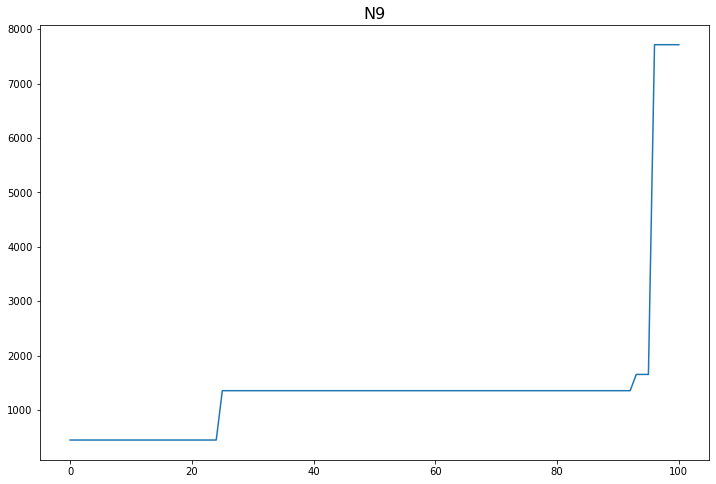

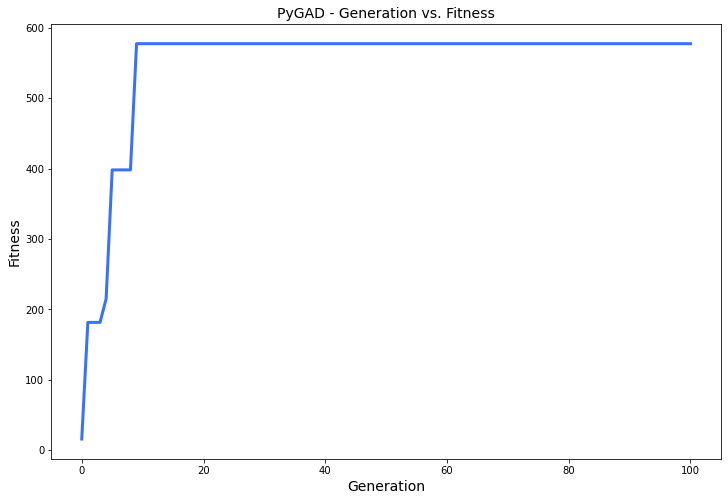

[0.265]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 24.788 |==================| 3.667 |==========
[-0.27]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 24.783 |==================| 3.603 |==========
[-0.573]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.573 |===========| 24.427 |==================| 1.576 |==========
[0.658]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.658 |===========| 24.318 |==================| 1.347 |==========
[-0.809]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.809 |===========| 24.119 |==================| 1.061 |==========
[0.413]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 24.621 |==================| 2.272 |==========
[0.661]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.816 |===========| 28.551 |==================| 2.228 |==========
[0.263]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 28.876 |==================| 8.017 |==========
[0.17]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 28.922 |==================| 12.764 |==========
[0.268]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 28.873 |==================| 7.861 |==========
[0.189]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 28.913 |==================| 11.448 |==========
[0.878]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.878 |===========| 28.51 |==================| 2.039 |==========
[0.143]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.517 |===========| 28.737 |==================| 3.793 |==========
[0.394]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 28.806 |==================| 5.153 |==========
[0.094]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 28.958 |==================| 23.751 |==========
[-0.282]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 28.866 |==================| 7.43 |==========
Fitness = 88.76001076218907
[0.268]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 28.873 |==================| 7.861 |==========
[0.189]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 28.913 |==================| 11.448 |==========
[0.878]
=====|SOLUTION|===========|OUTPUT|============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.517 |===========| 28.737 |==================| 3.793 |==========
[0.394]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 28.806 |==================| 5.153 |==========
[0.094]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 28.958 |==================| 23.751 |==========
[-0.282]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 28.866 |==================| 7.43 |==========
[0.268]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 28.873 |==================| 7.861 |==========
[0.189]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 28.913 |==================| 11.448 |==========
[0.878]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.854 |===========| 28.526 |==================| 2.108 |==========
[0.858]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.858 |===========| 28.523 |==================| 2.096 |==========
Generation = 2
[-0.966]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.966 |===========| 28.45 |==================| 1.817 |==========
[-0.369]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 28.82 |==================| 5.532 |==========
[0.354]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 28.828 |==================| 5.795 |==========
[0.264]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 28.875 |==================| 7.991 |==========
[0.969]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.854 |===========| 28.526 |==================| 2.108 |==========
[0.858]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.858 |===========| 28.523 |==================| 2.096 |==========
Change = 45.07018279955386
[-0.966]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.966 |===========| 28.45 |==================| 1.817 |==========
[-0.369]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 28.82 |==================| 5.532 |==========
[0.354]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 28.828 |==================| 5.795 |==========
[0.264]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 28.875 |==================| 7.991 |==========
[0.969]
=====|SOLUTION|===========|OUTPUT|===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.006 |===========| 28.422 |==================| 1.73 |==========
[-0.854]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.854 |===========| 28.526 |==================| 2.108 |==========
[0.858]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.858 |===========| 28.523 |==================| 2.096 |==========
[-0.264]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 28.875 |==================| 7.997 |==========
[0.141]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 28.936 |==================| 15.487 |==========
[0.199]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 28.908 |==================| 10.831 |==========
[-0.1]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 28.992 |==================| 114.627 |==========
[1.012]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.012 |===========| 28.417 |==================| 1.715 |==========
Fitness = 133.83019356174293
[-0.264]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 28.875 |==================| 7.997 |==========
[0.141]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 28.936 |==================| 15.487 |==========
[0.199]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 28.908 |==================| 10.831 |==========
[-0.1]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 28.955 |==================| 22.211 |==========
[0.396]
=====|SOLUTION|===========|OUTPUT|===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.012 |===========| 28.417 |==================| 1.715 |==========
[-0.264]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 28.875 |==================| 7.997 |==========
[0.141]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 28.936 |==================| 15.487 |==========
[0.199]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 28.908 |==================| 10.831 |==========
[-0.1]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 28.955 |==================| 22.211 |==========
[0.396]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 28.805 |==================| 5.125 |==========
[0.901]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.86 |===========| 28.522 |==================| 2.093 |==========
[0.166]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 28.924 |==================| 13.136 |==========
[-0.088]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 28.961 |==================| 25.322 |==========
[0.12]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.12 |===========| 28.946 |==================| 18.342 |==========
[0.514]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.514 |===========| 28.738 |==================| 3.817 |==========
[-0.11]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 28.951 |==================| 20.112 |==========
[-0.623]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 28.924 |==================| 13.136 |==========
[-0.088]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 28.961 |==================| 25.322 |==========
[0.12]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.12 |===========| 28.946 |==================| 18.342 |==========
[0.514]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.514 |===========| 28.738 |==================| 3.817 |==========
[-0.11]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 28.951 |==================| 20.112 |==========
[-0.623]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.623 |===========| 28.674 |==================| 3.061 |==========
[0.785]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

[-0.367]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 28.821 |==================| 5.566 |==========
[-0.167]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 28.923 |==================| 12.989 |==========
[-0.793]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.793 |===========| 28.566 |==================| 2.305 |==========
[-0.414]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 28.795 |==================| 4.873 |==========
[0.148]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 28.933 |==================| 14.756 |==========
[0.119]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 28.946 |==================| 18.495 |==========
[-0.71]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.932 |===========| 28.474 |==================| 1.898 |==========
[-0.367]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 28.821 |==================| 5.566 |==========
[-0.167]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 28.923 |==================| 12.989 |==========
[-0.793]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.793 |===========| 28.566 |==================| 2.305 |==========
[-0.414]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 28.795 |==================| 4.873 |==========
[0.148]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 28.933 |==================| 14.756 |==========
[0.119]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

[0.71]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.71 |===========| 28.62 |==================| 2.627 |==========
[-0.932]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.932 |===========| 28.474 |==================| 1.898 |==========
[-0.367]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 28.821 |==================| 5.566 |==========
[-0.167]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 28.923 |==================| 12.989 |==========
[-0.793]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.793 |===========| 28.566 |==================| 2.305 |==========
[-0.414]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 28.795 |==================| 4.873 |==========
[0.148]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 28.541 |==================| 2.178 |==========
[0.239]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 28.888 |==================| 8.896 |==========
[0.376]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 28.816 |==================| 5.428 |==========
[-0.209]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.209 |===========| 28.903 |==================| 10.276 |==========
[0.259]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 28.878 |==================| 8.17 |==========
[-0.107]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 28.952 |==================| 20.685 |==========
[0.211]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 28.541 |==================| 2.178 |==========
[0.239]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 28.888 |==================| 8.896 |==========
[0.376]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 28.816 |==================| 5.428 |==========
[-0.209]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.209 |===========| 28.903 |==================| 10.276 |==========
[0.259]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 28.878 |==================| 8.17 |==========
[-0.107]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 28.952 |==================| 20.685 |==========
[0.211]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 28.829 |==================| 5.821 |==========
[-0.496]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 28.749 |==================| 3.974 |==========
[-0.868]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.868 |===========| 28.517 |==================| 2.067 |==========
[-0.551]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 28.717 |==================| 3.527 |==========
[-0.819]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.819 |===========| 28.549 |==================| 2.217 |==========
[-0.322]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 28.845 |==================| 6.444 |==========
[0.02]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 28.749 |==================| 3.974 |==========
[-0.868]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.868 |===========| 28.517 |==================| 2.067 |==========
[-0.551]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 28.717 |==================| 3.527 |==========
[-0.819]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.819 |===========| 28.549 |==================| 2.217 |==========
[-0.322]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 28.845 |==================| 6.444 |==========
[0.02]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 28.992 |==================| 113.48 |==========
[0.635]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 28.829 |==================| 5.821 |==========
[-0.496]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 28.749 |==================| 3.974 |==========
[-0.868]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.868 |===========| 28.517 |==================| 2.067 |==========
[-0.551]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 28.717 |==================| 3.527 |==========
[-0.819]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.819 |===========| 28.549 |==================| 2.217 |==========
[-0.322]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 28.845 |==================| 6.444 |==========
[0.02]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 28.809 |==================| 5.229 |==========
[-0.164]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 28.925 |==================| 13.272 |==========
[0.29]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 28.862 |==================| 7.225 |==========
[-0.628]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.628 |===========| 28.67 |==================| 3.03 |==========
[0.424]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 28.79 |==================| 4.752 |==========
[0.902]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 28.494 |==================| 1.973 |==========
[-0.026]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 28.809 |==================| 5.229 |==========
[-0.164]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 28.925 |==================| 13.272 |==========
[0.29]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 28.862 |==================| 7.225 |==========
[-0.628]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.628 |===========| 28.67 |==================| 3.03 |==========
[0.424]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 28.79 |==================| 4.752 |==========
[0.902]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 28.494 |==================| 1.973 |==========
[-0.026]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.943 |===========| 28.466 |==================| 1.871 |==========
[0.099]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 28.956 |==================| 22.377 |==========
[0.879]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.879 |===========| 28.509 |==================| 2.037 |==========
[0.22]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 28.898 |==================| 9.739 |==========
[0.208]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 28.903 |==================| 10.327 |==========
[-0.416]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 28.794 |==================| 4.853 |==========
[0.542]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.943 |===========| 28.466 |==================| 1.871 |==========
[0.099]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 28.956 |==================| 22.377 |==========
[0.879]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.879 |===========| 28.509 |==================| 2.037 |==========
[0.22]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 28.898 |==================| 9.739 |==========
[0.208]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 28.903 |==================| 10.327 |==========
[-0.416]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 28.794 |==================| 4.853 |==========
[0.542]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 28.956 |==================| 22.377 |==========
[0.879]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.879 |===========| 28.509 |==================| 2.037 |==========
[0.22]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 28.898 |==================| 9.739 |==========
[0.208]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 28.903 |==================| 10.327 |==========
[-0.416]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 28.794 |==================| 4.853 |==========
[0.542]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.542 |===========| 28.722 |==================| 3.592 |==========
[-0.826]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 28.923 |==================| 13.009 |==========
[0.929]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.929 |===========| 28.476 |==================| 1.906 |==========
[0.497]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 28.748 |==================| 3.969 |==========
[0.888]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.888 |===========| 28.503 |==================| 2.013 |==========
[-0.274]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 28.87 |==================| 7.687 |==========
[0.818]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.818 |===========| 28.55 |==================| 2.222 |==========
[-0.966]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 28.694 |==================| 3.265 |==========
[0.167]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 28.923 |==================| 13.009 |==========
[0.929]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.929 |===========| 28.476 |==================| 1.906 |==========
[0.497]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 28.748 |==================| 3.969 |==========
[0.888]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.888 |===========| 28.503 |==================| 2.013 |==========
[-0.274]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 28.87 |==================| 7.687 |==========
[0.818]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 28.91 |==================| 11.112 |==========
[0.422]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 28.791 |==================| 4.771 |==========
[0.249]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 28.883 |==================| 8.492 |==========
[0.589]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 28.694 |==================| 3.267 |==========
[-0.083]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 28.963 |==================| 27.015 |==========
[0.334]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 28.839 |==================| 6.187 |==========
[-0.029]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 28.883 |==================| 8.549 |==========
[0.194]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 28.91 |==================| 11.112 |==========
[0.422]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 28.791 |==================| 4.771 |==========
[0.249]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 28.883 |==================| 8.492 |==========
[0.589]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 28.694 |==================| 3.267 |==========
[-0.083]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 28.963 |==================| 27.015 |==========
[0.334]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

[0.194]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 28.91 |==================| 11.112 |==========
[0.422]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 28.791 |==================| 4.771 |==========
[0.249]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 28.883 |==================| 8.492 |==========
[0.589]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 28.694 |==================| 3.267 |==========
[-0.083]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 28.963 |==================| 27.015 |==========
[0.334]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 28.839 |==================| 6.187 |==========
[-0.029]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 28.874 |==================| 7.923 |==========
[-0.115]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 28.948 |==================| 19.17 |==========
[0.51]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 28.741 |==================| 3.857 |==========
[-0.528]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 28.73 |==================| 3.701 |==========
[0.804]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.804 |===========| 28.559 |==================| 2.269 |==========
[0.023]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 28.99 |==================| 97.644 |==========
[-0.086]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 28.887 |==================| 8.838 |==========
[0.266]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 28.874 |==================| 7.923 |==========
[-0.115]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 28.948 |==================| 19.17 |==========
[0.51]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 28.741 |==================| 3.857 |==========
[-0.528]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 28.73 |==================| 3.701 |==========
[0.804]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.804 |===========| 28.559 |==================| 2.269 |==========
[0.023]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.617 |===========| 28.677 |==================| 3.096 |==========
[0.785]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.785 |===========| 28.571 |==================| 2.331 |==========
[-0.483]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 28.756 |==================| 4.095 |==========
[0.582]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.582 |===========| 28.699 |==================| 3.314 |==========
[0.504]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 28.744 |==================| 3.905 |==========
[0.89]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.89 |===========| 28.502 |==================| 2.006 |==========
[0.543]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.745 |===========| 28.598 |==================| 2.483 |==========
[-0.617]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.617 |===========| 28.677 |==================| 3.096 |==========
[0.785]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.785 |===========| 28.571 |==================| 2.331 |==========
[-0.483]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 28.756 |==================| 4.095 |==========
[0.582]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.582 |===========| 28.699 |==================| 3.314 |==========
[0.504]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 28.744 |==================| 3.905 |==========
[0.89]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 28.767 |==================| 4.282 |==========
[0.745]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.745 |===========| 28.598 |==================| 2.483 |==========
[-0.617]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.617 |===========| 28.677 |==================| 3.096 |==========
[0.785]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.785 |===========| 28.571 |==================| 2.331 |==========
[-0.483]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 28.756 |==================| 4.095 |==========
[0.582]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.582 |===========| 28.699 |==================| 3.314 |==========
[0.504]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 28.816 |==================| 5.415 |==========
[0.704]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.704 |===========| 28.623 |==================| 2.654 |==========
[-0.161]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 28.926 |==================| 13.493 |==========
[0.735]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.735 |===========| 28.604 |==================| 2.521 |==========
[-0.631]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.631 |===========| 28.669 |==================| 3.017 |==========
[0.214]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 28.9 |==================| 10.004 |==========
[0.601]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 28.958 |==================| 23.75 |==========
Change = 0.0
[0.377]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 28.816 |==================| 5.415 |==========
[0.704]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.704 |===========| 28.623 |==================| 2.654 |==========
[-0.161]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 28.926 |==================| 13.493 |==========
[0.735]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.735 |===========| 28.604 |==================| 2.521 |==========
[-0.631]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.631 |===========| 28.669 |==================| 3.017 |==========
[0.214]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 28.823 |==================| 5.639 |==========
[0.525]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.525 |===========| 28.732 |==================| 3.726 |==========
[0.884]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 28.506 |==================| 2.022 |==========
[0.913]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.913 |===========| 28.487 |==================| 1.947 |==========
[0.84]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.84 |===========| 28.535 |==================| 2.15 |==========
[-0.71]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.71 |===========| 28.62 |==================| 2.628 |==========
[-0.406]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 28.823 |==================| 5.639 |==========
[0.525]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.525 |===========| 28.732 |==================| 3.726 |==========
[0.884]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 28.506 |==================| 2.022 |==========
[0.913]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.913 |===========| 28.487 |==================| 1.947 |==========
[0.84]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.84 |===========| 28.535 |==================| 2.15 |==========
[-0.71]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.71 |===========| 28.62 |==================| 2.628 |==========
[-0.406]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 28.823 |==================| 5.639 |==========
[0.525]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.525 |===========| 28.732 |==================| 3.726 |==========
[0.884]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 28.506 |==================| 2.022 |==========
[0.913]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.913 |===========| 28.487 |==================| 1.947 |==========
[0.84]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.84 |===========| 28.535 |==================| 2.15 |==========
[-0.71]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.71 |===========| 28.62 |==================| 2.628 |==========
[-0.406]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 28.894 |==================| 9.426 |==========
[0.509]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.509 |===========| 28.741 |==================| 3.862 |==========
[0.145]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 28.934 |==================| 15.071 |==========
[-0.752]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 28.593 |==================| 2.454 |==========
[-0.542]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.542 |===========| 28.722 |==================| 3.592 |==========
[-0.136]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 28.938 |==================| 16.151 |==========
[0.324]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 28.966 |==================| 28.954 |==========
[0.226]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 28.894 |==================| 9.426 |==========
[0.509]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.509 |===========| 28.741 |==================| 3.862 |==========
[0.145]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 28.934 |==================| 15.071 |==========
[-0.752]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 28.593 |==================| 2.454 |==========
[-0.542]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.542 |===========| 28.722 |==================| 3.592 |==========
[-0.136]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.534 |===========| 28.727 |==================| 3.656 |==========
[0.277]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 28.868 |==================| 7.582 |==========
[0.671]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.671 |===========| 28.644 |==================| 2.805 |==========
[0.263]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 28.875 |==================| 8.007 |==========
[-0.007]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 28.997 |==================| 308.658 |==========
[-0.578]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.578 |===========| 28.701 |==================| 3.34 |==========
[-0.777]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 28.979 |==================| 46.589 |==========
Fitness = 816.2648226758407
[-0.534]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.534 |===========| 28.727 |==================| 3.656 |==========
[0.277]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 28.868 |==================| 7.582 |==========
[0.671]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.671 |===========| 28.644 |==================| 2.805 |==========
[0.263]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 28.875 |==================| 8.007 |==========
[-0.007]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 28.997 |==================| 308.658 |==========
[-0.578]
=====|SOLUTION|===========|OUTPUT|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.534 |===========| 28.727 |==================| 3.656 |==========
[0.277]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 28.868 |==================| 7.582 |==========
[0.671]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.671 |===========| 28.644 |==================| 2.805 |==========
[0.263]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 28.875 |==================| 8.007 |==========
[-0.007]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 28.997 |==================| 308.658 |==========
[-0.578]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.578 |===========| 28.701 |==================| 3.34 |==========
[-0.777]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.929 |===========| 28.475 |==================| 1.905 |==========
[-0.192]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 28.911 |==================| 11.249 |==========
[0.055]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 28.976 |==================| 41.026 |==========
[-0.998]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.998 |===========| 28.428 |==================| 1.747 |==========
[-0.773]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.773 |===========| 28.58 |==================| 2.377 |==========
[0.727]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 28.609 |==================| 2.553 |==========
[-0.031]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 28.956 |==================| 22.581 |==========
Change = 0.0
[-0.929]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.929 |===========| 28.475 |==================| 1.905 |==========
[-0.192]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 28.911 |==================| 11.249 |==========
[0.055]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 28.976 |==================| 41.026 |==========
[-0.998]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.998 |===========| 28.428 |==================| 1.747 |==========
[-0.773]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.773 |===========| 28.58 |==================| 2.377 |==========
[0.727]
=====|SOLUTION|===========|OUTPUT|==================|FITN

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 28.748 |==================| 3.966 |==========
[-0.098]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 28.956 |==================| 22.581 |==========
[-0.365]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 28.822 |==================| 5.616 |==========
[0.867]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.867 |===========| 28.518 |==================| 2.072 |==========
[0.01]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 28.996 |==================| 220.565 |==========
[-0.131]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 28.941 |==================| 16.817 |==========
[-0.657]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 28.872 |==================| 7.815 |==========
[-0.354]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 28.828 |==================| 5.807 |==========
Fitness = 816.2648226758407
[-0.365]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 28.822 |==================| 5.616 |==========
[0.867]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.867 |===========| 28.518 |==================| 2.072 |==========
[0.01]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 28.996 |==================| 220.565 |==========
[-0.131]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 28.941 |==================| 16.817 |==========
[-0.657]
=====|SOLUTION|===========|OUTPUT|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 28.828 |==================| 5.807 |==========
[-0.365]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 28.822 |==================| 5.616 |==========
[0.867]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.867 |===========| 28.518 |==================| 2.072 |==========
[0.01]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 28.996 |==================| 220.565 |==========
[-0.131]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 28.941 |==================| 16.817 |==========
[-0.657]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.657 |===========| 28.653 |==================| 2.876 |==========
[-0.389]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 28.973 |==================| 36.496 |==========
[-0.855]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.855 |===========| 28.525 |==================| 2.105 |==========
[0.697]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.697 |===========| 28.628 |==================| 2.685 |==========
[0.786]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.786 |===========| 28.571 |==================| 2.33 |==========
[0.879]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.879 |===========| 28.51 |==================| 2.038 |==========
[0.216]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 28.899 |==================| 9.916 |==========
[-0.546]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 28.973 |==================| 36.496 |==========
[-0.855]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.855 |===========| 28.525 |==================| 2.105 |==========
[0.697]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.697 |===========| 28.628 |==================| 2.685 |==========
[0.786]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.786 |===========| 28.571 |==================| 2.33 |==========
[0.879]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.879 |===========| 28.51 |==================| 2.038 |==========
[0.216]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 28.899 |==================| 9.916 |==========
[-0.546]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.816 |===========| 28.552 |==================| 2.228 |==========
[-0.149]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 28.932 |==================| 14.716 |==========
[-0.551]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 28.717 |==================| 3.525 |==========
[0.925]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.925 |===========| 28.478 |==================| 1.914 |==========
[-0.143]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 28.935 |==================| 15.286 |==========
[-0.908]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.908 |===========| 28.49 |==================| 1.958 |==========
[0.074]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 28.932 |==================| 14.716 |==========
[-0.551]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 28.717 |==================| 3.525 |==========
[0.925]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.925 |===========| 28.478 |==================| 1.914 |==========
[-0.143]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 28.935 |==================| 15.286 |==========
[-0.908]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.908 |===========| 28.49 |==================| 1.958 |==========
[0.074]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 28.967 |==================| 30.075 |==========
[-0.207]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 28.717 |==================| 3.525 |==========
[0.925]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.925 |===========| 28.478 |==================| 1.914 |==========
[-0.143]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 28.935 |==================| 15.286 |==========
[-0.908]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.908 |===========| 28.49 |==================| 1.958 |==========
[0.074]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 28.967 |==================| 30.075 |==========
[-0.207]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 28.904 |==================| 10.382 |==========
[0.767]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 28.892 |==================| 9.211 |==========
[0.265]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 28.875 |==================| 7.956 |==========
[0.7]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.7 |===========| 28.626 |==================| 2.673 |==========
[-0.034]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 28.986 |==================| 67.717 |==========
[0.905]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 28.492 |==================| 1.967 |==========
[-0.454]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 28.773 |==================| 4.393 |==========
[0.354]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 28.892 |==================| 9.211 |==========
[0.265]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 28.875 |==================| 7.956 |==========
[0.7]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.7 |===========| 28.626 |==================| 2.673 |==========
[-0.034]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 28.986 |==================| 67.717 |==========
[0.905]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 28.492 |==================| 1.967 |==========
[-0.454]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 28.773 |==================| 4.393 |==========
[0.354]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.9 |===========| 28.495 |==================| 1.981 |==========
[-0.839]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.839 |===========| 28.536 |==================| 2.153 |==========
[-0.844]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.844 |===========| 28.533 |==================| 2.139 |==========
[-0.107]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 28.952 |==================| 20.781 |==========
[0.314]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.314 |===========| 28.849 |==================| 6.61 |==========
[-0.117]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 28.948 |==================| 18.961 |==========
[0.058]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.617 |===========| 28.677 |==================| 3.096 |==========
[-0.9]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.9 |===========| 28.495 |==================| 1.981 |==========
[-0.839]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.839 |===========| 28.536 |==================| 2.153 |==========
[-0.844]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.844 |===========| 28.533 |==================| 2.139 |==========
[-0.107]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 28.952 |==================| 20.781 |==========
[0.314]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.314 |===========| 28.849 |==================| 6.61 |==========
[-0.117]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.558 |===========| 28.713 |==================| 3.475 |==========
[0.617]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.617 |===========| 28.677 |==================| 3.096 |==========
[-0.9]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.9 |===========| 28.495 |==================| 1.981 |==========
[-0.839]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.839 |===========| 28.536 |==================| 2.153 |==========
[-0.844]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.844 |===========| 28.533 |==================| 2.139 |==========
[-0.107]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 28.952 |==================| 20.781 |==========
[0.314]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.997 |===========| 28.428 |==================| 1.747 |==========
[-0.028]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 28.988 |==================| 80.303 |==========
[-0.566]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.566 |===========| 28.708 |==================| 3.42 |==========
[0.877]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.877 |===========| 28.511 |==================| 2.043 |==========
[-0.686]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 28.635 |==================| 2.736 |==========
[0.865]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 28.519 |==================| 2.078 |==========
[-0.523]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 28.988 |==================| 80.303 |==========
[-0.566]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.566 |===========| 28.708 |==================| 3.42 |==========
[0.877]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.877 |===========| 28.511 |==================| 2.043 |==========
[-0.686]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 28.635 |==================| 2.736 |==========
[0.865]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 28.519 |==================| 2.078 |==========
[-0.523]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.523 |===========| 28.733 |==================| 3.744 |==========
[0.223]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 28.646 |==================| 2.82 |==========
[-0.177]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 28.918 |==================| 12.218 |==========
[-0.079]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 28.965 |==================| 28.44 |==========
[-0.246]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 28.884 |==================| 8.609 |==========
[0.145]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 28.934 |==================| 15.087 |==========
[0.851]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 28.528 |==================| 2.116 |==========
[0.888]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.833 |===========| 28.54 |==================| 2.172 |==========
[0.668]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 28.646 |==================| 2.82 |==========
[-0.177]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 28.918 |==================| 12.218 |==========
[-0.079]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 28.965 |==================| 28.44 |==========
[-0.246]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 28.884 |==================| 8.609 |==========
[0.145]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 28.934 |==================| 15.087 |==========
[0.851]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

[0.668]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 28.646 |==================| 2.82 |==========
[-0.177]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 28.918 |==================| 12.218 |==========
[-0.079]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 28.965 |==================| 28.44 |==========
[-0.246]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 28.884 |==================| 8.609 |==========
[0.145]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 28.934 |==================| 15.087 |==========
[0.851]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 28.528 |==================| 2.116 |==========
[0.888]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.238 |===========| 28.888 |==================| 8.918 |==========
[0.635]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.635 |===========| 28.666 |==================| 2.995 |==========
[0.768]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 28.583 |==================| 2.394 |==========
[-0.491]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 28.752 |==================| 4.022 |==========
[-0.239]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 28.888 |==================| 8.905 |==========
[0.73]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.73 |===========| 28.607 |==================| 2.542 |==========
[0.84]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.825 |===========| 28.545 |==================| 2.197 |==========
[-0.238]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.238 |===========| 28.888 |==================| 8.918 |==========
[0.635]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.635 |===========| 28.666 |==================| 2.995 |==========
[0.768]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 28.583 |==================| 2.394 |==========
[-0.491]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 28.752 |==================| 4.022 |==========
[-0.239]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 28.888 |==================| 8.905 |==========
[0.73]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.621 |===========| 28.675 |==================| 3.07 |==========
[0.453]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 28.774 |==================| 4.41 |==========
[0.362]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 28.824 |==================| 5.662 |==========
[0.696]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 28.629 |==================| 2.69 |==========
[-0.322]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 28.845 |==================| 6.446 |==========
[0.233]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 28.891 |==================| 9.154 |==========
[-0.086]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.674 |===========| 28.642 |==================| 2.793 |==========
[0.621]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.621 |===========| 28.675 |==================| 3.07 |==========
[0.453]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 28.774 |==================| 4.41 |==========
[0.362]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 28.824 |==================| 5.662 |==========
[0.696]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 28.629 |==================| 2.69 |==========
[-0.322]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 28.845 |==================| 6.446 |==========
[0.233]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.674 |===========| 28.642 |==================| 2.793 |==========
[0.621]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.621 |===========| 28.675 |==================| 3.07 |==========
[0.453]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 28.774 |==================| 4.41 |==========
[0.362]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 28.824 |==================| 5.662 |==========
[0.696]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 28.629 |==================| 2.69 |==========
[-0.322]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 28.845 |==================| 6.446 |==========
[0.233]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.906 |===========| 28.491 |==================| 1.964 |==========
[-0.372]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 28.818 |==================| 5.485 |==========
[-0.483]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 28.756 |==================| 4.095 |==========
[0.942]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.942 |===========| 28.467 |==================| 1.874 |==========
[-0.797]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.797 |===========| 28.563 |==================| 2.289 |==========
[-0.359]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 28.825 |==================| 5.704 |==========
[-0.026]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.77 |===========| 28.581 |==================| 2.387 |==========
[-0.906]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.906 |===========| 28.491 |==================| 1.964 |==========
[-0.372]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 28.818 |==================| 5.485 |==========
[-0.483]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 28.756 |==================| 4.095 |==========
[0.942]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.942 |===========| 28.467 |==================| 1.874 |==========
[-0.797]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.797 |===========| 28.563 |==================| 2.289 |==========
[-0.359]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.78 |===========| 28.575 |==================| 2.35 |==========
[0.604]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.604 |===========| 28.685 |==================| 3.174 |==========
[0.178]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 28.918 |==================| 12.173 |==========
[0.264]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 28.875 |==================| 8.004 |==========
[0.364]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 28.822 |==================| 5.621 |==========
[-0.57]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.57 |===========| 28.706 |==================| 3.395 |==========
[-0.101]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 28.784 |==================| 4.632 |==========
[-0.78]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.78 |===========| 28.575 |==================| 2.35 |==========
[0.604]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.604 |===========| 28.685 |==================| 3.174 |==========
[0.178]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 28.918 |==================| 12.173 |==========
[0.264]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 28.875 |==================| 8.004 |==========
[0.364]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 28.822 |==================| 5.621 |==========
[-0.57]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 28.784 |==================| 4.632 |==========
[-0.78]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.78 |===========| 28.575 |==================| 2.35 |==========
[0.604]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.604 |===========| 28.685 |==================| 3.174 |==========
[0.178]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 28.918 |==================| 12.173 |==========
[0.264]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 28.875 |==================| 8.004 |==========
[0.364]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 28.822 |==================| 5.621 |==========
[-0.57]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.602 |===========| 28.686 |==================| 3.185 |==========
[-0.661]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.661 |===========| 28.651 |==================| 2.859 |==========
[0.419]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.419 |===========| 28.792 |==================| 4.809 |==========
[0.134]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.134 |===========| 28.939 |==================| 16.409 |==========
[0.994]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.994 |===========| 28.43 |==================| 1.754 |==========
[-0.416]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 28.794 |==================| 4.844 |==========
[-0.063]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.602 |===========| 28.686 |==================| 3.185 |==========
[-0.661]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.661 |===========| 28.651 |==================| 2.859 |==========
[0.419]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.419 |===========| 28.792 |==================| 4.809 |==========
[0.134]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.134 |===========| 28.939 |==================| 16.409 |==========
[0.994]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.994 |===========| 28.43 |==================| 1.754 |==========
[-0.416]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 28.794 |==================| 4.844 |==========
[-0.063]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.5 |===========| 28.746 |==================| 3.94 |==========
[-0.206]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 28.904 |==================| 10.419 |==========
[-0.905]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 28.492 |==================| 1.966 |==========
[0.385]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 28.811 |==================| 5.284 |==========
[-0.076]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 28.967 |==================| 29.637 |==========
[-0.21]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 28.903 |==================| 10.23 |==========
[-0.389]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 28.904 |==================| 10.419 |==========
[-0.905]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 28.492 |==================| 1.966 |==========
[0.385]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 28.811 |==================| 5.284 |==========
[-0.076]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 28.967 |==================| 29.637 |==========
[-0.21]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 28.903 |==================| 10.23 |==========
[-0.389]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 28.809 |==================| 5.227 |==========
[-0.141]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 28.492 |==================| 1.966 |==========
[0.385]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 28.811 |==================| 5.284 |==========
[-0.076]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 28.967 |==================| 29.637 |==========
[-0.21]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 28.903 |==================| 10.23 |==========
[-0.389]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 28.809 |==================| 5.227 |==========
[-0.141]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 28.936 |==================| 15.55 |==========
[-0.541]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 28.99 |==================| 95.594 |==========
[-0.567]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.567 |===========| 28.708 |==================| 3.416 |==========
[-0.374]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 28.817 |==================| 5.462 |==========
[0.128]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 28.942 |==================| 17.221 |==========
[-0.234]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 28.891 |==================| 9.11 |==========
[-0.978]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.978 |===========| 28.441 |==================| 1.789 |==========
[-0.481]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.909 |===========| 28.489 |==================| 1.956 |==========
[0.024]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 28.99 |==================| 95.594 |==========
[-0.567]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.567 |===========| 28.708 |==================| 3.416 |==========
[-0.374]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 28.817 |==================| 5.462 |==========
[0.128]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 28.942 |==================| 17.221 |==========
[-0.234]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 28.891 |==================| 9.11 |==========
[-0.978]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.982 |===========| 28.439 |==================| 1.78 |==========
[-0.961]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 28.454 |==================| 1.829 |==========
[0.148]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 28.933 |==================| 14.807 |==========
[-0.884]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 28.506 |==================| 2.022 |==========
[0.35]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 28.83 |==================| 5.881 |==========
[-0.181]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 28.916 |==================| 11.929 |==========
[-0.152]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 28.793 |==================| 4.828 |==========
[-0.982]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.982 |===========| 28.439 |==================| 1.78 |==========
[-0.961]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 28.454 |==================| 1.829 |==========
[0.148]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 28.933 |==================| 14.807 |==========
[-0.884]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 28.506 |==================| 2.022 |==========
[0.35]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 28.83 |==================| 5.881 |==========
[-0.181]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 28.793 |==================| 4.828 |==========
[-0.982]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.982 |===========| 28.439 |==================| 1.78 |==========
[-0.961]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 28.454 |==================| 1.829 |==========
[0.148]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 28.933 |==================| 14.807 |==========
[-0.884]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 28.506 |==================| 2.022 |==========
[0.35]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 28.83 |==================| 5.881 |==========
[-0.181]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.934 |===========| 28.472 |==================| 1.893 |==========
[-0.507]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.507 |===========| 28.743 |==================| 3.882 |==========
[0.004]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 28.999 |==================| 576.445 |==========
[-0.437]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 28.782 |==================| 4.587 |==========
[0.822]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.822 |===========| 28.547 |==================| 2.206 |==========
[-0.208]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 28.903 |==================| 10.305 |==========
[0.231]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.934 |===========| 28.472 |==================| 1.893 |==========
[-0.507]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.507 |===========| 28.743 |==================| 3.882 |==========
[0.004]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 28.999 |==================| 576.445 |==========
[-0.437]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 28.782 |==================| 4.587 |==========
[0.822]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.822 |===========| 28.547 |==================| 2.206 |==========
[-0.208]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 28.903 |==================| 10.305 |==========
[0.231]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 28.969 |==================| 32.319 |==========
[0.31]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 28.851 |==================| 6.714 |==========
[-0.348]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 28.831 |==================| 5.911 |==========
[-0.246]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 28.884 |==================| 8.624 |==========
[-0.923]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.923 |===========| 28.48 |==================| 1.921 |==========
[0.353]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 28.828 |==================| 5.814 |==========
[-0.351]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

[0.069]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 28.969 |==================| 32.319 |==========
[0.31]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 28.851 |==================| 6.714 |==========
[-0.348]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 28.831 |==================| 5.911 |==========
[-0.246]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 28.884 |==================| 8.624 |==========
[-0.923]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.923 |===========| 28.48 |==================| 1.921 |==========
[0.353]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 28.828 |==================| 5.814 |==========
[-0.351]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 28.936 |==================| 15.513 |==========
[0.069]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 28.969 |==================| 32.319 |==========
[0.31]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 28.851 |==================| 6.714 |==========
[-0.348]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 28.831 |==================| 5.911 |==========
[-0.246]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 28.884 |==================| 8.624 |==========
[-0.923]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.923 |===========| 28.48 |==================| 1.921 |==========
[0.353]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 28.946 |==================| 18.299 |==========
Generation = 36
[-0.748]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.748 |===========| 28.595 |==================| 2.469 |==========
[-0.77]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.77 |===========| 28.581 |==================| 2.386 |==========
[0.967]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.967 |===========| 28.449 |==================| 1.815 |==========
[0.075]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 28.967 |==================| 29.959 |==========
[0.967]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.967 |===========| 28.449 |==================| 1.814 |==========
[-0.573]
=====|SOLUTION|===========|OUTPUT|==================|FITN

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.514 |===========| 28.738 |==================| 3.817 |==========
[0.121]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 28.946 |==================| 18.299 |==========
Change = 0.0
[-0.748]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.748 |===========| 28.595 |==================| 2.469 |==========
[-0.77]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.77 |===========| 28.581 |==================| 2.386 |==========
[0.967]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.967 |===========| 28.449 |==================| 1.815 |==========
[0.075]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 28.967 |==================| 29.959 |==========
[0.967]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.514 |===========| 28.738 |==================| 3.817 |==========
[0.121]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 28.946 |==================| 18.299 |==========
[0.485]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 28.755 |==================| 4.081 |==========
[-0.046]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 28.98 |==================| 48.749 |==========
[0.894]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.894 |===========| 28.499 |==================| 1.996 |==========
[-0.19]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 28.912 |==================| 11.379 |==========
[-0.076]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 28.802 |==================| 5.044 |==========
[0.59]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.59 |===========| 28.694 |==================| 3.26 |==========
[0.36]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 28.824 |==================| 5.686 |==========
Fitness = 918.4601966955265
[0.485]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 28.755 |==================| 4.081 |==========
[-0.046]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 28.98 |==================| 48.749 |==========
[0.894]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.894 |===========| 28.499 |==================| 1.996 |==========
[-0.19]
=====|SOLUTION|===========|OUTPUT|==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 28.87 |==================| 7.677 |==========
[-0.402]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 28.802 |==================| 5.044 |==========
[0.59]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.59 |===========| 28.694 |==================| 3.26 |==========
[0.36]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 28.824 |==================| 5.686 |==========
[0.485]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 28.755 |==================| 4.081 |==========
[-0.046]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 28.98 |==================| 48.749 |==========
[0.894]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 28.829 |==================| 5.826 |==========
[-0.808]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.808 |===========| 28.557 |==================| 2.254 |==========
[-0.294]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 28.86 |==================| 7.108 |==========
[0.883]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 28.506 |==================| 2.025 |==========
Generation = 38
[0.596]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.596 |===========| 28.69 |==================| 3.22 |==========
[0.536]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 28.725 |==================| 3.637 |==========
[-0.97]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.808 |===========| 28.557 |==================| 2.254 |==========
[-0.294]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 28.86 |==================| 7.108 |==========
[0.883]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 28.506 |==================| 2.025 |==========
Change = 0.0
[0.596]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.596 |===========| 28.69 |==================| 3.22 |==========
[0.536]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 28.725 |==================| 3.637 |==========
[-0.97]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.97 |===========| 28.447 |==================| 1.808 |==========
[-0.623]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.808 |===========| 28.557 |==================| 2.254 |==========
[-0.294]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 28.86 |==================| 7.108 |==========
[0.883]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 28.506 |==================| 2.025 |==========
[0.176]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 28.919 |==================| 12.343 |==========
[-0.278]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 28.868 |==================| 7.55 |==========
[0.526]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.526 |===========| 28.732 |==================| 3.723 |==========
[0.763]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 28.983 |==================| 56.709 |==========
[-0.693]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.693 |===========| 28.63 |==================| 2.703 |==========
[0.125]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 28.944 |==================| 17.694 |==========
Fitness = 918.4601966955265
[0.176]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 28.919 |==================| 12.343 |==========
[-0.278]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 28.868 |==================| 7.55 |==========
[0.526]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.526 |===========| 28.732 |==================| 3.723 |==========
[0.763]
=====|SOLUTION|===========|OUTPUT|============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.709 |===========| 28.62 |==================| 2.63 |==========
[-0.04]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 28.983 |==================| 56.709 |==========
[-0.693]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.693 |===========| 28.63 |==================| 2.703 |==========
[0.125]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 28.944 |==================| 17.694 |==========
[0.176]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 28.919 |==================| 12.343 |==========
[-0.278]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 28.868 |==================| 7.55 |==========
[0.526]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.701 |===========| 28.625 |==================| 2.668 |==========
[-0.194]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 28.91 |==================| 11.113 |==========
[0.271]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.271 |===========| 28.871 |==================| 7.761 |==========
Generation = 40
[-0.015]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 28.994 |==================| 148.532 |==========
[0.831]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 28.541 |==================| 2.179 |==========
[0.406]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.406 |===========| 28.8 |==================| 4.981 |==========
[0.004]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

[-0.194]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 28.91 |==================| 11.113 |==========
[0.271]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.271 |===========| 28.871 |==================| 7.761 |==========
Change = 0.0
[-0.015]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 28.994 |==================| 148.532 |==========
[0.831]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 28.541 |==================| 2.179 |==========
[0.406]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.406 |===========| 28.8 |==================| 4.981 |==========
[0.004]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 28.999 |==================| 626.541 |==========
[-0.059]
=====|SOLUTION|===========|OUTPUT|================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.701 |===========| 28.625 |==================| 2.668 |==========
[-0.194]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 28.91 |==================| 11.113 |==========
[0.271]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.271 |===========| 28.871 |==================| 7.761 |==========
[0.77]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.77 |===========| 28.581 |==================| 2.387 |==========
[0.041]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 28.982 |==================| 55.04 |==========
[-0.762]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.762 |===========| 28.587 |==================| 2.417 |==========
[0.806]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.174 |===========| 28.92 |==================| 12.5 |==========
[-0.777]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.777 |===========| 28.577 |==================| 2.36 |==========
[-0.579]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 28.7 |==================| 3.33 |==========
Fitness = 918.4601966955265
[0.77]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.77 |===========| 28.581 |==================| 2.387 |==========
[0.041]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 28.982 |==================| 55.04 |==========
[-0.762]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.762 |===========| 28.587 |==================| 2.417 |==========
[0.806]
=====|SOLUTION|===========|OUTPUT|==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.174 |===========| 28.92 |==================| 12.5 |==========
[-0.777]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.777 |===========| 28.577 |==================| 2.36 |==========
[-0.579]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 28.7 |==================| 3.33 |==========
[0.77]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.77 |===========| 28.581 |==================| 2.387 |==========
[0.041]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 28.982 |==================| 55.04 |==========
[-0.762]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.762 |===========| 28.587 |==================| 2.417 |==========
[0.806]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0

[-0.775]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 28.578 |==================| 2.368 |==========
[-0.275]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 28.869 |==================| 7.629 |==========
[0.256]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 28.879 |==================| 8.265 |==========
Generation = 42
[0.05]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 28.978 |==================| 45.61 |==========
[0.48]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 28.758 |==================| 4.124 |==========
[0.602]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.602 |===========| 28.686 |==================| 3.183 |==========
[0.767]
=====|SOLUTION|===========|OUTPUT|==================|F

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 28.578 |==================| 2.368 |==========
[-0.275]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 28.869 |==================| 7.629 |==========
[0.256]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 28.879 |==================| 8.265 |==========
Change = 0.0
[0.05]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 28.978 |==================| 45.61 |==========
[0.48]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 28.758 |==================| 4.124 |==========
[0.602]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.602 |===========| 28.686 |==================| 3.183 |==========
[0.767]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 28.578 |==================| 2.368 |==========
[-0.275]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 28.869 |==================| 7.629 |==========
[0.256]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 28.879 |==================| 8.265 |==========
[0.119]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 28.946 |==================| 18.509 |==========
[-0.899]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.899 |===========| 28.496 |==================| 1.983 |==========
[-0.62]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.62 |===========| 28.676 |==================| 3.079 |==========
[-0.715]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 28.803 |==================| 5.079 |==========
[1.002]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.002 |===========| 28.425 |==================| 1.737 |==========
[0.503]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.503 |===========| 28.745 |==================| 3.911 |==========
[0.27]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 28.872 |==================| 7.787 |==========
Fitness = 918.4601966955265
[0.119]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 28.946 |==================| 18.509 |==========
[-0.899]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.899 |===========| 28.496 |==================| 1.983 |==========
[-0.62]
=====|SOLUTION|===========|OUTPUT|==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.522 |===========| 28.734 |==================| 3.75 |==========
[0.399]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 28.803 |==================| 5.079 |==========
[1.002]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.002 |===========| 28.425 |==================| 1.737 |==========
[0.503]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.503 |===========| 28.745 |==================| 3.911 |==========
[0.27]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 28.872 |==================| 7.787 |==========
[0.119]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 28.946 |==================| 18.509 |==========
[-0.899]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 28.803 |==================| 5.066 |==========
[0.029]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 28.987 |==================| 77.534 |==========
[0.74]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.74 |===========| 28.601 |==================| 2.502 |==========
[0.705]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.705 |===========| 28.623 |==================| 2.649 |==========
[0.455]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 28.772 |==================| 4.385 |==========
Generation = 44
[-0.141]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 28.936 |==================| 15.549 |==========
[0.574]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 28.803 |==================| 5.066 |==========
[0.029]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 28.987 |==================| 77.534 |==========
[0.74]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.74 |===========| 28.601 |==================| 2.502 |==========
[0.705]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.705 |===========| 28.623 |==================| 2.649 |==========
[0.455]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 28.772 |==================| 4.385 |==========
Change = 0.0
[-0.141]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 28.936 |==================| 15.549 |==========
[0.574]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 28.803 |==================| 5.066 |==========
[0.029]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 28.987 |==================| 77.534 |==========
[0.74]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.74 |===========| 28.601 |==================| 2.502 |==========
[0.705]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.705 |===========| 28.623 |==================| 2.649 |==========
[0.455]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 28.772 |==================| 4.385 |==========
[-0.029]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 28.987 |==================| 77.439 |==========
[-0.317]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 28.966 |==================| 29.238 |==========
[-0.671]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.671 |===========| 28.644 |==================| 2.809 |==========
[0.161]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 28.926 |==================| 13.526 |==========
[-0.827]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.827 |===========| 28.544 |==================| 2.191 |==========
[-0.292]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 28.861 |==================| 7.153 |==========
Fitness = 918.4601966955265
[-0.029]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 28.987 |==================| 77.439 |==========
[-0.317]
=====|SOLUTION|===========|OUTPUT|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 28.966 |==================| 29.238 |==========
[-0.671]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.671 |===========| 28.644 |==================| 2.809 |==========
[0.161]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 28.926 |==================| 13.526 |==========
[-0.827]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.827 |===========| 28.544 |==================| 2.191 |==========
[-0.292]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 28.861 |==================| 7.153 |==========
[-0.029]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 28.987 |==================| 77.439 |==========
[-0.317]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 28.832 |==================| 5.941 |==========
[0.026]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.026 |===========| 28.989 |==================| 86.856 |==========
[-0.51]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 28.741 |==================| 3.849 |==========
[-0.872]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 28.514 |==================| 2.056 |==========
[0.837]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.837 |===========| 28.537 |==================| 2.16 |==========
Generation = 46
[-0.512]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.512 |===========| 28.74 |==================| 3.836 |==========
[-0.369]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

[0.026]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.026 |===========| 28.989 |==================| 86.856 |==========
[-0.51]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 28.741 |==================| 3.849 |==========
[-0.872]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 28.514 |==================| 2.056 |==========
[0.837]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.837 |===========| 28.537 |==================| 2.16 |==========
Change = 0.0
[-0.512]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.512 |===========| 28.74 |==================| 3.836 |==========
[-0.369]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 28.82 |==================| 5.532 |==========
[-0.814]
=====|SOLUTION|===========|OUTPUT|==================|F

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 28.832 |==================| 5.941 |==========
[0.026]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.026 |===========| 28.989 |==================| 86.856 |==========
[-0.51]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 28.741 |==================| 3.849 |==========
[-0.872]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 28.514 |==================| 2.056 |==========
[0.837]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.837 |===========| 28.537 |==================| 2.16 |==========
[0.925]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.925 |===========| 28.478 |==================| 1.916 |==========
[-0.565]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.545 |===========| 28.72 |==================| 3.569 |==========
[0.541]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.541 |===========| 28.723 |==================| 3.601 |==========
[-0.334]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 28.839 |==================| 6.185 |==========
[0.665]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.665 |===========| 28.648 |==================| 2.836 |==========
[-0.101]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.101 |===========| 28.955 |==================| 21.917 |==========
[0.33]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 28.841 |==================| 6.261 |==========
Fitness = 918.4601966955265
[0.925]
=====|SOLUTION|===========|OUTPUT|==============

[-0.545]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.545 |===========| 28.72 |==================| 3.569 |==========
[0.541]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.541 |===========| 28.723 |==================| 3.601 |==========
[-0.334]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 28.839 |==================| 6.185 |==========
[0.665]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.665 |===========| 28.648 |==================| 2.836 |==========
[-0.101]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.101 |===========| 28.955 |==================| 21.917 |==========
[0.33]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 28.841 |==================| 6.261 |==========
[0.925]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

[0.061]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.061 |===========| 28.973 |==================| 36.743 |==========
[0.507]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.507 |===========| 28.743 |==================| 3.88 |==========
[-0.484]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 28.756 |==================| 4.093 |==========
[-0.952]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.952 |===========| 28.459 |==================| 1.848 |==========
[-0.644]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 28.661 |==================| 2.945 |==========
[-0.716]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.716 |===========| 28.616 |==================| 2.601 |==========
Generation = 48
[0.328]
=====|SOLUTION|===========|OUTPUT|==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.759 |===========| 28.588 |==================| 2.426 |==========
[0.061]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.061 |===========| 28.973 |==================| 36.743 |==========
[0.507]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.507 |===========| 28.743 |==================| 3.88 |==========
[-0.484]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 28.756 |==================| 4.093 |==========
[-0.952]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.952 |===========| 28.459 |==================| 1.848 |==========
[-0.644]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 28.661 |==================| 2.945 |==========
[-0.716]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.759 |===========| 28.588 |==================| 2.426 |==========
[0.061]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.061 |===========| 28.973 |==================| 36.743 |==========
[0.507]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.507 |===========| 28.743 |==================| 3.88 |==========
[-0.484]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 28.756 |==================| 4.093 |==========
[-0.952]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.952 |===========| 28.459 |==================| 1.848 |==========
[-0.644]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 28.661 |==================| 2.945 |==========
[-0.716]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 28.807 |==================| 5.177 |==========
[0.733]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.733 |===========| 28.605 |==================| 2.529 |==========
[0.192]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 28.911 |==================| 11.239 |==========
[-0.749]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.749 |===========| 28.595 |==================| 2.467 |==========
[0.525]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.525 |===========| 28.732 |==================| 3.729 |==========
[-0.832]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.832 |===========| 28.541 |==================| 2.175 |==========
[0.77]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

[0.733]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.733 |===========| 28.605 |==================| 2.529 |==========
[0.192]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 28.911 |==================| 11.239 |==========
[-0.749]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.749 |===========| 28.595 |==================| 2.467 |==========
[0.525]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.525 |===========| 28.732 |==================| 3.729 |==========
[-0.832]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.832 |===========| 28.541 |==================| 2.175 |==========
[0.77]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.77 |===========| 28.581 |==================| 2.385 |==========
[-0.284]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 28.952 |==================| 20.598 |==========
[-0.158]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 28.928 |==================| 13.819 |==========
[-0.758]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 28.589 |==================| 2.43 |==========
[0.057]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 28.975 |==================| 39.73 |==========
[-0.688]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.688 |===========| 28.634 |==================| 2.726 |==========
[-0.003]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 28.999 |==================| 794.625 |==========
[0.582]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 28.952 |==================| 20.598 |==========
[-0.158]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 28.928 |==================| 13.819 |==========
[-0.758]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 28.589 |==================| 2.43 |==========
[0.057]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 28.975 |==================| 39.73 |==========
[-0.688]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.688 |===========| 28.634 |==================| 2.726 |==========
[-0.003]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 28.999 |==================| 794.625 |==========
[0.582]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 28.928 |==================| 13.819 |==========
[-0.758]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 28.589 |==================| 2.43 |==========
[0.057]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 28.975 |==================| 39.73 |==========
[-0.688]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.688 |===========| 28.634 |==================| 2.726 |==========
[-0.003]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 28.999 |==================| 794.625 |==========
[0.582]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.582 |===========| 28.698 |==================| 3.309 |==========
[0.641]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.535 |===========| 28.726 |==================| 3.652 |==========
[-0.974]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.974 |===========| 28.444 |==================| 1.798 |==========
[-0.333]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 28.839 |==================| 6.212 |==========
[0.193]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 28.911 |==================| 11.143 |==========
[0.417]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 28.794 |==================| 4.837 |==========
[0.443]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 28.779 |==================| 4.524 |==========
[0.972]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.535 |===========| 28.726 |==================| 3.652 |==========
[-0.974]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.974 |===========| 28.444 |==================| 1.798 |==========
[-0.333]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 28.839 |==================| 6.212 |==========
[0.193]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 28.911 |==================| 11.143 |==========
[0.417]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 28.794 |==================| 4.837 |==========
[0.443]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 28.779 |==================| 4.524 |==========
[0.972]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.761 |===========| 28.587 |==================| 2.42 |==========
[0.955]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.955 |===========| 28.457 |==================| 1.842 |==========
[-0.587]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.587 |===========| 28.695 |==================| 3.277 |==========
[0.041]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 28.982 |==================| 55.093 |==========
[-0.172]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 28.921 |==================| 12.64 |==========
[0.014]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 28.994 |==================| 161.014 |==========
Generation = 52
[1.]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.761 |===========| 28.587 |==================| 2.42 |==========
[0.955]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.955 |===========| 28.457 |==================| 1.842 |==========
[-0.587]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.587 |===========| 28.695 |==================| 3.277 |==========
[0.041]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 28.982 |==================| 55.093 |==========
[-0.172]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 28.921 |==================| 12.64 |==========
[0.014]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 28.994 |==================| 161.014 |==========
Change = 0.0
[1.]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.955 |===========| 28.457 |==================| 1.842 |==========
[-0.587]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.587 |===========| 28.695 |==================| 3.277 |==========
[0.041]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 28.982 |==================| 55.093 |==========
[-0.172]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 28.921 |==================| 12.64 |==========
[0.014]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 28.994 |==================| 161.014 |==========
[0.351]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 28.83 |==================| 5.857 |==========
[0.243]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 28.609 |==================| 2.556 |==========
[0.62]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.62 |===========| 28.675 |==================| 3.076 |==========
[0.7]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.7 |===========| 28.626 |==================| 2.672 |==========
[0.912]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.912 |===========| 28.487 |==================| 1.949 |==========
Fitness = 918.4601966955265
[0.351]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 28.83 |==================| 5.857 |==========
[0.243]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.243 |===========| 28.886 |==================| 8.725 |==========
[-0.608]
=====|SOLUTION|===========|OUTPUT|==================|F

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 28.91 |==================| 11.106 |==========
[0.727]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 28.609 |==================| 2.556 |==========
[0.62]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.62 |===========| 28.675 |==================| 3.076 |==========
[0.7]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.7 |===========| 28.626 |==================| 2.672 |==========
[0.912]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.912 |===========| 28.487 |==================| 1.949 |==========
[0.351]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 28.83 |==================| 5.857 |==========
[0.243]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.916 |===========| 28.484 |==================| 1.937 |==========
[-0.403]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.403 |===========| 28.801 |==================| 5.021 |==========
[0.697]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.697 |===========| 28.628 |==================| 2.685 |==========
[-0.342]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 28.834 |==================| 6.028 |==========
Generation = 54
[0.114]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 28.949 |==================| 19.448 |==========
[0.03]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 28.987 |==================| 74.985 |==========
[0.743]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.403 |===========| 28.801 |==================| 5.021 |==========
[0.697]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.697 |===========| 28.628 |==================| 2.685 |==========
[-0.342]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 28.834 |==================| 6.028 |==========
Change = 0.0
[0.114]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 28.949 |==================| 19.448 |==========
[0.03]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 28.987 |==================| 74.985 |==========
[0.743]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 28.599 |==================| 2.491 |==========
[-0.446]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.403 |===========| 28.801 |==================| 5.021 |==========
[0.697]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.697 |===========| 28.628 |==================| 2.685 |==========
[-0.342]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 28.834 |==================| 6.028 |==========
[0.7]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.7 |===========| 28.626 |==================| 2.669 |==========
[0.835]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.835 |===========| 28.539 |==================| 2.165 |==========
[0.611]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.611 |===========| 28.681 |==================| 3.133 |==========
[-0.383]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 28.803 |==================| 5.067 |==========
Fitness = 918.4601966955265
[0.7]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.7 |===========| 28.626 |==================| 2.669 |==========
[0.835]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.835 |===========| 28.539 |==================| 2.165 |==========
[0.611]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.611 |===========| 28.681 |==================| 3.133 |==========
[-0.383]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 28.812 |==================| 5.318 |==========
[0.225]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 28.895 |==================| 9.491 |==========
[-0.18]
=====|SOLUTION|===========|OUTPUT|==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.825 |===========| 28.545 |==================| 2.198 |==========
[0.4]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 28.803 |==================| 5.067 |==========
[0.7]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.7 |===========| 28.626 |==================| 2.669 |==========
[0.835]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.835 |===========| 28.539 |==================| 2.165 |==========
[0.611]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.611 |===========| 28.681 |==================| 3.133 |==========
[-0.383]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 28.812 |==================| 5.318 |==========
[0.225]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 28.52 |==================| 2.082 |==========
Generation = 56
[0.36]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 28.825 |==================| 5.69 |==========
[0.932]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.932 |===========| 28.473 |==================| 1.897 |==========
[-0.655]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.655 |===========| 28.654 |==================| 2.888 |==========
[0.487]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 28.754 |==================| 4.057 |==========
[0.861]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.861 |===========| 28.521 |==================| 2.088 |==========
[0.56]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 28.821 |==================| 5.58 |==========
[-0.863]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 28.52 |==================| 2.082 |==========
Change = 0.0
[0.36]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 28.825 |==================| 5.69 |==========
[0.932]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.932 |===========| 28.473 |==================| 1.897 |==========
[-0.655]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.655 |===========| 28.654 |==================| 2.888 |==========
[0.487]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 28.754 |==================| 4.057 |==========
[0.861]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 28.52 |==================| 2.082 |==========
[0.862]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.862 |===========| 28.521 |==================| 2.086 |==========
[-0.502]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 28.745 |==================| 3.922 |==========
[-0.784]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.784 |===========| 28.572 |==================| 2.335 |==========
[-0.931]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 28.474 |==================| 1.901 |==========
[-0.684]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.684 |===========| 28.636 |==================| 2.743 |==========
[0.189]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.103 |===========| 28.954 |==================| 21.463 |==========
[-0.274]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 28.87 |==================| 7.686 |==========
Fitness = 918.4601966955265
[0.862]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.862 |===========| 28.521 |==================| 2.086 |==========
[-0.502]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 28.745 |==================| 3.922 |==========
[-0.784]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.784 |===========| 28.572 |==================| 2.335 |==========
[-0.931]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 28.474 |==================| 1.901 |==========
[-0.684]
=====|SOLUTION|===========|OUTPUT|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.672 |===========| 28.644 |==================| 2.805 |==========
[-0.103]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.103 |===========| 28.954 |==================| 21.463 |==========
[-0.274]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 28.87 |==================| 7.686 |==========
[0.862]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.862 |===========| 28.521 |==================| 2.086 |==========
[-0.502]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 28.745 |==================| 3.922 |==========
[-0.784]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.784 |===========| 28.572 |==================| 2.335 |==========
[-0.931]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 28.937 |==================| 15.874 |==========
[-0.444]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 28.779 |==================| 4.509 |==========
Generation = 58
[0.915]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.915 |===========| 28.485 |==================| 1.941 |==========
[0.306]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.306 |===========| 28.853 |==================| 6.798 |==========
[-0.483]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 28.756 |==================| 4.096 |==========
[-0.814]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.814 |===========| 28.553 |==================| 2.235 |==========
[-0.337]
=====|SOLUTION|===========|OUTPUT|==================|FI

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 28.975 |==================| 40.245 |==========
[-0.138]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 28.937 |==================| 15.874 |==========
[-0.444]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 28.779 |==================| 4.509 |==========
Change = 0.0
[0.915]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.915 |===========| 28.485 |==================| 1.941 |==========
[0.306]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.306 |===========| 28.853 |==================| 6.798 |==========
[-0.483]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 28.756 |==================| 4.096 |==========
[-0.814]
=====|SOLUTION|===========|OUTPUT|==================|FITN

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 28.975 |==================| 40.245 |==========
[-0.138]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 28.937 |==================| 15.874 |==========
[-0.444]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 28.779 |==================| 4.509 |==========
[-0.377]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 28.816 |==================| 5.416 |==========
[-0.686]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 28.635 |==================| 2.736 |==========
[0.01]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 28.996 |==================| 235.162 |==========
[-0.972]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.554 |===========| 28.715 |==================| 3.505 |==========
[-0.474]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 28.761 |==================| 4.183 |==========
[-0.472]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 28.763 |==================| 4.207 |==========
Fitness = 918.4601966955265
[-0.377]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 28.816 |==================| 5.416 |==========
[-0.686]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 28.635 |==================| 2.736 |==========
[0.01]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 28.996 |==================| 235.162 |==========
[-0.972]
=====|SOLUTION|===========|OUTPUT|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 28.761 |==================| 4.183 |==========
[-0.472]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 28.763 |==================| 4.207 |==========
[-0.377]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 28.816 |==================| 5.416 |==========
[-0.686]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 28.635 |==================| 2.736 |==========
[0.01]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 28.996 |==================| 235.162 |==========
[-0.972]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.972 |===========| 28.446 |==================| 1.804 |==========
[0.301]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.928 |===========| 28.476 |==================| 1.908 |==========
[0.339]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 28.836 |==================| 6.086 |==========
[0.79]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 28.568 |==================| 2.316 |==========
Generation = 60
[0.407]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 28.799 |==================| 4.964 |==========
[-0.465]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 28.767 |==================| 4.277 |==========
[-0.162]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 28.926 |==================| 13.459 |==========
[0.568]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.928 |===========| 28.476 |==================| 1.908 |==========
[0.339]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 28.836 |==================| 6.086 |==========
[0.79]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 28.568 |==================| 2.316 |==========
Change = 0.0
[0.407]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 28.799 |==================| 4.964 |==========
[-0.465]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 28.767 |==================| 4.277 |==========
[-0.162]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 28.926 |==================| 13.459 |==========
[0.568]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 28.999 |==================| 612.004 |==========
[0.928]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.928 |===========| 28.476 |==================| 1.908 |==========
[0.339]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 28.836 |==================| 6.086 |==========
[0.79]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 28.568 |==================| 2.316 |==========
[0.907]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.907 |===========| 28.491 |==================| 1.962 |==========
[-0.413]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 28.796 |==================| 4.886 |==========
[-0.883]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 28.694 |==================| 3.264 |==========
[0.119]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 28.946 |==================| 18.538 |==========
[-0.045]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 28.98 |==================| 50.03 |==========
[-0.832]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.832 |===========| 28.541 |==================| 2.176 |==========
Fitness = 918.4601966955265
[0.907]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.907 |===========| 28.491 |==================| 1.962 |==========
[-0.413]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 28.796 |==================| 4.886 |==========
[-0.883]
=====|SOLUTION|===========|OUTPUT|==========

[0.352]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 28.829 |==================| 5.843 |==========
[0.589]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 28.694 |==================| 3.264 |==========
[0.119]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 28.946 |==================| 18.538 |==========
[-0.045]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 28.98 |==================| 50.03 |==========
[-0.832]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.832 |===========| 28.541 |==================| 2.176 |==========
[0.907]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.907 |===========| 28.491 |==================| 1.962 |==========
[-0.413]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.789 |===========| 28.569 |==================| 2.318 |==========
[-0.539]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.539 |===========| 28.724 |==================| 3.621 |==========
[-0.191]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 28.912 |==================| 11.309 |==========
[-0.31]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 28.851 |==================| 6.702 |==========
[-0.976]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.976 |===========| 28.443 |==================| 1.793 |==========
[-0.307]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.307 |===========| 28.853 |==================| 6.786 |==========
Generation = 62
[0.577]
=====|SOLUTION|===========|OUTPUT|==================|FIT

======| 0.789 |===========| 28.569 |==================| 2.318 |==========
[-0.539]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.539 |===========| 28.724 |==================| 3.621 |==========
[-0.191]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 28.912 |==================| 11.309 |==========
[-0.31]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 28.851 |==================| 6.702 |==========
[-0.976]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.976 |===========| 28.443 |==================| 1.793 |==========
[-0.307]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.307 |===========| 28.853 |==================| 6.786 |==========
Change = 0.0
[0.577]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.577 |===========| 28.701 |==================| 3.3

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.789 |===========| 28.569 |==================| 2.318 |==========
[-0.539]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.539 |===========| 28.724 |==================| 3.621 |==========
[-0.191]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 28.912 |==================| 11.309 |==========
[-0.31]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 28.851 |==================| 6.702 |==========
[-0.976]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.976 |===========| 28.443 |==================| 1.793 |==========
[-0.307]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.307 |===========| 28.853 |==================| 6.786 |==========
[0.598]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.704 |===========| 28.623 |==================| 2.652 |==========
[-0.479]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 28.759 |==================| 4.138 |==========
[0.947]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.947 |===========| 28.463 |==================| 1.862 |==========
[-0.707]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.707 |===========| 28.621 |==================| 2.639 |==========
[-0.665]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.665 |===========| 28.648 |==================| 2.836 |==========
[0.545]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.545 |===========| 28.72 |==================| 3.572 |==========
[-0.195]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.635 |===========| 28.666 |==================| 2.993 |==========
[-0.704]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.704 |===========| 28.623 |==================| 2.652 |==========
[-0.479]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 28.759 |==================| 4.138 |==========
[0.947]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.947 |===========| 28.463 |==================| 1.862 |==========
[-0.707]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.707 |===========| 28.621 |==================| 2.639 |==========
[-0.665]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.665 |===========| 28.648 |==================| 2.836 |==========
[0.545]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 28.808 |==================| 5.207 |==========
[-0.025]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.025 |===========| 28.989 |==================| 92.277 |==========
[0.429]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 28.787 |==================| 4.686 |==========
[-0.905]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 28.492 |==================| 1.967 |==========
[-0.855]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.855 |===========| 28.526 |==================| 2.107 |==========
[0.92]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.92 |===========| 28.481 |==================| 1.927 |==========
[-0.138]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.78 |===========| 28.575 |==================| 2.351 |==========
[0.39]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 28.808 |==================| 5.207 |==========
[-0.025]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.025 |===========| 28.989 |==================| 92.277 |==========
[0.429]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 28.787 |==================| 4.686 |==========
[-0.905]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 28.492 |==================| 1.967 |==========
[-0.855]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.855 |===========| 28.526 |==================| 2.107 |==========
[0.92]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 28.808 |==================| 5.207 |==========
[-0.025]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.025 |===========| 28.989 |==================| 92.277 |==========
[0.429]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 28.787 |==================| 4.686 |==========
[-0.905]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 28.492 |==================| 1.967 |==========
[-0.855]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.855 |===========| 28.526 |==================| 2.107 |==========
[0.92]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.92 |===========| 28.481 |==================| 1.927 |==========
[-0.138]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.524 |===========| 28.732 |==================| 3.733 |==========
[0.305]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 28.854 |==================| 6.836 |==========
[0.332]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 28.84 |==================| 6.229 |==========
[0.966]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.966 |===========| 28.45 |==================| 1.817 |==========
[-0.256]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 28.879 |==================| 8.264 |==========
[-0.187]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 28.913 |==================| 11.517 |==========
Fitness = 918.4601966955265
[0.033]
=====|SOLUTION|===========|OUTPUT|=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 28.826 |==================| 5.734 |==========
[-0.524]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.524 |===========| 28.732 |==================| 3.733 |==========
[0.305]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 28.854 |==================| 6.836 |==========
[0.332]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 28.84 |==================| 6.229 |==========
[0.966]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.966 |===========| 28.45 |==================| 1.817 |==========
[-0.256]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 28.879 |==================| 8.264 |==========
[-0.187]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.994 |===========| 28.43 |==================| 1.755 |==========
[0.849]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.849 |===========| 28.529 |==================| 2.123 |==========
[-0.285]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.285 |===========| 28.864 |==================| 7.361 |==========
[0.645]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.645 |===========| 28.66 |==================| 2.942 |==========
[0.963]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.963 |===========| 28.452 |==================| 1.823 |==========
[0.464]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 28.767 |==================| 4.29 |==========
[0.072]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.849 |===========| 28.529 |==================| 2.123 |==========
[-0.285]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.285 |===========| 28.864 |==================| 7.361 |==========
[0.645]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.645 |===========| 28.66 |==================| 2.942 |==========
[0.963]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.963 |===========| 28.452 |==================| 1.823 |==========
[0.464]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 28.767 |==================| 4.29 |==========
[0.072]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.072 |===========| 28.968 |==================| 31.232 |==========
Change = 30.514800460509605
[0.305]
=====|SOLUTION|===========|OUTPUT|==============

[-0.285]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.285 |===========| 28.864 |==================| 7.361 |==========
[0.645]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.645 |===========| 28.66 |==================| 2.942 |==========
[0.963]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.963 |===========| 28.452 |==================| 1.823 |==========
[0.464]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 28.767 |==================| 4.29 |==========
[0.072]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.072 |===========| 28.968 |==================| 31.232 |==========
[-0.955]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.955 |===========| 28.457 |==================| 1.842 |==========
[-0.254]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 28.883 |==================| 8.528 |==========
[-0.294]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 28.86 |==================| 7.112 |==========
[-0.071]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 28.969 |==================| 31.445 |==========
[0.303]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 28.855 |==================| 6.88 |==========
[-0.187]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 28.914 |==================| 11.532 |==========
Fitness = 948.9749971560361
[-0.955]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.955 |===========| 28.457 |==================| 1.842 |==========
[-0.254]
=====|SOLUTION|===========|OUTPUT|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 28.916 |==================| 11.872 |==========
[-0.248]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 28.883 |==================| 8.528 |==========
[-0.294]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 28.86 |==================| 7.112 |==========
[-0.071]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 28.969 |==================| 31.445 |==========
[0.303]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 28.855 |==================| 6.88 |==========
[-0.187]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 28.914 |==================| 11.532 |==========
[-0.955]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 28.528 |==================| 2.117 |==========
[-0.638]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 28.664 |==================| 2.976 |==========
[-0.108]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 28.952 |==================| 20.603 |==========
[-0.402]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 28.802 |==================| 5.036 |==========
[-0.657]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.657 |===========| 28.653 |==================| 2.878 |==========
Generation = 68
[0.075]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 28.967 |==================| 29.721 |==========
[0.395]
=====|SOLUTION|===========|OUTPUT|==================|F

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.635 |===========| 28.666 |==================| 2.994 |==========
[0.851]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 28.528 |==================| 2.117 |==========
[-0.638]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 28.664 |==================| 2.976 |==========
[-0.108]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 28.952 |==================| 20.603 |==========
[-0.402]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 28.802 |==================| 5.036 |==========
[-0.657]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.657 |===========| 28.653 |==================| 2.878 |==========
Change = 0.0
[0.075]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 28.528 |==================| 2.117 |==========
[-0.638]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 28.664 |==================| 2.976 |==========
[-0.108]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 28.952 |==================| 20.603 |==========
[-0.402]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 28.802 |==================| 5.036 |==========
[-0.657]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.657 |===========| 28.653 |==================| 2.878 |==========
[0.581]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.581 |===========| 28.699 |==================| 3.322 |==========
[0.609]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 28.895 |==================| 9.496 |==========
[0.4]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 28.803 |==================| 5.059 |==========
[0.381]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 28.813 |==================| 5.351 |==========
[-0.187]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 28.914 |==================| 11.545 |==========
[-0.564]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.564 |===========| 28.709 |==================| 3.436 |==========
Fitness = 948.9749971560361
[0.581]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.581 |===========| 28.699 |==================| 3.322 |==========
[0.609]
=====|SOLUTION|===========|OUTPUT|===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.519 |===========| 28.735 |==================| 3.774 |==========
[-0.225]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 28.895 |==================| 9.496 |==========
[0.4]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 28.803 |==================| 5.059 |==========
[0.381]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 28.813 |==================| 5.351 |==========
[-0.187]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 28.914 |==================| 11.545 |==========
[-0.564]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.564 |===========| 28.709 |==================| 3.436 |==========
[0.581]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 28.774 |==================| 4.418 |==========
[0.195]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 28.91 |==================| 11.033 |==========
[0.296]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 28.859 |==================| 7.064 |==========
[-0.048]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 28.979 |==================| 46.726 |==========
[-0.964]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 28.451 |==================| 1.822 |==========
Generation = 70
[0.597]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.597 |===========| 28.69 |==================| 3.218 |==========
[0.152]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 28.774 |==================| 4.418 |==========
[0.195]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 28.91 |==================| 11.033 |==========
[0.296]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 28.859 |==================| 7.064 |==========
[-0.048]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 28.979 |==================| 46.726 |==========
[-0.964]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 28.451 |==================| 1.822 |==========
Change = 0.0
[0.597]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.597 |===========| 28.69 |==================| 3.218 |==========
[0.152]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 28.774 |==================| 4.418 |==========
[0.195]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 28.91 |==================| 11.033 |==========
[0.296]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 28.859 |==================| 7.064 |==========
[-0.048]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 28.979 |==================| 46.726 |==========
[-0.964]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 28.451 |==================| 1.822 |==========
[-0.389]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 28.809 |==================| 5.225 |==========
[0.302]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.692 |===========| 28.631 |==================| 2.709 |==========
[0.688]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.688 |===========| 28.633 |==================| 2.725 |==========
[-0.878]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.878 |===========| 28.51 |==================| 2.039 |==========
[0.903]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.903 |===========| 28.493 |==================| 1.972 |==========
[0.335]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 28.838 |==================| 6.159 |==========
Fitness = 948.9749971560361
[-0.389]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 28.809 |==================| 5.225 |==========
[0.302]
=====|SOLUTION|===========|OUTPUT|=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.5 |===========| 28.747 |==================| 3.944 |==========
[0.692]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.692 |===========| 28.631 |==================| 2.709 |==========
[0.688]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.688 |===========| 28.633 |==================| 2.725 |==========
[-0.878]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.878 |===========| 28.51 |==================| 2.039 |==========
[0.903]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.903 |===========| 28.493 |==================| 1.972 |==========
[0.335]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 28.838 |==================| 6.159 |==========
[-0.389]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.122 |===========| 28.945 |==================| 18.049 |==========
[-0.576]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.576 |===========| 28.702 |==================| 3.349 |==========
[-0.107]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 28.952 |==================| 20.664 |==========
[0.193]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 28.911 |==================| 11.182 |==========
[0.803]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.803 |===========| 28.56 |==================| 2.271 |==========
[-0.874]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.874 |===========| 28.513 |==================| 2.05 |==========
Generation = 72
[-0.828]
=====|SOLUTION|===========|OUTPUT|==================|FI

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.122 |===========| 28.945 |==================| 18.049 |==========
[-0.576]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.576 |===========| 28.702 |==================| 3.349 |==========
[-0.107]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 28.952 |==================| 20.664 |==========
[0.193]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 28.911 |==================| 11.182 |==========
[0.803]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.803 |===========| 28.56 |==================| 2.271 |==========
[-0.874]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.874 |===========| 28.513 |==================| 2.05 |==========
Change = 0.0
[-0.828]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 28.779 |==================| 4.511 |==========
[0.122]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.122 |===========| 28.945 |==================| 18.049 |==========
[-0.576]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.576 |===========| 28.702 |==================| 3.349 |==========
[-0.107]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 28.952 |==================| 20.664 |==========
[0.193]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 28.911 |==================| 11.182 |==========
[0.803]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.803 |===========| 28.56 |==================| 2.271 |==========
[-0.874]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

[0.306]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.306 |===========| 28.853 |==================| 6.797 |==========
[0.947]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.947 |===========| 28.463 |==================| 1.861 |==========
[-0.317]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 28.848 |==================| 6.547 |==========
[-0.697]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.697 |===========| 28.628 |==================| 2.686 |==========
[-0.108]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 28.952 |==================| 20.593 |==========
[-0.536]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 28.726 |==================| 3.639 |==========
[-0.116]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.947 |===========| 28.463 |==================| 1.861 |==========
[-0.317]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 28.848 |==================| 6.547 |==========
[-0.697]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.697 |===========| 28.628 |==================| 2.686 |==========
[-0.108]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 28.952 |==================| 20.593 |==========
[-0.536]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 28.726 |==================| 3.639 |==========
[-0.116]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 28.948 |==================| 19.102 |==========
[-0.877]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 28.585 |==================| 2.406 |==========
[-0.414]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 28.795 |==================| 4.875 |==========
[-0.565]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 28.708 |==================| 3.425 |==========
[0.873]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 28.513 |==================| 2.053 |==========
[-0.569]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.569 |===========| 28.706 |==================| 3.402 |==========
[-0.509]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.509 |===========| 28.741 |==================| 3.862 |==========
[-0.745]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.586 |===========| 28.696 |==================| 3.288 |==========
[0.765]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 28.585 |==================| 2.406 |==========
[-0.414]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 28.795 |==================| 4.875 |==========
[-0.565]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 28.708 |==================| 3.425 |==========
[0.873]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 28.513 |==================| 2.053 |==========
[-0.569]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.569 |===========| 28.706 |==================| 3.402 |==========
[-0.509]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.586 |===========| 28.696 |==================| 3.288 |==========
[0.765]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 28.585 |==================| 2.406 |==========
[-0.414]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 28.795 |==================| 4.875 |==========
[-0.565]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 28.708 |==================| 3.425 |==========
[0.873]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 28.513 |==================| 2.053 |==========
[-0.569]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.569 |===========| 28.706 |==================| 3.402 |==========
[-0.509]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.829 |===========| 28.543 |==================| 2.186 |==========
[0.315]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.315 |===========| 28.849 |==================| 6.598 |==========
[-0.414]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 28.795 |==================| 4.87 |==========
[-0.537]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.537 |===========| 28.725 |==================| 3.632 |==========
[-0.258]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 28.878 |==================| 8.199 |==========
[0.877]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.877 |===========| 28.511 |==================| 2.043 |==========
[-0.618]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 28.996 |==================| 210.883 |==========
[-0.829]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.829 |===========| 28.543 |==================| 2.186 |==========
[0.315]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.315 |===========| 28.849 |==================| 6.598 |==========
[-0.414]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 28.795 |==================| 4.87 |==========
[-0.537]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.537 |===========| 28.725 |==================| 3.632 |==========
[-0.258]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 28.878 |==================| 8.199 |==========
[0.877]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 28.703 |==================| 3.362 |==========
[-0.462]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 28.768 |==================| 4.306 |==========
[-0.881]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.881 |===========| 28.508 |==================| 2.032 |==========
[0.13]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 28.941 |==================| 16.876 |==========
[-0.462]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 28.768 |==================| 4.313 |==========
[-0.257]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 28.879 |==================| 8.226 |==========
[-0.424]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.576 |===========| 28.702 |==================| 3.351 |==========
[-0.575]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 28.703 |==================| 3.362 |==========
[-0.462]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 28.768 |==================| 4.306 |==========
[-0.881]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.881 |===========| 28.508 |==================| 2.032 |==========
[0.13]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 28.941 |==================| 16.876 |==========
[-0.462]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 28.768 |==================| 4.313 |==========
[-0.257]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.576 |===========| 28.702 |==================| 3.351 |==========
[-0.575]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 28.703 |==================| 3.362 |==========
[-0.462]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 28.768 |==================| 4.306 |==========
[-0.881]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.881 |===========| 28.508 |==================| 2.032 |==========
[0.13]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 28.941 |==================| 16.876 |==========
[-0.462]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 28.768 |==================| 4.313 |==========
[-0.257]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.893 |===========| 28.5 |==================| 1.997 |==========
[-0.228]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.228 |===========| 28.893 |==================| 9.353 |==========
[0.377]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 28.815 |==================| 5.411 |==========
[0.735]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.735 |===========| 28.604 |==================| 2.522 |==========
[-0.792]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.792 |===========| 28.567 |==================| 2.307 |==========
[-0.115]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 28.948 |==================| 19.17 |==========
[-0.988]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.753 |===========| 28.592 |==================| 2.451 |==========
[-0.893]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.893 |===========| 28.5 |==================| 1.997 |==========
[-0.228]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.228 |===========| 28.893 |==================| 9.353 |==========
[0.377]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 28.815 |==================| 5.411 |==========
[0.735]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.735 |===========| 28.604 |==================| 2.522 |==========
[-0.792]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.792 |===========| 28.567 |==================| 2.307 |==========
[-0.115]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 28.694 |==================| 3.267 |==========
[-0.078]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.078 |===========| 28.966 |==================| 28.813 |==========
[-0.559]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.559 |===========| 28.712 |==================| 3.469 |==========
[-0.015]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 28.994 |==================| 156.66 |==========
[0.268]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 28.873 |==================| 7.854 |==========
[0.218]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.218 |===========| 28.898 |==================| 9.821 |==========
[0.637]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 28.779 |==================| 4.517 |==========
[-0.589]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 28.694 |==================| 3.267 |==========
[-0.078]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.078 |===========| 28.966 |==================| 28.813 |==========
[-0.559]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.559 |===========| 28.712 |==================| 3.469 |==========
[-0.015]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 28.994 |==================| 156.66 |==========
[0.268]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 28.873 |==================| 7.854 |==========
[0.218]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.218 |===========| 28.899 |==================| 9.827 |==========
[-0.443]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 28.779 |==================| 4.517 |==========
[-0.589]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 28.694 |==================| 3.267 |==========
[-0.078]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.078 |===========| 28.966 |==================| 28.813 |==========
[-0.559]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.559 |===========| 28.712 |==================| 3.469 |==========
[-0.015]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 28.994 |==================| 156.66 |==========
[0.268]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 28.891 |==================| 9.152 |==========
[0.252]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 28.881 |==================| 8.383 |==========
[-0.401]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 28.802 |==================| 5.052 |==========
[0.686]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 28.635 |==================| 2.736 |==========
[0.184]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 28.915 |==================| 11.779 |==========
[0.508]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.508 |===========| 28.742 |==================| 3.869 |==========
[0.313]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 28.881 |==================| 8.383 |==========
[-0.401]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 28.802 |==================| 5.052 |==========
[0.686]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 28.635 |==================| 2.736 |==========
[0.184]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 28.915 |==================| 11.779 |==========
[0.508]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.508 |===========| 28.742 |==================| 3.869 |==========
[0.313]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 28.85 |==================| 6.635 |==========
[-0.724]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 28.996 |==================| 239.925 |==========
[-0.013]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 28.995 |==================| 182.457 |==========
[-0.758]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 28.589 |==================| 2.433 |==========
[0.718]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.718 |===========| 28.614 |==================| 2.591 |==========
[0.61]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.61 |===========| 28.682 |==================| 3.137 |==========
[0.606]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.606 |===========| 28.684 |==================| 3.162 |==========
[0.725]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.072 |===========| 28.968 |==================| 31.067 |==========
[-0.01]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 28.996 |==================| 239.925 |==========
[-0.013]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 28.995 |==================| 182.457 |==========
[-0.758]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 28.589 |==================| 2.433 |==========
[0.718]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.718 |===========| 28.614 |==================| 2.591 |==========
[0.61]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.61 |===========| 28.682 |==================| 3.137 |==========
[0.606]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.54 |===========| 28.723 |==================| 3.606 |==========
[-0.072]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.072 |===========| 28.968 |==================| 31.067 |==========
[-0.01]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 28.996 |==================| 239.925 |==========
[-0.013]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 28.995 |==================| 182.457 |==========
[-0.758]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 28.589 |==================| 2.433 |==========
[0.718]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.718 |===========| 28.614 |==================| 2.591 |==========
[0.61]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.946 |===========| 28.464 |==================| 1.863 |==========
[-0.176]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 28.919 |==================| 12.284 |==========
[0.383]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 28.812 |==================| 5.318 |==========
[-0.806]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.806 |===========| 28.558 |==================| 2.259 |==========
[0.889]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.889 |===========| 28.503 |==================| 2.009 |==========
[0.955]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.955 |===========| 28.458 |==================| 1.842 |==========
[-0.854]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.946 |===========| 28.464 |==================| 1.863 |==========
[-0.176]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 28.919 |==================| 12.284 |==========
[0.383]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 28.812 |==================| 5.318 |==========
[-0.806]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.806 |===========| 28.558 |==================| 2.259 |==========
[0.889]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.889 |===========| 28.503 |==================| 2.009 |==========
[0.955]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.955 |===========| 28.458 |==================| 1.842 |==========
[-0.854]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.519 |===========| 28.735 |==================| 3.774 |==========
[0.795]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.795 |===========| 28.565 |==================| 2.299 |==========
[-0.175]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 28.92 |==================| 12.391 |==========
[0.431]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 28.786 |==================| 4.664 |==========
[0.532]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.532 |===========| 28.728 |==================| 3.674 |==========
[0.567]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.567 |===========| 28.707 |==================| 3.415 |==========
[0.057]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.795 |===========| 28.565 |==================| 2.299 |==========
[-0.175]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 28.92 |==================| 12.391 |==========
[0.431]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 28.786 |==================| 4.664 |==========
[0.532]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.532 |===========| 28.728 |==================| 3.674 |==========
[0.567]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.567 |===========| 28.707 |==================| 3.415 |==========
[0.057]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 28.975 |==================| 39.323 |==========
[-0.925]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 28.786 |==================| 4.664 |==========
[0.532]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.532 |===========| 28.728 |==================| 3.674 |==========
[0.567]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.567 |===========| 28.707 |==================| 3.415 |==========
[0.057]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 28.975 |==================| 39.323 |==========
[-0.925]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.925 |===========| 28.478 |==================| 1.915 |==========
[-0.88]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.88 |===========| 28.508 |==================| 2.033 |==========
[-0.698]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.827 |===========| 28.544 |==================| 2.192 |==========
[-0.984]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.984 |===========| 28.437 |==================| 1.775 |==========
[-0.723]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.723 |===========| 28.612 |==================| 2.573 |==========
[0.756]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.756 |===========| 28.59 |==================| 2.438 |==========
[0.032]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 28.986 |==================| 70.078 |==========
[-0.017]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 28.993 |==================| 135.618 |==========
[0.227]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.672 |===========| 28.644 |==================| 2.804 |==========
[0.827]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.827 |===========| 28.544 |==================| 2.192 |==========
[-0.984]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.984 |===========| 28.437 |==================| 1.775 |==========
[-0.723]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.723 |===========| 28.612 |==================| 2.573 |==========
[0.756]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.756 |===========| 28.59 |==================| 2.438 |==========
[0.032]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 28.986 |==================| 70.078 |==========
[-0.017]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 28.818 |==================| 5.476 |==========
[-0.389]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 28.809 |==================| 5.226 |==========
[-0.095]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 28.958 |==================| 23.423 |==========
[0.388]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.388 |===========| 28.809 |==================| 5.235 |==========
[-0.816]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.816 |===========| 28.551 |==================| 2.227 |==========
[-0.77]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.77 |===========| 28.581 |==================| 2.387 |==========
[0.149]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.559 |===========| 28.712 |==================| 3.468 |==========
[-0.373]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 28.818 |==================| 5.476 |==========
[-0.389]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 28.809 |==================| 5.226 |==========
[-0.095]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 28.958 |==================| 23.423 |==========
[0.388]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.388 |===========| 28.809 |==================| 5.235 |==========
[-0.816]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.816 |===========| 28.551 |==================| 2.227 |==========
[-0.77]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 28.818 |==================| 5.476 |==========
[-0.389]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 28.809 |==================| 5.226 |==========
[-0.095]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 28.958 |==================| 23.423 |==========
[0.388]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.388 |===========| 28.809 |==================| 5.235 |==========
[-0.816]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.816 |===========| 28.551 |==================| 2.227 |==========
[-0.77]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.77 |===========| 28.581 |==================| 2.387 |==========
[0.149]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.959 |===========| 28.455 |==================| 1.834 |==========
[-0.722]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 28.612 |==================| 2.575 |==========
[0.83]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 28.542 |==================| 2.184 |==========
[0.821]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.821 |===========| 28.548 |==================| 2.21 |==========
[-0.189]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 28.913 |==================| 11.419 |==========
[-0.908]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.908 |===========| 28.49 |==================| 1.958 |==========
[-0.699]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.959 |===========| 28.455 |==================| 1.834 |==========
[-0.722]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 28.612 |==================| 2.575 |==========
[0.83]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 28.542 |==================| 2.184 |==========
[0.821]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.821 |===========| 28.548 |==================| 2.21 |==========
[-0.189]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 28.913 |==================| 11.419 |==========
[-0.908]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.908 |===========| 28.49 |==================| 1.958 |==========
[-0.699]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 28.787 |==================| 4.696 |==========
[0.86]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.86 |===========| 28.522 |==================| 2.092 |==========
[-0.951]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.951 |===========| 28.46 |==================| 1.852 |==========
[-0.372]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 28.818 |==================| 5.498 |==========
[-0.112]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.112 |===========| 28.95 |==================| 19.792 |==========
[0.909]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.909 |===========| 28.489 |==================| 1.955 |==========
[0.884]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 28.787 |==================| 4.696 |==========
[0.86]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.86 |===========| 28.522 |==================| 2.092 |==========
[-0.951]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.951 |===========| 28.46 |==================| 1.852 |==========
[-0.372]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 28.818 |==================| 5.498 |==========
[-0.112]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.112 |===========| 28.95 |==================| 19.792 |==========
[0.909]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.909 |===========| 28.489 |==================| 1.955 |==========
[0.884]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 28.787 |==================| 4.696 |==========
[0.86]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.86 |===========| 28.522 |==================| 2.092 |==========
[-0.951]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.951 |===========| 28.46 |==================| 1.852 |==========
[-0.372]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 28.818 |==================| 5.498 |==========
[-0.112]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.112 |===========| 28.95 |==================| 19.792 |==========
[0.909]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.909 |===========| 28.489 |==================| 1.955 |==========
[0.884]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.588 |===========| 28.695 |==================| 3.276 |==========
[-0.961]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 28.453 |==================| 1.828 |==========
[0.17]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 28.922 |==================| 12.766 |==========
[0.4]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 28.803 |==================| 5.072 |==========
[-0.073]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 28.968 |==================| 30.516 |==========
[0.946]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.946 |===========| 28.464 |==================| 1.863 |==========
[-0.182]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.588 |===========| 28.695 |==================| 3.276 |==========
[-0.961]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 28.453 |==================| 1.828 |==========
[0.17]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 28.922 |==================| 12.766 |==========
[0.4]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 28.803 |==================| 5.072 |==========
[-0.073]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 28.968 |==================| 30.516 |==========
[0.946]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.946 |===========| 28.464 |==================| 1.863 |==========
[-0.182]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.078 |===========| 28.966 |==================| 28.804 |==========
[0.732]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.732 |===========| 28.606 |==================| 2.535 |==========
[0.338]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 28.836 |==================| 6.1 |==========
[-0.72]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.72 |===========| 28.613 |==================| 2.584 |==========
[-0.621]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.621 |===========| 28.675 |==================| 3.072 |==========
[0.427]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 28.788 |==================| 4.703 |==========
[0.099]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.078 |===========| 28.966 |==================| 28.804 |==========
[0.732]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.732 |===========| 28.606 |==================| 2.535 |==========
[0.338]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 28.836 |==================| 6.1 |==========
[-0.72]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.72 |===========| 28.613 |==================| 2.584 |==========
[-0.621]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.621 |===========| 28.675 |==================| 3.072 |==========
[0.427]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 28.788 |==================| 4.703 |==========
[0.099]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.078 |===========| 28.966 |==================| 28.804 |==========
[0.732]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.732 |===========| 28.606 |==================| 2.535 |==========
[0.338]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 28.836 |==================| 6.1 |==========
[-0.72]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.72 |===========| 28.613 |==================| 2.584 |==========
[-0.621]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.621 |===========| 28.675 |==================| 3.072 |==========
[0.427]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 28.788 |==================| 4.703 |==========
[0.099]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 28.842 |==================| 6.335 |==========
[-0.285]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.285 |===========| 28.864 |==================| 7.341 |==========
[0.74]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.74 |===========| 28.6 |==================| 2.5 |==========
[0.947]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.947 |===========| 28.463 |==================| 1.861 |==========
[-0.009]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 28.996 |==================| 254.249 |==========
[-0.97]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.97 |===========| 28.447 |==================| 1.808 |==========
Fitness = 948.9749971560361
[-0.268]
=====|SOLUTION|===========|OUTPUT|================

[-0.632]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.632 |===========| 28.668 |==================| 3.011 |==========
[-0.327]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 28.842 |==================| 6.335 |==========
[-0.285]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.285 |===========| 28.864 |==================| 7.341 |==========
[0.74]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.74 |===========| 28.6 |==================| 2.5 |==========
[0.947]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.947 |===========| 28.463 |==================| 1.861 |==========
[-0.009]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 28.996 |==================| 254.249 |==========
[-0.97]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 28.916 |==================| 11.802 |==========
[0.56]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.56 |===========| 28.711 |==================| 3.459 |==========
[-0.857]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.857 |===========| 28.524 |==================| 2.099 |==========
[0.158]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 28.928 |==================| 13.793 |==========
[-1.]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.0 |===========| 28.426 |==================| 1.742 |==========
[0.482]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 28.757 |==================| 4.109 |==========
[0.805]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.56 |===========| 28.711 |==================| 3.459 |==========
[-0.857]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.857 |===========| 28.524 |==================| 2.099 |==========
[0.158]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 28.928 |==================| 13.793 |==========
[-1.]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.0 |===========| 28.426 |==================| 1.742 |==========
[0.482]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 28.757 |==================| 4.109 |==========
[0.805]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.805 |===========| 28.559 |==================| 2.264 |==========
Change = 0.0
[-0.648]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.56 |===========| 28.711 |==================| 3.459 |==========
[-0.857]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.857 |===========| 28.524 |==================| 2.099 |==========
[0.158]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 28.928 |==================| 13.793 |==========
[-1.]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.0 |===========| 28.426 |==================| 1.742 |==========
[0.482]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 28.757 |==================| 4.109 |==========
[0.805]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.805 |===========| 28.559 |==================| 2.264 |==========
[-0.5]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.271 |===========| 28.872 |==================| 7.775 |==========
[-0.103]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.103 |===========| 28.954 |==================| 21.626 |==========
[-0.879]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.879 |===========| 28.509 |==================| 2.037 |==========
[0.16]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |===========| 28.927 |==================| 13.58 |==========
[0.994]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.994 |===========| 28.43 |==================| 1.754 |==========
Fitness = 948.9749971560361
[-0.5]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.5 |===========| 28.746 |==================| 3.937 |==========
[0.575]
=====|SOLUTION|===========|OUTPUT|=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.103 |===========| 28.954 |==================| 21.626 |==========
[-0.879]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.879 |===========| 28.509 |==================| 2.037 |==========
[0.16]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |===========| 28.927 |==================| 13.58 |==========
[0.994]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.994 |===========| 28.43 |==================| 1.754 |==========
[-0.5]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.5 |===========| 28.746 |==================| 3.937 |==========
[0.575]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 28.703 |==================| 3.36 |==========
[-0.635]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 28.821 |==================| 5.569 |==========
[0.224]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.224 |===========| 28.895 |==================| 9.522 |==========
[0.719]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.719 |===========| 28.614 |==================| 2.589 |==========
Generation = 92
[0.163]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 28.925 |==================| 13.338 |==========
[0.508]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.508 |===========| 28.742 |==================| 3.868 |==========
[-0.28]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 28.867 |==================| 7.502 |==========
[-0.107]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.224 |===========| 28.895 |==================| 9.522 |==========
[0.719]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.719 |===========| 28.614 |==================| 2.589 |==========
Change = 0.0
[0.163]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 28.925 |==================| 13.338 |==========
[0.508]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.508 |===========| 28.742 |==================| 3.868 |==========
[-0.28]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 28.867 |==================| 7.502 |==========
[-0.107]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 28.952 |==================| 20.782 |==========
[0.908]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|

[-0.695]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 28.629 |==================| 2.692 |==========
[0.393]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 28.807 |==================| 5.167 |==========
[0.834]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.834 |===========| 28.54 |==================| 2.17 |==========
[0.711]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.711 |===========| 28.619 |==================| 2.624 |==========
[0.819]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.819 |===========| 28.549 |==================| 2.217 |==========
[-0.47]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 28.764 |==================| 4.229 |==========
[0.779]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 28.955 |==================| 22.202 |==========
Fitness = 948.9749971560361
[-0.695]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 28.629 |==================| 2.692 |==========
[0.393]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 28.807 |==================| 5.167 |==========
[0.834]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.834 |===========| 28.54 |==================| 2.17 |==========
[0.711]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.711 |===========| 28.619 |==================| 2.624 |==========
[0.819]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.819 |===========| 28.549 |==================| 2.217 |==========
[-0.47]
=====|SOLUTION|===========|OUTPUT|================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 28.955 |==================| 22.202 |==========
[-0.695]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 28.629 |==================| 2.692 |==========
[0.393]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 28.807 |==================| 5.167 |==========
[0.834]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.834 |===========| 28.54 |==================| 2.17 |==========
[0.711]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.711 |===========| 28.619 |==================| 2.624 |==========
[0.819]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.819 |===========| 28.549 |==================| 2.217 |==========
[-0.47]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.777 |===========| 28.577 |==================| 2.36 |==========
Generation = 94
[-0.528]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 28.73 |==================| 3.706 |==========
[-0.057]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 28.975 |==================| 39.835 |==========
[-0.192]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 28.911 |==================| 11.227 |==========
[0.517]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.517 |===========| 28.737 |==================| 3.793 |==========
[0.711]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.711 |===========| 28.619 |==================| 2.622 |==========
[-0.397]
=====|SOLUTION|===========|OUTPUT|==================|FIT

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.777 |===========| 28.577 |==================| 2.36 |==========
Change = 0.0
[-0.528]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 28.73 |==================| 3.706 |==========
[-0.057]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 28.975 |==================| 39.835 |==========
[-0.192]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 28.911 |==================| 11.227 |==========
[0.517]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.517 |===========| 28.737 |==================| 3.793 |==========
[0.711]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.711 |===========| 28.619 |==================| 2.622 |==========
[-0.397]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

[0.777]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.777 |===========| 28.577 |==================| 2.36 |==========
[-0.927]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.927 |===========| 28.477 |==================| 1.911 |==========
[-0.179]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 28.918 |==================| 12.117 |==========
[-0.213]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 28.901 |==================| 10.077 |==========
[-0.382]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 28.813 |==================| 5.334 |==========
[-0.105]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 28.953 |==================| 21.058 |==========
[-0.588]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 28.842 |==================| 6.328 |==========
Fitness = 948.9749971560361
[-0.927]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.927 |===========| 28.477 |==================| 1.911 |==========
[-0.179]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 28.918 |==================| 12.117 |==========
[-0.213]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 28.901 |==================| 10.077 |==========
[-0.382]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 28.813 |==================| 5.334 |==========
[-0.105]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 28.953 |==================| 21.058 |==========
[-0.588]
=====|SOLUTION|===========|OUTPUT|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.788 |===========| 28.569 |==================| 2.32 |==========
[0.327]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 28.842 |==================| 6.328 |==========
[-0.927]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.927 |===========| 28.477 |==================| 1.911 |==========
[-0.179]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 28.918 |==================| 12.117 |==========
[-0.213]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 28.901 |==================| 10.077 |==========
[-0.382]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 28.813 |==================| 5.334 |==========
[-0.105]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.906 |===========| 28.491 |==================| 1.964 |==========
[-0.441]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 28.78 |==================| 4.539 |==========
[0.62]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.62 |===========| 28.675 |==================| 3.078 |==========
Generation = 96
[0.355]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.355 |===========| 28.828 |==================| 5.791 |==========
[-0.393]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 28.806 |==================| 5.159 |==========
[0.062]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 28.973 |==================| 36.405 |==========
[-0.055]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 28.804 |==================| 5.081 |==========
[0.906]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.906 |===========| 28.491 |==================| 1.964 |==========
[-0.441]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 28.78 |==================| 4.539 |==========
[0.62]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.62 |===========| 28.675 |==================| 3.078 |==========
Change = 0.0
[0.355]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.355 |===========| 28.828 |==================| 5.791 |==========
[-0.393]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 28.806 |==================| 5.159 |==========
[0.062]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 28.936 |==================| 15.513 |==========
[0.399]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 28.804 |==================| 5.081 |==========
[0.906]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.906 |===========| 28.491 |==================| 1.964 |==========
[-0.441]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 28.78 |==================| 4.539 |==========
[0.62]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.62 |===========| 28.675 |==================| 3.078 |==========
[-0.847]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.847 |===========| 28.531 |==================| 2.131 |==========
[-0.496]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 28.997 |==================| 329.519 |==========
[-0.027]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 28.988 |==================| 83.491 |==========
[-0.957]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.957 |===========| 28.456 |==================| 1.837 |==========
[-0.518]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.518 |===========| 28.736 |==================| 3.785 |==========
[-0.857]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.857 |===========| 28.524 |==================| 2.099 |==========
Fitness = 948.9749971560361
[-0.847]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.847 |===========| 28.531 |==================| 2.131 |==========
[-0.496]
=====|SOLUTION|===========|OUTPUT|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 28.988 |==================| 83.491 |==========
[-0.957]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.957 |===========| 28.456 |==================| 1.837 |==========
[-0.518]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.518 |===========| 28.736 |==================| 3.785 |==========
[-0.857]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.857 |===========| 28.524 |==================| 2.099 |==========
[-0.847]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.847 |===========| 28.531 |==================| 2.131 |==========
[-0.496]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 28.749 |==================| 3.974 |==========
[-0.669]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.707 |===========| 28.621 |==================| 2.639 |==========
[0.855]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.855 |===========| 28.525 |==================| 2.105 |==========
[-0.205]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 28.905 |==================| 10.462 |==========
[-0.828]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.828 |===========| 28.543 |==================| 2.188 |==========
Generation = 98
[-0.116]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 28.948 |==================| 19.006 |==========
[-0.454]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 28.773 |==================| 4.4 |==========
[0.838]
=====|SOLUTION|===========|OUTPUT|==================|FIT

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.707 |===========| 28.621 |==================| 2.639 |==========
[0.855]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.855 |===========| 28.525 |==================| 2.105 |==========
[-0.205]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 28.905 |==================| 10.462 |==========
[-0.828]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.828 |===========| 28.543 |==================| 2.188 |==========
Change = 0.0
[-0.116]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 28.948 |==================| 19.006 |==========
[-0.454]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 28.773 |==================| 4.4 |==========
[0.838]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.855 |===========| 28.525 |==================| 2.105 |==========
[-0.205]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 28.905 |==================| 10.462 |==========
[-0.828]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.828 |===========| 28.543 |==================| 2.188 |==========
[-0.559]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.559 |===========| 28.712 |==================| 3.472 |==========
[0.563]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.563 |===========| 28.71 |==================| 3.44 |==========
[0.072]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.072 |===========| 28.968 |==================| 30.97 |==========
[-0.154]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 28.915 |==================| 11.742 |==========
[0.763]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.763 |===========| 28.586 |==================| 2.414 |==========
Fitness = 948.9749971560361
[-0.559]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.559 |===========| 28.712 |==================| 3.472 |==========
[0.563]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.563 |===========| 28.71 |==================| 3.44 |==========
[0.072]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.072 |===========| 28.968 |==================| 30.97 |==========
[-0.154]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 28.93 |==================| 14.182 |==========
[-0.63]
=====|SOLUTION|===========|OUTPUT|=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.763 |===========| 28.586 |==================| 2.414 |==========
[-0.559]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.559 |===========| 28.712 |==================| 3.472 |==========
[0.563]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.563 |===========| 28.71 |==================| 3.44 |==========
[0.072]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.072 |===========| 28.968 |==================| 30.97 |==========
[-0.154]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 28.93 |==================| 14.182 |==========
[-0.63]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.63 |===========| 28.67 |==================| 3.024 |==========
[-0.043]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.867 |===========| 28.518 |==================| 2.072 |==========
[0.376]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 28.816 |==================| 5.43 |==========
[0.12]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.12 |===========| 28.946 |==================| 18.44 |==========
[0.948]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.948 |===========| 28.463 |==================| 1.859 |==========
[-0.862]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.862 |===========| 28.521 |==================| 2.086 |==========
[0.121]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 28.945 |==================| 18.154 |==========
[-0.084]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.867 |===========| 28.518 |==================| 2.072 |==========
[0.376]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 28.816 |==================| 5.43 |==========
[0.12]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.12 |===========| 28.946 |==================| 18.44 |==========
[0.948]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.948 |===========| 28.463 |==================| 1.859 |==========
[-0.862]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.862 |===========| 28.521 |==================| 2.086 |==========
[0.121]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 28.945 |==================| 18.154 |==========
[-0.084]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

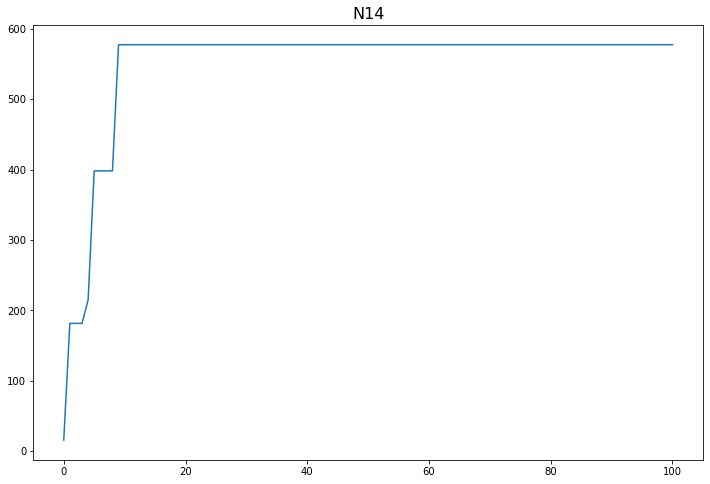

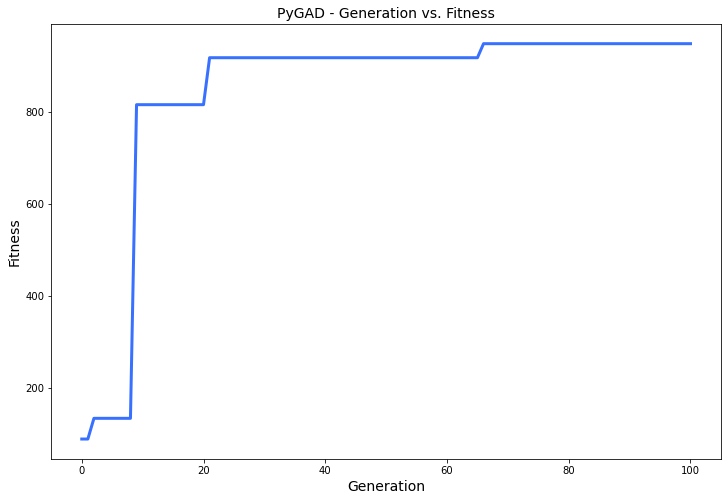

[-0.867]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.867 |===========| 28.518 |==================| 2.072 |==========
[0.376]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 28.816 |==================| 5.43 |==========
[0.12]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.12 |===========| 28.946 |==================| 18.44 |==========
[0.948]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.948 |===========| 28.463 |==================| 1.859 |==========
[-0.862]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.862 |===========| 28.521 |==================| 2.086 |==========
[0.121]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 28.945 |==================| 18.154 |==========
[-0.084]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 27.84 |==================| 524.171 |==========
[0.947]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.947 |===========| 27.359 |==================| 2.071 |==========
[-0.424]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 27.655 |==================| 5.35 |==========
[0.417]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 27.659 |==================| 5.461 |==========
[0.968]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.968 |===========| 27.346 |==================| 2.015 |==========
[-0.967]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.967 |===========| 27.347 |==================| 2.019 |==========
[-0.974]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.715 |===========| 27.499 |==================| 2.917 |==========
[0.298]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 27.716 |==================| 7.947 |==========
Fitness = 524.171219173317
[-0.424]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 27.655 |==================| 5.35 |==========
[0.417]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 27.659 |==================| 5.461 |==========
[0.968]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.968 |===========| 27.346 |==================| 2.015 |==========
[-0.967]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.967 |===========| 27.347 |==================| 2.019 |==========
[-0.974]
=====|SOLUTION|===========|OUTPUT|=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 27.716 |==================| 7.947 |==========
[-0.424]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 27.655 |==================| 5.35 |==========
[0.417]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 27.659 |==================| 5.461 |==========
[0.968]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.968 |===========| 27.346 |==================| 2.015 |==========
[-0.967]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.967 |===========| 27.347 |==================| 2.019 |==========
[-0.974]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.974 |===========| 27.342 |==================| 2.0 |==========
[-0.91]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 27.643 |==================| 5.021 |==========
Generation = 2
[0.936]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.936 |===========| 27.366 |==================| 2.102 |==========
[-0.258]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 27.735 |==================| 9.308 |==========
[0.292]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 27.719 |==================| 8.124 |==========
[0.36]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 27.687 |==================| 6.433 |==========
[0.134]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.134 |===========| 27.788 |==================| 18.628 |==========
[-0.369]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 27.777 |==================| 15.422 |==========
[0.449]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 27.643 |==================| 5.021 |==========
Change = 0.0
[0.936]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.936 |===========| 27.366 |==================| 2.102 |==========
[-0.258]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 27.735 |==================| 9.308 |==========
[0.292]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 27.719 |==================| 8.124 |==========
[0.36]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 27.687 |==================| 6.433 |==========
[0.134]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 27.792 |==================| 20.17 |==========
[0.161]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 27.777 |==================| 15.422 |==========
[0.449]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 27.643 |==================| 5.021 |==========
[-0.788]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.788 |===========| 27.456 |==================| 2.592 |==========
[-0.467]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 27.634 |==================| 4.803 |==========
[-0.217]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 27.753 |==================| 11.226 |==========
[0.978]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 27.687 |==================| 6.452 |==========
[-0.415]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 27.66 |==================| 5.489 |==========
[0.103]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.103 |===========| 27.801 |==================| 24.45 |==========
Fitness = 524.171219173317
[-0.788]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.788 |===========| 27.456 |==================| 2.592 |==========
[-0.467]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 27.634 |==================| 4.803 |==========
[-0.217]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 27.753 |==================| 11.226 |==========
[0.978]
=====|SOLUTION|===========|OUTPUT|===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 27.715 |==================| 7.867 |==========
[0.359]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 27.687 |==================| 6.452 |==========
[-0.415]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 27.66 |==================| 5.489 |==========
[0.103]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.103 |===========| 27.801 |==================| 24.45 |==========
[-0.788]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.788 |===========| 27.456 |==================| 2.592 |==========
[-0.467]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 27.634 |==================| 4.803 |==========
[-0.217]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.952 |===========| 27.356 |==================| 2.058 |==========
[-0.551]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 27.59 |==================| 3.969 |==========
[0.648]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.648 |===========| 27.537 |==================| 3.278 |==========
Generation = 4
[-0.629]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 27.547 |==================| 3.394 |==========
[0.867]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.867 |===========| 27.409 |==================| 2.309 |==========
[-0.097]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 27.804 |==================| 26.093 |==========
[0.58]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.609 |===========| 27.558 |==================| 3.525 |==========
[-0.952]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.952 |===========| 27.356 |==================| 2.058 |==========
[-0.551]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 27.59 |==================| 3.969 |==========
[0.648]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.648 |===========| 27.537 |==================| 3.278 |==========
Change = 0.0
[-0.629]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 27.547 |==================| 3.394 |==========
[0.867]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.867 |===========| 27.409 |==================| 2.309 |==========
[-0.097]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.952 |===========| 27.356 |==================| 2.058 |==========
[-0.551]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 27.59 |==================| 3.969 |==========
[0.648]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.648 |===========| 27.537 |==================| 3.278 |==========
[-0.401]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 27.667 |==================| 5.708 |==========
[0.276]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 27.726 |==================| 8.614 |==========
[-0.611]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.611 |===========| 27.557 |==================| 3.514 |==========
[0.315]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 27.47 |==================| 2.688 |==========
[0.515]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 27.609 |==================| 4.288 |==========
[0.743]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 27.483 |==================| 2.786 |==========
Fitness = 524.171219173317
[-0.401]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 27.667 |==================| 5.708 |==========
[0.276]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 27.726 |==================| 8.614 |==========
[-0.611]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.611 |===========| 27.557 |==================| 3.514 |==========
[0.315]
=====|SOLUTION|===========|OUTPUT|==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 27.809 |==================| 30.561 |==========
[0.765]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 27.47 |==================| 2.688 |==========
[0.515]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 27.609 |==================| 4.288 |==========
[0.743]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 27.483 |==================| 2.786 |==========
[-0.401]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 27.667 |==================| 5.708 |==========
[0.276]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 27.726 |==================| 8.614 |==========
[-0.611]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

======| 0.539 |===========| 27.596 |==================| 4.065 |==========
[-0.199]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 27.761 |==================| 12.273 |==========
[0.82]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.82 |===========| 27.438 |==================| 2.472 |==========
Generation = 6
[-0.672]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.672 |===========| 27.524 |==================| 3.143 |==========
[-0.843]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.843 |===========| 27.424 |==================| 2.39 |==========
[-0.897]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 27.391 |==================| 2.216 |==========
[0.455]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 27.64 |==================| 4.94

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.82 |===========| 27.438 |==================| 2.472 |==========
Change = 0.0
[-0.672]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.672 |===========| 27.524 |==================| 3.143 |==========
[-0.843]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.843 |===========| 27.424 |==================| 2.39 |==========
[-0.897]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 27.391 |==================| 2.216 |==========
[0.455]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 27.64 |==================| 4.946 |==========
[0.428]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 27.654 |==================| 5.305 |==========
[0.325]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 27.761 |==================| 12.273 |==========
[0.82]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.82 |===========| 27.438 |==================| 2.472 |==========
[-0.886]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.886 |===========| 27.397 |==================| 2.247 |==========
[-0.205]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 27.758 |==================| 11.912 |==========
[0.56]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.56 |===========| 27.585 |==================| 3.893 |==========
[0.821]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.821 |===========| 27.437 |==================| 2.467 |==========
[-0.583]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.898 |===========| 27.39 |==================| 2.211 |==========
Fitness = 524.171219173317
[-0.886]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.886 |===========| 27.397 |==================| 2.247 |==========
[-0.205]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 27.758 |==================| 11.912 |==========
[0.56]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.56 |===========| 27.585 |==================| 3.893 |==========
[0.821]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.821 |===========| 27.437 |==================| 2.467 |==========
[-0.583]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.583 |===========| 27.573 |==================| 3.712 |==========
[0.836]
=====|SOLUTION|===========|OUTPUT|==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.898 |===========| 27.39 |==================| 2.211 |==========
[-0.886]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.886 |===========| 27.397 |==================| 2.247 |==========
[-0.205]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 27.758 |==================| 11.912 |==========
[0.56]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.56 |===========| 27.585 |==================| 3.893 |==========
[0.821]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.821 |===========| 27.437 |==================| 2.467 |==========
[-0.583]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.583 |===========| 27.573 |==================| 3.712 |==========
[0.836]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.607 |===========| 27.56 |==================| 3.541 |==========
Generation = 8
[0.109]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 27.799 |==================| 23.168 |==========
[0.382]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 27.676 |==================| 6.033 |==========
[-0.619]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.619 |===========| 27.553 |==================| 3.461 |==========
[-0.873]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 27.405 |==================| 2.29 |==========
[0.356]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.356 |===========| 27.689 |==================| 6.518 |==========
[0.317]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.807 |===========| 27.446 |==================| 2.522 |==========
[-0.607]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.607 |===========| 27.56 |==================| 3.541 |==========
Change = 0.0
[0.109]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 27.799 |==================| 23.168 |==========
[0.382]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 27.676 |==================| 6.033 |==========
[-0.619]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.619 |===========| 27.553 |==================| 3.461 |==========
[-0.873]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 27.405 |==================| 2.29 |==========
[0.356]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.797 |===========| 27.451 |==================| 2.558 |==========
[-0.807]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.807 |===========| 27.446 |==================| 2.522 |==========
[-0.607]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.607 |===========| 27.56 |==================| 3.541 |==========
[-0.325]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 27.704 |==================| 7.221 |==========
[-0.55]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.55 |===========| 27.59 |==================| 3.972 |==========
[-0.926]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.926 |===========| 27.373 |==================| 2.131 |==========
[-0.203]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

[0.992]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.992 |===========| 27.331 |==================| 1.957 |==========
[-0.756]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.756 |===========| 27.475 |==================| 2.726 |==========
Fitness = 524.171219173317
[-0.325]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 27.704 |==================| 7.221 |==========
[-0.55]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.55 |===========| 27.59 |==================| 3.972 |==========
[-0.926]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.926 |===========| 27.373 |==================| 2.131 |==========
[-0.203]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 27.759 |==================| 12.028 |==========
[0.798]
=====|SOLUTION|===========|OUTPUT|====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.992 |===========| 27.331 |==================| 1.957 |==========
[-0.756]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.756 |===========| 27.475 |==================| 2.726 |==========
[-0.325]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 27.704 |==================| 7.221 |==========
[-0.55]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.55 |===========| 27.59 |==================| 3.972 |==========
[-0.926]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.926 |===========| 27.373 |==================| 2.131 |==========
[-0.203]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 27.759 |==================| 12.028 |==========
[0.798]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

[-0.339]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 27.697 |==================| 6.89 |==========
Generation = 10
[0.673]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.673 |===========| 27.523 |==================| 3.137 |==========
[-0.628]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.628 |===========| 27.548 |==================| 3.405 |==========
[0.634]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.634 |===========| 27.545 |==================| 3.362 |==========
[0.71]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.71 |===========| 27.502 |==================| 2.941 |==========
[-0.533]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.533 |===========| 27.599 |==================| 4.121 |==========
[0.043]
=====|SOLUTION|===========|OUTPUT|==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.509 |===========| 27.612 |==================| 4.348 |==========
[-0.339]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 27.697 |==================| 6.89 |==========
Change = 0.0
[0.673]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.673 |===========| 27.523 |==================| 3.137 |==========
[-0.628]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.628 |===========| 27.548 |==================| 3.405 |==========
[0.634]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.634 |===========| 27.545 |==================| 3.362 |==========
[0.71]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.71 |===========| 27.502 |==================| 2.941 |==========
[-0.533]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.509 |===========| 27.612 |==================| 4.348 |==========
[-0.339]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 27.697 |==================| 6.89 |==========
[-0.003]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 27.841 |==================| 992.602 |==========
[-0.899]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.899 |===========| 27.389 |==================| 2.209 |==========
[0.893]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.893 |===========| 27.393 |==================| 2.228 |==========
[0.693]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.693 |===========| 27.511 |==================| 3.025 |==========
[0.32]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.942 |===========| 27.362 |==================| 2.085 |==========
[-0.024]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 27.833 |==================| 108.944 |==========
[0.659]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.659 |===========| 27.531 |==================| 3.215 |==========
Fitness = 2236.161830373311
[-0.003]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 27.841 |==================| 992.602 |==========
[-0.899]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.899 |===========| 27.389 |==================| 2.209 |==========
[0.893]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.893 |===========| 27.393 |==================| 2.228 |==========
[0.693]
=====|SOLUTION|===========|OUTPUT|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 27.833 |==================| 108.944 |==========
[0.659]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.659 |===========| 27.531 |==================| 3.215 |==========
[-0.003]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 27.841 |==================| 992.602 |==========
[-0.899]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.899 |===========| 27.389 |==================| 2.209 |==========
[0.893]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.893 |===========| 27.393 |==================| 2.228 |==========
[0.693]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.693 |===========| 27.511 |==================| 3.025 |==========
[0.32]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.875 |===========| 27.404 |==================| 2.284 |==========
[-0.958]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.958 |===========| 27.352 |==================| 2.041 |==========
[-0.097]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 27.804 |==================| 26.14 |==========
Generation = 12
[-0.17]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 27.773 |==================| 14.532 |==========
[0.405]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 27.665 |==================| 5.647 |==========
[0.536]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 27.598 |==================| 4.091 |==========
[0.339]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

[-0.958]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.958 |===========| 27.352 |==================| 2.041 |==========
[-0.097]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 27.804 |==================| 26.14 |==========
Change = 0.0
[-0.17]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 27.773 |==================| 14.532 |==========
[0.405]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 27.665 |==================| 5.647 |==========
[0.536]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 27.598 |==================| 4.091 |==========
[0.339]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 27.697 |==================| 6.892 |==========
[0.534]
=====|SOLUTION|===========|OUTPUT|==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.958 |===========| 27.352 |==================| 2.041 |==========
[-0.097]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 27.804 |==================| 26.14 |==========
[-0.109]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 27.799 |==================| 23.092 |==========
[-0.951]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.951 |===========| 27.357 |==================| 2.062 |==========
[-0.253]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 27.737 |==================| 9.489 |==========
[-0.459]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 27.638 |==================| 4.899 |==========
[-0.023]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 27.786 |==================| 17.722 |==========
Fitness = 2236.161830373311
[-0.109]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 27.799 |==================| 23.092 |==========
[-0.951]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.951 |===========| 27.357 |==================| 2.062 |==========
[-0.253]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 27.737 |==================| 9.489 |==========
[-0.459]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 27.638 |==================| 4.899 |==========
[-0.023]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 27.833 |==================| 113.632 |==========
[-0.922]
=====|SOLUTION|===========|OUTPUT|====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.626 |===========| 27.549 |==================| 3.412 |==========
[-0.141]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 27.786 |==================| 17.722 |==========
[-0.109]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 27.799 |==================| 23.092 |==========
[-0.951]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.951 |===========| 27.357 |==================| 2.062 |==========
[-0.253]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 27.737 |==================| 9.489 |==========
[-0.459]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 27.638 |==================| 4.899 |==========
[-0.023]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

======| 0.138 |===========| 27.787 |==================| 18.101 |==========
[-0.274]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 27.727 |==================| 8.714 |==========
Generation = 14
[0.972]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.972 |===========| 27.343 |==================| 2.005 |==========
[0.358]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 27.688 |==================| 6.487 |==========
[0.925]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.925 |===========| 27.373 |==================| 2.133 |==========
[0.691]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.691 |===========| 27.513 |==================| 3.039 |==========
[0.436]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 27.649 |==================| 5.

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 27.727 |==================| 8.714 |==========
Change = 0.0
[0.972]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.972 |===========| 27.343 |==================| 2.005 |==========
[0.358]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 27.688 |==================| 6.487 |==========
[0.925]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.925 |===========| 27.373 |==================| 2.133 |==========
[0.691]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.691 |===========| 27.513 |==================| 3.039 |==========
[0.436]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 27.649 |==================| 5.193 |==========
[0.282]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 27.642 |==================| 5.008 |==========
[-0.632]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.632 |===========| 27.546 |==================| 3.375 |==========
[0.066]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 27.816 |==================| 38.789 |==========
[-0.767]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 27.469 |==================| 2.679 |==========
[-0.956]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.956 |===========| 27.354 |==================| 2.048 |==========
[-0.055]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 27.821 |==================| 46.741 |==========
[-0.368]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.632 |===========| 27.546 |==================| 3.375 |==========
[0.066]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 27.816 |==================| 38.789 |==========
[-0.767]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 27.469 |==================| 2.679 |==========
[-0.956]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.956 |===========| 27.354 |==================| 2.048 |==========
[-0.055]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 27.821 |==================| 46.741 |==========
[-0.368]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 27.683 |==================| 6.288 |==========
[0.694]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.632 |===========| 27.546 |==================| 3.375 |==========
[0.066]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 27.816 |==================| 38.789 |==========
[-0.767]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 27.469 |==================| 2.679 |==========
[-0.956]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.956 |===========| 27.354 |==================| 2.048 |==========
[-0.055]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 27.821 |==================| 46.741 |==========
[-0.368]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 27.683 |==================| 6.288 |==========
[0.694]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.771 |===========| 27.466 |==================| 2.662 |==========
[0.489]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 27.622 |==================| 4.553 |==========
[0.253]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 27.737 |==================| 9.496 |==========
[-0.683]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.683 |===========| 27.517 |==================| 3.079 |==========
[-0.974]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.974 |===========| 27.342 |==================| 2.001 |==========
[-0.679]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.679 |===========| 27.52 |==================| 3.103 |==========
[-0.432]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.771 |===========| 27.466 |==================| 2.662 |==========
[0.489]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 27.622 |==================| 4.553 |==========
[0.253]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 27.737 |==================| 9.496 |==========
[-0.683]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.683 |===========| 27.517 |==================| 3.079 |==========
[-0.974]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.974 |===========| 27.342 |==================| 2.001 |==========
[-0.679]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.679 |===========| 27.52 |==================| 3.103 |==========
[-0.432]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.123 |===========| 27.793 |==================| 20.375 |==========
[0.599]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.599 |===========| 27.564 |==================| 3.598 |==========
[-0.245]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 27.74 |==================| 9.833 |==========
[-0.119]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 27.795 |==================| 21.173 |==========
[0.815]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.815 |===========| 27.44 |==================| 2.49 |==========
[0.015]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 27.836 |==================| 171.879 |==========
[-0.145]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.599 |===========| 27.564 |==================| 3.598 |==========
[-0.245]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 27.74 |==================| 9.833 |==========
[-0.119]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 27.795 |==================| 21.173 |==========
[0.815]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.815 |===========| 27.44 |==================| 2.49 |==========
[0.015]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 27.836 |==================| 171.879 |==========
[-0.145]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 27.784 |==================| 17.189 |==========
[-0.488]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.123 |===========| 27.793 |==================| 20.375 |==========
[0.599]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.599 |===========| 27.564 |==================| 3.598 |==========
[-0.245]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 27.74 |==================| 9.833 |==========
[-0.119]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 27.795 |==================| 21.173 |==========
[0.815]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.815 |===========| 27.44 |==================| 2.49 |==========
[0.015]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 27.836 |==================| 171.879 |==========
[-0.145]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 27.73 |==================| 8.9 |==========
[0.382]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 27.676 |==================| 6.025 |==========
[0.497]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 27.618 |==================| 4.469 |==========
[-0.346]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 27.693 |==================| 6.719 |==========
[0.009]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 27.839 |==================| 289.804 |==========
[0.548]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.548 |===========| 27.591 |==================| 3.989 |==========
[-0.349]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 27.468 |==================| 2.676 |==========
Change = 0.0
[0.268]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 27.73 |==================| 8.9 |==========
[0.382]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 27.676 |==================| 6.025 |==========
[0.497]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 27.618 |==================| 4.469 |==========
[-0.346]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 27.693 |==================| 6.719 |==========
[0.009]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 27.839 |==================| 289.804 |==========
[0.548]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 27.468 |==================| 2.676 |==========
[-0.958]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.958 |===========| 27.353 |==================| 2.043 |==========
[-0.094]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 27.805 |==================| 27.013 |==========
[0.897]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 27.391 |==================| 2.216 |==========
[0.671]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.671 |===========| 27.524 |==================| 3.146 |==========
[0.195]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 27.763 |==================| 12.575 |==========
[-0.649]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.958 |===========| 27.353 |==================| 2.043 |==========
[-0.677]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.677 |===========| 27.521 |==================| 3.111 |==========
Fitness = 2236.161830373311
[-0.958]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.958 |===========| 27.353 |==================| 2.043 |==========
[-0.094]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 27.805 |==================| 27.013 |==========
[0.897]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 27.391 |==================| 2.216 |==========
[0.671]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.671 |===========| 27.524 |==================| 3.146 |==========
[0.195]
=====|SOLUTION|===========|OUTPUT|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.677 |===========| 27.521 |==================| 3.111 |==========
[-0.958]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.958 |===========| 27.353 |==================| 2.043 |==========
[-0.094]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 27.805 |==================| 27.013 |==========
[0.897]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 27.391 |==================| 2.216 |==========
[0.671]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.671 |===========| 27.524 |==================| 3.146 |==========
[0.195]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 27.763 |==================| 12.575 |==========
[-0.649]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.949 |===========| 27.358 |==================| 2.065 |==========
[0.247]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 27.739 |==================| 9.738 |==========
[0.24]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 27.743 |==================| 10.051 |==========
[-0.269]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 27.729 |==================| 8.874 |==========
[0.232]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 27.746 |==================| 10.425 |==========
[-0.014]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 27.837 |==================| 185.842 |==========
[0.486]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 27.809 |==================| 30.577 |==========
Change = 0.0
[-0.949]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.949 |===========| 27.358 |==================| 2.065 |==========
[0.247]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 27.739 |==================| 9.738 |==========
[0.24]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 27.743 |==================| 10.051 |==========
[-0.269]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 27.729 |==================| 8.874 |==========
[0.232]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 27.746 |==================| 10.425 |==========
[-0.014]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 27.791 |==================| 19.629 |==========
[0.929]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.929 |===========| 27.371 |==================| 2.122 |==========
[-0.309]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 27.711 |==================| 7.637 |==========
[-0.196]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 27.762 |==================| 12.474 |==========
[0.516]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 27.608 |==================| 4.281 |==========
[0.722]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 27.495 |==================| 2.881 |==========
[0.498]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 27.791 |==================| 19.629 |==========
[0.929]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.929 |===========| 27.371 |==================| 2.122 |==========
[-0.309]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 27.711 |==================| 7.637 |==========
[-0.196]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 27.762 |==================| 12.474 |==========
[0.516]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 27.608 |==================| 4.281 |==========
[0.722]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 27.495 |==================| 2.881 |==========
[0.498]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 27.791 |==================| 19.629 |==========
[0.929]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.929 |===========| 27.371 |==================| 2.122 |==========
[-0.309]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 27.711 |==================| 7.637 |==========
[-0.196]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 27.762 |==================| 12.474 |==========
[0.516]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 27.608 |==================| 4.281 |==========
[0.722]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 27.495 |==================| 2.881 |==========
[0.498]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.98 |===========| 27.338 |==================| 1.985 |==========
[-0.501]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.501 |===========| 27.616 |==================| 4.431 |==========
[-0.291]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 27.719 |==================| 8.156 |==========
[-0.162]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 27.777 |==================| 15.297 |==========
[-0.574]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.574 |===========| 27.578 |==================| 3.785 |==========
[-0.46]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 27.637 |==================| 4.883 |==========
[0.043]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.501 |===========| 27.616 |==================| 4.431 |==========
[-0.291]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 27.719 |==================| 8.156 |==========
[-0.162]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 27.777 |==================| 15.297 |==========
[-0.574]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.574 |===========| 27.578 |==================| 3.785 |==========
[-0.46]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 27.637 |==================| 4.883 |==========
[0.043]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 27.825 |==================| 60.345 |==========
[0.83]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.573 |===========| 27.578 |==================| 3.791 |==========
[-0.9]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.9 |===========| 27.389 |==================| 2.205 |==========
[-0.555]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.555 |===========| 27.588 |==================| 3.934 |==========
[0.032]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 27.83 |==================| 81.012 |==========
[-0.393]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 27.671 |==================| 5.831 |==========
[-0.051]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 27.822 |==================| 50.169 |==========
[-0.111]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

[-0.573]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.573 |===========| 27.578 |==================| 3.791 |==========
[-0.9]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.9 |===========| 27.389 |==================| 2.205 |==========
[-0.555]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.555 |===========| 27.588 |==================| 3.934 |==========
[0.032]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 27.83 |==================| 81.012 |==========
[-0.393]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 27.671 |==================| 5.831 |==========
[-0.051]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 27.822 |==================| 50.169 |==========
[-0.111]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 27.802 |==================| 24.832 |==========
[-0.573]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.573 |===========| 27.578 |==================| 3.791 |==========
[-0.9]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.9 |===========| 27.389 |==================| 2.205 |==========
[-0.555]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.555 |===========| 27.588 |==================| 3.934 |==========
[0.032]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 27.83 |==================| 81.012 |==========
[-0.393]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 27.671 |==================| 5.831 |==========
[-0.051]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 27.716 |==================| 7.909 |==========
[0.201]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 27.76 |==================| 12.143 |==========
[-0.662]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.662 |===========| 27.529 |==================| 3.199 |==========
[0.954]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.954 |===========| 27.355 |==================| 2.054 |==========
[0.617]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.617 |===========| 27.554 |==================| 3.476 |==========
[-0.166]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 27.775 |==================| 14.904 |==========
[0.147]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 27.703 |==================| 7.187 |==========
[0.299]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 27.716 |==================| 7.909 |==========
[0.201]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 27.76 |==================| 12.143 |==========
[-0.662]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.662 |===========| 27.529 |==================| 3.199 |==========
[0.954]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.954 |===========| 27.355 |==================| 2.054 |==========
[0.617]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.617 |===========| 27.554 |==================| 3.476 |==========
[-0.166]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 27.652 |==================| 5.254 |==========
[0.68]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.68 |===========| 27.519 |==================| 3.094 |==========
[-0.085]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 27.809 |==================| 29.855 |==========
[0.216]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 27.753 |==================| 11.27 |==========
[0.891]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.891 |===========| 27.394 |==================| 2.232 |==========
[-0.863]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 27.411 |==================| 2.321 |==========
[-0.091]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 27.652 |==================| 5.254 |==========
[0.68]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.68 |===========| 27.519 |==================| 3.094 |==========
[-0.085]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 27.809 |==================| 29.855 |==========
[0.216]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 27.753 |==================| 11.27 |==========
[0.891]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.891 |===========| 27.394 |==================| 2.232 |==========
[-0.863]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 27.411 |==================| 2.321 |==========
[-0.091]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 27.652 |==================| 5.254 |==========
[0.68]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.68 |===========| 27.519 |==================| 3.094 |==========
[-0.085]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 27.809 |==================| 29.855 |==========
[0.216]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 27.753 |==================| 11.27 |==========
[0.891]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.891 |===========| 27.394 |==================| 2.232 |==========
[-0.863]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 27.411 |==================| 2.321 |==========
[-0.091]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 27.754 |==================| 11.315 |==========
[0.357]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 27.688 |==================| 6.503 |==========
[0.985]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.985 |===========| 27.335 |==================| 1.973 |==========
[-0.817]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.817 |===========| 27.439 |==================| 2.483 |==========
[0.507]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.507 |===========| 27.613 |==================| 4.363 |==========
[0.516]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 27.608 |==================| 4.275 |==========
[0.676]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.801 |===========| 27.449 |==================| 2.543 |==========
Change = 0.0
[0.215]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 27.754 |==================| 11.315 |==========
[0.357]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 27.688 |==================| 6.503 |==========
[0.985]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.985 |===========| 27.335 |==================| 1.973 |==========
[-0.817]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.817 |===========| 27.439 |==================| 2.483 |==========
[0.507]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.507 |===========| 27.613 |==================| 4.363 |==========
[0.516]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 27.69 |==================| 6.561 |==========
[0.801]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.801 |===========| 27.449 |==================| 2.543 |==========
[-0.195]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 27.762 |==================| 12.555 |==========
[0.184]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 27.767 |==================| 13.342 |==========
[0.395]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 27.67 |==================| 5.799 |==========
[-0.823]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.823 |===========| 27.436 |==================| 2.462 |==========
[-0.841]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.785 |===========| 27.459 |==================| 2.607 |==========
[0.124]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 27.793 |==================| 20.238 |==========
Fitness = 2236.161830373311
[-0.195]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 27.762 |==================| 12.555 |==========
[0.184]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 27.767 |==================| 13.342 |==========
[0.395]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 27.67 |==================| 5.799 |==========
[-0.823]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.823 |===========| 27.436 |==================| 2.462 |==========
[-0.841]
=====|SOLUTION|===========|OUTPUT|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 27.681 |==================| 6.201 |==========
[0.785]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.785 |===========| 27.459 |==================| 2.607 |==========
[0.124]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 27.793 |==================| 20.238 |==========
[-0.195]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 27.762 |==================| 12.555 |==========
[0.184]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 27.767 |==================| 13.342 |==========
[0.395]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 27.67 |==================| 5.799 |==========
[-0.823]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.866 |===========| 27.409 |==================| 2.311 |==========
[-0.232]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 27.746 |==================| 10.399 |==========
[-0.724]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.724 |===========| 27.494 |==================| 2.872 |==========
Generation = 28
[0.388]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.388 |===========| 27.673 |==================| 5.92 |==========
[0.18]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 27.769 |==================| 13.642 |==========
[-0.133]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 27.789 |==================| 18.863 |==========
[0.541]
=====|SOLUTION|===========|OUTPUT|==================|FITN

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.735 |===========| 27.488 |==================| 2.821 |==========
[0.866]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.866 |===========| 27.409 |==================| 2.311 |==========
[-0.232]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 27.746 |==================| 10.399 |==========
[-0.724]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.724 |===========| 27.494 |==================| 2.872 |==========
Change = 0.0
[0.388]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.388 |===========| 27.673 |==================| 5.92 |==========
[0.18]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 27.769 |==================| 13.642 |==========
[-0.133]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.735 |===========| 27.488 |==================| 2.821 |==========
[0.866]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.866 |===========| 27.409 |==================| 2.311 |==========
[-0.232]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 27.746 |==================| 10.399 |==========
[-0.724]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.724 |===========| 27.494 |==================| 2.872 |==========
[0.832]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.832 |===========| 27.43 |==================| 2.428 |==========
[-0.035]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 27.829 |==================| 74.479 |==========
[0.99]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.564 |===========| 27.583 |==================| 3.862 |==========
[0.661]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.661 |===========| 27.53 |==================| 3.202 |==========
[-0.566]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.566 |===========| 27.582 |==================| 3.847 |==========
[-0.544]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.544 |===========| 27.593 |==================| 4.021 |==========
[-0.502]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 27.615 |==================| 4.412 |==========
Fitness = 2236.161830373311
[0.832]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.832 |===========| 27.43 |==================| 2.428 |==========
[-0.035]
=====|SOLUTION|===========|OUTPUT|============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.661 |===========| 27.53 |==================| 3.202 |==========
[-0.566]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.566 |===========| 27.582 |==================| 3.847 |==========
[-0.544]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.544 |===========| 27.593 |==================| 4.021 |==========
[-0.502]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 27.615 |==================| 4.412 |==========
[0.832]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.832 |===========| 27.43 |==================| 2.428 |==========
[-0.035]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 27.829 |==================| 74.479 |==========
[0.99]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.68 |===========| 27.519 |==================| 3.098 |==========
[0.617]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.617 |===========| 27.554 |==================| 3.475 |==========
Generation = 30
[-0.334]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 27.699 |==================| 7.005 |==========
[-0.906]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.906 |===========| 27.385 |==================| 2.187 |==========
[-0.151]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 27.781 |==================| 16.461 |==========
[0.262]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.262 |===========| 27.733 |==================| 9.147 |==========
[0.933]
=====|SOLUTION|===========|OUTPUT|==================|FITN

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.617 |===========| 27.554 |==================| 3.475 |==========
Change = 0.0
[-0.334]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 27.699 |==================| 7.005 |==========
[-0.906]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.906 |===========| 27.385 |==================| 2.187 |==========
[-0.151]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 27.781 |==================| 16.461 |==========
[0.262]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.262 |===========| 27.733 |==================| 9.147 |==========
[0.933]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.933 |===========| 27.368 |==================| 2.109 |==========
[0.312]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.68 |===========| 27.519 |==================| 3.098 |==========
[0.617]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.617 |===========| 27.554 |==================| 3.475 |==========
[-0.317]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 27.707 |==================| 7.421 |==========
[0.42]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 27.657 |==================| 5.413 |==========
[-0.386]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 27.674 |==================| 5.946 |==========
[-0.658]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.658 |===========| 27.532 |==================| 3.221 |==========
[-0.754]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 27.468 |==================| 2.675 |==========
Fitness = 2236.161830373311
[-0.317]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 27.707 |==================| 7.421 |==========
[0.42]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 27.657 |==================| 5.413 |==========
[-0.386]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 27.674 |==================| 5.946 |==========
[-0.658]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.658 |===========| 27.532 |==================| 3.221 |==========
[-0.754]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.754 |===========| 27.476 |==================| 2.735 |==========
[0.639]
=====|SOLUTION|===========|OUTPUT|============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 27.762 |==================| 12.569 |==========
[-0.768]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 27.468 |==================| 2.675 |==========
[-0.317]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 27.707 |==================| 7.421 |==========
[0.42]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 27.657 |==================| 5.413 |==========
[-0.386]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 27.674 |==================| 5.946 |==========
[-0.658]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.658 |===========| 27.532 |==================| 3.221 |==========
[-0.754]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.967 |===========| 27.347 |==================| 2.019 |==========
Generation = 32
[0.962]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.962 |===========| 27.35 |==================| 2.032 |==========
[0.96]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.96 |===========| 27.351 |==================| 2.037 |==========
[0.722]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 27.495 |==================| 2.884 |==========
[0.286]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 27.721 |==================| 8.295 |==========
[0.417]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 27.659 |==================| 5.457 |==========
[0.786]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.967 |===========| 27.347 |==================| 2.019 |==========
Change = 0.0
[0.962]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.962 |===========| 27.35 |==================| 2.032 |==========
[0.96]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.96 |===========| 27.351 |==================| 2.037 |==========
[0.722]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 27.495 |==================| 2.884 |==========
[0.286]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 27.721 |==================| 8.295 |==========
[0.417]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 27.659 |==================| 5.457 |==========
[0.786]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 27.806 |==================| 27.867 |==========
[0.199]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 27.761 |==================| 12.311 |==========
[-0.002]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 27.841 |==================| 1634.059 |==========
[-0.056]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 27.82 |==================| 45.87 |==========
[-0.589]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 27.57 |==================| 3.671 |==========
[0.412]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 27.661 |==================| 5.529 |==========
[0.855]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 27.619 |==================| 4.493 |==========
Fitness = 2236.161830373311
[0.091]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 27.806 |==================| 27.867 |==========
[0.199]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 27.761 |==================| 12.311 |==========
[-0.002]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 27.841 |==================| 1634.059 |==========
[-0.056]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 27.82 |==================| 45.87 |==========
[-0.589]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 27.57 |==================| 3.671 |==========
[0.412]
=====|SOLUTION|===========|OUTPUT|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.707 |===========| 27.504 |==================| 2.957 |==========
[-0.495]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 27.619 |==================| 4.493 |==========
[0.091]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 27.806 |==================| 27.867 |==========
[0.199]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 27.761 |==================| 12.311 |==========
[-0.002]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 27.841 |==================| 1634.059 |==========
[-0.056]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 27.82 |==================| 45.87 |==========
[-0.589]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 27.773 |==================| 14.448 |==========
[-0.874]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.874 |===========| 27.405 |==================| 2.287 |==========
Generation = 34
[0.54]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.54 |===========| 27.596 |==================| 4.058 |==========
[-0.359]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 27.687 |==================| 6.447 |==========
[0.485]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 27.625 |==================| 4.598 |==========
[0.867]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.867 |===========| 27.409 |==================| 2.309 |==========
[-0.003]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 27.793 |==================| 20.203 |==========
[-0.171]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 27.773 |==================| 14.448 |==========
[-0.874]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.874 |===========| 27.405 |==================| 2.287 |==========
Change = 0.0
[0.54]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.54 |===========| 27.596 |==================| 4.058 |==========
[-0.359]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 27.687 |==================| 6.447 |==========
[0.485]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 27.625 |==================| 4.598 |==========
[0.867]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS

[-0.124]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 27.793 |==================| 20.203 |==========
[-0.171]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 27.773 |==================| 14.448 |==========
[-0.874]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.874 |===========| 27.405 |==================| 2.287 |==========
[-0.822]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.822 |===========| 27.437 |==================| 2.466 |==========
[-0.629]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 27.548 |==================| 3.397 |==========
[0.013]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 27.837 |==================| 201.37 |==========
[0.525]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 27.714 |==================| 7.835 |==========
[-0.073]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 27.814 |==================| 35.172 |==========
[0.672]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.672 |===========| 27.523 |==================| 3.138 |==========
[-0.198]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.198 |===========| 27.761 |==================| 12.337 |==========
Fitness = 2236.161830373311
[-0.822]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.822 |===========| 27.437 |==================| 2.466 |==========
[-0.629]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 27.548 |==================| 3.397 |==========
[0.013]
=====|SOLUTION|===========|OUTPUT|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 27.46 |==================| 2.618 |==========
[-0.301]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 27.714 |==================| 7.835 |==========
[-0.073]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 27.814 |==================| 35.172 |==========
[0.672]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.672 |===========| 27.523 |==================| 3.138 |==========
[-0.198]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.198 |===========| 27.761 |==================| 12.337 |==========
[-0.822]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.822 |===========| 27.437 |==================| 2.466 |==========
[-0.629]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 27.706 |==================| 7.34 |==========
[-0.288]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 27.721 |==================| 8.232 |==========
[-0.577]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.577 |===========| 27.576 |==================| 3.757 |==========
[-0.186]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 27.766 |==================| 13.183 |==========
[0.261]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 27.733 |==================| 9.16 |==========
Generation = 36
[0.202]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 27.759 |==================| 12.1 |==========
[0.435]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 27.548 |==================| 3.396 |==========
[0.32]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 27.706 |==================| 7.34 |==========
[-0.288]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 27.721 |==================| 8.232 |==========
[-0.577]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.577 |===========| 27.576 |==================| 3.757 |==========
[-0.186]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 27.766 |==================| 13.183 |==========
[0.261]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 27.733 |==================| 9.16 |==========
Change = 0.0
[0.202]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 27.833 |==================| 107.942 |==========
[0.629]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 27.548 |==================| 3.396 |==========
[0.32]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 27.706 |==================| 7.34 |==========
[-0.288]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 27.721 |==================| 8.232 |==========
[-0.577]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.577 |===========| 27.576 |==================| 3.757 |==========
[-0.186]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 27.766 |==================| 13.183 |==========
[0.261]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.712 |===========| 27.501 |==================| 2.931 |==========
[0.731]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.731 |===========| 27.49 |==================| 2.839 |==========
[-0.369]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 27.682 |==================| 6.261 |==========
[-0.281]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 27.724 |==================| 8.471 |==========
[-0.15]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 27.782 |==================| 16.594 |==========
[0.023]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 27.833 |==================| 114.059 |==========
[-0.592]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.731 |===========| 27.49 |==================| 2.839 |==========
[-0.369]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 27.682 |==================| 6.261 |==========
[-0.281]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 27.724 |==================| 8.471 |==========
[-0.15]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 27.782 |==================| 16.594 |==========
[0.023]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 27.833 |==================| 114.059 |==========
[-0.592]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.592 |===========| 27.568 |==================| 3.647 |==========
[0.484]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.622 |===========| 27.551 |==================| 3.439 |==========
[0.219]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 27.752 |==================| 11.069 |==========
[-0.026]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.026 |===========| 27.832 |==================| 102.061 |==========
[-0.249]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 27.739 |==================| 9.66 |==========
[-0.328]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 27.702 |==================| 7.132 |==========
[-0.716]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.716 |===========| 27.499 |==================| 2.912 |==========
Generation = 38
[0.46]
=====|SOLUTION|===========|OUTPUT|==================|FI

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.507 |===========| 27.613 |==================| 4.365 |==========
[-0.622]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.622 |===========| 27.551 |==================| 3.439 |==========
[0.219]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 27.752 |==================| 11.069 |==========
[-0.026]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.026 |===========| 27.832 |==================| 102.061 |==========
[-0.249]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 27.739 |==================| 9.66 |==========
[-0.328]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 27.702 |==================| 7.132 |==========
[-0.716]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.507 |===========| 27.613 |==================| 4.365 |==========
[-0.622]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.622 |===========| 27.551 |==================| 3.439 |==========
[0.219]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 27.752 |==================| 11.069 |==========
[-0.026]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.026 |===========| 27.832 |==================| 102.061 |==========
[-0.249]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 27.739 |==================| 9.66 |==========
[-0.328]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 27.702 |==================| 7.132 |==========
[-0.716]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.655 |===========| 27.533 |==================| 3.237 |==========
[-0.152]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 27.781 |==================| 16.397 |==========
[-0.569]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.569 |===========| 27.58 |==================| 3.819 |==========
[-0.273]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 27.727 |==================| 8.718 |==========
[-0.521]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.521 |===========| 27.606 |==================| 4.23 |==========
[-0.407]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 27.664 |==================| 5.611 |==========
[0.748]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


[-0.463]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 27.636 |==================| 4.843 |==========
[-0.655]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.655 |===========| 27.533 |==================| 3.237 |==========
[-0.152]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 27.781 |==================| 16.397 |==========
[-0.569]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.569 |===========| 27.58 |==================| 3.819 |==========
[-0.273]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 27.727 |==================| 8.718 |==========
[-0.521]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.521 |===========| 27.606 |==================| 4.23 |==========
[-0.407]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 27.666 |==================| 5.694 |==========
[-0.924]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.924 |===========| 27.374 |==================| 2.136 |==========
[-0.665]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.665 |===========| 27.527 |==================| 3.177 |==========
[-0.628]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.628 |===========| 27.548 |==================| 3.404 |==========
[0.97]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.97 |===========| 27.345 |==================| 2.011 |==========
[0.021]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 27.834 |==================| 125.889 |==========
[-0.086]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.924 |===========| 27.374 |==================| 2.136 |==========
[-0.665]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.665 |===========| 27.527 |==================| 3.177 |==========
[-0.628]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.628 |===========| 27.548 |==================| 3.404 |==========
[0.97]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.97 |===========| 27.345 |==================| 2.011 |==========
[0.021]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 27.834 |==================| 125.889 |==========
[-0.086]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.086 |===========| 27.808 |==================| 29.468 |==========
[-0.82]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.665 |===========| 27.527 |==================| 3.177 |==========
[-0.628]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.628 |===========| 27.548 |==================| 3.404 |==========
[0.97]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.97 |===========| 27.345 |==================| 2.011 |==========
[0.021]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 27.834 |==================| 125.889 |==========
[-0.086]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.086 |===========| 27.808 |==================| 29.468 |==========
[-0.82]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.82 |===========| 27.437 |==================| 2.471 |==========
[0.138]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 27.796 |==================| 21.714 |==========
[-0.344]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 27.694 |==================| 6.772 |==========
[-0.928]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.928 |===========| 27.371 |==================| 2.125 |==========
[-0.737]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 27.487 |==================| 2.814 |==========
[-0.976]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.976 |===========| 27.341 |==================| 1.994 |==========
Fitness = 2236.161830373311
[0.894]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.894 |===========| 27.392 |==================| 2.224 |==========
[0.49]
=====|SOLUTION|===========|OUTPUT|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 27.796 |==================| 21.714 |==========
[-0.344]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 27.694 |==================| 6.772 |==========
[-0.928]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.928 |===========| 27.371 |==================| 2.125 |==========
[-0.737]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 27.487 |==================| 2.814 |==========
[-0.976]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.976 |===========| 27.341 |==================| 1.994 |==========
[0.894]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.894 |===========| 27.392 |==================| 2.224 |==========
[0.49]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 27.827 |==================| 64.464 |==========
[-0.028]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 27.831 |==================| 91.852 |==========
[0.973]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 27.343 |==================| 2.003 |==========
[0.22]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 27.751 |==================| 11.039 |==========
Generation = 42
[-0.459]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 27.638 |==================| 4.894 |==========
[-0.301]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 27.715 |==================| 7.858 |==========
[-0.408]
=====|SOLUTION|===========|OUTPUT|==================|FIT

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 27.831 |==================| 91.852 |==========
[0.973]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 27.343 |==================| 2.003 |==========
[0.22]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 27.751 |==================| 11.039 |==========
Change = 0.0
[-0.459]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 27.638 |==================| 4.894 |==========
[-0.301]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 27.715 |==================| 7.858 |==========
[-0.408]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 27.663 |==================| 5.591 |==========
[0.253]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 27.827 |==================| 64.464 |==========
[-0.028]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 27.831 |==================| 91.852 |==========
[0.973]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 27.343 |==================| 2.003 |==========
[0.22]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 27.751 |==================| 11.039 |==========
[-0.309]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 27.711 |==================| 7.628 |==========
[0.131]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 27.79 |==================| 19.168 |==========
[0.171]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 27.816 |==================| 39.091 |==========
[-0.757]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.757 |===========| 27.475 |==================| 2.724 |==========
[0.309]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 27.711 |==================| 7.63 |==========
[0.693]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.693 |===========| 27.512 |==================| 3.026 |==========
Fitness = 2236.161830373311
[-0.309]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 27.711 |==================| 7.628 |==========
[0.131]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 27.79 |==================| 19.168 |==========
[0.171]
=====|SOLUTION|===========|OUTPUT|============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 27.625 |==================| 4.614 |==========
[0.066]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 27.816 |==================| 39.091 |==========
[-0.757]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.757 |===========| 27.475 |==================| 2.724 |==========
[0.309]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 27.711 |==================| 7.63 |==========
[0.693]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.693 |===========| 27.512 |==================| 3.026 |==========
[-0.309]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 27.711 |==================| 7.628 |==========
[0.131]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 27.82 |==================| 44.457 |==========
[-0.71]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.71 |===========| 27.502 |==================| 2.94 |==========
[-0.166]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 27.775 |==================| 14.881 |==========
[0.91]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.91 |===========| 27.383 |==================| 2.177 |==========
Generation = 44
[-0.416]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 27.659 |==================| 5.466 |==========
[0.162]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 27.777 |==================| 15.291 |==========
[-0.235]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 27.633 |==================| 4.773 |==========
[0.058]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 27.82 |==================| 44.457 |==========
[-0.71]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.71 |===========| 27.502 |==================| 2.94 |==========
[-0.166]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 27.775 |==================| 14.881 |==========
[0.91]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.91 |===========| 27.383 |==================| 2.177 |==========
Change = 0.0
[-0.416]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 27.659 |==================| 5.466 |==========
[0.162]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 27.719 |==================| 8.156 |==========
[-0.469]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 27.633 |==================| 4.773 |==========
[0.058]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 27.82 |==================| 44.457 |==========
[-0.71]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.71 |===========| 27.502 |==================| 2.94 |==========
[-0.166]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 27.775 |==================| 14.881 |==========
[0.91]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.91 |===========| 27.383 |==================| 2.177 |==========
[0.184]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 27.681 |==================| 6.205 |==========
[-0.073]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 27.814 |==================| 35.062 |==========
[-0.693]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.693 |===========| 27.512 |==================| 3.027 |==========
[0.491]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 27.621 |==================| 4.527 |==========
[0.208]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 27.757 |==================| 11.723 |==========
[-0.041]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 27.826 |==================| 62.615 |==========
Fitness = 2236.161830373311
[0.184]
=====|SOLUTION|===========|OUTPUT|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 27.814 |==================| 35.062 |==========
[-0.693]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.693 |===========| 27.512 |==================| 3.027 |==========
[0.491]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 27.621 |==================| 4.527 |==========
[0.208]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 27.757 |==================| 11.723 |==========
[-0.041]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 27.826 |==================| 62.615 |==========
[0.184]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 27.767 |==================| 13.383 |==========
[-0.249]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.829 |===========| 27.432 |==================| 2.438 |==========
[-0.292]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 27.719 |==================| 8.1 |==========
[-0.776]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.776 |===========| 27.464 |==================| 2.642 |==========
[0.535]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.535 |===========| 27.599 |==================| 4.107 |==========
Generation = 46
[-0.64]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.64 |===========| 27.541 |==================| 3.324 |==========
[-0.023]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 27.833 |==================| 114.509 |==========
[0.607]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.829 |===========| 27.432 |==================| 2.438 |==========
[-0.292]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 27.719 |==================| 8.1 |==========
[-0.776]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.776 |===========| 27.464 |==================| 2.642 |==========
[0.535]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.535 |===========| 27.599 |==================| 4.107 |==========
Change = 0.0
[-0.64]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.64 |===========| 27.541 |==================| 3.324 |==========
[-0.023]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 27.833 |==================| 114.509 |==========
[0.607]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.829 |===========| 27.432 |==================| 2.438 |==========
[-0.292]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 27.719 |==================| 8.1 |==========
[-0.776]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.776 |===========| 27.464 |==================| 2.642 |==========
[0.535]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.535 |===========| 27.599 |==================| 4.107 |==========
[-0.068]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 27.815 |==================| 37.513 |==========
[-0.899]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.899 |===========| 27.389 |==================| 2.209 |==========
[-0.87]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.694 |===========| 27.511 |==================| 3.02 |==========
[0.518]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.518 |===========| 27.607 |==================| 4.256 |==========
[0.316]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 27.708 |==================| 7.45 |==========
Fitness = 2236.161830373311
[-0.068]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 27.815 |==================| 37.513 |==========
[-0.899]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.899 |===========| 27.389 |==================| 2.209 |==========
[-0.87]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.87 |===========| 27.407 |==================| 2.299 |==========
[0.695]
=====|SOLUTION|===========|OUTPUT|==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 27.748 |==================| 10.658 |==========
[-0.694]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.694 |===========| 27.511 |==================| 3.02 |==========
[0.518]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.518 |===========| 27.607 |==================| 4.256 |==========
[0.316]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 27.708 |==================| 7.45 |==========
[-0.068]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 27.815 |==================| 37.513 |==========
[-0.899]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.899 |===========| 27.389 |==================| 2.209 |==========
[-0.87]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 27.668 |==================| 5.76 |==========
[-0.138]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 27.787 |==================| 18.058 |==========
[0.668]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 27.526 |==================| 3.164 |==========
[0.338]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 27.697 |==================| 6.911 |==========
Generation = 48
[-0.454]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 27.64 |==================| 4.95 |==========
[-0.676]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.676 |===========| 27.521 |==================| 3.118 |==========
[-0.554]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 27.787 |==================| 18.058 |==========
[0.668]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 27.526 |==================| 3.164 |==========
[0.338]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 27.697 |==================| 6.911 |==========
Change = 0.0
[-0.454]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 27.64 |==================| 4.95 |==========
[-0.676]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.676 |===========| 27.521 |==================| 3.118 |==========
[-0.554]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.554 |===========| 27.588 |==================| 3.942 |==========
[0.447]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 27.668 |==================| 5.76 |==========
[-0.138]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 27.787 |==================| 18.058 |==========
[0.668]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 27.526 |==================| 3.164 |==========
[0.338]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 27.697 |==================| 6.911 |==========
[0.97]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.97 |===========| 27.345 |==================| 2.012 |==========
[-0.182]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 27.768 |==================| 13.538 |==========
[0.545]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 27.748 |==================| 10.656 |==========
[0.478]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 27.628 |==================| 4.669 |==========
[-0.841]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 27.425 |==================| 2.396 |==========
Fitness = 2236.161830373311
[0.97]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.97 |===========| 27.345 |==================| 2.012 |==========
[-0.182]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 27.768 |==================| 13.538 |==========
[0.545]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.545 |===========| 27.593 |==================| 4.017 |==========
[0.955]
=====|SOLUTION|===========|OUTPUT|============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 27.628 |==================| 4.669 |==========
[-0.841]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 27.425 |==================| 2.396 |==========
[0.97]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.97 |===========| 27.345 |==================| 2.012 |==========
[-0.182]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 27.768 |==================| 13.538 |==========
[0.545]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.545 |===========| 27.593 |==================| 4.017 |==========
[0.955]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.955 |===========| 27.354 |==================| 2.051 |==========
[0.371]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 27.731 |==================| 8.97 |==========
[0.59]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.59 |===========| 27.569 |==================| 3.659 |==========
Generation = 50
[0.845]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.845 |===========| 27.422 |==================| 2.383 |==========
[-0.531]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.531 |===========| 27.601 |==================| 4.142 |==========
[0.823]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.823 |===========| 27.436 |==================| 2.462 |==========
[0.856]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.856 |===========| 27.416 |==================| 2.346 |==========
[0.58]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.59 |===========| 27.569 |==================| 3.659 |==========
Change = 0.0
[0.845]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.845 |===========| 27.422 |==================| 2.383 |==========
[-0.531]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.531 |===========| 27.601 |==================| 4.142 |==========
[0.823]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.823 |===========| 27.436 |==================| 2.462 |==========
[0.856]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.856 |===========| 27.416 |==================| 2.346 |==========
[0.58]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.58 |===========| 27.574 |==================| 3.734 |==========
[-0.2]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.59 |===========| 27.569 |==================| 3.659 |==========
[-0.594]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.594 |===========| 27.567 |==================| 3.634 |==========
[0.602]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.602 |===========| 27.562 |==================| 3.573 |==========
[-0.133]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 27.789 |==================| 18.785 |==========
[-0.357]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 27.688 |==================| 6.49 |==========
[-0.099]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 27.803 |==================| 25.716 |==========
[0.504]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.594 |===========| 27.567 |==================| 3.634 |==========
[0.602]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.602 |===========| 27.562 |==================| 3.573 |==========
[-0.133]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 27.789 |==================| 18.785 |==========
[-0.357]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 27.688 |==================| 6.49 |==========
[-0.099]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 27.803 |==================| 25.716 |==========
[0.504]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 27.614 |==================| 4.393 |==========
[-0.806]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |===========| 27.646 |==================| 5.107 |==========
[-0.594]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.594 |===========| 27.567 |==================| 3.634 |==========
[0.602]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.602 |===========| 27.562 |==================| 3.573 |==========
[-0.133]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 27.789 |==================| 18.785 |==========
[-0.357]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 27.688 |==================| 6.49 |==========
[-0.099]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 27.803 |==================| 25.716 |==========
[0.504]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.025 |===========| 27.833 |==================| 106.135 |==========
[0.357]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 27.688 |==================| 6.491 |==========
[-0.66]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.66 |===========| 27.531 |==================| 3.211 |==========
[-0.309]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 27.711 |==================| 7.636 |==========
[-0.16]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |===========| 27.778 |==================| 15.515 |==========
[0.416]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 27.659 |==================| 5.47 |==========
[0.305]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 27.806 |==================| 27.684 |==========
Change = 0.0
[0.025]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.025 |===========| 27.833 |==================| 106.135 |==========
[0.357]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 27.688 |==================| 6.491 |==========
[-0.66]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.66 |===========| 27.531 |==================| 3.211 |==========
[-0.309]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 27.711 |==================| 7.636 |==========
[-0.16]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |===========| 27.778 |==================| 15.515 |==========
[0.416]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 27.806 |==================| 27.684 |==========
[-0.257]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 27.735 |==================| 9.337 |==========
[-0.905]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 27.385 |==================| 2.19 |==========
[-0.168]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.168 |===========| 27.774 |==================| 14.689 |==========
[0.897]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 27.39 |==================| 2.214 |==========
[-0.275]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 27.727 |==================| 8.66 |==========
[-0.515]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 27.667 |==================| 5.72 |==========
[-0.373]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 27.681 |==================| 6.196 |==========
Fitness = 2236.161830373311
[-0.257]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 27.735 |==================| 9.337 |==========
[-0.905]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 27.385 |==================| 2.19 |==========
[-0.168]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.168 |===========| 27.774 |==================| 14.689 |==========
[0.897]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 27.39 |==================| 2.214 |==========
[-0.275]
=====|SOLUTION|===========|OUTPUT|=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 27.655 |==================| 5.349 |==========
[-0.4]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 27.667 |==================| 5.72 |==========
[-0.373]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 27.681 |==================| 6.196 |==========
[-0.257]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 27.735 |==================| 9.337 |==========
[-0.905]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 27.385 |==================| 2.19 |==========
[-0.168]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.168 |===========| 27.774 |==================| 14.689 |==========
[0.897]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 27.767 |==================| 13.38 |==========
Generation = 54
[0.024]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 27.833 |==================| 109.113 |==========
[-0.206]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 27.758 |==================| 11.869 |==========
[0.622]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.622 |===========| 27.551 |==================| 3.438 |==========
[-0.824]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.824 |===========| 27.435 |==================| 2.457 |==========
[-0.155]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 27.779 |==================| 15.99 |==========
[0.651]
=====|SOLUTION|===========|OUTPUT|==================|F

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 27.767 |==================| 13.38 |==========
Change = 0.0
[0.024]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 27.833 |==================| 109.113 |==========
[-0.206]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 27.758 |==================| 11.869 |==========
[0.622]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.622 |===========| 27.551 |==================| 3.438 |==========
[-0.824]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.824 |===========| 27.435 |==================| 2.457 |==========
[-0.155]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 27.779 |==================| 15.99 |==========
[0.651]
=====|SOLUTION|===========|OUTPUT|==================|FITN

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.78 |===========| 27.461 |==================| 2.624 |==========
[0.184]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 27.767 |==================| 13.38 |==========
[0.182]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 27.768 |==================| 13.494 |==========
[0.226]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 27.749 |==================| 10.698 |==========
[-0.101]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.101 |===========| 27.802 |==================| 25.085 |==========
[-0.881]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.881 |===========| 27.401 |==================| 2.265 |==========
[-0.306]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 27.478 |==================| 2.746 |==========
[-0.815]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.815 |===========| 27.441 |==================| 2.492 |==========
Fitness = 2236.161830373311
[0.182]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 27.768 |==================| 13.494 |==========
[0.226]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 27.749 |==================| 10.698 |==========
[-0.101]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.101 |===========| 27.802 |==================| 25.085 |==========
[-0.881]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.881 |===========| 27.401 |==================| 2.265 |==========
[-0.306]
=====|SOLUTION|===========|OUTPUT|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.315 |===========| 27.708 |==================| 7.474 |==========
[-0.752]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 27.478 |==================| 2.746 |==========
[-0.815]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.815 |===========| 27.441 |==================| 2.492 |==========
[0.182]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 27.768 |==================| 13.494 |==========
[0.226]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 27.749 |==================| 10.698 |==========
[-0.101]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.101 |===========| 27.802 |==================| 25.085 |==========
[-0.881]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 27.821 |==================| 47.371 |==========
[-0.569]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.569 |===========| 27.58 |==================| 3.817 |==========
Generation = 56
[0.584]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.584 |===========| 27.572 |==================| 3.707 |==========
[0.395]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 27.67 |==================| 5.809 |==========
[-0.765]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 27.47 |==================| 2.691 |==========
[-0.655]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.655 |===========| 27.533 |==================| 3.235 |==========
[-0.403]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 27.821 |==================| 47.371 |==========
[-0.569]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.569 |===========| 27.58 |==================| 3.817 |==========
Change = 0.0
[0.584]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.584 |===========| 27.572 |==================| 3.707 |==========
[0.395]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 27.67 |==================| 5.809 |==========
[-0.765]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 27.47 |==================| 2.691 |==========
[-0.655]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.655 |===========| 27.533 |==================| 3.235 |==========
[-0.403]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.606 |===========| 27.56 |==================| 3.548 |==========
[-0.054]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 27.821 |==================| 47.371 |==========
[-0.569]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.569 |===========| 27.58 |==================| 3.817 |==========
[0.791]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.791 |===========| 27.455 |==================| 2.581 |==========
[-0.153]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 27.78 |==================| 16.245 |==========
[0.644]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 27.539 |==================| 3.302 |==========
[0.533]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.701 |===========| 27.507 |==================| 2.988 |==========
[0.284]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.284 |===========| 27.723 |==================| 8.369 |==========
[0.74]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.74 |===========| 27.485 |==================| 2.8 |==========
Fitness = 2236.161830373311
[0.791]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.791 |===========| 27.455 |==================| 2.581 |==========
[-0.153]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 27.78 |==================| 16.245 |==========
[0.644]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 27.539 |==================| 3.302 |==========
[0.533]
=====|SOLUTION|===========|OUTPUT|=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.543 |===========| 27.594 |==================| 4.034 |==========
[-0.701]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.701 |===========| 27.507 |==================| 2.988 |==========
[0.284]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.284 |===========| 27.723 |==================| 8.369 |==========
[0.74]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.74 |===========| 27.485 |==================| 2.8 |==========
[0.791]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.791 |===========| 27.455 |==================| 2.581 |==========
[-0.153]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 27.78 |==================| 16.245 |==========
[0.644]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 27.787 |==================| 18.093 |==========
[-0.7]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.7 |===========| 27.508 |==================| 2.99 |==========
[0.958]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.958 |===========| 27.353 |==================| 2.043 |==========
Generation = 58
[0.447]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 27.644 |==================| 5.046 |==========
[-0.054]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 27.821 |==================| 47.522 |==========
[0.64]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.64 |===========| 27.542 |==================| 3.328 |==========
[0.409]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 27.787 |==================| 18.093 |==========
[-0.7]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.7 |===========| 27.508 |==================| 2.99 |==========
[0.958]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.958 |===========| 27.353 |==================| 2.043 |==========
Change = 0.0
[0.447]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 27.644 |==================| 5.046 |==========
[-0.054]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 27.821 |==================| 47.522 |==========
[0.64]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.64 |===========| 27.542 |==================| 3.328 |==========
[0.409]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 27.787 |==================| 18.093 |==========
[-0.7]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.7 |===========| 27.508 |==================| 2.99 |==========
[0.958]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.958 |===========| 27.353 |==================| 2.043 |==========
[-0.718]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.718 |===========| 27.497 |==================| 2.902 |==========
[-0.157]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 27.779 |==================| 15.817 |==========
[-0.268]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 27.73 |==================| 8.929 |==========
[-0.792]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.721 |===========| 27.496 |==================| 2.889 |==========
[0.259]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 27.734 |==================| 9.247 |==========
Fitness = 2236.161830373311
[-0.718]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.718 |===========| 27.497 |==================| 2.902 |==========
[-0.157]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 27.779 |==================| 15.817 |==========
[-0.268]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 27.73 |==================| 8.929 |==========
[-0.792]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.792 |===========| 27.454 |==================| 2.578 |==========
[-0.012]
=====|SOLUTION|===========|OUTPUT|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 27.788 |==================| 18.482 |==========
[-0.721]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.721 |===========| 27.496 |==================| 2.889 |==========
[0.259]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 27.734 |==================| 9.247 |==========
[-0.718]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.718 |===========| 27.497 |==================| 2.902 |==========
[-0.157]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 27.779 |==================| 15.817 |==========
[-0.268]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 27.73 |==================| 8.929 |==========
[-0.792]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.654 |===========| 27.534 |==================| 3.242 |==========
[0.248]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 27.739 |==================| 9.682 |==========
[-0.528]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 27.602 |==================| 4.17 |==========
Generation = 60
[-0.28]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 27.725 |==================| 8.509 |==========
[0.231]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 27.747 |==================| 10.49 |==========
[-0.727]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 27.492 |==================| 2.86 |==========
[0.498]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.654 |===========| 27.534 |==================| 3.242 |==========
[0.248]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 27.739 |==================| 9.682 |==========
[-0.528]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 27.602 |==================| 4.17 |==========
Change = 0.0
[-0.28]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 27.725 |==================| 8.509 |==========
[0.231]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 27.747 |==================| 10.49 |==========
[-0.727]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 27.492 |==================| 2.86 |==========
[0.498]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.794 |===========| 27.453 |==================| 2.572 |==========
[0.654]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.654 |===========| 27.534 |==================| 3.242 |==========
[0.248]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 27.739 |==================| 9.682 |==========
[-0.528]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 27.602 |==================| 4.17 |==========
[-0.727]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 27.492 |==================| 2.857 |==========
[-0.323]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |===========| 27.705 |==================| 7.274 |==========
[-0.051]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 27.778 |==================| 15.614 |==========
[-0.06]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 27.819 |==================| 42.6 |==========
[-0.874]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.874 |===========| 27.404 |==================| 2.285 |==========
[0.835]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.835 |===========| 27.428 |==================| 2.416 |==========
[-0.124]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 27.793 |==================| 20.203 |==========
Fitness = 2236.161830373311
[-0.727]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 27.492 |==================| 2.857 |==========
[-0.323]
=====|SOLUTION|===========|OUTPUT|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.493 |===========| 27.62 |==================| 4.509 |==========
[0.159]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 27.778 |==================| 15.614 |==========
[-0.06]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 27.819 |==================| 42.6 |==========
[-0.874]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.874 |===========| 27.404 |==================| 2.285 |==========
[0.835]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.835 |===========| 27.428 |==================| 2.416 |==========
[-0.124]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 27.793 |==================| 20.203 |==========
[-0.727]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.862 |===========| 27.412 |==================| 2.325 |==========
[-0.368]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 27.683 |==================| 6.283 |==========
[1.001]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.001 |===========| 27.325 |==================| 1.934 |==========
[0.286]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 27.721 |==================| 8.289 |==========
[-0.004]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 27.84 |==================| 638.62 |==========
Generation = 62
[-0.936]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.936 |===========| 27.366 |==================| 2.101 |==========
[-0.194]
=====|SOLUTION|===========|OUTPUT|==================|FIT

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 27.645 |==================| 5.071 |==========
[0.862]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.862 |===========| 27.412 |==================| 2.325 |==========
[-0.368]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 27.683 |==================| 6.283 |==========
[1.001]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.001 |===========| 27.325 |==================| 1.934 |==========
[0.286]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 27.721 |==================| 8.289 |==========
[-0.004]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 27.84 |==================| 638.62 |==========
Change = 0.0
[-0.936]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 27.645 |==================| 5.071 |==========
[0.862]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.862 |===========| 27.412 |==================| 2.325 |==========
[-0.368]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 27.683 |==================| 6.283 |==========
[1.001]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.001 |===========| 27.325 |==================| 1.934 |==========
[0.286]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 27.721 |==================| 8.289 |==========
[-0.004]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 27.84 |==================| 638.62 |==========
[0.271]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.699 |===========| 27.508 |==================| 2.997 |==========
[0.076]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 27.812 |==================| 33.673 |==========
[-0.611]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.611 |===========| 27.557 |==================| 3.512 |==========
[-0.256]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 27.735 |==================| 9.385 |==========
[-0.245]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 27.74 |==================| 9.81 |==========
[-0.829]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.829 |===========| 27.432 |==================| 2.44 |==========
[-0.843]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

[-0.17]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 27.773 |==================| 14.567 |==========
[-0.699]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.699 |===========| 27.508 |==================| 2.997 |==========
[0.076]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 27.812 |==================| 33.673 |==========
[-0.611]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.611 |===========| 27.557 |==================| 3.512 |==========
[-0.256]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 27.735 |==================| 9.385 |==========
[-0.245]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 27.74 |==================| 9.81 |==========
[-0.829]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 27.683 |==================| 6.294 |==========
[0.843]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.843 |===========| 27.424 |==================| 2.391 |==========
[-0.213]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 27.755 |==================| 11.433 |==========
[-0.295]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.295 |===========| 27.717 |==================| 8.029 |==========
[0.742]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.742 |===========| 27.483 |==================| 2.788 |==========
[-0.152]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 27.781 |==================| 16.411 |==========
[0.341]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.843 |===========| 27.424 |==================| 2.391 |==========
[-0.213]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 27.755 |==================| 11.433 |==========
[-0.295]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.295 |===========| 27.717 |==================| 8.029 |==========
[0.742]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.742 |===========| 27.483 |==================| 2.788 |==========
[-0.152]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 27.781 |==================| 16.411 |==========
[0.341]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 27.696 |==================| 6.833 |==========
[-0.209]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 27.683 |==================| 6.294 |==========
[0.843]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.843 |===========| 27.424 |==================| 2.391 |==========
[-0.213]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 27.755 |==================| 11.433 |==========
[-0.295]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.295 |===========| 27.717 |==================| 8.029 |==========
[0.742]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.742 |===========| 27.483 |==================| 2.788 |==========
[-0.152]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 27.781 |==================| 16.411 |==========
[0.341]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.641 |===========| 27.541 |==================| 3.324 |==========
[-0.695]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 27.511 |==================| 3.016 |==========
[0.131]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 27.79 |==================| 19.176 |==========
[0.435]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 27.65 |==================| 5.207 |==========
[-0.667]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.667 |===========| 27.526 |==================| 3.166 |==========
[0.998]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.998 |===========| 27.327 |==================| 1.941 |==========
[0.395]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 27.511 |==================| 3.016 |==========
[0.131]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 27.79 |==================| 19.176 |==========
[0.435]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 27.65 |==================| 5.207 |==========
[-0.667]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.667 |===========| 27.526 |==================| 3.166 |==========
[0.998]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.998 |===========| 27.327 |==================| 1.941 |==========
[0.395]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 27.67 |==================| 5.808 |==========
[-0.986]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.916 |===========| 27.379 |==================| 2.159 |==========
[0.727]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 27.492 |==================| 2.86 |==========
[-0.489]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 27.622 |==================| 4.554 |==========
[-0.495]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 27.619 |==================| 4.492 |==========
[-0.297]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 27.716 |==================| 7.964 |==========
[-0.052]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 27.822 |==================| 49.321 |==========
Generation = 66
[0.508]
=====|SOLUTION|===========|OUTPUT|==================|FIT

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 27.783 |==================| 16.863 |==========
[-0.916]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.916 |===========| 27.379 |==================| 2.159 |==========
[0.727]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 27.492 |==================| 2.86 |==========
[-0.489]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 27.622 |==================| 4.554 |==========
[-0.495]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 27.619 |==================| 4.492 |==========
[-0.297]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 27.716 |==================| 7.964 |==========
[-0.052]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.703 |===========| 27.506 |==================| 2.974 |==========
[0.148]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 27.783 |==================| 16.863 |==========
[-0.916]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.916 |===========| 27.379 |==================| 2.159 |==========
[0.727]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 27.492 |==================| 2.86 |==========
[-0.489]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 27.622 |==================| 4.554 |==========
[-0.495]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 27.619 |==================| 4.492 |==========
[-0.297]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.596 |===========| 27.566 |==================| 3.618 |==========
[-0.624]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.624 |===========| 27.55 |==================| 3.43 |==========
[-0.123]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.123 |===========| 27.793 |==================| 20.495 |==========
[-0.776]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.776 |===========| 27.464 |==================| 2.644 |==========
[0.359]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 27.687 |==================| 6.449 |==========
[-0.9]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.9 |===========| 27.389 |==================| 2.206 |==========
[0.769]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 27.47 |==================| 2.687 |==========
[-0.596]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.596 |===========| 27.566 |==================| 3.618 |==========
[-0.624]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.624 |===========| 27.55 |==================| 3.43 |==========
[-0.123]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.123 |===========| 27.793 |==================| 20.495 |==========
[-0.776]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.776 |===========| 27.464 |==================| 2.644 |==========
[0.359]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 27.687 |==================| 6.449 |==========
[-0.9]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 27.747 |==================| 10.474 |==========
[0.067]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.067 |===========| 27.816 |==================| 38.066 |==========
[-0.739]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.739 |===========| 27.485 |==================| 2.804 |==========
[-0.002]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 27.841 |==================| 1158.02 |==========
[-0.67]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 27.525 |==================| 3.154 |==========
[-0.797]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.797 |===========| 27.451 |==================| 2.559 |==========
[0.837]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

[0.368]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 27.683 |==================| 6.278 |==========
[-0.231]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 27.747 |==================| 10.474 |==========
[0.067]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.067 |===========| 27.816 |==================| 38.066 |==========
[-0.739]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.739 |===========| 27.485 |==================| 2.804 |==========
[-0.002]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 27.841 |==================| 1158.02 |==========
[-0.67]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 27.525 |==================| 3.154 |==========
[-0.797]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 27.683 |==================| 6.278 |==========
[-0.231]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 27.747 |==================| 10.474 |==========
[0.067]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.067 |===========| 27.816 |==================| 38.066 |==========
[-0.739]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.739 |===========| 27.485 |==================| 2.804 |==========
[-0.002]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 27.841 |==================| 1158.02 |==========
[-0.67]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 27.525 |==================| 3.154 |==========
[-0.797]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.935 |===========| 27.367 |==================| 2.104 |==========
[0.301]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 27.715 |==================| 7.853 |==========
[0.371]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 27.681 |==================| 6.226 |==========
[-0.334]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 27.699 |==================| 7.007 |==========
[0.58]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.58 |===========| 27.575 |==================| 3.739 |==========
[-0.459]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 27.638 |==================| 4.9 |==========
[0.743]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 27.715 |==================| 7.853 |==========
[0.371]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 27.681 |==================| 6.226 |==========
[-0.334]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 27.699 |==================| 7.007 |==========
[0.58]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.58 |===========| 27.575 |==================| 3.739 |==========
[-0.459]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 27.638 |==================| 4.9 |==========
[0.743]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 27.483 |==================| 2.785 |==========
[-0.973]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.397 |===========| 27.669 |==================| 5.768 |==========
[-0.626]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.626 |===========| 27.549 |==================| 3.417 |==========
[0.138]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 27.787 |==================| 18.037 |==========
[0.892]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.892 |===========| 27.394 |==================| 2.23 |==========
[0.297]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 27.716 |==================| 7.963 |==========
Generation = 70
[-0.165]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 27.776 |==================| 15.04 |==========
[0.234]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 27.685 |==================| 6.374 |==========
[0.397]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.397 |===========| 27.669 |==================| 5.768 |==========
[-0.626]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.626 |===========| 27.549 |==================| 3.417 |==========
[0.138]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 27.787 |==================| 18.037 |==========
[0.892]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.892 |===========| 27.394 |==================| 2.23 |==========
[0.297]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 27.716 |==================| 7.963 |==========
Change = 0.0
[-0.165]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 27.685 |==================| 6.374 |==========
[0.397]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.397 |===========| 27.669 |==================| 5.768 |==========
[-0.626]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.626 |===========| 27.549 |==================| 3.417 |==========
[0.138]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 27.787 |==================| 18.037 |==========
[0.892]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.892 |===========| 27.394 |==================| 2.23 |==========
[0.297]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 27.716 |==================| 7.963 |==========
[-0.54]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 27.645 |==================| 5.079 |==========
[-0.802]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.802 |===========| 27.448 |==================| 2.538 |==========
[0.099]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 27.803 |==================| 25.633 |==========
[0.149]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 27.782 |==================| 16.673 |==========
[0.914]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.914 |===========| 27.38 |==================| 2.166 |==========
[0.44]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 27.648 |==================| 5.141 |==========
[-0.492]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 27.645 |==================| 5.079 |==========
[-0.802]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.802 |===========| 27.448 |==================| 2.538 |==========
[0.099]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 27.803 |==================| 25.633 |==========
[0.149]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 27.782 |==================| 16.673 |==========
[0.914]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.914 |===========| 27.38 |==================| 2.166 |==========
[0.44]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 27.648 |==================| 5.141 |==========
[-0.492]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.818 |===========| 27.439 |==================| 2.481 |==========
[-0.545]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.545 |===========| 27.593 |==================| 4.017 |==========
[0.495]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 27.619 |==================| 4.489 |==========
[-0.583]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.583 |===========| 27.573 |==================| 3.716 |==========
[0.067]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.067 |===========| 27.816 |==================| 38.098 |==========
[0.356]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.356 |===========| 27.689 |==================| 6.527 |==========
Generation = 72
[0.464]
=====|SOLUTION|===========|OUTPUT|==================|FITN

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 27.746 |==================| 10.388 |==========
[0.818]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.818 |===========| 27.439 |==================| 2.481 |==========
[-0.545]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.545 |===========| 27.593 |==================| 4.017 |==========
[0.495]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 27.619 |==================| 4.489 |==========
[-0.583]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.583 |===========| 27.573 |==================| 3.716 |==========
[0.067]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.067 |===========| 27.816 |==================| 38.098 |==========
[0.356]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.899 |===========| 27.389 |==================| 2.209 |==========
[0.233]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 27.746 |==================| 10.388 |==========
[0.818]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.818 |===========| 27.439 |==================| 2.481 |==========
[-0.545]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.545 |===========| 27.593 |==================| 4.017 |==========
[0.495]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 27.619 |==================| 4.489 |==========
[-0.583]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.583 |===========| 27.573 |==================| 3.716 |==========
[0.067]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 27.813 |==================| 34.383 |==========
[0.099]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 27.803 |==================| 25.569 |==========
[0.148]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 27.782 |==================| 16.787 |==========
[-0.831]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 27.431 |==================| 2.433 |==========
[-0.11]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 27.798 |==================| 22.899 |==========
[0.558]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.558 |===========| 27.586 |==================| 3.909 |==========
[0.466]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 27.705 |==================| 7.32 |==========
[-0.074]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 27.813 |==================| 34.383 |==========
[0.099]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 27.803 |==================| 25.569 |==========
[0.148]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 27.782 |==================| 16.787 |==========
[-0.831]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 27.431 |==================| 2.433 |==========
[-0.11]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 27.798 |==================| 22.899 |==========
[0.558]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 27.836 |==================| 160.91 |==========
[-0.461]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 27.637 |==================| 4.865 |==========
[0.919]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.919 |===========| 27.377 |==================| 2.15 |==========
[0.5]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.5 |===========| 27.617 |==================| 4.441 |==========
[-0.433]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 27.651 |==================| 5.227 |==========
[-0.031]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 27.83 |==================| 82.506 |==========
[0.718]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 27.836 |==================| 160.91 |==========
[-0.461]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 27.637 |==================| 4.865 |==========
[0.919]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.919 |===========| 27.377 |==================| 2.15 |==========
[0.5]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.5 |===========| 27.617 |==================| 4.441 |==========
[-0.433]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 27.651 |==================| 5.227 |==========
[-0.031]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 27.83 |==================| 82.506 |==========
[0.718]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 27.836 |==================| 160.91 |==========
[-0.461]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 27.637 |==================| 4.865 |==========
[0.919]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.919 |===========| 27.377 |==================| 2.15 |==========
[0.5]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.5 |===========| 27.617 |==================| 4.441 |==========
[-0.433]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 27.651 |==================| 5.227 |==========
[-0.031]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 27.83 |==================| 82.506 |==========
[0.718]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 27.623 |==================| 4.57 |==========
[0.706]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.706 |===========| 27.504 |==================| 2.96 |==========
[-0.269]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 27.729 |==================| 8.882 |==========
[0.176]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 27.771 |==================| 14.012 |==========
[0.802]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.802 |===========| 27.448 |==================| 2.541 |==========
[0.202]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 27.759 |==================| 12.081 |==========
[0.824]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 27.623 |==================| 4.57 |==========
[0.706]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.706 |===========| 27.504 |==================| 2.96 |==========
[-0.269]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 27.729 |==================| 8.882 |==========
[0.176]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 27.771 |==================| 14.012 |==========
[0.802]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.802 |===========| 27.448 |==================| 2.541 |==========
[0.202]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 27.759 |==================| 12.081 |==========
[0.824]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 27.657 |==================| 5.397 |==========
[0.473]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 27.63 |==================| 4.724 |==========
[0.565]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 27.582 |==================| 3.849 |==========
[0.625]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.625 |===========| 27.55 |==================| 3.419 |==========
[0.97]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.97 |===========| 27.345 |==================| 2.011 |==========
[0.321]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 27.705 |==================| 7.312 |==========
[-0.299]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 27.834 |==================| 128.689 |==========
[0.421]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 27.657 |==================| 5.397 |==========
[0.473]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 27.63 |==================| 4.724 |==========
[0.565]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 27.582 |==================| 3.849 |==========
[0.625]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.625 |===========| 27.55 |==================| 3.419 |==========
[0.97]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.97 |===========| 27.345 |==================| 2.011 |==========
[0.321]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 27.834 |==================| 128.689 |==========
[0.421]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 27.657 |==================| 5.397 |==========
[0.473]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 27.63 |==================| 4.724 |==========
[0.565]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 27.582 |==================| 3.849 |==========
[0.625]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.625 |===========| 27.55 |==================| 3.419 |==========
[0.97]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.97 |===========| 27.345 |==================| 2.011 |==========
[0.321]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 27.348 |==================| 2.026 |==========
[-0.86]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.86 |===========| 27.413 |==================| 2.333 |==========
[0.3]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 27.715 |==================| 7.865 |==========
[-0.738]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.738 |===========| 27.486 |==================| 2.808 |==========
[0.346]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 27.693 |==================| 6.72 |==========
[0.943]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.943 |===========| 27.362 |==================| 2.082 |==========
[-0.451]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 

[0.964]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 27.348 |==================| 2.026 |==========
[-0.86]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.86 |===========| 27.413 |==================| 2.333 |==========
[0.3]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 27.715 |==================| 7.865 |==========
[-0.738]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.738 |===========| 27.486 |==================| 2.808 |==========
[0.346]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 27.693 |==================| 6.72 |==========
[0.943]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.943 |===========| 27.362 |==================| 2.082 |==========
[-0.451]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.857 |===========| 27.415 |==================| 2.342 |==========
[0.502]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 27.615 |==================| 4.412 |==========
[0.218]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.218 |===========| 27.752 |==================| 11.155 |==========
[0.235]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 27.745 |==================| 10.257 |==========
[-0.439]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 27.648 |==================| 5.148 |==========
[-0.92]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.92 |===========| 27.376 |==================| 2.147 |==========
[-0.695]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 27.615 |==================| 4.412 |==========
[0.218]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.218 |===========| 27.752 |==================| 11.155 |==========
[0.235]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 27.745 |==================| 10.257 |==========
[-0.439]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 27.648 |==================| 5.148 |==========
[-0.92]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.92 |===========| 27.376 |==================| 2.147 |==========
[-0.695]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 27.51 |==================| 3.016 |==========
[0.222]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 27.615 |==================| 4.412 |==========
[0.218]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.218 |===========| 27.752 |==================| 11.155 |==========
[0.235]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 27.745 |==================| 10.257 |==========
[-0.439]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 27.648 |==================| 5.148 |==========
[-0.92]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.92 |===========| 27.376 |==================| 2.147 |==========
[-0.695]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 27.51 |==================| 3.016 |==========
[0.222]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 27.677 |==================| 6.073 |==========
[0.24]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 27.742 |==================| 10.026 |==========
[0.744]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.744 |===========| 27.482 |==================| 2.779 |==========
[0.293]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 27.718 |==================| 8.091 |==========
[-0.7]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.7 |===========| 27.508 |==================| 2.992 |==========
[-0.422]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 27.656 |==================| 5.387 |==========
[0.111]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.785 |===========| 27.458 |==================| 2.605 |==========
[0.379]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 27.677 |==================| 6.073 |==========
[0.24]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 27.742 |==================| 10.026 |==========
[0.744]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.744 |===========| 27.482 |==================| 2.779 |==========
[0.293]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 27.718 |==================| 8.091 |==========
[-0.7]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.7 |===========| 27.508 |==================| 2.992 |==========
[-0.422]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.968 |===========| 27.346 |==================| 2.015 |==========
[0.601]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 27.563 |==================| 3.584 |==========
[-0.46]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 27.637 |==================| 4.886 |==========
[0.617]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.617 |===========| 27.554 |==================| 3.471 |==========
[0.029]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 27.831 |==================| 88.884 |==========
[0.566]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.566 |===========| 27.582 |==================| 3.845 |==========
[0.25]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.968 |===========| 27.346 |==================| 2.015 |==========
[0.601]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 27.563 |==================| 3.584 |==========
[-0.46]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 27.637 |==================| 4.886 |==========
[0.617]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.617 |===========| 27.554 |==================| 3.471 |==========
[0.029]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 27.831 |==================| 88.884 |==========
[0.566]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.566 |===========| 27.582 |==================| 3.845 |==========
[0.25]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.968 |===========| 27.346 |==================| 2.015 |==========
[0.601]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 27.563 |==================| 3.584 |==========
[-0.46]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 27.637 |==================| 4.886 |==========
[0.617]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.617 |===========| 27.554 |==================| 3.471 |==========
[0.029]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 27.831 |==================| 88.884 |==========
[0.566]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.566 |===========| 27.582 |==================| 3.845 |==========
[0.25]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 27.678 |==================| 6.083 |==========
[-0.922]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.922 |===========| 27.375 |==================| 2.14 |==========
[0.747]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.747 |===========| 27.48 |==================| 2.765 |==========
[0.456]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 27.639 |==================| 4.931 |==========
[-0.855]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.855 |===========| 27.416 |==================| 2.35 |==========
[0.805]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.805 |===========| 27.447 |==================| 2.529 |==========
[0.597]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

[-0.922]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.922 |===========| 27.375 |==================| 2.14 |==========
[0.747]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.747 |===========| 27.48 |==================| 2.765 |==========
[0.456]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 27.639 |==================| 4.931 |==========
[-0.855]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.855 |===========| 27.416 |==================| 2.35 |==========
[0.805]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.805 |===========| 27.447 |==================| 2.529 |==========
[0.597]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.597 |===========| 27.565 |==================| 3.611 |==========
[0.319]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 27.653 |==================| 5.288 |==========
[-0.872]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 27.406 |==================| 2.292 |==========
[0.889]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.889 |===========| 27.395 |==================| 2.239 |==========
[-0.184]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 27.767 |==================| 13.383 |==========
[0.156]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 27.779 |==================| 15.964 |==========
[0.966]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.966 |===========| 27.347 |==================| 2.022 |==========
[-0.853]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 27.788 |==================| 18.361 |==========
[-0.429]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 27.653 |==================| 5.288 |==========
[-0.872]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 27.406 |==================| 2.292 |==========
[0.889]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.889 |===========| 27.395 |==================| 2.239 |==========
[-0.184]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 27.767 |==================| 13.383 |==========
[0.156]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 27.779 |==================| 15.964 |==========
[0.966]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

[0.252]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 27.737 |==================| 9.517 |==========
[0.136]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 27.788 |==================| 18.361 |==========
[-0.429]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 27.653 |==================| 5.288 |==========
[-0.872]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 27.406 |==================| 2.292 |==========
[0.889]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.889 |===========| 27.395 |==================| 2.239 |==========
[-0.184]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 27.767 |==================| 13.383 |==========
[0.156]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.262 |===========| 27.732 |==================| 9.119 |==========
[-0.887]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.887 |===========| 27.397 |==================| 2.245 |==========
[-0.605]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.605 |===========| 27.561 |==================| 3.554 |==========
[-0.425]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 27.655 |==================| 5.335 |==========
[-0.528]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 27.602 |==================| 4.163 |==========
[0.92]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.92 |===========| 27.376 |==================| 2.146 |==========
[0.495]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.887 |===========| 27.397 |==================| 2.245 |==========
[-0.605]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.605 |===========| 27.561 |==================| 3.554 |==========
[-0.425]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 27.655 |==================| 5.335 |==========
[-0.528]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 27.602 |==================| 4.163 |==========
[0.92]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.92 |===========| 27.376 |==================| 2.146 |==========
[0.495]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 27.619 |==================| 4.486 |==========
[0.123]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.832 |===========| 27.431 |==================| 2.43 |==========
[-0.724]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.724 |===========| 27.494 |==================| 2.871 |==========
[-0.225]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 27.749 |==================| 10.765 |==========
[0.636]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.636 |===========| 27.544 |==================| 3.353 |==========
[0.269]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 27.729 |==================| 8.873 |==========
[-0.167]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 27.774 |==================| 14.771 |==========
[-0.459]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.832 |===========| 27.431 |==================| 2.43 |==========
[-0.724]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.724 |===========| 27.494 |==================| 2.871 |==========
[-0.225]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 27.749 |==================| 10.765 |==========
[0.636]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.636 |===========| 27.544 |==================| 3.353 |==========
[0.269]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 27.729 |==================| 8.873 |==========
[-0.167]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 27.774 |==================| 14.771 |==========
[-0.459]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.5 |===========| 27.617 |==================| 4.435 |==========
[-0.832]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.832 |===========| 27.431 |==================| 2.43 |==========
[-0.724]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.724 |===========| 27.494 |==================| 2.871 |==========
[-0.225]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 27.749 |==================| 10.765 |==========
[0.636]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.636 |===========| 27.544 |==================| 3.353 |==========
[0.269]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 27.729 |==================| 8.873 |==========
[-0.167]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 27.703 |==================| 7.18 |==========
[0.428]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 27.653 |==================| 5.303 |==========
[-0.439]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 27.648 |==================| 5.143 |==========
[-0.151]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 27.781 |==================| 16.425 |==========
[-0.274]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 27.727 |==================| 8.706 |==========
[-0.089]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 27.807 |==================| 28.41 |==========
[0.988]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 27.703 |==================| 7.18 |==========
[0.428]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 27.653 |==================| 5.303 |==========
[-0.439]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 27.648 |==================| 5.143 |==========
[-0.151]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 27.781 |==================| 16.425 |==========
[-0.274]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 27.727 |==================| 8.706 |==========
[-0.089]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 27.807 |==================| 28.41 |==========
[0.988]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 27.83 |==================| 86.652 |==========
[-0.083]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 27.81 |==================| 30.842 |==========
[-0.765]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 27.47 |==================| 2.69 |==========
[0.883]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 27.399 |==================| 2.258 |==========
[0.423]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 27.656 |==================| 5.372 |==========
[0.068]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 27.816 |==================| 37.803 |==========
[-0.751]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 27.797 |==================| 22.354 |==========
[-0.03]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 27.83 |==================| 86.652 |==========
[-0.083]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 27.81 |==================| 30.842 |==========
[-0.765]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 27.47 |==================| 2.69 |==========
[0.883]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 27.399 |==================| 2.258 |==========
[0.423]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 27.656 |==================| 5.372 |==========
[0.068]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 27.726 |==================| 8.6 |==========
[-0.113]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 27.797 |==================| 22.354 |==========
[-0.03]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 27.83 |==================| 86.652 |==========
[-0.083]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 27.81 |==================| 30.842 |==========
[-0.765]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 27.47 |==================| 2.69 |==========
[0.883]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 27.399 |==================| 2.258 |==========
[0.423]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.867 |===========| 27.409 |==================| 2.31 |==========
[0.118]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 27.795 |==================| 21.342 |==========
[0.702]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.702 |===========| 27.506 |==================| 2.979 |==========
[0.241]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 27.742 |==================| 10.005 |==========
[0.712]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.712 |===========| 27.501 |==================| 2.931 |==========
[0.09]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 27.807 |==================| 28.29 |==========
[-0.462]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 27.795 |==================| 21.342 |==========
[0.702]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.702 |===========| 27.506 |==================| 2.979 |==========
[0.241]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 27.742 |==================| 10.005 |==========
[0.712]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.712 |===========| 27.501 |==================| 2.931 |==========
[0.09]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 27.807 |==================| 28.29 |==========
[-0.462]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 27.636 |==================| 4.859 |==========
[-0.731]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.812 |===========| 27.442 |==================| 2.501 |==========
[-0.229]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 27.748 |==================| 10.583 |==========
[-0.948]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.948 |===========| 27.359 |==================| 2.069 |==========
[0.852]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.852 |===========| 27.418 |==================| 2.359 |==========
[0.579]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 27.575 |==================| 3.746 |==========
[-0.098]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 27.803 |==================| 25.791 |==========
[-0.392]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.812 |===========| 27.442 |==================| 2.501 |==========
[-0.229]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 27.748 |==================| 10.583 |==========
[-0.948]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.948 |===========| 27.359 |==================| 2.069 |==========
[0.852]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.852 |===========| 27.418 |==================| 2.359 |==========
[0.579]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 27.575 |==================| 3.746 |==========
[-0.098]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 27.803 |==================| 25.791 |==========
[-0.392]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.812 |===========| 27.442 |==================| 2.501 |==========
[-0.229]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 27.748 |==================| 10.583 |==========
[-0.948]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.948 |===========| 27.359 |==================| 2.069 |==========
[0.852]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.852 |===========| 27.418 |==================| 2.359 |==========
[0.579]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 27.575 |==================| 3.746 |==========
[-0.098]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 27.803 |==================| 25.791 |==========
[-0.392]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 27.411 |==================| 2.321 |==========
[0.526]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.526 |===========| 27.603 |==================| 4.186 |==========
[0.068]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 27.815 |==================| 37.451 |==========
[0.174]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.174 |===========| 27.772 |==================| 14.209 |==========
[0.549]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.549 |===========| 27.591 |==================| 3.986 |==========
[-0.888]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.888 |===========| 27.396 |==================| 2.244 |==========
[-0.882]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 27.411 |==================| 2.321 |==========
[0.526]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.526 |===========| 27.603 |==================| 4.186 |==========
[0.068]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 27.815 |==================| 37.451 |==========
[0.174]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.174 |===========| 27.772 |==================| 14.209 |==========
[0.549]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.549 |===========| 27.591 |==================| 3.986 |==========
[-0.888]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.888 |===========| 27.396 |==================| 2.244 |==========
[-0.882]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 27.836 |==================| 179.509 |==========
[-0.226]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 27.749 |==================| 10.698 |==========
[-0.17]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 27.773 |==================| 14.487 |==========
[-0.138]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 27.787 |==================| 18.143 |==========
[0.259]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 27.734 |==================| 9.238 |==========
[0.64]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.64 |===========| 27.542 |==================| 3.329 |==========
[0.471]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


Fitness = 2236.161830373311
[-0.277]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 27.726 |==================| 8.59 |==========
[0.015]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 27.836 |==================| 179.509 |==========
[-0.226]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 27.749 |==================| 10.698 |==========
[-0.17]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 27.773 |==================| 14.487 |==========
[-0.138]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 27.787 |==================| 18.143 |==========
[0.259]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 27.734 |==================| 9.238 |==========
[0.64]
=====|SOLUTION|===========|OUTPUT|=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.025 |===========| 27.832 |==================| 102.954 |==========
[-0.277]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 27.726 |==================| 8.59 |==========
[0.015]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 27.836 |==================| 179.509 |==========
[-0.226]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 27.749 |==================| 10.698 |==========
[-0.17]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 27.773 |==================| 14.487 |==========
[-0.138]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 27.787 |==================| 18.143 |==========
[0.259]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.307 |===========| 27.712 |==================| 7.667 |==========
Generation = 91
[0.755]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.755 |===========| 27.476 |==================| 2.73 |==========
[0.996]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.996 |===========| 27.328 |==================| 1.946 |==========
[0.422]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 27.656 |==================| 5.387 |==========
[0.944]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.944 |===========| 27.361 |==================| 2.078 |==========
[0.23]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 27.747 |==================| 10.519 |==========
[-0.253]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 27.693 |==================| 6.693 |==========
[-0.307]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.307 |===========| 27.712 |==================| 7.667 |==========
Change = 0.0
[0.755]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.755 |===========| 27.476 |==================| 2.73 |==========
[0.996]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.996 |===========| 27.328 |==================| 1.946 |==========
[0.422]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 27.656 |==================| 5.387 |==========
[0.944]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.944 |===========| 27.361 |==================| 2.078 |==========
[0.23]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 27.693 |==================| 6.693 |==========
[-0.307]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.307 |===========| 27.712 |==================| 7.667 |==========
[-0.167]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 27.774 |==================| 14.778 |==========
[0.234]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 27.745 |==================| 10.349 |==========
[0.515]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 27.609 |==================| 4.288 |==========
[0.463]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 27.636 |==================| 4.849 |==========
[-0.013]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 27.786 |==================| 17.718 |==========
Fitness = 2236.161830373311
[-0.167]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 27.774 |==================| 14.778 |==========
[0.234]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 27.745 |==================| 10.349 |==========
[0.515]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 27.609 |==================| 4.288 |==========
[0.463]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 27.636 |==================| 4.849 |==========
[-0.013]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 27.837 |==================| 193.971 |==========
[0.812]
=====|SOLUTION|===========|OUTPUT|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 27.774 |==================| 14.778 |==========
[0.234]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 27.745 |==================| 10.349 |==========
[0.515]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 27.609 |==================| 4.288 |==========
[0.463]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 27.636 |==================| 4.849 |==========
[-0.013]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 27.837 |==================| 193.971 |==========
[0.812]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.812 |===========| 27.442 |==================| 2.502 |==========
[-0.569]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.8 |===========| 27.45 |==================| 2.549 |==========
[-0.578]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.578 |===========| 27.575 |==================| 3.752 |==========
[0.709]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.709 |===========| 27.503 |==================| 2.948 |==========
[0.324]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 27.704 |==================| 7.234 |==========
[0.411]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 27.662 |==================| 5.545 |==========
[0.45]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 27.642 |==================| 5.004 |==========
[0.319]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.8 |===========| 27.45 |==================| 2.549 |==========
[-0.578]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.578 |===========| 27.575 |==================| 3.752 |==========
[0.709]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.709 |===========| 27.503 |==================| 2.948 |==========
[0.324]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 27.704 |==================| 7.234 |==========
[0.411]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 27.662 |==================| 5.545 |==========
[0.45]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 27.642 |==================| 5.004 |==========
[0.319]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.633 |===========| 27.546 |==================| 3.372 |==========
[-0.427]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 27.654 |==================| 5.319 |==========
[-0.781]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.781 |===========| 27.461 |==================| 2.624 |==========
[-0.131]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 27.79 |==================| 19.179 |==========
[-0.455]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 27.64 |==================| 4.943 |==========
[0.564]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.564 |===========| 27.583 |==================| 3.859 |==========
[-0.647]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 27.526 |==================| 3.162 |==========
[0.633]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.633 |===========| 27.546 |==================| 3.372 |==========
[-0.427]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 27.654 |==================| 5.319 |==========
[-0.781]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.781 |===========| 27.461 |==================| 2.624 |==========
[-0.131]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 27.79 |==================| 19.179 |==========
[-0.455]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 27.64 |==================| 4.943 |==========
[0.564]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 27.478 |==================| 2.747 |==========
[-0.668]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 27.526 |==================| 3.162 |==========
[0.633]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.633 |===========| 27.546 |==================| 3.372 |==========
[-0.427]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 27.654 |==================| 5.319 |==========
[-0.781]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.781 |===========| 27.461 |==================| 2.624 |==========
[-0.131]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 27.79 |==================| 19.179 |==========
[-0.455]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.662 |===========| 27.529 |==================| 3.198 |==========
[0.529]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.529 |===========| 27.601 |==================| 4.157 |==========
Generation = 95
[-0.204]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 27.758 |==================| 11.962 |==========
[0.264]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 27.732 |==================| 9.069 |==========
[-0.409]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 27.663 |==================| 5.572 |==========
[-0.749]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.749 |===========| 27.479 |==================| 2.758 |==========
[0.91]
=====|SOLUTION|===========|OUTPUT|==================|FITN

[-0.662]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.662 |===========| 27.529 |==================| 3.198 |==========
[0.529]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.529 |===========| 27.601 |==================| 4.157 |==========
Change = 0.0
[-0.204]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 27.758 |==================| 11.962 |==========
[0.264]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 27.732 |==================| 9.069 |==========
[-0.409]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 27.663 |==================| 5.572 |==========
[-0.749]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.749 |===========| 27.479 |==================| 2.758 |==========
[0.91]
=====|SOLUTION|===========|OUTPUT|=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 27.707 |==================| 7.424 |==========
[-0.662]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.662 |===========| 27.529 |==================| 3.198 |==========
[0.529]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.529 |===========| 27.601 |==================| 4.157 |==========
[0.701]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.701 |===========| 27.507 |==================| 2.985 |==========
[-0.422]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 27.656 |==================| 5.382 |==========
[0.559]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.559 |===========| 27.586 |==================| 3.903 |==========
[-0.722]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 27.609 |==================| 4.284 |==========
[0.462]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 27.636 |==================| 4.855 |==========
Fitness = 2236.161830373311
[0.701]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.701 |===========| 27.507 |==================| 2.985 |==========
[-0.422]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 27.656 |==================| 5.382 |==========
[0.559]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.559 |===========| 27.586 |==================| 3.903 |==========
[-0.722]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 27.495 |==================| 2.882 |==========
[0.15]
=====|SOLUTION|===========|OUTPUT|=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 27.636 |==================| 4.855 |==========
[0.701]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.701 |===========| 27.507 |==================| 2.985 |==========
[-0.422]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 27.656 |==================| 5.382 |==========
[0.559]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.559 |===========| 27.586 |==================| 3.903 |==========
[-0.722]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 27.495 |==================| 2.882 |==========
[0.15]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 27.782 |==================| 16.634 |==========
[-0.375]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 27.79 |==================| 19.108 |==========
Generation = 97
[0.638]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 27.543 |==================| 3.339 |==========
[0.011]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 27.838 |==================| 249.207 |==========
[0.916]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.916 |===========| 27.379 |==================| 2.158 |==========
[-0.318]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 27.707 |==================| 7.395 |==========
[0.676]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.676 |===========| 27.521 |==================| 3.116 |==========
[0.793]
=====|SOLUTION|===========|OUTPUT|==================|FITN

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 27.79 |==================| 19.108 |==========
Change = 0.0
[0.638]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 27.543 |==================| 3.339 |==========
[0.011]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 27.838 |==================| 249.207 |==========
[0.916]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.916 |===========| 27.379 |==================| 2.158 |==========
[-0.318]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 27.707 |==================| 7.395 |==========
[0.676]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.676 |===========| 27.521 |==================| 3.116 |==========
[0.793]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 27.823 |==================| 51.3 |==========
[0.131]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 27.79 |==================| 19.108 |==========
[-0.863]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 27.411 |==================| 2.322 |==========
[0.566]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.566 |===========| 27.582 |==================| 3.845 |==========
[-0.102]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 27.802 |==================| 24.921 |==========
[-0.655]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.655 |===========| 27.533 |==================| 3.235 |==========
[-0.164]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.777 |===========| 27.463 |==================| 2.64 |==========
[0.19]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 27.765 |==================| 12.927 |==========
[-0.019]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.019 |===========| 27.835 |==================| 139.769 |==========
Fitness = 2236.161830373311
[-0.863]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 27.411 |==================| 2.322 |==========
[0.566]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.566 |===========| 27.582 |==================| 3.845 |==========
[-0.102]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 27.802 |==================| 24.921 |==========
[-0.655]
=====|SOLUTION|===========|OUTPUT|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 27.765 |==================| 12.927 |==========
[-0.019]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.019 |===========| 27.835 |==================| 139.769 |==========
[-0.863]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 27.411 |==================| 2.322 |==========
[0.566]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.566 |===========| 27.582 |==================| 3.845 |==========
[-0.102]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 27.802 |==================| 24.921 |==========
[-0.655]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.655 |===========| 27.533 |==================| 3.235 |==========
[-0.164]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 27.784 |==================| 17.326 |==========
Generation = 99
[-0.017]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 27.835 |==================| 150.757 |==========
[-0.683]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.683 |===========| 27.518 |==================| 3.082 |==========
[-0.47]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 27.632 |==================| 4.76 |==========
[-0.294]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 27.718 |==================| 8.065 |==========
[0.598]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.598 |===========| 27.565 |==================| 3.604 |==========
[-0.618]
=====|SOLUTION|===========|OUTPUT|==================|FI

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 27.835 |==================| 150.757 |==========
[-0.683]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.683 |===========| 27.518 |==================| 3.082 |==========
[-0.47]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 27.632 |==================| 4.76 |==========
[-0.294]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 27.718 |==================| 8.065 |==========
[0.598]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.598 |===========| 27.565 |==================| 3.604 |==========
[-0.618]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.618 |===========| 27.553 |==================| 3.465 |==========
[0.913]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.632 |===========| 27.546 |==================| 3.379 |==========
[0.081]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.081 |===========| 27.81 |==================| 31.679 |==========
[-0.418]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 27.659 |==================| 5.45 |==========
[-0.733]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.733 |===========| 27.489 |==================| 2.831 |==========
[-0.826]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.826 |===========| 27.434 |==================| 2.45 |==========
[-0.393]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 27.671 |==================| 5.84 |==========
[0.996]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.676 |===========| 27.521 |==================| 3.12 |==========
[-0.632]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.632 |===========| 27.546 |==================| 3.379 |==========
[0.081]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.081 |===========| 27.81 |==================| 31.679 |==========
[-0.418]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 27.659 |==================| 5.45 |==========
[-0.733]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.733 |===========| 27.489 |==================| 2.831 |==========
[-0.826]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.826 |===========| 27.434 |==================| 2.45 |==========
[-0.393]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.676 |===========| 27.521 |==================| 3.12 |==========
[-0.632]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.632 |===========| 27.546 |==================| 3.379 |==========
[0.081]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.081 |===========| 27.81 |==================| 31.679 |==========
[-0.418]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 27.659 |==================| 5.45 |==========
[-0.733]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.733 |===========| 27.489 |==================| 2.831 |==========
[-0.826]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.826 |===========| 27.434 |==================| 2.45 |==========
[-0.393]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

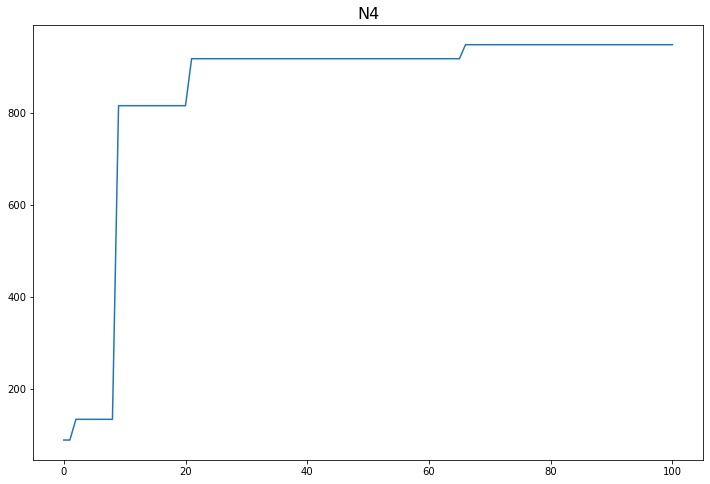

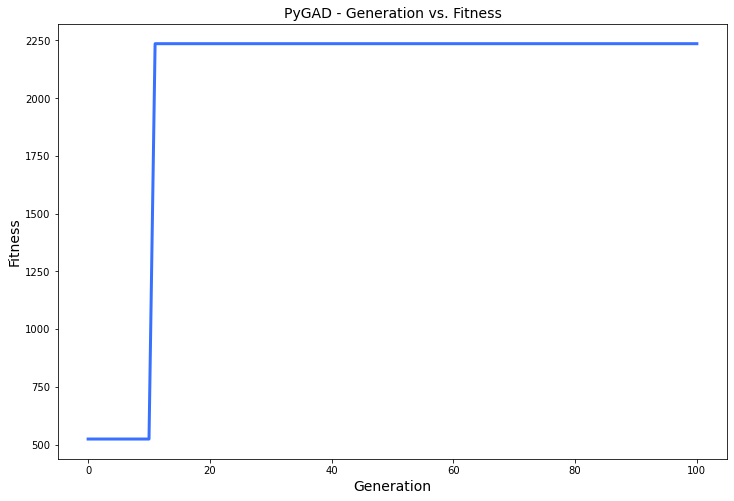

[0.676]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.676 |===========| 27.521 |==================| 3.12 |==========
[-0.632]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.632 |===========| 27.546 |==================| 3.379 |==========
[0.081]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.081 |===========| 27.81 |==================| 31.679 |==========
[-0.418]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 27.659 |==================| 5.45 |==========
[-0.733]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.733 |===========| 27.489 |==================| 2.831 |==========
[-0.826]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.826 |===========| 27.434 |==================| 2.45 |==========
[-0.393]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 24.133 |==================| 2.196 |==========
[0.39]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 24.213 |==================| 2.664 |==========
[0.017]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 24.573 |==================| 63.842 |==========
[-0.673]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.673 |===========| 23.915 |==================| 1.485 |==========
[0.763]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.763 |===========| 23.817 |==================| 1.297 |==========
[0.289]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 24.314 |==================| 3.643 |==========
[-0.083]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.888 |===========| 23.677 |==================| 1.097 |==========
[0.639]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 23.952 |==================| 1.571 |==========
Fitness = 63.842273828888445
[-0.673]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.673 |===========| 23.915 |==================| 1.485 |==========
[0.763]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.763 |===========| 23.817 |==================| 1.297 |==========
[0.289]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 24.314 |==================| 3.643 |==========
[-0.083]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 24.512 |==================| 13.067 |==========
[-0.476]
=====|SOLUTION|===========|OUTPUT|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.888 |===========| 23.677 |==================| 1.097 |==========
[0.639]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 23.952 |==================| 1.571 |==========
[-0.673]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.673 |===========| 23.915 |==================| 1.485 |==========
[0.763]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.763 |===========| 23.817 |==================| 1.297 |==========
[0.289]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 24.314 |==================| 3.643 |==========
[-0.083]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 24.512 |==================| 13.067 |==========
[-0.476]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.314 |===========| 24.289 |==================| 3.343 |==========
[-0.742]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.742 |===========| 23.84 |==================| 1.337 |==========
Generation = 2
[-0.457]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 24.144 |==================| 2.251 |==========
[-0.325]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 24.278 |==================| 3.227 |==========
[0.032]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 24.559 |==================| 34.183 |==========
[0.117]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 24.48 |==================| 9.214 |==========
[-0.729]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.907 |===========| 23.656 |==================| 1.072 |==========
[0.314]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.314 |===========| 24.289 |==================| 3.343 |==========
[-0.742]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.742 |===========| 23.84 |==================| 1.337 |==========
Change = 0.0
[-0.457]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 24.144 |==================| 2.251 |==========
[-0.325]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 24.278 |==================| 3.227 |==========
[0.032]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 24.559 |==================| 34.183 |==========
[0.117]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.907 |===========| 23.656 |==================| 1.072 |==========
[0.314]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.314 |===========| 24.289 |==================| 3.343 |==========
[-0.742]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.742 |===========| 23.84 |==================| 1.337 |==========
[0.326]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 24.277 |==================| 3.212 |==========
[-0.372]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 24.231 |==================| 2.797 |==========
[-0.556]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.556 |===========| 24.041 |==================| 1.827 |==========
[0.782]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

[-0.058]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 24.535 |==================| 18.676 |==========
[-0.585]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.585 |===========| 24.01 |==================| 1.729 |==========
[-0.249]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 24.353 |==================| 4.253 |==========
Fitness = 63.842273828888445
[0.326]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 24.277 |==================| 3.212 |==========
[-0.372]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 24.231 |==================| 2.797 |==========
[-0.556]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.556 |===========| 24.041 |==================| 1.827 |==========
[0.782]
=====|SOLUTION|===========|OUTPUT|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.061 |===========| 24.532 |==================| 17.927 |==========
[-0.058]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 24.535 |==================| 18.676 |==========
[-0.585]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.585 |===========| 24.01 |==================| 1.729 |==========
[-0.249]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 24.353 |==================| 4.253 |==========
[0.326]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 24.277 |==================| 3.212 |==========
[-0.372]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 24.231 |==================| 2.797 |==========
[-0.556]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.968 |===========| 23.586 |==================| 0.998 |==========
[-0.57]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.57 |===========| 24.026 |==================| 1.779 |==========
[0.801]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.801 |===========| 23.774 |==================| 1.229 |==========
[-0.047]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 24.545 |==================| 23.128 |==========
Generation = 4
[0.579]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 24.017 |==================| 1.749 |==========
[0.294]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 24.309 |==================| 3.584 |==========
[0.321]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 24.459 |==================| 7.725 |==========
[0.968]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.968 |===========| 23.586 |==================| 0.998 |==========
[-0.57]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.57 |===========| 24.026 |==================| 1.779 |==========
[0.801]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.801 |===========| 23.774 |==================| 1.229 |==========
[-0.047]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 24.545 |==================| 23.128 |==========
Change = 0.0
[0.579]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 24.017 |==================| 1.749 |==========
[0.294]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.968 |===========| 23.586 |==================| 0.998 |==========
[-0.57]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.57 |===========| 24.026 |==================| 1.779 |==========
[0.801]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.801 |===========| 23.774 |==================| 1.229 |==========
[-0.047]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 24.545 |==================| 23.128 |==========
[0.995]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.995 |===========| 23.554 |==================| 0.967 |==========
[0.82]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.82 |===========| 23.753 |==================| 1.197 |==========
[-0.076]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 24.367 |==================| 4.511 |==========
[0.133]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 24.465 |==================| 8.127 |==========
Fitness = 63.842273828888445
[0.995]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.995 |===========| 23.554 |==================| 0.967 |==========
[0.82]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.82 |===========| 23.753 |==================| 1.197 |==========
[-0.076]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 24.518 |==================| 14.218 |==========
[0.601]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 23.993 |==================| 1.68 |==========
[0.397]
=====|SOLUTION|===========|OUTPUT|==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.874 |===========| 23.693 |==================| 1.117 |==========
[0.235]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 24.367 |==================| 4.511 |==========
[0.133]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 24.465 |==================| 8.127 |==========
[0.995]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.995 |===========| 23.554 |==================| 0.967 |==========
[0.82]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.82 |===========| 23.753 |==================| 1.197 |==========
[-0.076]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 24.518 |==================| 14.218 |==========
[0.601]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.734 |===========| 23.849 |==================| 1.353 |==========
[-0.745]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.745 |===========| 23.837 |==================| 1.33 |==========
Generation = 6
[0.757]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.757 |===========| 23.824 |==================| 1.308 |==========
[0.422]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 24.18 |==================| 2.449 |==========
[0.56]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.56 |===========| 24.037 |==================| 1.813 |==========
[-0.286]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 24.317 |==================| 3.68 |==========
[0.925]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.745 |===========| 23.837 |==================| 1.33 |==========
Change = 0.0
[0.757]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.757 |===========| 23.824 |==================| 1.308 |==========
[0.422]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 24.18 |==================| 2.449 |==========
[0.56]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.56 |===========| 24.037 |==================| 1.813 |==========
[-0.286]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 24.317 |==================| 3.68 |==========
[0.925]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.925 |===========| 23.635 |==================| 1.049 |==========
[0.659]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 24.547 |==================| 24.475 |==========
[-0.021]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 24.569 |==================| 52.222 |==========
[0.864]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.864 |===========| 23.705 |==================| 1.132 |==========
[0.079]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 24.516 |==================| 13.754 |==========
[-0.111]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 24.485 |==================| 9.709 |==========
[0.104]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 24.492 |==================| 10.398 |==========
[-0.432]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 24.547 |==================| 24.475 |==========
[-0.021]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 24.569 |==================| 52.222 |==========
[0.864]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.864 |===========| 23.705 |==================| 1.132 |==========
[0.079]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 24.516 |==================| 13.754 |==========
[-0.111]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 24.485 |==================| 9.709 |==========
[0.104]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 24.492 |==================| 10.398 |==========
[-0.432]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 24.547 |==================| 24.475 |==========
[-0.021]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 24.569 |==================| 52.222 |==========
[0.864]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.864 |===========| 23.705 |==================| 1.132 |==========
[0.079]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 24.516 |==================| 13.754 |==========
[-0.111]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 24.485 |==================| 9.709 |==========
[0.104]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 24.492 |==================| 10.398 |==========
[-0.432]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.944 |===========| 23.613 |==================| 1.025 |==========
[0.562]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.562 |===========| 24.034 |==================| 1.805 |==========
[0.52]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.52 |===========| 24.078 |==================| 1.961 |==========
[-0.199]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 24.402 |==================| 5.366 |==========
[-0.981]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.981 |===========| 23.571 |==================| 0.983 |==========
[0.97]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.97 |===========| 23.584 |==================| 0.995 |==========
[-0.105]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.595 |===========| 23.999 |==================| 1.698 |==========
[-0.944]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.944 |===========| 23.613 |==================| 1.025 |==========
[0.562]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.562 |===========| 24.034 |==================| 1.805 |==========
[0.52]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.52 |===========| 24.078 |==================| 1.961 |==========
[-0.199]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 24.402 |==================| 5.366 |==========
[-0.981]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.981 |===========| 23.571 |==================| 0.983 |==========
[0.97]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 24.393 |==================| 5.11 |==========
[0.491]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 24.109 |==================| 2.084 |==========
[0.479]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 24.121 |==================| 2.14 |==========
[-0.946]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.946 |===========| 23.61 |==================| 1.023 |==========
[0.494]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 24.106 |==================| 2.073 |==========
[-0.308]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.308 |===========| 24.295 |==================| 3.413 |==========
[-0.301]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 24.352 |==================| 4.238 |==========
[-0.208]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 24.393 |==================| 5.11 |==========
[0.491]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 24.109 |==================| 2.084 |==========
[0.479]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 24.121 |==================| 2.14 |==========
[-0.946]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.946 |===========| 23.61 |==================| 1.023 |==========
[0.494]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 24.106 |==================| 2.073 |==========
[-0.308]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 24.152 |==================| 2.294 |==========
[0.25]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 24.352 |==================| 4.238 |==========
[-0.208]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 24.393 |==================| 5.11 |==========
[0.491]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 24.109 |==================| 2.084 |==========
[0.479]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 24.121 |==================| 2.14 |==========
[-0.946]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.946 |===========| 23.61 |==================| 1.023 |==========
[0.494]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.911 |===========| 23.651 |==================| 1.067 |==========
[0.118]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 24.479 |==================| 9.112 |==========
[0.392]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 24.21 |==================| 2.647 |==========
[-0.824]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.824 |===========| 23.749 |==================| 1.191 |==========
[0.952]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.952 |===========| 23.604 |==================| 1.016 |==========
[0.795]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.795 |===========| 23.781 |==================| 1.239 |==========
[-0.339]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.911 |===========| 23.651 |==================| 1.067 |==========
[0.118]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 24.479 |==================| 9.112 |==========
[0.392]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 24.21 |==================| 2.647 |==========
[-0.824]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.824 |===========| 23.749 |==================| 1.191 |==========
[0.952]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.952 |===========| 23.604 |==================| 1.016 |==========
[0.795]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.795 |===========| 23.781 |==================| 1.239 |==========
[-0.339]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 24.227 |==================| 2.769 |==========
[-0.453]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 24.148 |==================| 2.273 |==========
[0.809]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.809 |===========| 23.766 |==================| 1.216 |==========
[-0.811]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.811 |===========| 23.764 |==================| 1.213 |==========
[-0.21]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 24.391 |==================| 5.065 |==========
[0.863]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 23.705 |==================| 1.133 |==========
[0.624]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.915 |===========| 23.647 |==================| 1.062 |==========
[0.376]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 24.227 |==================| 2.769 |==========
[-0.453]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 24.148 |==================| 2.273 |==========
[0.809]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.809 |===========| 23.766 |==================| 1.216 |==========
[-0.811]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.811 |===========| 23.764 |==================| 1.213 |==========
[-0.21]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 24.391 |==================| 5.065 |==========
[0.863]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.915 |===========| 23.647 |==================| 1.062 |==========
[0.376]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 24.227 |==================| 2.769 |==========
[-0.453]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 24.148 |==================| 2.273 |==========
[0.809]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.809 |===========| 23.766 |==================| 1.216 |==========
[-0.811]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.811 |===========| 23.764 |==================| 1.213 |==========
[-0.21]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 24.391 |==================| 5.065 |==========
[0.863]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.661 |===========| 23.928 |==================| 1.515 |==========
[-0.384]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 24.219 |==================| 2.706 |==========
[0.65]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.65 |===========| 23.941 |==================| 1.544 |==========
[-0.502]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 24.098 |==================| 2.039 |==========
[0.021]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 24.569 |==================| 52.763 |==========
[-0.902]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 23.661 |==================| 1.078 |==========
[-0.928]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 24.219 |==================| 2.706 |==========
[0.65]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.65 |===========| 23.941 |==================| 1.544 |==========
[-0.502]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 24.098 |==================| 2.039 |==========
[0.021]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 24.569 |==================| 52.763 |==========
[-0.902]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 23.661 |==================| 1.078 |==========
[-0.928]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.928 |===========| 23.632 |==================| 1.046 |==========
[0.7]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 24.519 |==================| 14.446 |==========
[-0.372]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 24.231 |==================| 2.796 |==========
[-0.275]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 24.328 |==================| 3.836 |==========
[0.912]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.912 |===========| 23.65 |==================| 1.065 |==========
[0.269]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 24.334 |==================| 3.93 |==========
[0.964]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 23.59 |==================| 1.002 |==========
[0.287]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 24.476 |==================| 8.895 |==========
[0.075]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 24.519 |==================| 14.446 |==========
[-0.372]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 24.231 |==================| 2.796 |==========
[-0.275]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 24.328 |==================| 3.836 |==========
[0.912]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.912 |===========| 23.65 |==================| 1.065 |==========
[0.269]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 24.334 |==================| 3.93 |==========
[0.964]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.893 |===========| 23.671 |==================| 1.091 |==========
[0.121]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 24.476 |==================| 8.895 |==========
[0.075]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 24.519 |==================| 14.446 |==========
[-0.372]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 24.231 |==================| 2.796 |==========
[-0.275]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 24.328 |==================| 3.836 |==========
[0.912]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.912 |===========| 23.65 |==================| 1.065 |==========
[0.269]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 24.337 |==================| 3.977 |==========
[-0.341]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 24.262 |==================| 3.064 |==========
[-0.566]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.566 |===========| 24.03 |==================| 1.791 |==========
[0.319]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 24.284 |==================| 3.292 |==========
[-0.463]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 24.137 |==================| 2.218 |==========
[0.699]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.699 |===========| 23.887 |==================| 1.425 |==========
[0.544]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 24.337 |==================| 3.977 |==========
[-0.341]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 24.262 |==================| 3.064 |==========
[-0.566]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.566 |===========| 24.03 |==================| 1.791 |==========
[0.319]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 24.284 |==================| 3.292 |==========
[-0.463]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 24.137 |==================| 2.218 |==========
[0.699]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.699 |===========| 23.887 |==================| 1.425 |==========
[0.544]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.88 |===========| 23.686 |==================| 1.108 |==========
[0.938]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 23.62 |==================| 1.033 |==========
[0.803]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.803 |===========| 23.773 |==================| 1.226 |==========
[-0.773]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.773 |===========| 23.806 |==================| 1.278 |==========
[0.542]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.542 |===========| 24.056 |==================| 1.877 |==========
[0.571]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.571 |===========| 24.025 |==================| 1.774 |==========
[0.594]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.578 |===========| 24.017 |==================| 1.752 |==========
[-0.88]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.88 |===========| 23.686 |==================| 1.108 |==========
[0.938]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 23.62 |==================| 1.033 |==========
[0.803]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.803 |===========| 23.773 |==================| 1.226 |==========
[-0.773]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.773 |===========| 23.806 |==================| 1.278 |==========
[0.542]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.542 |===========| 24.056 |==================| 1.877 |==========
[0.571]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.578 |===========| 24.017 |==================| 1.752 |==========
[-0.88]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.88 |===========| 23.686 |==================| 1.108 |==========
[0.938]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 23.62 |==================| 1.033 |==========
[0.803]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.803 |===========| 23.773 |==================| 1.226 |==========
[-0.773]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.773 |===========| 23.806 |==================| 1.278 |==========
[0.542]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.542 |===========| 24.056 |==================| 1.877 |==========
[0.571]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.572 |===========| 24.024 |==================| 1.771 |==========
[-0.189]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 24.412 |==================| 5.661 |==========
[-0.387]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 24.216 |==================| 2.687 |==========
[0.64]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.64 |===========| 23.951 |==================| 1.569 |==========
[-0.849]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.849 |===========| 23.721 |==================| 1.153 |==========
[0.801]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.801 |===========| 23.775 |==================| 1.229 |==========
[0.749]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.572 |===========| 24.024 |==================| 1.771 |==========
[-0.189]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 24.412 |==================| 5.661 |==========
[-0.387]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 24.216 |==================| 2.687 |==========
[0.64]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.64 |===========| 23.951 |==================| 1.569 |==========
[-0.849]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.849 |===========| 23.721 |==================| 1.153 |==========
[0.801]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.801 |===========| 23.775 |==================| 1.229 |==========
[0.749]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.572 |===========| 24.024 |==================| 1.771 |==========
[0.964]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 23.591 |==================| 1.003 |==========
[0.941]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.941 |===========| 23.617 |==================| 1.029 |==========
[0.953]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.953 |===========| 23.603 |==================| 1.015 |==========
[0.21]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 24.392 |==================| 5.083 |==========
[0.484]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 24.116 |==================| 2.117 |==========
[-0.723]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 24.454 |==================| 7.468 |==========
[0.572]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.572 |===========| 24.024 |==================| 1.771 |==========
[0.964]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 23.591 |==================| 1.003 |==========
[0.941]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.941 |===========| 23.617 |==================| 1.029 |==========
[0.953]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.953 |===========| 23.603 |==================| 1.015 |==========
[0.21]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 24.392 |==================| 5.083 |==========
[0.484]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 24.454 |==================| 7.468 |==========
[0.572]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.572 |===========| 24.024 |==================| 1.771 |==========
[0.964]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 23.591 |==================| 1.003 |==========
[0.941]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.941 |===========| 23.617 |==================| 1.029 |==========
[0.953]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.953 |===========| 23.603 |==================| 1.015 |==========
[0.21]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 24.392 |==================| 5.083 |==========
[0.484]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========| 24.266 |==================| 3.103 |==========
[-0.035]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 24.556 |==================| 31.262 |==========
[-0.632]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.632 |===========| 23.959 |==================| 1.59 |==========
[-0.923]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.923 |===========| 23.638 |==================| 1.052 |==========
[0.64]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.64 |===========| 23.951 |==================| 1.57 |==========
[0.445]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 24.157 |==================| 2.318 |==========
[0.695]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 24.556 |==================| 31.262 |==========
[-0.632]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.632 |===========| 23.959 |==================| 1.59 |==========
[-0.923]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.923 |===========| 23.638 |==================| 1.052 |==========
[0.64]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.64 |===========| 23.951 |==================| 1.57 |==========
[0.445]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 24.157 |==================| 2.318 |==========
[0.695]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 23.891 |==================| 1.435 |==========
[-0.404]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 24.333 |==================| 3.925 |==========
[0.787]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.787 |===========| 23.791 |==================| 1.254 |==========
[-0.391]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.391 |===========| 24.212 |==================| 2.658 |==========
[-0.735]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.735 |===========| 23.848 |==================| 1.35 |==========
[-0.593]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.593 |===========| 24.001 |==================| 1.703 |==========
[0.02]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 24.57 |==================| 53.609 |==========
[0.509]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.0 |===========| 24.588 |==================| 2697.235 |==========
[0.269]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 24.333 |==================| 3.925 |==========
[0.787]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.787 |===========| 23.791 |==================| 1.254 |==========
[-0.391]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.391 |===========| 24.212 |==================| 2.658 |==========
[-0.735]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.735 |===========| 23.848 |==================| 1.35 |==========
[-0.593]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.593 |===========| 24.001 |==================| 1.703 |==========
[0.02]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 24.333 |==================| 3.925 |==========
[0.787]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.787 |===========| 23.791 |==================| 1.254 |==========
[-0.391]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.391 |===========| 24.212 |==================| 2.658 |==========
[-0.735]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.735 |===========| 23.848 |==================| 1.35 |==========
[-0.593]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.593 |===========| 24.001 |==================| 1.703 |==========
[0.02]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 24.57 |==================| 53.609 |==========
[0.509]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 24.235 |==================| 2.832 |==========
[0.278]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 24.324 |==================| 3.788 |==========
[-0.804]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.804 |===========| 23.771 |==================| 1.224 |==========
[-0.856]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.856 |===========| 23.713 |==================| 1.143 |==========
[0.547]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.547 |===========| 24.05 |==================| 1.858 |==========
[0.552]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.552 |===========| 24.045 |==================| 1.84 |==========
[-0.629]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 24.37 |==================| 4.587 |==========
[0.368]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 24.235 |==================| 2.832 |==========
[0.278]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 24.324 |==================| 3.788 |==========
[-0.804]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.804 |===========| 23.771 |==================| 1.224 |==========
[-0.856]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.856 |===========| 23.713 |==================| 1.143 |==========
[0.547]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.547 |===========| 24.05 |==================| 1.858 |==========
[0.552]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.701 |===========| 23.885 |==================| 1.421 |==========
[-0.816]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.816 |===========| 23.758 |==================| 1.204 |==========
[-0.619]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.619 |===========| 23.974 |==================| 1.627 |==========
[-0.005]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 24.584 |==================| 222.285 |==========
[0.125]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 24.473 |==================| 8.642 |==========
[-0.063]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 24.53 |==================| 17.301 |==========
[-0.839]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.701 |===========| 23.885 |==================| 1.421 |==========
[-0.816]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.816 |===========| 23.758 |==================| 1.204 |==========
[-0.619]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.619 |===========| 23.974 |==================| 1.627 |==========
[-0.005]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 24.584 |==================| 222.285 |==========
[0.125]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 24.473 |==================| 8.642 |==========
[-0.063]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 24.53 |==================| 17.301 |==========
[-0.839]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.701 |===========| 23.885 |==================| 1.421 |==========
[-0.816]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.816 |===========| 23.758 |==================| 1.204 |==========
[-0.619]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.619 |===========| 23.974 |==================| 1.627 |==========
[-0.005]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 24.584 |==================| 222.285 |==========
[0.125]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 24.473 |==================| 8.642 |==========
[-0.063]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 24.53 |==================| 17.301 |==========
[-0.839]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.101 |===========| 24.495 |==================| 10.672 |==========
[0.311]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 24.292 |==================| 3.379 |==========
[-0.895]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.895 |===========| 23.669 |==================| 1.088 |==========
[0.734]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.734 |===========| 23.849 |==================| 1.352 |==========
[0.129]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.129 |===========| 24.469 |==================| 8.386 |==========
[-0.497]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 24.102 |==================| 2.058 |==========
[-0.639]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 24.535 |==================| 18.664 |==========
[-0.101]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.101 |===========| 24.495 |==================| 10.672 |==========
[0.311]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 24.292 |==================| 3.379 |==========
[-0.895]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.895 |===========| 23.669 |==================| 1.088 |==========
[0.734]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.734 |===========| 23.849 |==================| 1.352 |==========
[0.129]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.129 |===========| 24.469 |==================| 8.386 |==========
[-0.497]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

[0.558]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.558 |===========| 24.038 |==================| 1.818 |==========
[-0.925]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.925 |===========| 23.635 |==================| 1.049 |==========
[-0.281]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 24.321 |==================| 3.746 |==========
[-0.892]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.892 |===========| 23.673 |==================| 1.092 |==========
[0.017]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 24.573 |==================| 63.464 |==========
[-0.001]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 24.587 |==================| 908.796 |==========
[-0.11]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.558 |===========| 24.038 |==================| 1.818 |==========
[-0.925]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.925 |===========| 23.635 |==================| 1.049 |==========
[-0.281]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 24.321 |==================| 3.746 |==========
[-0.892]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.892 |===========| 23.673 |==================| 1.092 |==========
[0.017]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 24.573 |==================| 63.464 |==========
[-0.001]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 24.587 |==================| 908.796 |==========
[-0.11]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.558 |===========| 24.038 |==================| 1.818 |==========
[-0.925]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.925 |===========| 23.635 |==================| 1.049 |==========
[-0.281]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 24.321 |==================| 3.746 |==========
[-0.892]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.892 |===========| 23.673 |==================| 1.092 |==========
[0.017]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 24.573 |==================| 63.464 |==========
[-0.001]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 24.587 |==================| 908.796 |==========
[-0.11]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 24.566 |==================| 45.803 |==========
[-0.113]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 24.483 |==================| 9.527 |==========
[-0.517]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.517 |===========| 24.081 |==================| 1.973 |==========
[0.461]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 24.14 |==================| 2.229 |==========
[-0.403]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.403 |===========| 24.199 |==================| 2.569 |==========
[-0.722]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 23.862 |==================| 1.378 |==========
[-0.669]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 24.566 |==================| 45.803 |==========
[-0.113]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 24.483 |==================| 9.527 |==========
[-0.517]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.517 |===========| 24.081 |==================| 1.973 |==========
[0.461]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 24.14 |==================| 2.229 |==========
[-0.403]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.403 |===========| 24.199 |==================| 2.569 |==========
[-0.722]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 23.862 |==================| 1.378 |==========
[-0.669]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 24.435 |==================| 6.539 |==========
[0.178]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 24.422 |==================| 6.006 |==========
[0.227]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 24.375 |==================| 4.68 |==========
[-0.617]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.617 |===========| 23.975 |==================| 1.631 |==========
[0.83]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 23.743 |==================| 1.183 |==========
[0.488]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 24.111 |==================| 2.097 |==========
[0.273]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 23.695 |==================| 1.119 |==========
[0.164]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 24.435 |==================| 6.539 |==========
[0.178]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 24.422 |==================| 6.006 |==========
[0.227]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 24.375 |==================| 4.68 |==========
[-0.617]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.617 |===========| 23.975 |==================| 1.631 |==========
[0.83]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 23.743 |==================| 1.183 |==========
[0.488]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 24.435 |==================| 6.539 |==========
[0.178]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 24.422 |==================| 6.006 |==========
[0.227]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 24.375 |==================| 4.68 |==========
[-0.617]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.617 |===========| 23.975 |==================| 1.631 |==========
[0.83]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 23.743 |==================| 1.183 |==========
[0.488]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 24.111 |==================| 2.097 |==========
[0.273]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 24.216 |==================| 2.684 |==========
[0.774]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.774 |===========| 23.805 |==================| 1.276 |==========
[-0.552]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.552 |===========| 24.045 |==================| 1.841 |==========
[0.849]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.849 |===========| 23.721 |==================| 1.153 |==========
[0.828]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.828 |===========| 23.744 |==================| 1.185 |==========
[0.84]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.84 |===========| 23.731 |==================| 1.167 |==========
[0.999]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 24.216 |==================| 2.684 |==========
[0.774]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.774 |===========| 23.805 |==================| 1.276 |==========
[-0.552]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.552 |===========| 24.045 |==================| 1.841 |==========
[0.849]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.849 |===========| 23.721 |==================| 1.153 |==========
[0.828]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.828 |===========| 23.744 |==================| 1.185 |==========
[0.84]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.84 |===========| 23.731 |==================| 1.167 |==========
[0.999]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 23.856 |==================| 1.366 |==========
[0.861]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.861 |===========| 23.708 |==================| 1.136 |==========
[-0.504]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 24.095 |==================| 2.028 |==========
[0.058]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 24.535 |==================| 18.682 |==========
[0.204]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 24.397 |==================| 5.236 |==========
[-0.324]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 24.279 |==================| 3.235 |==========
[-0.736]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 24.419 |==================| 5.899 |==========
[0.727]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 23.856 |==================| 1.366 |==========
[0.861]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.861 |===========| 23.708 |==================| 1.136 |==========
[-0.504]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 24.095 |==================| 2.028 |==========
[0.058]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 24.535 |==================| 18.682 |==========
[0.204]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 24.397 |==================| 5.236 |==========
[-0.324]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 24.419 |==================| 5.899 |==========
[0.727]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 23.856 |==================| 1.366 |==========
[0.861]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.861 |===========| 23.708 |==================| 1.136 |==========
[-0.504]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 24.095 |==================| 2.028 |==========
[0.058]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 24.535 |==================| 18.682 |==========
[0.204]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 24.397 |==================| 5.236 |==========
[-0.324]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.673 |===========| 23.915 |==================| 1.486 |==========
[-0.746]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.746 |===========| 23.836 |==================| 1.329 |==========
[0.445]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 24.156 |==================| 2.314 |==========
[0.335]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 24.268 |==================| 3.123 |==========
[-0.672]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.672 |===========| 23.916 |==================| 1.488 |==========
[-0.889]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.889 |===========| 23.676 |==================| 1.096 |==========
[0.673]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.673 |===========| 23.915 |==================| 1.486 |==========
[-0.746]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.746 |===========| 23.836 |==================| 1.329 |==========
[0.445]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 24.156 |==================| 2.314 |==========
[0.335]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 24.268 |==================| 3.123 |==========
[-0.672]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.672 |===========| 23.916 |==================| 1.488 |==========
[-0.889]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.889 |===========| 23.676 |==================| 1.096 |==========
[0.673]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 24.121 |==================| 2.141 |==========
[0.09]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 24.506 |==================| 12.092 |==========
[-0.749]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.749 |===========| 23.832 |==================| 1.323 |==========
[-0.955]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.955 |===========| 23.6 |==================| 1.012 |==========
[-0.294]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 24.309 |==================| 3.583 |==========
[0.319]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 24.284 |==================| 3.286 |==========
[-0.301]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.555 |===========| 24.042 |==================| 1.83 |==========
[0.479]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 24.121 |==================| 2.141 |==========
[0.09]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 24.506 |==================| 12.092 |==========
[-0.749]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.749 |===========| 23.832 |==================| 1.323 |==========
[-0.955]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.955 |===========| 23.6 |==================| 1.012 |==========
[-0.294]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 24.309 |==================| 3.583 |==========
[0.319]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 24.239 |==================| 2.861 |==========
[-0.555]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.555 |===========| 24.042 |==================| 1.83 |==========
[0.479]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 24.121 |==================| 2.141 |==========
[0.09]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 24.506 |==================| 12.092 |==========
[-0.749]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.749 |===========| 23.832 |==================| 1.323 |==========
[-0.955]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.955 |===========| 23.6 |==================| 1.012 |==========
[-0.294]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 24.337 |==================| 3.984 |==========
[0.041]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 24.551 |==================| 26.839 |==========
[-0.335]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 24.268 |==================| 3.119 |==========
[-0.737]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 23.845 |==================| 1.346 |==========
[0.334]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 24.269 |==================| 3.135 |==========
[0.595]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.595 |===========| 23.999 |==================| 1.696 |==========
[0.589]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 24.551 |==================| 26.839 |==========
[-0.335]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 24.268 |==================| 3.119 |==========
[-0.737]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 23.845 |==================| 1.346 |==========
[0.334]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 24.269 |==================| 3.135 |==========
[0.595]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.595 |===========| 23.999 |==================| 1.696 |==========
[0.589]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 24.006 |==================| 1.717 |==========
[-0.222]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 24.298 |==================| 3.439 |==========
[-0.767]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 23.813 |==================| 1.289 |==========
[0.119]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 24.478 |==================| 9.059 |==========
[-0.975]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.975 |===========| 23.578 |==================| 0.99 |==========
[-0.518]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.518 |===========| 24.08 |==================| 1.968 |==========
[-0.924]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.924 |===========| 23.636 |==================| 1.05 |==========
[-0.356]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 23.813 |==================| 1.289 |==========
[0.119]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 24.478 |==================| 9.059 |==========
[-0.975]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.975 |===========| 23.578 |==================| 0.99 |==========
[-0.518]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.518 |===========| 24.08 |==================| 1.968 |==========
[-0.924]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.924 |===========| 23.636 |==================| 1.05 |==========
[-0.356]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.356 |===========| 24.247 |==================| 2.93 |==========
[0.994]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 24.478 |==================| 9.059 |==========
[-0.975]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.975 |===========| 23.578 |==================| 0.99 |==========
[-0.518]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.518 |===========| 24.08 |==================| 1.968 |==========
[-0.924]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.924 |===========| 23.636 |==================| 1.05 |==========
[-0.356]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.356 |===========| 24.247 |==================| 2.93 |==========
[0.994]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.994 |===========| 23.556 |==================| 0.969 |==========
[0.523]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.674 |===========| 23.914 |==================| 1.483 |==========
[0.534]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.534 |===========| 24.064 |==================| 1.907 |==========
[-0.333]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 24.27 |==================| 3.147 |==========
[0.25]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 24.352 |==================| 4.234 |==========
[-0.804]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.804 |===========| 23.772 |==================| 1.225 |==========
[0.652]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.652 |===========| 23.938 |==================| 1.538 |==========
[0.368]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.534 |===========| 24.064 |==================| 1.907 |==========
[-0.333]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 24.27 |==================| 3.147 |==========
[0.25]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 24.352 |==================| 4.234 |==========
[-0.804]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.804 |===========| 23.772 |==================| 1.225 |==========
[0.652]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.652 |===========| 23.938 |==================| 1.538 |==========
[0.368]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 24.235 |==================| 2.827 |==========
[0.985]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.942 |===========| 23.615 |==================| 1.028 |==========
[0.999]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.999 |===========| 23.55 |==================| 0.963 |==========
[0.348]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 24.255 |==================| 2.997 |==========
[-0.829]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.829 |===========| 23.743 |==================| 1.183 |==========
[-0.582]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.582 |===========| 24.013 |==================| 1.739 |==========
[0.948]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.948 |===========| 23.608 |==================| 1.021 |==========
[0.962]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.942 |===========| 23.615 |==================| 1.028 |==========
[0.999]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.999 |===========| 23.55 |==================| 0.963 |==========
[0.348]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 24.255 |==================| 2.997 |==========
[-0.829]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.829 |===========| 23.743 |==================| 1.183 |==========
[-0.582]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.582 |===========| 24.013 |==================| 1.739 |==========
[0.948]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.948 |===========| 23.608 |==================| 1.021 |==========
[0.962]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.304 |===========| 24.299 |==================| 3.462 |==========
[0.942]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.942 |===========| 23.615 |==================| 1.028 |==========
[0.999]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.999 |===========| 23.55 |==================| 0.963 |==========
[0.348]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 24.255 |==================| 2.997 |==========
[-0.829]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.829 |===========| 23.743 |==================| 1.183 |==========
[-0.582]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.582 |===========| 24.013 |==================| 1.739 |==========
[0.948]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 23.695 |==================| 1.119 |==========
[0.483]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 24.117 |==================| 2.122 |==========
[-0.752]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 23.829 |==================| 1.317 |==========
[-0.381]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 24.222 |==================| 2.727 |==========
[-0.376]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 24.226 |==================| 2.764 |==========
[0.267]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 24.335 |==================| 3.955 |==========
[0.495]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.535 |===========| 24.063 |==================| 1.904 |==========
[0.872]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 23.695 |==================| 1.119 |==========
[0.483]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 24.117 |==================| 2.122 |==========
[-0.752]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 23.829 |==================| 1.317 |==========
[-0.381]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 24.222 |==================| 2.727 |==========
[-0.376]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 24.226 |==================| 2.764 |==========
[0.267]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 24.083 |==================| 1.979 |==========
[0.039]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 24.553 |==================| 28.277 |==========
[0.982]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.982 |===========| 23.57 |==================| 0.982 |==========
[-0.607]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.607 |===========| 23.986 |==================| 1.661 |==========
[0.91]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.91 |===========| 23.652 |==================| 1.068 |==========
[-0.785]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.785 |===========| 23.792 |==================| 1.257 |==========
[0.718]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========| 24.266 |==================| 3.104 |==========
[-0.516]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 24.083 |==================| 1.979 |==========
[0.039]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 24.553 |==================| 28.277 |==========
[0.982]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.982 |===========| 23.57 |==================| 0.982 |==========
[-0.607]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.607 |===========| 23.986 |==================| 1.661 |==========
[0.91]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.91 |===========| 23.652 |==================| 1.068 |==========
[-0.785]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.891 |===========| 23.673 |==================| 1.093 |==========
[0.337]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========| 24.266 |==================| 3.104 |==========
[-0.516]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 24.083 |==================| 1.979 |==========
[0.039]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 24.553 |==================| 28.277 |==========
[0.982]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.982 |===========| 23.57 |==================| 0.982 |==========
[-0.607]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.607 |===========| 23.986 |==================| 1.661 |==========
[0.91]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 23.667 |==================| 1.086 |==========
[0.377]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 24.225 |==================| 2.756 |==========
[-0.783]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.783 |===========| 23.795 |==================| 1.261 |==========
[0.697]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.697 |===========| 23.89 |==================| 1.432 |==========
[-0.798]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.798 |===========| 23.778 |==================| 1.234 |==========
[0.411]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 24.191 |==================| 2.517 |==========
[-0.67]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 24.225 |==================| 2.756 |==========
[-0.783]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.783 |===========| 23.795 |==================| 1.261 |==========
[0.697]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.697 |===========| 23.89 |==================| 1.432 |==========
[-0.798]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.798 |===========| 23.778 |==================| 1.234 |==========
[0.411]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 24.191 |==================| 2.517 |==========
[-0.67]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 23.919 |==================| 1.494 |==========
[-0.58]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.517 |===========| 24.082 |==================| 1.975 |==========
[-0.043]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 24.549 |==================| 25.309 |==========
[-0.381]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 24.222 |==================| 2.731 |==========
[0.852]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.852 |===========| 23.718 |==================| 1.149 |==========
[-0.427]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 24.175 |==================| 2.417 |==========
[-0.838]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 23.733 |==================| 1.169 |==========
[0.4]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.517 |===========| 24.082 |==================| 1.975 |==========
[-0.043]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 24.549 |==================| 25.309 |==========
[-0.381]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 24.222 |==================| 2.731 |==========
[0.852]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.852 |===========| 23.718 |==================| 1.149 |==========
[-0.427]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 24.175 |==================| 2.417 |==========
[-0.838]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 23.733 |==================| 1.169 |==========
[0.4]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.517 |===========| 24.082 |==================| 1.975 |==========
[-0.043]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 24.549 |==================| 25.309 |==========
[-0.381]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 24.222 |==================| 2.731 |==========
[0.852]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.852 |===========| 23.718 |==================| 1.149 |==========
[-0.427]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 24.175 |==================| 2.417 |==========
[-0.838]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 23.733 |==================| 1.169 |==========
[0.4]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.861 |===========| 23.708 |==================| 1.136 |==========
[0.139]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 24.459 |==================| 7.758 |==========
[0.77]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.77 |===========| 23.809 |==================| 1.283 |==========
[0.443]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 24.159 |==================| 2.329 |==========
[0.86]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.86 |===========| 23.709 |==================| 1.137 |==========
[0.282]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 24.321 |==================| 3.737 |==========
[0.969]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.861 |===========| 23.708 |==================| 1.136 |==========
[0.139]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 24.459 |==================| 7.758 |==========
[0.77]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.77 |===========| 23.809 |==================| 1.283 |==========
[0.443]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 24.159 |==================| 2.329 |==========
[0.86]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.86 |===========| 23.709 |==================| 1.137 |==========
[0.282]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 24.321 |==================| 3.737 |==========
[0.969]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 24.256 |==================| 3.01 |==========
[-0.775]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 23.804 |==================| 1.275 |==========
[-0.421]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 24.181 |==================| 2.454 |==========
[0.613]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.613 |===========| 23.98 |==================| 1.643 |==========
[0.394]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 24.208 |==================| 2.63 |==========
[-0.112]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.112 |===========| 24.484 |==================| 9.62 |==========
[0.211]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

======| 0.197 |===========| 24.404 |==================| 5.425 |==========
[-0.347]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 24.256 |==================| 3.01 |==========
[-0.775]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 23.804 |==================| 1.275 |==========
[-0.421]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 24.181 |==================| 2.454 |==========
[0.613]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.613 |===========| 23.98 |==================| 1.643 |==========
[0.394]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 24.208 |==================| 2.63 |==========
[-0.112]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.112 |===========| 24.484 |==================| 9.62 |==========
[0

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 24.256 |==================| 3.01 |==========
[-0.775]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 23.804 |==================| 1.275 |==========
[-0.421]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 24.181 |==================| 2.454 |==========
[0.613]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.613 |===========| 23.98 |==================| 1.643 |==========
[0.394]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 24.208 |==================| 2.63 |==========
[-0.112]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.112 |===========| 24.484 |==================| 9.62 |==========
[0.211]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 24.31 |==================| 3.589 |==========
[0.677]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.677 |===========| 23.912 |==================| 1.478 |==========
[0.628]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.628 |===========| 23.963 |==================| 1.601 |==========
[-0.017]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 24.573 |==================| 64.309 |==========
[0.186]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 24.414 |==================| 5.745 |==========
[-0.083]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 24.512 |==================| 13.032 |==========
[-0.814]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 24.31 |==================| 3.589 |==========
[0.677]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.677 |===========| 23.912 |==================| 1.478 |==========
[0.628]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.628 |===========| 23.963 |==================| 1.601 |==========
[-0.017]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 24.573 |==================| 64.309 |==========
[0.186]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 24.414 |==================| 5.745 |==========
[-0.083]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 24.512 |==================| 13.032 |==========
[-0.814]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.314 |===========| 24.289 |==================| 3.343 |==========
[-0.204]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 24.396 |==================| 5.213 |==========
[0.609]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.609 |===========| 23.985 |==================| 1.657 |==========
[0.845]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.845 |===========| 23.726 |==================| 1.16 |==========
[0.81]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.81 |===========| 23.765 |==================| 1.214 |==========
[-0.663]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.663 |===========| 23.926 |==================| 1.51 |==========
[0.793]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.314 |===========| 24.289 |==================| 3.343 |==========
[-0.204]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 24.396 |==================| 5.213 |==========
[0.609]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.609 |===========| 23.985 |==================| 1.657 |==========
[0.845]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.845 |===========| 23.726 |==================| 1.16 |==========
[0.81]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.81 |===========| 23.765 |==================| 1.214 |==========
[-0.663]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.663 |===========| 23.926 |==================| 1.51 |==========
[0.793]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 24.396 |==================| 5.213 |==========
[0.609]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.609 |===========| 23.985 |==================| 1.657 |==========
[0.845]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.845 |===========| 23.726 |==================| 1.16 |==========
[0.81]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.81 |===========| 23.765 |==================| 1.214 |==========
[-0.663]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.663 |===========| 23.926 |==================| 1.51 |==========
[0.793]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.793 |===========| 23.783 |==================| 1.243 |==========
[0.887]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 24.546 |==================| 23.842 |==========
[-0.345]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 24.258 |==================| 3.025 |==========
[-0.001]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 24.587 |==================| 823.468 |==========
[0.003]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 24.586 |==================| 431.961 |==========
[0.947]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.947 |===========| 23.61 |==================| 1.022 |==========
[-0.49]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 24.11 |==================| 2.092 |==========
[0.987]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 24.258 |==================| 3.025 |==========
[-0.001]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 24.587 |==================| 823.468 |==========
[0.003]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 24.586 |==================| 431.961 |==========
[0.947]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.947 |===========| 23.61 |==================| 1.022 |==========
[-0.49]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 24.11 |==================| 2.092 |==========
[0.987]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.987 |===========| 23.564 |==================| 0.977 |==========
[0.887]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

[-0.121]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 24.476 |==================| 8.946 |==========
[-0.191]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 24.41 |==================| 5.598 |==========
[-0.592]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.592 |===========| 24.002 |==================| 1.706 |==========
[-0.54]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.54 |===========| 24.058 |==================| 1.884 |==========
[-0.794]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.794 |===========| 23.782 |==================| 1.241 |==========
[-0.891]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.891 |===========| 23.674 |==================| 1.094 |==========
Generation = 43
[-0.948]
=====|SOLUTION|===========|OUTPUT|==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 24.476 |==================| 8.946 |==========
[-0.191]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 24.41 |==================| 5.598 |==========
[-0.592]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.592 |===========| 24.002 |==================| 1.706 |==========
[-0.54]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.54 |===========| 24.058 |==================| 1.884 |==========
[-0.794]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.794 |===========| 23.782 |==================| 1.241 |==========
[-0.891]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.891 |===========| 23.674 |==================| 1.094 |==========
Change = 0.0
[-0.948]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.998 |===========| 23.551 |==================| 0.964 |==========
[-0.121]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 24.476 |==================| 8.946 |==========
[-0.191]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 24.41 |==================| 5.598 |==========
[-0.592]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.592 |===========| 24.002 |==================| 1.706 |==========
[-0.54]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.54 |===========| 24.058 |==================| 1.884 |==========
[-0.794]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.794 |===========| 23.782 |==================| 1.241 |==========
[-0.891]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.637 |===========| 23.954 |==================| 1.577 |==========
[0.632]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.632 |===========| 23.96 |==================| 1.591 |==========
[-0.246]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 24.356 |==================| 4.305 |==========
[0.607]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.607 |===========| 23.986 |==================| 1.661 |==========
[0.806]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.806 |===========| 23.77 |==================| 1.222 |==========
[0.267]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 24.335 |==================| 3.951 |==========
[0.253]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.637 |===========| 23.954 |==================| 1.577 |==========
[0.632]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.632 |===========| 23.96 |==================| 1.591 |==========
[-0.246]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 24.356 |==================| 4.305 |==========
[0.607]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.607 |===========| 23.986 |==================| 1.661 |==========
[0.806]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.806 |===========| 23.77 |==================| 1.222 |==========
[0.267]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 24.335 |==================| 3.951 |==========
[0.253]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 23.706 |==================| 1.133 |==========
[0.445]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 24.156 |==================| 2.316 |==========
[-0.918]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.918 |===========| 23.643 |==================| 1.058 |==========
[-0.251]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 24.351 |==================| 4.211 |==========
[0.274]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 24.328 |==================| 3.847 |==========
Generation = 45
[-0.449]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 24.152 |==================| 2.293 |==========
[0.395]
=====|SOLUTION|===========|OUTPUT|==================|FITN

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 24.471 |==================| 8.558 |==========
[0.863]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 23.706 |==================| 1.133 |==========
[0.445]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 24.156 |==================| 2.316 |==========
[-0.918]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.918 |===========| 23.643 |==================| 1.058 |==========
[-0.251]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 24.351 |==================| 4.211 |==========
[0.274]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 24.328 |==================| 3.847 |==========
Change = 0.0
[-0.449]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 23.706 |==================| 1.133 |==========
[0.445]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 24.156 |==================| 2.316 |==========
[-0.918]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.918 |===========| 23.643 |==================| 1.058 |==========
[-0.251]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 24.351 |==================| 4.211 |==========
[0.274]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 24.328 |==================| 3.847 |==========
[0.897]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 23.667 |==================| 1.086 |==========
[-0.561]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.169 |===========| 24.431 |==================| 6.341 |==========
[0.848]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.848 |===========| 23.722 |==================| 1.154 |==========
[0.323]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |===========| 24.28 |==================| 3.244 |==========
[-0.177]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 24.423 |==================| 6.042 |==========
[-0.016]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 24.574 |==================| 68.071 |==========
[-0.577]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.577 |===========| 24.018 |==================| 1.755 |==========
Fitness = 2697.234634480281
[0.897]
=====|SOLUTION|===========|OUTPUT|===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.169 |===========| 24.431 |==================| 6.341 |==========
[0.848]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.848 |===========| 23.722 |==================| 1.154 |==========
[0.323]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |===========| 24.28 |==================| 3.244 |==========
[-0.177]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 24.423 |==================| 6.042 |==========
[-0.016]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 24.574 |==================| 68.071 |==========
[-0.577]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.577 |===========| 24.018 |==================| 1.755 |==========
[0.897]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 24.463 |==================| 7.996 |==========
[-0.786]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.786 |===========| 23.792 |==================| 1.255 |==========
[-0.845]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.845 |===========| 23.726 |==================| 1.159 |==========
[-0.146]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 24.453 |==================| 7.377 |==========
[-0.358]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 24.245 |==================| 2.912 |==========
[-0.488]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 24.111 |==================| 2.097 |==========
Generation = 47
[0.604]
=====|SOLUTION|===========|OUTPUT|==================|FI

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 24.333 |==================| 3.915 |==========
[0.135]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 24.463 |==================| 7.996 |==========
[-0.786]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.786 |===========| 23.792 |==================| 1.255 |==========
[-0.845]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.845 |===========| 23.726 |==================| 1.159 |==========
[-0.146]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 24.453 |==================| 7.377 |==========
[-0.358]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 24.245 |==================| 2.912 |==========
[-0.488]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.578 |===========| 24.017 |==================| 1.751 |==========
[0.27]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 24.333 |==================| 3.915 |==========
[0.135]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 24.463 |==================| 7.996 |==========
[-0.786]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.786 |===========| 23.792 |==================| 1.255 |==========
[-0.845]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.845 |===========| 23.726 |==================| 1.159 |==========
[-0.146]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 24.453 |==================| 7.377 |==========
[-0.358]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 24.101 |==================| 2.051 |==========
[-0.593]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.593 |===========| 24.002 |==================| 1.705 |==========
[-0.837]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.837 |===========| 23.735 |==================| 1.171 |==========
[-0.853]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 23.717 |==================| 1.148 |==========
[-0.875]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.875 |===========| 23.692 |==================| 1.116 |==========
[0.483]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 24.117 |==================| 2.121 |==========
[0.547]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 24.101 |==================| 2.051 |==========
[-0.593]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.593 |===========| 24.002 |==================| 1.705 |==========
[-0.837]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.837 |===========| 23.735 |==================| 1.171 |==========
[-0.853]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 23.717 |==================| 1.148 |==========
[-0.875]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.875 |===========| 23.692 |==================| 1.116 |==========
[0.483]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 24.117 |==================| 2.121 |==========
[0.547]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 24.586 |==================| 429.926 |==========
[0.584]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.584 |===========| 24.011 |==================| 1.732 |==========
[0.678]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.678 |===========| 23.91 |==================| 1.474 |==========
[-0.368]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 24.235 |==================| 2.829 |==========
[0.079]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 24.515 |==================| 13.689 |==========
[0.274]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 24.329 |==================| 3.858 |==========
[0.193]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 24.586 |==================| 429.926 |==========
[0.584]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.584 |===========| 24.011 |==================| 1.732 |==========
[0.678]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.678 |===========| 23.91 |==================| 1.474 |==========
[-0.368]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 24.235 |==================| 2.829 |==========
[0.079]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 24.515 |==================| 13.689 |==========
[0.274]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 24.329 |==================| 3.858 |==========
[0.193]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 24.586 |==================| 429.926 |==========
[0.584]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.584 |===========| 24.011 |==================| 1.732 |==========
[0.678]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.678 |===========| 23.91 |==================| 1.474 |==========
[-0.368]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 24.235 |==================| 2.829 |==========
[0.079]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 24.515 |==================| 13.689 |==========
[0.274]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 24.329 |==================| 3.858 |==========
[0.193]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 24.24 |==================| 2.874 |==========
[0.006]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.006 |===========| 24.583 |==================| 192.074 |==========
[-0.234]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 24.368 |==================| 4.531 |==========
[-0.642]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.642 |===========| 23.949 |==================| 1.565 |==========
[-0.365]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 24.238 |==================| 2.855 |==========
[-0.998]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.998 |===========| 23.551 |==================| 0.964 |==========
[0.632]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 24.24 |==================| 2.874 |==========
[0.006]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.006 |===========| 24.583 |==================| 192.074 |==========
[-0.234]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 24.368 |==================| 4.531 |==========
[-0.642]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.642 |===========| 23.949 |==================| 1.565 |==========
[-0.365]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 24.238 |==================| 2.855 |==========
[-0.998]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.998 |===========| 23.551 |==================| 0.964 |==========
[0.632]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.66 |===========| 23.929 |==================| 1.517 |==========
[-0.354]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 24.249 |==================| 2.95 |==========
[0.654]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.654 |===========| 23.936 |==================| 1.532 |==========
[-0.961]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 23.594 |==================| 1.005 |==========
[-0.971]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.971 |===========| 23.583 |==================| 0.995 |==========
[0.291]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 24.312 |==================| 3.617 |==========
[-0.874]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.66 |===========| 23.929 |==================| 1.517 |==========
[-0.354]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 24.249 |==================| 2.95 |==========
[0.654]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.654 |===========| 23.936 |==================| 1.532 |==========
[-0.961]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 23.594 |==================| 1.005 |==========
[-0.971]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.971 |===========| 23.583 |==================| 0.995 |==========
[0.291]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 24.312 |==================| 3.617 |==========
[-0.874]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 24.258 |==================| 3.031 |==========
[0.66]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.66 |===========| 23.929 |==================| 1.517 |==========
[-0.354]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 24.249 |==================| 2.95 |==========
[0.654]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.654 |===========| 23.936 |==================| 1.532 |==========
[-0.961]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 23.594 |==================| 1.005 |==========
[-0.971]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.971 |===========| 23.583 |==================| 0.995 |==========
[0.291]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.742 |===========| 23.84 |==================| 1.336 |==========
[-0.479]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 24.121 |==================| 2.14 |==========
[0.016]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 24.573 |==================| 67.35 |==========
[-0.249]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 24.353 |==================| 4.255 |==========
[-0.674]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.674 |===========| 23.914 |==================| 1.484 |==========
[0.676]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.676 |===========| 23.913 |==================| 1.48 |==========
[-0.946]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 24.121 |==================| 2.14 |==========
[0.016]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 24.573 |==================| 67.35 |==========
[-0.249]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 24.353 |==================| 4.255 |==========
[-0.674]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.674 |===========| 23.914 |==================| 1.484 |==========
[0.676]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.676 |===========| 23.913 |==================| 1.48 |==========
[-0.946]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.946 |===========| 23.612 |==================| 1.024 |==========
[-0.946]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 24.562 |==================| 38.282 |==========
[-0.444]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 24.158 |==================| 2.322 |==========
[0.975]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.975 |===========| 23.578 |==================| 0.99 |==========
[-0.491]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 24.109 |==================| 2.086 |==========
[0.411]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 24.191 |==================| 2.517 |==========
[0.275]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 24.328 |==================| 3.841 |==========
[0.603]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 24.158 |==================| 2.322 |==========
[0.975]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.975 |===========| 23.578 |==================| 0.99 |==========
[-0.491]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 24.109 |==================| 2.086 |==========
[0.411]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 24.191 |==================| 2.517 |==========
[0.275]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 24.328 |==================| 3.841 |==========
[0.603]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.603 |===========| 23.991 |==================| 1.674 |==========
[-0.414]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 24.562 |==================| 38.282 |==========
[-0.444]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 24.158 |==================| 2.322 |==========
[0.975]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.975 |===========| 23.578 |==================| 0.99 |==========
[-0.491]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 24.109 |==================| 2.086 |==========
[0.411]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 24.191 |==================| 2.517 |==========
[0.275]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 24.328 |==================| 3.841 |==========
[0.603]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.986 |===========| 23.565 |==================| 0.978 |==========
[-0.51]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 24.089 |==================| 2.001 |==========
[0.477]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.477 |===========| 24.123 |==================| 2.151 |==========
[0.46]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 24.141 |==================| 2.236 |==========
[-0.975]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.975 |===========| 23.577 |==================| 0.989 |==========
[0.79]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 23.787 |==================| 1.249 |==========
[-0.135]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.986 |===========| 23.565 |==================| 0.978 |==========
[-0.51]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 24.089 |==================| 2.001 |==========
[0.477]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.477 |===========| 24.123 |==================| 2.151 |==========
[0.46]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 24.141 |==================| 2.236 |==========
[-0.975]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.975 |===========| 23.577 |==================| 0.989 |==========
[0.79]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 23.787 |==================| 1.249 |==========
[-0.135]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.842 |===========| 23.729 |==================| 1.164 |==========
[-0.819]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.819 |===========| 23.754 |==================| 1.199 |==========
[-0.568]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.568 |===========| 24.028 |==================| 1.786 |==========
[-0.29]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 24.312 |==================| 3.624 |==========
[-0.738]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.738 |===========| 23.845 |==================| 1.345 |==========
[0.398]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 24.205 |==================| 2.606 |==========
Generation = 55
[0.96]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.819 |===========| 23.754 |==================| 1.199 |==========
[-0.568]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.568 |===========| 24.028 |==================| 1.786 |==========
[-0.29]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 24.312 |==================| 3.624 |==========
[-0.738]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.738 |===========| 23.845 |==================| 1.345 |==========
[0.398]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 24.205 |==================| 2.606 |==========
Change = 0.0
[0.96]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.96 |===========| 23.595 |==================| 1.007 |==========
[-0.722]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.568 |===========| 24.028 |==================| 1.786 |==========
[-0.29]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 24.312 |==================| 3.624 |==========
[-0.738]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.738 |===========| 23.845 |==================| 1.345 |==========
[0.398]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 24.205 |==================| 2.606 |==========
[-0.036]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 24.556 |==================| 30.516 |==========
[0.359]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 24.244 |==================| 2.902 |==========
[0.319]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.659 |===========| 23.93 |==================| 1.52 |==========
[-0.657]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.657 |===========| 23.932 |==================| 1.525 |==========
[-0.945]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.945 |===========| 23.612 |==================| 1.024 |==========
[0.452]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 24.149 |==================| 2.279 |==========
[0.154]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 24.445 |==================| 6.965 |==========
Fitness = 2697.234634480281
[-0.036]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 24.556 |==================| 30.516 |==========
[0.359]
=====|SOLUTION|===========|OUTPUT|============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.81 |===========| 23.765 |==================| 1.215 |==========
[-0.659]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.659 |===========| 23.93 |==================| 1.52 |==========
[-0.657]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.657 |===========| 23.932 |==================| 1.525 |==========
[-0.945]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.945 |===========| 23.612 |==================| 1.024 |==========
[0.452]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 24.149 |==================| 2.279 |==========
[0.154]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 24.445 |==================| 6.965 |==========
[-0.036]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.829 |===========| 23.744 |==================| 1.184 |==========
[0.589]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 24.005 |==================| 1.715 |==========
[-0.701]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.701 |===========| 23.885 |==================| 1.422 |==========
[0.554]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.554 |===========| 24.043 |==================| 1.834 |==========
[-0.402]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 24.2 |==================| 2.578 |==========
Generation = 57
[0.43]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 24.172 |==================| 2.401 |==========
[0.183]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 24.343 |==================| 4.07 |==========
[0.829]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.829 |===========| 23.744 |==================| 1.184 |==========
[0.589]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 24.005 |==================| 1.715 |==========
[-0.701]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.701 |===========| 23.885 |==================| 1.422 |==========
[0.554]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.554 |===========| 24.043 |==================| 1.834 |==========
[-0.402]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 24.2 |==================| 2.578 |==========
Change = 0.0
[0.43]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 24.343 |==================| 4.07 |==========
[0.829]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.829 |===========| 23.744 |==================| 1.184 |==========
[0.589]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 24.005 |==================| 1.715 |==========
[-0.701]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.701 |===========| 23.885 |==================| 1.422 |==========
[0.554]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.554 |===========| 24.043 |==================| 1.834 |==========
[-0.402]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 24.2 |==================| 2.578 |==========
[-0.063]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 24.574 |==================| 71.4 |==========
[0.977]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.977 |===========| 23.576 |==================| 0.988 |==========
[-0.207]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 24.394 |==================| 5.142 |==========
[0.609]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.609 |===========| 23.985 |==================| 1.657 |==========
[0.347]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 24.256 |==================| 3.008 |==========
[-0.483]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 24.117 |==================| 2.123 |==========
Fitness = 2697.234634480281
[-0.063]
=====|SOLUTION|===========|OUTPUT|============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 24.574 |==================| 71.4 |==========
[0.977]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.977 |===========| 23.576 |==================| 0.988 |==========
[-0.207]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 24.394 |==================| 5.142 |==========
[0.609]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.609 |===========| 23.985 |==================| 1.657 |==========
[0.347]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 24.256 |==================| 3.008 |==========
[-0.483]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 24.117 |==================| 2.123 |==========
[-0.063]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 24.385 |==================| 4.914 |==========
[-0.239]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 24.363 |==================| 4.44 |==========
[0.326]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 24.277 |==================| 3.209 |==========
[0.236]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 24.366 |==================| 4.5 |==========
[0.106]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 24.491 |==================| 10.237 |==========
[-0.283]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 24.319 |==================| 3.72 |==========
Generation = 59
[0.778]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 24.585 |==================| 305.952 |==========
[-0.217]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 24.385 |==================| 4.914 |==========
[-0.239]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 24.363 |==================| 4.44 |==========
[0.326]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 24.277 |==================| 3.209 |==========
[0.236]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 24.366 |==================| 4.5 |==========
[0.106]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 24.491 |==================| 10.237 |==========
[-0.283]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 24.585 |==================| 305.952 |==========
[-0.217]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 24.385 |==================| 4.914 |==========
[-0.239]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 24.363 |==================| 4.44 |==========
[0.326]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 24.277 |==================| 3.209 |==========
[0.236]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 24.366 |==================| 4.5 |==========
[0.106]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 24.491 |==================| 10.237 |==========
[-0.283]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.936 |===========| 23.622 |==================| 1.035 |==========
[-0.376]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 24.227 |==================| 2.77 |==========
[0.531]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.531 |===========| 24.067 |==================| 1.919 |==========
[-0.151]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 24.447 |==================| 7.099 |==========
[0.889]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.889 |===========| 23.676 |==================| 1.096 |==========
[-0.404]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.404 |===========| 24.198 |==================| 2.565 |==========
Fitness = 2697.234634480281
[-0.811]
=====|SOLUTION|===========|OUTPUT|===========

[-0.376]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 24.227 |==================| 2.77 |==========
[0.531]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.531 |===========| 24.067 |==================| 1.919 |==========
[-0.151]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 24.447 |==================| 7.099 |==========
[0.889]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.889 |===========| 23.676 |==================| 1.096 |==========
[-0.404]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.404 |===========| 24.198 |==================| 2.565 |==========
[-0.811]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.811 |===========| 23.764 |==================| 1.213 |==========
[0.782]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.503 |===========| 24.096 |==================| 2.032 |==========
[0.294]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 24.309 |==================| 3.584 |==========
[-0.207]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 24.394 |==================| 5.16 |==========
[0.053]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.053 |===========| 24.54 |==================| 20.542 |==========
[0.763]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.763 |===========| 23.817 |==================| 1.297 |==========
Generation = 61
[0.171]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 24.429 |==================| 6.27 |==========
[-0.32]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.503 |===========| 24.096 |==================| 2.032 |==========
[0.294]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 24.309 |==================| 3.584 |==========
[-0.207]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 24.394 |==================| 5.16 |==========
[0.053]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.053 |===========| 24.54 |==================| 20.542 |==========
[0.763]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.763 |===========| 23.817 |==================| 1.297 |==========
Change = 0.0
[0.171]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 24.429 |==================| 6.27 |==========
[-0.32]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.503 |===========| 24.096 |==================| 2.032 |==========
[0.294]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 24.309 |==================| 3.584 |==========
[-0.207]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 24.394 |==================| 5.16 |==========
[0.053]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.053 |===========| 24.54 |==================| 20.542 |==========
[0.763]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.763 |===========| 23.817 |==================| 1.297 |==========
[-0.732]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.732 |===========| 23.851 |==================| 1.356 |==========
[-0.92]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 24.568 |==================| 50.113 |==========
[-0.042]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.042 |===========| 24.55 |==================| 25.982 |==========
[0.267]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 24.336 |==================| 3.963 |==========
[-0.785]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.785 |===========| 23.793 |==================| 1.257 |==========
[-0.296]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 24.307 |==================| 3.558 |==========
Fitness = 2697.234634480281
[-0.732]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.732 |===========| 23.851 |==================| 1.356 |==========
[-0.92]
=====|SOLUTION|===========|OUTPUT|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 24.097 |==================| 2.036 |==========
[0.022]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 24.568 |==================| 50.113 |==========
[-0.042]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.042 |===========| 24.55 |==================| 25.982 |==========
[0.267]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 24.336 |==================| 3.963 |==========
[-0.785]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.785 |===========| 23.793 |==================| 1.257 |==========
[-0.296]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 24.307 |==================| 3.558 |==========
[-0.732]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 24.506 |==================| 12.147 |==========
[0.527]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.527 |===========| 24.072 |==================| 1.936 |==========
[-0.929]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.929 |===========| 23.631 |==================| 1.044 |==========
[-0.656]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.656 |===========| 23.934 |==================| 1.528 |==========
[0.946]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.946 |===========| 23.611 |==================| 1.024 |==========
[0.628]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.628 |===========| 23.964 |==================| 1.603 |==========
Generation = 63
[0.815]
=====|SOLUTION|===========|OUTPUT|==================|FITN

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 24.506 |==================| 12.147 |==========
[0.527]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.527 |===========| 24.072 |==================| 1.936 |==========
[-0.929]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.929 |===========| 23.631 |==================| 1.044 |==========
[-0.656]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.656 |===========| 23.934 |==================| 1.528 |==========
[0.946]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.946 |===========| 23.611 |==================| 1.024 |==========
[0.628]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.628 |===========| 23.964 |==================| 1.603 |==========
Change = 0.0
[0.815]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 24.506 |==================| 12.147 |==========
[0.527]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.527 |===========| 24.072 |==================| 1.936 |==========
[-0.929]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.929 |===========| 23.631 |==================| 1.044 |==========
[-0.656]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.656 |===========| 23.934 |==================| 1.528 |==========
[0.946]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.946 |===========| 23.611 |==================| 1.024 |==========
[0.628]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.628 |===========| 23.964 |==================| 1.603 |==========
[0.505]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

[0.49]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 24.11 |==================| 2.092 |==========
[-0.656]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.656 |===========| 23.934 |==================| 1.529 |==========
[0.053]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.053 |===========| 24.54 |==================| 20.638 |==========
[0.144]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 24.454 |==================| 7.461 |==========
[-0.185]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 24.415 |==================| 5.775 |==========
Fitness = 2697.234634480281
[0.505]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.505 |===========| 24.094 |==================| 2.023 |==========
[-0.307]
=====|SOLUTION|===========|OUTPUT|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 24.11 |==================| 2.092 |==========
[-0.656]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.656 |===========| 23.934 |==================| 1.529 |==========
[0.053]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.053 |===========| 24.54 |==================| 20.638 |==========
[0.144]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 24.454 |==================| 7.461 |==========
[-0.185]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 24.415 |==================| 5.775 |==========
[0.505]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.505 |===========| 24.094 |==================| 2.023 |==========
[-0.307]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 24.238 |==================| 2.856 |==========
[0.453]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 24.148 |==================| 2.272 |==========
[-0.121]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 24.476 |==================| 8.924 |==========
Generation = 65
[0.955]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.955 |===========| 23.601 |==================| 1.013 |==========
[0.992]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.992 |===========| 23.558 |==================| 0.97 |==========
[-0.966]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.966 |===========| 23.589 |==================| 1.0 |==========
[0.599]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 24.238 |==================| 2.856 |==========
[0.453]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 24.148 |==================| 2.272 |==========
[-0.121]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 24.476 |==================| 8.924 |==========
Change = 0.0
[0.955]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.955 |===========| 23.601 |==================| 1.013 |==========
[0.992]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.992 |===========| 23.558 |==================| 0.97 |==========
[-0.966]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.966 |===========| 23.589 |==================| 1.0 |==========
[0.599]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 24.476 |==================| 8.924 |==========
[0.225]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 24.377 |==================| 4.732 |==========
[0.379]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 24.224 |==================| 2.747 |==========
[0.177]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 24.423 |==================| 6.054 |==========
[0.91]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.91 |===========| 23.652 |==================| 1.068 |==========
[-0.275]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 24.328 |==================| 3.843 |==========
[0.846]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.998 |===========| 23.551 |==================| 0.964 |==========
[0.945]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.945 |===========| 23.612 |==================| 1.024 |==========
Fitness = 2697.234634480281
[0.225]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 24.377 |==================| 4.732 |==========
[0.379]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 24.224 |==================| 2.747 |==========
[0.177]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 24.423 |==================| 6.054 |==========
[0.91]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.91 |===========| 23.652 |==================| 1.068 |==========
[-0.275]
=====|SOLUTION|===========|OUTPUT|===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.622 |===========| 23.971 |==================| 1.619 |==========
[-0.998]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.998 |===========| 23.551 |==================| 0.964 |==========
[0.945]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.945 |===========| 23.612 |==================| 1.024 |==========
[0.225]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 24.377 |==================| 4.732 |==========
[0.379]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 24.224 |==================| 2.747 |==========
[0.177]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 24.423 |==================| 6.054 |==========
[0.91]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 24.396 |==================| 5.2 |==========
[-0.567]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.567 |===========| 24.029 |==================| 1.788 |==========
Generation = 67
[0.134]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.134 |===========| 24.464 |==================| 8.052 |==========
[-0.405]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 24.197 |==================| 2.556 |==========
[0.427]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 24.175 |==================| 2.421 |==========
[0.957]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.957 |===========| 23.598 |==================| 1.01 |==========
[-0.41]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 24.396 |==================| 5.2 |==========
[-0.567]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.567 |===========| 24.029 |==================| 1.788 |==========
Change = 0.0
[0.134]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.134 |===========| 24.464 |==================| 8.052 |==========
[-0.405]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 24.197 |==================| 2.556 |==========
[0.427]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 24.175 |==================| 2.421 |==========
[0.957]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.957 |===========| 23.598 |==================| 1.01 |==========
[-0.41]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 24.348 |==================| 4.161 |==========
[0.6]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.6 |===========| 23.994 |==================| 1.683 |==========
[-0.147]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 24.451 |==================| 7.289 |==========
[0.388]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.388 |===========| 24.214 |==================| 2.675 |==========
[0.187]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 24.413 |==================| 5.709 |==========
[0.915]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.915 |===========| 23.646 |==================| 1.062 |==========
[0.461]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 24.348 |==================| 4.161 |==========
[0.6]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.6 |===========| 23.994 |==================| 1.683 |==========
[-0.147]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 24.451 |==================| 7.289 |==========
[0.388]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.388 |===========| 24.214 |==================| 2.675 |==========
[0.187]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 24.413 |==================| 5.709 |==========
[0.915]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.915 |===========| 23.646 |==================| 1.062 |==========
[0.461]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 24.451 |==================| 7.289 |==========
[0.388]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.388 |===========| 24.214 |==================| 2.675 |==========
[0.187]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 24.413 |==================| 5.709 |==========
[0.915]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.915 |===========| 23.646 |==================| 1.062 |==========
[0.461]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 24.14 |==================| 2.23 |==========
[0.427]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 24.174 |==================| 2.416 |==========
[0.826]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 23.684 |==================| 1.105 |==========
[0.136]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 24.462 |==================| 7.903 |==========
[-0.999]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.999 |===========| 23.55 |==================| 0.963 |==========
[-0.254]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 24.349 |==================| 4.174 |==========
[-0.901]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.901 |===========| 23.662 |==================| 1.079 |==========
[-0.89]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.89 |===========| 23.675 |==================| 1.095 |==========
[-0.986]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 23.684 |==================| 1.105 |==========
[0.136]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 24.462 |==================| 7.903 |==========
[-0.999]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.999 |===========| 23.55 |==================| 0.963 |==========
[-0.254]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 24.349 |==================| 4.174 |==========
[-0.901]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.901 |===========| 23.662 |==================| 1.079 |==========
[-0.89]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.89 |===========| 23.675 |==================| 1.095 |==========
[-0.986]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 24.095 |==================| 2.028 |==========
[0.421]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 24.181 |==================| 2.454 |==========
[0.303]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 24.3 |==================| 3.467 |==========
[-0.121]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 24.476 |==================| 8.907 |==========
[-0.805]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.805 |===========| 23.77 |==================| 1.222 |==========
[-0.987]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.987 |===========| 23.564 |==================| 0.977 |==========
[0.013]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 24.095 |==================| 2.028 |==========
[0.421]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 24.181 |==================| 2.454 |==========
[0.303]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 24.3 |==================| 3.467 |==========
[-0.121]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 24.476 |==================| 8.907 |==========
[-0.805]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.805 |===========| 23.77 |==================| 1.222 |==========
[-0.987]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.987 |===========| 23.564 |==================| 0.977 |==========
[0.013]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 24.095 |==================| 2.028 |==========
[0.421]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 24.181 |==================| 2.454 |==========
[0.303]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 24.3 |==================| 3.467 |==========
[-0.121]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 24.476 |==================| 8.907 |==========
[-0.805]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.805 |===========| 23.77 |==================| 1.222 |==========
[-0.987]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.987 |===========| 23.564 |==================| 0.977 |==========
[0.013]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.224 |===========| 24.377 |==================| 4.744 |==========
[-0.957]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.957 |===========| 23.598 |==================| 1.01 |==========
[0.17]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 24.429 |==================| 6.296 |==========
[0.88]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.88 |===========| 23.686 |==================| 1.108 |==========
[-0.391]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.391 |===========| 24.211 |==================| 2.654 |==========
[-0.306]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.306 |===========| 24.297 |==================| 3.431 |==========
[-0.631]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 24.356 |==================| 4.303 |==========
[0.224]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.224 |===========| 24.377 |==================| 4.744 |==========
[-0.957]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.957 |===========| 23.598 |==================| 1.01 |==========
[0.17]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 24.429 |==================| 6.296 |==========
[0.88]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.88 |===========| 23.686 |==================| 1.108 |==========
[-0.391]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.391 |===========| 24.211 |==================| 2.654 |==========
[-0.306]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.914 |===========| 23.647 |==================| 1.063 |==========
[-0.446]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 24.155 |==================| 2.308 |==========
[-0.971]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.971 |===========| 23.582 |==================| 0.994 |==========
[0.108]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 24.488 |==================| 9.996 |==========
[0.924]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.924 |===========| 23.636 |==================| 1.05 |==========
[0.352]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 24.251 |==================| 2.966 |==========
[-0.257]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.99 |===========| 23.56 |==================| 0.973 |==========
[-0.914]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.914 |===========| 23.647 |==================| 1.063 |==========
[-0.446]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 24.155 |==================| 2.308 |==========
[-0.971]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.971 |===========| 23.582 |==================| 0.994 |==========
[0.108]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 24.488 |==================| 9.996 |==========
[0.924]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.924 |===========| 23.636 |==================| 1.05 |==========
[0.352]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.99 |===========| 23.56 |==================| 0.973 |==========
[-0.914]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.914 |===========| 23.647 |==================| 1.063 |==========
[-0.446]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 24.155 |==================| 2.308 |==========
[-0.971]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.971 |===========| 23.582 |==================| 0.994 |==========
[0.108]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 24.488 |==================| 9.996 |==========
[0.924]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.924 |===========| 23.636 |==================| 1.05 |==========
[0.352]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 24.256 |==================| 3.009 |==========
[0.224]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.224 |===========| 24.378 |==================| 4.746 |==========
[0.97]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.97 |===========| 23.584 |==================| 0.996 |==========
[-0.737]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 23.846 |==================| 1.347 |==========
[-0.513]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.513 |===========| 24.086 |==================| 1.989 |==========
[-0.661]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.661 |===========| 23.928 |==================| 1.514 |==========
[-0.723]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.224 |===========| 24.378 |==================| 4.746 |==========
[0.97]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.97 |===========| 23.584 |==================| 0.996 |==========
[-0.737]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 23.846 |==================| 1.347 |==========
[-0.513]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.513 |===========| 24.086 |==================| 1.989 |==========
[-0.661]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.661 |===========| 23.928 |==================| 1.514 |==========
[-0.723]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.723 |===========| 23.861 |==================| 1.375 |==========
[0.078]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.599 |===========| 23.995 |==================| 1.685 |==========
[-0.036]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 24.556 |==================| 30.582 |==========
[0.382]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 24.221 |==================| 2.722 |==========
[0.059]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 24.534 |==================| 18.461 |==========
[-0.74]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.74 |===========| 23.842 |==================| 1.341 |==========
[0.241]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 24.361 |==================| 4.4 |==========
[0.875]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 24.515 |==================| 13.707 |==========
[-0.599]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.599 |===========| 23.995 |==================| 1.685 |==========
[-0.036]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 24.556 |==================| 30.582 |==========
[0.382]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 24.221 |==================| 2.722 |==========
[0.059]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 24.534 |==================| 18.461 |==========
[-0.74]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.74 |===========| 23.842 |==================| 1.341 |==========
[0.241]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.645 |===========| 23.945 |==================| 1.555 |==========
[-0.079]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 24.515 |==================| 13.707 |==========
[-0.599]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.599 |===========| 23.995 |==================| 1.685 |==========
[-0.036]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 24.556 |==================| 30.582 |==========
[0.382]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 24.221 |==================| 2.722 |==========
[0.059]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 24.534 |==================| 18.461 |==========
[-0.74]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.588 |===========| 24.006 |==================| 1.718 |==========
[-0.466]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 24.135 |==================| 2.205 |==========
[-0.097]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 24.499 |==================| 11.182 |==========
[-0.975]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.975 |===========| 23.577 |==================| 0.989 |==========
[0.184]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 24.416 |==================| 5.806 |==========
[-0.14]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 24.458 |==================| 7.694 |==========
[0.771]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.846 |===========| 23.724 |==================| 1.157 |==========
[0.588]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.588 |===========| 24.006 |==================| 1.718 |==========
[-0.466]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 24.135 |==================| 2.205 |==========
[-0.097]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 24.499 |==================| 11.182 |==========
[-0.975]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.975 |===========| 23.577 |==================| 0.989 |==========
[0.184]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 24.416 |==================| 5.806 |==========
[-0.14]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 24.41 |==================| 5.595 |==========
[0.373]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 24.23 |==================| 2.79 |==========
[-0.077]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 24.517 |==================| 14.057 |==========
[-0.003]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 24.585 |==================| 322.446 |==========
[0.981]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.981 |===========| 23.571 |==================| 0.983 |==========
[-0.992]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.992 |===========| 23.558 |==================| 0.97 |==========
[0.956]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 24.41 |==================| 5.595 |==========
[0.373]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 24.23 |==================| 2.79 |==========
[-0.077]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 24.517 |==================| 14.057 |==========
[-0.003]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 24.585 |==================| 322.446 |==========
[0.981]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.981 |===========| 23.571 |==================| 0.983 |==========
[-0.992]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.992 |===========| 23.558 |==================| 0.97 |==========
[0.956]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.684 |===========| 23.903 |==================| 1.46 |==========
[0.191]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 24.41 |==================| 5.595 |==========
[0.373]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 24.23 |==================| 2.79 |==========
[-0.077]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 24.517 |==================| 14.057 |==========
[-0.003]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 24.585 |==================| 322.446 |==========
[0.981]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.981 |===========| 23.571 |==================| 0.983 |==========
[-0.992]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 24.143 |==================| 2.247 |==========
[-0.336]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 24.267 |==================| 3.116 |==========
[-0.295]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.295 |===========| 24.308 |==================| 3.566 |==========
[-0.295]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.295 |===========| 24.308 |==================| 3.565 |==========
[0.932]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.932 |===========| 23.627 |==================| 1.04 |==========
[0.221]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 24.38 |==================| 4.804 |==========
[-0.36]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 24.309 |==================| 3.577 |==========
[0.458]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 24.143 |==================| 2.247 |==========
[-0.336]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 24.267 |==================| 3.116 |==========
[-0.295]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.295 |===========| 24.308 |==================| 3.566 |==========
[-0.295]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.295 |===========| 24.308 |==================| 3.565 |==========
[0.932]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.932 |===========| 23.627 |==================| 1.04 |==========
[0.221]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 24.374 |==================| 4.674 |==========
[0.842]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.842 |===========| 23.728 |==================| 1.163 |==========
[-0.33]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 24.273 |==================| 3.176 |==========
[-0.327]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 24.276 |==================| 3.204 |==========
[-0.034]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 24.557 |==================| 31.927 |==========
[-0.741]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.741 |===========| 23.841 |==================| 1.339 |==========
[0.867]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 24.374 |==================| 4.674 |==========
[0.842]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.842 |===========| 23.728 |==================| 1.163 |==========
[-0.33]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 24.273 |==================| 3.176 |==========
[-0.327]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 24.276 |==================| 3.204 |==========
[-0.034]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 24.557 |==================| 31.927 |==========
[-0.741]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.741 |===========| 23.841 |==================| 1.339 |==========
[0.867]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 24.374 |==================| 4.674 |==========
[0.842]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.842 |===========| 23.728 |==================| 1.163 |==========
[-0.33]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 24.273 |==================| 3.176 |==========
[-0.327]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 24.276 |==================| 3.204 |==========
[-0.034]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 24.557 |==================| 31.927 |==========
[-0.741]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.741 |===========| 23.841 |==================| 1.339 |==========
[0.867]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 24.54 |==================| 20.814 |==========
[0.089]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 24.506 |==================| 12.124 |==========
[0.949]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.949 |===========| 23.607 |==================| 1.019 |==========
[-0.766]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.766 |===========| 23.813 |==================| 1.29 |==========
[0.653]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.653 |===========| 23.937 |==================| 1.537 |==========
[-0.876]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.876 |===========| 23.691 |==================| 1.114 |==========
[-0.752]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 24.54 |==================| 20.814 |==========
[0.089]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 24.506 |==================| 12.124 |==========
[0.949]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.949 |===========| 23.607 |==================| 1.019 |==========
[-0.766]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.766 |===========| 23.813 |==================| 1.29 |==========
[0.653]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.653 |===========| 23.937 |==================| 1.537 |==========
[-0.876]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.876 |===========| 23.691 |==================| 1.114 |==========
[-0.752]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 24.48 |==================| 9.27 |==========
[0.405]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 24.197 |==================| 2.555 |==========
[0.691]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.691 |===========| 23.895 |==================| 1.443 |==========
[-0.921]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.921 |===========| 23.639 |==================| 1.054 |==========
[0.926]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.926 |===========| 23.634 |==================| 1.048 |==========
[0.581]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.581 |===========| 24.014 |==================| 1.741 |==========
[0.859]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 24.48 |==================| 9.27 |==========
[0.405]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 24.197 |==================| 2.555 |==========
[0.691]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.691 |===========| 23.895 |==================| 1.443 |==========
[-0.921]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.921 |===========| 23.639 |==================| 1.054 |==========
[0.926]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.926 |===========| 23.634 |==================| 1.048 |==========
[0.581]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.581 |===========| 24.014 |==================| 1.741 |==========
[0.859]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 24.48 |==================| 9.27 |==========
[0.405]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 24.197 |==================| 2.555 |==========
[0.691]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.691 |===========| 23.895 |==================| 1.443 |==========
[-0.921]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.921 |===========| 23.639 |==================| 1.054 |==========
[0.926]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.926 |===========| 23.634 |==================| 1.048 |==========
[0.581]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.581 |===========| 24.014 |==================| 1.741 |==========
[0.859]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.62 |===========| 23.972 |==================| 1.624 |==========
[-0.509]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.509 |===========| 24.09 |==================| 2.007 |==========
[-0.252]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 24.35 |==================| 4.199 |==========
[-0.752]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 23.829 |==================| 1.318 |==========
[-0.907]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.907 |===========| 23.656 |==================| 1.073 |==========
[-0.415]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 24.187 |==================| 2.495 |==========
[0.173]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.62 |===========| 23.972 |==================| 1.624 |==========
[-0.509]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.509 |===========| 24.09 |==================| 2.007 |==========
[-0.252]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 24.35 |==================| 4.199 |==========
[-0.752]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 23.829 |==================| 1.318 |==========
[-0.907]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.907 |===========| 23.656 |==================| 1.073 |==========
[-0.415]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 24.187 |==================| 2.495 |==========
[0.173]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.731 |===========| 23.852 |==================| 1.359 |==========
[-0.665]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.665 |===========| 23.924 |==================| 1.506 |==========
[0.534]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.534 |===========| 24.064 |==================| 1.906 |==========
[0.623]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.623 |===========| 23.969 |==================| 1.616 |==========
[-0.727]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 23.857 |==================| 1.367 |==========
[-0.935]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.935 |===========| 23.624 |==================| 1.037 |==========
[0.1]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.731 |===========| 23.852 |==================| 1.359 |==========
[-0.665]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.665 |===========| 23.924 |==================| 1.506 |==========
[0.534]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.534 |===========| 24.064 |==================| 1.906 |==========
[0.623]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.623 |===========| 23.969 |==================| 1.616 |==========
[-0.727]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 23.857 |==================| 1.367 |==========
[-0.935]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.935 |===========| 23.624 |==================| 1.037 |==========
[0.1]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.731 |===========| 23.852 |==================| 1.359 |==========
[-0.665]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.665 |===========| 23.924 |==================| 1.506 |==========
[0.534]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.534 |===========| 24.064 |==================| 1.906 |==========
[0.623]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.623 |===========| 23.969 |==================| 1.616 |==========
[-0.727]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 23.857 |==================| 1.367 |==========
[-0.935]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.935 |===========| 23.624 |==================| 1.037 |==========
[0.1]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 23.813 |==================| 1.29 |==========
[0.516]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 24.083 |==================| 1.979 |==========
[-0.559]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.559 |===========| 24.038 |==================| 1.817 |==========
[-0.1]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 24.496 |==================| 10.802 |==========
[-0.794]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.794 |===========| 23.783 |==================| 1.241 |==========
[0.514]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.514 |===========| 24.085 |==================| 1.987 |==========
[-0.445]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 23.813 |==================| 1.29 |==========
[0.516]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 24.083 |==================| 1.979 |==========
[-0.559]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.559 |===========| 24.038 |==================| 1.817 |==========
[-0.1]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 24.496 |==================| 10.802 |==========
[-0.794]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.794 |===========| 23.783 |==================| 1.241 |==========
[0.514]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.514 |===========| 24.085 |==================| 1.987 |==========
[-0.445]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.403 |===========| 24.2 |==================| 2.573 |==========
[-0.348]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 24.255 |==================| 2.997 |==========
[0.678]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.678 |===========| 23.91 |==================| 1.473 |==========
[0.498]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.498 |===========| 24.102 |==================| 2.055 |==========
[0.638]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 23.954 |==================| 1.576 |==========
[-0.943]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.943 |===========| 23.615 |==================| 1.027 |==========
[-0.784]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 24.255 |==================| 2.997 |==========
[0.678]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.678 |===========| 23.91 |==================| 1.473 |==========
[0.498]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.498 |===========| 24.102 |==================| 2.055 |==========
[0.638]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 23.954 |==================| 1.576 |==========
[-0.943]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.943 |===========| 23.615 |==================| 1.027 |==========
[-0.784]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.784 |===========| 23.793 |==================| 1.258 |==========
[0.002]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.403 |===========| 24.2 |==================| 2.573 |==========
[-0.348]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 24.255 |==================| 2.997 |==========
[0.678]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.678 |===========| 23.91 |==================| 1.473 |==========
[0.498]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.498 |===========| 24.102 |==================| 2.055 |==========
[0.638]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 23.954 |==================| 1.576 |==========
[-0.943]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.943 |===========| 23.615 |==================| 1.027 |==========
[-0.784]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 24.046 |==================| 1.843 |==========
[-0.172]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 24.427 |==================| 6.215 |==========
[-0.573]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.573 |===========| 24.022 |==================| 1.767 |==========
[0.022]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 24.568 |==================| 49.591 |==========
[0.34]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 24.263 |==================| 3.079 |==========
[-0.837]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.837 |===========| 23.734 |==================| 1.171 |==========
[-0.625]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 24.046 |==================| 1.843 |==========
[-0.172]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 24.427 |==================| 6.215 |==========
[-0.573]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.573 |===========| 24.022 |==================| 1.767 |==========
[0.022]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 24.568 |==================| 49.591 |==========
[0.34]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 24.263 |==================| 3.079 |==========
[-0.837]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.837 |===========| 23.734 |==================| 1.171 |==========
[-0.625]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.574 |===========| 24.022 |==================| 1.766 |==========
[0.823]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.823 |===========| 23.75 |==================| 1.193 |==========
[0.855]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.855 |===========| 23.715 |==================| 1.145 |==========
[0.713]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.713 |===========| 23.872 |==================| 1.397 |==========
[-0.42]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 24.182 |==================| 2.459 |==========
[0.519]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.519 |===========| 24.08 |==================| 1.967 |==========
[-0.388]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.574 |===========| 24.022 |==================| 1.766 |==========
[0.823]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.823 |===========| 23.75 |==================| 1.193 |==========
[0.855]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.855 |===========| 23.715 |==================| 1.145 |==========
[0.713]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.713 |===========| 23.872 |==================| 1.397 |==========
[-0.42]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 24.182 |==================| 2.459 |==========
[0.519]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.519 |===========| 24.08 |==================| 1.967 |==========
[-0.388]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.823 |===========| 23.75 |==================| 1.193 |==========
[0.855]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.855 |===========| 23.715 |==================| 1.145 |==========
[0.713]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.713 |===========| 23.872 |==================| 1.397 |==========
[-0.42]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 24.182 |==================| 2.459 |==========
[0.519]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.519 |===========| 24.08 |==================| 1.967 |==========
[-0.388]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.388 |===========| 24.215 |==================| 2.677 |==========
[0.064]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 24.568 |==================| 48.369 |==========
[0.594]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.594 |===========| 24.0 |==================| 1.7 |==========
[-0.186]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 24.414 |==================| 5.741 |==========
[-0.272]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 24.331 |==================| 3.887 |==========
[-0.184]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 24.416 |==================| 5.819 |==========
[0.828]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.828 |===========| 23.745 |==================| 1.186 |==========
[-0.795]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.58 |===========| 24.015 |==================| 1.744 |==========
[-0.023]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 24.568 |==================| 48.369 |==========
[0.594]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.594 |===========| 24.0 |==================| 1.7 |==========
[-0.186]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 24.414 |==================| 5.741 |==========
[-0.272]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 24.331 |==================| 3.887 |==========
[-0.184]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 24.416 |==================| 5.819 |==========
[0.828]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.295 |===========| 24.308 |==================| 3.568 |==========
[0.75]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 23.831 |==================| 1.321 |==========
[0.904]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.904 |===========| 23.659 |==================| 1.076 |==========
[0.736]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.736 |===========| 23.847 |==================| 1.349 |==========
[0.496]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 24.103 |==================| 2.063 |==========
[0.295]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.295 |===========| 24.308 |==================| 3.571 |==========
[-0.001]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.762 |===========| 23.818 |==================| 1.298 |==========
[-0.295]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.295 |===========| 24.308 |==================| 3.568 |==========
[0.75]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 23.831 |==================| 1.321 |==========
[0.904]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.904 |===========| 23.659 |==================| 1.076 |==========
[0.736]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.736 |===========| 23.847 |==================| 1.349 |==========
[0.496]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 24.103 |==================| 2.063 |==========
[0.295]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 23.831 |==================| 1.321 |==========
[0.904]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.904 |===========| 23.659 |==================| 1.076 |==========
[0.736]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.736 |===========| 23.847 |==================| 1.349 |==========
[0.496]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 24.103 |==================| 2.063 |==========
[0.295]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.295 |===========| 24.308 |==================| 3.571 |==========
[-0.001]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 24.588 |==================| 1510.1 |==========
[-0.383]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.628 |===========| 23.964 |==================| 1.601 |==========
[0.682]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.682 |===========| 23.906 |==================| 1.466 |==========
[-0.712]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.712 |===========| 23.873 |==================| 1.399 |==========
[0.052]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 24.541 |==================| 21.173 |==========
[0.859]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.859 |===========| 23.709 |==================| 1.138 |==========
[0.273]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 24.33 |==================| 3.871 |==========
[0.824]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 24.316 |==================| 3.67 |==========
[0.628]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.628 |===========| 23.964 |==================| 1.601 |==========
[0.682]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.682 |===========| 23.906 |==================| 1.466 |==========
[-0.712]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.712 |===========| 23.873 |==================| 1.399 |==========
[0.052]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 24.541 |==================| 21.173 |==========
[0.859]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.859 |===========| 23.709 |==================| 1.138 |==========
[0.273]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.805 |===========| 23.77 |==================| 1.222 |==========
[-0.825]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.825 |===========| 23.748 |==================| 1.19 |==========
[0.639]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 23.952 |==================| 1.573 |==========
[0.865]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 23.703 |==================| 1.129 |==========
[-0.585]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.585 |===========| 24.01 |==================| 1.729 |==========
[0.041]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 24.551 |==================| 26.668 |==========
[0.415]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.805 |===========| 23.77 |==================| 1.222 |==========
[-0.825]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.825 |===========| 23.748 |==================| 1.19 |==========
[0.639]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 23.952 |==================| 1.573 |==========
[0.865]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 23.703 |==================| 1.129 |==========
[-0.585]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.585 |===========| 24.01 |==================| 1.729 |==========
[0.041]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 24.551 |==================| 26.668 |==========
[0.415]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 24.523 |==================| 15.388 |==========
[-0.805]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.805 |===========| 23.77 |==================| 1.222 |==========
[-0.825]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.825 |===========| 23.748 |==================| 1.19 |==========
[0.639]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 23.952 |==================| 1.573 |==========
[0.865]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 23.703 |==================| 1.129 |==========
[-0.585]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.585 |===========| 24.01 |==================| 1.729 |==========
[0.041]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.952 |===========| 23.604 |==================| 1.016 |==========
[0.588]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.588 |===========| 24.007 |==================| 1.72 |==========
[0.653]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.653 |===========| 23.937 |==================| 1.536 |==========
[-0.918]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.918 |===========| 23.644 |==================| 1.058 |==========
[0.033]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 24.558 |==================| 32.838 |==========
[0.321]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 24.282 |==================| 3.27 |==========
[0.448]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 24.127 |==================| 2.17 |==========
[0.952]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.952 |===========| 23.604 |==================| 1.016 |==========
[0.588]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.588 |===========| 24.007 |==================| 1.72 |==========
[0.653]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.653 |===========| 23.937 |==================| 1.536 |==========
[-0.918]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.918 |===========| 23.644 |==================| 1.058 |==========
[0.033]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 24.558 |==================| 32.838 |==========
[0.321]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.922 |===========| 23.638 |==================| 1.053 |==========
[-0.244]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 24.358 |==================| 4.348 |==========
[0.327]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 24.276 |==================| 3.205 |==========
[0.782]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 23.796 |==================| 1.262 |==========
[0.49]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 24.11 |==================| 2.089 |==========
[-0.106]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 24.491 |==================| 10.238 |==========
[-0.232]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.825 |===========| 23.748 |==================| 1.19 |==========
[0.922]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.922 |===========| 23.638 |==================| 1.053 |==========
[-0.244]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 24.358 |==================| 4.348 |==========
[0.327]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 24.276 |==================| 3.205 |==========
[0.782]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 23.796 |==================| 1.262 |==========
[0.49]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 24.11 |==================| 2.089 |==========
[-0.106]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

[0.922]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.922 |===========| 23.638 |==================| 1.053 |==========
[-0.244]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 24.358 |==================| 4.348 |==========
[0.327]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 24.276 |==================| 3.205 |==========
[0.782]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 23.796 |==================| 1.262 |==========
[0.49]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 24.11 |==================| 2.089 |==========
[-0.106]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 24.491 |==================| 10.238 |==========
[-0.232]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 24.19 |==================| 2.511 |==========
[-0.369]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 24.234 |==================| 2.825 |==========
[0.251]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 24.351 |==================| 4.212 |==========
[-0.28]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 24.322 |==================| 3.762 |==========
[-0.612]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.612 |===========| 23.981 |==================| 1.646 |==========
[0.08]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 24.515 |==================| 13.561 |==========
[0.802]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.939 |===========| 23.619 |==================| 1.031 |==========
[-0.412]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 24.19 |==================| 2.511 |==========
[-0.369]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 24.234 |==================| 2.825 |==========
[0.251]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 24.351 |==================| 4.212 |==========
[-0.28]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 24.322 |==================| 3.762 |==========
[-0.612]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.612 |===========| 23.981 |==================| 1.646 |==========
[0.08]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.809 |===========| 23.766 |==================| 1.217 |==========
[-0.258]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 24.344 |==================| 4.101 |==========
[-0.157]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 24.442 |==================| 6.819 |==========
[-0.939]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.939 |===========| 23.619 |==================| 1.032 |==========
[-0.256]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 24.346 |==================| 4.125 |==========
[0.843]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.843 |===========| 23.728 |==================| 1.163 |==========
[0.507]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 24.138 |==================| 2.218 |==========
[0.809]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.809 |===========| 23.766 |==================| 1.217 |==========
[-0.258]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 24.344 |==================| 4.101 |==========
[-0.157]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 24.442 |==================| 6.819 |==========
[-0.939]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.939 |===========| 23.619 |==================| 1.032 |==========
[-0.256]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 24.346 |==================| 4.125 |==========
[0.843]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.809 |===========| 23.766 |==================| 1.217 |==========
[-0.258]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 24.344 |==================| 4.101 |==========
[-0.157]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 24.442 |==================| 6.819 |==========
[-0.939]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.939 |===========| 23.619 |==================| 1.032 |==========
[-0.256]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 24.346 |==================| 4.125 |==========
[0.843]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.843 |===========| 23.728 |==================| 1.163 |==========
[0.507]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 24.543 |==================| 22.04 |==========
[-0.866]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.866 |===========| 23.702 |==================| 1.128 |==========
[-0.977]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.977 |===========| 23.576 |==================| 0.988 |==========
[0.663]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.663 |===========| 23.926 |==================| 1.51 |==========
[0.867]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.867 |===========| 23.701 |==================| 1.127 |==========
[0.208]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 24.393 |==================| 5.126 |==========
[0.694]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.866 |===========| 23.702 |==================| 1.128 |==========
[-0.977]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.977 |===========| 23.576 |==================| 0.988 |==========
[0.663]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.663 |===========| 23.926 |==================| 1.51 |==========
[0.867]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.867 |===========| 23.701 |==================| 1.127 |==========
[0.208]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 24.393 |==================| 5.126 |==========
[0.694]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.694 |===========| 23.893 |==================| 1.438 |==========
[-0.61]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.779 |===========| 23.799 |==================| 1.267 |==========
[0.914]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.914 |===========| 23.647 |==================| 1.063 |==========
[0.831]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 23.742 |==================| 1.181 |==========
[-0.233]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 24.369 |==================| 4.562 |==========
[-0.91]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.91 |===========| 23.652 |==================| 1.068 |==========
[-0.813]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.813 |===========| 23.762 |==================| 1.21 |==========
[-0.432]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.779 |===========| 23.799 |==================| 1.267 |==========
[0.914]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.914 |===========| 23.647 |==================| 1.063 |==========
[0.831]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 23.742 |==================| 1.181 |==========
[-0.233]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 24.369 |==================| 4.562 |==========
[-0.91]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.91 |===========| 23.652 |==================| 1.068 |==========
[-0.813]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.813 |===========| 23.762 |==================| 1.21 |==========
[-0.432]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.779 |===========| 23.799 |==================| 1.267 |==========
[0.914]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.914 |===========| 23.647 |==================| 1.063 |==========
[0.831]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 23.742 |==================| 1.181 |==========
[-0.233]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 24.369 |==================| 4.562 |==========
[-0.91]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.91 |===========| 23.652 |==================| 1.068 |==========
[-0.813]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.813 |===========| 23.762 |==================| 1.21 |==========
[-0.432]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 23.891 |==================| 1.434 |==========
[0.147]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 24.451 |==================| 7.305 |==========
[0.825]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.825 |===========| 23.748 |==================| 1.19 |==========
[0.519]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.519 |===========| 24.08 |==================| 1.966 |==========
[0.188]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 24.413 |==================| 5.697 |==========
[-0.942]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.942 |===========| 23.615 |==================| 1.028 |==========
[0.115]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 24.451 |==================| 7.305 |==========
[0.825]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.825 |===========| 23.748 |==================| 1.19 |==========
[0.519]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.519 |===========| 24.08 |==================| 1.966 |==========
[0.188]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 24.413 |==================| 5.697 |==========
[-0.942]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.942 |===========| 23.615 |==================| 1.028 |==========
[0.115]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 24.482 |==================| 9.428 |==========
[0.692]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 24.046 |==================| 1.843 |==========
[0.286]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 24.316 |==================| 3.678 |==========
[-0.647]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.647 |===========| 23.943 |==================| 1.551 |==========
[-0.026]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.026 |===========| 24.565 |==================| 42.569 |==========
[-0.742]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.742 |===========| 23.84 |==================| 1.337 |==========
[-0.763]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.763 |===========| 23.817 |==================| 1.297 |==========
[-0.027]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 24.046 |==================| 1.843 |==========
[0.286]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 24.316 |==================| 3.678 |==========
[-0.647]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.647 |===========| 23.943 |==================| 1.551 |==========
[-0.026]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.026 |===========| 24.565 |==================| 42.569 |==========
[-0.742]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.742 |===========| 23.84 |==================| 1.337 |==========
[-0.763]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.763 |===========| 23.817 |==================| 1.297 |==========
[-0.027]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 24.493 |==================| 10.454 |==========
[0.551]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 24.046 |==================| 1.843 |==========
[0.286]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 24.316 |==================| 3.678 |==========
[-0.647]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.647 |===========| 23.943 |==================| 1.551 |==========
[-0.026]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.026 |===========| 24.565 |==================| 42.569 |==========
[-0.742]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.742 |===========| 23.84 |==================| 1.337 |==========
[-0.763]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.739 |===========| 23.844 |==================| 1.343 |==========
[-0.033]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 24.558 |==================| 32.943 |==========
[0.786]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.786 |===========| 23.791 |==================| 1.254 |==========
[-0.918]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.918 |===========| 23.643 |==================| 1.057 |==========
[-0.459]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 24.142 |==================| 2.24 |==========
[0.636]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.636 |===========| 23.956 |==================| 1.581 |==========
[-0.87]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.739 |===========| 23.844 |==================| 1.343 |==========
[-0.033]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 24.558 |==================| 32.943 |==========
[0.786]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.786 |===========| 23.791 |==================| 1.254 |==========
[-0.918]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.918 |===========| 23.643 |==================| 1.057 |==========
[-0.459]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 24.142 |==================| 2.24 |==========
[0.636]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.636 |===========| 23.956 |==================| 1.581 |==========
[-0.87]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 24.56 |==================| 35.985 |==========
[0.354]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 24.249 |==================| 2.948 |==========
[-0.277]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 24.325 |==================| 3.805 |==========
[0.334]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 24.269 |==================| 3.132 |==========
[-0.49]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 24.109 |==================| 2.088 |==========
[-0.66]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.66 |===========| 23.93 |==================| 1.519 |==========
[0.894]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 24.249 |==================| 2.948 |==========
[-0.277]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 24.325 |==================| 3.805 |==========
[0.334]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 24.269 |==================| 3.132 |==========
[-0.49]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 24.109 |==================| 2.088 |==========
[-0.66]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.66 |===========| 23.93 |==================| 1.519 |==========
[0.894]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.894 |===========| 23.67 |==================| 1.089 |==========
[-0.808]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 24.56 |==================| 35.985 |==========
[0.354]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 24.249 |==================| 2.948 |==========
[-0.277]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 24.325 |==================| 3.805 |==========
[0.334]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 24.269 |==================| 3.132 |==========
[-0.49]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 24.109 |==================| 2.088 |==========
[-0.66]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.66 |===========| 23.93 |==================| 1.519 |==========
[0.894]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======|

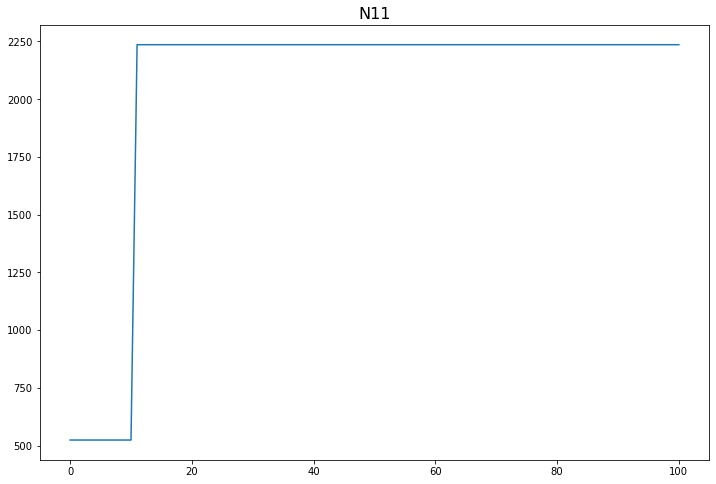

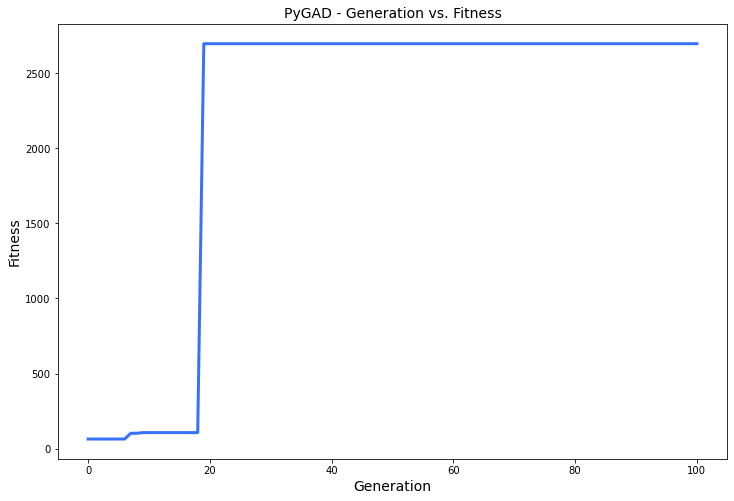

[0.06]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 24.533 |==================| 18.214 |==========
[-0.106]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 24.49 |==================| 10.172 |==========
[-0.963]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.963 |===========| 23.591 |==================| 1.003 |==========
[-0.672]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.672 |===========| 23.916 |==================| 1.488 |==========
[-0.466]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 24.135 |==================| 2.205 |==========
[-0.448]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 24.154 |==================| 2.301 |==========
[0.453]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|===

[0.555]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.555 |===========| 28.892 |==================| 13.556 |==========
[1.049]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.049 |===========| 28.815 |==================| 6.625 |==========
[0.663]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.663 |===========| 28.876 |==================| 11.143 |==========
[-0.581]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.581 |===========| 28.888 |==================| 12.874 |==========
[0.575]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 28.889 |==================| 13.041 |==========
[-0.225]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 28.938 |==================| 35.433 |==========
[-0.894]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 28.955 |==================| 90.262 |==========
[-0.546]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.546 |===========| 28.894 |==================| 13.792 |==========
Fitness = 90.26226335934585
[1.049]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.049 |===========| 28.815 |==================| 6.625 |==========
[0.663]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.663 |===========| 28.876 |==================| 11.143 |==========
[-0.581]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.581 |===========| 28.888 |==================| 12.874 |==========
[0.575]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 28.889 |==================| 13.041 |==========
[-0.225]
=====|SOLUTION|===========|OUTPUT|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 28.955 |==================| 90.262 |==========
[-0.546]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.546 |===========| 28.894 |==================| 13.792 |==========
[1.049]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.049 |===========| 28.815 |==================| 6.625 |==========
[0.663]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.663 |===========| 28.876 |==================| 11.143 |==========
[-0.581]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.581 |===========| 28.888 |==================| 12.874 |==========
[0.575]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 28.889 |==================| 13.041 |==========
[-0.225]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 28.933 |==================| 29.923 |==========
Generation = 2
[-0.898]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.898 |===========| 28.84 |==================| 7.922 |==========
[-0.26]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 28.933 |==================| 30.424 |==========
[-0.875]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.875 |===========| 28.843 |==================| 8.159 |==========
[0.705]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.705 |===========| 28.87 |==================| 10.401 |==========
[-1.031]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.031 |===========| 28.818 |==================| 6.76 |==========
[0.605]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.898 |===========| 28.84 |==================| 7.922 |==========
[-0.26]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 28.933 |==================| 30.424 |==========
[-0.875]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.875 |===========| 28.843 |==================| 8.159 |==========
[0.705]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.705 |===========| 28.87 |==================| 10.401 |==========
[-1.031]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.031 |===========| 28.818 |==================| 6.76 |==========
[0.605]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.605 |===========| 28.885 |==================| 12.311 |==========
[0.666]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 28.926 |==================| 25.05 |==========
[0.563]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.563 |===========| 28.891 |==================| 13.34 |==========
[-0.945]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.945 |===========| 28.832 |==================| 7.475 |==========
[-0.454]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 28.907 |==================| 16.85 |==========
[0.044]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 28.961 |==================| 188.529 |==========
[0.268]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 28.932 |==================| 29.498 |==========
[-0.298]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.563 |===========| 28.891 |==================| 13.34 |==========
[-0.945]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.945 |===========| 28.832 |==================| 7.475 |==========
[-0.454]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 28.907 |==================| 16.85 |==========
[0.044]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 28.961 |==================| 188.529 |==========
[0.268]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 28.932 |==================| 29.498 |==========
[-0.298]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 28.928 |==================| 26.39 |==========
[0.169]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.945 |===========| 28.832 |==================| 7.475 |==========
[-0.454]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 28.907 |==================| 16.85 |==========
[0.044]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 28.961 |==================| 188.529 |==========
[0.268]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 28.932 |==================| 29.498 |==========
[-0.298]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 28.928 |==================| 26.39 |==========
[0.169]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.169 |===========| 28.945 |==================| 47.559 |==========
[-0.399]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 28.948 |==================| 54.191 |==========
[-0.01]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 28.965 |==================| 862.555 |==========
[-0.384]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 28.916 |==================| 20.137 |==========
[0.301]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 28.928 |==================| 26.07 |==========
[0.795]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.795 |===========| 28.856 |==================| 9.091 |==========
[0.725]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 28.867 |==================| 10.075 |==========
[0.131]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.663 |===========| 28.876 |==================| 11.14 |==========
[0.149]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 28.948 |==================| 54.191 |==========
[-0.01]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 28.965 |==================| 862.555 |==========
[-0.384]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 28.916 |==================| 20.137 |==========
[0.301]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 28.928 |==================| 26.07 |==========
[0.795]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.795 |===========| 28.856 |==================| 9.091 |==========
[0.725]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 28.953 |==================| 75.135 |==========
[-0.659]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.659 |===========| 28.877 |==================| 11.208 |==========
[0.387]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 28.916 |==================| 19.999 |==========
[0.027]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 28.963 |==================| 302.006 |==========
[-0.761]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.761 |===========| 28.861 |==================| 9.546 |==========
[-0.719]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.719 |===========| 28.868 |==================| 10.17 |==========
[-0.988]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.404 |===========| 28.914 |==================| 19.099 |==========
[-0.108]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 28.953 |==================| 75.135 |==========
[-0.659]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.659 |===========| 28.877 |==================| 11.208 |==========
[0.387]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 28.916 |==================| 19.999 |==========
[0.027]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 28.963 |==================| 302.006 |==========
[-0.761]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.761 |===========| 28.861 |==================| 9.546 |==========
[-0.719]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 28.919 |==================| 21.375 |==========
[0.404]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.404 |===========| 28.914 |==================| 19.099 |==========
[-0.108]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 28.953 |==================| 75.135 |==========
[-0.659]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.659 |===========| 28.877 |==================| 11.208 |==========
[0.387]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 28.916 |==================| 19.999 |==========
[0.027]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 28.963 |==================| 302.006 |==========
[-0.761]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 28.904 |==================| 16.075 |==========
[0.291]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 28.929 |==================| 27.054 |==========
[0.873]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 28.844 |==================| 8.175 |==========
[0.695]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 28.871 |==================| 10.568 |==========
[0.609]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.609 |===========| 28.884 |==================| 12.231 |==========
[-0.938]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 28.833 |==================| 7.532 |==========
[0.744]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 28.961 |==================| 183.041 |==========
Change = 0.0
[0.474]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 28.904 |==================| 16.075 |==========
[0.291]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 28.929 |==================| 27.054 |==========
[0.873]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 28.844 |==================| 8.175 |==========
[0.695]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 28.871 |==================| 10.568 |==========
[0.609]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.609 |===========| 28.884 |==================| 12.231 |==========
[-0.938]
=====|SOLUTION|===========|OUTPUT|==================|FIT

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 28.961 |==================| 183.041 |==========
[0.091]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 28.955 |==================| 90.219 |==========
[-0.204]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 28.941 |==================| 39.193 |==========
[-0.347]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 28.922 |==================| 22.49 |==========
[0.682]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.682 |===========| 28.873 |==================| 10.787 |==========
[0.658]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.658 |===========| 28.877 |==================| 11.228 |==========
[-0.706]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 28.904 |==================| 16.135 |==========
Fitness = 862.5548363125946
[0.091]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 28.955 |==================| 90.219 |==========
[-0.204]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 28.941 |==================| 39.193 |==========
[-0.347]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 28.922 |==================| 22.49 |==========
[0.682]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.682 |===========| 28.873 |==================| 10.787 |==========
[0.658]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.658 |===========| 28.877 |==================| 11.228 |==========
[-0.706]
=====|SOLUTION|===========|OUTPUT|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 28.876 |==================| 11.08 |==========
[0.472]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 28.904 |==================| 16.135 |==========
[0.091]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 28.955 |==================| 90.219 |==========
[-0.204]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 28.941 |==================| 39.193 |==========
[-0.347]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 28.922 |==================| 22.49 |==========
[0.682]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.682 |===========| 28.873 |==================| 10.787 |==========
[0.658]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 28.957 |==================| 110.759 |==========
[0.933]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.933 |===========| 28.834 |==================| 7.579 |==========
[-0.203]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 28.941 |==================| 39.418 |==========
Generation = 8
[0.99]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.99 |===========| 28.825 |==================| 7.082 |==========
[0.615]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.615 |===========| 28.883 |==================| 12.102 |==========
[-0.537]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.537 |===========| 28.895 |==================| 14.054 |==========
[0.773]
=====|SOLUTION|===========|OUTPUT|==================|FIT

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 28.941 |==================| 39.305 |==========
[-0.074]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 28.957 |==================| 110.759 |==========
[0.933]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.933 |===========| 28.834 |==================| 7.579 |==========
[-0.203]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 28.941 |==================| 39.418 |==========
Change = 0.0
[0.99]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.99 |===========| 28.825 |==================| 7.082 |==========
[0.615]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.615 |===========| 28.883 |==================| 12.102 |==========
[-0.537]
=====|SOLUTION|===========|OUTPUT|==================|FITN

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 28.941 |==================| 39.305 |==========
[-0.074]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 28.957 |==================| 110.759 |==========
[0.933]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.933 |===========| 28.834 |==================| 7.579 |==========
[-0.203]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 28.941 |==================| 39.418 |==========
[0.161]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 28.946 |==================| 50.135 |==========
[-0.867]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.867 |===========| 28.845 |==================| 8.243 |==========
[0.383]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.558 |===========| 28.892 |==================| 13.47 |==========
[-0.165]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 28.946 |==================| 48.955 |==========
[0.307]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.307 |===========| 28.927 |==================| 25.587 |==========
[-0.64]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.64 |===========| 28.88 |==================| 11.575 |==========
Fitness = 862.5548363125946
[0.161]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 28.946 |==================| 50.135 |==========
[-0.867]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.867 |===========| 28.845 |==================| 8.243 |==========
[0.383]
=====|SOLUTION|===========|OUTPUT|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 28.946 |==================| 48.955 |==========
[0.307]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.307 |===========| 28.927 |==================| 25.587 |==========
[-0.64]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.64 |===========| 28.88 |==================| 11.575 |==========
[0.161]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 28.946 |==================| 50.135 |==========
[-0.867]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.867 |===========| 28.845 |==================| 8.243 |==========
[0.383]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 28.917 |==================| 20.208 |==========
[0.702]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 28.922 |==================| 22.503 |==========
[-0.807]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.807 |===========| 28.854 |==================| 8.935 |==========
[0.207]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 28.94 |==================| 38.562 |==========
Generation = 10
[-0.171]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 28.945 |==================| 47.173 |==========
[0.834]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.834 |===========| 28.85 |==================| 8.61 |==========
[0.287]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 28.93 |==================| 27.468 |==========
[0.468]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.807 |===========| 28.854 |==================| 8.935 |==========
[0.207]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 28.94 |==================| 38.562 |==========
Change = 0.0
[-0.171]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 28.945 |==================| 47.173 |==========
[0.834]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.834 |===========| 28.85 |==================| 8.61 |==========
[0.287]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 28.93 |==================| 27.468 |==========
[0.468]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 28.905 |==================| 16.283 |==========
[-0.959]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.807 |===========| 28.854 |==================| 8.935 |==========
[0.207]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 28.94 |==================| 38.562 |==========
[0.311]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 28.926 |==================| 25.251 |==========
[0.216]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 28.939 |==================| 36.869 |==========
[0.666]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 28.876 |==================| 11.087 |==========
[0.445]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 28.908 |==================| 17.226 |==========
[0.665]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.818 |===========| 28.853 |==================| 8.807 |==========
[-0.192]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 28.942 |==================| 41.737 |==========
[-0.173]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 28.945 |==================| 46.623 |==========
Fitness = 862.5548363125946
[0.311]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 28.926 |==================| 25.251 |==========
[0.216]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 28.939 |==================| 36.869 |==========
[0.666]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 28.876 |==================| 11.087 |==========
[0.445]
=====|SOLUTION|===========|OUTPUT|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 28.935 |==================| 32.428 |==========
[0.818]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.818 |===========| 28.853 |==================| 8.807 |==========
[-0.192]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 28.942 |==================| 41.737 |==========
[-0.173]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 28.945 |==================| 46.623 |==========
[0.311]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 28.926 |==================| 25.251 |==========
[0.216]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 28.939 |==================| 36.869 |==========
[0.666]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.974 |===========| 28.827 |==================| 7.216 |==========
[0.148]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 28.948 |==================| 54.778 |==========
[0.65]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.65 |===========| 28.878 |==================| 11.386 |==========
[0.162]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 28.946 |==================| 49.867 |==========
Generation = 12
[-0.688]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.688 |===========| 28.872 |==================| 10.685 |==========
[-0.17]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 28.945 |==================| 47.362 |==========
[0.37]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

[0.65]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.65 |===========| 28.878 |==================| 11.386 |==========
[0.162]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 28.946 |==================| 49.867 |==========
Change = 0.0
[-0.688]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.688 |===========| 28.872 |==================| 10.685 |==========
[-0.17]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 28.945 |==================| 47.362 |==========
[0.37]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 28.918 |==================| 20.97 |==========
[0.664]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.664 |===========| 28.876 |==================| 11.114 |==========
[-0.782]
=====|SOLUTION|===========|OUTPUT|==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 28.946 |==================| 49.867 |==========
[0.917]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 28.837 |==================| 7.731 |==========
[0.402]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 28.914 |==================| 19.189 |==========
[-0.14]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 28.949 |==================| 58.026 |==========
[-0.029]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 28.963 |==================| 284.375 |==========
[0.753]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.753 |===========| 28.863 |==================| 9.664 |==========
[0.648]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 28.831 |==================| 7.427 |==========
[-0.656]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.656 |===========| 28.877 |==================| 11.274 |==========
Fitness = 862.5548363125946
[0.917]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 28.837 |==================| 7.731 |==========
[0.402]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 28.914 |==================| 19.189 |==========
[-0.14]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 28.949 |==================| 58.026 |==========
[-0.029]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 28.963 |==================| 284.375 |==========
[0.753]
=====|SOLUTION|===========|OUTPUT|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 28.831 |==================| 7.427 |==========
[-0.656]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.656 |===========| 28.877 |==================| 11.274 |==========
[0.917]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 28.837 |==================| 7.731 |==========
[0.402]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 28.914 |==================| 19.189 |==========
[-0.14]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 28.949 |==================| 58.026 |==========
[-0.029]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 28.963 |==================| 284.375 |==========
[0.753]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 28.939 |==================| 37.028 |==========
Generation = 14
[-0.886]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.886 |===========| 28.842 |==================| 8.045 |==========
[0.342]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 28.922 |==================| 22.833 |==========
[0.037]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.037 |===========| 28.962 |==================| 223.55 |==========
[0.69]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 28.872 |==================| 10.645 |==========
[-0.896]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.896 |===========| 28.84 |==================| 7.937 |==========
[0.78]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 28.93 |==================| 28.028 |==========
[0.216]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 28.939 |==================| 37.028 |==========
Change = 0.0
[-0.886]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.886 |===========| 28.842 |==================| 8.045 |==========
[0.342]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 28.922 |==================| 22.833 |==========
[0.037]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.037 |===========| 28.962 |==================| 223.55 |==========
[0.69]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 28.872 |==================| 10.645 |==========
[-0.896]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 28.93 |==================| 28.028 |==========
[0.216]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 28.939 |==================| 37.028 |==========
[-0.953]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.953 |===========| 28.831 |==================| 7.403 |==========
[-0.818]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.818 |===========| 28.852 |==================| 8.806 |==========
[0.643]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.643 |===========| 28.879 |==================| 11.527 |==========
[0.246]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 28.935 |==================| 32.251 |==========
[0.253]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.97 |===========| 28.828 |==================| 7.249 |==========
[-0.598]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.598 |===========| 28.886 |==================| 12.491 |==========
[-0.488]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 28.902 |==================| 15.569 |==========
Fitness = 862.5548363125946
[-0.953]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.953 |===========| 28.831 |==================| 7.403 |==========
[-0.818]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.818 |===========| 28.852 |==================| 8.806 |==========
[0.643]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.643 |===========| 28.879 |==================| 11.527 |==========
[0.246]
=====|SOLUTION|===========|OUTPUT|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.598 |===========| 28.886 |==================| 12.491 |==========
[-0.488]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 28.902 |==================| 15.569 |==========
[-0.953]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.953 |===========| 28.831 |==================| 7.403 |==========
[-0.818]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.818 |===========| 28.852 |==================| 8.806 |==========
[0.643]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.643 |===========| 28.879 |==================| 11.527 |==========
[0.246]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 28.935 |==================| 32.251 |==========
[0.253]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.99 |===========| 28.825 |==================| 7.086 |==========
Generation = 16
[0.894]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.894 |===========| 28.84 |==================| 7.961 |==========
[-0.884]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 28.842 |==================| 8.068 |==========
[-0.226]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 28.938 |==================| 35.28 |==========
[-0.987]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.987 |===========| 28.825 |==================| 7.106 |==========
[0.584]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.584 |===========| 28.888 |==================| 12.802 |==========
[-0.178]
=====|SOLUTION|===========|OUTPUT|==================|FITN

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.794 |===========| 28.856 |==================| 9.11 |==========
[0.99]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.99 |===========| 28.825 |==================| 7.086 |==========
Change = 0.0
[0.894]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.894 |===========| 28.84 |==================| 7.961 |==========
[-0.884]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 28.842 |==================| 8.068 |==========
[-0.226]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 28.938 |==================| 35.28 |==========
[-0.987]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.987 |===========| 28.825 |==================| 7.106 |==========
[0.584]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.7 |===========| 28.871 |==================| 10.477 |==========
[-0.794]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.794 |===========| 28.856 |==================| 9.11 |==========
[0.99]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.99 |===========| 28.825 |==================| 7.086 |==========
[-0.19]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 28.942 |==================| 42.24 |==========
[-0.423]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 28.911 |==================| 18.184 |==========
[0.77]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.77 |===========| 28.86 |==================| 9.425 |==========
[0.297]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 28.931 |==================| 28.648 |==========
[-0.623]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.623 |===========| 28.882 |==================| 11.939 |==========
[0.831]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 28.85 |==================| 8.65 |==========
[0.267]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 28.932 |==================| 29.567 |==========
Fitness = 862.5548363125946
[-0.19]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 28.942 |==================| 42.24 |==========
[-0.423]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 28.911 |==================| 18.184 |==========
[0.77]
=====|SOLUTION|===========|OUTPUT|============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 28.954 |==================| 85.56 |==========
[-0.276]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 28.931 |==================| 28.648 |==========
[-0.623]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.623 |===========| 28.882 |==================| 11.939 |==========
[0.831]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 28.85 |==================| 8.65 |==========
[0.267]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 28.932 |==================| 29.567 |==========
[-0.19]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 28.942 |==================| 42.24 |==========
[-0.423]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.795 |===========| 28.856 |==================| 9.086 |==========
[0.149]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 28.948 |==================| 54.229 |==========
[-0.032]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 28.962 |==================| 261.067 |==========
[-0.736]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.736 |===========| 28.865 |==================| 9.911 |==========
[0.02]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 28.964 |==================| 423.058 |==========
Generation = 18
[-0.729]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.729 |===========| 28.866 |==================| 10.023 |==========
[0.752]
=====|SOLUTION|===========|OUTPUT|==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 28.953 |==================| 75.559 |==========
[0.795]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.795 |===========| 28.856 |==================| 9.086 |==========
[0.149]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 28.948 |==================| 54.229 |==========
[-0.032]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 28.962 |==================| 261.067 |==========
[-0.736]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.736 |===========| 28.865 |==================| 9.911 |==========
[0.02]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 28.964 |==================| 423.058 |==========
Change = 0.0
[-0.729]
=====|SOLUTION|===========|OUTPUT|==================|FIT

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 28.929 |==================| 27.111 |==========
[0.108]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 28.953 |==================| 75.559 |==========
[0.795]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.795 |===========| 28.856 |==================| 9.086 |==========
[0.149]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 28.948 |==================| 54.229 |==========
[-0.032]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 28.962 |==================| 261.067 |==========
[-0.736]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.736 |===========| 28.865 |==================| 9.911 |==========
[0.02]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.612 |===========| 28.884 |==================| 12.157 |==========
[0.211]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 28.94 |==================| 37.872 |==========
[0.56]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.56 |===========| 28.892 |==================| 13.422 |==========
[0.865]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 28.845 |==================| 8.262 |==========
[-0.756]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.756 |===========| 28.862 |==================| 9.614 |==========
[0.975]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.975 |===========| 28.827 |==================| 7.208 |==========
[0.772]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.636 |===========| 28.88 |==================| 11.654 |==========
[-0.612]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.612 |===========| 28.884 |==================| 12.157 |==========
[0.211]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 28.94 |==================| 37.872 |==========
[0.56]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.56 |===========| 28.892 |==================| 13.422 |==========
[0.865]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 28.845 |==================| 8.262 |==========
[-0.756]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.756 |===========| 28.862 |==================| 9.614 |==========
[0.975]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 28.905 |==================| 16.512 |==========
[0.133]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 28.95 |==================| 60.845 |==========
[0.616]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.616 |===========| 28.883 |==================| 12.085 |==========
[0.806]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.806 |===========| 28.854 |==================| 8.953 |==========
[0.371]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 28.918 |==================| 20.892 |==========
[-0.884]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 28.842 |==================| 8.065 |==========
[0.182]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 28.905 |==================| 16.512 |==========
[0.133]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 28.95 |==================| 60.845 |==========
[0.616]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.616 |===========| 28.883 |==================| 12.085 |==========
[0.806]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.806 |===========| 28.854 |==================| 8.953 |==========
[0.371]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 28.918 |==================| 20.892 |==========
[-0.884]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 28.842 |==================| 8.065 |==========
[0.182]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 28.905 |==================| 16.512 |==========
[0.133]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 28.95 |==================| 60.845 |==========
[0.616]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.616 |===========| 28.883 |==================| 12.085 |==========
[0.806]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.806 |===========| 28.854 |==================| 8.953 |==========
[0.371]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 28.918 |==================| 20.892 |==========
[-0.884]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 28.842 |==================| 8.065 |==========
[0.182]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.979 |===========| 28.827 |==================| 7.176 |==========
[0.281]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 28.93 |==================| 28.086 |==========
[0.155]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 28.947 |==================| 51.948 |==========
[-0.882]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 28.842 |==================| 8.086 |==========
[0.701]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.701 |===========| 28.871 |==================| 10.472 |==========
[0.477]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.477 |===========| 28.903 |==================| 15.985 |==========
[0.71]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 28.902 |==================| 15.561 |==========
[-0.979]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.979 |===========| 28.827 |==================| 7.176 |==========
[0.281]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 28.93 |==================| 28.086 |==========
[0.155]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 28.947 |==================| 51.948 |==========
[-0.882]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 28.842 |==================| 8.086 |==========
[0.701]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.701 |===========| 28.871 |==================| 10.472 |==========
[0.477]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 28.946 |==================| 51.063 |==========
[0.782]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 28.858 |==================| 9.26 |==========
[-0.732]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.732 |===========| 28.866 |==================| 9.968 |==========
[-0.142]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.142 |===========| 28.949 |==================| 57.141 |==========
[0.318]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 28.925 |==================| 24.613 |==========
[-0.394]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 28.915 |==================| 19.602 |==========
[0.483]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 28.858 |==================| 9.26 |==========
[-0.732]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.732 |===========| 28.866 |==================| 9.968 |==========
[-0.142]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.142 |===========| 28.949 |==================| 57.141 |==========
[0.318]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 28.925 |==================| 24.613 |==========
[-0.394]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 28.915 |==================| 19.602 |==========
[0.483]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 28.903 |==================| 15.764 |==========
[0.368]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.142 |===========| 28.949 |==================| 57.141 |==========
[0.318]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 28.925 |==================| 24.613 |==========
[-0.394]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 28.915 |==================| 19.602 |==========
[0.483]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 28.903 |==================| 15.764 |==========
[0.368]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 28.919 |==================| 21.123 |==========
[-0.246]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 28.935 |==================| 32.25 |==========
[0.471]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 28.934 |==================| 31.686 |==========
[-0.26]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 28.933 |==================| 30.422 |==========
[-0.23]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 28.937 |==================| 34.618 |==========
[-0.417]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 28.912 |==================| 18.46 |==========
[-0.349]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 28.921 |==================| 22.344 |==========
[-0.424]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 28.911 |==================| 18.13 |==========
Fitness = 2504.160971008313
[0.471]
=====|SOLUTION|===========|OUTPUT|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 28.966 |==================| 2504.161 |==========
[-0.25]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 28.934 |==================| 31.686 |==========
[-0.26]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 28.933 |==================| 30.422 |==========
[-0.23]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 28.937 |==================| 34.618 |==========
[-0.417]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 28.912 |==================| 18.46 |==========
[-0.349]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 28.921 |==================| 22.344 |==========
[-0.424]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.889 |===========| 28.841 |==================| 8.011 |==========
[0.302]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 28.928 |==================| 26.044 |==========
[-0.624]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.624 |===========| 28.882 |==================| 11.909 |==========
[0.509]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.509 |===========| 28.899 |==================| 14.889 |==========
[-0.153]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 28.947 |==================| 52.608 |==========
[-0.004]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 28.966 |==================| 2194.015 |==========
Generation = 24
[0.63]
=====|SOLUTION|===========|OUTPUT|=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.889 |===========| 28.841 |==================| 8.011 |==========
[0.302]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 28.928 |==================| 26.044 |==========
[-0.624]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.624 |===========| 28.882 |==================| 11.909 |==========
[0.509]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.509 |===========| 28.899 |==================| 14.889 |==========
[-0.153]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 28.947 |==================| 52.608 |==========
[-0.004]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 28.966 |==================| 2194.015 |==========
Change = 0.0
[0.63]
=====|SOLUTION|===========|OUTPUT|==================|F

[-0.624]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.624 |===========| 28.882 |==================| 11.909 |==========
[0.509]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.509 |===========| 28.899 |==================| 14.889 |==========
[-0.153]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 28.947 |==================| 52.608 |==========
[-0.004]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 28.966 |==================| 2194.015 |==========
[0.488]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 28.902 |==================| 15.575 |==========
[0.838]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 28.849 |==================| 8.565 |==========
[0.114]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 28.863 |==================| 9.707 |==========
[0.424]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 28.911 |==================| 18.143 |==========
[-0.501]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.501 |===========| 28.9 |==================| 15.15 |==========
Fitness = 2504.160971008313
[0.488]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 28.902 |==================| 15.575 |==========
[0.838]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 28.849 |==================| 8.565 |==========
[0.114]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 28.952 |==================| 71.635 |==========
[-0.631]
=====|SOLUTION|===========|OUTPUT|============

[-0.075]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 28.957 |==================| 108.969 |==========
[0.75]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 28.863 |==================| 9.707 |==========
[0.424]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 28.911 |==================| 18.143 |==========
[-0.501]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.501 |===========| 28.9 |==================| 15.15 |==========
[0.488]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 28.902 |==================| 15.575 |==========
[0.838]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 28.849 |==================| 8.565 |==========
[0.114]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

[0.516]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 28.898 |==================| 14.654 |==========
[-0.297]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 28.928 |==================| 26.516 |==========
Generation = 26
[0.597]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.597 |===========| 28.886 |==================| 12.498 |==========
[-0.496]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 28.901 |==================| 15.307 |==========
[0.646]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.646 |===========| 28.879 |==================| 11.453 |==========
[-0.4]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 28.914 |==================| 19.316 |==========
[0.244]
=====|SOLUTION|===========|OUTPUT|=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 28.958 |==================| 117.787 |==========
[0.516]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 28.898 |==================| 14.654 |==========
[-0.297]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 28.928 |==================| 26.516 |==========
Change = 0.0
[0.597]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.597 |===========| 28.886 |==================| 12.498 |==========
[-0.496]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 28.901 |==================| 15.307 |==========
[0.646]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.646 |===========| 28.879 |==================| 11.453 |==========
[-0.4]
=====|SOLUTION|===========|OUTPUT|==================|FIT

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 28.898 |==================| 14.654 |==========
[-0.297]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 28.928 |==================| 26.516 |==========
[-0.422]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 28.911 |==================| 18.218 |==========
[0.138]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 28.949 |==================| 58.626 |==========
[0.89]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.89 |===========| 28.841 |==================| 8.001 |==========
[0.294]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 28.929 |==================| 26.762 |==========
[0.525]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

[-0.422]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 28.911 |==================| 18.218 |==========
[0.138]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 28.949 |==================| 58.626 |==========
[0.89]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.89 |===========| 28.841 |==================| 8.001 |==========
[0.294]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 28.929 |==================| 26.762 |==========
[0.525]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.525 |===========| 28.897 |==================| 14.396 |==========
[-0.249]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 28.935 |==================| 31.818 |==========
[-0.113]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 28.911 |==================| 18.218 |==========
[0.138]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 28.949 |==================| 58.626 |==========
[0.89]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.89 |===========| 28.841 |==================| 8.001 |==========
[0.294]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 28.929 |==================| 26.762 |==========
[0.525]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.525 |===========| 28.897 |==================| 14.396 |==========
[-0.249]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 28.935 |==================| 31.818 |==========
[-0.113]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.649 |===========| 28.878 |==================| 11.4 |==========
Generation = 28
[-0.079]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 28.956 |==================| 103.02 |==========
[0.524]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.524 |===========| 28.897 |==================| 14.421 |==========
[0.085]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 28.956 |==================| 96.505 |==========
[0.013]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 28.964 |==================| 620.901 |==========
[-0.857]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.857 |===========| 28.846 |==================| 8.355 |==========
[0.06]
=====|SOLUTION|===========|OUTPUT|==================|FI

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 28.956 |==================| 103.02 |==========
[0.524]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.524 |===========| 28.897 |==================| 14.421 |==========
[0.085]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 28.956 |==================| 96.505 |==========
[0.013]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 28.964 |==================| 620.901 |==========
[-0.857]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.857 |===========| 28.846 |==================| 8.355 |==========
[0.06]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 28.959 |==================| 136.566 |==========
[-0.226]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.712 |===========| 28.869 |==================| 10.29 |==========
[-0.568]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.568 |===========| 28.89 |==================| 13.212 |==========
[0.205]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 28.94 |==================| 39.081 |==========
[0.059]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 28.959 |==================| 138.214 |==========
[-0.98]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.98 |===========| 28.826 |==================| 7.164 |==========
[0.774]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.774 |===========| 28.859 |==================| 9.372 |==========
[0.876]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.568 |===========| 28.89 |==================| 13.212 |==========
[0.205]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 28.94 |==================| 39.081 |==========
[0.059]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 28.959 |==================| 138.214 |==========
[-0.98]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.98 |===========| 28.826 |==================| 7.164 |==========
[0.774]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.774 |===========| 28.859 |==================| 9.372 |==========
[0.876]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.876 |===========| 28.843 |==================| 8.147 |==========
[-0.06]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.568 |===========| 28.89 |==================| 13.212 |==========
[0.205]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 28.94 |==================| 39.081 |==========
[0.059]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 28.959 |==================| 138.214 |==========
[-0.98]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.98 |===========| 28.826 |==================| 7.164 |==========
[0.774]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.774 |===========| 28.859 |==================| 9.372 |==========
[0.876]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.876 |===========| 28.843 |==================| 8.147 |==========
[-0.06]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.886 |===========| 28.842 |==================| 8.042 |==========
[-0.765]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 28.861 |==================| 9.487 |==========
[0.799]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.799 |===========| 28.855 |==================| 9.038 |==========
[-0.474]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 28.904 |==================| 16.077 |==========
[-0.583]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.583 |===========| 28.888 |==================| 12.833 |==========
[-0.579]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 28.889 |==================| 12.925 |==========
[-0.756]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 28.948 |==================| 56.508 |==========
[-0.886]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.886 |===========| 28.842 |==================| 8.042 |==========
[-0.765]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 28.861 |==================| 9.487 |==========
[0.799]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.799 |===========| 28.855 |==================| 9.038 |==========
[-0.474]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 28.904 |==================| 16.077 |==========
[-0.583]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.583 |===========| 28.888 |==================| 12.833 |==========
[-0.579]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.833 |===========| 28.85 |==================| 8.624 |==========
[-0.48]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 28.903 |==================| 15.873 |==========
[0.728]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.728 |===========| 28.866 |==================| 10.029 |==========
[-0.883]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 28.842 |==================| 8.078 |==========
[-0.293]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 28.929 |==================| 26.903 |==========
[-0.426]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 28.911 |==================| 18.035 |==========
[-0.944]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.844 |===========| 28.848 |==================| 8.503 |==========
[0.833]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.833 |===========| 28.85 |==================| 8.624 |==========
[-0.48]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 28.903 |==================| 15.873 |==========
[0.728]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.728 |===========| 28.866 |==================| 10.029 |==========
[-0.883]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 28.842 |==================| 8.078 |==========
[-0.293]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 28.929 |==================| 26.903 |==========
[-0.426]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.844 |===========| 28.848 |==================| 8.503 |==========
[0.833]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.833 |===========| 28.85 |==================| 8.624 |==========
[-0.48]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 28.903 |==================| 15.873 |==========
[0.728]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.728 |===========| 28.866 |==================| 10.029 |==========
[-0.883]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 28.842 |==================| 8.078 |==========
[-0.293]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 28.929 |==================| 26.903 |==========
[-0.426]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.76 |===========| 28.862 |==================| 9.565 |==========
[-0.543]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.543 |===========| 28.894 |==================| 13.867 |==========
[0.746]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.746 |===========| 28.864 |==================| 9.768 |==========
[-0.755]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.755 |===========| 28.862 |==================| 9.639 |==========
[-0.539]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.539 |===========| 28.895 |==================| 13.998 |==========
[0.043]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 28.961 |==================| 190.695 |==========
[0.075]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.76 |===========| 28.862 |==================| 9.565 |==========
[-0.543]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.543 |===========| 28.894 |==================| 13.867 |==========
[0.746]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.746 |===========| 28.864 |==================| 9.768 |==========
[-0.755]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.755 |===========| 28.862 |==================| 9.639 |==========
[-0.539]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.539 |===========| 28.895 |==================| 13.998 |==========
[0.043]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 28.961 |==================| 190.695 |==========
[0.075]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |===========| 28.925 |==================| 24.232 |==========
[-0.822]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.822 |===========| 28.852 |==================| 8.761 |==========
[0.211]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 28.94 |==================| 37.909 |==========
[0.695]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 28.871 |==================| 10.572 |==========
[-0.237]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 28.936 |==================| 33.503 |==========
[-0.551]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 28.893 |==================| 13.64 |==========
[0.071]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.822 |===========| 28.852 |==================| 8.761 |==========
[0.211]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 28.94 |==================| 37.909 |==========
[0.695]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 28.871 |==================| 10.572 |==========
[-0.237]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 28.936 |==================| 33.503 |==========
[-0.551]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 28.893 |==================| 13.64 |==========
[0.071]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 28.957 |==================| 115.138 |==========
[0.709]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.822 |===========| 28.852 |==================| 8.761 |==========
[0.211]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 28.94 |==================| 37.909 |==========
[0.695]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 28.871 |==================| 10.572 |==========
[-0.237]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 28.936 |==================| 33.503 |==========
[-0.551]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 28.893 |==================| 13.64 |==========
[0.071]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 28.957 |==================| 115.138 |==========
[0.709]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 28.936 |==================| 32.959 |==========
[-0.18]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 28.944 |==================| 44.566 |==========
[0.153]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 28.947 |==================| 52.611 |==========
[0.164]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 28.946 |==================| 49.216 |==========
[-0.292]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 28.929 |==================| 26.994 |==========
[0.891]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.891 |===========| 28.841 |==================| 7.994 |==========
[-0.046]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.689 |===========| 28.872 |==================| 10.667 |==========
Change = 0.0
[0.241]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 28.936 |==================| 32.959 |==========
[-0.18]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 28.944 |==================| 44.566 |==========
[0.153]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 28.947 |==================| 52.611 |==========
[0.164]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 28.946 |==================| 49.216 |==========
[-0.292]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 28.929 |==================| 26.994 |==========
[0.891]
=====|SOLUTION|===========|OUTPUT|==================|FITN

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.689 |===========| 28.872 |==================| 10.667 |==========
[-0.122]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.122 |===========| 28.951 |==================| 66.321 |==========
[-0.708]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.708 |===========| 28.87 |==================| 10.357 |==========
[0.195]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 28.942 |==================| 41.149 |==========
[0.676]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.676 |===========| 28.874 |==================| 10.903 |==========
[-0.296]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 28.928 |==================| 26.53 |==========
[-0.741]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 28.849 |==================| 8.569 |==========
[0.035]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 28.962 |==================| 233.795 |==========
Fitness = 2504.160971008313
[-0.122]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.122 |===========| 28.951 |==================| 66.321 |==========
[-0.708]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.708 |===========| 28.87 |==================| 10.357 |==========
[0.195]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 28.942 |==================| 41.149 |==========
[0.676]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.676 |===========| 28.874 |==================| 10.903 |==========
[-0.296]
=====|SOLUTION|===========|OUTPUT|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 28.849 |==================| 8.569 |==========
[0.035]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 28.962 |==================| 233.795 |==========
[-0.122]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.122 |===========| 28.951 |==================| 66.321 |==========
[-0.708]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.708 |===========| 28.87 |==================| 10.357 |==========
[0.195]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 28.942 |==================| 41.149 |==========
[0.676]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.676 |===========| 28.874 |==================| 10.903 |==========
[-0.296]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 28.919 |==================| 21.152 |==========
[-0.283]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 28.93 |==================| 27.858 |==========
[0.344]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 28.922 |==================| 22.636 |==========
Generation = 36
[0.459]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 28.906 |==================| 16.666 |==========
[0.855]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.855 |===========| 28.847 |==================| 8.369 |==========
[0.409]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 28.913 |==================| 18.86 |==========
[0.908]
=====|SOLUTION|===========|OUTPUT|==================|FIT

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 28.93 |==================| 27.858 |==========
[0.344]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 28.922 |==================| 22.636 |==========
Change = 0.0
[0.459]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 28.906 |==================| 16.666 |==========
[0.855]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.855 |===========| 28.847 |==================| 8.369 |==========
[0.409]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 28.913 |==================| 18.86 |==========
[0.908]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.908 |===========| 28.838 |==================| 7.822 |==========
[0.822]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 28.93 |==================| 27.858 |==========
[0.344]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 28.922 |==================| 22.636 |==========
[-0.616]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.616 |===========| 28.883 |==================| 12.08 |==========
[-0.097]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 28.954 |==================| 84.353 |==========
[-0.932]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.932 |===========| 28.834 |==================| 7.587 |==========
[0.716]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.716 |===========| 28.868 |==================| 10.217 |==========
[0.396]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.926 |===========| 28.835 |==================| 7.649 |==========
[-0.82]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.82 |===========| 28.852 |==================| 8.783 |==========
Fitness = 2504.160971008313
[-0.616]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.616 |===========| 28.883 |==================| 12.08 |==========
[-0.097]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 28.954 |==================| 84.353 |==========
[-0.932]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.932 |===========| 28.834 |==================| 7.587 |==========
[0.716]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.716 |===========| 28.868 |==================| 10.217 |==========
[0.396]
=====|SOLUTION|===========|OUTPUT|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.926 |===========| 28.835 |==================| 7.649 |==========
[-0.82]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.82 |===========| 28.852 |==================| 8.783 |==========
[-0.616]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.616 |===========| 28.883 |==================| 12.08 |==========
[-0.097]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 28.954 |==================| 84.353 |==========
[-0.932]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.932 |===========| 28.834 |==================| 7.587 |==========
[0.716]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.716 |===========| 28.868 |==================| 10.217 |==========
[0.396]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 28.924 |==================| 23.626 |==========
[-0.197]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 28.941 |==================| 40.624 |==========
Generation = 38
[-0.299]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 28.928 |==================| 26.295 |==========
[-0.51]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 28.899 |==================| 14.867 |==========
[-0.954]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.954 |===========| 28.831 |==================| 7.393 |==========
[0.738]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.738 |===========| 28.865 |==================| 9.879 |==========
[-0.009]
=====|SOLUTION|===========|OUTPUT|==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 28.924 |==================| 23.626 |==========
[-0.197]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 28.941 |==================| 40.624 |==========
Change = 0.0
[-0.299]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 28.928 |==================| 26.295 |==========
[-0.51]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 28.899 |==================| 14.867 |==========
[-0.954]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.954 |===========| 28.831 |==================| 7.393 |==========
[0.738]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.738 |===========| 28.865 |==================| 9.879 |==========
[-0.009]
=====|SOLUTION|===========|OUTPUT|==================|FIT

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.526 |===========| 28.896 |==================| 14.376 |==========
[0.331]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 28.924 |==================| 23.626 |==========
[-0.197]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 28.941 |==================| 40.624 |==========
[0.202]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 28.941 |==================| 39.649 |==========
[-0.077]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 28.957 |==================| 106.818 |==========
[-0.93]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.93 |===========| 28.835 |==================| 7.612 |==========
[-0.883]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.994 |===========| 28.824 |==================| 7.053 |==========
[0.75]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 28.863 |==================| 9.707 |==========
Fitness = 4223.822831699468
[0.202]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 28.941 |==================| 39.649 |==========
[-0.077]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 28.957 |==================| 106.818 |==========
[-0.93]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.93 |===========| 28.835 |==================| 7.612 |==========
[-0.883]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 28.842 |==================| 8.077 |==========
[0.212]
=====|SOLUTION|===========|OUTPUT|============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 28.966 |==================| 4223.823 |==========
[0.994]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.994 |===========| 28.824 |==================| 7.053 |==========
[0.75]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 28.863 |==================| 9.707 |==========
[0.202]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 28.941 |==================| 39.649 |==========
[-0.077]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 28.957 |==================| 106.818 |==========
[-0.93]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.93 |===========| 28.835 |==================| 7.612 |==========
[-0.883]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.898 |===========| 28.84 |==================| 7.915 |==========
[-0.233]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 28.937 |==================| 34.212 |==========
[-0.98]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.98 |===========| 28.827 |==================| 7.17 |==========
[0.621]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.621 |===========| 28.882 |==================| 11.963 |==========
Generation = 40
[-0.092]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 28.955 |==================| 88.518 |==========
[0.664]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.664 |===========| 28.876 |==================| 11.111 |==========
[-0.001]
=====|SOLUTION|===========|OUTPUT|==================|FIT

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 28.937 |==================| 34.212 |==========
[-0.98]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.98 |===========| 28.827 |==================| 7.17 |==========
[0.621]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.621 |===========| 28.882 |==================| 11.963 |==========
Change = 6400.838535358927
[-0.092]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 28.955 |==================| 88.518 |==========
[0.664]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.664 |===========| 28.876 |==================| 11.111 |==========
[-0.001]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 28.966 |==================| 10624.661 |==========
[0.597]
=====|SOLUTION|===========|OUTPUT|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.98 |===========| 28.827 |==================| 7.17 |==========
[0.621]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.621 |===========| 28.882 |==================| 11.963 |==========
[0.205]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 28.94 |==================| 39.064 |==========
[-0.459]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 28.906 |==================| 16.65 |==========
[0.735]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.735 |===========| 28.865 |==================| 9.929 |==========
[-0.989]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.989 |===========| 28.825 |==================| 7.094 |==========
[-0.97]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 28.916 |==================| 19.858 |==========
[0.046]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 28.96 |==================| 179.896 |==========
Fitness = 10624.661367058396
[0.205]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 28.94 |==================| 39.064 |==========
[-0.459]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 28.906 |==================| 16.65 |==========
[0.735]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.735 |===========| 28.865 |==================| 9.929 |==========
[-0.989]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.989 |===========| 28.825 |==================| 7.094 |==========
[-0.97]
=====|SOLUTION|===========|OUTPUT|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 28.963 |==================| 305.874 |==========
[-0.389]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 28.916 |==================| 19.858 |==========
[0.046]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 28.96 |==================| 179.896 |==========
[0.205]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 28.94 |==================| 39.064 |==========
[-0.459]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 28.906 |==================| 16.65 |==========
[0.735]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.735 |===========| 28.865 |==================| 9.929 |==========
[-0.989]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 28.936 |==================| 33.167 |==========
[-0.09]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 28.955 |==================| 91.135 |==========
[0.737]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 28.865 |==================| 9.906 |==========
[-0.318]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 28.925 |==================| 24.649 |==========
Generation = 42
[0.706]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.706 |===========| 28.87 |==================| 10.383 |==========
[0.132]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 28.95 |==================| 61.342 |==========
[0.755]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

[-0.09]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 28.955 |==================| 91.135 |==========
[0.737]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 28.865 |==================| 9.906 |==========
[-0.318]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 28.925 |==================| 24.649 |==========
Change = 0.0
[0.706]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.706 |===========| 28.87 |==================| 10.383 |==========
[0.132]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 28.95 |==================| 61.342 |==========
[0.755]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.755 |===========| 28.862 |==================| 9.632 |==========
[0.011]
=====|SOLUTION|===========|OUTPUT|==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 28.865 |==================| 9.906 |==========
[-0.318]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 28.925 |==================| 24.649 |==========
[-0.288]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 28.93 |==================| 27.377 |==========
[0.519]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.519 |===========| 28.897 |==================| 14.558 |==========
[0.169]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.169 |===========| 28.945 |==================| 47.763 |==========
[0.61]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.61 |===========| 28.884 |==================| 12.215 |==========
[-0.617]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.134 |===========| 28.949 |==================| 60.249 |==========
[0.232]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 28.937 |==================| 34.272 |==========
[-0.171]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 28.945 |==================| 47.091 |==========
Fitness = 10624.661367058396
[-0.288]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 28.93 |==================| 27.377 |==========
[0.519]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.519 |===========| 28.897 |==================| 14.558 |==========
[0.169]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.169 |===========| 28.945 |==================| 47.763 |==========
[0.61]
=====|SOLUTION|===========|OUTPUT|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.134 |===========| 28.949 |==================| 60.249 |==========
[0.232]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 28.937 |==================| 34.272 |==========
[-0.171]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 28.945 |==================| 47.091 |==========
[-0.288]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 28.93 |==================| 27.377 |==========
[0.519]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.519 |===========| 28.897 |==================| 14.558 |==========
[0.169]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.169 |===========| 28.945 |==================| 47.763 |==========
[0.61]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 28.943 |==================| 44.33 |==========
[-0.516]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 28.898 |==================| 14.668 |==========
[-0.524]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.524 |===========| 28.897 |==================| 14.408 |==========
[0.512]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.512 |===========| 28.898 |==================| 14.775 |==========
Generation = 44
[-0.28]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 28.931 |==================| 28.169 |==========
[0.364]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 28.919 |==================| 21.35 |==========
[-0.155]
=====|SOLUTION|===========|OUTPUT|==================|F

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 28.943 |==================| 44.33 |==========
[-0.516]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 28.898 |==================| 14.668 |==========
[-0.524]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.524 |===========| 28.897 |==================| 14.408 |==========
[0.512]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.512 |===========| 28.898 |==================| 14.775 |==========
Change = 0.0
[-0.28]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 28.931 |==================| 28.169 |==========
[0.364]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 28.919 |==================| 21.35 |==========
[-0.155]
=====|SOLUTION|===========|OUTPUT|==================|FITN

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 28.943 |==================| 44.33 |==========
[-0.516]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 28.898 |==================| 14.668 |==========
[-0.524]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.524 |===========| 28.897 |==================| 14.408 |==========
[0.512]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.512 |===========| 28.898 |==================| 14.775 |==========
[-0.948]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.948 |===========| 28.832 |==================| 7.448 |==========
[-0.834]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.834 |===========| 28.85 |==================| 8.618 |==========
[-0.913]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.928 |===========| 28.835 |==================| 7.626 |==========
[0.831]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 28.85 |==================| 8.654 |==========
[0.66]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.66 |===========| 28.877 |==================| 11.196 |==========
[-0.388]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.388 |===========| 28.916 |==================| 19.958 |==========
Fitness = 10624.661367058396
[-0.948]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.948 |===========| 28.832 |==================| 7.448 |==========
[-0.834]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.834 |===========| 28.85 |==================| 8.618 |==========
[-0.913]
=====|SOLUTION|===========|OUTPUT|===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.928 |===========| 28.835 |==================| 7.626 |==========
[0.831]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 28.85 |==================| 8.654 |==========
[0.66]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.66 |===========| 28.877 |==================| 11.196 |==========
[-0.388]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.388 |===========| 28.916 |==================| 19.958 |==========
[-0.948]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.948 |===========| 28.832 |==================| 7.448 |==========
[-0.834]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.834 |===========| 28.85 |==================| 8.618 |==========
[-0.913]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 28.849 |==================| 8.533 |==========
[-0.95]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 28.831 |==================| 7.426 |==========
[-0.29]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 28.929 |==================| 27.15 |==========
[-0.708]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.708 |===========| 28.869 |==================| 10.355 |==========
[-0.095]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 28.954 |==================| 85.929 |==========
Generation = 46
[-0.292]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 28.929 |==================| 26.904 |==========
[-0.967]
=====|SOLUTION|===========|OUTPUT|==================|FI

[-0.895]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.895 |===========| 28.84 |==================| 7.948 |==========
[0.841]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 28.849 |==================| 8.533 |==========
[-0.95]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 28.831 |==================| 7.426 |==========
[-0.29]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 28.929 |==================| 27.15 |==========
[-0.708]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.708 |===========| 28.869 |==================| 10.355 |==========
[-0.095]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 28.954 |==================| 85.929 |==========
Change = 0.0
[-0.292]
=====|SOLUTION|===========|OUTPUT|==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 28.94 |==================| 38.663 |==========
[-0.895]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.895 |===========| 28.84 |==================| 7.948 |==========
[0.841]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 28.849 |==================| 8.533 |==========
[-0.95]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 28.831 |==================| 7.426 |==========
[-0.29]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 28.929 |==================| 27.15 |==========
[-0.708]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.708 |===========| 28.869 |==================| 10.355 |==========
[-0.095]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.577 |===========| 28.889 |==================| 12.991 |==========
[0.718]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.718 |===========| 28.868 |==================| 10.195 |==========
[-0.254]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 28.934 |==================| 31.143 |==========
[0.247]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 28.935 |==================| 32.182 |==========
[0.039]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 28.961 |==================| 214.332 |==========
[0.085]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 28.956 |==================| 95.735 |==========
[-0.027]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.766 |===========| 28.861 |==================| 9.475 |==========
[-0.577]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.577 |===========| 28.889 |==================| 12.991 |==========
[0.718]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.718 |===========| 28.868 |==================| 10.195 |==========
[-0.254]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 28.934 |==================| 31.143 |==========
[0.247]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 28.935 |==================| 32.182 |==========
[0.039]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 28.961 |==================| 214.332 |==========
[0.085]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 28.839 |==================| 7.879 |==========
[0.552]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.552 |===========| 28.893 |==================| 13.626 |==========
[0.499]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 28.9 |==================| 15.217 |==========
[0.978]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.978 |===========| 28.827 |==================| 7.186 |==========
[0.878]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.878 |===========| 28.843 |==================| 8.126 |==========
[-0.393]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 28.915 |==================| 19.679 |==========
[0.186]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.552 |===========| 28.893 |==================| 13.626 |==========
[0.499]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 28.9 |==================| 15.217 |==========
[0.978]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.978 |===========| 28.827 |==================| 7.186 |==========
[0.878]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.878 |===========| 28.843 |==================| 8.126 |==========
[-0.393]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 28.915 |==================| 19.679 |==========
[0.186]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 28.943 |==================| 43.097 |==========
[0.394]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.552 |===========| 28.893 |==================| 13.626 |==========
[0.499]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 28.9 |==================| 15.217 |==========
[0.978]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.978 |===========| 28.827 |==================| 7.186 |==========
[0.878]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.878 |===========| 28.843 |==================| 8.126 |==========
[-0.393]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 28.915 |==================| 19.679 |==========
[0.186]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 28.943 |==================| 43.097 |==========
[0.394]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 28.903 |==================| 15.833 |==========
[0.129]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.129 |===========| 28.95 |==================| 62.756 |==========
[0.594]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.594 |===========| 28.887 |==================| 12.579 |==========
[-0.853]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 28.847 |==================| 8.398 |==========
[-0.336]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 28.923 |==================| 23.272 |==========
[0.218]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.218 |===========| 28.939 |==================| 36.656 |==========
[-0.873]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.129 |===========| 28.95 |==================| 62.756 |==========
[0.594]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.594 |===========| 28.887 |==================| 12.579 |==========
[-0.853]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 28.847 |==================| 8.398 |==========
[-0.336]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 28.923 |==================| 23.272 |==========
[0.218]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.218 |===========| 28.939 |==================| 36.656 |==========
[-0.873]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 28.844 |==================| 8.183 |==========
[0.754]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.81 |===========| 28.854 |==================| 8.901 |==========
[0.761]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.761 |===========| 28.861 |==================| 9.547 |==========
[-0.706]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.706 |===========| 28.87 |==================| 10.388 |==========
[0.784]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.784 |===========| 28.858 |==================| 9.235 |==========
[-0.952]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.952 |===========| 28.831 |==================| 7.411 |==========
Generation = 50
[0.393]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 28.915 |==================| 19.673 |==========
[0.463]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.53 |===========| 28.896 |==================| 14.252 |==========
[0.81]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.81 |===========| 28.854 |==================| 8.901 |==========
[0.761]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.761 |===========| 28.861 |==================| 9.547 |==========
[-0.706]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.706 |===========| 28.87 |==================| 10.388 |==========
[0.784]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.784 |===========| 28.858 |==================| 9.235 |==========
[-0.952]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.952 |===========| 28.831 |==================| 7.411 |==========
Change = 0.0
[0.393]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.911 |===========| 28.838 |==================| 7.787 |==========
[0.53]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.53 |===========| 28.896 |==================| 14.252 |==========
[0.81]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.81 |===========| 28.854 |==================| 8.901 |==========
[0.761]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.761 |===========| 28.861 |==================| 9.547 |==========
[-0.706]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.706 |===========| 28.87 |==================| 10.388 |==========
[0.784]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.784 |===========| 28.858 |==================| 9.235 |==========
[-0.952]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 28.938 |==================| 35.059 |==========
[0.381]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 28.917 |==================| 20.348 |==========
[-0.738]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.738 |===========| 28.865 |==================| 9.882 |==========
[-0.975]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.975 |===========| 28.827 |==================| 7.21 |==========
[-0.986]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.986 |===========| 28.826 |==================| 7.115 |==========
[-0.092]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 28.955 |==================| 89.231 |==========
[-0.918]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 28.938 |==================| 35.059 |==========
[0.381]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 28.917 |==================| 20.348 |==========
[-0.738]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.738 |===========| 28.865 |==================| 9.882 |==========
[-0.975]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.975 |===========| 28.827 |==================| 7.21 |==========
[-0.986]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.986 |===========| 28.826 |==================| 7.115 |==========
[-0.092]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 28.955 |==================| 89.231 |==========
[-0.918]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.605 |===========| 28.885 |==================| 12.311 |==========
[0.467]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 28.905 |==================| 16.355 |==========
[-0.256]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 28.934 |==================| 30.897 |==========
[-0.768]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 28.86 |==================| 9.448 |==========
[-0.948]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.948 |===========| 28.832 |==================| 7.447 |==========
[-0.033]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 28.962 |==================| 247.304 |==========
[0.171]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.605 |===========| 28.885 |==================| 12.311 |==========
[0.467]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 28.905 |==================| 16.355 |==========
[-0.256]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 28.934 |==================| 30.897 |==========
[-0.768]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 28.86 |==================| 9.448 |==========
[-0.948]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.948 |===========| 28.832 |==================| 7.447 |==========
[-0.033]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 28.962 |==================| 247.304 |==========
[0.171]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 28.905 |==================| 16.355 |==========
[-0.256]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 28.934 |==================| 30.897 |==========
[-0.768]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 28.86 |==================| 9.448 |==========
[-0.948]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.948 |===========| 28.832 |==================| 7.447 |==========
[-0.033]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 28.962 |==================| 247.304 |==========
[0.171]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 28.945 |==================| 47.082 |==========
[0.64]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

[-0.462]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 28.906 |==================| 16.521 |==========
[-0.878]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.878 |===========| 28.843 |==================| 8.127 |==========
[0.434]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 28.909 |==================| 17.671 |==========
[-0.584]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.584 |===========| 28.888 |==================| 12.819 |==========
[0.377]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 28.917 |==================| 20.576 |==========
[-0.211]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 28.94 |==================| 37.844 |==========
Fitness = 10624.661367058396
[0.64]
=====|SOLUTION|===========|OUTPU

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.061 |===========| 28.959 |==================| 133.703 |==========
[-0.462]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 28.906 |==================| 16.521 |==========
[-0.878]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.878 |===========| 28.843 |==================| 8.127 |==========
[0.434]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 28.909 |==================| 17.671 |==========
[-0.584]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.584 |===========| 28.888 |==================| 12.819 |==========
[0.377]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 28.917 |==================| 20.576 |==========
[-0.211]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.676 |===========| 28.874 |==================| 10.896 |==========
[0.404]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.404 |===========| 28.914 |==================| 19.092 |==========
[-0.448]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 28.908 |==================| 17.082 |==========
[0.422]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 28.911 |==================| 18.212 |==========
[-0.56]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.56 |===========| 28.891 |==================| 13.404 |==========
[0.145]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 28.948 |==================| 55.793 |==========
[-0.919]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.676 |===========| 28.874 |==================| 10.896 |==========
[0.404]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.404 |===========| 28.914 |==================| 19.092 |==========
[-0.448]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 28.908 |==================| 17.082 |==========
[0.422]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 28.911 |==================| 18.212 |==========
[-0.56]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.56 |===========| 28.891 |==================| 13.404 |==========
[0.145]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 28.948 |==================| 55.793 |==========
[-0.919]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 28.927 |==================| 25.718 |==========
[0.676]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.676 |===========| 28.874 |==================| 10.896 |==========
[0.404]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.404 |===========| 28.914 |==================| 19.092 |==========
[-0.448]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 28.908 |==================| 17.082 |==========
[0.422]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 28.911 |==================| 18.212 |==========
[-0.56]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.56 |===========| 28.891 |==================| 13.404 |==========
[0.145]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.694 |===========| 28.872 |==================| 10.589 |==========
[-0.343]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 28.922 |==================| 22.755 |==========
[-0.348]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 28.921 |==================| 22.388 |==========
[-0.424]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 28.911 |==================| 18.148 |==========
[-0.461]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 28.906 |==================| 16.564 |==========
[-0.663]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.663 |===========| 28.876 |==================| 11.138 |==========
[-0.546]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 28.922 |==================| 22.755 |==========
[-0.348]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 28.921 |==================| 22.388 |==========
[-0.424]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 28.911 |==================| 18.148 |==========
[-0.461]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 28.906 |==================| 16.564 |==========
[-0.663]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.663 |===========| 28.876 |==================| 11.138 |==========
[-0.546]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.546 |===========| 28.894 |==================| 13.795 |==========
[-0.143]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.818 |===========| 28.852 |==================| 8.799 |==========
[0.578]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.578 |===========| 28.889 |==================| 12.946 |==========
[0.524]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.524 |===========| 28.897 |==================| 14.42 |==========
[-0.133]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 28.95 |==================| 60.926 |==========
[-0.016]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 28.964 |==================| 532.697 |==========
[-0.417]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 28.912 |==================| 18.438 |==========
Generation = 56
[0.389]
=====|SOLUTION|===========|OUTPUT|==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.703 |===========| 28.87 |==================| 10.433 |==========
[0.818]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.818 |===========| 28.852 |==================| 8.799 |==========
[0.578]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.578 |===========| 28.889 |==================| 12.946 |==========
[0.524]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.524 |===========| 28.897 |==================| 14.42 |==========
[-0.133]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 28.95 |==================| 60.926 |==========
[-0.016]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 28.964 |==================| 532.697 |==========
[-0.417]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.818 |===========| 28.852 |==================| 8.799 |==========
[0.578]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.578 |===========| 28.889 |==================| 12.946 |==========
[0.524]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.524 |===========| 28.897 |==================| 14.42 |==========
[-0.133]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 28.95 |==================| 60.926 |==========
[-0.016]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 28.964 |==================| 532.697 |==========
[-0.417]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 28.912 |==================| 18.438 |==========
[0.263]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 28.924 |==================| 23.918 |==========
[-0.395]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 28.915 |==================| 19.577 |==========
[0.494]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 28.901 |==================| 15.378 |==========
[-0.281]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 28.93 |==================| 28.085 |==========
[-0.076]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 28.957 |==================| 108.209 |==========
[0.621]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.621 |===========| 28.883 |==================| 11.972 |==========
Fitness = 10624.661367058396
[0.263]
=====|SOLUTION|===========|OUTPUT|====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.996 |===========| 28.824 |==================| 7.036 |==========
[-0.327]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 28.924 |==================| 23.918 |==========
[-0.395]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 28.915 |==================| 19.577 |==========
[0.494]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 28.901 |==================| 15.378 |==========
[-0.281]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 28.93 |==================| 28.085 |==========
[-0.076]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 28.957 |==================| 108.209 |==========
[0.621]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.542 |===========| 28.894 |==================| 13.905 |==========
[-0.729]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.729 |===========| 28.866 |==================| 10.025 |==========
[0.365]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 28.919 |==================| 21.274 |==========
[0.982]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.982 |===========| 28.826 |==================| 7.15 |==========
[0.179]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 28.944 |==================| 44.767 |==========
[-0.828]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.828 |===========| 28.851 |==================| 8.684 |==========
Generation = 58
[-0.708]
=====|SOLUTION|===========|OUTPUT|==================|F

[0.83]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 28.851 |==================| 8.663 |==========
[0.542]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.542 |===========| 28.894 |==================| 13.905 |==========
[-0.729]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.729 |===========| 28.866 |==================| 10.025 |==========
[0.365]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 28.919 |==================| 21.274 |==========
[0.982]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.982 |===========| 28.826 |==================| 7.15 |==========
[0.179]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 28.944 |==================| 44.767 |==========
[-0.828]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 28.851 |==================| 8.663 |==========
[0.542]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.542 |===========| 28.894 |==================| 13.905 |==========
[-0.729]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.729 |===========| 28.866 |==================| 10.025 |==========
[0.365]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 28.919 |==================| 21.274 |==========
[0.982]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.982 |===========| 28.826 |==================| 7.15 |==========
[0.179]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 28.944 |==================| 44.767 |==========
[-0.828]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 28.905 |==================| 16.426 |==========
[-0.385]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 28.916 |==================| 20.131 |==========
[0.017]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 28.964 |==================| 488.141 |==========
[-0.86]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.86 |===========| 28.846 |==================| 8.323 |==========
[0.654]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.654 |===========| 28.878 |==================| 11.315 |==========
[-0.137]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.137 |===========| 28.949 |==================| 59.047 |==========
Fitness = 10624.661367058396
[-0.258]
=====|SOLUTION|===========|OUTPUT|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 28.916 |==================| 20.131 |==========
[0.017]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 28.964 |==================| 488.141 |==========
[-0.86]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.86 |===========| 28.846 |==================| 8.323 |==========
[0.654]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.654 |===========| 28.878 |==================| 11.315 |==========
[-0.137]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.137 |===========| 28.949 |==================| 59.047 |==========
[-0.258]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 28.933 |==================| 30.671 |==========
[-0.349]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.8 |===========| 28.855 |==================| 9.023 |==========
[-0.485]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 28.902 |==================| 15.682 |==========
[0.955]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.955 |===========| 28.831 |==================| 7.379 |==========
[-0.019]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.019 |===========| 28.964 |==================| 446.671 |==========
Generation = 60
[-0.452]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 28.907 |==================| 16.926 |==========
[0.594]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.594 |===========| 28.886 |==================| 12.567 |==========
[-0.923]
=====|SOLUTION|===========|OUTPUT|==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.824 |===========| 28.852 |==================| 8.735 |==========
[-0.8]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.8 |===========| 28.855 |==================| 9.023 |==========
[-0.485]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 28.902 |==================| 15.682 |==========
[0.955]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.955 |===========| 28.831 |==================| 7.379 |==========
[-0.019]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.019 |===========| 28.964 |==================| 446.671 |==========
Change = 0.0
[-0.452]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 28.907 |==================| 16.926 |==========
[0.594]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

[-0.092]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 28.955 |==================| 88.914 |==========
[0.824]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.824 |===========| 28.852 |==================| 8.735 |==========
[-0.8]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.8 |===========| 28.855 |==================| 9.023 |==========
[-0.485]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 28.902 |==================| 15.682 |==========
[0.955]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.955 |===========| 28.831 |==================| 7.379 |==========
[-0.019]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.019 |===========| 28.964 |==================| 446.671 |==========
[-0.383]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.746 |===========| 28.864 |==================| 9.772 |==========
[-0.043]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 28.961 |==================| 190.656 |==========
[-0.757]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.757 |===========| 28.862 |==================| 9.609 |==========
[-0.566]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.566 |===========| 28.891 |==================| 13.249 |==========
[-0.197]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 28.941 |==================| 40.584 |==========
[0.56]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.56 |===========| 28.891 |==================| 13.411 |==========
[0.221]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.746 |===========| 28.864 |==================| 9.772 |==========
[-0.043]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 28.961 |==================| 190.656 |==========
[-0.757]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.757 |===========| 28.862 |==================| 9.609 |==========
[-0.566]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.566 |===========| 28.891 |==================| 13.249 |==========
[-0.197]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 28.941 |==================| 40.584 |==========
[0.56]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.56 |===========| 28.891 |==================| 13.411 |==========
[0.221]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.9 |===========| 28.84 |==================| 7.903 |==========
[-0.363]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 28.919 |==================| 21.421 |==========
[-0.257]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 28.934 |==================| 30.826 |==========
[0.336]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 28.923 |==================| 23.24 |==========
[0.762]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.762 |===========| 28.861 |==================| 9.535 |==========
[-0.276]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 28.931 |==================| 28.575 |==========
[0.641]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.9 |===========| 28.84 |==================| 7.903 |==========
[-0.363]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 28.919 |==================| 21.421 |==========
[-0.257]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 28.934 |==================| 30.826 |==========
[0.336]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 28.923 |==================| 23.24 |==========
[0.762]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.762 |===========| 28.861 |==================| 9.535 |==========
[-0.276]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 28.931 |==================| 28.575 |==========
[0.641]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.9 |===========| 28.84 |==================| 7.903 |==========
[-0.363]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 28.919 |==================| 21.421 |==========
[-0.257]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 28.934 |==================| 30.826 |==========
[0.336]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 28.923 |==================| 23.24 |==========
[0.762]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.762 |===========| 28.861 |==================| 9.535 |==========
[-0.276]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 28.931 |==================| 28.575 |==========
[0.641]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.732 |===========| 28.866 |==================| 9.976 |==========
[3.884e-05]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.0 |===========| 28.966 |==================| 176389.806 |==========
[-0.52]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.52 |===========| 28.897 |==================| 14.535 |==========
[0.322]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 28.925 |==================| 24.342 |==========
[-0.14]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 28.949 |==================| 57.676 |==========
[-0.656]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.656 |===========| 28.877 |==================| 11.264 |==========
[-0.85]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.732 |===========| 28.866 |==================| 9.976 |==========
[3.884e-05]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.0 |===========| 28.966 |==================| 176389.806 |==========
[-0.52]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.52 |===========| 28.897 |==================| 14.535 |==========
[0.322]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 28.925 |==================| 24.342 |==========
[-0.14]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 28.949 |==================| 57.676 |==========
[-0.656]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.656 |===========| 28.877 |==================| 11.264 |==========
[-0.85]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 28.863 |==================| 9.68 |==========
[-0.968]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.968 |===========| 28.829 |==================| 7.271 |==========
[-0.593]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.593 |===========| 28.887 |==================| 12.604 |==========
[-0.689]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.689 |===========| 28.872 |==================| 10.668 |==========
[0.557]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.557 |===========| 28.892 |==================| 13.491 |==========
[0.508]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.508 |===========| 28.899 |==================| 14.901 |==========
[0.735]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.968 |===========| 28.829 |==================| 7.271 |==========
[-0.593]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.593 |===========| 28.887 |==================| 12.604 |==========
[-0.689]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.689 |===========| 28.872 |==================| 10.668 |==========
[0.557]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.557 |===========| 28.892 |==================| 13.491 |==========
[0.508]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.508 |===========| 28.899 |==================| 14.901 |==========
[0.735]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.735 |===========| 28.865 |==================| 9.922 |==========
[-0.282]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.593 |===========| 28.887 |==================| 12.604 |==========
[-0.689]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.689 |===========| 28.872 |==================| 10.668 |==========
[0.557]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.557 |===========| 28.892 |==================| 13.491 |==========
[0.508]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.508 |===========| 28.899 |==================| 14.901 |==========
[0.735]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.735 |===========| 28.865 |==================| 9.922 |==========
[-0.282]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 28.93 |==================| 27.93 |==========
[0.789]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 28.96 |==================| 153.38 |==========
[0.492]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 28.901 |==================| 15.45 |==========
[-0.627]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.627 |===========| 28.882 |==================| 11.853 |==========
[0.064]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 28.958 |==================| 128.888 |==========
[-0.679]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.679 |===========| 28.874 |==================| 10.853 |==========
[0.308]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.308 |===========| 28.927 |==================| 25.465 |==========
Fitness = 176389.8064266949
[0.668]
=====|SOLUTION|===========|OUTPUT|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.597 |===========| 28.886 |==================| 12.5 |==========
[0.054]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 28.96 |==================| 153.38 |==========
[0.492]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 28.901 |==================| 15.45 |==========
[-0.627]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.627 |===========| 28.882 |==================| 11.853 |==========
[0.064]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 28.958 |==================| 128.888 |==========
[-0.679]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.679 |===========| 28.874 |==================| 10.853 |==========
[0.308]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 28.959 |==================| 133.186 |==========
[0.844]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.844 |===========| 28.848 |==================| 8.496 |==========
[0.709]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.709 |===========| 28.869 |==================| 10.343 |==========
[0.909]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.909 |===========| 28.838 |==================| 7.81 |==========
[0.356]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.356 |===========| 28.92 |==================| 21.88 |==========
[0.266]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 28.932 |==================| 29.72 |==========
[-0.62]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.844 |===========| 28.848 |==================| 8.496 |==========
[0.709]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.709 |===========| 28.869 |==================| 10.343 |==========
[0.909]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.909 |===========| 28.838 |==================| 7.81 |==========
[0.356]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.356 |===========| 28.92 |==================| 21.88 |==========
[0.266]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 28.932 |==================| 29.72 |==========
[-0.62]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.62 |===========| 28.883 |==================| 11.987 |==========
Change = 0.0
[0.556]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 28.959 |==================| 133.186 |==========
[0.844]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.844 |===========| 28.848 |==================| 8.496 |==========
[0.709]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.709 |===========| 28.869 |==================| 10.343 |==========
[0.909]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.909 |===========| 28.838 |==================| 7.81 |==========
[0.356]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.356 |===========| 28.92 |==================| 21.88 |==========
[0.266]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 28.932 |==================| 29.72 |==========
[-0.62]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 28.942 |==================| 42.373 |==========
[-0.911]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.911 |===========| 28.838 |==================| 7.789 |==========
[0.731]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.731 |===========| 28.866 |==================| 9.988 |==========
[-0.774]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.774 |===========| 28.859 |==================| 9.37 |==========
[-0.706]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.706 |===========| 28.87 |==================| 10.392 |==========
[0.588]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.588 |===========| 28.887 |==================| 12.713 |==========
Fitness = 176389.8064266949
[0.423]
=====|SOLUTION|===========|OUTPUT|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 28.942 |==================| 42.373 |==========
[-0.911]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.911 |===========| 28.838 |==================| 7.789 |==========
[0.731]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.731 |===========| 28.866 |==================| 9.988 |==========
[-0.774]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.774 |===========| 28.859 |==================| 9.37 |==========
[-0.706]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.706 |===========| 28.87 |==================| 10.392 |==========
[0.588]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.588 |===========| 28.887 |==================| 12.713 |==========
[0.423]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 28.945 |==================| 47.461 |==========
[-0.492]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 28.901 |==================| 15.429 |==========
[0.722]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 28.867 |==================| 10.136 |==========
[0.991]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.991 |===========| 28.825 |==================| 7.073 |==========
[-0.631]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.631 |===========| 28.881 |==================| 11.767 |==========
[0.566]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.566 |===========| 28.891 |==================| 13.251 |==========
[-0.166]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 28.901 |==================| 15.429 |==========
[0.722]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 28.867 |==================| 10.136 |==========
[0.991]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.991 |===========| 28.825 |==================| 7.073 |==========
[-0.631]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.631 |===========| 28.881 |==================| 11.767 |==========
[0.566]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.566 |===========| 28.891 |==================| 13.251 |==========
[-0.166]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 28.945 |==================| 48.422 |==========
Change = 0.0
[0.88]
=====|SOLUTION|===========|OUTPUT|==================|FITN

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 28.901 |==================| 15.429 |==========
[0.722]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 28.867 |==================| 10.136 |==========
[0.991]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.991 |===========| 28.825 |==================| 7.073 |==========
[-0.631]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.631 |===========| 28.881 |==================| 11.767 |==========
[0.566]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.566 |===========| 28.891 |==================| 13.251 |==========
[-0.166]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 28.945 |==================| 48.422 |==========
[0.606]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.618 |===========| 28.883 |==================| 12.026 |==========
[-0.195]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 28.942 |==================| 41.061 |==========
[-0.176]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 28.944 |==================| 45.798 |==========
[-0.752]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 28.863 |==================| 9.674 |==========
[0.209]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.209 |===========| 28.94 |==================| 38.21 |==========
Fitness = 176389.8064266949
[0.606]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.606 |===========| 28.885 |==================| 12.291 |==========
[-0.439]
=====|SOLUTION|===========|OUTPUT|=======

======| 0.216 |===========| 28.939 |==================| 36.995 |==========
[0.618]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.618 |===========| 28.883 |==================| 12.026 |==========
[-0.195]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 28.942 |==================| 41.061 |==========
[-0.176]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 28.944 |==================| 45.798 |==========
[-0.752]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 28.863 |==================| 9.674 |==========
[0.209]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.209 |===========| 28.94 |==================| 38.21 |==========
[0.606]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.606 |===========| 28.885 |==================| 12.291 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 28.955 |==================| 87.209 |==========
[0.792]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.792 |===========| 28.857 |==================| 9.132 |==========
[0.873]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 28.844 |==================| 8.18 |==========
[-0.892]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.892 |===========| 28.841 |==================| 7.978 |==========
[0.145]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 28.948 |==================| 55.726 |==========
Generation = 70
[0.163]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 28.946 |==================| 49.421 |==========
[-0.136]
=====|SOLUTION|===========|OUTPUT|==================|FIT

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 28.955 |==================| 87.209 |==========
[0.792]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.792 |===========| 28.857 |==================| 9.132 |==========
[0.873]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 28.844 |==================| 8.18 |==========
[-0.892]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.892 |===========| 28.841 |==================| 7.978 |==========
[0.145]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 28.948 |==================| 55.726 |==========
Change = 0.0
[0.163]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 28.946 |==================| 49.421 |==========
[-0.136]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 28.955 |==================| 87.209 |==========
[0.792]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.792 |===========| 28.857 |==================| 9.132 |==========
[0.873]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 28.844 |==================| 8.18 |==========
[-0.892]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.892 |===========| 28.841 |==================| 7.978 |==========
[0.145]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 28.948 |==================| 55.726 |==========
[0.926]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.926 |===========| 28.835 |==================| 7.648 |==========
[0.7]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 28.922 |==================| 22.955 |==========
[-0.373]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 28.918 |==================| 20.793 |==========
[-0.747]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.747 |===========| 28.863 |==================| 9.748 |==========
[0.533]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.533 |===========| 28.895 |==================| 14.154 |==========
[-0.396]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 28.915 |==================| 19.499 |==========
Fitness = 176389.8064266949
[0.926]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.926 |===========| 28.835 |==================| 7.648 |==========
[0.7]
=====|SOLUTION|===========|OUTPUT|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 28.918 |==================| 20.793 |==========
[-0.747]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.747 |===========| 28.863 |==================| 9.748 |==========
[0.533]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.533 |===========| 28.895 |==================| 14.154 |==========
[-0.396]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 28.915 |==================| 19.499 |==========
[0.926]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.926 |===========| 28.835 |==================| 7.648 |==========
[0.7]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.7 |===========| 28.871 |==================| 10.482 |==========
[-0.022]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 28.945 |==================| 48.453 |==========
[-0.658]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.658 |===========| 28.877 |==================| 11.234 |==========
[0.755]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.755 |===========| 28.862 |==================| 9.628 |==========
[0.513]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.513 |===========| 28.898 |==================| 14.746 |==========
[0.151]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 28.947 |==================| 53.499 |==========
Generation = 72
[-0.449]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 28.907 |==================| 17.035 |==========
[-0.051]
=====|SOLUTION|===========|OUTPUT|==================

[-0.658]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.658 |===========| 28.877 |==================| 11.234 |==========
[0.755]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.755 |===========| 28.862 |==================| 9.628 |==========
[0.513]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.513 |===========| 28.898 |==================| 14.746 |==========
[0.151]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 28.947 |==================| 53.499 |==========
Change = 0.0
[-0.449]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 28.907 |==================| 17.035 |==========
[-0.051]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 28.96 |==================| 161.012 |==========
[0.404]
=====|SOLUTION|===========|OUTPUT|=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 28.945 |==================| 48.453 |==========
[-0.658]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.658 |===========| 28.877 |==================| 11.234 |==========
[0.755]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.755 |===========| 28.862 |==================| 9.628 |==========
[0.513]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.513 |===========| 28.898 |==================| 14.746 |==========
[0.151]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 28.947 |==================| 53.499 |==========
[-0.391]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.391 |===========| 28.915 |==================| 19.754 |==========
[-0.865]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.262 |===========| 28.933 |==================| 30.175 |==========
[-0.608]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.608 |===========| 28.885 |==================| 12.264 |==========
[0.169]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.169 |===========| 28.945 |==================| 47.727 |==========
[-0.47]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 28.904 |==================| 16.213 |==========
[-0.451]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 28.907 |==================| 16.964 |==========
[-0.651]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.651 |===========| 28.878 |==================| 11.366 |==========
Fitness = 176389.8064266949
[-0.391]
=====|SOLUTION|===========|OUTPUT|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.262 |===========| 28.933 |==================| 30.175 |==========
[-0.608]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.608 |===========| 28.885 |==================| 12.264 |==========
[0.169]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.169 |===========| 28.945 |==================| 47.727 |==========
[-0.47]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 28.904 |==================| 16.213 |==========
[-0.451]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 28.907 |==================| 16.964 |==========
[-0.651]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.651 |===========| 28.878 |==================| 11.366 |==========
[-0.391]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 28.95 |==================| 61.26 |==========
[0.328]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 28.924 |==================| 23.852 |==========
[-0.89]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.89 |===========| 28.841 |==================| 8.001 |==========
[-0.38]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 28.917 |==================| 20.404 |==========
[-0.565]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 28.891 |==================| 13.28 |==========
Generation = 74
[0.251]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 28.934 |==================| 31.535 |==========
[-0.376]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 28.931 |==================| 28.201 |==========
[0.132]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 28.95 |==================| 61.26 |==========
[0.328]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 28.924 |==================| 23.852 |==========
[-0.89]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.89 |===========| 28.841 |==================| 8.001 |==========
[-0.38]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 28.917 |==================| 20.404 |==========
[-0.565]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 28.891 |==================| 13.28 |==========
Change = 0.0
[0.251]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

[-0.28]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 28.931 |==================| 28.201 |==========
[0.132]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 28.95 |==================| 61.26 |==========
[0.328]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 28.924 |==================| 23.852 |==========
[-0.89]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.89 |===========| 28.841 |==================| 8.001 |==========
[-0.38]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 28.917 |==================| 20.404 |==========
[-0.565]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 28.891 |==================| 13.28 |==========
[-0.079]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 28.928 |==================| 26.215 |==========
[0.396]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 28.915 |==================| 19.483 |==========
[0.432]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 28.91 |==================| 17.772 |==========
[0.154]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 28.947 |==================| 52.498 |==========
[0.498]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.498 |===========| 28.9 |==================| 15.252 |==========
[-0.707]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.707 |===========| 28.87 |==================| 10.367 |==========
[0.601]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 28.928 |==================| 26.215 |==========
[0.396]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 28.915 |==================| 19.483 |==========
[0.432]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 28.91 |==================| 17.772 |==========
[0.154]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 28.947 |==================| 52.498 |==========
[0.498]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.498 |===========| 28.9 |==================| 15.252 |==========
[-0.707]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.707 |===========| 28.87 |==================| 10.367 |==========
[0.601]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 28.842 |==================| 8.082 |==========
[0.268]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 28.932 |==================| 29.492 |==========
[-0.691]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.691 |===========| 28.872 |==================| 10.632 |==========
[-0.42]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 28.911 |==================| 18.301 |==========
[-0.971]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.971 |===========| 28.828 |==================| 7.244 |==========
[0.641]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.641 |===========| 28.88 |==================| 11.557 |==========
[0.201]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 28.842 |==================| 8.082 |==========
[0.268]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 28.932 |==================| 29.492 |==========
[-0.691]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.691 |===========| 28.872 |==================| 10.632 |==========
[-0.42]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 28.911 |==================| 18.301 |==========
[-0.971]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.971 |===========| 28.828 |==================| 7.244 |==========
[0.641]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.641 |===========| 28.88 |==================| 11.557 |==========
[0.201]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 28.842 |==================| 8.082 |==========
[0.268]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 28.932 |==================| 29.492 |==========
[-0.691]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.691 |===========| 28.872 |==================| 10.632 |==========
[-0.42]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 28.911 |==================| 18.301 |==========
[-0.971]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.971 |===========| 28.828 |==================| 7.244 |==========
[0.641]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.641 |===========| 28.88 |==================| 11.557 |==========
[0.201]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.991 |===========| 28.825 |==================| 7.077 |==========
[0.348]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 28.921 |==================| 22.386 |==========
[-0.83]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 28.851 |==================| 8.656 |==========
[-0.851]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 28.847 |==================| 8.423 |==========
[-0.084]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 28.956 |==================| 97.349 |==========
[0.444]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 28.908 |==================| 17.265 |==========
[0.674]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.991 |===========| 28.825 |==================| 7.077 |==========
[0.348]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 28.921 |==================| 22.386 |==========
[-0.83]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 28.851 |==================| 8.656 |==========
[-0.851]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 28.847 |==================| 8.423 |==========
[-0.084]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 28.956 |==================| 97.349 |==========
[0.444]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 28.908 |==================| 17.265 |==========
[0.674]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 28.865 |==================| 9.897 |==========
[0.767]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 28.86 |==================| 9.47 |==========
[0.684]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.684 |===========| 28.873 |==================| 10.764 |==========
[0.012]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 28.965 |==================| 719.262 |==========
[-0.463]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 28.905 |==================| 16.497 |==========
[0.354]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 28.921 |==================| 21.977 |==========
[-0.507]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 28.95 |==================| 62.25 |==========
[-0.737]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 28.865 |==================| 9.897 |==========
[0.767]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 28.86 |==================| 9.47 |==========
[0.684]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.684 |===========| 28.873 |==================| 10.764 |==========
[0.012]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 28.965 |==================| 719.262 |==========
[-0.463]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 28.905 |==================| 16.497 |==========
[0.354]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 28.95 |==================| 62.25 |==========
[-0.737]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 28.865 |==================| 9.897 |==========
[0.767]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 28.86 |==================| 9.47 |==========
[0.684]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.684 |===========| 28.873 |==================| 10.764 |==========
[0.012]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 28.965 |==================| 719.262 |==========
[-0.463]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 28.905 |==================| 16.497 |==========
[0.354]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.682 |===========| 28.873 |==================| 10.8 |==========
[0.959]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.959 |===========| 28.83 |==================| 7.344 |==========
[-0.773]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.773 |===========| 28.859 |==================| 9.377 |==========
[-0.677]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.677 |===========| 28.874 |==================| 10.885 |==========
[0.698]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.698 |===========| 28.871 |==================| 10.526 |==========
[-0.609]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.609 |===========| 28.884 |==================| 12.223 |==========
[0.064]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.959 |===========| 28.83 |==================| 7.344 |==========
[-0.773]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.773 |===========| 28.859 |==================| 9.377 |==========
[-0.677]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.677 |===========| 28.874 |==================| 10.885 |==========
[0.698]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.698 |===========| 28.871 |==================| 10.526 |==========
[-0.609]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.609 |===========| 28.884 |==================| 12.223 |==========
[0.064]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 28.958 |==================| 129.311 |==========
[-0.738]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.958 |===========| 28.83 |==================| 7.352 |==========
[-0.045]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 28.961 |==================| 183.858 |==========
[-0.45]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 28.907 |==================| 17.009 |==========
[0.353]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 28.921 |==================| 22.028 |==========
[0.443]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 28.908 |==================| 17.292 |==========
[0.905]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 28.839 |==================| 7.854 |==========
[0.571]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 28.961 |==================| 183.858 |==========
[-0.45]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 28.907 |==================| 17.009 |==========
[0.353]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 28.921 |==================| 22.028 |==========
[0.443]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 28.908 |==================| 17.292 |==========
[0.905]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 28.839 |==================| 7.854 |==========
[0.571]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.571 |===========| 28.89 |==================| 13.127 |==========
[0.617]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 28.961 |==================| 183.858 |==========
[-0.45]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 28.907 |==================| 17.009 |==========
[0.353]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 28.921 |==================| 22.028 |==========
[0.443]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 28.908 |==================| 17.292 |==========
[0.905]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 28.839 |==================| 7.854 |==========
[0.571]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.571 |===========| 28.89 |==================| 13.127 |==========
[0.617]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 28.926 |==================| 25.173 |==========
[-0.003]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 28.966 |==================| 3034.987 |==========
[-0.884]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 28.842 |==================| 8.063 |==========
[0.743]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 28.864 |==================| 9.808 |==========
[0.146]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 28.948 |==================| 55.297 |==========
[0.818]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.818 |===========| 28.852 |==================| 8.8 |==========
Fitness = 176389.8064266949
[-0.124]
=====|SOLUTION|===========|OUTPUT|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 28.926 |==================| 25.173 |==========
[-0.003]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 28.966 |==================| 3034.987 |==========
[-0.884]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 28.842 |==================| 8.063 |==========
[0.743]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 28.864 |==================| 9.808 |==========
[0.146]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 28.948 |==================| 55.297 |==========
[0.818]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.818 |===========| 28.852 |==================| 8.8 |==========
[-0.124]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.718 |===========| 28.868 |==================| 10.188 |==========
[-0.363]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 28.919 |==================| 21.398 |==========
[0.017]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 28.964 |==================| 499.399 |==========
[0.993]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.993 |===========| 28.824 |==================| 7.055 |==========
[0.794]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.794 |===========| 28.856 |==================| 9.1 |==========
[0.028]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 28.963 |==================| 298.09 |==========
[0.139]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.718 |===========| 28.868 |==================| 10.188 |==========
[-0.363]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 28.919 |==================| 21.398 |==========
[0.017]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 28.964 |==================| 499.399 |==========
[0.993]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.993 |===========| 28.824 |==================| 7.055 |==========
[0.794]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.794 |===========| 28.856 |==================| 9.1 |==========
[0.028]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 28.963 |==================| 298.09 |==========
[0.139]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 28.919 |==================| 21.398 |==========
[0.017]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 28.964 |==================| 499.399 |==========
[0.993]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.993 |===========| 28.824 |==================| 7.055 |==========
[0.794]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.794 |===========| 28.856 |==================| 9.1 |==========
[0.028]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 28.963 |==================| 298.09 |==========
[0.139]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 28.949 |==================| 58.192 |==========
[0.217]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.535 |===========| 28.895 |==================| 14.11 |==========
[-0.576]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.576 |===========| 28.889 |==================| 13.014 |==========
[-0.141]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 28.949 |==================| 57.549 |==========
[-0.412]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 28.913 |==================| 18.693 |==========
[0.774]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.774 |===========| 28.859 |==================| 9.369 |==========
[-0.259]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 28.933 |==================| 30.53 |==========
Fitness = 176389.8064266949
[0.217]
=====|SOLUTION|===========|OUTPUT|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.576 |===========| 28.889 |==================| 13.014 |==========
[-0.141]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 28.949 |==================| 57.549 |==========
[-0.412]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 28.913 |==================| 18.693 |==========
[0.774]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.774 |===========| 28.859 |==================| 9.369 |==========
[-0.259]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 28.933 |==================| 30.53 |==========
[0.217]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 28.939 |==================| 36.756 |==========
[0.53]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.953 |===========| 28.831 |==================| 7.401 |==========
[0.278]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 28.931 |==================| 28.362 |==========
[-0.118]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 28.952 |==================| 69.126 |==========
[0.938]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 28.833 |==================| 7.539 |==========
Generation = 84
[0.988]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.988 |===========| 28.825 |==================| 7.104 |==========
[0.73]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.73 |===========| 28.866 |==================| 10.009 |==========
[0.152]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.953 |===========| 28.831 |==================| 7.401 |==========
[0.278]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 28.931 |==================| 28.362 |==========
[-0.118]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 28.952 |==================| 69.126 |==========
[0.938]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 28.833 |==================| 7.539 |==========
Change = 0.0
[0.988]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.988 |===========| 28.825 |==================| 7.104 |==========
[0.73]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.73 |===========| 28.866 |==================| 10.009 |==========
[0.152]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.93 |===========| 28.835 |==================| 7.613 |==========
[0.953]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.953 |===========| 28.831 |==================| 7.401 |==========
[0.278]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 28.931 |==================| 28.362 |==========
[-0.118]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 28.952 |==================| 69.126 |==========
[0.938]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 28.833 |==================| 7.539 |==========
[-0.192]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 28.942 |==================| 41.84 |==========
[-0.957]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 28.93 |==================| 28.001 |==========
[-0.442]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |===========| 28.908 |==================| 17.319 |==========
[0.119]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 28.951 |==================| 68.511 |==========
[-0.098]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 28.954 |==================| 82.925 |==========
Fitness = 176389.8064266949
[-0.192]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 28.942 |==================| 41.84 |==========
[-0.957]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.957 |===========| 28.83 |==================| 7.368 |==========
[-0.278]
=====|SOLUTION|===========|OUTPUT|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.933 |===========| 28.834 |==================| 7.581 |==========
[-0.282]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 28.93 |==================| 28.001 |==========
[-0.442]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |===========| 28.908 |==================| 17.319 |==========
[0.119]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 28.951 |==================| 68.511 |==========
[-0.098]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 28.954 |==================| 82.925 |==========
[-0.192]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 28.942 |==================| 41.84 |==========
[-0.957]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.554 |===========| 28.892 |==================| 13.567 |==========
[-0.107]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 28.953 |==================| 76.069 |==========
[0.349]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 28.921 |==================| 22.298 |==========
[0.602]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.602 |===========| 28.885 |==================| 12.399 |==========
Generation = 86
[-0.622]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.622 |===========| 28.882 |==================| 11.958 |==========
[0.638]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 28.88 |==================| 11.611 |==========
[0.298]
=====|SOLUTION|===========|OUTPUT|==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.554 |===========| 28.892 |==================| 13.567 |==========
[-0.107]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 28.953 |==================| 76.069 |==========
[0.349]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 28.921 |==================| 22.298 |==========
[0.602]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.602 |===========| 28.885 |==================| 12.399 |==========
Change = 0.0
[-0.622]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.622 |===========| 28.882 |==================| 11.958 |==========
[0.638]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 28.88 |==================| 11.611 |==========
[0.298]
=====|SOLUTION|===========|OUTPUT|==================|FIT

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.554 |===========| 28.892 |==================| 13.567 |==========
[-0.107]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 28.953 |==================| 76.069 |==========
[0.349]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 28.921 |==================| 22.298 |==========
[0.602]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.602 |===========| 28.885 |==================| 12.399 |==========
[0.27]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 28.932 |==================| 29.217 |==========
[-0.112]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.112 |===========| 28.952 |==================| 72.706 |==========
[0.317]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 28.861 |==================| 9.498 |==========
[-0.749]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.749 |===========| 28.863 |==================| 9.721 |==========
[0.776]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.776 |===========| 28.859 |==================| 9.336 |==========
[0.151]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 28.947 |==================| 53.364 |==========
Fitness = 176389.8064266949
[0.27]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 28.932 |==================| 29.217 |==========
[-0.112]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.112 |===========| 28.952 |==================| 72.706 |==========
[0.317]
=====|SOLUTION|===========|OUTPUT|===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 28.861 |==================| 9.498 |==========
[-0.749]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.749 |===========| 28.863 |==================| 9.721 |==========
[0.776]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.776 |===========| 28.859 |==================| 9.336 |==========
[0.151]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 28.947 |==================| 53.364 |==========
[0.27]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 28.932 |==================| 29.217 |==========
[-0.112]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.112 |===========| 28.952 |==================| 72.706 |==========
[0.317]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.669 |===========| 28.875 |==================| 11.021 |==========
[0.439]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 28.909 |==================| 17.448 |==========
[0.82]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.82 |===========| 28.852 |==================| 8.779 |==========
[-0.4]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 28.914 |==================| 19.284 |==========
Generation = 88
[0.109]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 28.953 |==================| 74.463 |==========
[0.948]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.948 |===========| 28.832 |==================| 7.446 |==========
[-0.512]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.669 |===========| 28.875 |==================| 11.021 |==========
[0.439]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 28.909 |==================| 17.448 |==========
[0.82]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.82 |===========| 28.852 |==================| 8.779 |==========
[-0.4]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 28.914 |==================| 19.284 |==========
Change = 0.0
[0.109]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 28.953 |==================| 74.463 |==========
[0.948]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.948 |===========| 28.832 |==================| 7.446 |==========
[-0.512]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 28.909 |==================| 17.448 |==========
[0.82]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.82 |===========| 28.852 |==================| 8.779 |==========
[-0.4]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 28.914 |==================| 19.284 |==========
[0.269]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 28.932 |==================| 29.376 |==========
[0.452]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 28.907 |==================| 16.914 |==========
[0.888]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.888 |===========| 28.841 |==================| 8.02 |==========
[-0.235]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.799 |===========| 28.855 |==================| 9.038 |==========
[0.84]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.84 |===========| 28.849 |==================| 8.546 |==========
[-0.441]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 28.909 |==================| 17.381 |==========
Fitness = 176389.8064266949
[0.269]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 28.932 |==================| 29.376 |==========
[0.452]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 28.907 |==================| 16.914 |==========
[0.888]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.888 |===========| 28.841 |==================| 8.02 |==========
[-0.235]
=====|SOLUTION|===========|OUTPUT|============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.799 |===========| 28.855 |==================| 9.038 |==========
[0.84]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.84 |===========| 28.849 |==================| 8.546 |==========
[-0.441]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 28.909 |==================| 17.381 |==========
[0.269]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 28.932 |==================| 29.376 |==========
[0.452]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 28.907 |==================| 16.914 |==========
[0.888]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.888 |===========| 28.841 |==================| 8.02 |==========
[-0.235]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.619 |===========| 28.883 |==================| 12.022 |==========
[0.752]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 28.863 |==================| 9.681 |==========
Generation = 90
[0.586]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.586 |===========| 28.888 |==================| 12.766 |==========
[0.834]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.834 |===========| 28.85 |==================| 8.618 |==========
[-0.468]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 28.905 |==================| 16.307 |==========
[0.378]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 28.917 |==================| 20.521 |==========
[-0.02]
=====|SOLUTION|===========|OUTPUT|==================|FIT

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.619 |===========| 28.883 |==================| 12.022 |==========
[0.752]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 28.863 |==================| 9.681 |==========
Change = 0.0
[0.586]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.586 |===========| 28.888 |==================| 12.766 |==========
[0.834]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.834 |===========| 28.85 |==================| 8.618 |==========
[-0.468]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 28.905 |==================| 16.307 |==========
[0.378]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 28.917 |==================| 20.521 |==========
[-0.02]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.619 |===========| 28.883 |==================| 12.022 |==========
[0.752]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 28.863 |==================| 9.681 |==========
[0.912]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.912 |===========| 28.838 |==================| 7.783 |==========
[0.991]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.991 |===========| 28.825 |==================| 7.072 |==========
[-0.105]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 28.953 |==================| 77.68 |==========
[-0.309]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 28.927 |==================| 25.415 |==========
[-0.578]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.906 |===========| 28.839 |==================| 7.843 |==========
Fitness = 176389.8064266949
[0.912]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.912 |===========| 28.838 |==================| 7.783 |==========
[0.991]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.991 |===========| 28.825 |==================| 7.072 |==========
[-0.105]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 28.953 |==================| 77.68 |==========
[-0.309]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 28.927 |==================| 25.415 |==========
[-0.578]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.578 |===========| 28.889 |==================| 12.959 |==========
[0.938]
=====|SOLUTION|===========|OUTPUT|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.679 |===========| 28.874 |==================| 10.853 |==========
[-0.906]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.906 |===========| 28.839 |==================| 7.843 |==========
[0.912]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.912 |===========| 28.838 |==================| 7.783 |==========
[0.991]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.991 |===========| 28.825 |==================| 7.072 |==========
[-0.105]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 28.953 |==================| 77.68 |==========
[-0.309]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 28.927 |==================| 25.415 |==========
[-0.578]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.747 |===========| 28.864 |==================| 9.756 |==========
Generation = 92
[-0.945]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.945 |===========| 28.832 |==================| 7.476 |==========
[-0.718]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.718 |===========| 28.868 |==================| 10.188 |==========
[0.45]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 28.907 |==================| 17.01 |==========
[-0.495]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 28.901 |==================| 15.345 |==========
[0.771]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.771 |===========| 28.86 |==================| 9.413 |==========
[-0.959]
=====|SOLUTION|===========|OUTPUT|==================|FITN

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.747 |===========| 28.864 |==================| 9.756 |==========
Change = 0.0
[-0.945]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.945 |===========| 28.832 |==================| 7.476 |==========
[-0.718]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.718 |===========| 28.868 |==================| 10.188 |==========
[0.45]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 28.907 |==================| 17.01 |==========
[-0.495]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 28.901 |==================| 15.345 |==========
[0.771]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.771 |===========| 28.86 |==================| 9.413 |==========
[-0.959]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.611 |===========| 28.884 |==================| 12.191 |==========
[-0.522]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.522 |===========| 28.897 |==================| 14.493 |==========
[-0.341]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 28.922 |==================| 22.868 |==========
[0.905]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 28.839 |==================| 7.853 |==========
[-0.48]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 28.903 |==================| 15.869 |==========
[-0.85]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.85 |===========| 28.847 |==================| 8.427 |==========
[0.074]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.522 |===========| 28.897 |==================| 14.493 |==========
[-0.341]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 28.922 |==================| 22.868 |==========
[0.905]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 28.839 |==================| 7.853 |==========
[-0.48]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 28.903 |==================| 15.869 |==========
[-0.85]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.85 |===========| 28.847 |==================| 8.427 |==========
[0.074]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 28.957 |==================| 111.236 |==========
[-0.522]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.611 |===========| 28.884 |==================| 12.191 |==========
[-0.522]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.522 |===========| 28.897 |==================| 14.493 |==========
[-0.341]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 28.922 |==================| 22.868 |==========
[0.905]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 28.839 |==================| 7.853 |==========
[-0.48]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 28.903 |==================| 15.869 |==========
[-0.85]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.85 |===========| 28.847 |==================| 8.427 |==========
[0.074]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 28.949 |==================| 58.257 |==========
[-0.252]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 28.934 |==================| 31.451 |==========
[0.039]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 28.961 |==================| 210.117 |==========
[0.459]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 28.906 |==================| 16.629 |==========
[0.709]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.709 |===========| 28.869 |==================| 10.343 |==========
[-0.701]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.701 |===========| 28.871 |==================| 10.468 |==========
[0.428]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 28.949 |==================| 58.257 |==========
[-0.252]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 28.934 |==================| 31.451 |==========
[0.039]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 28.961 |==================| 210.117 |==========
[0.459]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 28.906 |==================| 16.629 |==========
[0.709]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.709 |===========| 28.869 |==================| 10.343 |==========
[-0.701]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.701 |===========| 28.871 |==================| 10.468 |==========
[0.428]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.812 |===========| 28.853 |==================| 8.882 |==========
[-0.327]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 28.924 |==================| 23.89 |==========
[-0.863]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 28.845 |==================| 8.291 |==========
[0.568]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.568 |===========| 28.89 |==================| 13.197 |==========
[0.325]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 28.925 |==================| 24.11 |==========
[-0.482]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 28.903 |==================| 15.774 |==========
[0.99]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 28.933 |==================| 30.068 |==========
[0.495]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 28.901 |==================| 15.325 |==========
Fitness = 176389.8064266949
[-0.327]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 28.924 |==================| 23.89 |==========
[-0.863]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 28.845 |==================| 8.291 |==========
[0.568]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.568 |===========| 28.89 |==================| 13.197 |==========
[0.325]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 28.925 |==================| 24.11 |==========
[-0.482]
=====|SOLUTION|===========|OUTPUT|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.123 |===========| 28.951 |==================| 66.112 |==========
[0.263]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 28.933 |==================| 30.068 |==========
[0.495]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 28.901 |==================| 15.325 |==========
[-0.327]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 28.924 |==================| 23.89 |==========
[-0.863]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 28.845 |==================| 8.291 |==========
[0.568]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.568 |===========| 28.89 |==================| 13.197 |==========
[0.325]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.518 |===========| 28.898 |==================| 14.589 |==========
[0.265]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 28.933 |==================| 29.863 |==========
[0.921]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.921 |===========| 28.836 |==================| 7.696 |==========
[0.454]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 28.907 |==================| 16.862 |==========
Generation = 96
[0.723]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.723 |===========| 28.867 |==================| 10.107 |==========
[0.75]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 28.863 |==================| 9.708 |==========
[-0.254]
=====|SOLUTION|===========|OUTPUT|==================|FITN

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 28.933 |==================| 29.863 |==========
[0.921]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.921 |===========| 28.836 |==================| 7.696 |==========
[0.454]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 28.907 |==================| 16.862 |==========
Change = 0.0
[0.723]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.723 |===========| 28.867 |==================| 10.107 |==========
[0.75]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 28.863 |==================| 9.708 |==========
[-0.254]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 28.934 |==================| 31.18 |==========
[0.927]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|

[0.265]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 28.933 |==================| 29.863 |==========
[0.921]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.921 |===========| 28.836 |==================| 7.696 |==========
[0.454]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 28.907 |==================| 16.862 |==========
[0.647]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.647 |===========| 28.879 |==================| 11.447 |==========
[0.237]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 28.936 |==================| 33.476 |==========
[0.815]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.815 |===========| 28.853 |==================| 8.841 |==========
[-0.599]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 28.902 |==================| 15.493 |==========
[-0.554]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.554 |===========| 28.892 |==================| 13.571 |==========
[-0.183]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 28.943 |==================| 43.959 |==========
[0.009]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 28.965 |==================| 884.626 |==========
Fitness = 176389.8064266949
[0.647]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.647 |===========| 28.879 |==================| 11.447 |==========
[0.237]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 28.936 |==================| 33.476 |==========
[0.815]
=====|SOLUTION|===========|OUTPUT|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 28.902 |==================| 15.493 |==========
[-0.554]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.554 |===========| 28.892 |==================| 13.571 |==========
[-0.183]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 28.943 |==================| 43.959 |==========
[0.009]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 28.965 |==================| 884.626 |==========
[0.647]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.647 |===========| 28.879 |==================| 11.447 |==========
[0.237]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 28.936 |==================| 33.476 |==========
[0.815]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.744 |===========| 28.864 |==================| 9.79 |==========
[0.255]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 28.934 |==================| 31.051 |==========
[0.532]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.532 |===========| 28.896 |==================| 14.175 |==========
[-0.709]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.709 |===========| 28.869 |==================| 10.332 |==========
[-0.766]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.766 |===========| 28.861 |==================| 9.483 |==========
Generation = 98
[-0.875]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.875 |===========| 28.843 |==================| 8.159 |==========
[0.216]
=====|SOLUTION|===========|OUTPUT|==================|FI

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.744 |===========| 28.864 |==================| 9.79 |==========
[0.255]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 28.934 |==================| 31.051 |==========
[0.532]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.532 |===========| 28.896 |==================| 14.175 |==========
[-0.709]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.709 |===========| 28.869 |==================| 10.332 |==========
[-0.766]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.766 |===========| 28.861 |==================| 9.483 |==========
Change = 0.0
[-0.875]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.875 |===========| 28.843 |==================| 8.159 |==========
[0.216]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.744 |===========| 28.864 |==================| 9.79 |==========
[0.255]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 28.934 |==================| 31.051 |==========
[0.532]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.532 |===========| 28.896 |==================| 14.175 |==========
[-0.709]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.709 |===========| 28.869 |==================| 10.332 |==========
[-0.766]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.766 |===========| 28.861 |==================| 9.483 |==========
[-0.437]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 28.909 |==================| 17.566 |==========
[0.994]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 28.849 |==================| 8.528 |==========
[0.332]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 28.924 |==================| 23.55 |==========
[-0.439]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 28.909 |==================| 17.453 |==========
[0.162]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 28.946 |==================| 49.667 |==========
[0.328]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 28.924 |==================| 23.874 |==========
Fitness = 176389.8064266949
[-0.437]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 28.909 |==================| 17.566 |==========
[0.994]
=====|SOLUTION|===========|OUTPUT|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 28.941 |==================| 39.759 |==========
[-0.841]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 28.849 |==================| 8.528 |==========
[0.332]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 28.924 |==================| 23.55 |==========
[-0.439]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 28.909 |==================| 17.453 |==========
[0.162]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 28.946 |==================| 49.667 |==========
[0.328]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 28.924 |==================| 23.874 |==========
[-0.437]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 28.953 |==================| 74.914 |==========
[-0.249]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 28.935 |==================| 31.918 |==========
[0.165]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 28.946 |==================| 48.92 |==========
[-0.915]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.915 |===========| 28.837 |==================| 7.755 |==========
[0.725]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 28.867 |==================| 10.082 |==========
[0.732]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.732 |===========| 28.866 |==================| 9.975 |==========
Generation = 100
[0.228]
=====|SOLUTION|===========|OUTPUT|==================|F

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 28.935 |==================| 31.918 |==========
[0.165]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 28.946 |==================| 48.92 |==========
[-0.915]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.915 |===========| 28.837 |==================| 7.755 |==========
[0.725]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 28.867 |==================| 10.082 |==========
[0.732]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.732 |===========| 28.866 |==================| 9.975 |==========
Change = 0.0
[0.228]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.228 |===========| 28.937 |==================| 34.942 |==========
[-0.573]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 28.946 |==================| 48.92 |==========
[-0.915]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.915 |===========| 28.837 |==================| 7.755 |==========
[0.725]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 28.867 |==================| 10.082 |==========
[0.732]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.732 |===========| 28.866 |==================| 9.975 |==========


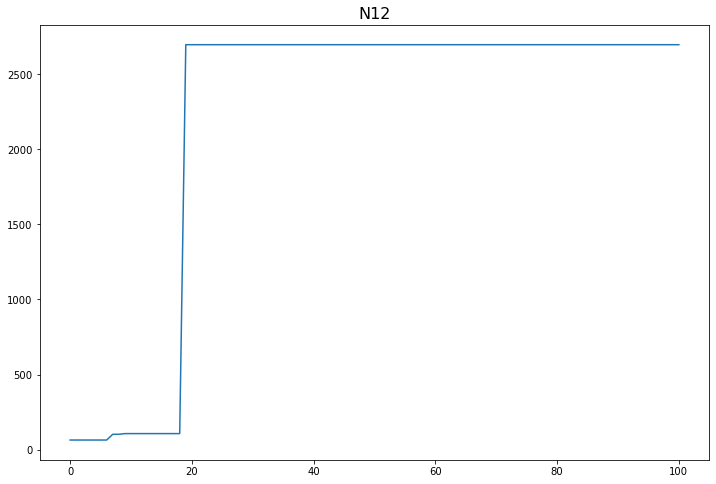

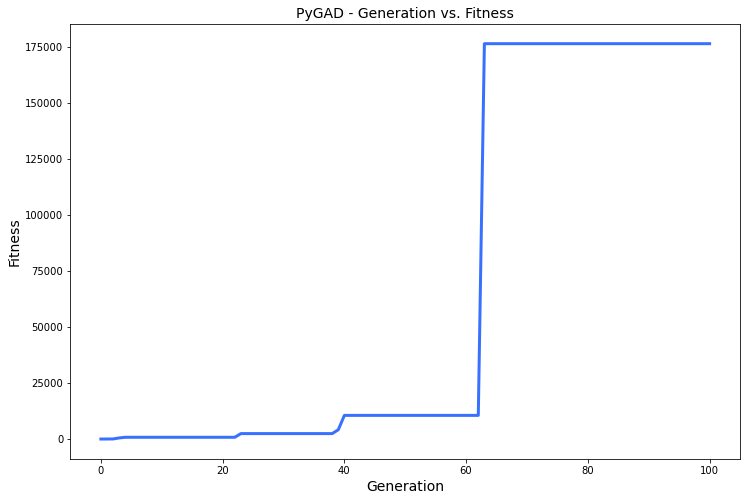

[0.228]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.228 |===========| 28.937 |==================| 34.942 |==========
[-0.573]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.573 |===========| 28.89 |==================| 13.069 |==========
[0.634]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.634 |===========| 28.881 |==================| 11.699 |==========
[0.157]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 28.947 |==================| 51.376 |==========
[-0.111]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 28.952 |==================| 73.039 |==========
[-0.874]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.874 |===========| 28.844 |==================| 8.172 |==========
[0.649]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.969 |===========| 27.006 |==================| 4.046 |==========
[0.851]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 27.037 |==================| 4.628 |==========
[0.629]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 27.095 |==================| 6.311 |==========
[0.676]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.676 |===========| 27.083 |==================| 5.86 |==========
[-0.534]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.534 |===========| 27.119 |==================| 7.45 |==========
[1.139]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.139 |===========| 26.961 |==================| 3.423 |==========
[-0.576]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 27.143 |==================| 9.11 |==========
[0.072]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.072 |===========| 27.235 |==================| 56.104 |==========
Fitness = 196.69898972661017
[0.676]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.676 |===========| 27.083 |==================| 5.86 |==========
[-0.534]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.534 |===========| 27.119 |==================| 7.45 |==========
[1.139]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.139 |===========| 26.961 |==================| 3.423 |==========
[-0.576]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.576 |===========| 27.108 |==================| 6.906 |==========
[-0.491]
=====|SOLUTION|===========|OUTPUT|============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.697 |===========| 27.077 |==================| 5.678 |==========
[0.438]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 27.143 |==================| 9.11 |==========
[0.072]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.072 |===========| 27.235 |==================| 56.104 |==========
[0.676]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.676 |===========| 27.083 |==================| 5.86 |==========
[-0.534]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.534 |===========| 27.119 |==================| 7.45 |==========
[1.139]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.139 |===========| 26.961 |==================| 3.423 |==========
[-0.576]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.019 |===========| 27.248 |==================| 208.2 |==========
[0.044]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 27.242 |==================| 92.637 |==========
Generation = 2
[-0.782]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 27.055 |==================| 5.044 |==========
[0.905]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 27.023 |==================| 4.342 |==========
[0.26]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 27.188 |==================| 15.452 |==========
[-0.775]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 27.057 |==================| 5.093 |==========
[0.2]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.019 |===========| 27.248 |==================| 208.2 |==========
[0.044]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 27.242 |==================| 92.637 |==========
Change = 11.50137379633776
[-0.782]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 27.055 |==================| 5.044 |==========
[0.905]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 27.023 |==================| 4.342 |==========
[0.26]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 27.188 |==================| 15.452 |==========
[-0.775]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 27.057 |==================| 5.093 |==========
[0.2]
=====|SOLUTION|===========|OUTPUT|===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.019 |===========| 27.248 |==================| 208.2 |==========
[0.044]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 27.242 |==================| 92.637 |==========
[-0.223]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 27.198 |==================| 18.017 |==========
[-0.803]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.803 |===========| 27.05 |==================| 4.912 |==========
[0.893]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.893 |===========| 27.026 |==================| 4.401 |==========
[0.878]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.878 |===========| 27.03 |==================| 4.48 |==========
[-0.75]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.533 |===========| 27.119 |==================| 7.464 |==========
[-0.416]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 27.149 |==================| 9.619 |==========
Fitness = 208.200363522673
[-0.223]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 27.198 |==================| 18.017 |==========
[-0.803]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.803 |===========| 27.05 |==================| 4.912 |==========
[0.893]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.893 |===========| 27.026 |==================| 4.401 |==========
[0.878]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.878 |===========| 27.03 |==================| 4.48 |==========
[-0.75]
=====|SOLUTION|===========|OUTPUT|==============

[-0.416]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 27.149 |==================| 9.619 |==========
[-0.223]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 27.198 |==================| 18.017 |==========
[-0.803]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.803 |===========| 27.05 |==================| 4.912 |==========
[0.893]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.893 |===========| 27.026 |==================| 4.401 |==========
[0.878]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.878 |===========| 27.03 |==================| 4.48 |==========
[-0.75]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 27.063 |==================| 5.266 |==========
[-0.857]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 27.224 |==================| 33.947 |==========
[-0.535]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.535 |===========| 27.119 |==================| 7.443 |==========
[0.317]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 27.174 |==================| 12.647 |==========
[-0.787]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.787 |===========| 27.054 |==================| 5.014 |==========
[-0.561]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.561 |===========| 27.112 |==================| 7.088 |==========
[-0.569]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.569 |===========| 27.11 |==================| 6.989 |==========
[0.576]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 27.224 |==================| 33.947 |==========
[-0.535]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.535 |===========| 27.119 |==================| 7.443 |==========
[0.317]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 27.174 |==================| 12.647 |==========
[-0.787]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.787 |===========| 27.054 |==================| 5.014 |==========
[-0.561]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.561 |===========| 27.112 |==================| 7.088 |==========
[-0.569]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.569 |===========| 27.11 |==================| 6.989 |==========
[0.576]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 27.195 |==================| 17.265 |==========
[0.722]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 27.071 |==================| 5.477 |==========
[-0.737]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 27.067 |==================| 5.364 |==========
[0.359]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 27.164 |==================| 11.161 |==========
[-0.099]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 27.229 |==================| 40.742 |==========
[0.73]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.73 |===========| 27.068 |==================| 5.412 |==========
[0.667]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========| 27.169 |==================| 11.912 |==========
[0.833]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.833 |===========| 27.042 |==================| 4.728 |==========
Fitness = 682.4305997069793
[0.722]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 27.071 |==================| 5.477 |==========
[-0.737]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 27.067 |==================| 5.364 |==========
[0.359]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 27.164 |==================| 11.161 |==========
[-0.099]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 27.229 |==================| 40.742 |==========
[0.73]
=====|SOLUTION|===========|OUTPUT|==========

[-0.605]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.605 |===========| 27.101 |==================| 6.566 |==========
[0.337]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========| 27.169 |==================| 11.912 |==========
[0.833]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.833 |===========| 27.042 |==================| 4.728 |==========
[0.722]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 27.071 |==================| 5.477 |==========
[-0.737]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 27.067 |==================| 5.364 |==========
[0.359]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 27.164 |==================| 11.161 |==========
[-0.099]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.168 |===========| 27.212 |==================| 24.046 |==========
[0.924]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.924 |===========| 27.018 |==================| 4.247 |==========
Generation = 6
[0.73]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.73 |===========| 27.068 |==================| 5.413 |==========
[0.325]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 27.172 |==================| 12.355 |==========
[-0.938]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 27.014 |==================| 4.185 |==========
[0.006]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.006 |===========| 27.252 |==================| 715.345 |==========
[-0.165]
=====|SOLUTION|===========|OUTPUT|==================|FITN

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.924 |===========| 27.018 |==================| 4.247 |==========
Change = 32.91401344867302
[0.73]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.73 |===========| 27.068 |==================| 5.413 |==========
[0.325]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 27.172 |==================| 12.355 |==========
[-0.938]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 27.014 |==================| 4.185 |==========
[0.006]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.006 |===========| 27.252 |==================| 715.345 |==========
[-0.165]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 27.212 |==================| 24.438 |==========
[0.241]
=====|SOLUTION|===========|OUTPUT|===========

[0.924]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.924 |===========| 27.018 |==================| 4.247 |==========
[0.086]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.086 |===========| 27.232 |==================| 47.165 |==========
[-0.886]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.886 |===========| 27.028 |==================| 4.438 |==========
[0.186]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 27.207 |==================| 21.688 |==========
[-0.272]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 27.185 |==================| 14.757 |==========
[0.463]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 27.137 |==================| 8.611 |==========
[0.572]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.94 |===========| 27.014 |==================| 4.173 |==========
Fitness = 715.3446131556523
[0.086]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.086 |===========| 27.232 |==================| 47.165 |==========
[-0.886]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.886 |===========| 27.028 |==================| 4.438 |==========
[0.186]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 27.207 |==================| 21.688 |==========
[-0.272]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 27.185 |==================| 14.757 |==========
[0.463]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 27.137 |==================| 8.611 |==========
[0.572]
=====|SOLUTION|===========|OUTPUT|==========

[0.086]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.086 |===========| 27.232 |==================| 47.165 |==========
[-0.886]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.886 |===========| 27.028 |==================| 4.438 |==========
[0.186]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 27.207 |==================| 21.688 |==========
[-0.272]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 27.185 |==================| 14.757 |==========
[0.463]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 27.137 |==================| 8.611 |==========
[0.572]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.572 |===========| 27.109 |==================| 6.954 |==========
[-0.97]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 27.174 |==================| 12.662 |==========
[0.894]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.894 |===========| 27.026 |==================| 4.398 |==========
[0.183]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 27.208 |==================| 22.042 |==========
[0.731]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.731 |===========| 27.068 |==================| 5.409 |==========
[-0.769]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.769 |===========| 27.058 |==================| 5.134 |==========
[0.787]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.787 |===========| 27.054 |==================| 5.012 |==========
[0.474]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 27.174 |==================| 12.662 |==========
[0.894]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.894 |===========| 27.026 |==================| 4.398 |==========
[0.183]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 27.208 |==================| 22.042 |==========
[0.731]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.731 |===========| 27.068 |==================| 5.409 |==========
[-0.769]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.769 |===========| 27.058 |==================| 5.134 |==========
[0.787]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.787 |===========| 27.054 |==================| 5.012 |==========
[0.474]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.933 |===========| 27.016 |==================| 4.207 |==========
[-0.762]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.762 |===========| 27.06 |==================| 5.178 |==========
[0.738]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.738 |===========| 27.066 |==================| 5.353 |==========
[-0.338]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 27.169 |==================| 11.873 |==========
[0.71]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.71 |===========| 27.074 |==================| 5.571 |==========
[0.81]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.81 |===========| 27.048 |==================| 4.865 |==========
[0.986]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.762 |===========| 27.06 |==================| 5.178 |==========
[0.738]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.738 |===========| 27.066 |==================| 5.353 |==========
[-0.338]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 27.169 |==================| 11.873 |==========
[0.71]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.71 |===========| 27.074 |==================| 5.571 |==========
[0.81]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.81 |===========| 27.048 |==================| 4.865 |==========
[0.986]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.986 |===========| 27.002 |==================| 3.975 |==========
[-0.613]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.762 |===========| 27.06 |==================| 5.178 |==========
[0.738]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.738 |===========| 27.066 |==================| 5.353 |==========
[-0.338]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 27.169 |==================| 11.873 |==========
[0.71]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.71 |===========| 27.074 |==================| 5.571 |==========
[0.81]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.81 |===========| 27.048 |==================| 4.865 |==========
[0.986]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.986 |===========| 27.002 |==================| 3.975 |==========
[-0.613]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.566 |===========| 27.111 |==================| 7.023 |==========
[0.711]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.711 |===========| 27.073 |==================| 5.561 |==========
[0.305]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 27.177 |==================| 13.155 |==========
[-0.542]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.542 |===========| 27.117 |==================| 7.341 |==========
[0.987]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.987 |===========| 27.001 |==================| 3.969 |==========
[0.052]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 27.24 |==================| 77.312 |==========
[-0.203]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.671 |===========| 27.084 |==================| 5.905 |==========
[0.566]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.566 |===========| 27.111 |==================| 7.023 |==========
[0.711]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.711 |===========| 27.073 |==================| 5.561 |==========
[0.305]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 27.177 |==================| 13.155 |==========
[-0.542]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.542 |===========| 27.117 |==================| 7.341 |==========
[0.987]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.987 |===========| 27.001 |==================| 3.969 |==========
[0.052]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 27.085 |==================| 5.93 |==========
[-0.664]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.664 |===========| 27.086 |==================| 5.969 |==========
[0.897]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 27.025 |==================| 4.379 |==========
[-0.258]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 27.189 |==================| 15.593 |==========
[-0.287]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 27.182 |==================| 13.983 |==========
[0.974]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.974 |===========| 27.005 |==================| 4.023 |==========
[0.606]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 27.085 |==================| 5.93 |==========
[-0.664]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.664 |===========| 27.086 |==================| 5.969 |==========
[0.897]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 27.025 |==================| 4.379 |==========
[-0.258]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 27.189 |==================| 15.593 |==========
[-0.287]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 27.182 |==================| 13.983 |==========
[0.974]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.974 |===========| 27.005 |==================| 4.023 |==========
[0.606]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.664 |===========| 27.086 |==================| 5.969 |==========
[0.897]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 27.025 |==================| 4.379 |==========
[-0.258]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 27.189 |==================| 15.593 |==========
[-0.287]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 27.182 |==================| 13.983 |==========
[0.974]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.974 |===========| 27.005 |==================| 4.023 |==========
[0.606]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.606 |===========| 27.101 |==================| 6.552 |==========
[0.858]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 27.037 |==================| 4.617 |==========
[-0.167]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 27.212 |==================| 24.216 |==========
[0.867]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.867 |===========| 27.033 |==================| 4.539 |==========
[0.659]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.659 |===========| 27.087 |==================| 6.016 |==========
[0.255]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 27.19 |==================| 15.767 |==========
[0.413]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 27.15 |==================| 9.69 |==========
[-0.771]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 27.212 |==================| 24.216 |==========
[0.867]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.867 |===========| 27.033 |==================| 4.539 |==========
[0.659]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.659 |===========| 27.087 |==================| 6.016 |==========
[0.255]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 27.19 |==================| 15.767 |==========
[0.413]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 27.15 |==================| 9.69 |==========
[-0.771]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.771 |===========| 27.058 |==================| 5.121 |==========
[0.476]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.687 |===========| 27.08 |==================| 5.759 |==========
[-0.972]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.972 |===========| 27.005 |==================| 4.031 |==========
[0.934]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.934 |===========| 27.015 |==================| 4.202 |==========
[0.973]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 27.005 |==================| 4.028 |==========
[0.159]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 27.214 |==================| 25.38 |==========
[0.377]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 27.159 |==================| 10.621 |==========
[0.829]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.972 |===========| 27.005 |==================| 4.031 |==========
[0.934]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.934 |===========| 27.015 |==================| 4.202 |==========
[0.973]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 27.005 |==================| 4.028 |==========
[0.159]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 27.214 |==================| 25.38 |==========
[0.377]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 27.159 |==================| 10.621 |==========
[0.829]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.829 |===========| 27.043 |==================| 4.755 |==========
[0.019]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.687 |===========| 27.08 |==================| 5.759 |==========
[-0.972]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.972 |===========| 27.005 |==================| 4.031 |==========
[0.934]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.934 |===========| 27.015 |==================| 4.202 |==========
[0.973]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 27.005 |==================| 4.028 |==========
[0.159]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 27.214 |==================| 25.38 |==========
[0.377]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 27.159 |==================| 10.621 |==========
[0.829]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 27.179 |==================| 13.524 |==========
[0.459]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 27.138 |==================| 8.692 |==========
[0.066]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 27.237 |==================| 61.308 |==========
[0.178]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 27.209 |==================| 22.719 |==========
[-0.778]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.778 |===========| 27.056 |==================| 5.071 |==========
[0.52]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.52 |===========| 27.123 |==================| 7.661 |==========
[-0.029]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 27.179 |==================| 13.524 |==========
[0.459]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 27.138 |==================| 8.692 |==========
[0.066]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 27.237 |==================| 61.308 |==========
[0.178]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 27.209 |==================| 22.719 |==========
[-0.778]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.778 |===========| 27.056 |==================| 5.071 |==========
[0.52]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.52 |===========| 27.123 |==================| 7.661 |==========
[-0.029]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.63 |===========| 27.094 |==================| 6.301 |==========
[-0.098]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 27.229 |==================| 41.089 |==========
[0.495]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 27.129 |==================| 8.046 |==========
[-0.037]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.037 |===========| 27.244 |==================| 108.166 |==========
[0.862]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.862 |===========| 27.034 |==================| 4.563 |==========
[-0.354]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 27.165 |==================| 11.332 |==========
[0.296]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.891 |===========| 27.026 |==================| 4.41 |==========
[0.63]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.63 |===========| 27.094 |==================| 6.301 |==========
[-0.098]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 27.229 |==================| 41.089 |==========
[0.495]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 27.129 |==================| 8.046 |==========
[-0.037]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.037 |===========| 27.244 |==================| 108.166 |==========
[0.862]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.862 |===========| 27.034 |==================| 4.563 |==========
[-0.354]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 27.2 |==================| 18.684 |==========
[-0.891]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.891 |===========| 27.026 |==================| 4.41 |==========
[0.63]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.63 |===========| 27.094 |==================| 6.301 |==========
[-0.098]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 27.229 |==================| 41.089 |==========
[0.495]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 27.129 |==================| 8.046 |==========
[-0.037]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.037 |===========| 27.244 |==================| 108.166 |==========
[0.862]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.692 |===========| 27.078 |==================| 5.72 |==========
[-0.834]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.834 |===========| 27.041 |==================| 4.724 |==========
[-0.489]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 27.131 |==================| 8.161 |==========
[-0.445]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 27.142 |==================| 8.964 |==========
[0.81]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.81 |===========| 27.048 |==================| 4.865 |==========
[-0.327]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 27.172 |==================| 12.251 |==========
[0.731]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.692 |===========| 27.078 |==================| 5.72 |==========
[-0.834]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.834 |===========| 27.041 |==================| 4.724 |==========
[-0.489]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 27.131 |==================| 8.161 |==========
[-0.445]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 27.142 |==================| 8.964 |==========
[0.81]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.81 |===========| 27.048 |==================| 4.865 |==========
[-0.327]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 27.172 |==================| 12.251 |==========
[0.731]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 27.19 |==================| 15.771 |==========
[0.059]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 27.239 |==================| 68.413 |==========
[0.333]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 27.17 |==================| 12.049 |==========
[0.971]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.971 |===========| 27.005 |==================| 4.036 |==========
[-0.135]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 27.22 |==================| 30.014 |==========
[0.72]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.72 |===========| 27.071 |==================| 5.493 |==========
[0.653]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.307 |===========| 27.177 |==================| 13.087 |==========
[-0.255]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 27.19 |==================| 15.771 |==========
[0.059]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 27.239 |==================| 68.413 |==========
[0.333]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 27.17 |==================| 12.049 |==========
[0.971]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.971 |===========| 27.005 |==================| 4.036 |==========
[-0.135]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 27.22 |==================| 30.014 |==========
[0.72]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.307 |===========| 27.177 |==================| 13.087 |==========
[-0.255]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 27.19 |==================| 15.771 |==========
[0.059]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 27.239 |==================| 68.413 |==========
[0.333]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 27.17 |==================| 12.049 |==========
[0.971]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.971 |===========| 27.005 |==================| 4.036 |==========
[-0.135]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 27.22 |==================| 30.014 |==========
[0.72]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.864 |===========| 27.034 |==================| 4.554 |==========
[0.874]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.874 |===========| 27.031 |==================| 4.501 |==========
[0.217]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 27.199 |==================| 18.568 |==========
[-0.785]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.785 |===========| 27.054 |==================| 5.029 |==========
[-0.909]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.909 |===========| 27.022 |==================| 4.319 |==========
[0.217]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 27.199 |==================| 18.564 |==========
[0.32]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.864 |===========| 27.034 |==================| 4.554 |==========
[0.874]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.874 |===========| 27.031 |==================| 4.501 |==========
[0.217]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 27.199 |==================| 18.568 |==========
[-0.785]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.785 |===========| 27.054 |==================| 5.029 |==========
[-0.909]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.909 |===========| 27.022 |==================| 4.319 |==========
[0.217]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 27.199 |==================| 18.564 |==========
[0.32]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.587 |===========| 27.105 |==================| 6.767 |==========
[0.122]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.122 |===========| 27.223 |==================| 33.215 |==========
[-0.759]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.759 |===========| 27.061 |==================| 5.203 |==========
[-0.566]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.566 |===========| 27.111 |==================| 7.029 |==========
[0.018]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 27.249 |==================| 221.904 |==========
[0.851]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 27.037 |==================| 4.627 |==========
[0.866]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.587 |===========| 27.105 |==================| 6.767 |==========
[0.122]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.122 |===========| 27.223 |==================| 33.215 |==========
[-0.759]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.759 |===========| 27.061 |==================| 5.203 |==========
[-0.566]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.566 |===========| 27.111 |==================| 7.029 |==========
[0.018]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 27.249 |==================| 221.904 |==========
[0.851]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 27.037 |==================| 4.627 |==========
[0.866]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.122 |===========| 27.223 |==================| 33.215 |==========
[-0.759]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.759 |===========| 27.061 |==================| 5.203 |==========
[-0.566]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.566 |===========| 27.111 |==================| 7.029 |==========
[0.018]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 27.249 |==================| 221.904 |==========
[0.851]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 27.037 |==================| 4.627 |==========
[0.866]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.866 |===========| 27.033 |==================| 4.542 |==========
[0.415]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 27.085 |==================| 5.933 |==========
[-0.248]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 27.191 |==================| 16.187 |==========
[-0.042]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.042 |===========| 27.243 |==================| 97.147 |==========
[-0.904]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.904 |===========| 27.023 |==================| 4.344 |==========
[0.424]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 27.147 |==================| 9.436 |==========
[0.59]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.59 |===========| 27.105 |==================| 6.734 |==========
[0.641]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.129 |===========| 27.221 |==================| 31.296 |==========
[0.668]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 27.085 |==================| 5.933 |==========
[-0.248]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 27.191 |==================| 16.187 |==========
[-0.042]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.042 |===========| 27.243 |==================| 97.147 |==========
[-0.904]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.904 |===========| 27.023 |==================| 4.344 |==========
[0.424]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 27.147 |==================| 9.436 |==========
[0.59]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 27.213 |==================| 25.051 |==========
[0.887]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.887 |===========| 27.028 |==================| 4.433 |==========
[0.384]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 27.157 |==================| 10.424 |==========
[0.357]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 27.164 |==================| 11.217 |==========
[-0.879]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.879 |===========| 27.03 |==================| 4.476 |==========
[0.38]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 27.158 |==================| 10.533 |==========
[-0.138]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 27.213 |==================| 25.051 |==========
[0.887]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.887 |===========| 27.028 |==================| 4.433 |==========
[0.384]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 27.157 |==================| 10.424 |==========
[0.357]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 27.164 |==================| 11.217 |==========
[-0.879]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.879 |===========| 27.03 |==================| 4.476 |==========
[0.38]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 27.158 |==================| 10.533 |==========
[-0.138]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 27.213 |==================| 25.051 |==========
[0.887]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.887 |===========| 27.028 |==================| 4.433 |==========
[0.384]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 27.157 |==================| 10.424 |==========
[0.357]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 27.164 |==================| 11.217 |==========
[-0.879]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.879 |===========| 27.03 |==================| 4.476 |==========
[0.38]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 27.158 |==================| 10.533 |==========
[-0.138]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 27.206 |==================| 21.334 |==========
[-0.644]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 27.091 |==================| 6.153 |==========
[0.204]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 27.202 |==================| 19.712 |==========
[0.844]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.844 |===========| 27.039 |==================| 4.663 |==========
[-0.706]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.706 |===========| 27.075 |==================| 5.606 |==========
[-0.256]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 27.189 |==================| 15.683 |==========
[-0.9]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 27.206 |==================| 21.334 |==========
[-0.644]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 27.091 |==================| 6.153 |==========
[0.204]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 27.202 |==================| 19.712 |==========
[0.844]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.844 |===========| 27.039 |==================| 4.663 |==========
[-0.706]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.706 |===========| 27.075 |==================| 5.606 |==========
[-0.256]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 27.189 |==================| 15.683 |==========
[-0.9]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.691 |===========| 27.079 |==================| 5.729 |==========
[0.1]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 27.229 |==================| 40.538 |==========
[-0.881]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.881 |===========| 27.029 |==================| 4.462 |==========
[-0.121]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 27.223 |==================| 33.46 |==========
[0.288]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 27.182 |==================| 13.964 |==========
[0.353]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 27.165 |==================| 11.343 |==========
[-0.036]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 27.253 |==================| 2155.31 |==========
[0.691]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.691 |===========| 27.079 |==================| 5.729 |==========
[0.1]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 27.229 |==================| 40.538 |==========
[-0.881]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.881 |===========| 27.029 |==================| 4.462 |==========
[-0.121]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 27.223 |==================| 33.46 |==========
[0.288]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 27.182 |==================| 13.964 |==========
[0.353]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 27.253 |==================| 2155.31 |==========
[0.691]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.691 |===========| 27.079 |==================| 5.729 |==========
[0.1]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 27.229 |==================| 40.538 |==========
[-0.881]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.881 |===========| 27.029 |==================| 4.462 |==========
[-0.121]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 27.223 |==================| 33.46 |==========
[0.288]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 27.182 |==================| 13.964 |==========
[0.353]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 27.24 |==================| 73.394 |==========
[-0.058]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 27.239 |==================| 70.43 |==========
[0.887]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.887 |===========| 27.028 |==================| 4.434 |==========
[0.721]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.721 |===========| 27.071 |==================| 5.482 |==========
[0.815]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.815 |===========| 27.046 |==================| 4.834 |==========
[0.085]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 27.232 |==================| 47.861 |==========
[-0.527]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

[0.194]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 27.205 |==================| 20.792 |==========
[-0.055]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 27.24 |==================| 73.394 |==========
[-0.058]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 27.239 |==================| 70.43 |==========
[0.887]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.887 |===========| 27.028 |==================| 4.434 |==========
[0.721]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.721 |===========| 27.071 |==================| 5.482 |==========
[0.815]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.815 |===========| 27.046 |==================| 4.834 |==========
[0.085]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 27.138 |==================| 8.691 |==========
[0.01]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 27.251 |==================| 422.822 |==========
[0.983]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.983 |===========| 27.002 |==================| 3.985 |==========
[-0.42]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 27.148 |==================| 9.506 |==========
[-0.074]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 27.235 |==================| 54.685 |==========
[-0.45]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 27.141 |==================| 8.874 |==========
[-0.836]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.787 |===========| 27.054 |==================| 5.013 |==========
[0.459]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 27.138 |==================| 8.691 |==========
[0.01]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 27.251 |==================| 422.822 |==========
[0.983]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.983 |===========| 27.002 |==================| 3.985 |==========
[-0.42]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 27.148 |==================| 9.506 |==========
[-0.074]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 27.235 |==================| 54.685 |==========
[-0.45]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.787 |===========| 27.054 |==================| 5.013 |==========
[0.459]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 27.138 |==================| 8.691 |==========
[0.01]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 27.251 |==================| 422.822 |==========
[0.983]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.983 |===========| 27.002 |==================| 3.985 |==========
[-0.42]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 27.148 |==================| 9.506 |==========
[-0.074]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 27.235 |==================| 54.685 |==========
[-0.45]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.801 |===========| 27.05 |==================| 4.924 |==========
Generation = 26
[0.28]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 27.183 |==================| 14.333 |==========
[0.535]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.535 |===========| 27.119 |==================| 7.44 |==========
[-0.039]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 27.243 |==================| 103.03 |==========
[-0.436]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 27.144 |==================| 9.167 |==========
[-0.899]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.899 |===========| 27.025 |==================| 4.373 |==========
[0.063]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.801 |===========| 27.05 |==================| 4.924 |==========
Change = 0.0
[0.28]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 27.183 |==================| 14.333 |==========
[0.535]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.535 |===========| 27.119 |==================| 7.44 |==========
[-0.039]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 27.243 |==================| 103.03 |==========
[-0.436]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 27.144 |==================| 9.167 |==========
[-0.899]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.899 |===========| 27.025 |==================| 4.373 |==========
[0.063]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.9 |===========| 27.024 |==================| 4.368 |==========
[0.801]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.801 |===========| 27.05 |==================| 4.924 |==========
[-0.41]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 27.151 |==================| 9.76 |==========
[0.565]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 27.111 |==================| 7.037 |==========
[-0.77]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.77 |===========| 27.058 |==================| 5.13 |==========
[0.23]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 27.196 |==================| 17.471 |==========
[-0.576]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.5

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 27.184 |==================| 14.504 |==========
[-0.508]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.508 |===========| 27.126 |==================| 7.836 |==========
Fitness = 2155.3100273808195
[-0.41]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 27.151 |==================| 9.76 |==========
[0.565]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 27.111 |==================| 7.037 |==========
[-0.77]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.77 |===========| 27.058 |==================| 5.13 |==========
[0.23]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 27.196 |==================| 17.471 |==========
[-0.576]
=====|SOLUTION|===========|OUTPUT|===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 27.184 |==================| 14.504 |==========
[-0.508]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.508 |===========| 27.126 |==================| 7.836 |==========
[-0.41]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 27.151 |==================| 9.76 |==========
[0.565]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 27.111 |==================| 7.037 |==========
[-0.77]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.77 |===========| 27.058 |==================| 5.13 |==========
[0.23]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 27.196 |==================| 17.471 |==========
[-0.576]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.675 |===========| 27.083 |==================| 5.864 |==========
Generation = 28
[0.191]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 27.206 |==================| 21.076 |==========
[0.817]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.817 |===========| 27.046 |==================| 4.822 |==========
[0.794]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.794 |===========| 27.052 |==================| 4.968 |==========
[-0.604]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.604 |===========| 27.101 |==================| 6.578 |==========
[0.054]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 27.24 |==================| 75.582 |==========
[0.76]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 27.226 |==================| 36.386 |==========
[-0.675]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.675 |===========| 27.083 |==================| 5.864 |==========
Change = 0.0
[0.191]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 27.206 |==================| 21.076 |==========
[0.817]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.817 |===========| 27.046 |==================| 4.822 |==========
[0.794]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.794 |===========| 27.052 |==================| 4.968 |==========
[-0.604]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.604 |===========| 27.101 |==================| 6.578 |==========
[0.054]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.675 |===========| 27.083 |==================| 5.864 |==========
[-0.354]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 27.165 |==================| 11.322 |==========
[0.273]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 27.185 |==================| 14.747 |==========
[0.944]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.944 |===========| 27.013 |==================| 4.157 |==========
[-0.349]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 27.166 |==================| 11.49 |==========
[0.473]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 27.135 |==================| 8.441 |==========
[-0.594]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.971 |===========| 27.006 |==================| 4.038 |==========
[0.296]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 27.179 |==================| 13.56 |==========
Fitness = 2155.3100273808195
[-0.354]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 27.165 |==================| 11.322 |==========
[0.273]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 27.185 |==================| 14.747 |==========
[0.944]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.944 |===========| 27.013 |==================| 4.157 |==========
[-0.349]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 27.166 |==================| 11.49 |==========
[0.473]
=====|SOLUTION|===========|OUTPUT|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 27.148 |==================| 9.522 |==========
[0.971]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.971 |===========| 27.006 |==================| 4.038 |==========
[0.296]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 27.179 |==================| 13.56 |==========
[-0.354]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 27.165 |==================| 11.322 |==========
[0.273]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 27.185 |==================| 14.747 |==========
[0.944]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.944 |===========| 27.013 |==================| 4.157 |==========
[-0.349]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.518 |===========| 27.123 |==================| 7.682 |==========
[0.186]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 27.207 |==================| 21.638 |==========
[0.886]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.886 |===========| 27.028 |==================| 4.435 |==========
[-0.45]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 27.14 |==================| 8.871 |==========
Generation = 30
[0.453]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 27.14 |==================| 8.808 |==========
[-0.416]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 27.149 |==================| 9.599 |==========
[0.614]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 27.207 |==================| 21.638 |==========
[0.886]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.886 |===========| 27.028 |==================| 4.435 |==========
[-0.45]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 27.14 |==================| 8.871 |==========
Change = 0.0
[0.453]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 27.14 |==================| 8.808 |==========
[-0.416]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 27.149 |==================| 9.599 |==========
[0.614]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.614 |===========| 27.099 |==================| 6.468 |==========
[0.742]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.886 |===========| 27.028 |==================| 4.435 |==========
[-0.45]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 27.14 |==================| 8.871 |==========
[0.967]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.967 |===========| 27.006 |==================| 4.053 |==========
[0.905]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 27.023 |==================| 4.341 |==========
[0.033]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 27.245 |==================| 121.337 |==========
[-0.451]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 27.14 |==================| 8.853 |==========
[0.06]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.984 |===========| 27.002 |==================| 3.982 |==========
[-0.678]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.678 |===========| 27.082 |==================| 5.84 |==========
Fitness = 2155.3100273808195
[0.967]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.967 |===========| 27.006 |==================| 4.053 |==========
[0.905]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 27.023 |==================| 4.341 |==========
[0.033]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 27.245 |==================| 121.337 |==========
[-0.451]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 27.14 |==================| 8.853 |==========
[0.06]
=====|SOLUTION|===========|OUTPUT|============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.984 |===========| 27.002 |==================| 3.982 |==========
[-0.678]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.678 |===========| 27.082 |==================| 5.84 |==========
[0.967]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.967 |===========| 27.006 |==================| 4.053 |==========
[0.905]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 27.023 |==================| 4.341 |==========
[0.033]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 27.245 |==================| 121.337 |==========
[-0.451]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 27.14 |==================| 8.853 |==========
[0.06]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.072 |===========| 27.235 |==================| 55.944 |==========
[-0.831]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 27.042 |==================| 4.743 |==========
[0.934]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.934 |===========| 27.015 |==================| 4.203 |==========
Generation = 32
[-0.471]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 27.135 |==================| 8.469 |==========
[-0.044]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 27.242 |==================| 91.636 |==========
[-0.713]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.713 |===========| 27.073 |==================| 5.547 |==========
[-0.063]
=====|SOLUTION|===========|OUTPUT|==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.072 |===========| 27.235 |==================| 55.944 |==========
[-0.831]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 27.042 |==================| 4.743 |==========
[0.934]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.934 |===========| 27.015 |==================| 4.203 |==========
Change = 0.0
[-0.471]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 27.135 |==================| 8.469 |==========
[-0.044]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 27.242 |==================| 91.636 |==========
[-0.713]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.713 |===========| 27.073 |==================| 5.547 |==========
[-0.063]
=====|SOLUTION|===========|OUTPUT|==================|FIT

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.769 |===========| 27.058 |==================| 5.131 |==========
[-0.072]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.072 |===========| 27.235 |==================| 55.944 |==========
[-0.831]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 27.042 |==================| 4.743 |==========
[0.934]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.934 |===========| 27.015 |==================| 4.203 |==========
[0.242]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 27.193 |==================| 16.642 |==========
[0.627]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.627 |===========| 27.095 |==================| 6.324 |==========
[-0.989]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 27.173 |==================| 12.517 |==========
[0.327]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 27.172 |==================| 12.261 |==========
[0.918]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.918 |===========| 27.02 |==================| 4.28 |==========
Fitness = 2155.3100273808195
[0.242]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 27.193 |==================| 16.642 |==========
[0.627]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.627 |===========| 27.095 |==================| 6.324 |==========
[-0.989]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.989 |===========| 27.001 |==================| 3.96 |==========
[0.089]
=====|SOLUTION|===========|OUTPUT|============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 27.173 |==================| 12.517 |==========
[0.327]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 27.172 |==================| 12.261 |==========
[0.918]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.918 |===========| 27.02 |==================| 4.28 |==========
[0.242]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 27.193 |==================| 16.642 |==========
[0.627]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.627 |===========| 27.095 |==================| 6.324 |==========
[-0.989]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.989 |===========| 27.001 |==================| 3.96 |==========
[0.089]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.306 |===========| 27.177 |==================| 13.108 |==========
[0.479]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 27.133 |==================| 8.325 |==========
[-0.993]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.993 |===========| 27.0 |==================| 3.946 |==========
[-0.962]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.962 |===========| 27.008 |==================| 4.077 |==========
Generation = 34
[0.915]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.915 |===========| 27.02 |==================| 4.291 |==========
[-0.981]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.981 |===========| 27.003 |==================| 3.994 |==========
[-0.274]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 27.206 |==================| 21.093 |==========
[0.306]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.306 |===========| 27.177 |==================| 13.108 |==========
[0.479]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 27.133 |==================| 8.325 |==========
[-0.993]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.993 |===========| 27.0 |==================| 3.946 |==========
[-0.962]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.962 |===========| 27.008 |==================| 4.077 |==========
Change = 0.0
[0.915]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.915 |===========| 27.02 |==================| 4.291 |==========
[-0.981]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 27.206 |==================| 21.093 |==========
[0.306]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.306 |===========| 27.177 |==================| 13.108 |==========
[0.479]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 27.133 |==================| 8.325 |==========
[-0.993]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.993 |===========| 27.0 |==================| 3.946 |==========
[-0.962]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.962 |===========| 27.008 |==================| 4.077 |==========
[-0.211]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 27.201 |==================| 19.084 |==========
[-0.05]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.262 |===========| 27.188 |==================| 15.359 |==========
[-0.526]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.526 |===========| 27.121 |==================| 7.573 |==========
[-0.606]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.606 |===========| 27.1 |==================| 6.549 |==========
[-0.595]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.595 |===========| 27.103 |==================| 6.678 |==========
Fitness = 2155.3100273808195
[-0.211]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 27.201 |==================| 19.084 |==========
[-0.05]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 27.241 |==================| 81.182 |==========
[-0.208]
=====|SOLUTION|===========|OUTPUT|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 27.18 |==================| 13.657 |==========
[0.262]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.262 |===========| 27.188 |==================| 15.359 |==========
[-0.526]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.526 |===========| 27.121 |==================| 7.573 |==========
[-0.606]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.606 |===========| 27.1 |==================| 6.549 |==========
[-0.595]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.595 |===========| 27.103 |==================| 6.678 |==========
[-0.211]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 27.201 |==================| 19.084 |==========
[-0.05]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 27.19 |==================| 15.852 |==========
[-0.651]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.651 |===========| 27.089 |==================| 6.087 |==========
[-0.913]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.913 |===========| 27.021 |==================| 4.301 |==========
[-0.919]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.919 |===========| 27.019 |==================| 4.274 |==========
Generation = 36
[0.814]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.814 |===========| 27.047 |==================| 4.839 |==========
[0.594]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.594 |===========| 27.104 |==================| 6.683 |==========
[0.244]
=====|SOLUTION|===========|OUTPUT|==================|FITN

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.832 |===========| 27.042 |==================| 4.736 |==========
[-0.254]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 27.19 |==================| 15.852 |==========
[-0.651]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.651 |===========| 27.089 |==================| 6.087 |==========
[-0.913]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.913 |===========| 27.021 |==================| 4.301 |==========
[-0.919]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.919 |===========| 27.019 |==================| 4.274 |==========
Change = 0.0
[0.814]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.814 |===========| 27.047 |==================| 4.839 |==========
[0.594]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.832 |===========| 27.042 |==================| 4.736 |==========
[-0.254]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 27.19 |==================| 15.852 |==========
[-0.651]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.651 |===========| 27.089 |==================| 6.087 |==========
[-0.913]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.913 |===========| 27.021 |==================| 4.301 |==========
[-0.919]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.919 |===========| 27.019 |==================| 4.274 |==========
[0.528]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 27.121 |==================| 7.547 |==========
[-0.408]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 27.161 |==================| 10.858 |==========
[0.612]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.612 |===========| 27.099 |==================| 6.485 |==========
[-0.945]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.945 |===========| 27.012 |==================| 4.15 |==========
[-0.523]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.523 |===========| 27.122 |==================| 7.609 |==========
[0.429]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 27.146 |==================| 9.316 |==========
Fitness = 2155.3100273808195
[0.528]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 27.121 |==================| 7.547 |==========
[-0.408]
=====|SOLUTION|===========|OUTPUT|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.726 |===========| 27.07 |==================| 5.446 |==========
[-0.369]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 27.161 |==================| 10.858 |==========
[0.612]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.612 |===========| 27.099 |==================| 6.485 |==========
[-0.945]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.945 |===========| 27.012 |==================| 4.15 |==========
[-0.523]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.523 |===========| 27.122 |==================| 7.609 |==========
[0.429]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 27.146 |==================| 9.316 |==========
[0.528]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 27.207 |==================| 21.449 |==========
[-0.756]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.756 |===========| 27.062 |==================| 5.226 |==========
[-0.851]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 27.037 |==================| 4.627 |==========
[0.482]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 27.132 |==================| 8.274 |==========
[0.455]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 27.139 |==================| 8.78 |==========
Generation = 38
[0.333]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 27.17 |==================| 12.036 |==========
[-0.592]
=====|SOLUTION|===========|OUTPUT|==================|FITN

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.198 |===========| 27.204 |==================| 20.377 |==========
[-0.188]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 27.207 |==================| 21.449 |==========
[-0.756]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.756 |===========| 27.062 |==================| 5.226 |==========
[-0.851]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 27.037 |==================| 4.627 |==========
[0.482]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 27.132 |==================| 8.274 |==========
[0.455]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 27.139 |==================| 8.78 |==========
Change = 0.0
[0.333]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 27.207 |==================| 21.449 |==========
[-0.756]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.756 |===========| 27.062 |==================| 5.226 |==========
[-0.851]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 27.037 |==================| 4.627 |==========
[0.482]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 27.132 |==================| 8.274 |==========
[0.455]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 27.139 |==================| 8.78 |==========
[-0.467]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 27.136 |==================| 8.537 |==========
[-0.435]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 27.158 |==================| 10.545 |==========
[0.59]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.59 |===========| 27.105 |==================| 6.731 |==========
[0.064]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 27.237 |==================| 63.25 |==========
[0.78]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.78 |===========| 27.055 |==================| 5.057 |==========
Fitness = 2155.3100273808195
[-0.467]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 27.136 |==================| 8.537 |==========
[-0.435]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 27.144 |==================| 9.192 |==========
[0.15]
=====|SOLUTION|===========|OUTPUT|================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 27.158 |==================| 10.545 |==========
[0.59]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.59 |===========| 27.105 |==================| 6.731 |==========
[0.064]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 27.237 |==================| 63.25 |==========
[0.78]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.78 |===========| 27.055 |==================| 5.057 |==========
[-0.467]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 27.136 |==================| 8.537 |==========
[-0.435]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 27.144 |==================| 9.192 |==========
[0.15]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 27.167 |==================| 11.574 |==========
[-0.336]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 27.169 |==================| 11.916 |==========
[-0.129]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.129 |===========| 27.221 |==================| 31.388 |==========
Generation = 40
[-0.425]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 27.147 |==================| 9.395 |==========
[0.401]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 27.153 |==================| 9.965 |==========
[-0.245]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 27.192 |==================| 16.415 |==========
[0.34]
=====|SOLUTION|===========|OUTPUT|==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.781 |===========| 27.055 |==================| 5.054 |==========
[0.346]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 27.167 |==================| 11.574 |==========
[-0.336]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 27.169 |==================| 11.916 |==========
[-0.129]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.129 |===========| 27.221 |==================| 31.388 |==========
Change = 0.0
[-0.425]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 27.147 |==================| 9.395 |==========
[0.401]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 27.153 |==================| 9.965 |==========
[-0.245]
=====|SOLUTION|===========|OUTPUT|==================|FIT

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.781 |===========| 27.055 |==================| 5.054 |==========
[0.346]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 27.167 |==================| 11.574 |==========
[-0.336]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 27.169 |==================| 11.916 |==========
[-0.129]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.129 |===========| 27.221 |==================| 31.388 |==========
[0.659]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.659 |===========| 27.087 |==================| 6.014 |==========
[-0.118]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 27.224 |==================| 34.221 |==========
[-0.766]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 27.214 |==================| 25.818 |==========
[-0.66]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.66 |===========| 27.087 |==================| 6.004 |==========
[-0.757]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.757 |===========| 27.062 |==================| 5.217 |==========
[0.618]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.618 |===========| 27.097 |==================| 6.418 |==========
Fitness = 2155.3100273808195
[0.659]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.659 |===========| 27.087 |==================| 6.014 |==========
[-0.118]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 27.224 |==================| 34.221 |==========
[-0.766]
=====|SOLUTION|===========|OUTPUT|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 27.214 |==================| 25.818 |==========
[-0.66]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.66 |===========| 27.087 |==================| 6.004 |==========
[-0.757]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.757 |===========| 27.062 |==================| 5.217 |==========
[0.618]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.618 |===========| 27.097 |==================| 6.418 |==========
[0.659]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.659 |===========| 27.087 |==================| 6.014 |==========
[-0.118]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 27.224 |==================| 34.221 |==========
[-0.766]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 27.036 |==================| 4.613 |==========
[0.708]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.708 |===========| 27.074 |==================| 5.585 |==========
[0.401]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 27.153 |==================| 9.981 |==========
[0.335]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 27.17 |==================| 11.958 |==========
Generation = 42
[-0.852]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.852 |===========| 27.037 |==================| 4.617 |==========
[0.061]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.061 |===========| 27.238 |==================| 66.594 |==========
[0.126]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 27.036 |==================| 4.613 |==========
[0.708]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.708 |===========| 27.074 |==================| 5.585 |==========
[0.401]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 27.153 |==================| 9.981 |==========
[0.335]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 27.17 |==================| 11.958 |==========
Change = 0.0
[-0.852]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.852 |===========| 27.037 |==================| 4.617 |==========
[0.061]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.061 |===========| 27.238 |==================| 66.594 |==========
[0.126]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.568 |===========| 27.11 |==================| 6.994 |==========
[0.853]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 27.036 |==================| 4.613 |==========
[0.708]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.708 |===========| 27.074 |==================| 5.585 |==========
[0.401]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 27.153 |==================| 9.981 |==========
[0.335]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 27.17 |==================| 11.958 |==========
[-0.663]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.663 |===========| 27.086 |==================| 5.978 |==========
[0.923]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.94 |===========| 27.014 |==================| 4.174 |==========
[-0.895]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.895 |===========| 27.026 |==================| 4.393 |==========
[0.249]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 27.191 |==================| 16.179 |==========
[0.07]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 27.236 |==================| 57.975 |==========
Fitness = 2155.3100273808195
[-0.663]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.663 |===========| 27.086 |==================| 5.978 |==========
[0.923]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.923 |===========| 27.018 |==================| 4.254 |==========
[-0.522]
=====|SOLUTION|===========|OUTPUT|===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.653 |===========| 27.088 |==================| 6.071 |==========
[-0.94]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.94 |===========| 27.014 |==================| 4.174 |==========
[-0.895]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.895 |===========| 27.026 |==================| 4.393 |==========
[0.249]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 27.191 |==================| 16.179 |==========
[0.07]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 27.236 |==================| 57.975 |==========
[-0.663]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.663 |===========| 27.086 |==================| 5.978 |==========
[0.923]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 27.143 |==================| 9.049 |==========
[0.165]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 27.212 |==================| 24.506 |==========
[-0.672]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.672 |===========| 27.083 |==================| 5.89 |==========
Generation = 44
[0.594]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.594 |===========| 27.104 |==================| 6.685 |==========
[0.877]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.877 |===========| 27.03 |==================| 4.483 |==========
[0.271]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.271 |===========| 27.186 |==================| 14.845 |==========
[0.4]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 27.168 |==================| 11.677 |==========
[0.441]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 27.143 |==================| 9.049 |==========
[0.165]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 27.212 |==================| 24.506 |==========
[-0.672]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.672 |===========| 27.083 |==================| 5.89 |==========
Change = 0.0
[0.594]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.594 |===========| 27.104 |==================| 6.685 |==========
[0.877]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.877 |===========| 27.03 |==================| 4.483 |==========
[0.271]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 27.168 |==================| 11.677 |==========
[0.441]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 27.143 |==================| 9.049 |==========
[0.165]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 27.212 |==================| 24.506 |==========
[-0.672]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.672 |===========| 27.083 |==================| 5.89 |==========
[0.908]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.908 |===========| 27.022 |==================| 4.326 |==========
[-0.143]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 27.218 |==================| 28.299 |==========
[0.734]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.648 |===========| 27.09 |==================| 6.117 |==========
[-0.531]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.531 |===========| 27.12 |==================| 7.499 |==========
[-0.338]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 27.169 |==================| 11.864 |==========
Fitness = 2155.3100273808195
[0.908]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.908 |===========| 27.022 |==================| 4.326 |==========
[-0.143]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 27.218 |==================| 28.299 |==========
[0.734]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.734 |===========| 27.067 |==================| 5.384 |==========
[0.277]
=====|SOLUTION|===========|OUTPUT|==========

[-0.531]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.531 |===========| 27.12 |==================| 7.499 |==========
[-0.338]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 27.169 |==================| 11.864 |==========
[0.908]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.908 |===========| 27.022 |==================| 4.326 |==========
[-0.143]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 27.218 |==================| 28.299 |==========
[0.734]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.734 |===========| 27.067 |==================| 5.384 |==========
[0.277]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 27.184 |==================| 14.508 |==========
[0.468]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.555 |===========| 27.114 |==================| 7.169 |==========
[0.62]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.62 |===========| 27.097 |==================| 6.402 |==========
Generation = 46
[0.122]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.122 |===========| 27.223 |==================| 33.093 |==========
[0.007]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 27.251 |==================| 584.228 |==========
[0.291]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 27.181 |==================| 13.805 |==========
[-0.764]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.764 |===========| 27.06 |==================| 5.17 |==========
[0.434]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 27.237 |==================| 62.912 |==========
[-0.555]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.555 |===========| 27.114 |==================| 7.169 |==========
[0.62]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.62 |===========| 27.097 |==================| 6.402 |==========
Change = 0.0
[0.122]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.122 |===========| 27.223 |==================| 33.093 |==========
[0.007]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 27.251 |==================| 584.228 |==========
[0.291]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 27.181 |==================| 13.805 |==========
[-0.764]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 27.237 |==================| 62.912 |==========
[-0.555]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.555 |===========| 27.114 |==================| 7.169 |==========
[0.62]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.62 |===========| 27.097 |==================| 6.402 |==========
[0.19]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 27.206 |==================| 21.216 |==========
[-0.368]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 27.161 |==================| 10.879 |==========
[-0.054]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 27.24 |==================| 75.593 |==========
[0.311]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.569 |===========| 27.11 |==================| 6.989 |==========
[-0.064]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 27.237 |==================| 62.984 |==========
[-0.265]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 27.187 |==================| 15.167 |==========
[-0.004]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 27.252 |==================| 1065.47 |==========
Fitness = 2155.3100273808195
[0.19]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 27.206 |==================| 21.216 |==========
[-0.368]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 27.161 |==================| 10.879 |==========
[-0.054]
=====|SOLUTION|===========|OUTPUT|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.755 |===========| 27.062 |==================| 5.231 |==========
[0.569]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.569 |===========| 27.11 |==================| 6.989 |==========
[-0.064]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 27.237 |==================| 62.984 |==========
[-0.265]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 27.187 |==================| 15.167 |==========
[-0.004]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 27.252 |==================| 1065.47 |==========
[0.19]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 27.206 |==================| 21.216 |==========
[-0.368]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 27.109 |==================| 6.913 |==========
[0.496]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 27.129 |==================| 8.029 |==========
[0.14]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 27.219 |==================| 28.852 |==========
[-0.045]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 27.242 |==================| 90.013 |==========
[-0.689]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.689 |===========| 27.079 |==================| 5.749 |==========
Generation = 48
[-0.559]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.559 |===========| 27.113 |==================| 7.113 |==========
[-0.602]
=====|SOLUTION|===========|OUTPUT|==================|FIT

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 27.189 |==================| 15.509 |==========
[0.575]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 27.109 |==================| 6.913 |==========
[0.496]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 27.129 |==================| 8.029 |==========
[0.14]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 27.219 |==================| 28.852 |==========
[-0.045]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 27.242 |==================| 90.013 |==========
[-0.689]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.689 |===========| 27.079 |==================| 5.749 |==========
Change = 0.0
[-0.559]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 27.189 |==================| 15.509 |==========
[0.575]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 27.109 |==================| 6.913 |==========
[0.496]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 27.129 |==================| 8.029 |==========
[0.14]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 27.219 |==================| 28.852 |==========
[-0.045]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 27.242 |==================| 90.013 |==========
[-0.689]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.689 |===========| 27.079 |==================| 5.749 |==========
[0.952]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

[0.384]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 27.157 |==================| 10.436 |==========
[-0.552]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.552 |===========| 27.114 |==================| 7.203 |==========
[0.804]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.804 |===========| 27.049 |==================| 4.902 |==========
[-0.079]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 27.234 |==================| 51.341 |==========
[-0.389]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 27.156 |==================| 10.292 |==========
[0.44]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 27.143 |==================| 9.086 |==========
[-0.726]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 27.141 |==================| 8.892 |==========
[0.384]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 27.157 |==================| 10.436 |==========
[-0.552]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.552 |===========| 27.114 |==================| 7.203 |==========
[0.804]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.804 |===========| 27.049 |==================| 4.902 |==========
[-0.079]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 27.234 |==================| 51.341 |==========
[-0.389]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 27.156 |==================| 10.292 |==========
[0.44]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 27.207 |==================| 21.8 |==========
[-0.718]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.718 |===========| 27.072 |==================| 5.505 |==========
[0.33]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 27.171 |==================| 12.157 |==========
[-0.971]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.971 |===========| 27.005 |==================| 4.036 |==========
[0.436]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 27.144 |==================| 9.17 |==========
[-0.632]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.632 |===========| 27.094 |==================| 6.272 |==========
[0.788]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 27.207 |==================| 21.8 |==========
[-0.718]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.718 |===========| 27.072 |==================| 5.505 |==========
[0.33]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 27.171 |==================| 12.157 |==========
[-0.971]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.971 |===========| 27.005 |==================| 4.036 |==========
[0.436]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 27.144 |==================| 9.17 |==========
[-0.632]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.632 |===========| 27.094 |==================| 6.272 |==========
[0.788]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.718 |===========| 27.072 |==================| 5.505 |==========
[0.33]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 27.171 |==================| 12.157 |==========
[-0.971]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.971 |===========| 27.005 |==================| 4.036 |==========
[0.436]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 27.144 |==================| 9.17 |==========
[-0.632]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.632 |===========| 27.094 |==================| 6.272 |==========
[0.788]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.788 |===========| 27.054 |==================| 5.008 |==========
[-0.245]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 27.201 |==================| 19.095 |==========
[0.342]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 27.168 |==================| 11.704 |==========
[0.574]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.574 |===========| 27.109 |==================| 6.929 |==========
[0.7]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.7 |===========| 27.076 |==================| 5.654 |==========
[0.666]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 27.085 |==================| 5.949 |==========
Fitness = 2155.3100273808195
[-0.245]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 27.192 |==================| 16.392 |==========
[0.886]
=====|SOLUTION|===========|OUTPUT|=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 27.204 |==================| 20.268 |==========
[-0.211]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 27.201 |==================| 19.095 |==========
[0.342]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 27.168 |==================| 11.704 |==========
[0.574]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.574 |===========| 27.109 |==================| 6.929 |==========
[0.7]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.7 |===========| 27.076 |==================| 5.654 |==========
[0.666]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 27.085 |==================| 5.949 |==========
[-0.245]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.635 |===========| 27.093 |==================| 6.242 |==========
[-0.692]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.692 |===========| 27.078 |==================| 5.722 |==========
[0.392]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 27.155 |==================| 10.194 |==========
[-0.001]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 27.253 |==================| 5145.224 |==========
Generation = 52
[0.275]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 27.185 |==================| 14.617 |==========
[0.701]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.701 |===========| 27.076 |==================| 5.642 |==========
[-0.626]
=====|SOLUTION|===========|OUTPUT|==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.355 |===========| 27.165 |==================| 11.299 |==========
[0.635]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.635 |===========| 27.093 |==================| 6.242 |==========
[-0.692]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.692 |===========| 27.078 |==================| 5.722 |==========
[0.392]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 27.155 |==================| 10.194 |==========
[-0.001]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 27.253 |==================| 5145.224 |==========
Change = 2989.913835338867
[0.275]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 27.185 |==================| 14.617 |==========
[0.701]
=====|SOLUTION|===========|OUTPUT|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.355 |===========| 27.165 |==================| 11.299 |==========
[0.635]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.635 |===========| 27.093 |==================| 6.242 |==========
[-0.692]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.692 |===========| 27.078 |==================| 5.722 |==========
[0.392]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 27.155 |==================| 10.194 |==========
[-0.001]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 27.253 |==================| 5145.224 |==========
[-0.579]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 27.107 |==================| 6.864 |==========
[0.988]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.728 |===========| 27.069 |==================| 5.426 |==========
[-0.254]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 27.19 |==================| 15.809 |==========
[0.534]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.534 |===========| 27.119 |==================| 7.45 |==========
[-0.296]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 27.179 |==================| 13.552 |==========
[0.448]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 27.141 |==================| 8.904 |==========
Fitness = 5145.223862719687
[-0.579]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 27.107 |==================| 6.864 |==========
[0.988]
=====|SOLUTION|===========|OUTPUT|===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.728 |===========| 27.069 |==================| 5.426 |==========
[-0.254]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 27.19 |==================| 15.809 |==========
[0.534]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.534 |===========| 27.119 |==================| 7.45 |==========
[-0.296]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 27.179 |==================| 13.552 |==========
[0.448]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 27.141 |==================| 8.904 |==========
[-0.579]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 27.107 |==================| 6.864 |==========
[0.988]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.688 |===========| 27.079 |==================| 5.751 |==========
[-0.463]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 27.137 |==================| 8.628 |==========
[0.998]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.998 |===========| 26.998 |==================| 3.923 |==========
[0.29]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 27.181 |==================| 13.849 |==========
Generation = 54
[-0.838]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 27.04 |==================| 4.698 |==========
[0.639]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 27.092 |==================| 6.201 |==========
[-0.53]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.688 |===========| 27.079 |==================| 5.751 |==========
[-0.463]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 27.137 |==================| 8.628 |==========
[0.998]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.998 |===========| 26.998 |==================| 3.923 |==========
[0.29]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 27.181 |==================| 13.849 |==========
Change = 0.0
[-0.838]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 27.04 |==================| 4.698 |==========
[0.639]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 27.092 |==================| 6.201 |==========
[-0.53]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.688 |===========| 27.079 |==================| 5.751 |==========
[-0.463]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 27.137 |==================| 8.628 |==========
[0.998]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.998 |===========| 26.998 |==================| 3.923 |==========
[0.29]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 27.181 |==================| 13.849 |==========
[-0.798]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.798 |===========| 27.051 |==================| 4.942 |==========
[-0.736]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.736 |===========| 27.067 |==================| 5.367 |==========
[-0.869]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 27.144 |==================| 9.167 |==========
[0.484]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 27.132 |==================| 8.239 |==========
[-0.25]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 27.191 |==================| 16.092 |==========
Fitness = 5145.223862719687
[-0.798]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.798 |===========| 27.051 |==================| 4.942 |==========
[-0.736]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.736 |===========| 27.067 |==================| 5.367 |==========
[-0.869]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.869 |===========| 27.032 |==================| 4.526 |==========
[-0.478]
=====|SOLUTION|===========|OUTPUT|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 27.202 |==================| 19.564 |==========
[0.436]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 27.144 |==================| 9.167 |==========
[0.484]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 27.132 |==================| 8.239 |==========
[-0.25]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 27.191 |==================| 16.092 |==========
[-0.798]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.798 |===========| 27.051 |==================| 4.942 |==========
[-0.736]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.736 |===========| 27.067 |==================| 5.367 |==========
[-0.869]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 27.141 |==================| 8.898 |==========
[0.213]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 27.2 |==================| 18.914 |==========
[-0.716]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.716 |===========| 27.072 |==================| 5.523 |==========
[0.128]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 27.221 |==================| 31.47 |==========
[0.486]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 27.131 |==================| 8.2 |==========
Generation = 56
[0.705]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.705 |===========| 27.075 |==================| 5.61 |==========
[0.026]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 27.141 |==================| 8.898 |==========
[0.213]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 27.2 |==================| 18.914 |==========
[-0.716]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.716 |===========| 27.072 |==================| 5.523 |==========
[0.128]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 27.221 |==================| 31.47 |==========
[0.486]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 27.131 |==================| 8.2 |==========
Change = 0.0
[0.705]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.705 |===========| 27.075 |==================| 5.61 |==========
[0.026]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 27.141 |==================| 8.898 |==========
[0.213]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 27.2 |==================| 18.914 |==========
[-0.716]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.716 |===========| 27.072 |==================| 5.523 |==========
[0.128]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 27.221 |==================| 31.47 |==========
[0.486]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 27.131 |==================| 8.2 |==========
[0.85]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.85 |===========| 27.037 |==================| 4.632 |==========
[-0.245]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 27.203 |==================| 19.847 |==========
[0.628]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.628 |===========| 27.095 |==================| 6.318 |==========
[0.991]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.991 |===========| 27.0 |==================| 3.954 |==========
[0.293]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 27.18 |==================| 13.688 |==========
[-0.275]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 27.185 |==================| 14.606 |==========
[0.306]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.306 |===========| 27.177 |==================| 13.138 |==========
Fitness = 5145.223862719687
[0.85]
=====|SOLUTION|===========|OUTPUT|=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 27.203 |==================| 19.847 |==========
[0.628]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.628 |===========| 27.095 |==================| 6.318 |==========
[0.991]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.991 |===========| 27.0 |==================| 3.954 |==========
[0.293]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 27.18 |==================| 13.688 |==========
[-0.275]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 27.185 |==================| 14.606 |==========
[0.306]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.306 |===========| 27.177 |==================| 13.138 |==========
[0.85]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.56 |===========| 27.112 |==================| 7.105 |==========
[-0.009]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 27.251 |==================| 443.769 |==========
[-0.027]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 27.247 |==================| 152.472 |==========
[-0.63]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.63 |===========| 27.094 |==================| 6.299 |==========
[0.884]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 27.028 |==================| 4.448 |==========
[-0.891]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.891 |===========| 27.027 |==================| 4.412 |==========
Generation = 58
[0.498]
=====|SOLUTION|===========|OUTPUT|==================|FI

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 27.251 |==================| 443.769 |==========
[-0.027]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 27.247 |==================| 152.472 |==========
[-0.63]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.63 |===========| 27.094 |==================| 6.299 |==========
[0.884]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 27.028 |==================| 4.448 |==========
[-0.891]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.891 |===========| 27.027 |==================| 4.412 |==========
Change = 0.0
[0.498]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.498 |===========| 27.128 |==================| 8.005 |==========
[-0.099]
=====|SOLUTION|===========|OUTPUT|==================|FITN

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 27.247 |==================| 152.472 |==========
[-0.63]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.63 |===========| 27.094 |==================| 6.299 |==========
[0.884]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 27.028 |==================| 4.448 |==========
[-0.891]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.891 |===========| 27.027 |==================| 4.412 |==========
[0.251]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 27.191 |==================| 16.053 |==========
[-0.544]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.544 |===========| 27.117 |==================| 7.318 |==========
[-0.25]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 27.144 |==================| 9.17 |==========
[0.685]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.685 |===========| 27.08 |==================| 5.777 |==========
[0.314]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.314 |===========| 27.175 |==================| 12.785 |==========
Fitness = 5145.223862719687
[0.251]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 27.191 |==================| 16.053 |==========
[-0.544]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.544 |===========| 27.117 |==================| 7.318 |==========
[-0.25]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 27.191 |==================| 16.068 |==========
[-0.493]
=====|SOLUTION|===========|OUTPUT|============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 27.144 |==================| 9.17 |==========
[0.685]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.685 |===========| 27.08 |==================| 5.777 |==========
[0.314]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.314 |===========| 27.175 |==================| 12.785 |==========
[0.251]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 27.191 |==================| 16.053 |==========
[-0.544]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.544 |===========| 27.117 |==================| 7.318 |==========
[-0.25]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 27.191 |==================| 16.068 |==========
[-0.493]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

[-0.034]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 27.245 |==================| 119.693 |==========
[0.843]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.843 |===========| 27.039 |==================| 4.672 |==========
Generation = 60
[-0.055]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 27.24 |==================| 73.294 |==========
[0.365]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 27.162 |==================| 10.98 |==========
[-0.151]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 27.216 |==================| 26.805 |==========
[0.596]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.596 |===========| 27.103 |==================| 6.666 |==========
[-0.959]
=====|SOLUTION|===========|OUTPUT|===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.843 |===========| 27.039 |==================| 4.672 |==========
Change = 0.0
[-0.055]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 27.24 |==================| 73.294 |==========
[0.365]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 27.162 |==================| 10.98 |==========
[-0.151]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 27.216 |==================| 26.805 |==========
[0.596]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.596 |===========| 27.103 |==================| 6.666 |==========
[-0.959]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.959 |===========| 27.009 |==================| 4.09 |==========
[-0.782]
=====|SOLUTION|===========|OUTPUT|==================|FITNES

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.524 |===========| 27.122 |==================| 7.598 |==========
[-0.355]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.355 |===========| 27.165 |==================| 11.278 |==========
[-0.376]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 27.159 |==================| 10.639 |==========
[0.478]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 27.133 |==================| 8.345 |==========
[0.827]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.827 |===========| 27.043 |==================| 4.761 |==========
[-0.897]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 27.025 |==================| 4.38 |==========
[0.362]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.524 |===========| 27.122 |==================| 7.598 |==========
[-0.355]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.355 |===========| 27.165 |==================| 11.278 |==========
[-0.376]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 27.159 |==================| 10.639 |==========
[0.478]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 27.133 |==================| 8.345 |==========
[0.827]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.827 |===========| 27.043 |==================| 4.761 |==========
[-0.897]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 27.025 |==================| 4.38 |==========
[0.362]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


[0.524]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.524 |===========| 27.122 |==================| 7.598 |==========
[-0.355]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.355 |===========| 27.165 |==================| 11.278 |==========
[-0.376]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 27.159 |==================| 10.639 |==========
[0.478]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 27.133 |==================| 8.345 |==========
[0.827]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.827 |===========| 27.043 |==================| 4.761 |==========
[-0.897]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 27.025 |==================| 4.38 |==========
[0.362]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 27.249 |==================| 225.398 |==========
[-0.933]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.933 |===========| 27.016 |==================| 4.208 |==========
[-0.118]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 27.224 |==================| 34.238 |==========
[0.524]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.524 |===========| 27.122 |==================| 7.594 |==========
[0.515]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 27.124 |==================| 7.731 |==========
[-0.949]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.949 |===========| 27.011 |==================| 4.132 |==========
[0.682]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 27.125 |==================| 7.819 |==========
[0.018]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 27.249 |==================| 225.398 |==========
[-0.933]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.933 |===========| 27.016 |==================| 4.208 |==========
[-0.118]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 27.224 |==================| 34.238 |==========
[0.524]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.524 |===========| 27.122 |==================| 7.594 |==========
[0.515]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 27.124 |==================| 7.731 |==========
[-0.949]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.543 |===========| 27.117 |==================| 7.326 |==========
[0.694]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.694 |===========| 27.078 |==================| 5.706 |==========
[-0.148]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 27.217 |==================| 27.352 |==========
[-0.808]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.808 |===========| 27.048 |==================| 4.879 |==========
[-0.09]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 27.231 |==================| 45.147 |==========
[0.065]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 27.237 |==================| 61.87 |==========
[0.148]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.694 |===========| 27.078 |==================| 5.706 |==========
[-0.148]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 27.217 |==================| 27.352 |==========
[-0.808]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.808 |===========| 27.048 |==================| 4.879 |==========
[-0.09]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 27.231 |==================| 45.147 |==========
[0.065]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 27.237 |==================| 61.87 |==========
[0.148]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 27.217 |==================| 27.311 |==========
[0.968]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.543 |===========| 27.117 |==================| 7.326 |==========
[0.694]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.694 |===========| 27.078 |==================| 5.706 |==========
[-0.148]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 27.217 |==================| 27.352 |==========
[-0.808]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.808 |===========| 27.048 |==================| 4.879 |==========
[-0.09]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 27.231 |==================| 45.147 |==========
[0.065]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 27.237 |==================| 61.87 |==========
[0.148]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.777 |===========| 27.056 |==================| 5.082 |==========
[-0.829]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.829 |===========| 27.043 |==================| 4.749 |==========
[0.12]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.12 |===========| 27.223 |==================| 33.612 |==========
[0.785]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.785 |===========| 27.054 |==================| 5.028 |==========
[-0.83]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 27.043 |==================| 4.747 |==========
[0.036]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 27.244 |==================| 112.581 |==========
[-0.46]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.829 |===========| 27.043 |==================| 4.749 |==========
[0.12]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.12 |===========| 27.223 |==================| 33.612 |==========
[0.785]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.785 |===========| 27.054 |==================| 5.028 |==========
[-0.83]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 27.043 |==================| 4.747 |==========
[0.036]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 27.244 |==================| 112.581 |==========
[-0.46]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 27.138 |==================| 8.67 |==========
[-0.54]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 27.176 |==================| 12.986 |==========
[0.125]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 27.222 |==================| 32.453 |==========
[0.743]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 27.065 |==================| 5.316 |==========
[-0.333]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 27.17 |==================| 12.049 |==========
[0.266]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 27.187 |==================| 15.126 |==========
[0.32]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 27.173 |==================| 12.548 |==========
[-0.018]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.801 |===========| 27.05 |==================| 4.923 |==========
[-0.309]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 27.176 |==================| 12.986 |==========
[0.125]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 27.222 |==================| 32.453 |==========
[0.743]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 27.065 |==================| 5.316 |==========
[-0.333]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 27.17 |==================| 12.049 |==========
[0.266]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 27.187 |==================| 15.126 |==========
[0.32]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.801 |===========| 27.05 |==================| 4.923 |==========
[-0.309]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 27.176 |==================| 12.986 |==========
[0.125]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 27.222 |==================| 32.453 |==========
[0.743]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 27.065 |==================| 5.316 |==========
[-0.333]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 27.17 |==================| 12.049 |==========
[0.266]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 27.187 |==================| 15.126 |==========
[0.32]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 27.224 |==================| 34.607 |==========
[-0.079]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 27.234 |==================| 51.01 |==========
[-0.515]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 27.124 |==================| 7.736 |==========
[0.77]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.77 |===========| 27.058 |==================| 5.129 |==========
[0.62]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.62 |===========| 27.097 |==================| 6.4 |==========
[-0.302]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 27.178 |==================| 13.301 |==========
[-0.593]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 27.217 |==================| 27.266 |==========
[0.117]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 27.224 |==================| 34.607 |==========
[-0.079]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 27.234 |==================| 51.01 |==========
[-0.515]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 27.124 |==================| 7.736 |==========
[0.77]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.77 |===========| 27.058 |==================| 5.129 |==========
[0.62]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.62 |===========| 27.097 |==================| 6.4 |==========
[-0.302]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 27.059 |==================| 5.138 |==========
[0.263]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 27.188 |==================| 15.265 |==========
[-0.513]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.513 |===========| 27.124 |==================| 7.763 |==========
[0.281]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 27.183 |==================| 14.286 |==========
[0.031]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 27.246 |==================| 130.223 |==========
[-0.148]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 27.217 |==================| 27.308 |==========
[-0.305]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.569 |===========| 27.11 |==================| 6.986 |==========
Fitness = 5145.223862719687
[0.263]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 27.188 |==================| 15.265 |==========
[-0.513]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.513 |===========| 27.124 |==================| 7.763 |==========
[0.281]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 27.183 |==================| 14.286 |==========
[0.031]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 27.246 |==================| 130.223 |==========
[-0.148]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 27.217 |==================| 27.308 |==========
[-0.305]
=====|SOLUTION|===========|OUTPUT|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.569 |===========| 27.11 |==================| 6.986 |==========
[0.263]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 27.188 |==================| 15.265 |==========
[-0.513]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.513 |===========| 27.124 |==================| 7.763 |==========
[0.281]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 27.183 |==================| 14.286 |==========
[0.031]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 27.246 |==================| 130.223 |==========
[-0.148]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 27.217 |==================| 27.308 |==========
[-0.305]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.823 |===========| 27.044 |==================| 4.789 |==========
[0.205]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 27.202 |==================| 19.696 |==========
[0.93]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.93 |===========| 27.016 |==================| 4.223 |==========
[-0.079]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 27.234 |==================| 51.156 |==========
[0.75]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 27.063 |==================| 5.266 |==========
[0.879]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.879 |===========| 27.03 |==================| 4.475 |==========
[-0.717]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.823 |===========| 27.044 |==================| 4.789 |==========
[0.205]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 27.202 |==================| 19.696 |==========
[0.93]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.93 |===========| 27.016 |==================| 4.223 |==========
[-0.079]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 27.234 |==================| 51.156 |==========
[0.75]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 27.063 |==================| 5.266 |==========
[0.879]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.879 |===========| 27.03 |==================| 4.475 |==========
[-0.717]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 27.02 |==================| 4.285 |==========
[0.701]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.701 |===========| 27.076 |==================| 5.648 |==========
[-0.326]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 27.172 |==================| 12.292 |==========
[-0.828]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.828 |===========| 27.043 |==================| 4.76 |==========
[0.119]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 27.224 |==================| 33.924 |==========
[0.452]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 27.14 |==================| 8.835 |==========
[0.644]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.592 |===========| 27.104 |==================| 6.713 |==========
[-0.917]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 27.02 |==================| 4.285 |==========
[0.701]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.701 |===========| 27.076 |==================| 5.648 |==========
[-0.326]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 27.172 |==================| 12.292 |==========
[-0.828]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.828 |===========| 27.043 |==================| 4.76 |==========
[0.119]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 27.224 |==================| 33.924 |==========
[0.452]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 27.02 |==================| 4.285 |==========
[0.701]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.701 |===========| 27.076 |==================| 5.648 |==========
[-0.326]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 27.172 |==================| 12.292 |==========
[-0.828]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.828 |===========| 27.043 |==================| 4.76 |==========
[0.119]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 27.224 |==================| 33.924 |==========
[0.452]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 27.14 |==================| 8.835 |==========
[0.644]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 27.209 |==================| 22.462 |==========
[0.862]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.862 |===========| 27.034 |==================| 4.563 |==========
[-0.065]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 27.237 |==================| 62.151 |==========
[-0.595]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.595 |===========| 27.103 |==================| 6.676 |==========
[0.882]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 27.029 |==================| 4.459 |==========
[-0.952]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.952 |===========| 27.011 |==================| 4.122 |==========
[-0.357]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 27.209 |==================| 22.462 |==========
[0.862]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.862 |===========| 27.034 |==================| 4.563 |==========
[-0.065]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 27.237 |==================| 62.151 |==========
[-0.595]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.595 |===========| 27.103 |==================| 6.676 |==========
[0.882]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 27.029 |==================| 4.459 |==========
[-0.952]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.952 |===========| 27.011 |==================| 4.122 |==========
[-0.357]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 27.184 |==================| 14.416 |==========
[0.156]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 27.214 |==================| 25.805 |==========
[-0.625]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.625 |===========| 27.096 |==================| 6.351 |==========
[0.787]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.787 |===========| 27.054 |==================| 5.015 |==========
[-0.531]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.531 |===========| 27.12 |==================| 7.493 |==========
[0.58]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.58 |===========| 27.107 |==================| 6.848 |==========
[-0.414]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 27.218 |==================| 28.711 |==========
Fitness = 5145.223862719687
[0.156]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 27.214 |==================| 25.805 |==========
[-0.625]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.625 |===========| 27.096 |==================| 6.351 |==========
[0.787]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.787 |===========| 27.054 |==================| 5.015 |==========
[-0.531]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.531 |===========| 27.12 |==================| 7.493 |==========
[0.58]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.58 |===========| 27.107 |==================| 6.848 |==========
[-0.414]
=====|SOLUTION|===========|OUTPUT|============

[-0.304]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.304 |===========| 27.177 |==================| 13.196 |==========
[-0.141]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 27.218 |==================| 28.711 |==========
[0.156]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 27.214 |==================| 25.805 |==========
[-0.625]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.625 |===========| 27.096 |==================| 6.351 |==========
[0.787]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.787 |===========| 27.054 |==================| 5.015 |==========
[-0.531]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.531 |===========| 27.12 |==================| 7.493 |==========
[0.58]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.847 |===========| 27.038 |==================| 4.648 |==========
[0.132]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 27.221 |==================| 30.706 |==========
Generation = 72
[-0.33]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 27.171 |==================| 12.152 |==========
[0.58]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.58 |===========| 27.107 |==================| 6.852 |==========
[-0.549]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.549 |===========| 27.115 |==================| 7.246 |==========
[0.274]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 27.185 |==================| 14.643 |==========
[-0.424]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.7 |===========| 27.076 |==================| 5.652 |==========
[0.847]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.847 |===========| 27.038 |==================| 4.648 |==========
[0.132]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 27.221 |==================| 30.706 |==========
Change = 0.0
[-0.33]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 27.171 |==================| 12.152 |==========
[0.58]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.58 |===========| 27.107 |==================| 6.852 |==========
[-0.549]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.549 |===========| 27.115 |==================| 7.246 |==========
[0.274]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 27.137 |==================| 8.635 |==========
[0.7]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.7 |===========| 27.076 |==================| 5.652 |==========
[0.847]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.847 |===========| 27.038 |==================| 4.648 |==========
[0.132]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 27.221 |==================| 30.706 |==========
[0.147]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 27.217 |==================| 27.398 |==========
[-0.329]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 27.171 |==================| 12.186 |==========
[0.208]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 27.204 |==================| 20.486 |==========
[-0.02]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 27.248 |==================| 206.133 |==========
[0.245]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 27.192 |==================| 16.43 |==========
Fitness = 5145.223862719687
[0.147]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 27.217 |==================| 27.398 |==========
[-0.329]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 27.171 |==================| 12.186 |==========
[0.208]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 27.202 |==================| 19.367 |==========
[0.234]
=====|SOLUTION|===========|OUTPUT|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 27.204 |==================| 20.486 |==========
[-0.02]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 27.248 |==================| 206.133 |==========
[0.245]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 27.192 |==================| 16.43 |==========
[0.147]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 27.217 |==================| 27.398 |==========
[-0.329]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 27.171 |==================| 12.186 |==========
[0.208]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 27.202 |==================| 19.367 |==========
[0.234]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 27.219 |==================| 29.178 |==========
[0.719]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.719 |===========| 27.071 |==================| 5.5 |==========
Generation = 74
[-0.778]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.778 |===========| 27.056 |==================| 5.07 |==========
[-0.614]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.614 |===========| 27.099 |==================| 6.467 |==========
[0.884]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 27.028 |==================| 4.447 |==========
[-0.153]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 27.215 |==================| 26.428 |==========
[-0.295]
=====|SOLUTION|===========|OUTPUT|==================|FITN

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.315 |===========| 27.175 |==================| 12.745 |==========
[0.138]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 27.219 |==================| 29.178 |==========
[0.719]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.719 |===========| 27.071 |==================| 5.5 |==========
Change = 0.0
[-0.778]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.778 |===========| 27.056 |==================| 5.07 |==========
[-0.614]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.614 |===========| 27.099 |==================| 6.467 |==========
[0.884]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 27.028 |==================| 4.447 |==========
[-0.153]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.315 |===========| 27.175 |==================| 12.745 |==========
[0.138]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 27.219 |==================| 29.178 |==========
[0.719]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.719 |===========| 27.071 |==================| 5.5 |==========
[-0.528]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 27.121 |==================| 7.539 |==========
[-0.936]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.936 |===========| 27.015 |==================| 4.193 |==========
[0.28]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 27.183 |==================| 14.328 |==========
[0.956]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 27.19 |==================| 15.88 |==========
[0.204]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 27.203 |==================| 19.739 |==========
[0.476]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 27.134 |==================| 8.381 |==========
[0.821]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.821 |===========| 27.045 |==================| 4.801 |==========
Fitness = 5145.223862719687
[-0.528]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 27.121 |==================| 7.539 |==========
[-0.936]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.936 |===========| 27.015 |==================| 4.193 |==========
[0.28]
=====|SOLUTION|===========|OUTPUT|=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 27.203 |==================| 19.739 |==========
[0.476]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 27.134 |==================| 8.381 |==========
[0.821]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.821 |===========| 27.045 |==================| 4.801 |==========
[-0.528]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 27.121 |==================| 7.539 |==========
[-0.936]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.936 |===========| 27.015 |==================| 4.193 |==========
[0.28]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 27.183 |==================| 14.328 |==========
[0.956]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 27.043 |==================| 4.748 |==========
[0.378]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 27.159 |==================| 10.591 |==========
Generation = 76
[0.227]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 27.197 |==================| 17.744 |==========
[-0.904]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.904 |===========| 27.023 |==================| 4.345 |==========
[-0.346]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 27.167 |==================| 11.584 |==========
[0.226]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 27.197 |==================| 17.827 |==========
[0.544]
=====|SOLUTION|===========|OUTPUT|==================|FI

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 27.043 |==================| 4.748 |==========
[0.378]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 27.159 |==================| 10.591 |==========
Change = 0.0
[0.227]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 27.197 |==================| 17.744 |==========
[-0.904]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.904 |===========| 27.023 |==================| 4.345 |==========
[-0.346]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 27.167 |==================| 11.584 |==========
[0.226]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 27.197 |==================| 17.827 |==========
[0.544]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 27.043 |==================| 4.748 |==========
[0.378]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 27.159 |==================| 10.591 |==========
[-0.002]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 27.253 |==================| 1873.077 |==========
[0.298]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 27.179 |==================| 13.453 |==========
[0.549]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.549 |===========| 27.115 |==================| 7.243 |==========
[0.34]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 27.168 |==================| 11.773 |==========
[0.893]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 27.186 |==================| 14.934 |==========
[-0.804]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.804 |===========| 27.049 |==================| 4.903 |==========
Fitness = 5145.223862719687
[-0.002]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 27.253 |==================| 1873.077 |==========
[0.298]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 27.179 |==================| 13.453 |==========
[0.549]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.549 |===========| 27.115 |==================| 7.243 |==========
[0.34]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 27.168 |==================| 11.773 |==========
[0.893]
=====|SOLUTION|===========|OUTPUT|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.698 |===========| 27.077 |==================| 5.673 |==========
[0.269]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 27.186 |==================| 14.934 |==========
[-0.804]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.804 |===========| 27.049 |==================| 4.903 |==========
[-0.002]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 27.253 |==================| 1873.077 |==========
[0.298]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 27.179 |==================| 13.453 |==========
[0.549]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.549 |===========| 27.115 |==================| 7.243 |==========
[0.34]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.714 |===========| 27.073 |==================| 5.536 |==========
[0.445]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 27.142 |==================| 8.97 |==========
[-0.835]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.835 |===========| 27.041 |==================| 4.719 |==========
Generation = 78
[-0.952]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.952 |===========| 27.011 |==================| 4.121 |==========
[-0.501]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.501 |===========| 27.127 |==================| 7.947 |==========
[-0.276]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 27.184 |==================| 14.537 |==========
[-0.896]
=====|SOLUTION|===========|OUTPUT|==================|FI

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.714 |===========| 27.073 |==================| 5.536 |==========
[0.445]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 27.142 |==================| 8.97 |==========
[-0.835]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.835 |===========| 27.041 |==================| 4.719 |==========
Change = 0.0
[-0.952]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.952 |===========| 27.011 |==================| 4.121 |==========
[-0.501]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.501 |===========| 27.127 |==================| 7.947 |==========
[-0.276]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 27.184 |==================| 14.537 |==========
[-0.896]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.714 |===========| 27.073 |==================| 5.536 |==========
[0.445]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 27.142 |==================| 8.97 |==========
[-0.835]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.835 |===========| 27.041 |==================| 4.719 |==========
[-0.82]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.82 |===========| 27.045 |==================| 4.807 |==========
[0.256]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 27.19 |==================| 15.708 |==========
[0.172]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 27.211 |==================| 23.444 |==========
[0.518]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 27.105 |==================| 6.726 |==========
[0.238]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.238 |===========| 27.194 |==================| 16.937 |==========
[-0.361]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 27.163 |==================| 11.093 |==========
Fitness = 5145.223862719687
[-0.82]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.82 |===========| 27.045 |==================| 4.807 |==========
[0.256]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 27.19 |==================| 15.708 |==========
[0.172]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 27.211 |==================| 23.444 |==========
[0.518]
=====|SOLUTION|===========|OUTPUT|===========

[0.032]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 27.245 |==================| 128.127 |==========
[-0.591]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 27.105 |==================| 6.726 |==========
[0.238]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.238 |===========| 27.194 |==================| 16.937 |==========
[-0.361]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 27.163 |==================| 11.093 |==========
[-0.82]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.82 |===========| 27.045 |==================| 4.807 |==========
[0.256]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 27.19 |==================| 15.708 |==========
[0.172]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 27.217 |==================| 27.849 |==========
[-0.668]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 27.085 |==================| 5.935 |==========
[-0.966]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.966 |===========| 27.007 |==================| 4.058 |==========
[-0.69]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 27.079 |==================| 5.734 |==========
[-0.085]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 27.232 |==================| 47.443 |==========
Generation = 80
[0.512]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.512 |===========| 27.125 |==================| 7.778 |==========
[-0.428]
=====|SOLUTION|===========|OUTPUT|==================|FI

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 27.217 |==================| 27.849 |==========
[-0.668]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 27.085 |==================| 5.935 |==========
[-0.966]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.966 |===========| 27.007 |==================| 4.058 |==========
[-0.69]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 27.079 |==================| 5.734 |==========
[-0.085]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 27.232 |==================| 47.443 |==========
Change = 0.0
[0.512]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.512 |===========| 27.125 |==================| 7.778 |==========
[-0.428]
=====|SOLUTION|===========|OUTPUT|==================|FITNE

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 27.217 |==================| 27.849 |==========
[-0.668]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 27.085 |==================| 5.935 |==========
[-0.966]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.966 |===========| 27.007 |==================| 4.058 |==========
[-0.69]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 27.079 |==================| 5.734 |==========
[-0.085]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 27.232 |==================| 47.443 |==========
[-0.225]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 27.197 |==================| 17.864 |==========
[-0.447]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 27.102 |==================| 6.604 |==========
[0.234]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 27.195 |==================| 17.218 |==========
[-0.485]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 27.132 |==================| 8.222 |==========
[-0.277]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 27.184 |==================| 14.499 |==========
[-0.778]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.778 |===========| 27.056 |==================| 5.071 |==========
[-0.321]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 27.173 |==================| 12.516 |==========
Fitness = 5145.223862719687
[-0.225]
=====|SOLUTION|===========|OUTPUT|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 27.197 |==================| 17.853 |==========
[0.601]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 27.102 |==================| 6.604 |==========
[0.234]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 27.195 |==================| 17.218 |==========
[-0.485]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 27.132 |==================| 8.222 |==========
[-0.277]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 27.184 |==================| 14.499 |==========
[-0.778]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.778 |===========| 27.056 |==================| 5.071 |==========
[-0.321]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

[-0.908]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.908 |===========| 27.022 |==================| 4.325 |==========
[0.417]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 27.149 |==================| 9.582 |==========
[0.031]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 27.246 |==================| 131.925 |==========
[0.662]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.662 |===========| 27.086 |==================| 5.988 |==========
[-0.22]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 27.199 |==================| 18.284 |==========
[0.393]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 27.155 |==================| 10.184 |==========
[0.652]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 27.206 |==================| 21.216 |==========
[-0.908]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.908 |===========| 27.022 |==================| 4.325 |==========
[0.417]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 27.149 |==================| 9.582 |==========
[0.031]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 27.246 |==================| 131.925 |==========
[0.662]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.662 |===========| 27.086 |==================| 5.988 |==========
[-0.22]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 27.199 |==================| 18.284 |==========
[0.393]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 27.206 |==================| 21.216 |==========
[-0.908]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.908 |===========| 27.022 |==================| 4.325 |==========
[0.417]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 27.149 |==================| 9.582 |==========
[0.031]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 27.246 |==================| 131.925 |==========
[0.662]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.662 |===========| 27.086 |==================| 5.988 |==========
[-0.22]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 27.199 |==================| 18.284 |==========
[0.393]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.391 |===========| 27.155 |==================| 10.233 |==========
[0.335]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 27.17 |==================| 11.952 |==========
[-0.57]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.57 |===========| 27.11 |==================| 6.977 |==========
[0.705]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.705 |===========| 27.075 |==================| 5.609 |==========
[-0.79]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 27.053 |==================| 4.995 |==========
[0.476]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 27.134 |==================| 8.385 |==========
[-0.704]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.391 |===========| 27.155 |==================| 10.233 |==========
[0.335]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 27.17 |==================| 11.952 |==========
[-0.57]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.57 |===========| 27.11 |==================| 6.977 |==========
[0.705]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.705 |===========| 27.075 |==================| 5.609 |==========
[-0.79]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 27.053 |==================| 4.995 |==========
[0.476]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 27.134 |==================| 8.385 |==========
[-0.704]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 27.196 |==================| 17.547 |==========
[-0.788]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.788 |===========| 27.053 |==================| 5.004 |==========
[-0.978]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.978 |===========| 27.004 |==================| 4.009 |==========
[0.846]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.846 |===========| 27.038 |==================| 4.651 |==========
[0.025]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.025 |===========| 27.247 |==================| 159.831 |==========
[0.745]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.745 |===========| 27.065 |==================| 5.3 |==========
[0.378]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 27.196 |==================| 17.547 |==========
[-0.788]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.788 |===========| 27.053 |==================| 5.004 |==========
[-0.978]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.978 |===========| 27.004 |==================| 4.009 |==========
[0.846]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.846 |===========| 27.038 |==================| 4.651 |==========
[0.025]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.025 |===========| 27.247 |==================| 159.831 |==========
[0.745]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.745 |===========| 27.065 |==================| 5.3 |==========
[0.378]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.006 |===========| 27.252 |==================| 698.136 |==========
[0.229]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 27.196 |==================| 17.547 |==========
[-0.788]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.788 |===========| 27.053 |==================| 5.004 |==========
[-0.978]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.978 |===========| 27.004 |==================| 4.009 |==========
[0.846]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.846 |===========| 27.038 |==================| 4.651 |==========
[0.025]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.025 |===========| 27.247 |==================| 159.831 |==========
[0.745]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.512 |===========| 27.125 |==================| 7.778 |==========
[-0.276]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 27.185 |==================| 14.564 |==========
[0.324]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 27.172 |==================| 12.364 |==========
[-0.764]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.764 |===========| 27.06 |==================| 5.17 |==========
[-0.739]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.739 |===========| 27.066 |==================| 5.348 |==========
[-0.38]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 27.158 |==================| 10.536 |==========
[-0.58]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.512 |===========| 27.125 |==================| 7.778 |==========
[-0.276]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 27.185 |==================| 14.564 |==========
[0.324]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 27.172 |==================| 12.364 |==========
[-0.764]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.764 |===========| 27.06 |==================| 5.17 |==========
[-0.739]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.739 |===========| 27.066 |==================| 5.348 |==========
[-0.38]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 27.158 |==================| 10.536 |==========
[-0.58]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.634 |===========| 27.093 |==================| 6.252 |==========
[-0.388]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.388 |===========| 27.156 |==================| 10.313 |==========
[-0.719]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.719 |===========| 27.071 |==================| 5.503 |==========
[0.186]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 27.207 |==================| 21.657 |==========
[-0.033]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 27.245 |==================| 124.394 |==========
[-0.42]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 27.148 |==================| 9.523 |==========
[0.085]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.634 |===========| 27.093 |==================| 6.252 |==========
[-0.388]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.388 |===========| 27.156 |==================| 10.313 |==========
[-0.719]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.719 |===========| 27.071 |==================| 5.503 |==========
[0.186]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 27.207 |==================| 21.657 |==========
[-0.033]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 27.245 |==================| 124.394 |==========
[-0.42]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 27.148 |==================| 9.523 |==========
[0.085]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.388 |===========| 27.156 |==================| 10.313 |==========
[-0.719]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.719 |===========| 27.071 |==================| 5.503 |==========
[0.186]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 27.207 |==================| 21.657 |==========
[-0.033]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 27.245 |==================| 124.394 |==========
[-0.42]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 27.148 |==================| 9.523 |==========
[0.085]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 27.232 |==================| 47.545 |==========
[0.5]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 27.164 |==================| 11.151 |==========
[-0.533]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.533 |===========| 27.119 |==================| 7.464 |==========
[-0.507]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.507 |===========| 27.126 |==================| 7.866 |==========
[-0.265]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 27.187 |==================| 15.167 |==========
[0.175]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 27.21 |==================| 23.037 |==========
[-0.563]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.563 |===========| 27.112 |==================| 7.065 |==========
[-0.061]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 27.13 |==================| 8.133 |==========
[-0.359]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 27.164 |==================| 11.151 |==========
[-0.533]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.533 |===========| 27.119 |==================| 7.464 |==========
[-0.507]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.507 |===========| 27.126 |==================| 7.866 |==========
[-0.265]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 27.187 |==================| 15.167 |==========
[0.175]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 27.21 |==================| 23.037 |==========
[-0.563]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 27.202 |==================| 19.372 |==========
[0.253]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 27.19 |==================| 15.873 |==========
[0.601]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 27.102 |==================| 6.608 |==========
[0.162]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 27.213 |==================| 24.98 |==========
[-0.469]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 27.136 |==================| 8.502 |==========
[0.911]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.911 |===========| 27.021 |==================| 4.312 |==========
[-0.746]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

[0.253]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 27.19 |==================| 15.873 |==========
[0.601]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 27.102 |==================| 6.608 |==========
[0.162]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 27.213 |==================| 24.98 |==========
[-0.469]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 27.136 |==================| 8.502 |==========
[0.911]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.911 |===========| 27.021 |==================| 4.312 |==========
[-0.746]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.746 |===========| 27.064 |==================| 5.298 |==========
[0.429]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 27.19 |==================| 15.873 |==========
[0.601]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 27.102 |==================| 6.608 |==========
[0.162]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 27.213 |==================| 24.98 |==========
[-0.469]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 27.136 |==================| 8.502 |==========
[0.911]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.911 |===========| 27.021 |==================| 4.312 |==========
[-0.746]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.746 |===========| 27.064 |==================| 5.298 |==========
[0.429]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
==

[0.463]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 27.137 |==================| 8.611 |==========
[-0.636]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.636 |===========| 27.093 |==================| 6.232 |==========
[0.417]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 27.149 |==================| 9.583 |==========
[0.992]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.992 |===========| 27.0 |==================| 3.949 |==========
[-0.395]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 27.154 |==================| 10.126 |==========
[0.503]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.503 |===========| 27.127 |==================| 7.916 |==========
[-0.173]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

[0.751]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.751 |===========| 27.063 |==================| 5.26 |==========
[0.463]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 27.137 |==================| 8.611 |==========
[-0.636]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.636 |===========| 27.093 |==================| 6.232 |==========
[0.417]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 27.149 |==================| 9.583 |==========
[0.992]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.992 |===========| 27.0 |==================| 3.949 |==========
[-0.395]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 27.154 |==================| 10.126 |==========
[0.503]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 27.207 |==================| 21.841 |==========
[-0.618]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.618 |===========| 27.097 |==================| 6.421 |==========
[-0.583]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.583 |===========| 27.107 |==================| 6.818 |==========
[0.988]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.988 |===========| 27.001 |==================| 3.967 |==========
[-0.567]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.567 |===========| 27.111 |==================| 7.014 |==========
[-0.251]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 27.191 |==================| 16.036 |==========
[0.888]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.643 |===========| 27.091 |==================| 6.164 |==========
[-0.185]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 27.207 |==================| 21.841 |==========
[-0.618]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.618 |===========| 27.097 |==================| 6.421 |==========
[-0.583]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.583 |===========| 27.107 |==================| 6.818 |==========
[0.988]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.988 |===========| 27.001 |==================| 3.967 |==========
[-0.567]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.567 |===========| 27.111 |==================| 7.014 |==========
[-0.251]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.539 |===========| 27.118 |==================| 7.39 |==========
[-0.643]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.643 |===========| 27.091 |==================| 6.164 |==========
[-0.185]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 27.207 |==================| 21.841 |==========
[-0.618]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.618 |===========| 27.097 |==================| 6.421 |==========
[-0.583]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.583 |===========| 27.107 |==================| 6.818 |==========
[0.988]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.988 |===========| 27.001 |==================| 3.967 |==========
[-0.567]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 27.233 |==================| 50.49 |==========
[-0.406]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.406 |===========| 27.152 |==================| 9.848 |==========
[0.579]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 27.108 |==================| 6.867 |==========
[0.726]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.726 |===========| 27.069 |==================| 5.443 |==========
[0.609]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.609 |===========| 27.1 |==================| 6.524 |==========
[-0.564]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.564 |===========| 27.111 |==================| 7.048 |==========
[-0.248]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 27.205 |==================| 20.693 |==========
[0.08]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 27.233 |==================| 50.49 |==========
[-0.406]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.406 |===========| 27.152 |==================| 9.848 |==========
[0.579]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 27.108 |==================| 6.867 |==========
[0.726]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.726 |===========| 27.069 |==================| 5.443 |==========
[0.609]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.609 |===========| 27.1 |==================| 6.524 |==========
[-0.564]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.915 |===========| 27.02 |==================| 4.295 |==========
[-0.461]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 27.138 |==================| 8.649 |==========
[-0.629]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 27.095 |==================| 6.303 |==========
[-0.248]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 27.192 |==================| 16.228 |==========
[-0.051]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 27.241 |==================| 79.603 |==========
[0.948]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.948 |===========| 27.012 |==================| 4.14 |==========
[-0.484]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 27.239 |==================| 71.53 |==========
[-0.915]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.915 |===========| 27.02 |==================| 4.295 |==========
[-0.461]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 27.138 |==================| 8.649 |==========
[-0.629]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 27.095 |==================| 6.303 |==========
[-0.248]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 27.192 |==================| 16.228 |==========
[-0.051]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 27.241 |==================| 79.603 |==========
[0.948]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 27.168 |==================| 11.76 |==========
[-0.057]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 27.239 |==================| 71.53 |==========
[-0.915]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.915 |===========| 27.02 |==================| 4.295 |==========
[-0.461]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 27.138 |==================| 8.649 |==========
[-0.629]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 27.095 |==================| 6.303 |==========
[-0.248]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 27.192 |==================| 16.228 |==========
[-0.051]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 27.202 |==================| 19.473 |==========
[0.872]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 27.032 |==================| 4.511 |==========
[0.109]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 27.226 |==================| 37.097 |==========
[-0.962]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.962 |===========| 27.008 |==================| 4.077 |==========
[0.286]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 27.182 |==================| 14.049 |==========
[0.086]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.086 |===========| 27.232 |==================| 46.83 |==========
[-0.224]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 27.202 |==================| 19.473 |==========
[0.872]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 27.032 |==================| 4.511 |==========
[0.109]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 27.226 |==================| 37.097 |==========
[-0.962]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.962 |===========| 27.008 |==================| 4.077 |==========
[0.286]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 27.182 |==================| 14.049 |==========
[0.086]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.086 |===========| 27.232 |==================| 46.83 |==========
[-0.224]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.754 |===========| 27.062 |==================| 5.237 |==========
[-0.782]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 27.055 |==================| 5.049 |==========
[0.807]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.807 |===========| 27.048 |==================| 4.885 |==========
[-0.365]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 27.162 |==================| 10.966 |==========
[0.907]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.907 |===========| 27.022 |==================| 4.329 |==========
[-0.735]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.735 |===========| 27.067 |==================| 5.379 |==========
[0.448]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


======| 0.754 |===========| 27.062 |==================| 5.237 |==========
[-0.782]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 27.055 |==================| 5.049 |==========
[0.807]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.807 |===========| 27.048 |==================| 4.885 |==========
[-0.365]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 27.162 |==================| 10.966 |==========
[0.907]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.907 |===========| 27.022 |==================| 4.329 |==========
[-0.735]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.735 |===========| 27.067 |==================| 5.379 |==========
[0.448]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 27.141 |==================| 8.904 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 27.055 |==================| 5.049 |==========
[0.807]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.807 |===========| 27.048 |==================| 4.885 |==========
[-0.365]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 27.162 |==================| 10.966 |==========
[0.907]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.907 |===========| 27.022 |==================| 4.329 |==========
[-0.735]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.735 |===========| 27.067 |==================| 5.379 |==========
[0.448]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 27.141 |==================| 8.904 |==========
[0.768]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 27.108 |==================| 6.869 |==========
[-0.462]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 27.137 |==================| 8.643 |==========
[0.9]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.9 |===========| 27.024 |==================| 4.369 |==========
[0.536]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 27.119 |==================| 7.43 |==========
[-0.378]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 27.159 |==================| 10.588 |==========
[-0.885]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.885 |===========| 27.028 |==================| 4.443 |==========
[0.714]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 27.155 |==================| 10.171 |==========
[0.579]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 27.108 |==================| 6.869 |==========
[-0.462]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 27.137 |==================| 8.643 |==========
[0.9]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.9 |===========| 27.024 |==================| 4.369 |==========
[0.536]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 27.119 |==================| 7.43 |==========
[-0.378]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 27.159 |==================| 10.588 |==========
[-0.885]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 27.253 |==================| 4927.747 |==========
[-0.267]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 27.187 |==================| 15.068 |==========
[0.351]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 27.166 |==================| 11.432 |==========
[-0.046]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 27.242 |==================| 87.468 |==========
[-0.523]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.523 |===========| 27.122 |==================| 7.613 |==========
[0.809]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.809 |===========| 27.048 |==================| 4.874 |==========
[-0.598]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 27.059 |==================| 5.139 |==========
[0.001]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 27.253 |==================| 4927.747 |==========
[-0.267]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 27.187 |==================| 15.068 |==========
[0.351]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 27.166 |==================| 11.432 |==========
[-0.046]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 27.242 |==================| 87.468 |==========
[-0.523]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.523 |===========| 27.122 |==================| 7.613 |==========
[0.809]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.271 |===========| 27.186 |==================| 14.832 |==========
[0.768]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 27.059 |==================| 5.139 |==========
[0.001]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 27.253 |==================| 4927.747 |==========
[-0.267]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 27.187 |==================| 15.068 |==========
[0.351]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 27.166 |==================| 11.432 |==========
[-0.046]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 27.242 |==================| 87.468 |==========
[-0.523]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 27.251 |==================| 521.852 |==========
[-0.25]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 27.191 |==================| 16.089 |==========
[-0.728]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.728 |===========| 27.069 |==================| 5.429 |==========
[-0.082]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.082 |===========| 27.233 |==================| 49.263 |==========
[-0.19]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 27.206 |==================| 21.239 |==========
[-0.653]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.653 |===========| 27.088 |==================| 6.072 |==========
[0.071]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 27.251 |==================| 521.852 |==========
[-0.25]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 27.191 |==================| 16.089 |==========
[-0.728]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.728 |===========| 27.069 |==================| 5.429 |==========
[-0.082]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.082 |===========| 27.233 |==================| 49.263 |==========
[-0.19]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 27.206 |==================| 21.239 |==========
[-0.653]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.653 |===========| 27.088 |==================| 6.072 |==========
[0.071]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.907 |===========| 27.022 |==================| 4.333 |==========
[0.133]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 27.22 |==================| 30.409 |==========
[0.661]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.661 |===========| 27.086 |==================| 5.99 |==========
[0.528]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 27.121 |==================| 7.544 |==========
[0.366]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 27.162 |==================| 10.936 |==========
[-0.159]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 27.214 |==================| 25.328 |==========
[-0.958]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.907 |===========| 27.022 |==================| 4.333 |==========
[0.133]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 27.22 |==================| 30.409 |==========
[0.661]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.661 |===========| 27.086 |==================| 5.99 |==========
[0.528]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 27.121 |==================| 7.544 |==========
[0.366]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 27.162 |==================| 10.936 |==========
[-0.159]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 27.214 |==================| 25.328 |==========
[-0.958]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 27.22 |==================| 30.409 |==========
[0.661]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.661 |===========| 27.086 |==================| 5.99 |==========
[0.528]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 27.121 |==================| 7.544 |==========
[0.366]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 27.162 |==================| 10.936 |==========
[-0.159]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 27.214 |==================| 25.328 |==========
[-0.958]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.958 |===========| 27.009 |==================| 4.092 |==========
[0.466]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 27.084 |==================| 5.911 |==========
[0.527]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.527 |===========| 27.121 |==================| 7.559 |==========
[0.195]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 27.205 |==================| 20.626 |==========
[-0.997]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.997 |===========| 26.999 |==================| 3.928 |==========
[0.79]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 27.053 |==================| 4.994 |==========
[0.675]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.675 |===========| 27.083 |==================| 5.864 |==========
[-0.573]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 27.084 |==================| 5.911 |==========
[0.527]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.527 |===========| 27.121 |==================| 7.559 |==========
[0.195]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 27.205 |==================| 20.626 |==========
[-0.997]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.997 |===========| 26.999 |==================| 3.928 |==========
[0.79]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 27.053 |==================| 4.994 |==========
[0.675]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.675 |===========| 27.083 |==================| 5.864 |==========
[-0.573]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 27.154 |==================| 10.054 |==========
[-0.131]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 27.221 |==================| 30.849 |==========
[0.248]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 27.192 |==================| 16.239 |==========
[0.487]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 27.131 |==================| 8.186 |==========
[0.219]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 27.199 |==================| 18.359 |==========
[0.583]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.583 |===========| 27.106 |==================| 6.81 |==========
[-0.21]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 27.154 |==================| 10.054 |==========
[-0.131]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 27.221 |==================| 30.849 |==========
[0.248]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 27.192 |==================| 16.239 |==========
[0.487]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 27.131 |==================| 8.186 |==========
[0.219]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 27.199 |==================| 18.359 |==========
[0.583]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.583 |===========| 27.106 |==================| 6.81 |==========
[-0.21]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.12 |===========| 27.223 |==================| 33.557 |==========
[-0.398]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 27.154 |==================| 10.054 |==========
[-0.131]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 27.221 |==================| 30.849 |==========
[0.248]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 27.192 |==================| 16.239 |==========
[0.487]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 27.131 |==================| 8.186 |==========
[0.219]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 27.199 |==================| 18.359 |==========
[0.583]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|=========

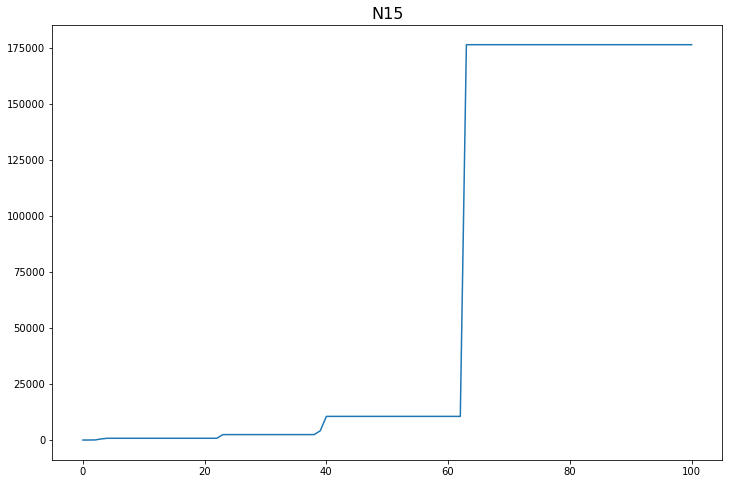

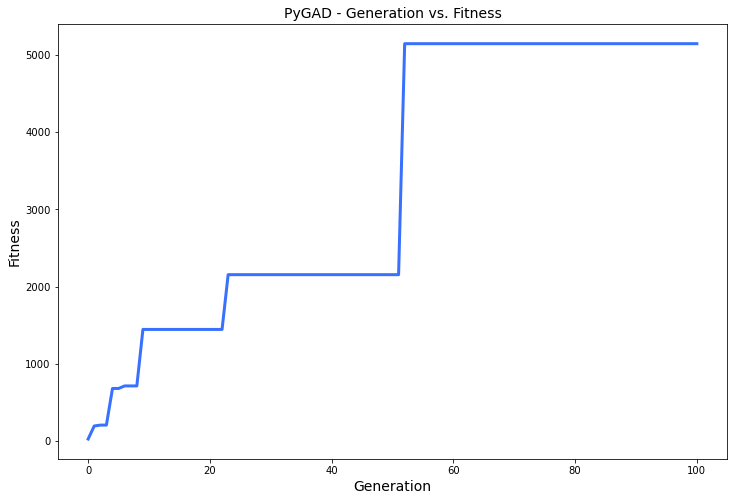

[0.568]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.568 |===========| 27.11 |==================| 6.998 |==========
[-0.804]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.804 |===========| 27.049 |==================| 4.906 |==========
[0.146]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 27.217 |==================| 27.6 |==========
[-0.118]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 27.224 |==================| 34.394 |==========
[0.12]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.12 |===========| 27.223 |==================| 33.557 |==========
[-0.398]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 27.154 |==================| 10.054 |==========
[-0.131]
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|====

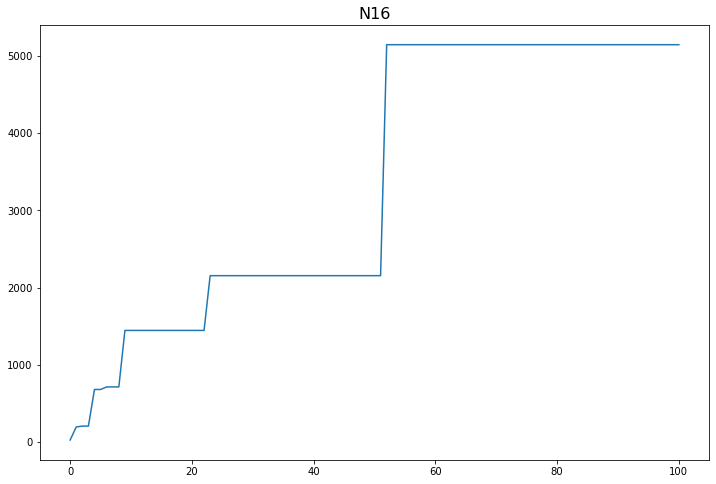

In [13]:
choosen_nodes_for_leak = ['N6'] #nodes we want to add leak

for index, val in enumerate(model_nodes):
    ga_instance = pygad.GA(num_generations=water_model.num_generations,
                       num_parents_mating=water_model.num_parents_mating, 
                       fitness_func=fitness_function, 
                       sol_per_pop=water_model.sol_per_pop,
                       num_genes=water_model.num_genes,
                       init_range_low=water_model.init_range_low,
                       init_range_high=water_model.init_range_high,
                       parent_selection_type=water_model.parent_selection_type,
                       keep_parents=water_model.keep_parents,
                       crossover_type=water_model.crossover_type,
                       mutation_type=water_model.mutation_type,
                       mutation_num_genes=water_model.mutation_num_genes,
                       callback_generation=callback_generation)
    
    water_model = WaterLeakModel(node=wn.junction_name_list[index])
    
    if water_model.node in choosen_nodes_for_leak:
        water_model.run(plot_graph=False) # Check if node is our choosen node for adding leak
    else:
        wn = wntr.network.WaterNetworkModel(water_model.inp_file_path)
        result = water_model.simulate(wn,plot_graph=False)
        water_model.function_inputs = 0.5
        water_model.desired_output = result.node['pressure'].loc[:,water_model.node][0]
        
    current_node = model_nodes[index]
    
    # Running the GA to optimize the parameters of the function.
    ga_instance.run()
    
    # After the generations complete, some plots are shown that summarize how the outputs/fitenss values evolve over generations.
    ga_instance.plot_result()
    
    # Returning the details of the best solution.
    solution, solution_fitness, solution_idx = ga_instance.best_solution()
    print("Parameters of the best solution :{solution}".format(solution=solution))
    print("Fitness value of the best solution ={solution_fitness}".format(solution_fitness=solution_fitness))
    print("Index of the best solution :{solution_idx}".format(solution_idx=solution_idx))
    
    prediction = numpy.sum(numpy.array(water_model.function_inputs)*solution)
    print("Predicted output based on the best solution :{prediction}".format(prediction=prediction))
          
    if ga_instance.best_solution_generation != -1:
        print("Best fitness value reached after {best_solution_generation} generations.".format(best_solution_generation=ga_instance.best_solution_generation))
    
    # Saving the GA instance.
    filename = 'genetic' # The filename to which the instance is saved. The  name is without extension.
    ga_instance.save(filename=filename)
    
    # Loading the saved GA instance.
    loaded_ga_instance = pygad.load(filename=filename)
    plt.plot(loaded_ga_instance.best_solutions_fitness)
    plt.title(model_nodes[index],fontsize=16)

    fitness_name = "/Fitness_" + val
    plt.savefig(water_model.plots_dir+fitness_name, dpi=150)

In [14]:
# Check solution for confirmation
wn = wntr.network.WaterNetworkModel(water_model.inp_file_path)
results = water_model.change_discharge_coefficient(wn, emitter_value=abs(solution[0]))

pressure = results.node['pressure']
presssure = pressure.loc[:,water_model.node]
print(presssure)

0    27.252808
Name: N16, dtype: float64


In [16]:
# Check the model's prediction
prediction = numpy.sum(numpy.array(water_model.function_inputs)*solution)
print("Predicted output based on the best solution :{prediction}".format(prediction=prediction))

if ga_instance.best_solution_generation != -1:
    print("Best fitness value reached after {best_solution_generation} generations.".format(best_solution_generation=ga_instance.best_solution_generation))

Predicted output based on the best solution :-0.00039218052081702037
Best fitness value reached after 52 generations.


In [15]:
water_model.export_results(solutions = fitness_solution_per_population, path=None, name='optimization-result-per-fitness')

NameError: name 'fitness_solution_per_population' is not defined

In [ ]:
glob.glob('each-node-optimization-results-csvs/solutions_for_N1/FITNESS_SOLUTION_*')

In [ ]:
solution_dirs = os.listdir('each-node-optimization-results-csvs/')
for sol in range(len(solution_dirs)):
    sols = glob.glob(os.path.join('each-node-optimization-results-csvs',solution_dirs[sol],'FITNESS_SOLUTION_N*'))
    print(sols[:10])
    break

In [ ]:
fitness_solution_per_population = pd.read_csv(water_model.merged_result+'/optimization-result-per-fitness.csv')

In [ ]:
fitness_solution_per_population = fitness_solution_per_population.sort_values(by='FITNESS', ascending=True)
fitness_solution_per_population

In [ ]:
# Merge all our solutions per generation
solution_per_generation = glob.glob(water_model.temp_dir+"/GENERATION_*")

In [ ]:
water_model.export_results(solutions = solution_per_generation, path=None, name='optimization-result-per-generation',export_type='by_generation')
result_generation = pd.read_csv(water_model.merged_result+'/optimization-result-per-generation.csv')

In [ ]:
result_generation = result_generation.sort_values(by='NODE', ascending=True)
result_generation['NODE'] = water_model.node
result_generation

In [ ]:
# merge the solution per generation and solution
final_data = pd.merge(fitness_solution_per_population,result_generation, how='outer',left_on='FITNESS',right_on='FITNESS')
final_data

In [ ]:
# sort the node fitness to get the highest fitting node, from highest to lowest
grouped_data=final_data.groupby(['NODE_x'],sort=True)[['FITNESS', 'OUTPUT_DEMAND']].max()
grouped_data=grouped_data.sort_values('FITNESS',ascending=False)
grouped_data

In [ ]:
highest_fitted_node=grouped_data.index[grouped_data['FITNESS']==max(grouped_data['FITNESS'])].tolist()[0]
print(highest_fitted_node, 'has the highest fitness in the network')

In [ ]:
generation_=result_generation[result_generation['NODE']==highest_fitted_node] 
generation_=generation_.sort_values(by='FITNESS',ascending=True)
generation_

In [ ]:
grouped_data['FITNESS'].plot(kind='bar')
plt.xlabel('NODE',fontsize=14) 
plt.ylabel('FITNESS',fontsize=14) 
plt.title('NODE vs FITNESS',fontsize=16) 
plt.show();
plt.savefig(water_model.plots_dir+"/node_with_best_fitness.png") 
plt.close()

In [ ]:
plt.plot(list(range(len(generation_))),generation_['FITNESS']) 
plt.xlabel('GENERATION',fontsize=14) ### population 
plt.ylabel('FITNESS',fontsize=14)
plt.title('FITNESS vs GENERATION',fontsize=16) 
plt.savefig(water_model.plots_dir+"/FITNESS_vs_GENERATION.png") 
plt.show();

In [ ]:
final_data.groupby(['GENERATION'])['EMITTER_COEFFICIENT_SOLUTION'].min().to_frame().plot()
plt.xlabel('GENERATION',fontsize=14)
plt.ylabel('EMITTER_COFFICIENT',fontsize=14)
plt.title('EMITTER COEFFICIENT vs GENERATION',fontsize=16)
plt.show();
plt.savefig(f"{water_model.plots_dir}/EMITTER_COEFFICIENT.png");
plt.close()

In [ ]:
final_data.groupby(['NODE_x'])['EMITTER_COEFFICIENT_SOLUTION'].min().to_frame().plot(kind='bar')
plt.xlabel('NODE',fontsize=14)
plt.ylabel('EMITTER_COFFICIENT',fontsize=14)
plt.title('EMITTER COEFFICIENT vs NODE',fontsize=16)
plt.show();
plt.savefig(f"{water_model.plots_dir}/EMITTER_COEFFICIENT_vs_NODE.png");
plt.close()

In [ ]:
final_data.groupby(['NODE_x'])['PRESSURE_OUTPUT'].min().to_frame().plot()
plt.xlabel('GENERATION',fontsize=14)
plt.ylabel('PRESSURE',fontsize=14)
plt.title('PRESSURE vs NODE',fontsize=16)
plt.show();
plt.savefig(f"{water_model.plots_dir}/PRESSURE_vs_NODE.png");
plt.close()

In [ ]:
fitness_across_nodes = final_data.groupby('NODE_x', sort=True)['EMITTER_COEFFICIENT_SOLUTION'].max()
fitness_across_nodes = fitness_across_nodes.to_frame().sort_values('EMITTER_COEFFICIENT_SOLUTION', ascending=True)
fitness_across_nodes.plot(title='EMITTER COEFFICIENT ACROSS NODES', xlabel='NODE', ylabel='EMITTER COEFF')

In [ ]:
final_data.groupby(['GENERATION'])['OUTPUT_DEMAND'].min().to_frame().plot()
plt.xlabel('GENERATION',fontsize=14)
plt.ylabel('PRESSURE',fontsize=14)
plt.title('PRESSURE vs NODE',fontsize=16)
plt.show();
plt.savefig(f"{water_model.plots_dir}/PRESSURE_vs_NODE.png");
plt.close()

In [ ]:
# sort the node fitness to get the highest fitting node, from highest to lowest
grouped_pressure_data=final_data.groupby(['NODE_x'],sort=True)['PRESSURE_OUTPUT'].min()
grouped_pressure_data=grouped_pressure_data.to_frame().sort_values('PRESSURE_OUTPUT',ascending=True)
grouped_pressure_data.plot(title='PRESSURE ACROSS NODES', xlabel='NODE', ylabel='PRESSURE')

In [ ]:
# demand_across_gen = final_data.groupby('GENERATION', sort=True)['OUTPUT_DEMAND'].max()
# demand_across_gen = demand_across_gen.to_frame().sort_values('OUTPUT_DEMAND', ascending=True)
# demand_across_gen.plot(title='DEMAND ACROSS GENERATION', xlabel='GENERATION', ylabel='OUTPUT_DEMAND')

## Visualize the Rest of the Fitness for other nodes as well

In [ ]:
water_model.plots_dir = 'each-node-optimization-plots'

In [ ]:
# Fitness across all nodes
fitness_plots = [os.path.join(water_model.plots_dir,file) \
                 for file in os.listdir(water_model.plots_dir) \
                 if file.endswith('.png') or file.endswith('.jpg')]
fitness_plots

In [ ]:
plt.rcParams['figure.figsize'] = (10,7)

In [ ]:
# subplot 16 images
i = 4
j = 0

for _ in range(len(fitness_plots)//4):
    fig, axs = plt.subplots(2, 2, figsize=(20,20), constrained_layout = True)
    axs = axs.ravel()

    for index, val in enumerate(fitness_plots[j:i]):
        img = plt.imread(val)
        axs[index].imshow(img)
        axs[index].axis('off')
    fig.suptitle('Solution Across Nodes - Post Optimization', fontsize=16)
    plt.savefig(water_model.plots_dir+str(f'/fitness/Fitness_group_{j}.png'))
    plt.subplots_adjust(left=0, bottom=0, right=None, top=None, wspace=None, hspace=None)
    j=i
    i+=4
        
